In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [2]:
import pandas as pd
import numpy as np
import datetime as dt
import os
import matplotlib.pyplot as plt


In [3]:
work_path = '/content/gdrive/Shared drives/marketdata/stock/'
os.chdir(work_path)

### Define Parameters

In [4]:
STOP_PROFIT = 1
STOP_LOSS = 2
TIME_OUT = 3

In [5]:
def numtotime(num):
    ms = num % 1000
    num //= 1000
    s = num % 100
    num //= 100
    mi = num % 100
    num //= 100
    h = num % 100
    num = num // 100
    # print(h, mi, s, ms)
    return dt.datetime(2020, 9, 21, h, mi, s, ms) # TODO

# Hft_strategy

In [8]:
class Hft_strategy:
    def __init__(self, lob_file, tick_file):
        self.lob_file = open(lob_file)
        self.tick_file = open(tick_file)
        self.df = pd.read_csv(tick_file)
        
        self.df["time"] = self.df["time"].apply(func = numtotime)
        self.df.set_index("time", inplace = True)
        self.lob_col = self.lob_file.readline()[:-1].split(",")
        self.tick_col = self.tick_file.readline()[:-1].split(",")
        self.ref_num = 0
        self.num_buy = 0
        self.num_sell = 0
        self.ask1_p = 0
        self.ask2_p = 0
        self.ask3_p = 0
        self.ask4_p = 0
        self.ask5_p = 0
        self.ask1_q = 0
        self.ask2_q = 0
        self.ask3_q = 0
        self.ask4_q = 0
        self.ask5_q = 0
        self.bid1_p = 0
        self.bid2_p = 0
        self.bid3_p = 0
        self.bid4_p = 0
        self.bid5_p = 0
        self.bid1_q = 0
        self.bid2_q = 0
        self.bid3_q = 0
        self.bid4_q = 0
        self.bid5_q = 0
        self.daily_high = 0
        self.daily_low = 10000

        self.stop_profit = 0
        self.stop_loss = 0

        self.profit = 0
        self.cost = 0

        self.num_win = 0
        self.num_loss = 0

        self.order_time = 0
        self.stop_time = None

        self.position = []
        self.current_time = 0

        self.total_cost = 0

    def get_result(self):
        return self.profit, self.total_cost, self.num_win, self.num_loss

    def lob_update(self, lob_row):
        pass

    def tick_update(self, tick_row):
        pass

    def could_buy(self):
        pass

    def buy(self):
        pass

    def could_sell(self):
        pass

    def sell(self):
        pass

    def could_order(self):
        pass
        
    def order(self):
        pass

    def task(self):
        pass
    def show_result(self):
        pass

# YY19(多多的YY18)
前n筆成交的price去算weighted_p 

買氣 > 賣氣 * beta

self.bid1_p > self.weighted_p * self.theta

and self.num_sell > self.num_buy * self.beta

多進多出




In [12]:
class YY19(Hft_strategy):
    def __init__(self, lob_file, tick_file, beta, time_out, gamma, cool_down_min, stop_loss_factor, theta, position_max_q, yesterday_close, qty_bound, weighted_factor):
        super().__init__(lob_file, tick_file)
        self.tick_list_buy_sell = []
        self.tick_list_weight_p = []
        self.beta = beta
        self.time_out = time_out
        self.order_p = np.array([])
        self.gamma = gamma
        self.in_history = []
        self.out_history = []
        self.in_time = []
        self.out_time = []
        self.cool_down_min = cool_down_min
        self.stop_loss_factor = stop_loss_factor
        self.theta = theta
        self.weighted_p = 0
        self.total_trade_q = 0
        self.total_trade_p = 0
        self.position_max_q = position_max_q
        self.position = np.array([])
        self.weighted_p_list = []
        self.weighted_p_time_list = []
        self.sell_buy_time_list = []
        self.sell_buy_ratio_list = []
        print(self.lob_file)
        print(self.tick_file)
        self.close_price = self.df.loc[self.df.index[-1], "price"]
        print(self.close_price)
        self.yesterday_close = yesterday_close
        self.qty_bound = qty_bound
        self.weighted_factor = weighted_factor

    def get_close(self):
        return self.close_price

    def task(self):
        temp_lob = self.lob_file.readline()[:-1].split(",")
        temp_tick = self.tick_file.readline()[:-1].split(",")
        lob_row = pd.Series(data = temp_lob, index=self.lob_col)
        tick_row = pd.Series(data = temp_tick, index = self.tick_col)
        
        self.lob_datatype_conversion(lob_row)
        self.tick_datatype_conversion(tick_row)
        
        next_lob_time = lob_row['time']
        next_tick_time = tick_row['time']
        self.current_time = min(next_lob_time, next_tick_time)
        print(self.current_time)

        c = 0
        flag = 1
        while(self.current_time <= 130000000):
            # print(c)
            c += 1                        
            if (next_lob_time < next_tick_time):
                self.lob_update(lob_row)
                temp_lob = self.lob_file.readline()[:-1].split(",")
                lob_row = pd.Series(data = temp_lob, index=self.lob_col)
                self.lob_datatype_conversion(lob_row)
                next_lob_time = lob_row['time']
            else:
                self.tick_update(tick_row)
                temp_tick = self.tick_file.readline()[:-1].split(",")
                if len(temp_tick) <= 1:
                    break
                tick_row = pd.Series(data = temp_tick, index = self.tick_col)
                self.tick_datatype_conversion(tick_row)
                next_tick_time = tick_row['time']
            # print("next_lob: ", next_lob_time, "next_tick: ", next_tick_time)
            self.current_time = min(next_lob_time, next_tick_time)
            if self.could_buy(tick_row):
                self.buy()
            self.sell(tick_row)
            '''
            buy_type = self.could_buy(tick_row)
            if buy_type == STOP_PROFIT:
                self.buy()
                print("出場時間：", self.current_time)
                self.out_time.append(self.current_time)
                print("buy at", self.order_p)
                print("get", -self.order_p + self.cost)
                self.out_history.append(self.order_p)
                self.profit += self.cost - self.order_p 
                print("-"*30)
            elif buy_type == STOP_LOSS or buy_type == TIME_OUT:
                self.buy()
                print("出場時間：", self.current_time)
                self.out_time.append(self.current_time)
                print("buy at", self.ask1_p)
                print("get", -self.ask1_p + self.cost)
                self.out_history.append(self.ask1_p)
                self.profit += -self.ask1_p + self.cost
                print("-"*30)
            '''
        self.clear_position(tick_row)
        

    
    def lob_datatype_conversion(self, lob_row):
        lob_row['time'] = int(lob_row['time'])
        lob_row['ask1_price'] = float(lob_row['ask1_price'])
        lob_row['ask2_price'] = float(lob_row['ask2_price'])
        lob_row['ask3_price'] = float(lob_row['ask3_price'])
        lob_row['ask4_price'] = float(lob_row['ask4_price'])
        lob_row['ask5_price'] = float(lob_row['ask5_price'])
        lob_row['bid1_price'] = float(lob_row['bid1_price'])
        lob_row['bid2_price'] = float(lob_row['bid2_price'])
        lob_row['bid3_price'] = float(lob_row['bid3_price'])
        lob_row['bid4_price'] = float(lob_row['bid4_price'])
        lob_row['bid5_price'] = float(lob_row['bid5_price'])
        lob_row['ask1_qty'] = int(float(lob_row['ask1_qty']))
        lob_row['ask2_qty'] = int(float(lob_row['ask2_qty']))
        lob_row['ask3_qty'] = int(float(lob_row['ask3_qty']))
        lob_row['ask4_qty'] = int(float(lob_row['ask4_qty']))
        lob_row['ask5_qty'] = int(float(lob_row['ask5_qty']))
        lob_row['bid1_qty'] = int(float(lob_row['bid1_qty']))
        lob_row['bid2_qty'] = int(float(lob_row['bid2_qty']))
        lob_row['bid3_qty'] = int(float(lob_row['bid3_qty']))
        lob_row['bid4_qty'] = int(float(lob_row['bid4_qty']))
        lob_row['bid5_qty'] = int(float(lob_row['bid5_qty']))

    def tick_datatype_conversion(self, tick_row):
        tick_row['time'] = int(tick_row['time'])
        tick_row['price'] = float(tick_row['price'])
        tick_row['qty'] = int(tick_row['qty'])

    def lob_update(self, lob_row):
        self.ask1_p = lob_row['ask1_price'] 
        self.ask2_p = lob_row['ask2_price']
        self.ask3_p = lob_row['ask3_price']
        self.ask4_p = lob_row['ask4_price']
        self.ask5_p = lob_row['ask5_price']
        self.ask1_q = lob_row['ask1_qty']
        self.ask2_q = lob_row['ask2_qty']
        self.ask3_q = lob_row['ask3_qty']
        self.ask4_q = lob_row['ask4_qty']
        self.ask5_q = lob_row['ask5_qty']
        self.bid1_p = lob_row['bid1_price']
        self.bid2_p = lob_row['bid2_price']
        self.bid3_p = lob_row['bid3_price']
        self.bid4_p = lob_row['bid4_price']
        self.bid5_p = lob_row['bid5_price']
        self.bid1_q = lob_row['bid1_qty']
        self.bid2_q = lob_row['bid2_qty']
        self.bid3_q = lob_row['bid3_qty']
        self.bid4_q = lob_row['bid4_qty']
        self.bid5_q = lob_row['bid5_qty']

    def tick_update(self, tick_row):

        self.daily_low = min(self.daily_low, tick_row['price'])
        self.daily_high = max(self.daily_high, tick_row['price'])
        # if self.current_time > 90100000:
            # self.total_trade_q += tick_row['qty'] 
            # self.total_trade_p += tick_row['price'] * tick_row['qty'] 
            # self.weighted_p = self.total_trade_p / self.total_trade_q

        self.total_trade_p += tick_row['price'] * tick_row['qty'] 
        self.total_trade_q += tick_row['qty'] 

        if (tick_row['price'] >= self.ask1_p):
            tick_row['buy_or_sell'] = "buy"
            self.num_buy += tick_row['qty'] 
        elif (tick_row['price'] <= self.bid1_p):
            tick_row['buy_or_sell'] = "sell"
            self.num_sell += tick_row['qty']
        else:
            tick_row['buy_or_sell'] = "QAO"
            print("------Weird price!!!!!---------")
            print("At time: ", tick_row['time'])
            print("tick_row_price", tick_row['price'])
            print("ask_1_p", self.ask1_p)
            print("bid_1_p", self.bid1_p)
            # assert(0), "Weird price!!!!!"

        if len(self.tick_list_buy_sell) < self.gamma:
            self.tick_list_buy_sell.append(tick_row)
        else:   
            if self.tick_list_buy_sell[0]['buy_or_sell'] == "buy":
                self.num_buy -= self.tick_list_buy_sell[0]['qty']
            elif self.tick_list_buy_sell[0]['buy_or_sell'] == "sell":
                self.num_sell -= self.tick_list_buy_sell[0]['qty']
            else:
                pass
            self.tick_list_buy_sell.pop(0)
            self.tick_list_buy_sell.append(tick_row)
            self.sell_buy_ratio_list.append(self.num_sell / (self.num_buy + 0.01))
            self.sell_buy_time_list.append(self.current_time)

        if len(self.tick_list_weight_p) < self.weighted_factor:
            self.tick_list_weight_p.append(tick_row)
        else:
            self.total_trade_p -= self.tick_list_weight_p[0]['price'] * self.tick_list_weight_p[0]['qty'] 
            self.total_trade_q -= self.tick_list_weight_p[0]['qty']
            self.tick_list_weight_p.pop(0)
            self.tick_list_weight_p.append(tick_row)
            self.weighted_p = self.total_trade_p / self.total_trade_q
            self.weighted_p_list.append(self.weighted_p)
            self.weighted_p_time_list.append(self.current_time)


    def could_buy(self, tick_row):
        if self.ask1_p * self.theta < self.weighted_p  \
            and self.current_time >= self.order_time + self.cool_down_min \
            and len(self.position) <= self.position_max_q \
            and self.current_time > 90200000\
            and self.num_buy > self.num_sell * self.beta\
            and tick_row['price'] > self.yesterday_close * 0.92\
            and self.num_buy > self.qty_bound:
            print("*** bid1_p: ", self.bid1_p)
            print("*** weighted_p: ", self.weighted_p)
            print("ask1_p: ", self.ask1_p)
            print("num_sell: ", self.num_sell)
            print("num_buy: ", self.num_buy)
            print("tick_row_price: ", tick_row['price'], \
                  "  yesterday_close: ", self.yesterday_close)
            return True
        else:
            return False

    def buy(self):
        print("進場時間：", self.current_time, "\n  buy price at ", self.bid1_p)
        self.in_history.append(self.ask1_p)
        self.in_time.append(self.current_time)
        self.position = np.append(self.position, self.ask1_p)
        self.order_time = self.current_time
        self.cost = self.ask1_p
        self.order_p = np.append(self.order_p, self.ask2_p)

        self.total_cost += self.cost

    def could_sell(self, tick_row):
        # stop profit
        if len(self.position) and tick_row['price'] > np.max(self.order_p):
            print("stop profit")
            return STOP_PROFIT
        elif len(self.position) and (tick_row['price'] >= self.position * self.stop_loss_factor).any():
            print("stop loss")
            return STOP_LOSS
        # # time out
        # elif len(self.position) and self.current_time - self.order_time >= self.time_out:
        #    print("time out")
        #    return False
        else:
            return False
        # keep position

        # no position

    def sell(self, tick_row):
        res = self.could_sell(tick_row)
        if res == STOP_PROFIT:
            print("出場時間：", self.current_time)
            self.out_history.append(tick_row['price'])
            self.out_time.append(self.current_time)
            print("POSITION(pre): ", self.position)
            print("Order_p(pre): ", self.order_p)
            print("tick_row price: ", tick_row['price'])
            sell_index = np.argwhere(self.order_p < tick_row['price'])
            print("qualified index: ", sell_index)
            self.profit += (-self.position+self.order_p)[sell_index].sum()
            self.position = np.delete(self.position, sell_index)
            self.order_p = np.delete(self.order_p, sell_index)
            print("POSITION(post): ", self.position)
            print("Order_p(post): ", self.order_p)
            print()
        elif res == STOP_LOSS:
            print("出場時間：", self.current_time)
            self.out_history.append(tick_row['price'])
            self.out_time.append(self.current_time)
            print("POSITION(pre): ", self.position)
            print("Order_p(pre): ", self.order_p)
            print("tick_row price: ", tick_row['price'])
            sell_index = np.argwhere(tick_row['price'] * self.stop_loss_factor < self.position)
            print("qualified index: ", sell_index)
            self.profit += (-self.position+tick_row['price'])[sell_index].sum()
            self.position = np.delete(self.position, sell_index)
            self.order_p = np.delete(self.order_p, sell_index)
            print("POSITION(post): ", self.position)
            print("Order_p(post): ", self.order_p)

        # self.order_time = self.current_time
        
    def clear_position(self, tick_row):
        print("clear_position: ", -np.sum(self.position-tick_row["price"]))
        print("position: ", self.position)
        print("tick_row_price", tick_row["price"])
        self.profit -= np.sum(self.position-tick_row["price"])
            

    def show_result(self):
        print("----------Result Report--------------")
        print("profit: ", self.profit)
        
        
        if len(self.in_time):
        
            plt.figure(figsize=(20,10))
            plt.subplot(311)
            plt.title("price")
            plt.plot(self.df.index, self.df.loc[:, 'price'], label = 'price')
            plt.plot([numtotime(x) for x in self.weighted_p_time_list], self.weighted_p_list, label = 'weighted_p')
            plt.scatter([numtotime(x) for x in self.in_time], self.in_history, marker='^', s= 144, c="red")
            plt.scatter([numtotime(x) for x in self.out_time], self.out_history, marker='v', s = 144, c="lime")
            plt.legend()
        else:
            plt.figure(figsize=(20,10))
            plt.subplot(311)
            plt.title("price")
            plt.plot(self.df.index, self.df.loc[:, 'price'], label = 'price')
            plt.plot([numtotime(x) for x in self.weighted_p_time_list], self.weighted_p_list, label = 'weighted_p')
            plt.legend()
        plt.subplot(312)
        #plt.figure(figsize=(20,10))
        plt.title("qty")
        plt.plot(self.df.index, self.df.loc[:, "qty"])
        plt.subplot(313)
        plt.title("sell buy ratio")
        plt.yscale("log")
        self.sell_buy_time_list.append(133000000)
        self.sell_buy_ratio_list.append(self.sell_buy_ratio_list[-1])
        plt.plot([numtotime(x) for x in self.sell_buy_time_list], self.sell_buy_ratio_list, label = "sell")
        plt.plot([numtotime(x) for x in self.sell_buy_time_list], [1/x if x != 0 else 20 for x in self.sell_buy_ratio_list], label = 'buy')
        plt.plot([numtotime(self.sell_buy_time_list[0]), numtotime(self.sell_buy_time_list[-1])], [self.beta, self.beta])
        plt.legend()

        
        plt.show()
        


#### back_test

In [13]:
import datetime as dt


def back_test(start_date, end_date, sid, beta, time_out, gamma, cool_down_min, stop_loss_factor, theta, position_max_q, qty_bound, weighted_factor):
    
    cur_day = None
    result_list = []
    yesterday_close = 10
    for file in sorted(os.listdir()):
        if "zip" not in file:
            # print(file)
            year, month, date = [int(x) for x in file.split("-")]
            

            cur_day = dt.datetime(year, month, date)
            
            if end_date >= cur_day >= start_date:
                sid_type = "otc"
                lob_path = os.path.join(work_path, file, sid, sid_type + "_lob_" + sid + ".csv")
                tick_path = os.path.join(work_path, file, sid, sid_type + "_tick_" + sid + ".csv")

                if not os.path.exists(lob_path):
                    sid_type = "tse"
                    lob_path = os.path.join(work_path, file, sid, sid_type + "_lob_" + sid + ".csv")
                    tick_path = os.path.join(work_path, file, sid, sid_type + "_tick_" + sid + ".csv")

                if os.path.exists(lob_path) and os.path.exists(tick_path):
                    temp = YY19(lob_path, tick_path, beta, time_out, gamma, cool_down_min, stop_loss_factor, theta, position_max_q, yesterday_close, qty_bound, weighted_factor)
                    temp.task()
                    yesterday_close = temp.get_close()
                    result_list.append(temp.get_result())
                    temp.show_result()
                    with open("../result_YY19_1013.csv", "a") as f:
                        f.write("\n")
                        f.write(",".join([str(x) for x in ["YY19", cur_day, sid, beta, time_out, gamma, \
                                                        cool_down_min, stop_loss_factor, theta, position_max_q, temp.profit, temp.total_cost]]))
                    
    return result_list 

def calculate_profit(res_list):
    s = 0
    c = 0
    for x in res_list:
        s+=x[0]
        c+=x[1]
    return s, c


#### RUN

#### for testing

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-03/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-03/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
129.0
90001794
*** bid1_p:  129.0
*** weighted_p:  129.5082304526749
ask1_p:  129.5
num_sell:  17
num_buy:  61
tick_row_price:  129.5   yesterday_close:  10
進場時間： 110400649 
  sell price at  129.0
stop profit
出場時間： 111636337
POSITION(pre):  [129.5]
Order_p(pre):  [130.]
tick_row price:  130.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  -0.0
position:  []
tick_row_price 129.0
----------Result Report--------------
profit:  0.5


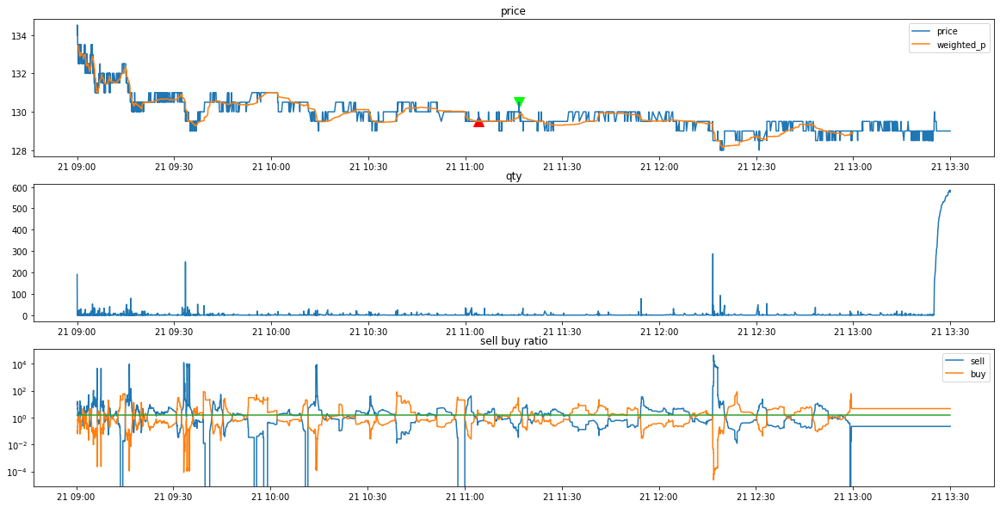

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-04/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-04/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
135.5
90003267
*** bid1_p:  129.0
*** weighted_p:  129.5229007633588
ask1_p:  129.5
num_sell:  5
num_buy:  70
tick_row_price:  130.0   yesterday_close:  129.0
進場時間： 90913949 
  sell price at  129.0
*** bid1_p:  129.0
*** weighted_p:  129.5071942446043
ask1_p:  129.5
num_sell:  32
num_buy:  56
tick_row_price:  129.5   yesterday_close:  129.0
進場時間： 91014245 
  sell price at  129.0
*** bid1_p:  129.0
*** weighted_p:  129.56089743589743
ask1_p:  129.5
num_sell:  17
num_buy:  52
tick_row_price:  129.0   yesterday_close:  129.0
進場時間： 91132684 
  sell price at  129.0
stop profit
出場時間： 91531135
POSITION(pre):  [129.5 129.5 129.5]
Order_p(pre):  [130. 130. 130.]
tick_row price:  130.5
qualified index:  [[0]
 [1]
 [2]]
POSITION(post)

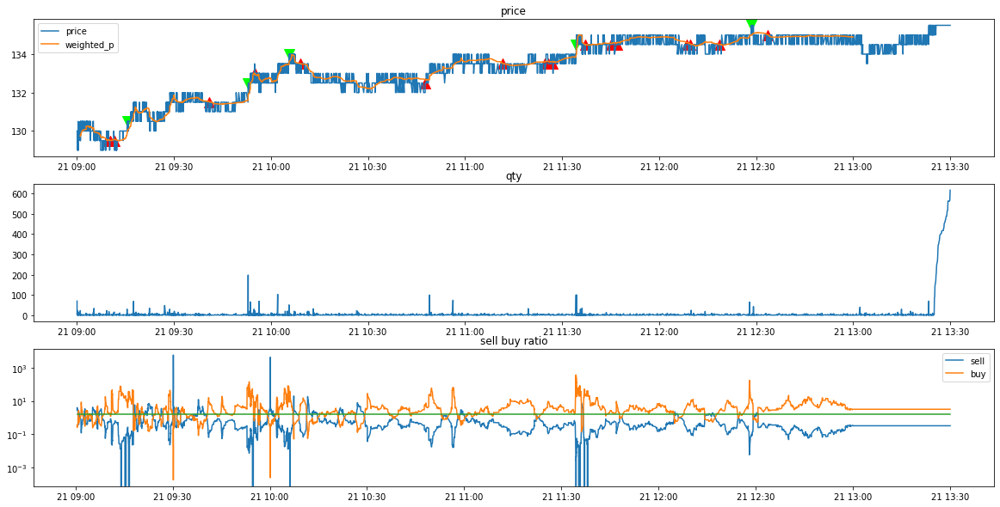

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-05/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-05/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
132.0
90003498
clear_position:  -0.0
position:  []
tick_row_price 132.0
----------Result Report--------------
profit:  0.0


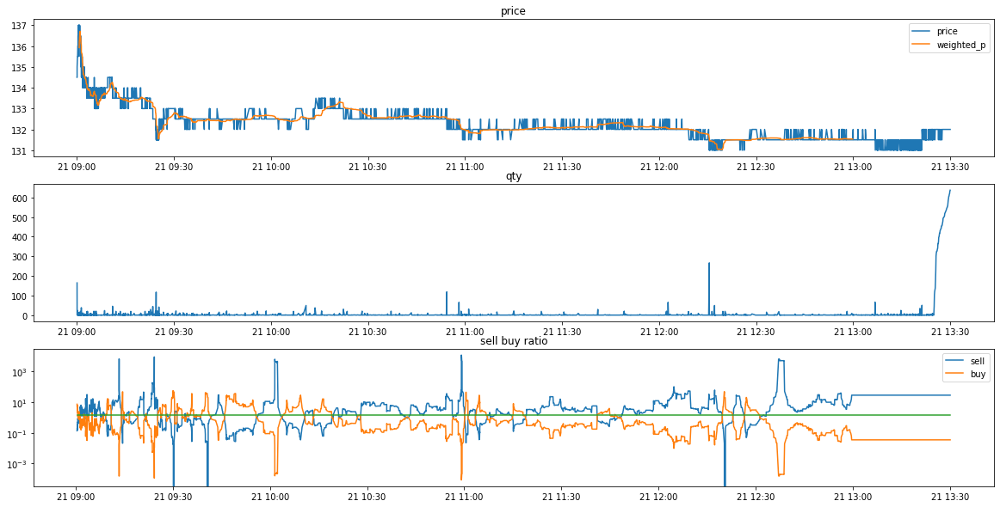

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-06/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-06/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
141.0
90004571
*** bid1_p:  140.0
*** weighted_p:  140.56598984771574
ask1_p:  140.5
num_sell:  26
num_buy:  55
tick_row_price:  140.5   yesterday_close:  132.0
進場時間： 90209251 
  sell price at  140.0
stop profit
出場時間： 90225271
POSITION(pre):  [140.5]
Order_p(pre):  [141.]
tick_row price:  141.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  139.5
*** weighted_p:  140.01176470588234
ask1_p:  140.0
num_sell:  19
num_buy:  53
tick_row_price:  140.0   yesterday_close:  132.0
進場時間： 90423727 
  sell price at  139.5
stop profit
出場時間： 90451842
POSITION(pre):  [140.]
Order_p(pre):  [140.5]
tick_row price:  141.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  141.0
*** weigh

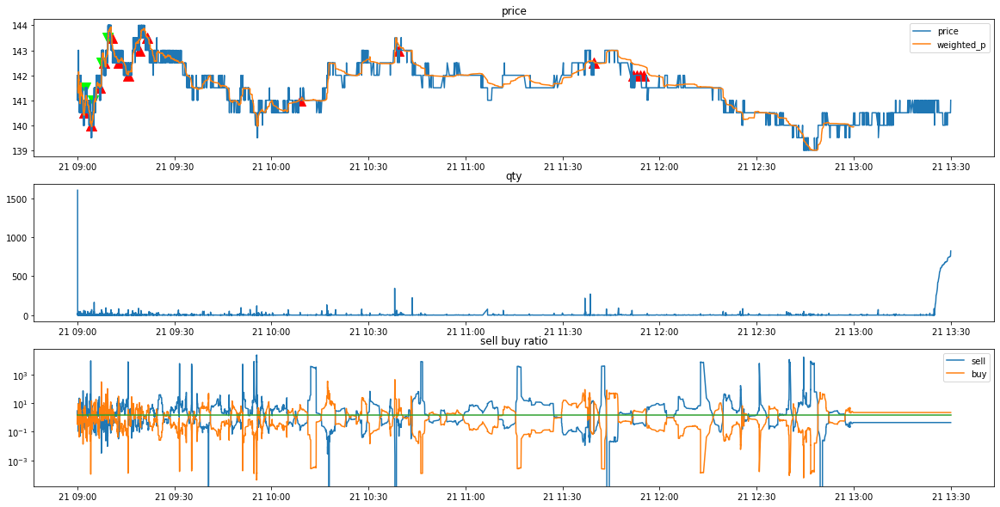

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-07/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-07/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
138.0
90002099
*** bid1_p:  140.5
*** weighted_p:  141.0375
ask1_p:  141.0
num_sell:  28
num_buy:  54
tick_row_price:  141.0   yesterday_close:  141.0
進場時間： 91444319 
  sell price at  140.5
*** bid1_p:  139.0
*** weighted_p:  139.65740740740742
ask1_p:  139.5
num_sell:  12
num_buy:  104
tick_row_price:  139.5   yesterday_close:  141.0
進場時間： 100320614 
  sell price at  139.0
*** bid1_p:  139.0
*** weighted_p:  139.6346153846154
ask1_p:  139.5
num_sell:  51
num_buy:  90
tick_row_price:  139.5   yesterday_close:  141.0
進場時間： 100448156 
  sell price at  139.0
clear_position:  -9.0
position:  [141.  139.5 139.5]
tick_row_price 137.0
----------Result Report--------------
profit:  -9.0


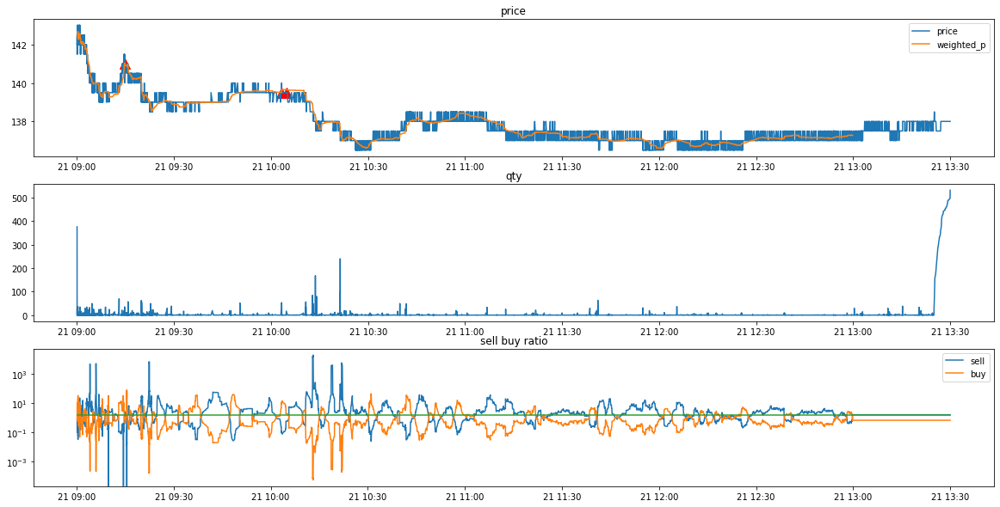

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-10/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-10/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
132.5
90003887
clear_position:  -0.0
position:  []
tick_row_price 132.0
----------Result Report--------------
profit:  0.0


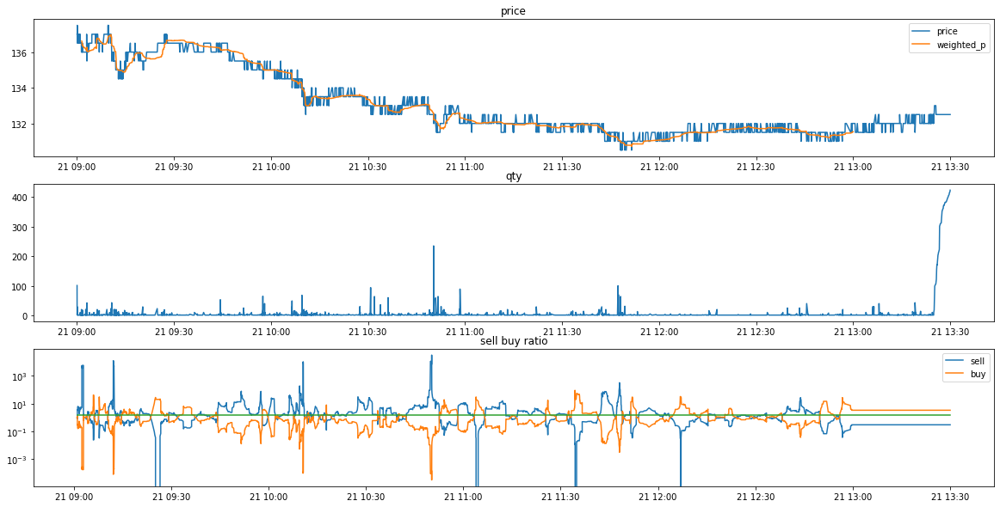

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-11/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-11/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
130.5
90004848
clear_position:  -0.0
position:  []
tick_row_price 130.0
----------Result Report--------------
profit:  0.0


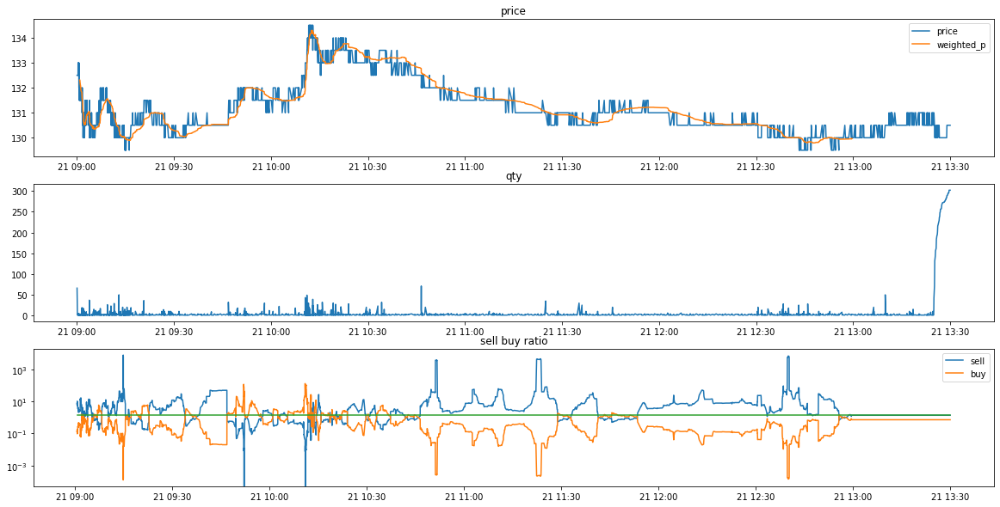

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-12/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-12/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
131.5
90004791
*** bid1_p:  131.0
*** weighted_p:  131.6196581196581
ask1_p:  131.5
num_sell:  25
num_buy:  52
tick_row_price:  131.5   yesterday_close:  130.5
進場時間： 101026188 
  sell price at  131.0
clear_position:  -0.5
position:  [131.5]
tick_row_price 131.0
----------Result Report--------------
profit:  -0.5


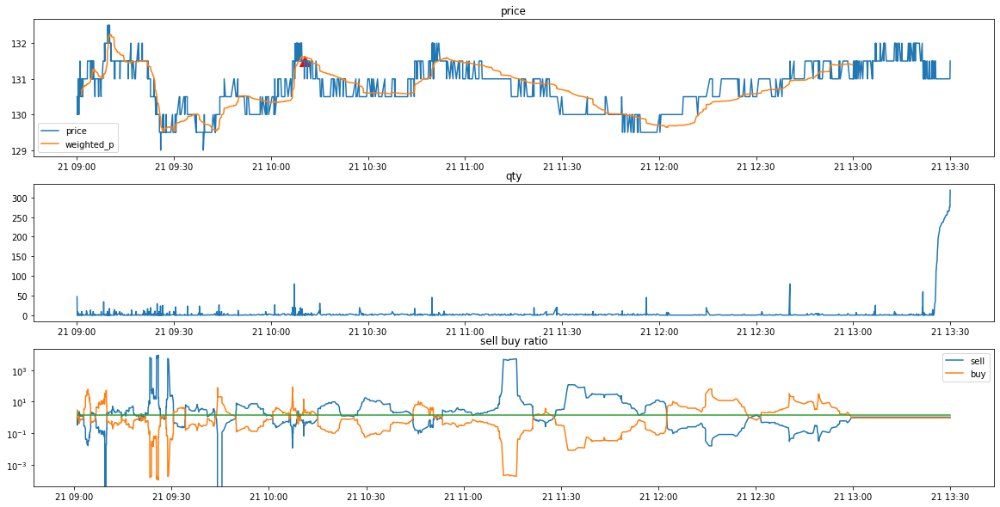

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-13/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-13/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
130.5
90008037
*** bid1_p:  135.5
*** weighted_p:  136.0144927536232
ask1_p:  136.0
num_sell:  3
num_buy:  113
tick_row_price:  136.0   yesterday_close:  131.5
進場時間： 91406099 
  sell price at  135.5
------Weird price!!!!!---------
At time:  91525108
tick_row_price 135.0
ask_1_p 135.5
bid_1_p 134.5
clear_position:  -4.5
position:  [136.]
tick_row_price 131.5
----------Result Report--------------
profit:  -4.5


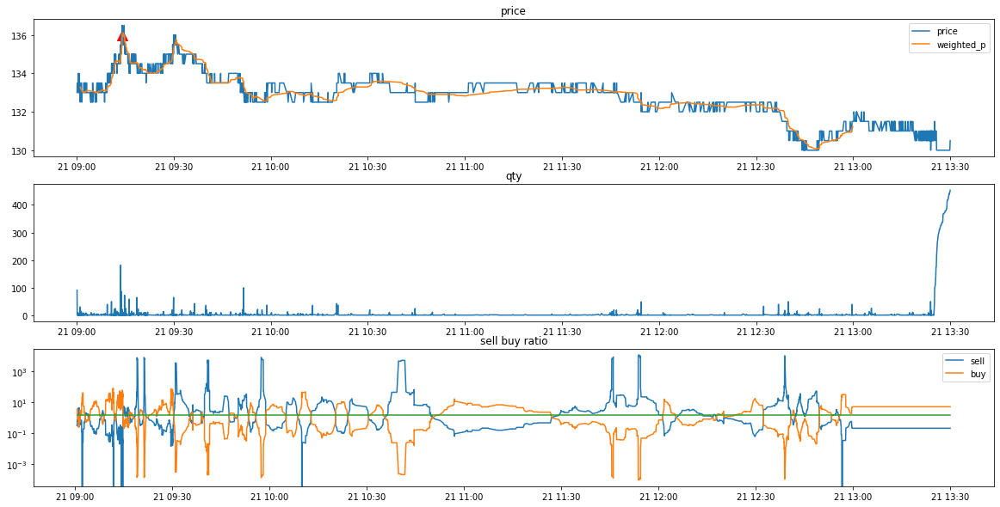

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-14/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-14/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
135.5
90004502
clear_position:  -0.0
position:  []
tick_row_price 136.0
----------Result Report--------------
profit:  0.0


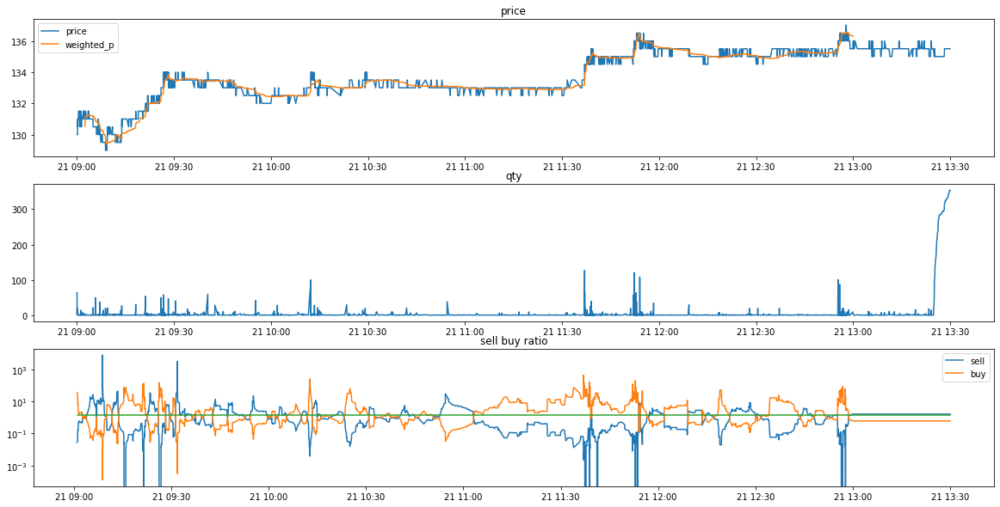

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-17/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-17/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
136.5
90004724
*** bid1_p:  137.0
*** weighted_p:  137.5748031496063
ask1_p:  137.5
num_sell:  6
num_buy:  58
tick_row_price:  137.5   yesterday_close:  135.5
進場時間： 101403734 
  sell price at  137.0
stop profit
出場時間： 101726596
POSITION(pre):  [137.5]
Order_p(pre):  [138.]
tick_row price:  138.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  138.5
*** weighted_p:  139.0222222222222
ask1_p:  139.0
num_sell:  1
num_buy:  54
tick_row_price:  139.0   yesterday_close:  135.5
進場時間： 101944908 
  sell price at  138.5
*** bid1_p:  135.0
*** weighted_p:  135.51421800947867
ask1_p:  135.5
num_sell:  10
num_buy:  61
tick_row_price:  135.5   yesterday_close:  135.5
進場時間： 125350829 
  sell price at  135.0
cle

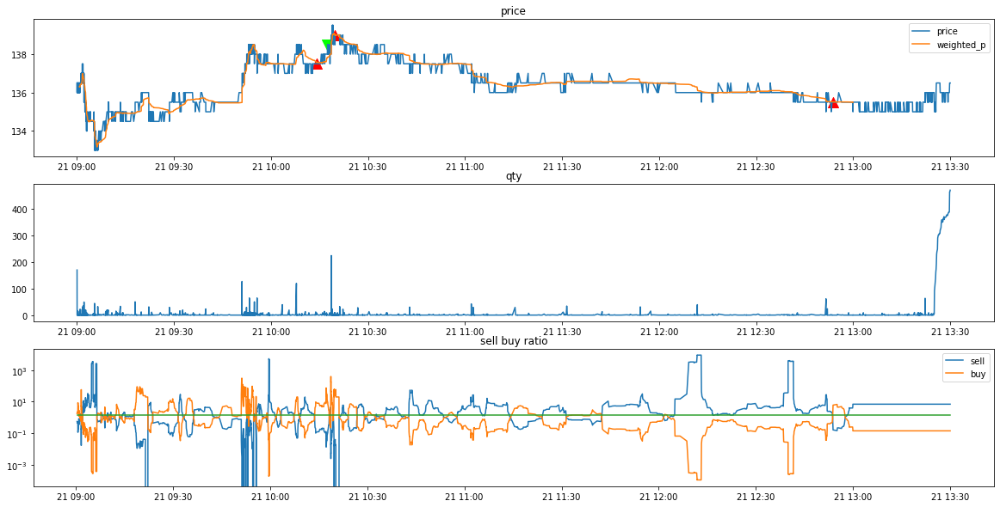

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-18/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-18/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
135.0
90004380
*** bid1_p:  137.5
*** weighted_p:  138.07035175879398
ask1_p:  138.0
num_sell:  9
num_buy:  110
tick_row_price:  138.5   yesterday_close:  136.5
進場時間： 91907393 
  sell price at  137.5
clear_position:  -3.0
position:  [138.]
tick_row_price 135.0
----------Result Report--------------
profit:  -3.0


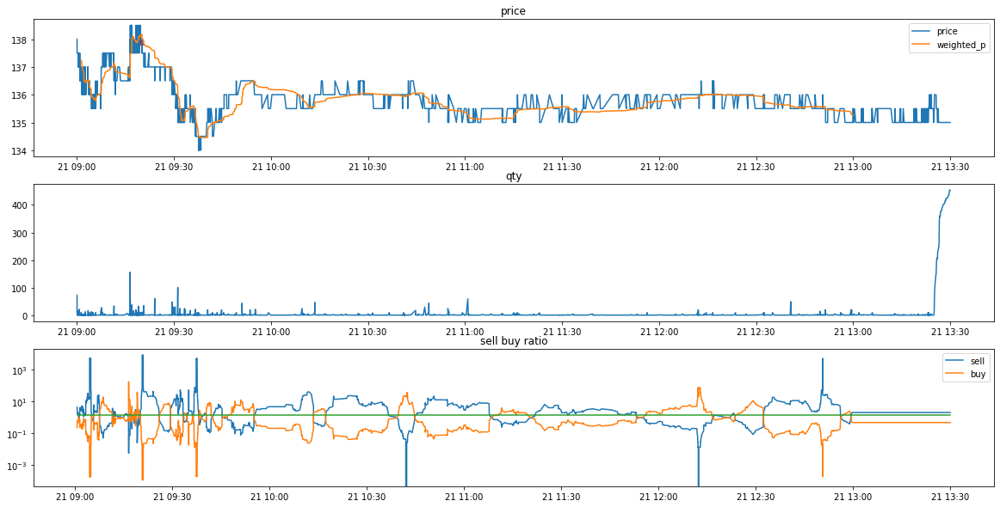

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-19/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-19/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
132.0
90007411
*** bid1_p:  134.5
*** weighted_p:  135.013671875
ask1_p:  135.0
num_sell:  16
num_buy:  51
tick_row_price:  135.0   yesterday_close:  135.0
進場時間： 120608367 
  sell price at  134.5
clear_position:  -4.0
position:  [135.]
tick_row_price 131.0
----------Result Report--------------
profit:  -4.0


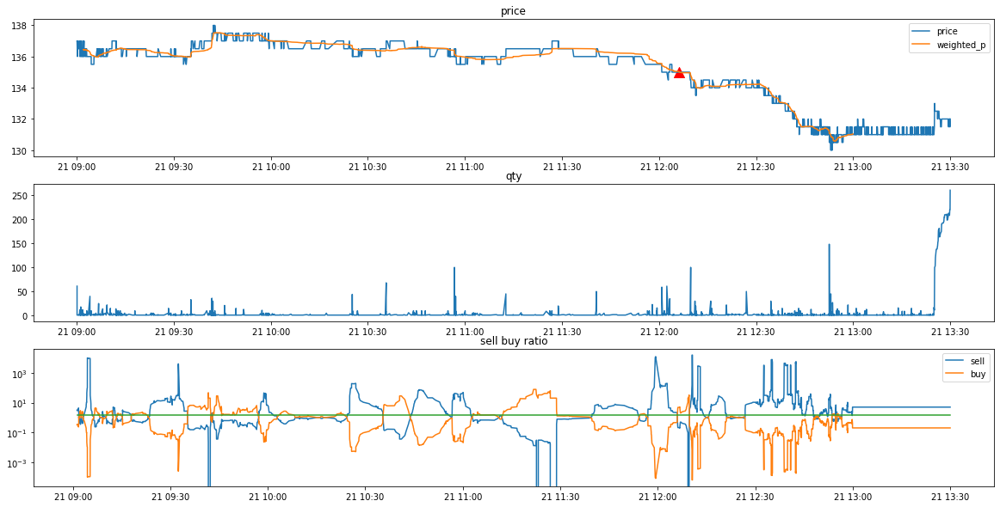

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-20/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-20/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.0
90006970
*** bid1_p:  130.0
*** weighted_p:  130.74425287356323
ask1_p:  130.5
num_sell:  33
num_buy:  59
tick_row_price:  130.0   yesterday_close:  132.0
進場時間： 90253053 
  sell price at  130.0
*** bid1_p:  123.5
*** weighted_p:  124.14197530864197
ask1_p:  124.0
num_sell:  31
num_buy:  71
tick_row_price:  124.0   yesterday_close:  132.0
進場時間： 91906233 
  sell price at  123.5
*** bid1_p:  122.0
*** weighted_p:  122.6608040201005
ask1_p:  122.5
num_sell:  46
num_buy:  103
tick_row_price:  123.0   yesterday_close:  132.0
進場時間： 93252450 
  sell price at  122.0
clear_position:  -20.0
position:  [130.5 124.  122.5]
tick_row_price 119.0
----------Result Report--------------
profit:  -20.0


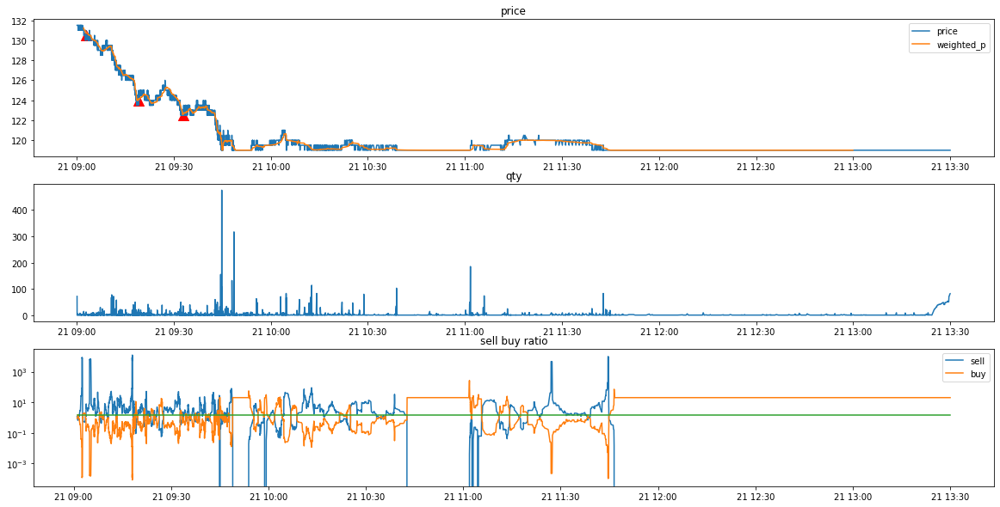

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-21/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-21/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.0
90005685
*** bid1_p:  119.5
*** weighted_p:  120.29225352112677
ask1_p:  120.0
num_sell:  38
num_buy:  58
tick_row_price:  120.0   yesterday_close:  119.0
進場時間： 90839018 
  sell price at  119.5
stop profit
出場時間： 91557477
POSITION(pre):  [120.]
Order_p(pre):  [120.5]
tick_row price:  121.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.0
*** weighted_p:  120.54054054054055
ask1_p:  120.5
num_sell:  11
num_buy:  53
tick_row_price:  120.5   yesterday_close:  119.0
進場時間： 94349658 
  sell price at  120.0
stop profit
出場時間： 94552026
POSITION(pre):  [120.5]
Order_p(pre):  [121.]
tick_row price:  121.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weigh

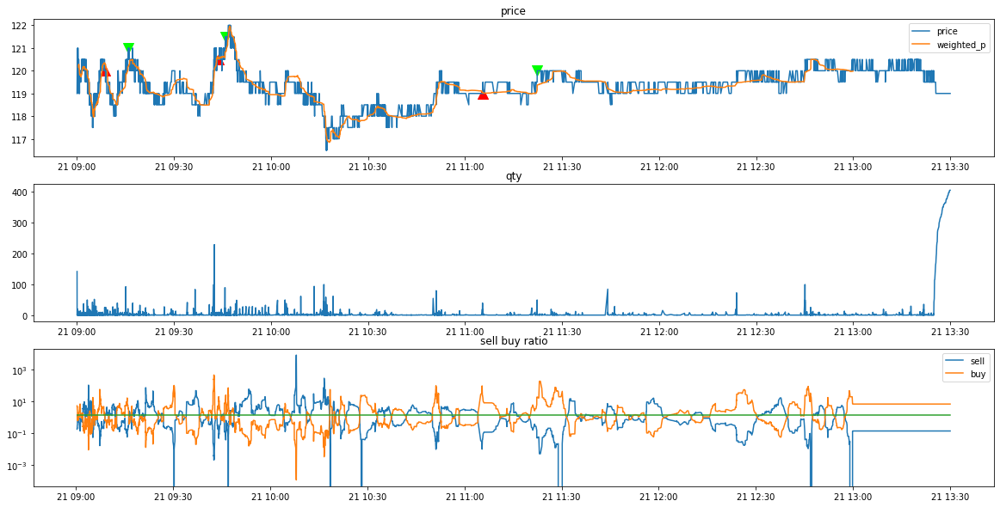

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-24/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-24/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
122.5
90003434
*** bid1_p:  117.5
*** weighted_p:  118.08
ask1_p:  118.0
num_sell:  15
num_buy:  54
tick_row_price:  118.0   yesterday_close:  119.0
進場時間： 90421127 
  sell price at  117.5
stop profit
出場時間： 90639553
POSITION(pre):  [118.]
Order_p(pre):  [118.5]
tick_row price:  119.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  -0.0
position:  []
tick_row_price 121.5
----------Result Report--------------
profit:  0.5


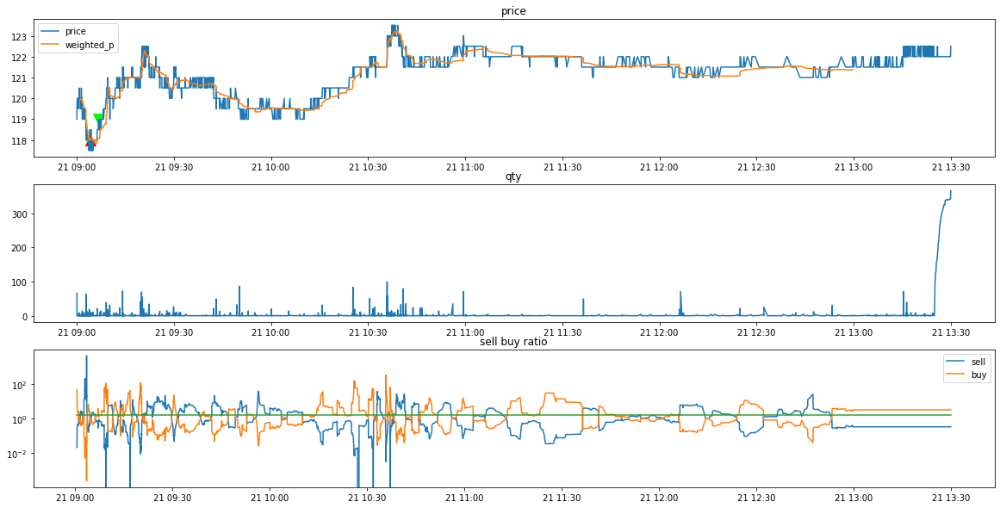

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-25/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-25/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
124.5
90005327
*** bid1_p:  125.5
*** weighted_p:  126.08620689655173
ask1_p:  126.0
num_sell:  20
num_buy:  51
tick_row_price:  126.0   yesterday_close:  122.5
進場時間： 91654910 
  sell price at  125.5
*** bid1_p:  123.5
*** weighted_p:  124.04676258992805
ask1_p:  124.0
num_sell:  19
num_buy:  51
tick_row_price:  124.0   yesterday_close:  122.5
進場時間： 112748282 
  sell price at  123.5
*** bid1_p:  123.5
*** weighted_p:  124.04411764705883
ask1_p:  124.0
num_sell:  15
num_buy:  55
tick_row_price:  124.0   yesterday_close:  122.5
進場時間： 112853328 
  sell price at  123.5
clear_position:  -0.5
position:  [126. 124. 124.]
tick_row_price 124.5
----------Result Report--------------
profit:  -0.5


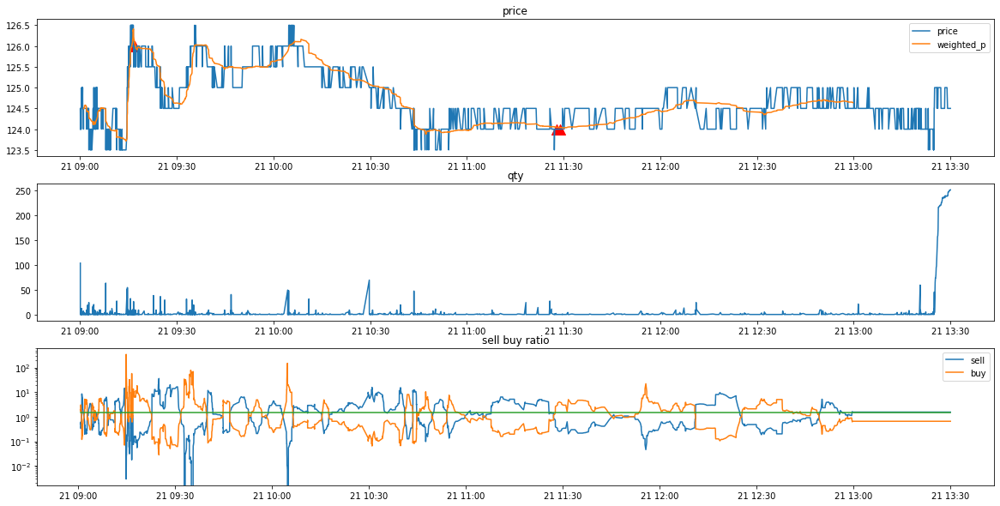

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-26/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-26/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
121.0
90007197
*** bid1_p:  123.5
*** weighted_p:  124.07
ask1_p:  124.0
num_sell:  19
num_buy:  106
tick_row_price:  124.0   yesterday_close:  124.5
進場時間： 91050814 
  sell price at  123.5
clear_position:  -3.5
position:  [124.]
tick_row_price 120.5
----------Result Report--------------
profit:  -3.5


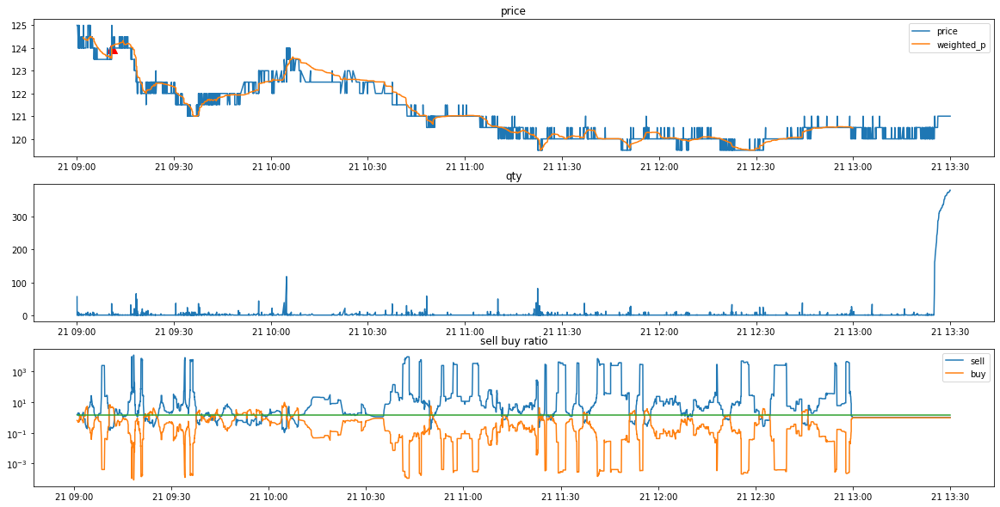

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-27/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-27/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
120.0
90004234
clear_position:  -0.0
position:  []
tick_row_price 119.5
----------Result Report--------------
profit:  0.0


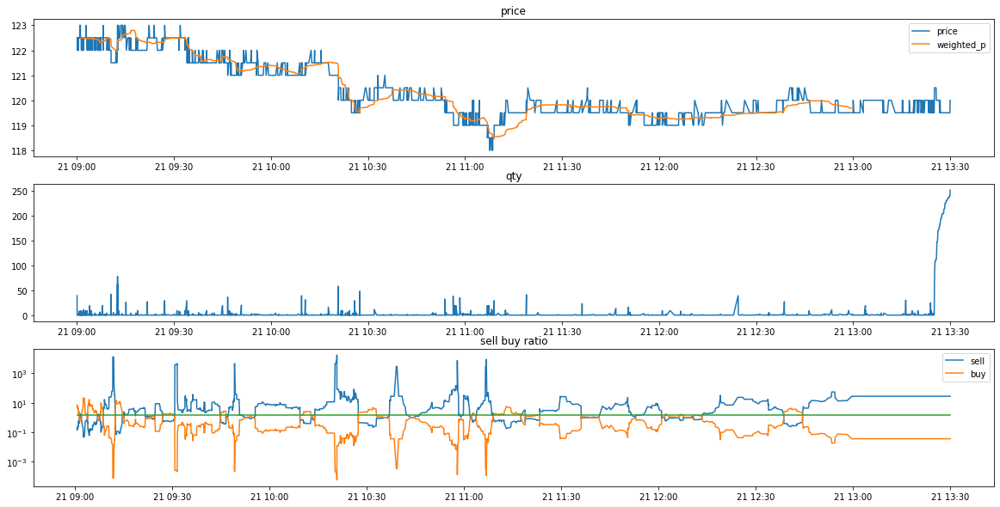

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-28/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-28/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.5
90007012
*** bid1_p:  120.0
*** weighted_p:  120.61714285714285
ask1_p:  120.5
num_sell:  25
num_buy:  53
tick_row_price:  120.5   yesterday_close:  120.0
進場時間： 103408490 
  sell price at  120.0
clear_position:  -1.5
position:  [120.5]
tick_row_price 119.0
----------Result Report--------------
profit:  -1.5


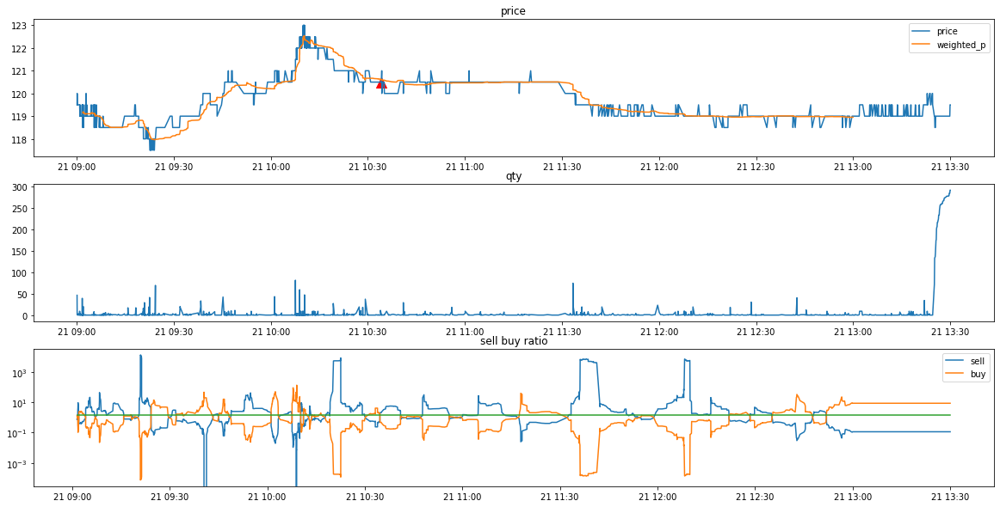

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-31/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-31/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.0
90008905
*** bid1_p:  119.0
*** weighted_p:  119.52464788732394
ask1_p:  119.5
num_sell:  24
num_buy:  55
tick_row_price:  119.5   yesterday_close:  119.5
進場時間： 91044591 
  sell price at  119.0
stop profit
出場時間： 91703709
POSITION(pre):  [119.5]
Order_p(pre):  [120.]
tick_row price:  120.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  119.5
*** weighted_p:  120.39606741573034
ask1_p:  120.0
num_sell:  39
num_buy:  59
tick_row_price:  120.0   yesterday_close:  119.5
進場時間： 92720880 
  sell price at  119.5
clear_position:  -2.5
position:  [120.]
tick_row_price 117.5
----------Result Report--------------
profit:  -2.0


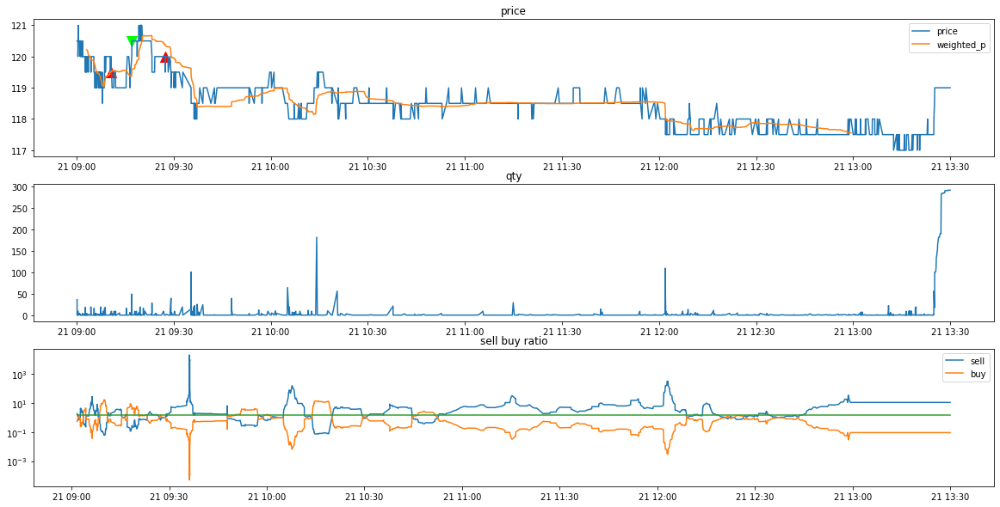

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-01/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-01/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.5
90009370
*** bid1_p:  118.5
*** weighted_p:  119.03153153153153
ask1_p:  119.0
num_sell:  11
num_buy:  51
tick_row_price:  119.0   yesterday_close:  119.0
進場時間： 90401274 
  sell price at  118.5
*** bid1_p:  116.5
*** weighted_p:  117.1123188405797
ask1_p:  117.0
num_sell:  22
num_buy:  51
tick_row_price:  117.0   yesterday_close:  119.0
進場時間： 91053997 
  sell price at  116.5
*** bid1_p:  115.5
*** weighted_p:  116.06410256410257
ask1_p:  116.0
num_sell:  19
num_buy:  54
tick_row_price:  116.0   yesterday_close:  119.0
進場時間： 103104734 
  sell price at  115.5
*** bid1_p:  118.0
*** weighted_p:  118.50314465408805
ask1_p:  118.5
num_sell:  23
num_buy:  67
tick_row_price:  118.5   yesterday_close:  119.0
進場時間： 105402068 


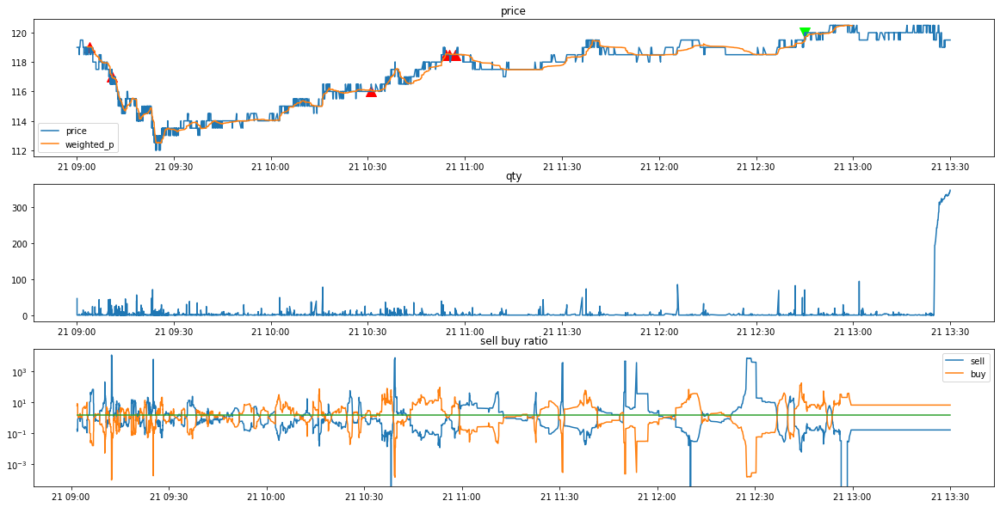

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-02/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-02/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.5
90003626
*** bid1_p:  118.5
*** weighted_p:  119.04166666666667
ask1_p:  119.0
num_sell:  44
num_buy:  82
tick_row_price:  118.5   yesterday_close:  119.5
進場時間： 120054258 
  sell price at  118.5
stop profit
出場時間： 121322679
POSITION(pre):  [119.]
Order_p(pre):  [119.5]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.0
*** weighted_p:  120.58238636363636
ask1_p:  120.5
num_sell:  1
num_buy:  79
tick_row_price:  120.5   yesterday_close:  119.5
進場時間： 123008626 
  sell price at  120.0
*** bid1_p:  120.0
*** weighted_p:  120.58659217877096
ask1_p:  120.5
num_sell:  7
num_buy:  67
tick_row_price:  120.0   yesterday_close:  119.5
進場時間： 123109017 
  sell price at  120.0
*

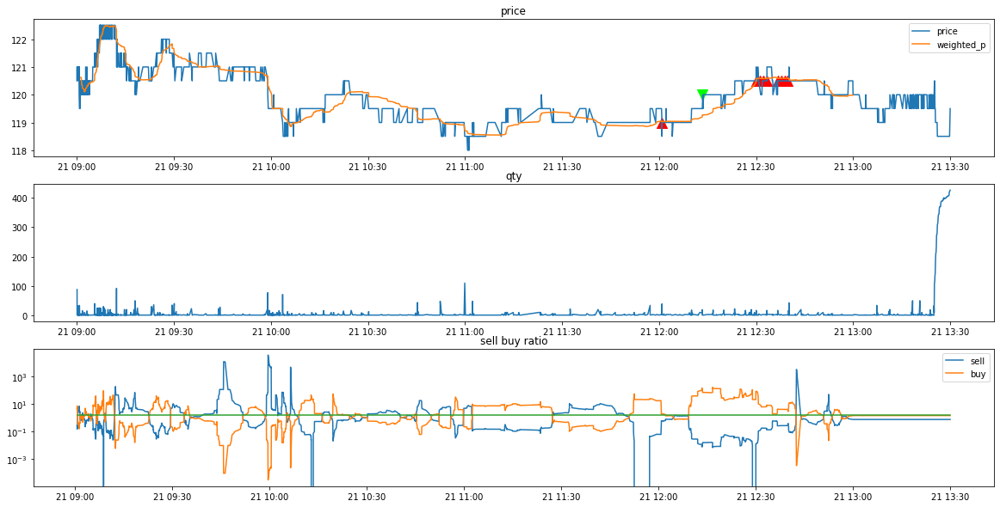

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-03/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-03/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
120.5
90005938
*** bid1_p:  122.0
*** weighted_p:  122.53807106598985
ask1_p:  122.5
num_sell:  9
num_buy:  66
tick_row_price:  122.5   yesterday_close:  119.5
進場時間： 92943047 
  sell price at  122.0
*** bid1_p:  121.5
*** weighted_p:  122.19756097560976
ask1_p:  122.0
num_sell:  58
num_buy:  90
tick_row_price:  122.0   yesterday_close:  119.5
進場時間： 95848214 
  sell price at  121.5
*** bid1_p:  121.5
*** weighted_p:  122.27960526315789
ask1_p:  122.0
num_sell:  26
num_buy:  52
tick_row_price:  121.5   yesterday_close:  119.5
進場時間： 112011088 
  sell price at  121.5
*** bid1_p:  121.5
*** weighted_p:  122.27302631578948
ask1_p:  122.0
num_sell:  26
num_buy:  52
tick_row_price:  122.0   yesterday_close:  119.5
進場時間： 112111254 


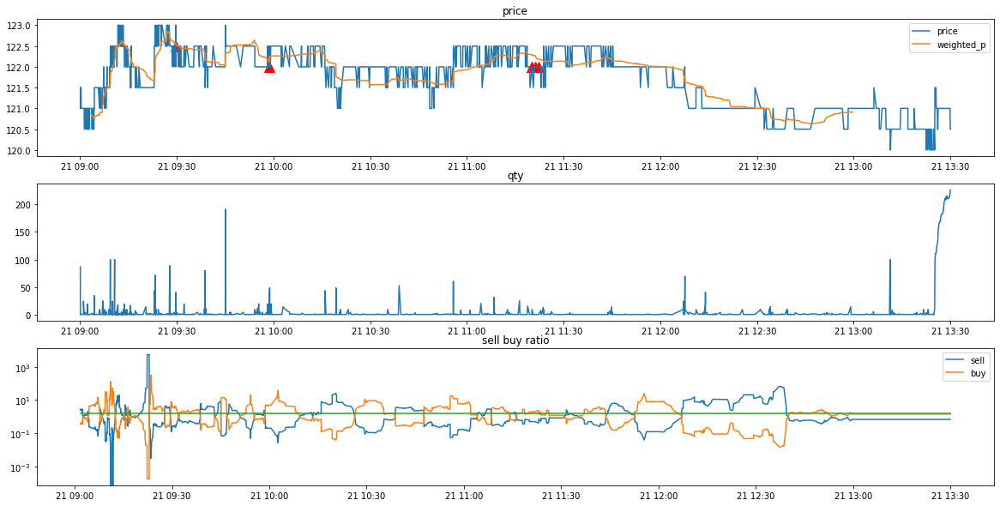

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-04/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-04/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
123.5
90008807
*** bid1_p:  118.5
*** weighted_p:  119.29292929292929
ask1_p:  119.0
num_sell:  42
num_buy:  66
tick_row_price:  119.0   yesterday_close:  120.5
進場時間： 91452625 
  sell price at  118.5
stop profit
出場時間： 93729147
POSITION(pre):  [119.]
Order_p(pre):  [119.5]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  119.5
*** weighted_p:  120.00471698113208
ask1_p:  120.0
num_sell:  40
num_buy:  71
tick_row_price:  120.0   yesterday_close:  120.5
進場時間： 95430510 
  sell price at  119.5
*** bid1_p:  119.5
*** weighted_p:  120.01435406698565
ask1_p:  120.0
num_sell:  32
num_buy:  51
tick_row_price:  119.5   yesterday_close:  120.5
進場時間： 95608642 
  sell price at  119.5
sto

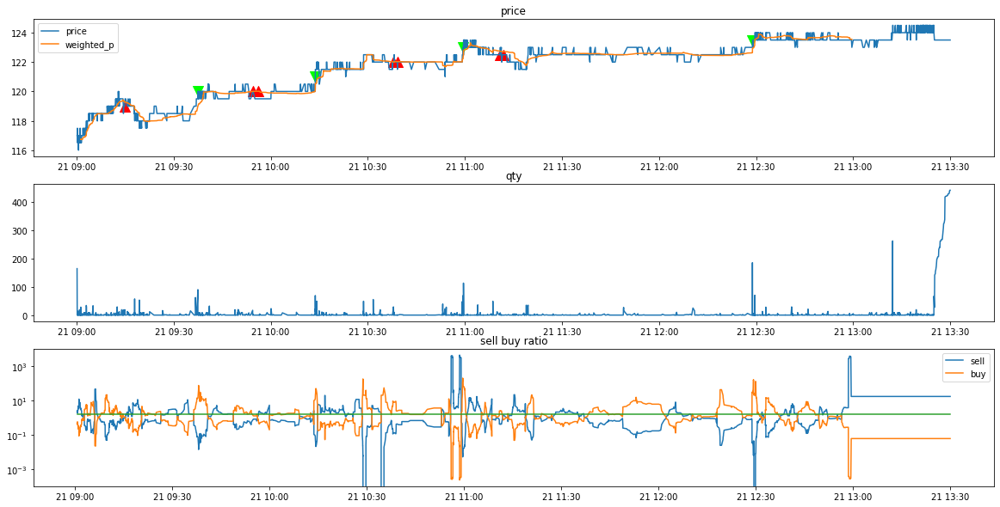

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-07/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-07/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.5
90006382
*** bid1_p:  121.5
*** weighted_p:  122.00704225352112
ask1_p:  122.0
num_sell:  26
num_buy:  58
tick_row_price:  122.0   yesterday_close:  123.5
進場時間： 112247724 
  sell price at  121.5
*** bid1_p:  121.5
*** weighted_p:  122.00689655172414
ask1_p:  122.0
num_sell:  12
num_buy:  63
tick_row_price:  121.5   yesterday_close:  123.5
進場時間： 112348506 
  sell price at  121.5
*** bid1_p:  121.0
*** weighted_p:  121.51530612244898
ask1_p:  121.5
num_sell:  18
num_buy:  51
tick_row_price:  121.5   yesterday_close:  123.5
進場時間： 115250368 
  sell price at  121.0
clear_position:  -7.0
position:  [122.  122.  121.5]
tick_row_price 119.5
----------Result Report--------------
profit:  -7.0


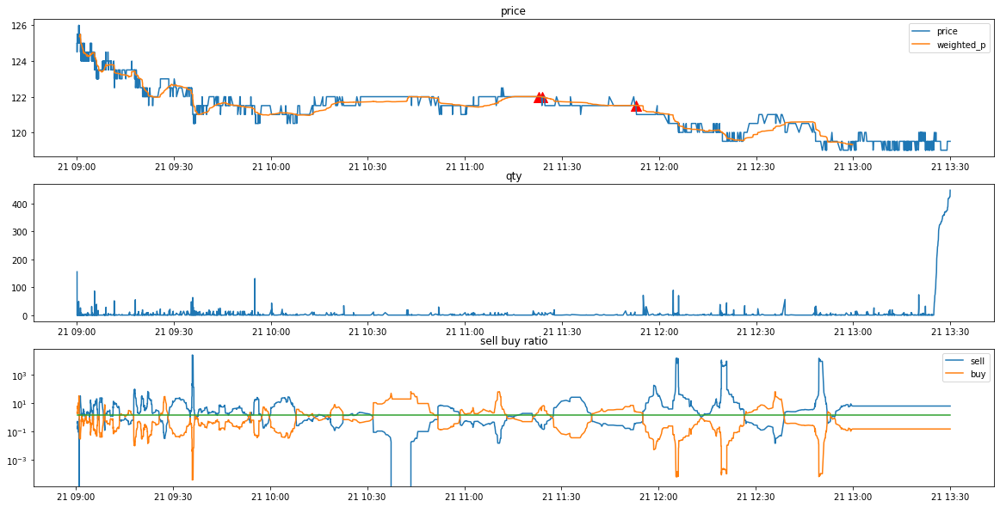

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-08/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-08/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
118.0
90006522
------Weird price!!!!!---------
At time:  113827161
tick_row_price 121.0
ask_1_p 121.5
bid_1_p 120.5
*** bid1_p:  118.0
*** weighted_p:  118.62345679012346
ask1_p:  118.5
num_sell:  24
num_buy:  64
tick_row_price:  118.0   yesterday_close:  119.5
進場時間： 121225800 
  sell price at  118.0
stop profit
出場時間： 125755827
POSITION(pre):  [118.5]
Order_p(pre):  [119.]
tick_row price:  119.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  -0.0
position:  []
tick_row_price 118.5
----------Result Report--------------
profit:  0.5


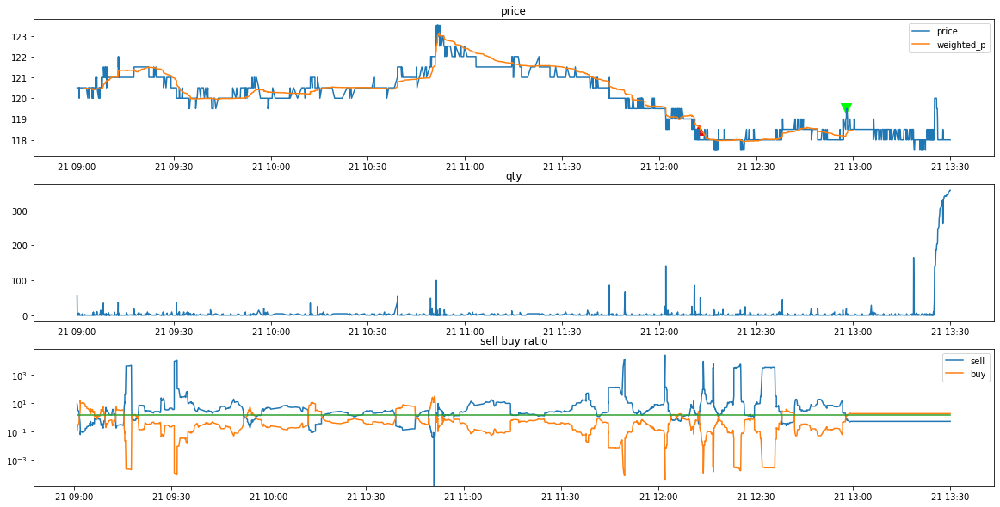

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.5
90007702
*** bid1_p:  117.0
*** weighted_p:  117.51764705882353
ask1_p:  117.5
num_sell:  12
num_buy:  115
tick_row_price:  118.0   yesterday_close:  118.0
進場時間： 110024562 
  sell price at  117.0
*** bid1_p:  117.0
*** weighted_p:  117.66747572815534
ask1_p:  117.5
num_sell:  46
num_buy:  109
tick_row_price:  117.5   yesterday_close:  118.0
進場時間： 110533893 
  sell price at  117.0
*** bid1_p:  117.0
*** weighted_p:  117.66747572815534
ask1_p:  117.5
num_sell:  46
num_buy:  109
tick_row_price:  117.5   yesterday_close:  118.0
進場時間： 110635272 
  sell price at  117.0
stop profit
出場時間： 111830851
POSITION(pre):  [117.5 117.5 117.5]
Order_p(pre):  [118. 118. 118.]
tick_row price:  118.5
qualified index:  [[0]
 [1]
 [2]]
POSI

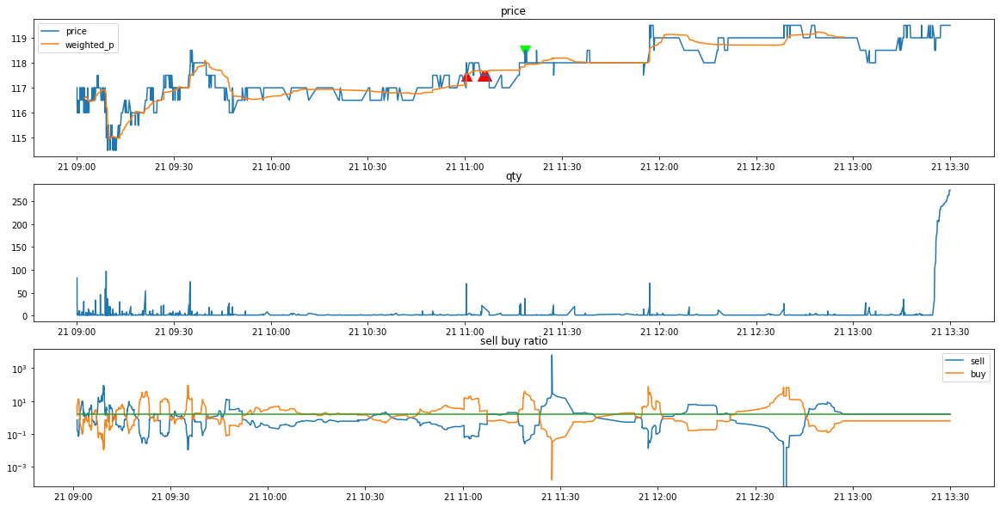

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.0
90009523
*** bid1_p:  120.5
*** weighted_p:  121.16455696202532
ask1_p:  121.0
num_sell:  44
num_buy:  88
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 91303539 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  121.07894736842105
ask1_p:  121.0
num_sell:  33
num_buy:  57
tick_row_price:  121.5   yesterday_close:  119.5
進場時間： 92813618 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  121.05654761904762
ask1_p:  121.0
num_sell:  38
num_buy:  63
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 93352589 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  121.06741573033707
ask1_p:  121.0
num_sell:  24
num_buy:  61
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 93748293 
 

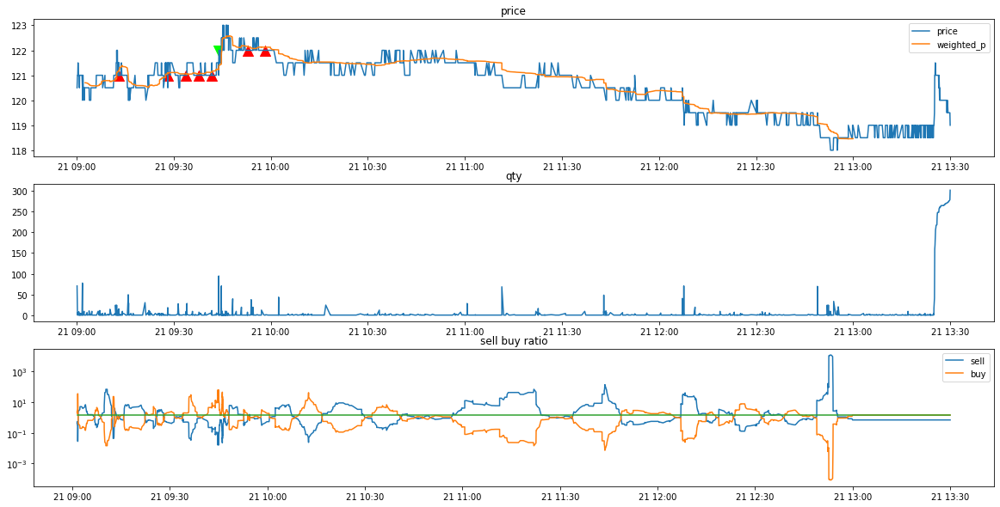

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.5
90008401
*** bid1_p:  118.0
*** weighted_p:  118.52903225806452
ask1_p:  118.5
num_sell:  20
num_buy:  75
tick_row_price:  119.0   yesterday_close:  119.0
進場時間： 93913649 
  sell price at  118.0
stop profit
出場時間： 93913682
POSITION(pre):  [118.5]
Order_p(pre):  [119.]
tick_row price:  119.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  119.0
*** weighted_p:  119.53947368421052
ask1_p:  119.5
num_sell:  15
num_buy:  60
tick_row_price:  119.5   yesterday_close:  119.0
進場時間： 105006781 
  sell price at  119.0
*** bid1_p:  119.0
*** weighted_p:  119.51304347826087
ask1_p:  119.5
num_sell:  14
num_buy:  64
tick_row_price:  119.0   yesterday_close:  119.0
進場時間： 105106868 
  sell price at  119.0
*

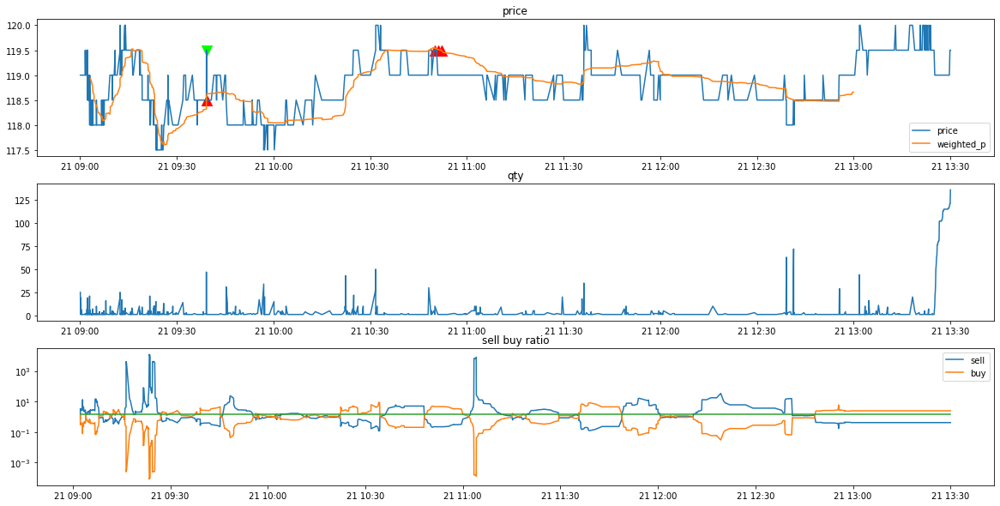

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
123.5
90009325
*** bid1_p:  120.5
*** weighted_p:  121.23096446700508
ask1_p:  121.0
num_sell:  33
num_buy:  52
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 93605276 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  121.02666666666667
ask1_p:  121.0
num_sell:  6
num_buy:  62
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 94447597 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  121.00980392156863
ask1_p:  121.0
num_sell:  10
num_buy:  89
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 94705848 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  121.00357142857143
ask1_p:  121.0
num_sell:  10
num_buy:  74
tick_row_price:  121.0   yesterday_close:  119.5
進場時間： 94807455 
  

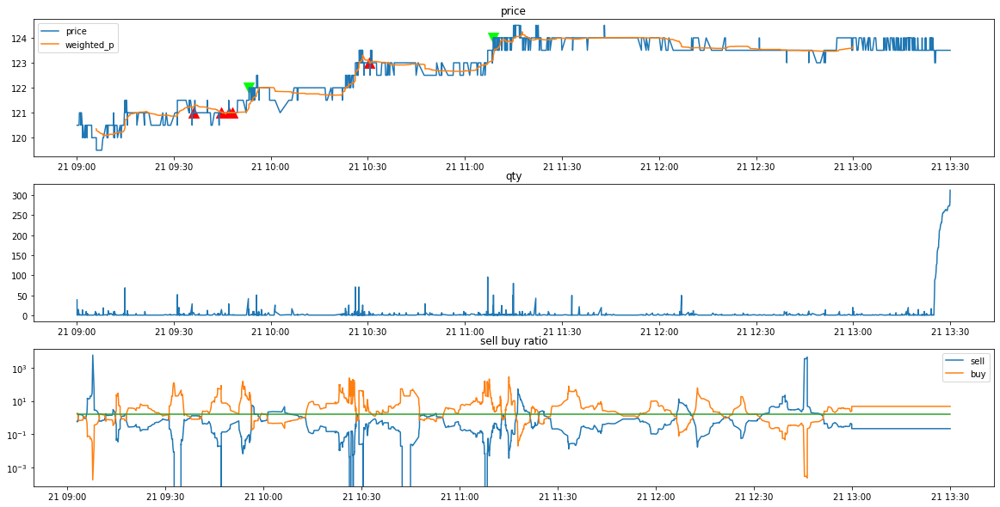

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
122.0
90006445
clear_position:  -0.0
position:  []
tick_row_price 123.0
----------Result Report--------------
profit:  0.0


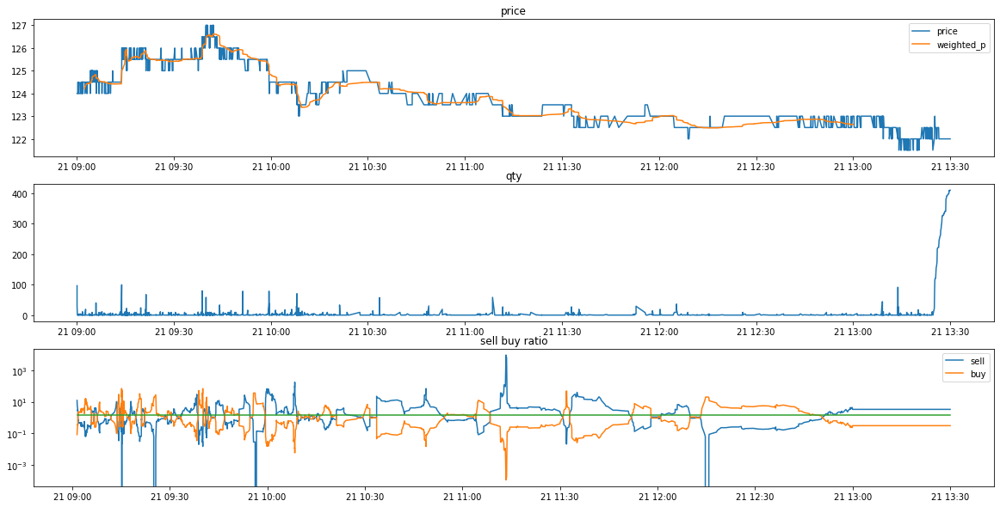

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
120.0
90004725
clear_position:  -0.0
position:  []
tick_row_price 121.0
----------Result Report--------------
profit:  0.0


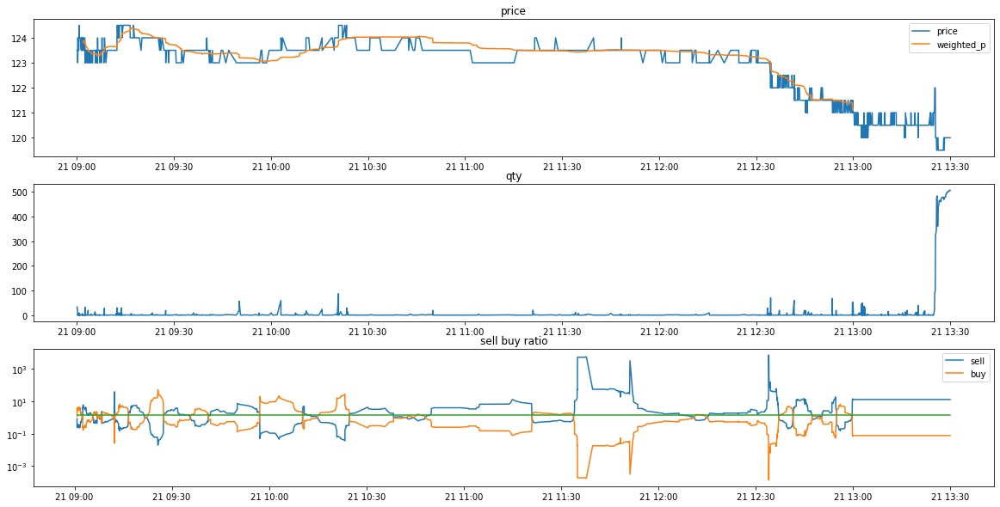

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
121.0
90007157
*** bid1_p:  121.0
*** weighted_p:  121.57608695652173
ask1_p:  121.5
num_sell:  41
num_buy:  62
tick_row_price:  121.5   yesterday_close:  120.0
進場時間： 92929214 
  sell price at  121.0
stop profit
出場時間： 94033783
POSITION(pre):  [121.5]
Order_p(pre):  [122.]
tick_row price:  122.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.5
*** weighted_p:  121.06849315068493
ask1_p:  121.0
num_sell:  3
num_buy:  52
tick_row_price:  121.5   yesterday_close:  120.0
進場時間： 113534468 
  sell price at  120.5
stop profit
出場時間： 125405161
POSITION(pre):  [121.]
Order_p(pre):  [121.5]
tick_row price:  122.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  -0.0
posit

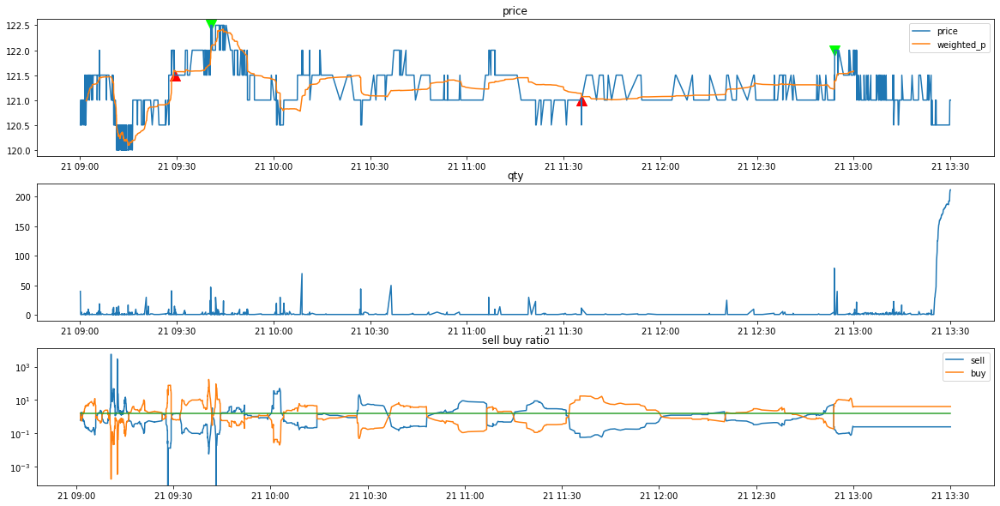

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
124.0
90008684
*** bid1_p:  122.0
*** weighted_p:  122.50746268656717
ask1_p:  122.5
num_sell:  16
num_buy:  51
tick_row_price:  122.5   yesterday_close:  121.0
進場時間： 90830091 
  sell price at  122.0
stop profit
出場時間： 94435873
POSITION(pre):  [122.5]
Order_p(pre):  [123.]
tick_row price:  123.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.5
*** weighted_p:  124.15449438202248
ask1_p:  124.0
num_sell:  18
num_buy:  69
tick_row_price:  124.0   yesterday_close:  121.0
進場時間： 101437788 
  sell price at  123.5
*** bid1_p:  122.5
*** weighted_p:  123.00206611570248
ask1_p:  123.0
num_sell:  21
num_buy:  53
tick_row_price:  122.5   yesterday_close:  121.0
進場時間： 123411219 
  sell price at  122.5
c

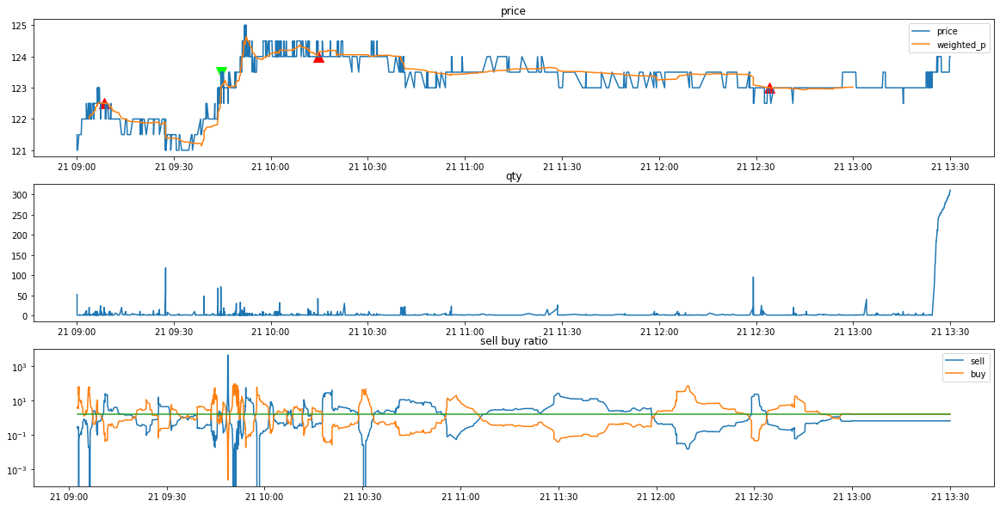

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
119.0
90007181
*** bid1_p:  122.0
*** weighted_p:  122.51621621621622
ask1_p:  122.5
num_sell:  19
num_buy:  56
tick_row_price:  122.5   yesterday_close:  124.0
進場時間： 94154715 
  sell price at  122.0
*** bid1_p:  121.5
*** weighted_p:  122.07077625570776
ask1_p:  122.0
num_sell:  20
num_buy:  53
tick_row_price:  122.0   yesterday_close:  124.0
進場時間： 94832656 
  sell price at  121.5
clear_position:  -4.5
position:  [122.5 122. ]
tick_row_price 120.0
----------Result Report--------------
profit:  -4.5


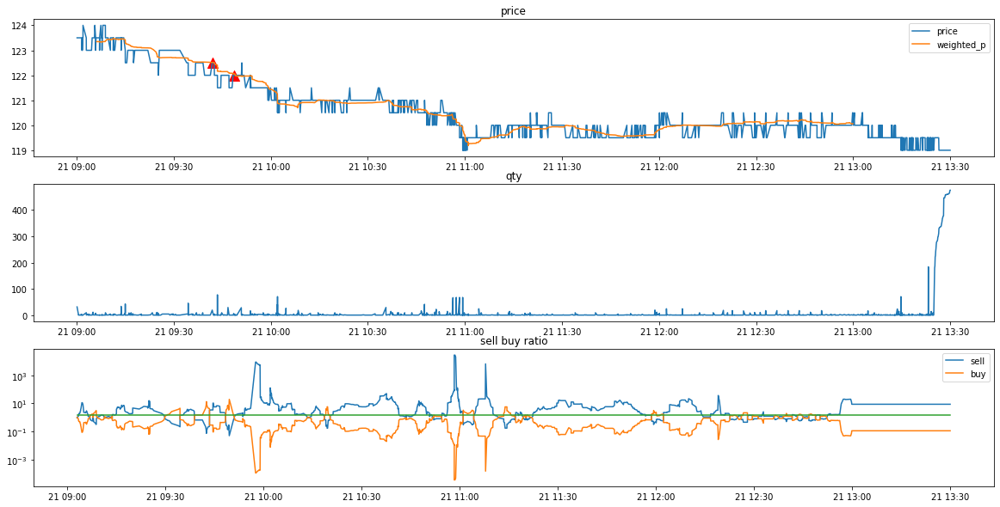

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
113.5
90007635
clear_position:  -0.0
position:  []
tick_row_price 114.5
----------Result Report--------------
profit:  0.0


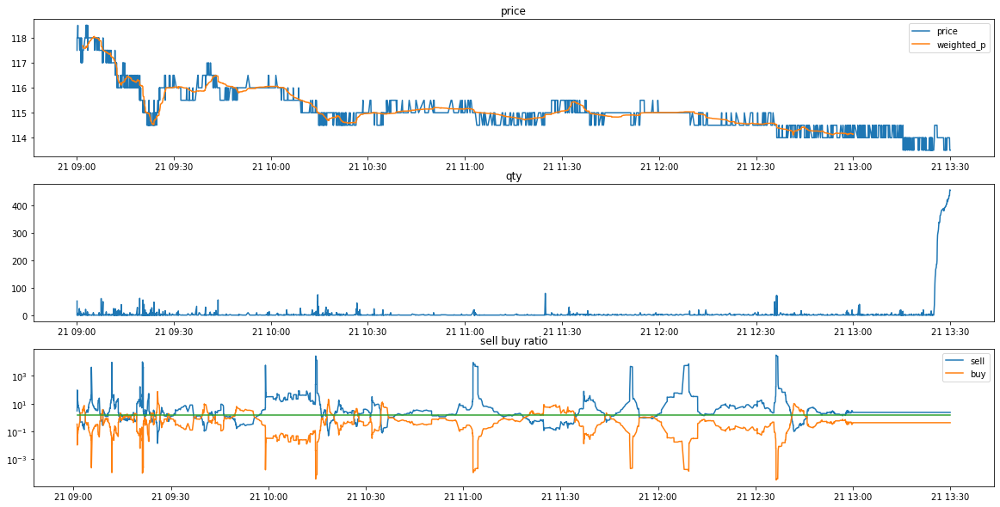

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
110.5
90005184
*** bid1_p:  110.5
*** weighted_p:  111.05847953216374
ask1_p:  111.0
num_sell:  14
num_buy:  55
tick_row_price:  111.0   yesterday_close:  113.5
進場時間： 94505958 
  sell price at  110.5
stop profit
出場時間： 95259501
POSITION(pre):  [111.]
Order_p(pre):  [111.5]
tick_row price:  112.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  111.5
*** weighted_p:  112.07055214723927
ask1_p:  112.0
num_sell:  39
num_buy:  65
tick_row_price:  112.0   yesterday_close:  113.5
進場時間： 100953943 
  sell price at  111.5
*** bid1_p:  111.5
*** weighted_p:  112.00354609929079
ask1_p:  112.0
num_sell:  24
num_buy:  60
tick_row_price:  112.0   yesterday_close:  113.5
進場時間： 101134733 
  sell price at  111.5
c

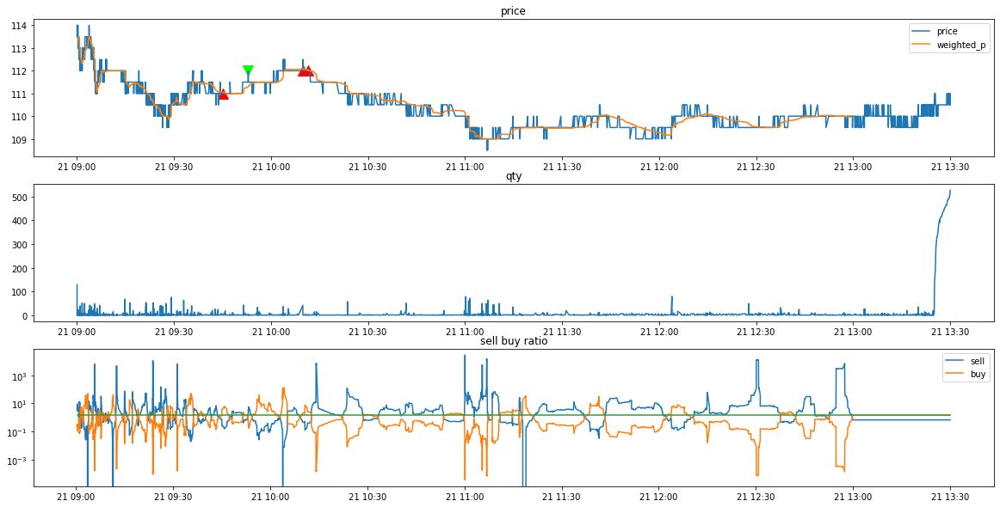

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
104.5
90003100
clear_position:  -0.0
position:  []
tick_row_price 104.5
----------Result Report--------------
profit:  0.0


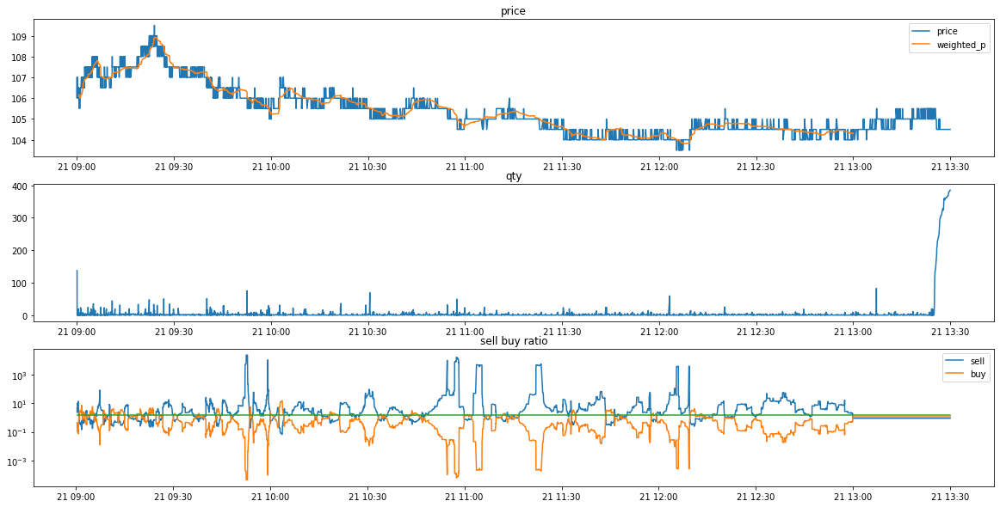

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
101.0
90006331
*** bid1_p:  99.9
*** weighted_p:  100.04718309859153
ask1_p:  100.0
num_sell:  15
num_buy:  55
tick_row_price:  100.0   yesterday_close:  104.5
進場時間： 123104289 
  sell price at  99.9
*** bid1_p:  99.9
*** weighted_p:  100.14275362318838
ask1_p:  100.0
num_sell:  25
num_buy:  70
tick_row_price:  100.0   yesterday_close:  104.5
進場時間： 123306185 
  sell price at  99.9
stop profit
出場時間： 124123235
POSITION(pre):  [100. 100.]
Order_p(pre):  [100.5 100.5]
tick_row price:  101.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

clear_position:  -0.0
position:  []
tick_row_price 101.5
----------Result Report--------------
profit:  1.0


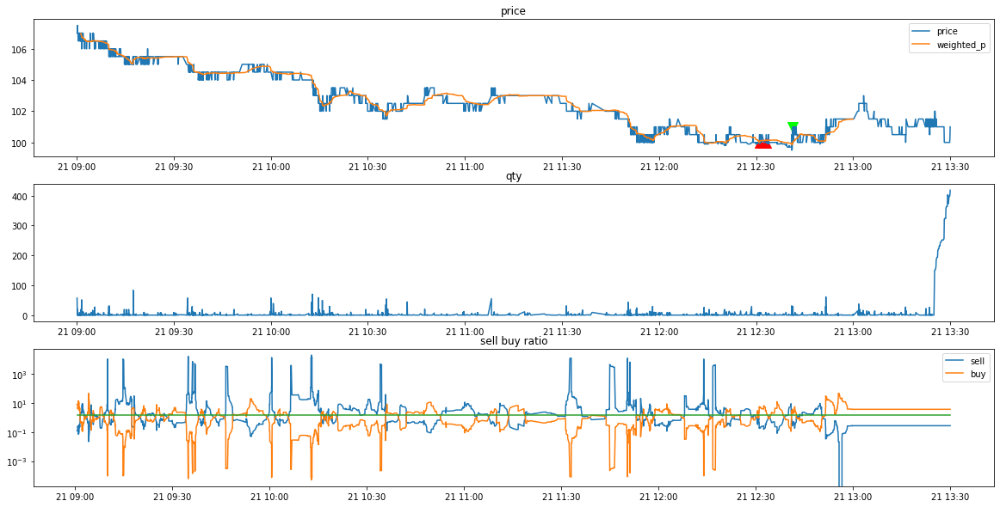

In [14]:
para = {"sid": "6278", "beta":1.5, "time_out": 2000000, "gamma": 25, "cool_down_min": 100000, "stop_loss_factor": 1.1, "theta": 1, "position_max_q": 30, "qty_bound": 50, "weighted_factor": 50}

res_6278 = back_test(dt.datetime(2020, 8, 1), dt.datetime(2020, 9, 25), **para)
profit_6278, cost_6278 = calculate_profit(res_6278)

In [15]:
profit_6278, cost_6278 = calculate_profit(res_6278)

In [16]:

profit_6278

-83.5

In [17]:
cost_6278

15293.0

#### 2002


In [ ]:
para = {"sid": "2002", "beta":2, "time_out": 2000000, "gamma": 0.75, "cool_down_min": 100000, "stop_loss_factor": 1.02, "theta": 1.0025, "position_max_q": 10}
res_2002 = back_test(dt.datetime(2020, 9, 9), dt.datetime(2020, 9, 25), **para)
profit_2002, cost_2002 = calculate_profit(res_2002)

In [ ]:
profit_2002

In [ ]:
cost_2002

#### 2454


In [ ]:
para = {"sid": "2454", "beta":1, "time_out": 2000000, "gamma": 1, "cool_down_min": 100000, "stop_loss_factor": 1.1, "theta": 1.0025, "position_max_q": 10}

res_2454 = back_test(dt.datetime(2020, 7, 27), dt.datetime(2020, 9, 25), **para)
profit_2454, cost_2454 = calculate_profit(res_2454)

In [ ]:
profit_2454

In [ ]:
cost_2454

#### 2317



In [ ]:
para = {"sid": "2317", "beta":2, "time_out": 2000000, "gamma": 0.75, "cool_down_min": 100000, "stop_loss_factor": 1.02, "theta": 1.0025, "position_max_q": 10}

res_2317 = back_test(dt.datetime(2020, 9, 9), dt.datetime(2020, 9, 25), **para)
profit_2317, cost_2317 = calculate_profit(res_2317)

In [ ]:
profit_2317

3.899999999999835

In [ ]:
cost_2317

4612.8

### 2912

In [ ]:
para = {"sid": "2912", "beta":2, "time_out": 2000000, "gamma": 0.75, "cool_down_min": 100000, "stop_loss_factor": 1.02, "theta": 1.0025, "position_max_q": 10}

res_2912 = back_test(dt.datetime(2020, 9, 9), dt.datetime(2020, 9, 25), **para)
profit_2912, cost_2912 = calculate_profit(res_2912)

In [ ]:
profit_2912

0.5

In [ ]:
cost_2912

9224.5

### 6278

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-09/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-09/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003196
*** bid1_p:  140.5
*** weighted_p:  140.4923076923077
ask1_p:  141.0
num_sell:  41
num_buy:  24
進場時間： 90959160 
  sell price at  140.5
stop profit
出場時間： 91001834
POSITION(pre):  [140.5]
Order_p(pre):  [140.]
tick_row price:  140.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  140.0
*** weighted_p:  139.95882352941177
ask1_p:  140.5
num_sell:  75
num_buy:  10
進場時間： 91250310 
  sell price at  140.0
stop profit
出場時間： 91310093
POSITION(pre):  [140.]
Order_p(pre):  [139.5]
tick_row price:  139.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  140.0
*** weighted_p:  139.68503937007873
ask1_p:  140.5
num_sell:  82
num_buy:  45
進場時間： 91457747 
  sell price at  140

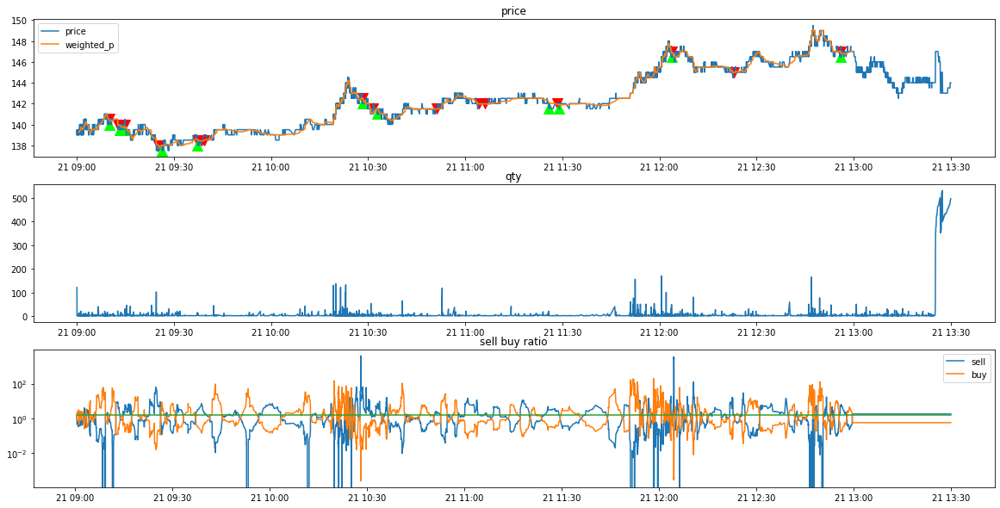

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-10/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-10/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002142
*** bid1_p:  143.0
*** weighted_p:  142.65714285714284
ask1_p:  143.5
num_sell:  24
num_buy:  11
進場時間： 90201518 
  sell price at  143.0
stop profit
出場時間： 90211298
POSITION(pre):  [143.]
Order_p(pre):  [142.5]
tick_row price:  142.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  141.5
*** weighted_p:  141.45384615384614
ask1_p:  142.0
num_sell:  57
num_buy:  8
進場時間： 90331721 
  sell price at  141.5
stop profit
出場時間： 90333011
POSITION(pre):  [141.5]
Order_p(pre):  [141.]
tick_row price:  141.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  144.0
*** weighted_p:  143.96666666666667
ask1_p:  144.5
num_sell:  44
num_buy:  16
進場時間： 90700725 
  sell price at  144

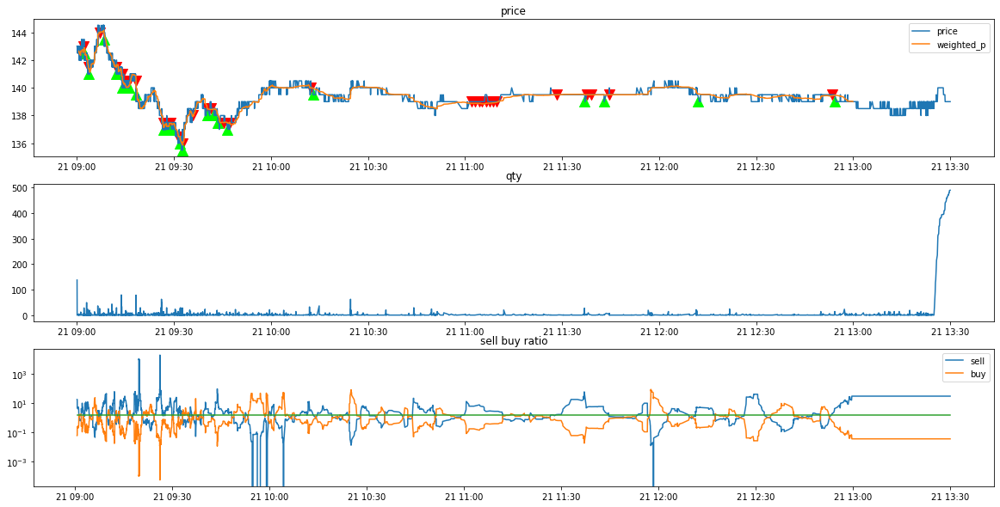

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-13/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-13/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005402
*** bid1_p:  141.5
*** weighted_p:  141.40677966101694
ask1_p:  142.0
num_sell:  45
num_buy:  14
進場時間： 90325053 
  sell price at  141.5
stop profit
出場時間： 90401547
POSITION(pre):  [141.5]
Order_p(pre):  [141.]
tick_row price:  141.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  140.5
*** weighted_p:  140.19666666666666
ask1_p:  141.0
num_sell:  144
num_buy:  6
進場時間： 90837741 
  sell price at  140.5
stop profit
出場時間： 90837741
POSITION(pre):  [140.5]
Order_p(pre):  [140.]
tick_row price:  140.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  140.5
*** weighted_p:  140.02475247524754
ask1_p:  141.0
num_sell:  70
num_buy:  31
進場時間： 91101076 
  sell price at  14

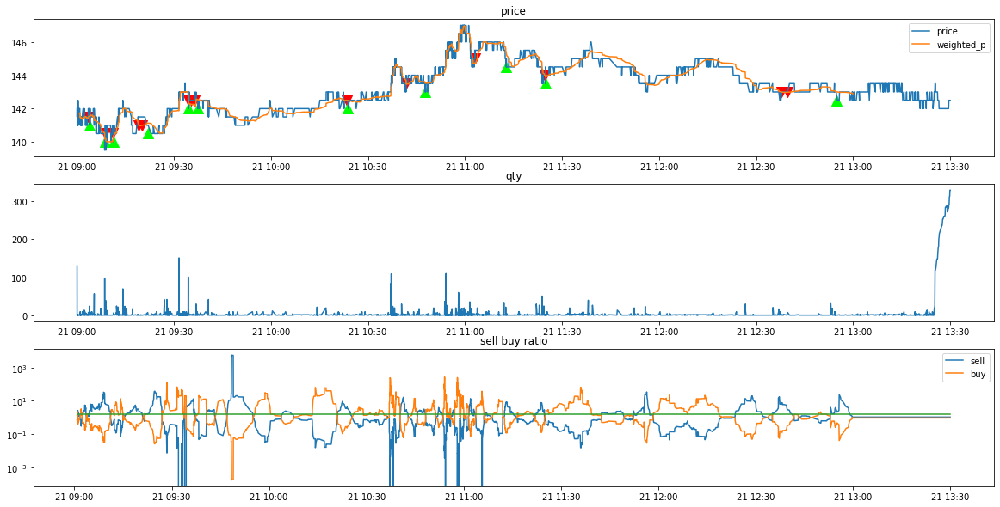

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-14/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-14/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004459
*** bid1_p:  142.5
*** weighted_p:  142.23076923076923
ask1_p:  143.0
num_sell:  23
num_buy:  3
進場時間： 90200625 
  sell price at  142.5
stop profit
出場時間： 90201265
POSITION(pre):  [142.5]
Order_p(pre):  [142.]
tick_row price:  142.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  141.0
*** weighted_p:  140.72368421052633
ask1_p:  141.5
num_sell:  38
num_buy:  0
進場時間： 90514485 
  sell price at  141.0
*** bid1_p:  143.0
*** weighted_p:  142.95348837209303
ask1_p:  143.5
num_sell:  30
num_buy:  13
進場時間： 90722414 
  sell price at  143.0
stop profit
出場時間： 90725341
POSITION(pre):  [141. 143.]
Order_p(pre):  [140.5 142.5]
tick_row price:  142.5
qualified index:  [[1]]
POSITION(post):  [141.]
Ord

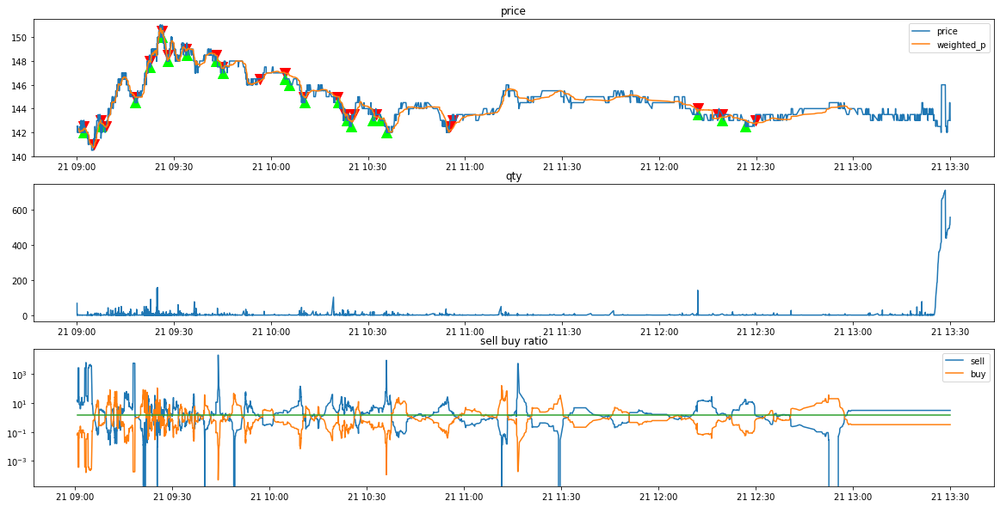

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-15/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-15/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003488
*** bid1_p:  145.5
*** weighted_p:  145.19230769230768
ask1_p:  146.0
num_sell:  24
num_buy:  15
進場時間： 90424524 
  sell price at  145.5
stop profit
出場時間： 90425446
POSITION(pre):  [145.5]
Order_p(pre):  [145.]
tick_row price:  145.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  145.5
*** weighted_p:  145.47058823529412
ask1_p:  146.0
num_sell:  55
num_buy:  13
進場時間： 90525087 
  sell price at  145.5
*** bid1_p:  146.0
*** weighted_p:  145.87962962962962
ask1_p:  146.5
num_sell:  40
num_buy:  14
進場時間： 90639571 
  sell price at  146.0
stop profit
出場時間： 90707191
POSITION(pre):  [145.5 146. ]
Order_p(pre):  [145.  145.5]
tick_row price:  145.5
qualified index:  [[1]]
POSITION(post):  [145.5

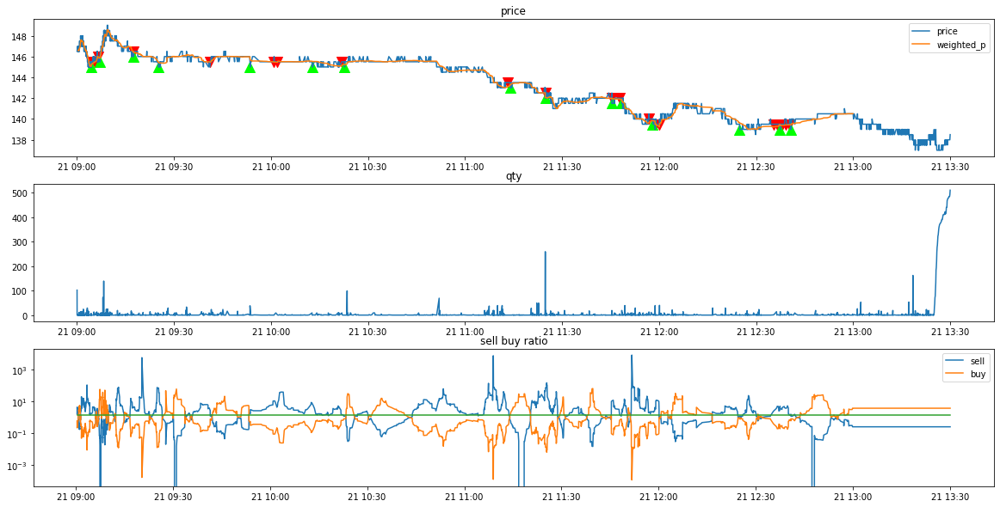

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-16/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-16/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005497
*** bid1_p:  138.0
*** weighted_p:  137.98507462686567
ask1_p:  138.5
num_sell:  47
num_buy:  20
進場時間： 90344436 
  sell price at  138.0
stop profit
出場時間： 90344436
POSITION(pre):  [138.]
Order_p(pre):  [137.5]
tick_row price:  137.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  138.0
*** weighted_p:  137.8921568627451
ask1_p:  138.5
num_sell:  31
num_buy:  20
進場時間： 90505646 
  sell price at  138.0
*** bid1_p:  139.0
*** weighted_p:  138.5
ask1_p:  139.5
num_sell:  45
num_buy:  17
進場時間： 90611249 
  sell price at  139.0
stop profit
出場時間： 90613395
POSITION(pre):  [138. 139.]
Order_p(pre):  [137.5 138.5]
tick_row price:  138.5
qualified index:  [[1]]
POSITION(post):  [138.]
Order_p(post): 

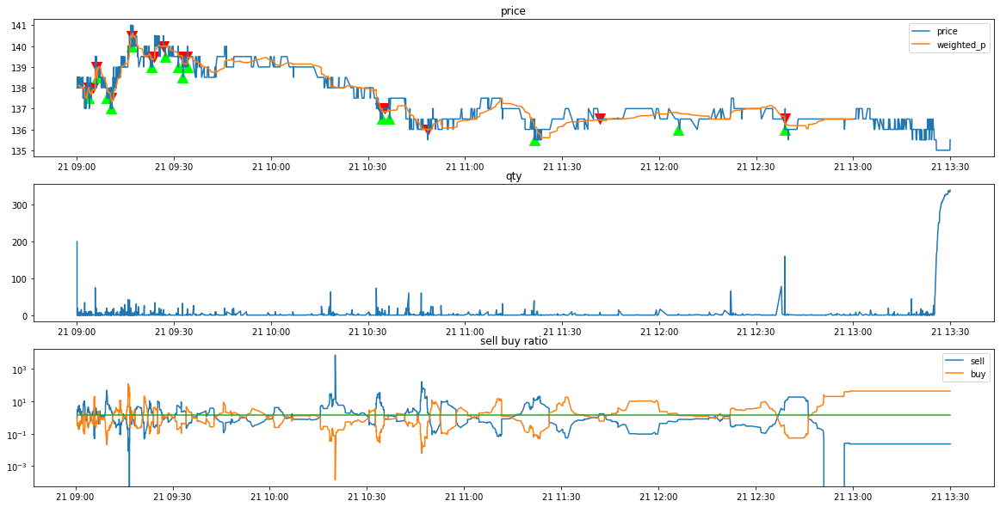

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-17/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-17/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007128
*** bid1_p:  140.0
*** weighted_p:  139.97692307692307
ask1_p:  140.5
num_sell:  45
num_buy:  20
進場時間： 90434611 
  sell price at  140.0
stop profit
出場時間： 90441373
POSITION(pre):  [140.]
Order_p(pre):  [139.5]
tick_row price:  139.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  139.0
*** weighted_p:  138.9939024390244
ask1_p:  139.5
num_sell:  56
num_buy:  26
進場時間： 90659231 
  sell price at  139.0
stop profit
出場時間： 90659231
POSITION(pre):  [139.]
Order_p(pre):  [138.5]
tick_row price:  138.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  138.5
*** weighted_p:  138.49295774647888
ask1_p:  139.0
num_sell:  46
num_buy:  25
進場時間： 90948940 
  sell price at  138

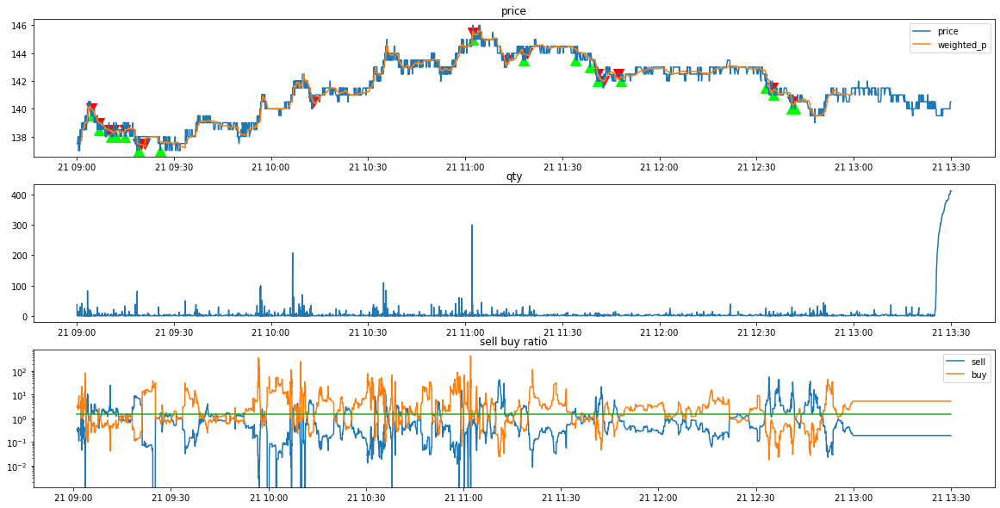

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-20/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-20/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002848
*** bid1_p:  144.0
*** weighted_p:  143.98214285714286
ask1_p:  144.5
num_sell:  17
num_buy:  11
進場時間： 90203324 
  sell price at  144.0
stop profit
出場時間： 90213375
POSITION(pre):  [144.]
Order_p(pre):  [143.5]
tick_row price:  143.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  142.5
*** weighted_p:  142.1918604651163
ask1_p:  143.0
num_sell:  70
num_buy:  16
進場時間： 90306164 
  sell price at  142.5
stop profit
出場時間： 90307057
POSITION(pre):  [142.5]
Order_p(pre):  [142.]
tick_row price:  142.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  142.0
*** weighted_p:  141.9848484848485
ask1_p:  142.5
num_sell:  61
num_buy:  5
進場時間： 90418344 
  sell price at  142.0

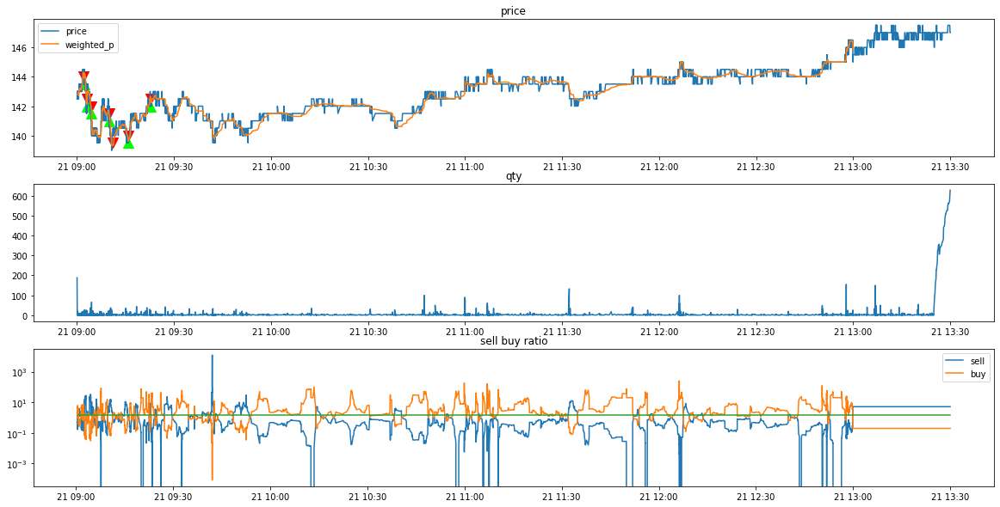

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-21/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-21/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002436
*** bid1_p:  145.0
*** weighted_p:  144.86666666666667
ask1_p:  145.5
num_sell:  23
num_buy:  7
進場時間： 90756853 
  sell price at  145.0
stop profit
出場時間： 90800608
POSITION(pre):  [145.]
Order_p(pre):  [144.5]
tick_row price:  144.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  145.0
*** weighted_p:  144.95652173913044
ask1_p:  145.5
num_sell:  30
num_buy:  16
進場時間： 90856927 
  sell price at  145.0
stop profit
出場時間： 90856927
POSITION(pre):  [145.]
Order_p(pre):  [144.5]
tick_row price:  144.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  146.0
*** weighted_p:  145.86507936507937
ask1_p:  146.5
num_sell:  45
num_buy:  18
進場時間： 91306599 
  sell price at  146

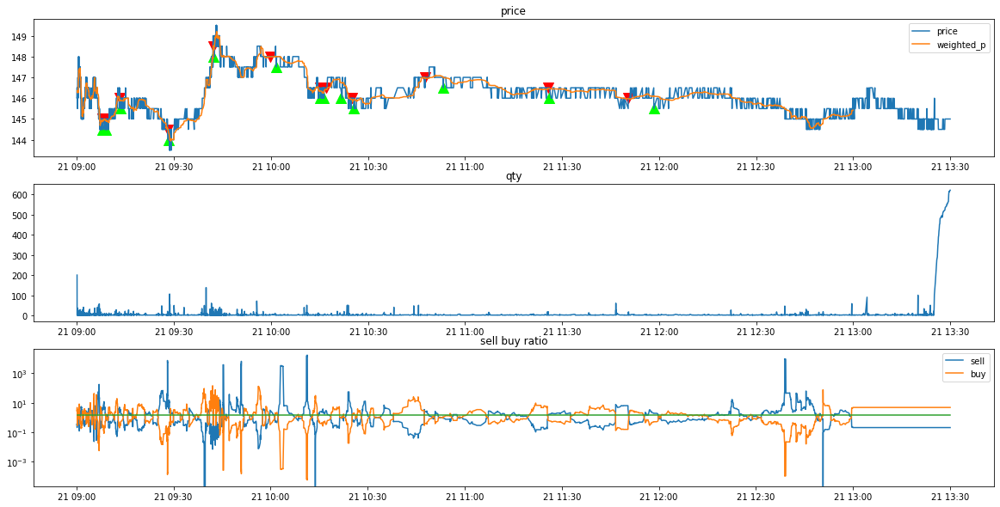

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-22/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-22/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002683
*** bid1_p:  147.5
*** weighted_p:  147.46491228070175
ask1_p:  148.0
num_sell:  36
num_buy:  21
進場時間： 90220071 
  sell price at  147.5
stop profit
出場時間： 90235636
POSITION(pre):  [147.5]
Order_p(pre):  [147.]
tick_row price:  147.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  148.5
*** weighted_p:  148.44736842105263
ask1_p:  149.0
num_sell:  23
num_buy:  15
進場時間： 90426249 
  sell price at  148.5
stop profit
出場時間： 90426764
POSITION(pre):  [148.5]
Order_p(pre):  [148.]
tick_row price:  148.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  147.5
*** weighted_p:  147.49107142857142
ask1_p:  148.0
num_sell:  38
num_buy:  18
進場時間： 90610107 
  sell price at  14

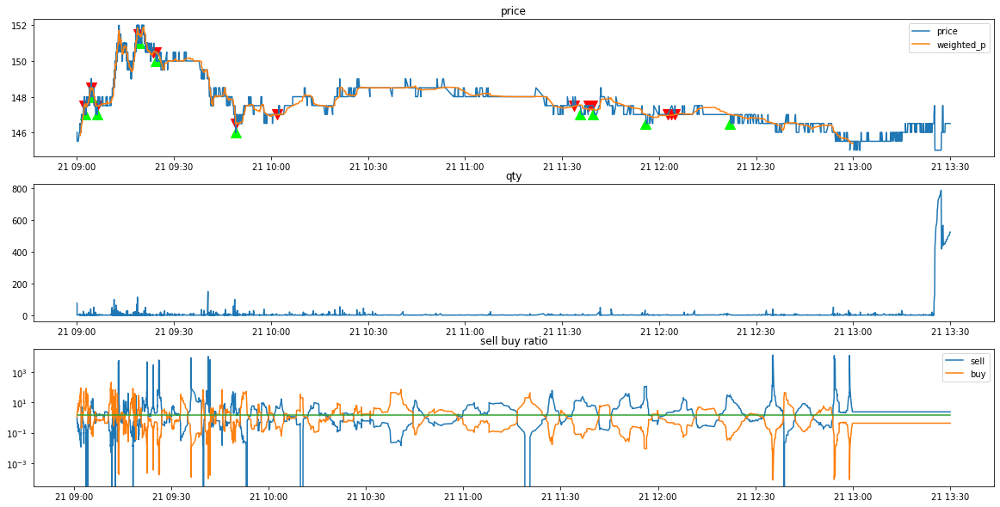

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-23/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-23/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003011
*** bid1_p:  147.0
*** weighted_p:  146.6206896551724
ask1_p:  147.5
num_sell:  87
num_buy:  29
進場時間： 91852010 
  sell price at  147.0
stop profit
出場時間： 91852185
POSITION(pre):  [147.]
Order_p(pre):  [146.5]
tick_row price:  146.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  147.0
*** weighted_p:  146.75
ask1_p:  147.5
num_sell:  45
num_buy:  29
進場時間： 92005803 
  sell price at  147.0
*** bid1_p:  147.5
*** weighted_p:  147.4878048780488
ask1_p:  148.0
num_sell:  28
num_buy:  13
進場時間： 92225311 
  sell price at  147.5
stop profit
出場時間： 92307548
POSITION(pre):  [147.  147.5]
Order_p(pre):  [146.5 147. ]
tick_row price:  147.0
qualified index:  [[1]]
POSITION(post):  [147.]
Order_p(post)

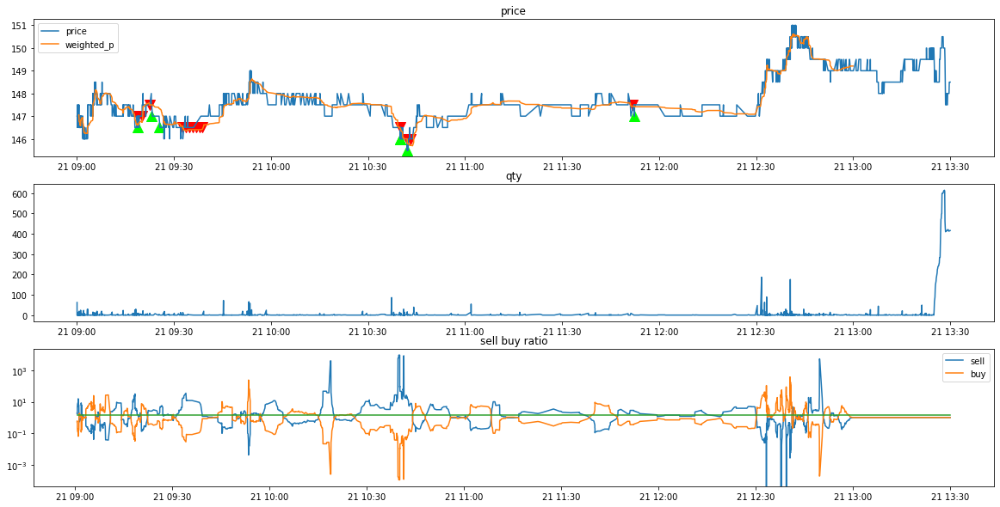

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-24/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-24/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005282
*** bid1_p:  149.0
*** weighted_p:  148.96464646464648
ask1_p:  149.5
num_sell:  76
num_buy:  23
進場時間： 90606416 
  sell price at  149.0
stop profit
出場時間： 90911390
POSITION(pre):  [149.]
Order_p(pre):  [148.5]
tick_row price:  148.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  148.5
*** weighted_p:  148.46341463414635
ask1_p:  149.0
num_sell:  26
num_buy:  15
進場時間： 91115272 
  sell price at  148.5
stop profit
出場時間： 91212260
POSITION(pre):  [148.5]
Order_p(pre):  [148.]
tick_row price:  148.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  148.0
*** weighted_p:  147.97619047619048
ask1_p:  148.5
num_sell:  75
num_buy:  9
進場時間： 91333880 
  sell price at  148

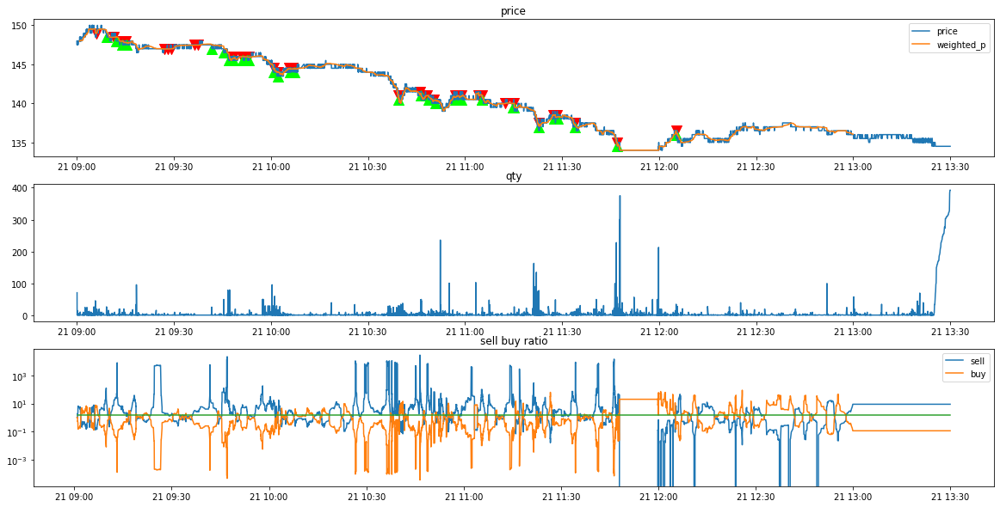

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-27/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-27/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002373
*** bid1_p:  134.5
*** weighted_p:  134.48684210526315
ask1_p:  135.0
num_sell:  102
num_buy:  12
進場時間： 90438170 
  sell price at  134.5
stop profit
出場時間： 90440467
POSITION(pre):  [134.5]
Order_p(pre):  [134.]
tick_row price:  134.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  133.0
*** weighted_p:  132.91666666666666
ask1_p:  133.5
num_sell:  44
num_buy:  28
進場時間： 90620354 
  sell price at  133.0
stop profit
出場時間： 90620354
POSITION(pre):  [133.]
Order_p(pre):  [132.5]
tick_row price:  132.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  135.5
*** weighted_p:  135.4047619047619
ask1_p:  136.0
num_sell:  53
num_buy:  10
進場時間： 91046509 
  sell price at  13

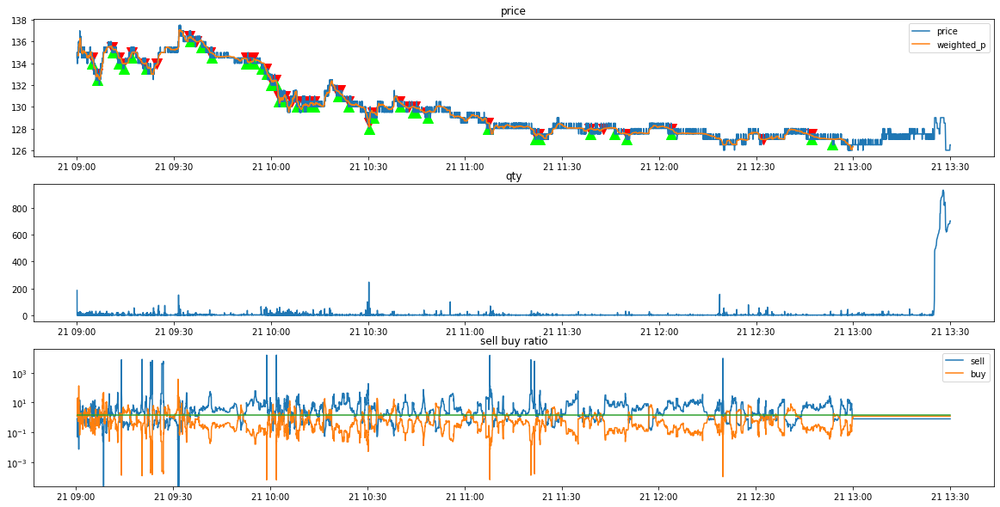

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-28/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-28/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002266
*** bid1_p:  129.5
*** weighted_p:  129.48863636363637
ask1_p:  130.0
num_sell:  32
num_buy:  12
進場時間： 91048648 
  sell price at  129.5
stop profit
出場時間： 91048648
POSITION(pre):  [129.5]
Order_p(pre):  [129.]
tick_row price:  129.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  128.0
*** weighted_p:  127.97368421052632
ask1_p:  128.5
num_sell:  51
num_buy:  6
進場時間： 91159578 
  sell price at  128.0
stop profit
出場時間： 91159578
POSITION(pre):  [128.]
Order_p(pre):  [127.5]
tick_row price:  127.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  127.5
*** weighted_p:  127.48
ask1_p:  128.0
num_sell:  47
num_buy:  3
進場時間： 91325163 
  sell price at  127.5
stop profi

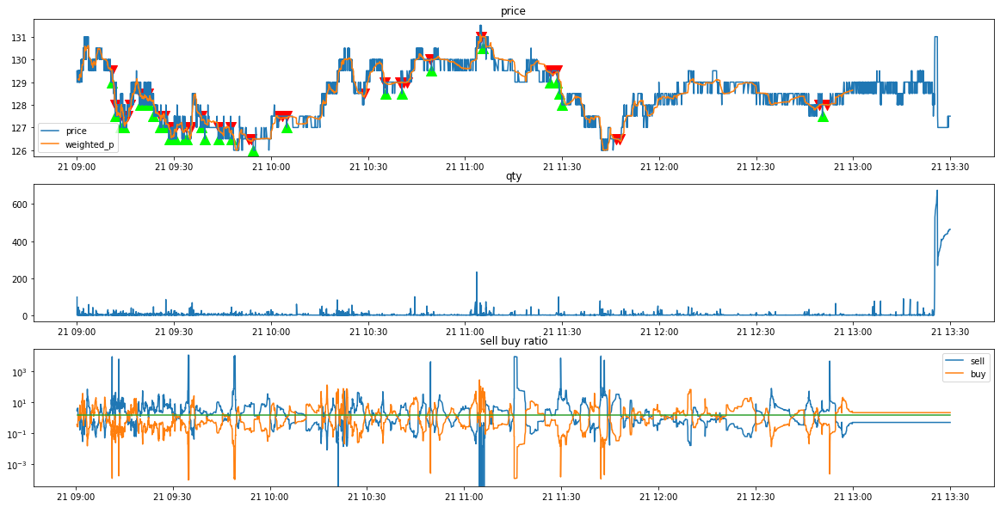

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-29/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-29/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003256
*** bid1_p:  128.5
*** weighted_p:  128.22955974842768
ask1_p:  129.0
num_sell:  142
num_buy:  17
進場時間： 90529555 
  sell price at  128.5
stop profit
出場時間： 90529555
POSITION(pre):  [128.5]
Order_p(pre):  [127.5]
tick_row price:  127.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  127.0
*** weighted_p:  126.97093023255815
ask1_p:  127.5
num_sell:  62
num_buy:  24
進場時間： 92031771 
  sell price at  127.0
stop profit
出場時間： 92053145
POSITION(pre):  [127.]
Order_p(pre):  [126.5]
tick_row price:  126.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  126.5
*** weighted_p:  126.48717948717949
ask1_p:  127.0
num_sell:  32
num_buy:  7
進場時間： 92326118 
  sell price at  1

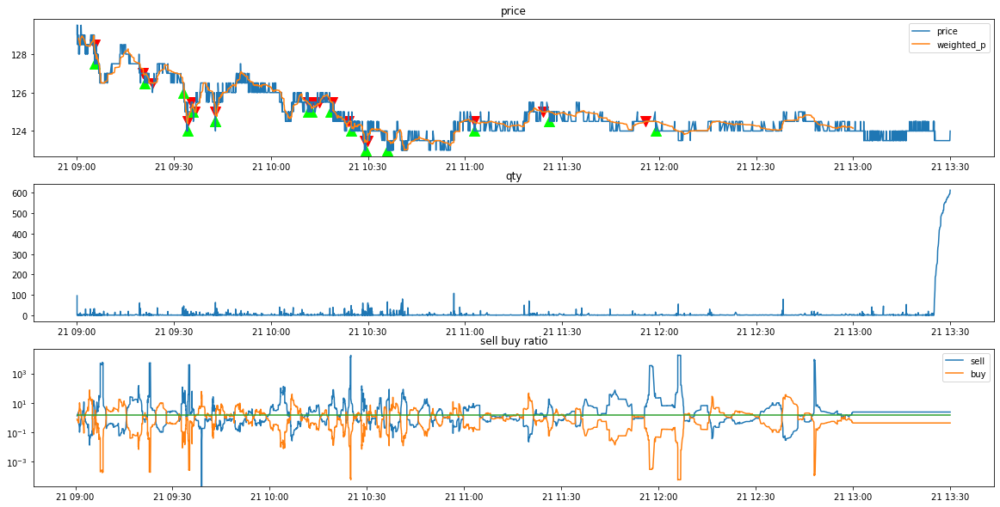

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-30/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-30/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003437
*** bid1_p:  125.0
*** weighted_p:  124.95901639344262
ask1_p:  125.5
num_sell:  37
num_buy:  24
進場時間： 95438190 
  sell price at  125.0
*** bid1_p:  125.0
*** weighted_p:  124.95348837209302
ask1_p:  125.5
num_sell:  28
num_buy:  15
進場時間： 95702325 
  sell price at  125.0
stop profit
出場時間： 95803287
POSITION(pre):  [125. 125.]
Order_p(pre):  [124.5 124.5]
tick_row price:  124.5
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  124.5
*** weighted_p:  124.30681818181819
ask1_p:  125.0
num_sell:  116
num_buy:  16
進場時間： 101857359 
  sell price at  124.5
stop profit
出場時間： 101857359
POSITION(pre):  [124.5]
Order_p(pre):  [124.]
tick_row price:  124.0
qualified index:  [[0]]
POSITION(post):  

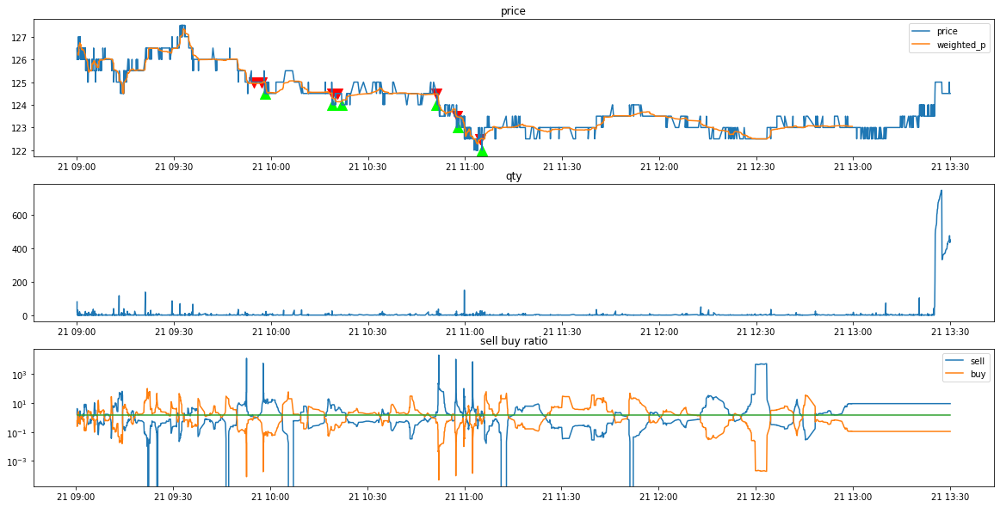

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-31/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-07-31/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004422
*** bid1_p:  126.0
*** weighted_p:  125.8256880733945
ask1_p:  126.5
num_sell:  73
num_buy:  36
進場時間： 90811821 
  sell price at  126.0
stop profit
出場時間： 90825653
POSITION(pre):  [126.]
Order_p(pre):  [125.5]
tick_row price:  125.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  125.0
*** weighted_p:  124.992
ask1_p:  125.5
num_sell:  83
num_buy:  42
進場時間： 90954341 
  sell price at  125.0
stop profit
出場時間： 90956323
POSITION(pre):  [125.]
Order_p(pre):  [124.5]
tick_row price:  124.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.5
*** weighted_p:  123.49418604651163
ask1_p:  124.0
num_sell:  79
num_buy:  7
進場時間： 92446240 
  sell price at  123.5
stop prof

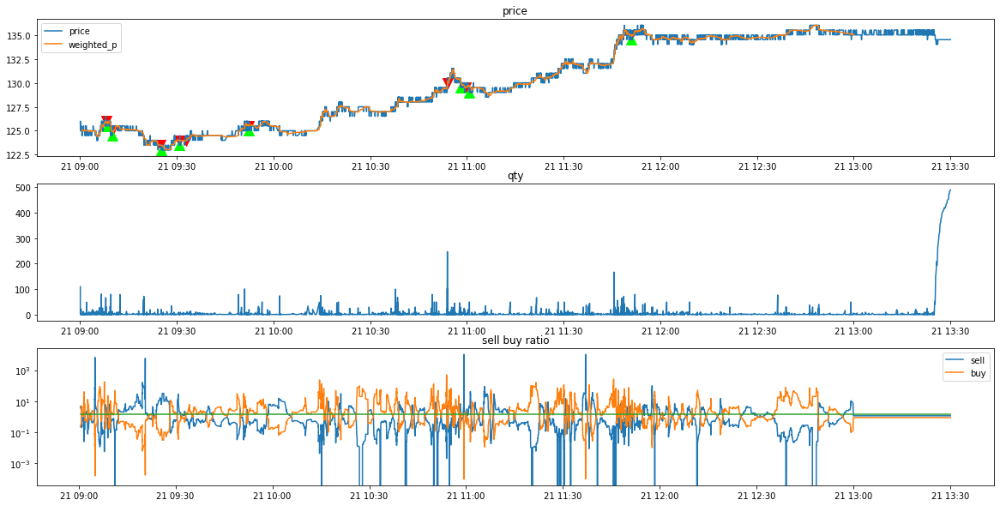

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-03/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-03/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90001794
*** bid1_p:  132.0
*** weighted_p:  131.984375
ask1_p:  132.5
num_sell:  29
num_buy:  3
進場時間： 90727448 
  sell price at  132.0
stop profit
出場時間： 90739917
POSITION(pre):  [132.]
Order_p(pre):  [131.5]
tick_row price:  131.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  131.5
*** weighted_p:  131.45454545454547
ask1_p:  132.0
num_sell:  70
num_buy:  18
進場時間： 91029871 
  sell price at  131.5
stop profit
出場時間： 91539152
POSITION(pre):  [131.5]
Order_p(pre):  [131.]
tick_row price:  131.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  130.5
*** weighted_p:  130.46951219512195
ask1_p:  131.0
num_sell:  50
num_buy:  32
進場時間： 92058667 
  sell price at  130.5
stop 

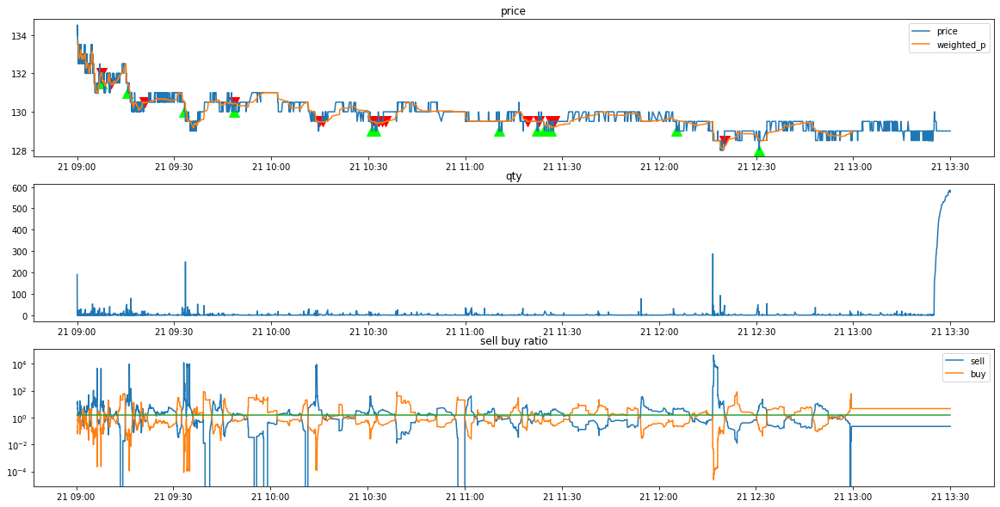

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-04/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-04/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003267
*** bid1_p:  130.5
*** weighted_p:  130.48469387755102
ask1_p:  131.0
num_sell:  75
num_buy:  23
進場時間： 92313992 
  sell price at  130.5
stop profit
出場時間： 92345269
POSITION(pre):  [130.5]
Order_p(pre):  [130.]
tick_row price:  130.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  131.5
*** weighted_p:  131.48
ask1_p:  132.0
num_sell:  40
num_buy:  10
進場時間： 93146005 
  sell price at  131.5
stop profit
出場時間： 93153628
POSITION(pre):  [131.5]
Order_p(pre):  [131.]
tick_row price:  131.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 135.0
----------Result Report--------------
profit:  1.0


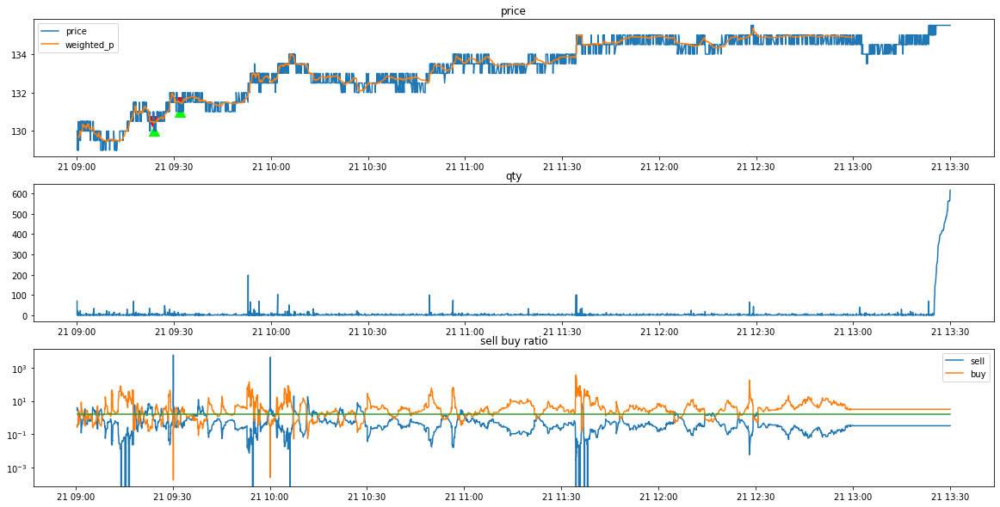

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-05/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-05/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003498
*** bid1_p:  134.5
*** weighted_p:  134.48837209302326
ask1_p:  135.0
num_sell:  34
num_buy:  9
進場時間： 90203607 
  sell price at  134.5
stop profit
出場時間： 90216811
POSITION(pre):  [134.5]
Order_p(pre):  [134.]
tick_row price:  134.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  134.0
*** weighted_p:  133.875
ask1_p:  134.5
num_sell:  41
num_buy:  27
進場時間： 90316339 
  sell price at  134.0
stop profit
出場時間： 90334123
POSITION(pre):  [134.]
Order_p(pre):  [133.5]
tick_row price:  133.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  134.0
*** weighted_p:  133.8
ask1_p:  134.5
num_sell:  41
num_buy:  24
進場時間： 90512341 
  sell price at  134.0
stop profit
出場時間： 905

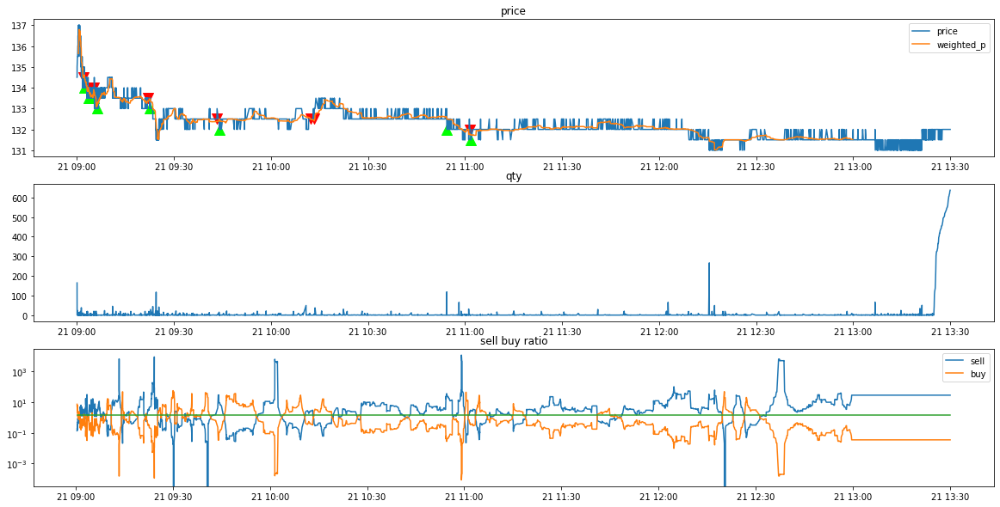

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-06/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-06/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004571
*** bid1_p:  140.5
*** weighted_p:  140.4
ask1_p:  141.0
num_sell:  24
num_buy:  11
進場時間： 90215310 
  sell price at  140.5
stop profit
出場時間： 90334689
POSITION(pre):  [140.5]
Order_p(pre):  [140.]
tick_row price:  140.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  140.5
*** weighted_p:  140.13315217391303
ask1_p:  141.0
num_sell:  135
num_buy:  49
進場時間： 90408273 
  sell price at  140.5
stop profit
出場時間： 90408339
POSITION(pre):  [140.5]
Order_p(pre):  [140.]
tick_row price:  140.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  141.0
*** weighted_p:  140.94827586206895
ask1_p:  141.5
num_sell:  36
num_buy:  22
進場時間： 90527459 
  sell price at  141.0
stop pro

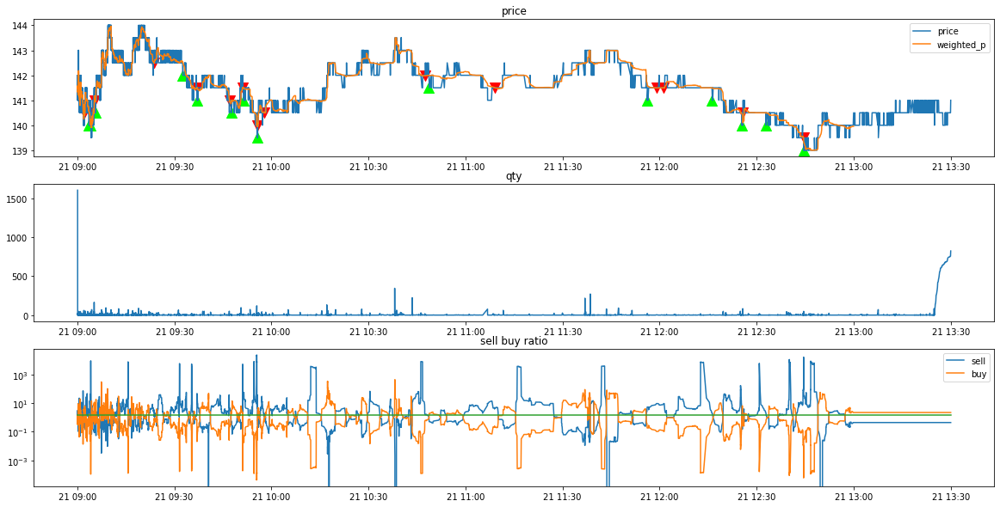

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-07/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-07/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90002099
*** bid1_p:  140.5
*** weighted_p:  140.45138888888889
ask1_p:  141.0
num_sell:  70
num_buy:  2
進場時間： 90357824 
  sell price at  140.5
stop profit
出場時間： 90403444
POSITION(pre):  [140.5]
Order_p(pre):  [140.]
tick_row price:  140.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  139.5
*** weighted_p:  139.45862068965516
ask1_p:  140.0
num_sell:  121
num_buy:  24
進場時間： 90657188 
  sell price at  139.5
stop profit
出場時間： 90657956
POSITION(pre):  [139.5]
Order_p(pre):  [139.]
tick_row price:  139.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  139.5
*** weighted_p:  139.20212765957447
ask1_p:  140.0
num_sell:  65
num_buy:  29
進場時間： 91013918 
  sell price at  13

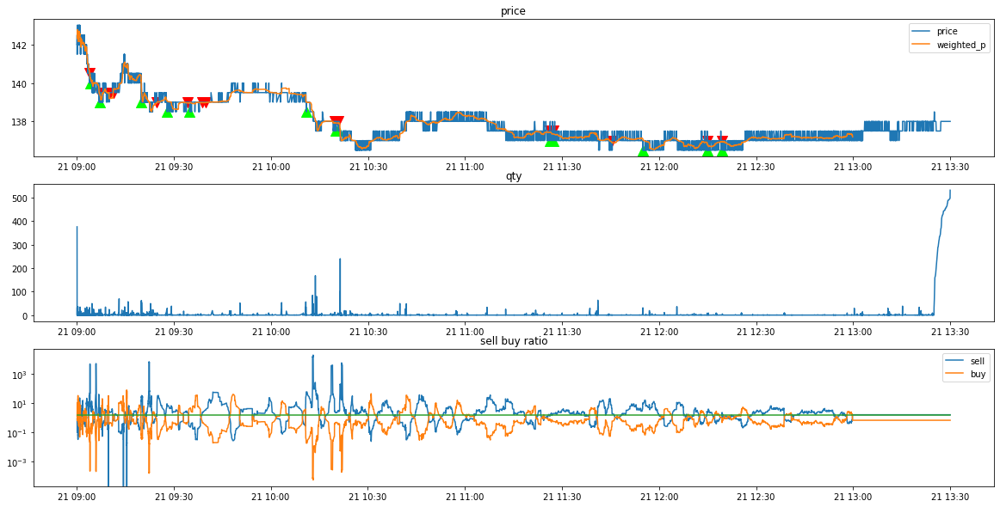

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-10/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-10/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003887
*** bid1_p:  136.5
*** weighted_p:  135.9877049180328
ask1_p:  137.0
num_sell:  74
num_buy:  48
進場時間： 90415762 
  sell price at  136.5
stop profit
出場時間： 90653539
POSITION(pre):  [136.5]
Order_p(pre):  [136.]
tick_row price:  136.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  135.0
*** weighted_p:  134.92857142857142
ask1_p:  135.5
num_sell:  30
num_buy:  19
進場時間： 91324658 
  sell price at  135.0
stop profit
出場時間： 91331947
POSITION(pre):  [135.]
Order_p(pre):  [134.5]
tick_row price:  134.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  135.5
*** weighted_p:  135.486301369863
ask1_p:  136.0
num_sell:  48
num_buy:  25
進場時間： 92120807 
  sell price at  135.5

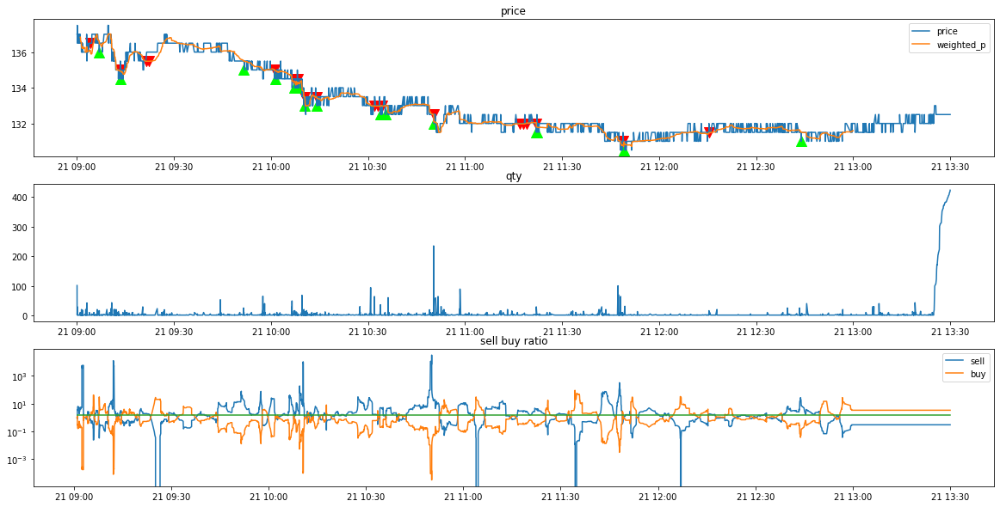

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-11/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-11/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004848
*** bid1_p:  130.5
*** weighted_p:  130.32978723404256
ask1_p:  131.0
num_sell:  35
num_buy:  12
進場時間： 90215525 
  sell price at  130.5
stop profit
出場時間： 90215625
POSITION(pre):  [130.5]
Order_p(pre):  [130.]
tick_row price:  130.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  131.0
*** weighted_p:  130.53246753246754
ask1_p:  131.5
num_sell:  60
num_buy:  17
進場時間： 90355399 
  sell price at  131.0
stop profit
出場時間： 90356491
POSITION(pre):  [131.]
Order_p(pre):  [130.]
tick_row price:  130.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  131.0
*** weighted_p:  130.96875
ask1_p:  131.5
num_sell:  53
num_buy:  27
進場時間： 91112054 
  sell price at  131.0
stop p

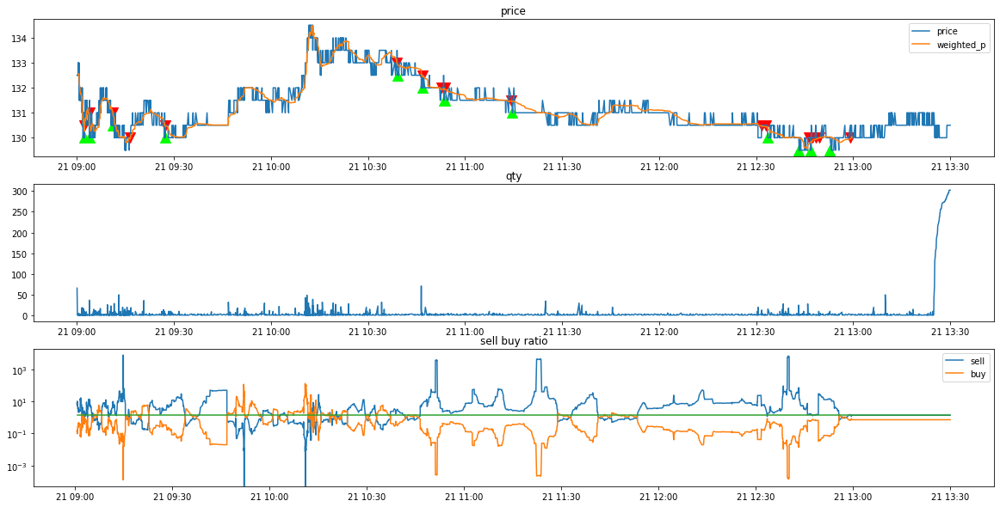

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-12/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-12/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004791
*** bid1_p:  131.5
*** weighted_p:  131.4512195121951
ask1_p:  132.0
num_sell:  55
num_buy:  27
進場時間： 91238456 
  sell price at  131.5
stop profit
出場時間： 91319409
POSITION(pre):  [131.5]
Order_p(pre):  [131.]
tick_row price:  131.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  131.5
*** weighted_p:  131.43809523809523
ask1_p:  132.0
num_sell:  72
num_buy:  33
進場時間： 91351071 
  sell price at  131.5
*** bid1_p:  131.5
*** weighted_p:  131.49056603773585
ask1_p:  132.0
num_sell:  33
num_buy:  20
進場時間： 91539541 
  sell price at  131.5
stop profit
出場時間： 91551341
POSITION(pre):  [131.5 131.5]
Order_p(pre):  [131. 131.]
tick_row price:  131.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
O

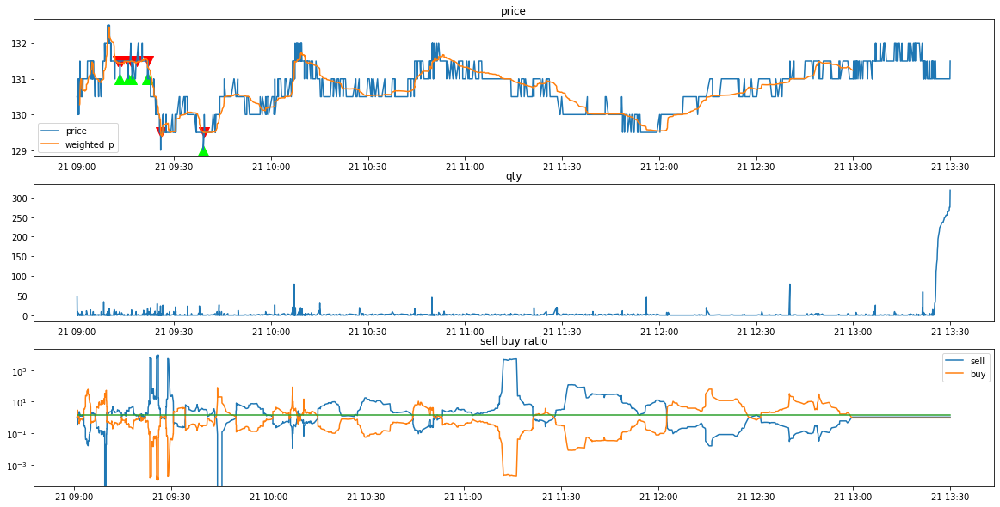

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-13/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-13/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008037
------Weird price!!!!!---------
At time:  91525108
tick_row_price 135.0
ask_1_p 135.5
bid_1_p 134.5
*** bid1_p:  133.5
*** weighted_p:  133.48979591836735
ask1_p:  134.0
num_sell:  41
num_buy:  8
進場時間： 95107100 
  sell price at  133.5
stop profit
出場時間： 95108575
POSITION(pre):  [133.5]
Order_p(pre):  [133.]
tick_row price:  133.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  132.5
*** weighted_p:  132.49107142857142
ask1_p:  133.0
num_sell:  56
num_buy:  0
進場時間： 115427562 
  sell price at  132.5
stop profit
出場時間： 115427562
POSITION(pre):  [132.5]
Order_p(pre):  [132.]
tick_row price:  132.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  131.0
*** weighted_

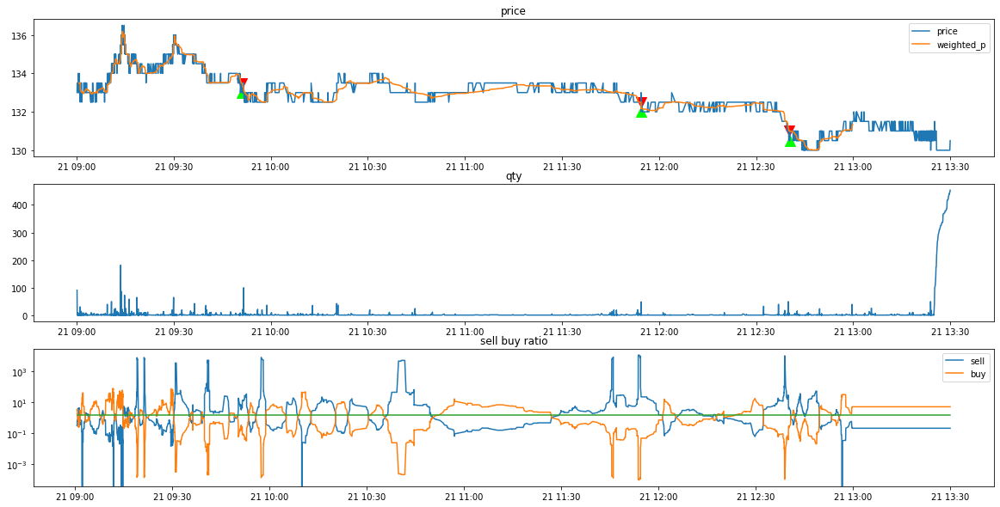

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-14/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-14/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004502
*** bid1_p:  130.5
*** weighted_p:  130.475
ask1_p:  131.0
num_sell:  68
num_buy:  12
進場時間： 90636523 
  sell price at  130.5
stop profit
出場時間： 90637134
POSITION(pre):  [130.5]
Order_p(pre):  [130.]
tick_row price:  130.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  129.5
*** weighted_p:  129.41129032258064
ask1_p:  130.0
num_sell:  62
num_buy:  0
進場時間： 90851648 
  sell price at  129.5
stop profit
出場時間： 90851648
POSITION(pre):  [129.5]
Order_p(pre):  [129.]
tick_row price:  129.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  130.0
*** weighted_p:  129.97297297297297
ask1_p:  130.5
num_sell:  33
num_buy:  4
進場時間： 91214512 
  sell price at  130.0
stop prof

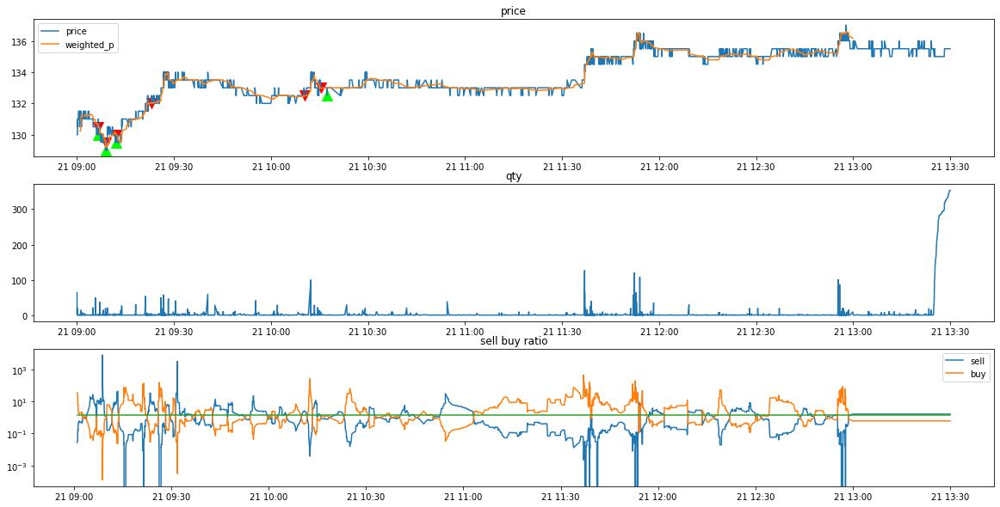

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-17/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-17/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004724
*** bid1_p:  134.5
*** weighted_p:  134.48181818181817
ask1_p:  135.0
num_sell:  47
num_buy:  8
進場時間： 90310824 
  sell price at  134.5
stop profit
出場時間： 90512696
POSITION(pre):  [134.5]
Order_p(pre):  [134.]
tick_row price:  134.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  134.5
*** weighted_p:  134.47142857142856
ask1_p:  135.0
num_sell:  35
num_buy:  0
進場時間： 90514831 
  sell price at  134.5
stop profit
出場時間： 90518285
POSITION(pre):  [134.5]
Order_p(pre):  [134.]
tick_row price:  134.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  134.0
*** weighted_p:  133.8235294117647
ask1_p:  134.5
num_sell:  23
num_buy:  11
進場時間： 90751240 
  sell price at  134.0

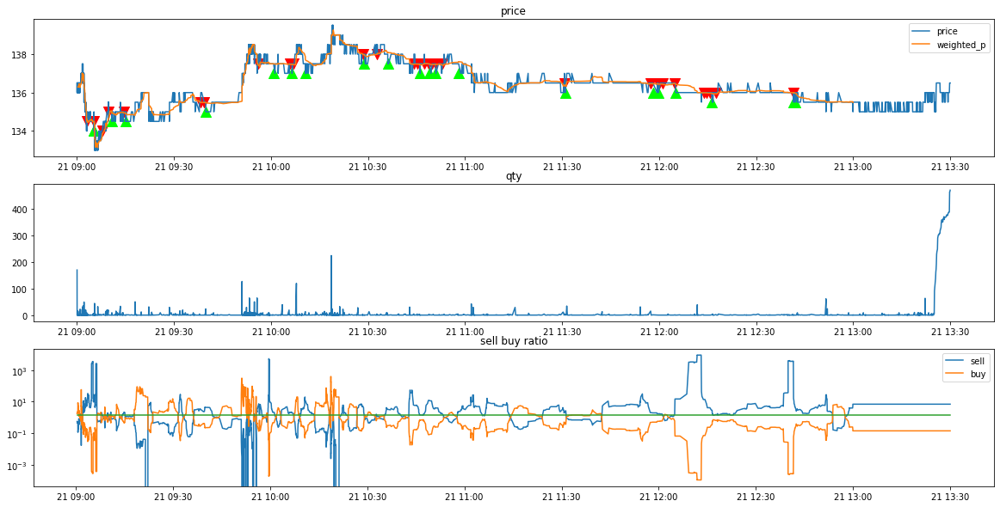

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-18/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-18/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004380
*** bid1_p:  136.5
*** weighted_p:  136.39473684210526
ask1_p:  137.0
num_sell:  32
num_buy:  6
進場時間： 90201134 
  sell price at  136.5
stop profit
出場時間： 90212788
POSITION(pre):  [136.5]
Order_p(pre):  [136.]
tick_row price:  136.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  136.5
*** weighted_p:  136.4078947368421
ask1_p:  137.0
num_sell:  35
num_buy:  3
進場時間： 90316911 
  sell price at  136.5
stop profit
出場時間： 90332718
POSITION(pre):  [136.5]
Order_p(pre):  [136.]
tick_row price:  136.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  136.0
*** weighted_p:  135.86206896551724
ask1_p:  136.5
num_sell:  21
num_buy:  8
進場時間： 90540453 
  sell price at  136.0


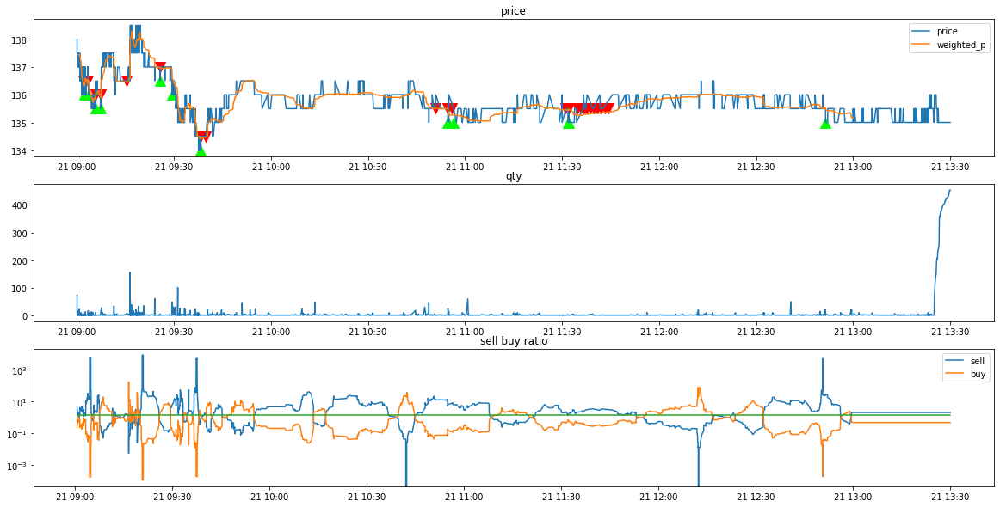

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-19/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-19/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007411
*** bid1_p:  136.5
*** weighted_p:  136.41304347826087
ask1_p:  137.0
num_sell:  28
num_buy:  18
進場時間： 91519886 
  sell price at  136.5
stop profit
出場時間： 91519913
POSITION(pre):  [136.5]
Order_p(pre):  [136.]
tick_row price:  136.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  136.0
*** weighted_p:  135.9625
ask1_p:  136.5
num_sell:  38
num_buy:  2
進場時間： 93300129 
  sell price at  136.0
stop profit
出場時間： 93333568
POSITION(pre):  [136.]
Order_p(pre):  [135.5]
tick_row price:  135.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  136.0
*** weighted_p:  135.9431818181818
ask1_p:  136.5
num_sell:  32
num_buy:  12
進場時間： 93420859 
  sell price at  136.0
*** bid1

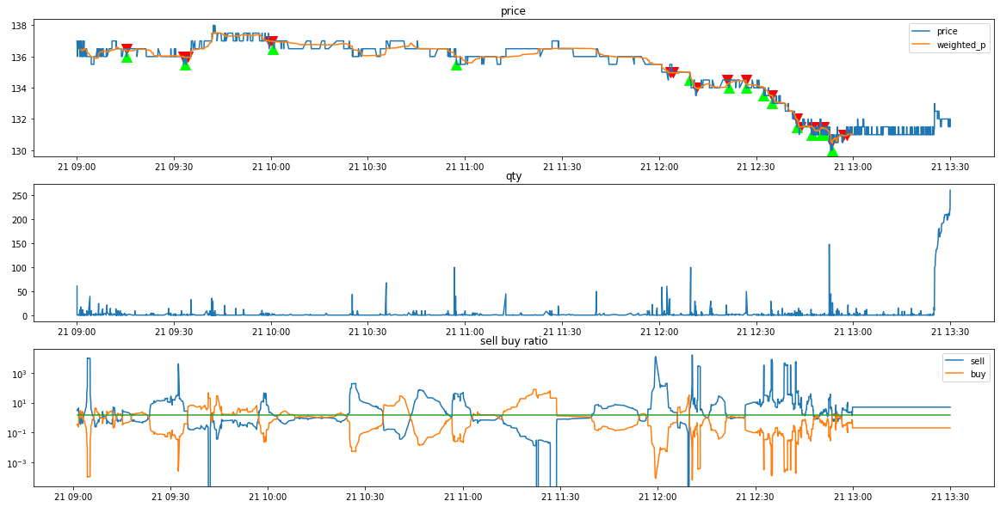

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-20/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-20/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006970
*** bid1_p:  130.5
*** weighted_p:  130.2674418604651
ask1_p:  131.0
num_sell:  37
num_buy:  6
進場時間： 90354670 
  sell price at  130.5
stop profit
出場時間： 90359806
POSITION(pre):  [130.5]
Order_p(pre):  [130.]
tick_row price:  130.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  130.0
*** weighted_p:  129.97457627118644
ask1_p:  130.5
num_sell:  51
num_buy:  8
進場時間： 90529848 
  sell price at  130.0
stop profit
出場時間： 90530517
POSITION(pre):  [130.]
Order_p(pre):  [129.5]
tick_row price:  129.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  129.5
*** weighted_p:  129.48305084745763
ask1_p:  130.0
num_sell:  52
num_buy:  7
進場時間： 90630339 
  sell price at  129.5


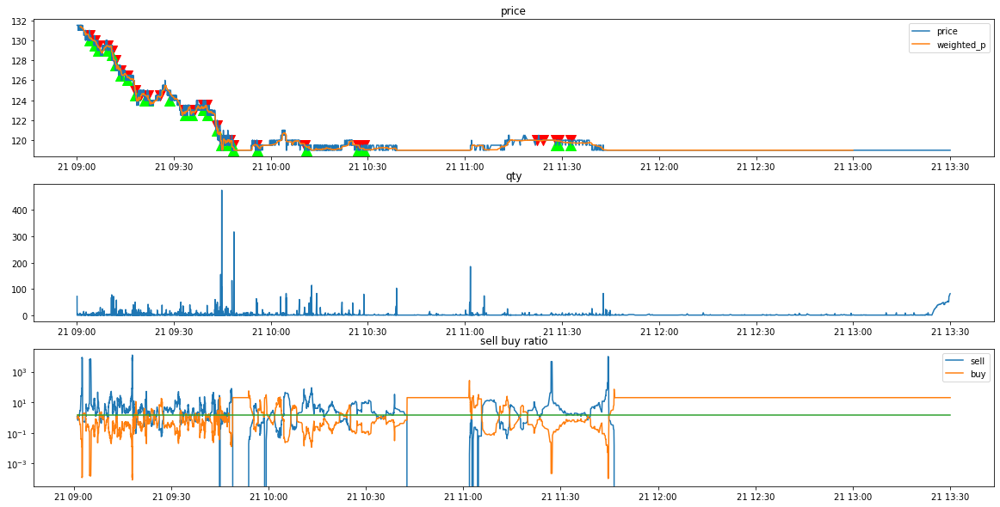

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-21/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-21/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005685
*** bid1_p:  118.5
*** weighted_p:  118.48684210526316
ask1_p:  119.0
num_sell:  70
num_buy:  6
進場時間： 90433495 
  sell price at  118.5
stop profit
出場時間： 90440275
POSITION(pre):  [118.5]
Order_p(pre):  [118.]
tick_row price:  118.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weighted_p:  118.39047619047619
ask1_p:  119.0
num_sell:  64
num_buy:  41
進場時間： 90535960 
  sell price at  118.5
stop profit
出場時間： 91117919
POSITION(pre):  [118.5]
Order_p(pre):  [118.]
tick_row price:  118.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weighted_p:  118.49270072992701
ask1_p:  119.0
num_sell:  113
num_buy:  24
進場時間： 91153775 
  sell price at  11

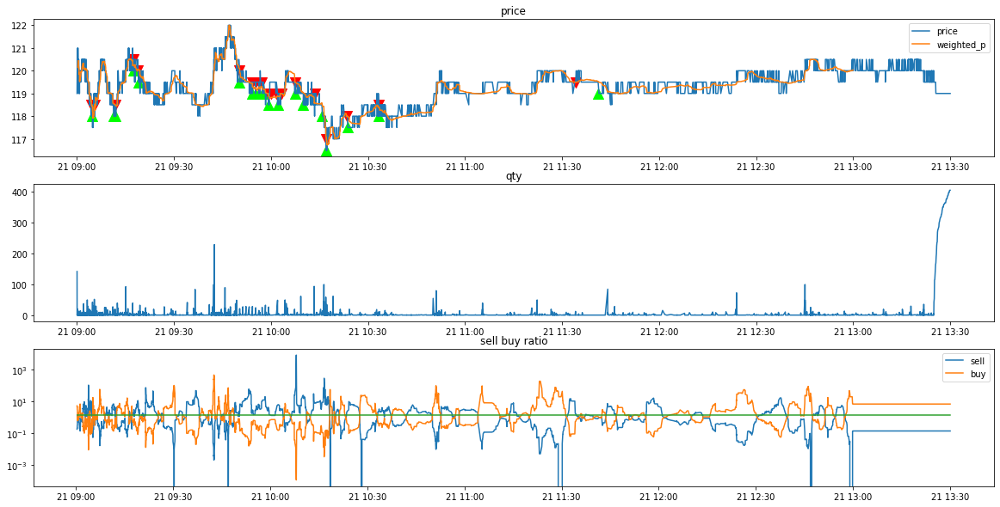

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-24/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-24/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003434
*** bid1_p:  118.0
*** weighted_p:  117.98809523809524
ask1_p:  118.5
num_sell:  29
num_buy:  13
進場時間： 90346781 
  sell price at  118.0
stop profit
出場時間： 90358468
POSITION(pre):  [118.]
Order_p(pre):  [117.5]
tick_row price:  117.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.0
*** weighted_p:  117.74545454545455
ask1_p:  118.5
num_sell:  37
num_buy:  18
進場時間： 90514182 
  sell price at  118.0
*** bid1_p:  118.0
*** weighted_p:  117.94565217391305
ask1_p:  118.5
num_sell:  29
num_buy:  17
進場時間： 90614224 
  sell price at  118.0
*** bid1_p:  120.0
*** weighted_p:  119.84705882352941
ask1_p:  120.5
num_sell:  53
num_buy:  32
進場時間： 91144930 
  sell price at  120.0
*** bid1_p:  121.5
*

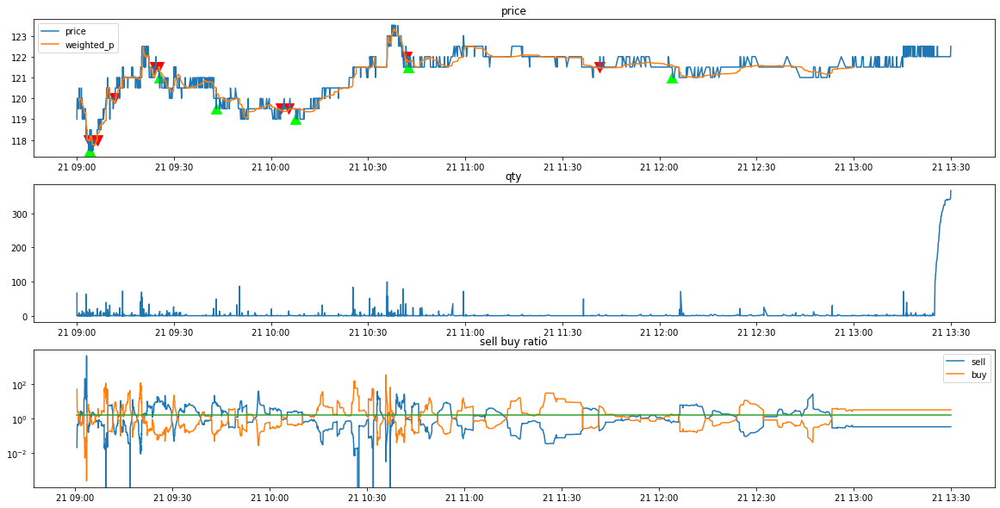

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-25/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-25/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005327
*** bid1_p:  124.0
*** weighted_p:  123.97983870967742
ask1_p:  124.5
num_sell:  105
num_buy:  19
進場時間： 90836892 
  sell price at  124.0
stop profit
出場時間： 90837585
POSITION(pre):  [124.]
Order_p(pre):  [123.5]
tick_row price:  123.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  125.5
*** weighted_p:  125.41666666666667
ask1_p:  126.0
num_sell:  67
num_buy:  29
進場時間： 95202163 
  sell price at  125.5
stop profit
出場時間： 101456347
POSITION(pre):  [125.5]
Order_p(pre):  [125.]
tick_row price:  125.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  124.5
*** weighted_p:  124.4945652173913
ask1_p:  125.0
num_sell:  70
num_buy:  22
進場時間： 104048228 
  sell price at  

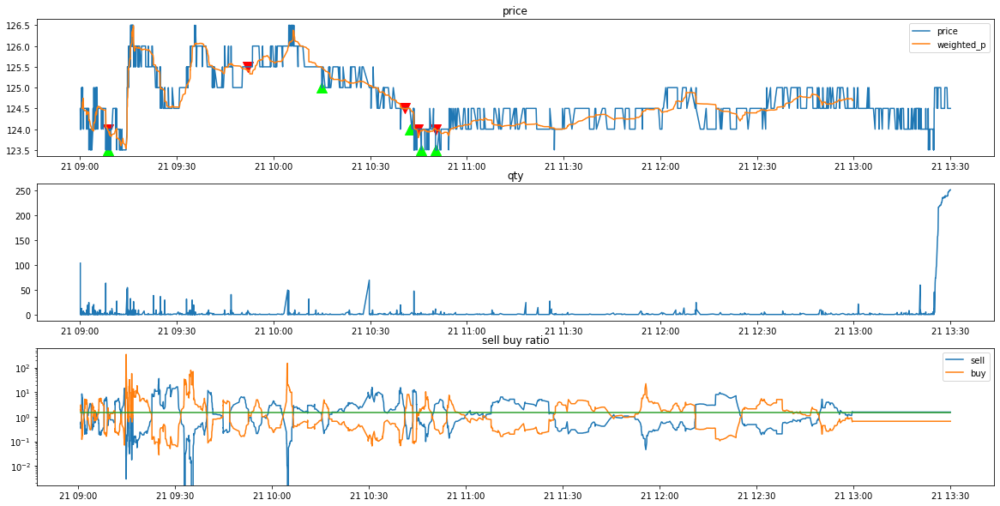

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-26/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-26/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007197
*** bid1_p:  122.5
*** weighted_p:  122.49568965517241
ask1_p:  123.0
num_sell:  100
num_buy:  16
進場時間： 91847129 
  sell price at  122.5
stop profit
出場時間： 91847129
POSITION(pre):  [122.5]
Order_p(pre):  [122.]
tick_row price:  122.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  122.5
*** weighted_p:  122.48648648648648
ask1_p:  123.0
num_sell:  26
num_buy:  11
進場時間： 91947241 
  sell price at  122.5
stop profit
出場時間： 91947241
POSITION(pre):  [122.5]
Order_p(pre):  [122.]
tick_row price:  122.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  122.5
*** weighted_p:  122.46969696969697
ask1_p:  123.0
num_sell:  21
num_buy:  12
進場時間： 92602930 
  sell price at  1

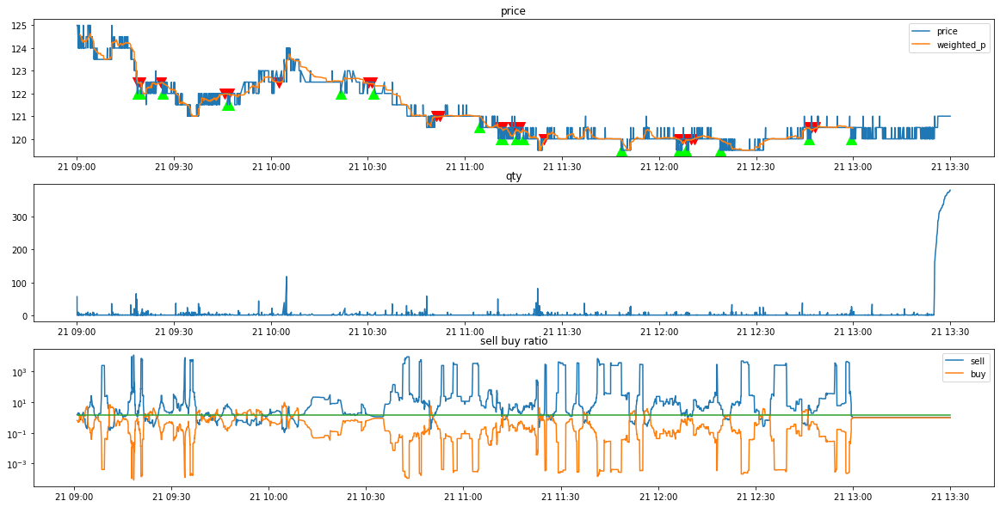

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-27/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-27/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004234
*** bid1_p:  122.5
*** weighted_p:  122.48039215686275
ask1_p:  123.0
num_sell:  40
num_buy:  11
進場時間： 93156010 
  sell price at  122.5
*** bid1_p:  122.5
*** weighted_p:  122.49019607843137
ask1_p:  123.0
num_sell:  38
num_buy:  13
進場時間： 93300074 
  sell price at  122.5
stop profit
出場時間： 93324407
POSITION(pre):  [122.5 122.5]
Order_p(pre):  [122. 122.]
tick_row price:  122.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  122.0
*** weighted_p:  121.9954128440367
ask1_p:  122.5
num_sell:  94
num_buy:  15
進場時間： 93431494 
  sell price at  122.0
stop profit
出場時間： 93439540
POSITION(pre):  [122.]
Order_p(pre):  [121.5]
tick_row price:  121.5
qualified index:  [[0]]
POSITION(post):  []
O

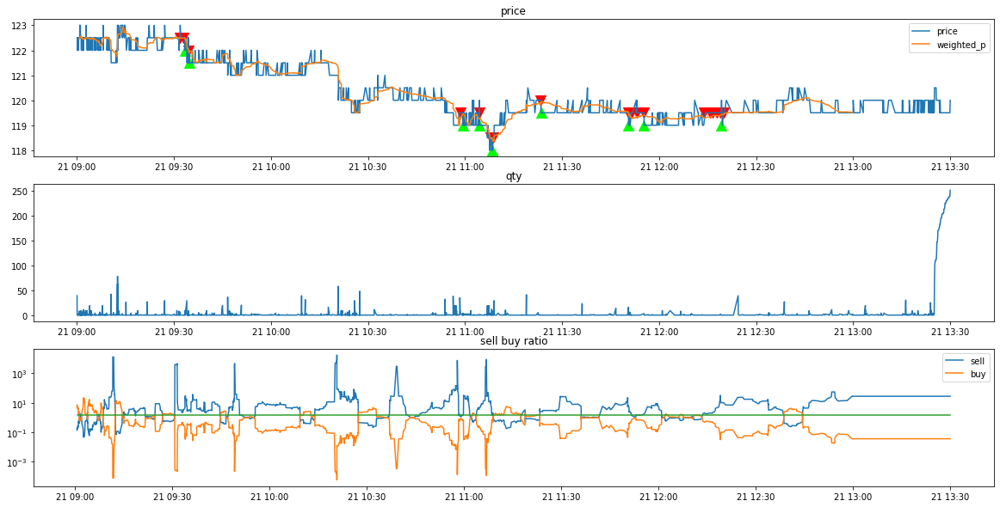

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-28/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-28/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007012
*** bid1_p:  119.0
*** weighted_p:  118.97872340425532
ask1_p:  119.5
num_sell:  33
num_buy:  14
進場時間： 90607834 
  sell price at  119.0
stop profit
出場時間： 90657611
POSITION(pre):  [119.]
Order_p(pre):  [118.5]
tick_row price:  118.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.0
*** weighted_p:  119.97727272727273
ask1_p:  120.5
num_sell:  42
num_buy:  2
進場時間： 95458203 
  sell price at  120.0
*** bid1_p:  120.0
*** weighted_p:  119.98717948717949
ask1_p:  120.5
num_sell:  31
num_buy:  8
進場時間： 95558342 
  sell price at  120.0
*** bid1_p:  120.0
*** weighted_p:  119.9875
ask1_p:  120.5
num_sell:  32
num_buy:  8
進場時間： 95707714 
  sell price at  120.0
*** bid1_p:  120.0
*** weighted_p

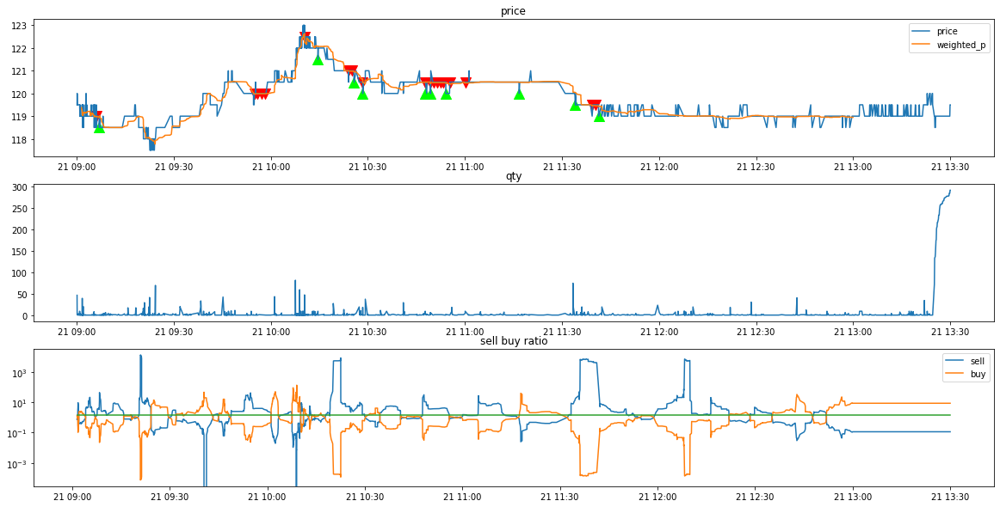

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-31/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-08-31/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008905
*** bid1_p:  119.5
*** weighted_p:  119.23015873015873
ask1_p:  120.0
num_sell:  39
num_buy:  24
進場時間： 91653020 
  sell price at  119.5
stop profit
出場時間： 92910732
POSITION(pre):  [119.5]
Order_p(pre):  [119.]
tick_row price:  119.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weighted_p:  118.44059405940594
ask1_p:  119.0
num_sell:  93
num_buy:  8
進場時間： 93627740 
  sell price at  118.5
stop profit
出場時間： 93630239
POSITION(pre):  [118.5]
Order_p(pre):  [118.]
tick_row price:  118.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weighted_p:  118.31531531531532
ask1_p:  119.0
num_sell:  73
num_buy:  38
進場時間： 93727855 
  sell price at  118

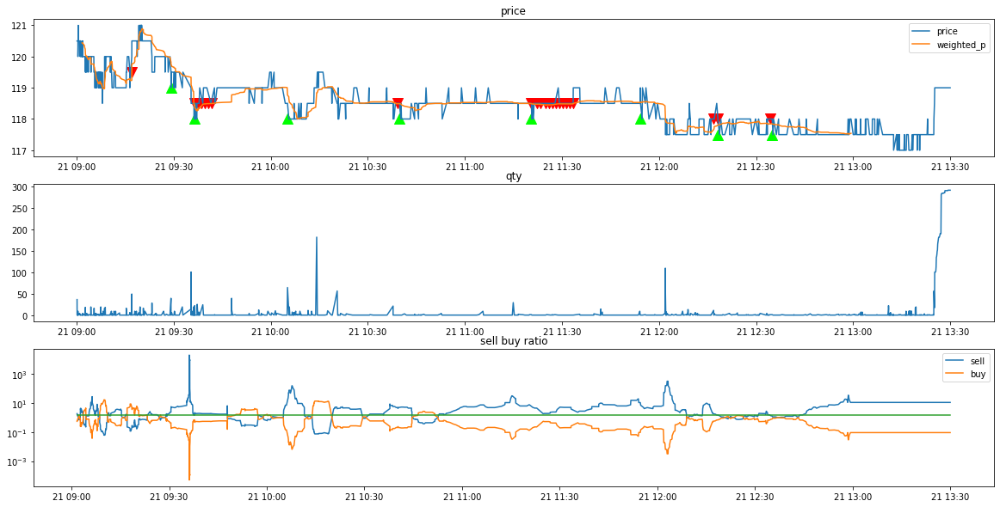

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-01/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-01/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90009370
*** bid1_p:  114.5
*** weighted_p:  114.44270833333333
ask1_p:  115.0
num_sell:  59
num_buy:  37
進場時間： 92023499 
  sell price at  114.5
stop profit
出場時間： 92025374
POSITION(pre):  [114.5]
Order_p(pre):  [114.]
tick_row price:  114.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  112.5
*** weighted_p:  112.475
ask1_p:  113.0
num_sell:  39
num_buy:  21
進場時間： 92438171 
  sell price at  112.5
stop profit
出場時間： 92439244
POSITION(pre):  [112.5]
Order_p(pre):  [112.]
tick_row price:  112.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  112.5
*** weighted_p:  112.47826086956522
ask1_p:  113.0
num_sell:  40
num_buy:  6
進場時間： 92538863 
  sell price at  112.5
stop pro

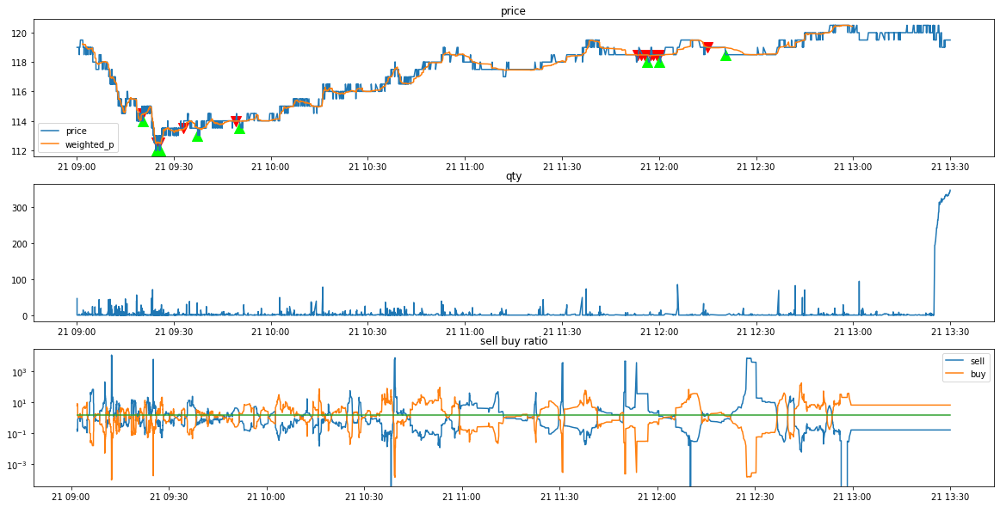

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-02/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-02/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003626
*** bid1_p:  120.5
*** weighted_p:  120.46428571428571
ask1_p:  121.0
num_sell:  18
num_buy:  10
進場時間： 90450495 
  sell price at  120.5
stop profit
出場時間： 91759679
POSITION(pre):  [120.5]
Order_p(pre):  [120.]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.5
*** weighted_p:  120.48979591836735
ask1_p:  121.0
num_sell:  120
num_buy:  27
進場時間： 91847336 
  sell price at  120.5
stop profit
出場時間： 95900088
POSITION(pre):  [120.5]
Order_p(pre):  [120.]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  119.0
*** weighted_p:  118.98913043478261
ask1_p:  119.5
num_sell:  29
num_buy:  17
進場時間： 100610284 
  sell price at  

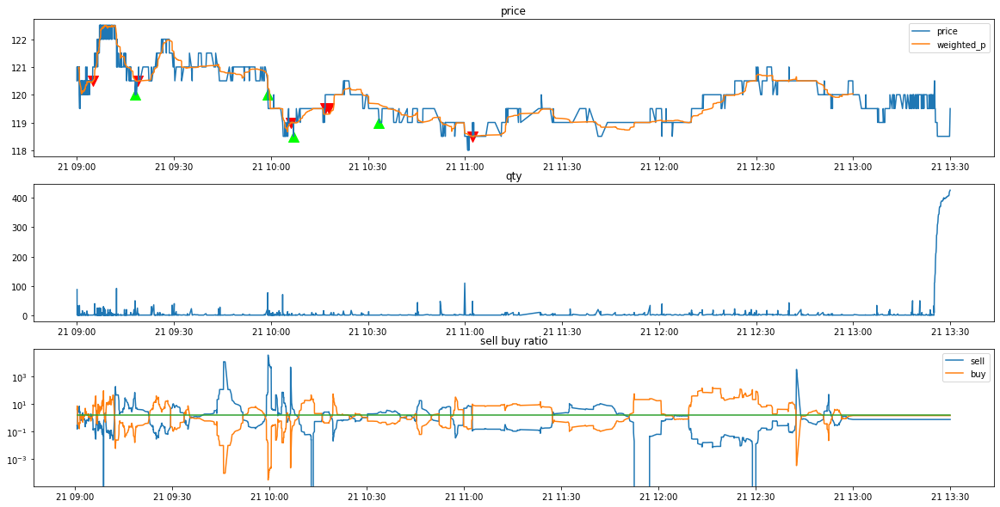

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-03/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-03/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005938
*** bid1_p:  121.5
*** weighted_p:  121.47058823529412
ask1_p:  122.0
num_sell:  32
num_buy:  19
進場時間： 90807624 
  sell price at  121.5
stop profit
出場時間： 101935790
POSITION(pre):  [121.5]
Order_p(pre):  [121.]
tick_row price:  121.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.5
*** weighted_p:  121.4888888888889
ask1_p:  122.0
num_sell:  158
num_buy:  22
進場時間： 102108108 
  sell price at  121.5
*** bid1_p:  121.5
*** weighted_p:  121.4888888888889
ask1_p:  122.0
num_sell:  158
num_buy:  22
進場時間： 102208185 
  sell price at  121.5
*** bid1_p:  121.5
*** weighted_p:  121.48603351955308
ask1_p:  122.0
num_sell:  158
num_buy:  21
進場時間： 102308232 
  sell price at  121.5
stop profit
出場時

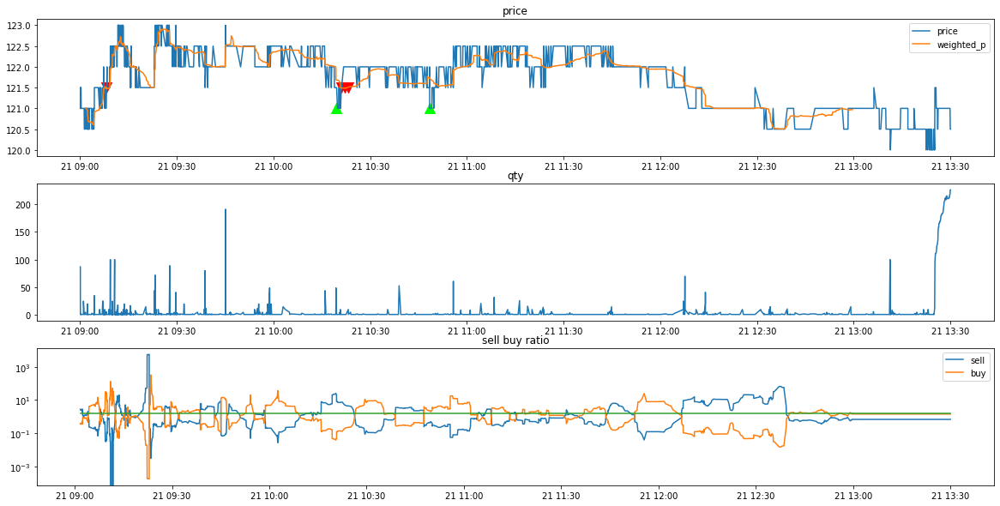

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-04/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-04/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008807
*** bid1_p:  118.5
*** weighted_p:  118.34375
ask1_p:  119.0
num_sell:  49
num_buy:  31
進場時間： 92647800 
  sell price at  118.5
stop profit
出場時間： 92706143
POSITION(pre):  [118.5]
Order_p(pre):  [118.]
tick_row price:  118.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weighted_p:  118.49180327868852
ask1_p:  119.0
num_sell:  45
num_buy:  16
進場時間： 92855936 
  sell price at  118.5
*** bid1_p:  118.5
*** weighted_p:  118.49180327868852
ask1_p:  119.0
num_sell:  45
num_buy:  16
進場時間： 92955965 
  sell price at  118.5
*** bid1_p:  118.5
*** weighted_p:  118.48360655737704
ask1_p:  119.0
num_sell:  46
num_buy:  15
進場時間： 93057505 
  sell price at  118.5
*** bid1_p:  118.5
*** weight

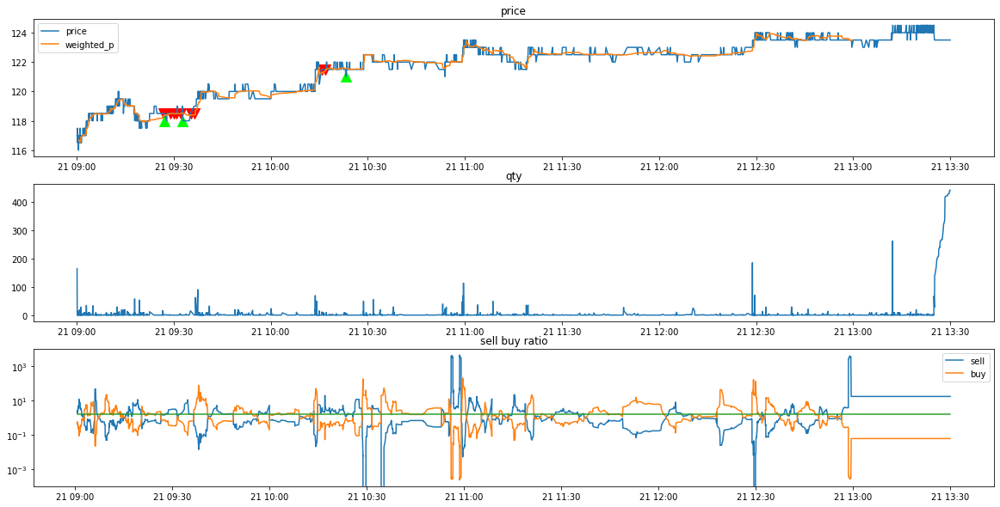

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-07/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-07/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006382
*** bid1_p:  124.5
*** weighted_p:  124.48684210526316
ask1_p:  125.0
num_sell:  23
num_buy:  15
進場時間： 90210015 
  sell price at  124.5
stop profit
出場時間： 90211581
POSITION(pre):  [124.5]
Order_p(pre):  [124.]
tick_row price:  124.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  124.5
*** weighted_p:  124.32926829268293
ask1_p:  125.0
num_sell:  25
num_buy:  16
進場時間： 90321154 
  sell price at  124.5
stop profit
出場時間： 90321154
POSITION(pre):  [124.5]
Order_p(pre):  [124.]
tick_row price:  124.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  124.5
*** weighted_p:  124.48275862068965
ask1_p:  125.0
num_sell:  65
num_buy:  22
進場時間： 90454896 
  sell price at  12

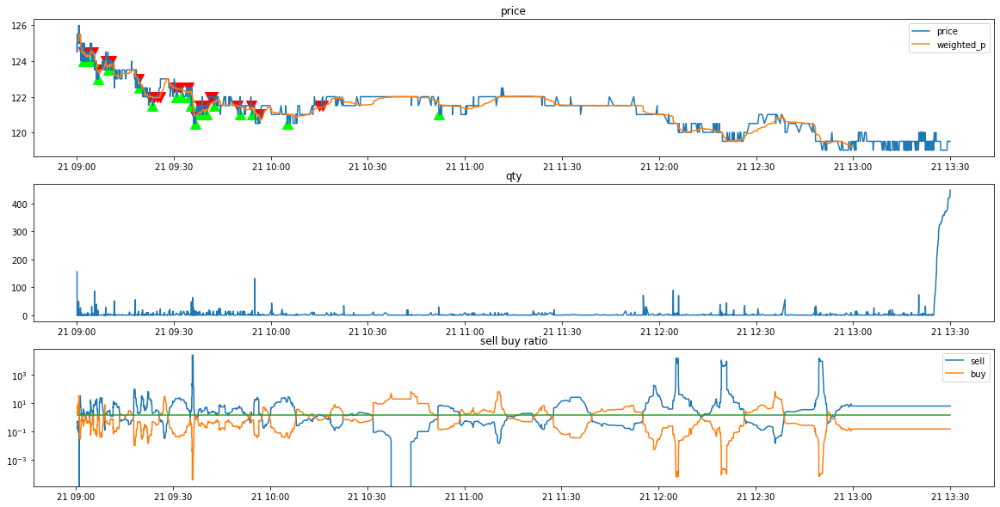

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-08/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-08/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006522
*** bid1_p:  121.0
*** weighted_p:  120.96938775510205
ask1_p:  121.5
num_sell:  46
num_buy:  3
進場時間： 92709809 
  sell price at  121.0
stop profit
出場時間： 92713161
POSITION(pre):  [121.]
Order_p(pre):  [120.5]
tick_row price:  120.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.0
*** weighted_p:  120.93
ask1_p:  121.5
num_sell:  39
num_buy:  11
進場時間： 92815036 
  sell price at  121.0
stop profit
出場時間： 92908637
POSITION(pre):  [121.]
Order_p(pre):  [120.5]
tick_row price:  120.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.0
*** weighted_p:  119.95270270270271
ask1_p:  120.5
num_sell:  67
num_buy:  7
進場時間： 93507846 
  sell price at  120.0
*** bid1_p

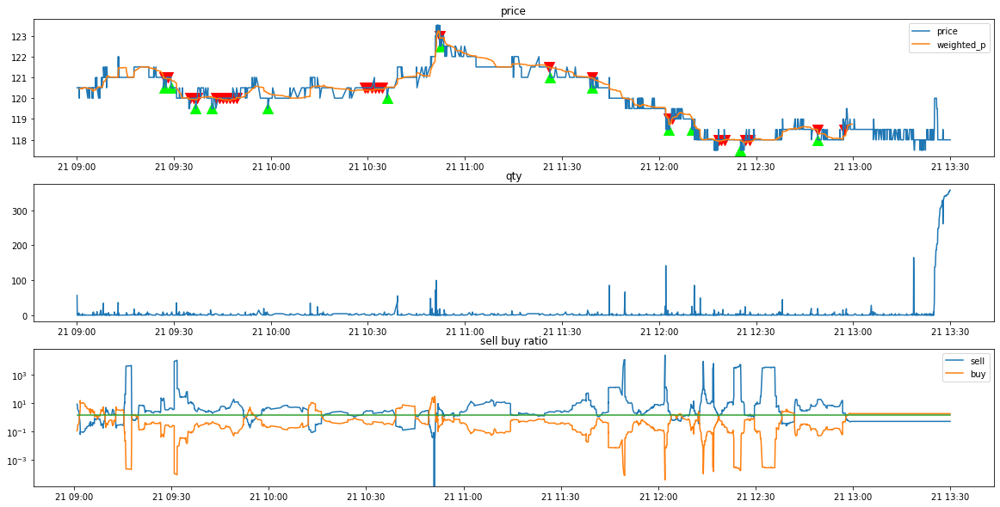

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007702
*** bid1_p:  116.5
*** weighted_p:  116.41666666666667
ask1_p:  117.0
num_sell:  30
num_buy:  18
進場時間： 90337516 
  sell price at  116.5
stop profit
出場時間： 90347297
POSITION(pre):  [116.5]
Order_p(pre):  [116.]
tick_row price:  116.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  116.5
*** weighted_p:  116.49152542372882
ask1_p:  117.0
num_sell:  38
num_buy:  21
進場時間： 90438365 
  sell price at  116.5
stop profit
出場時間： 90851500
POSITION(pre):  [116.5]
Order_p(pre):  [116.]
tick_row price:  116.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  115.0
*** weighted_p:  114.95723684210526
ask1_p:  115.5
num_sell:  144
num_buy:  8
進場時間： 90942051 
  sell price at  11

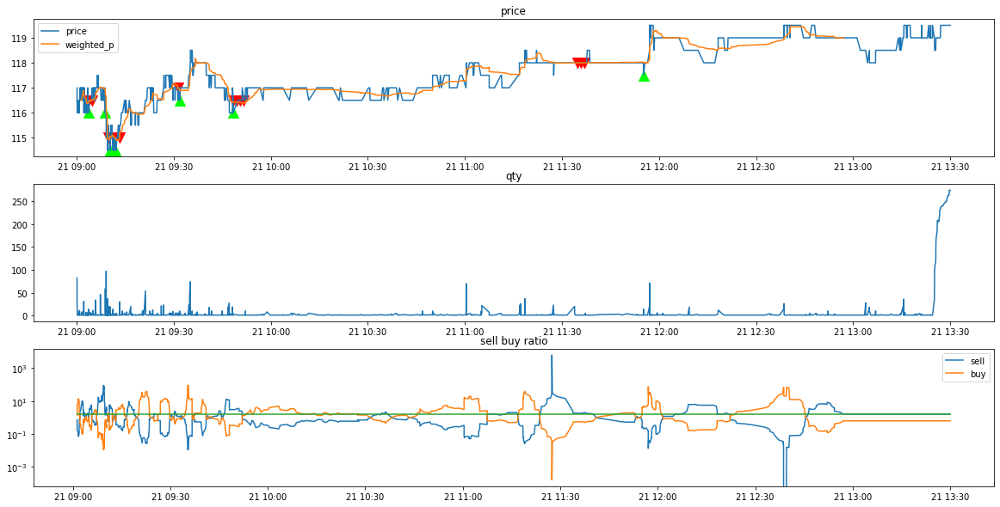

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90009523
*** bid1_p:  120.5
*** weighted_p:  120.47727272727273
ask1_p:  121.0
num_sell:  40
num_buy:  26
進場時間： 90447888 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  120.48484848484848
ask1_p:  121.0
num_sell:  40
num_buy:  26
進場時間： 90548034 
  sell price at  120.5
stop profit
出場時間： 91558614
POSITION(pre):  [120.5 120.5]
Order_p(pre):  [120. 120.]
tick_row price:  120.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.5
*** weighted_p:  120.390625
ask1_p:  121.0
num_sell:  104
num_buy:  24
進場時間： 91733663 
  sell price at  120.5
*** bid1_p:  120.5
*** weighted_p:  120.34710743801652
ask1_p:  121.0
num_sell:  99
num_buy:  22
進場時間： 91835530 
  sell price at  120.5
*** bid1_p:

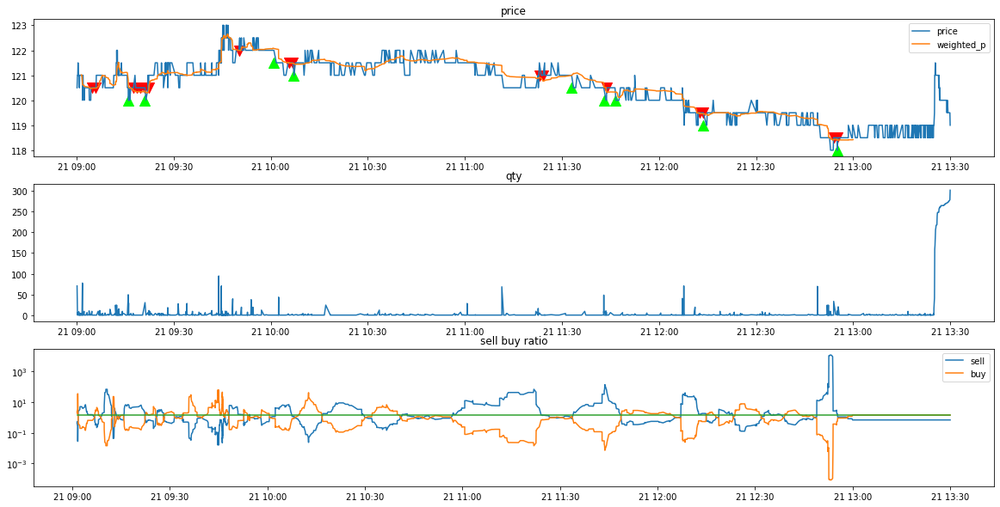

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008401
*** bid1_p:  118.5
*** weighted_p:  118.42537313432835
ask1_p:  119.0
num_sell:  54
num_buy:  13
進場時間： 92244937 
  sell price at  118.5
stop profit
出場時間： 92246263
POSITION(pre):  [118.5]
Order_p(pre):  [118.]
tick_row price:  118.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.0
*** weighted_p:  117.67777777777778
ask1_p:  118.5
num_sell:  29
num_buy:  16
進場時間： 92618806 
  sell price at  118.0
stop profit
出場時間： 95701050
POSITION(pre):  [118.]
Order_p(pre):  [117.5]
tick_row price:  117.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.5
*** weighted_p:  118.13513513513513
ask1_p:  119.0
num_sell:  45
num_buy:  29
進場時間： 100657214 
  sell price at  1

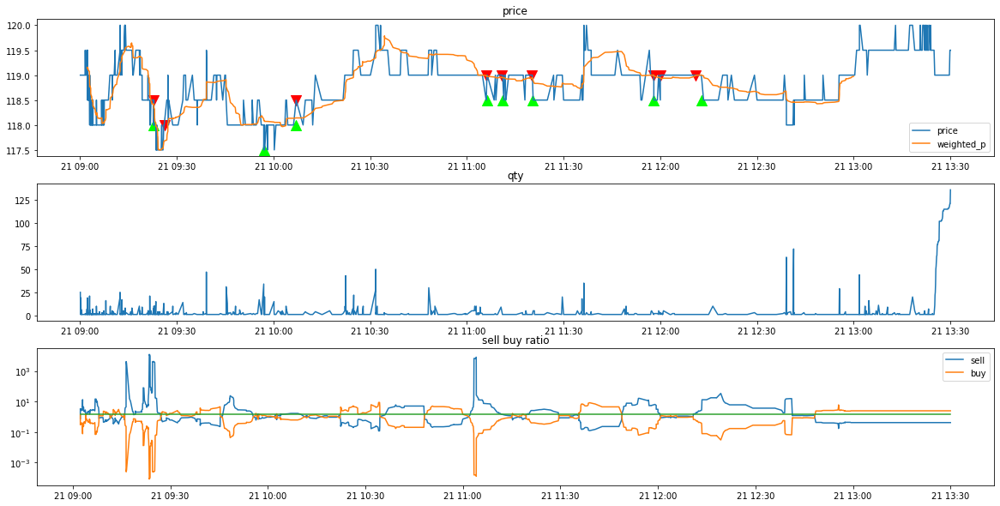

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90009325
*** bid1_p:  120.5
*** weighted_p:  120.43442622950819
ask1_p:  121.0
num_sell:  37
num_buy:  24
進場時間： 90327069 
  sell price at  120.5
stop profit
出場時間： 90439294
POSITION(pre):  [120.5]
Order_p(pre):  [120.]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.0
*** weighted_p:  119.9090909090909
ask1_p:  120.5
num_sell:  57
num_buy:  20
進場時間： 90814678 
  sell price at  120.0
*** bid1_p:  120.0
*** weighted_p:  119.92207792207792
ask1_p:  120.5
num_sell:  55
num_buy:  22
進場時間： 90915267 
  sell price at  120.0
*** bid1_p:  121.0
*** weighted_p:  120.94186046511628
ask1_p:  121.5
num_sell:  26
num_buy:  17
進場時間： 91733769 
  sell price at  121.0
stop profit
出場時間： 918

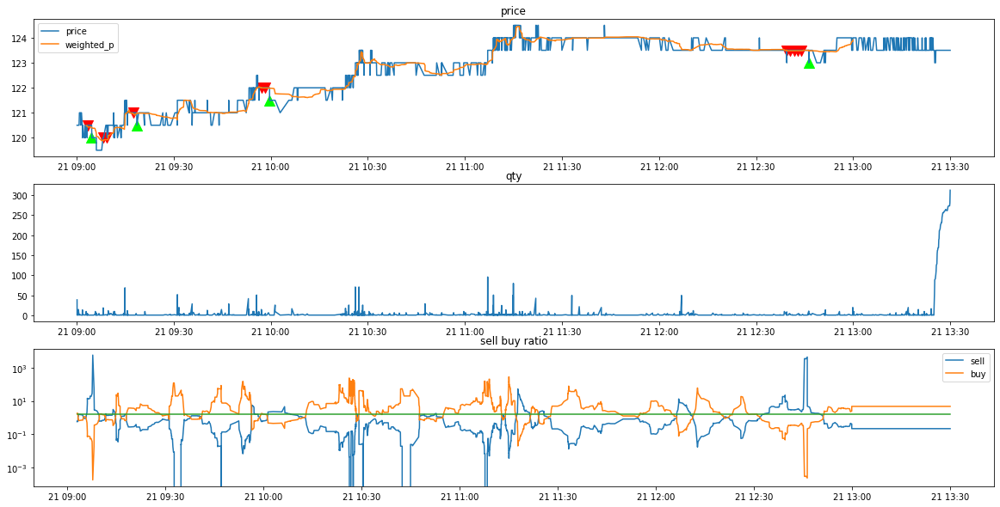

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006445
*** bid1_p:  124.5
*** weighted_p:  124.43
ask1_p:  125.0
num_sell:  31
num_buy:  19
進場時間： 91225962 
  sell price at  124.5
*** bid1_p:  124.5
*** weighted_p:  124.43137254901961
ask1_p:  125.0
num_sell:  37
num_buy:  14
進場時間： 91326243 
  sell price at  124.5
*** bid1_p:  125.5
*** weighted_p:  125.4888888888889
ask1_p:  126.0
num_sell:  28
num_buy:  17
進場時間： 93031318 
  sell price at  125.5
stop profit
出場時間： 93733241
POSITION(pre):  [124.5 124.5 125.5]
Order_p(pre):  [124. 124. 125.]
tick_row price:  125.0
qualified index:  [[2]]
POSITION(post):  [124.5 124.5]
Order_p(post):  [124. 124.]

*** bid1_p:  125.5
*** weighted_p:  125.49074074074075
ask1_p:  126.0
num_sell:  51
num_buy:  3
進場時間： 93759940 
  sell price at

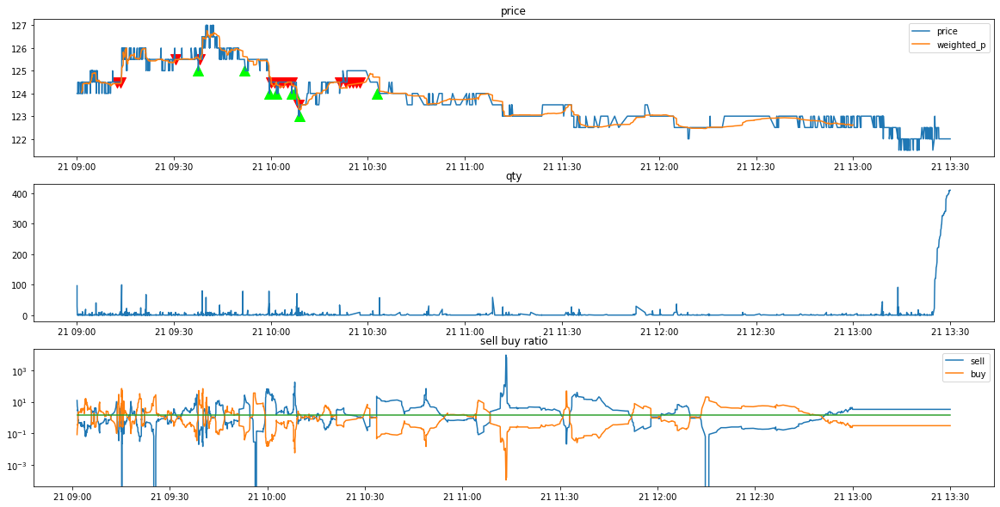

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004725
*** bid1_p:  123.5
*** weighted_p:  123.47297297297297
ask1_p:  124.0
num_sell:  59
num_buy:  15
進場時間： 90259511 
  sell price at  123.5
stop profit
出場時間： 90259834
POSITION(pre):  [123.5]
Order_p(pre):  [123.]
tick_row price:  123.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.5
*** weighted_p:  123.41071428571429
ask1_p:  124.0
num_sell:  17
num_buy:  11
進場時間： 90824113 
  sell price at  123.5
stop profit
出場時間： 90846667
POSITION(pre):  [123.5]
Order_p(pre):  [123.]
tick_row price:  123.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.5
*** weighted_p:  123.48717948717949
ask1_p:  124.0
num_sell:  38
num_buy:  1
進場時間： 91216863 
  sell price at  123

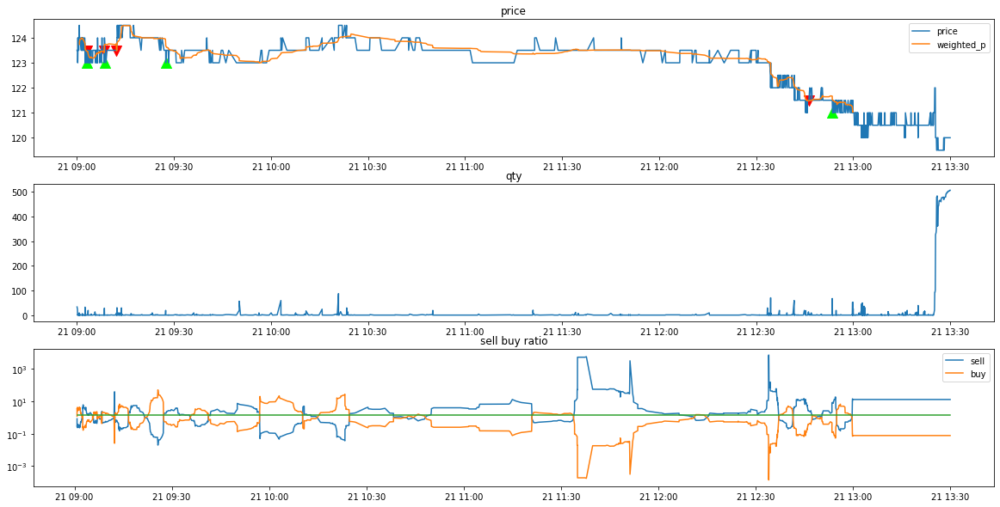

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007157
*** bid1_p:  121.5
*** weighted_p:  121.47014925373135
ask1_p:  122.0
num_sell:  41
num_buy:  26
進場時間： 90644549 
  sell price at  121.5
stop profit
出場時間： 90810167
POSITION(pre):  [121.5]
Order_p(pre):  [121.]
tick_row price:  121.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  120.5
*** weighted_p:  120.31818181818181
ask1_p:  121.0
num_sell:  27
num_buy:  17
進場時間： 91218564 
  sell price at  120.5
stop profit
出場時間： 91241785
POSITION(pre):  [120.5]
Order_p(pre):  [120.]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.0
*** weighted_p:  120.95161290322581
ask1_p:  121.5
num_sell:  77
num_buy:  16
進場時間： 102836255 
  sell price at  1

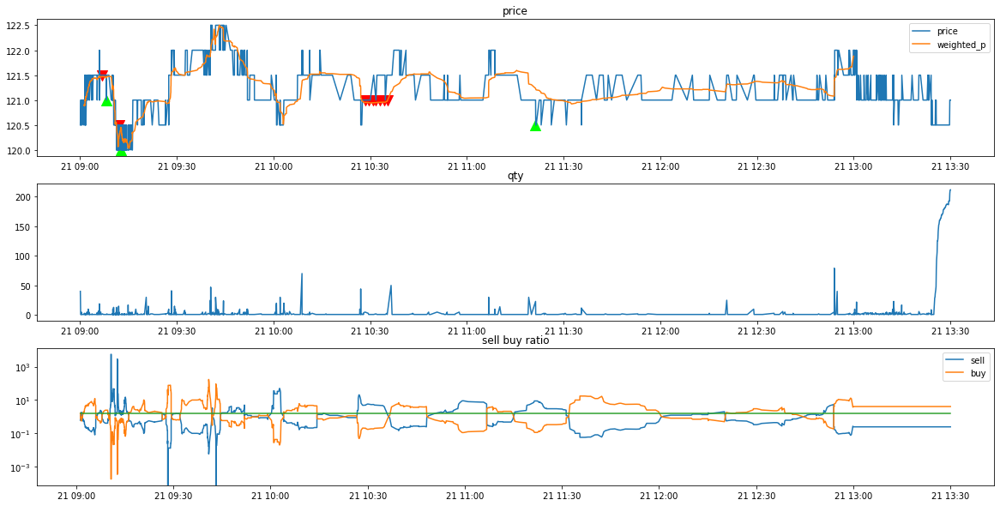

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008684
*** bid1_p:  122.0
*** weighted_p:  121.85185185185185
ask1_p:  122.5
num_sell:  53
num_buy:  28
進場時間： 91524569 
  sell price at  122.0
stop profit
出場時間： 91527635
POSITION(pre):  [122.]
Order_p(pre):  [121.5]
tick_row price:  121.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.5
*** weighted_p:  121.38039215686274
ask1_p:  122.0
num_sell:  214
num_buy:  41
進場時間： 92730146 
  sell price at  121.5
stop profit
出場時間： 92730146
POSITION(pre):  [121.5]
Order_p(pre):  [121.]
tick_row price:  121.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.0
*** weighted_p:  122.99358974358974
ask1_p:  123.5
num_sell:  55
num_buy:  23
進場時間： 94611971 
  sell price at  1

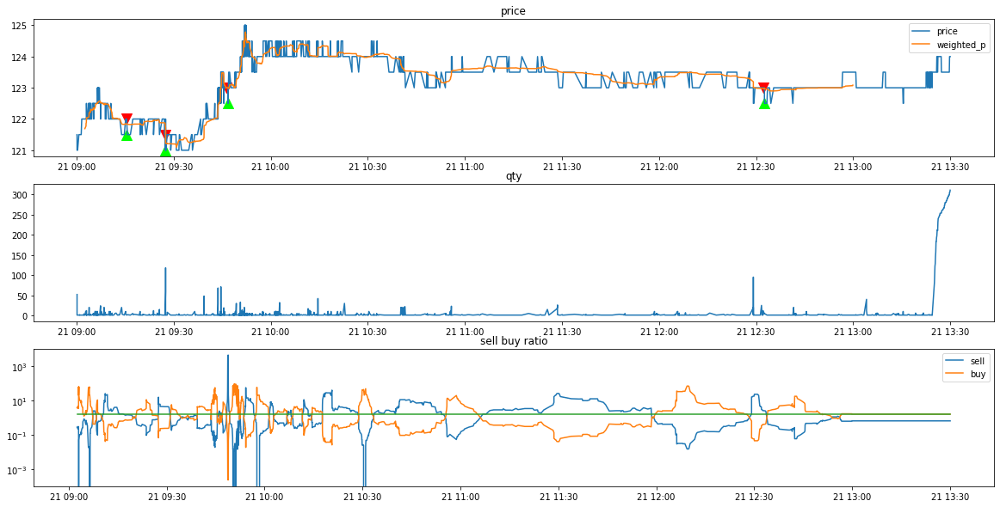

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007181
*** bid1_p:  123.5
*** weighted_p:  123.2457627118644
ask1_p:  124.0
num_sell:  41
num_buy:  18
進場時間： 90527389 
  sell price at  123.5
stop profit
出場時間： 90551370
POSITION(pre):  [123.5]
Order_p(pre):  [123.]
tick_row price:  123.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.5
*** weighted_p:  123.42261904761905
ask1_p:  124.0
num_sell:  51
num_buy:  33
進場時間： 91344566 
  sell price at  123.5
stop profit
出場時間： 91344566
POSITION(pre):  [123.5]
Order_p(pre):  [123.]
tick_row price:  123.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.0
*** weighted_p:  122.95918367346938
ask1_p:  123.5
num_sell:  83
num_buy:  15
進場時間： 91643848 
  sell price at  123

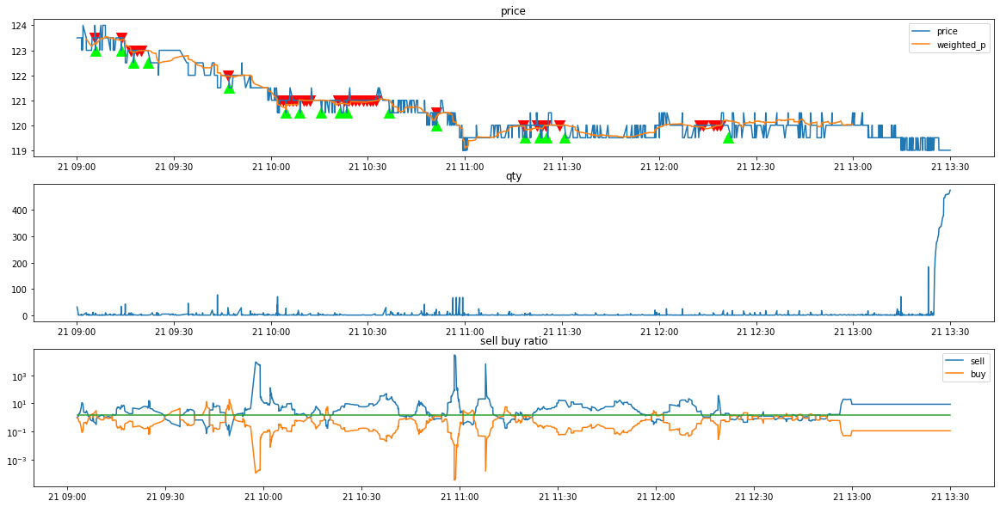

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007635
*** bid1_p:  118.0
*** weighted_p:  117.984375
ask1_p:  118.5
num_sell:  27
num_buy:  5
進場時間： 90437498 
  sell price at  118.0
stop profit
出場時間： 90528911
POSITION(pre):  [118.]
Order_p(pre):  [117.5]
tick_row price:  117.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  117.5
*** weighted_p:  117.43539325842697
ask1_p:  118.0
num_sell:  113
num_buy:  65
進場時間： 90815177 
  sell price at  117.5
stop profit
出場時間： 90904336
POSITION(pre):  [117.5]
Order_p(pre):  [117.]
tick_row price:  117.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  116.5
*** weighted_p:  116.30625
ask1_p:  117.0
num_sell:  71
num_buy:  9
進場時間： 91232416 
  sell price at  116.5
stop profit
出場

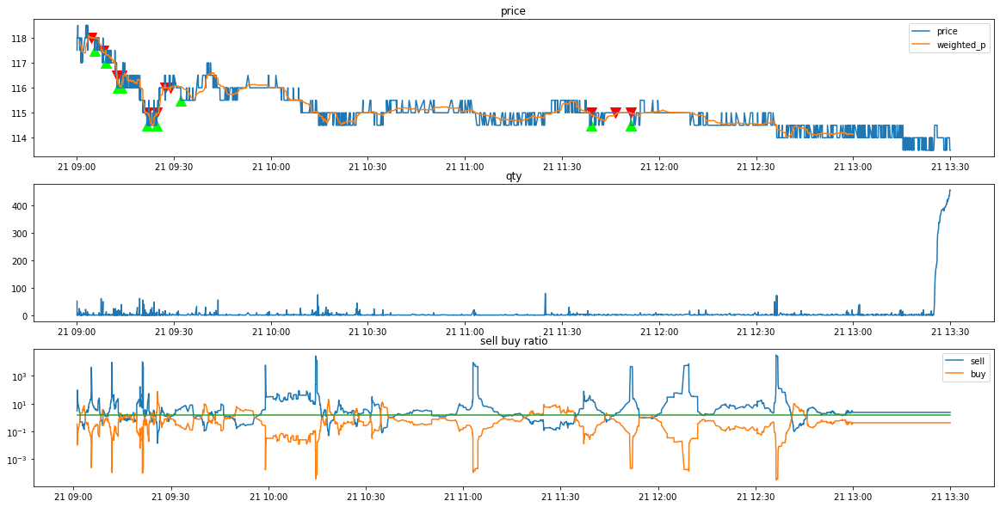

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005184
*** bid1_p:  113.5
*** weighted_p:  113.42857142857143
ask1_p:  114.0
num_sell:  47
num_buy:  9
進場時間： 90356594 
  sell price at  113.5
stop profit
出場時間： 90400823
POSITION(pre):  [113.5]
Order_p(pre):  [113.]
tick_row price:  113.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  111.5
*** weighted_p:  111.45945945945945
ask1_p:  112.0
num_sell:  28
num_buy:  9
進場時間： 90641793 
  sell price at  111.5
*** bid1_p:  112.0
*** weighted_p:  111.95945945945945
ask1_p:  112.5
num_sell:  29
num_buy:  8
進場時間： 90741834 
  sell price at  112.0
stop profit
出場時間： 90759424
POSITION(pre):  [111.5 112. ]
Order_p(pre):  [111.  111.5]
tick_row price:  111.5
qualified index:  [[1]]
POSITION(post):  [111.5]
O

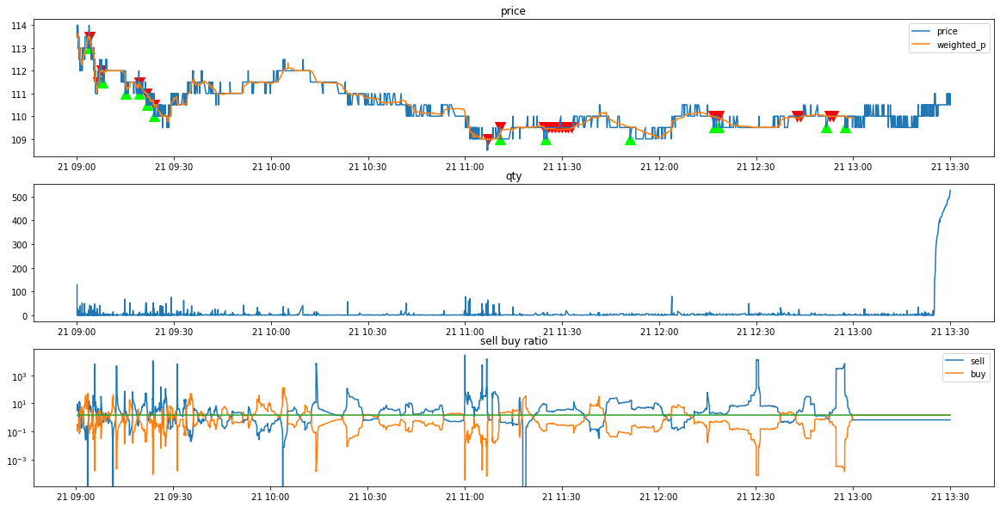

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003100
*** bid1_p:  107.0
*** weighted_p:  106.92021276595744
ask1_p:  107.5
num_sell:  83
num_buy:  11
進場時間： 90725054 
  sell price at  107.0
stop profit
出場時間： 90725054
POSITION(pre):  [107.]
Order_p(pre):  [106.5]
tick_row price:  106.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  108.5
*** weighted_p:  108.41549295774648
ask1_p:  109.0
num_sell:  46
num_buy:  25
進場時間： 92546216 
  sell price at  108.5
stop profit
出場時間： 92551495
POSITION(pre):  [108.5]
Order_p(pre):  [108.]
tick_row price:  108.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  107.5
*** weighted_p:  107.4
ask1_p:  108.0
num_sell:  68
num_buy:  42
進場時間： 92952277 
  sell price at  107.5
stop prof

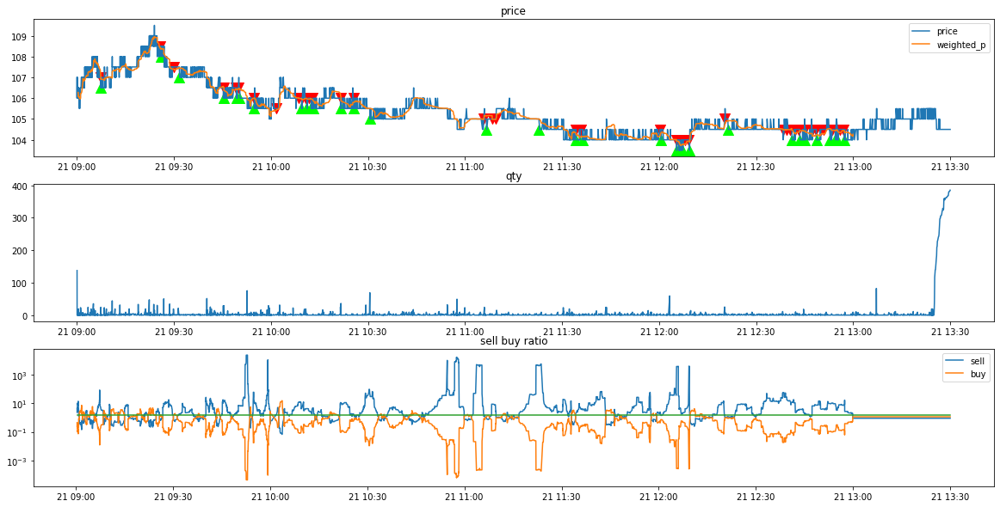

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006331
*** bid1_p:  106.5
*** weighted_p:  106.47727272727273
ask1_p:  107.0
num_sell:  31
num_buy:  13
進場時間： 90227799 
  sell price at  106.5
stop profit
出場時間： 90256166
POSITION(pre):  [106.5]
Order_p(pre):  [106.]
tick_row price:  106.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  106.0
*** weighted_p:  105.93478260869566
ask1_p:  106.5
num_sell:  106
num_buy:  32
進場時間： 91000878 
  sell price at  106.0
stop profit
出場時間： 91000878
POSITION(pre):  [106.]
Order_p(pre):  [105.5]
tick_row price:  105.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  105.5
*** weighted_p:  105.390625
ask1_p:  106.0
num_sell:  31
num_buy:  1
進場時間： 91810082 
  sell price at  105.5
stop

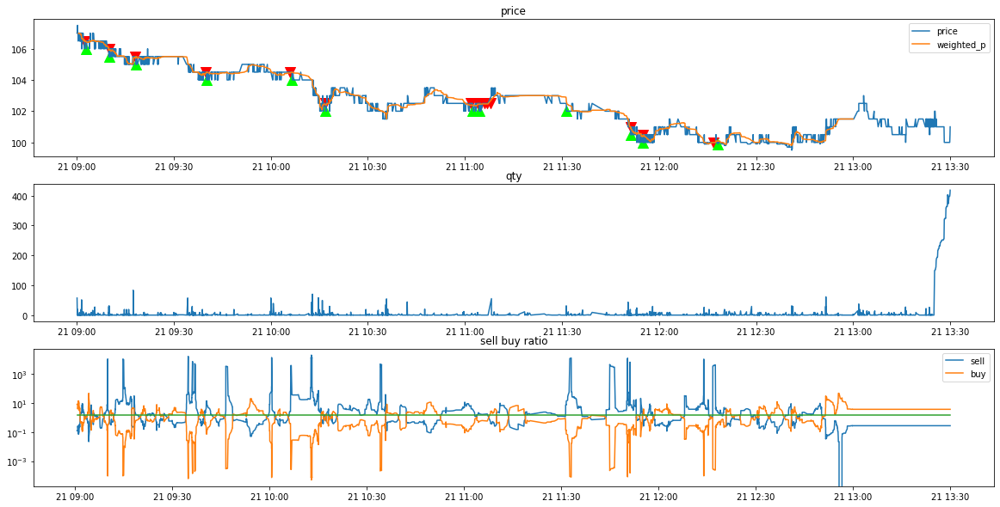

In [ ]:
para = {"sid": "6278", "beta":1.5, "time_out": 2000000, "gamma": 1, "cool_down_min": 100000, "stop_loss_factor": 1.1, "theta": 1, "position_max_q": 10}

res_6278 = back_test(dt.datetime(2020, 7, 9), dt.datetime(2020, 9, 25), **para)
profit_6278, cost_6278 = calculate_profit(res_6278)

In [ ]:
profit_6278

353.6

In [ ]:
cost_6278

123696.0

In [ ]:
para = {"sid": "6278", "beta":1.5, "time_out": 2000000, "gamma": 1, "cool_down_min": 100000, "stop_loss_factor": 1.1, "theta": 1, "position_max_q": 10}

res_6278 = back_test(dt.datetime(2020, 7, 9), dt.datetime(2020, 9, 25), **para)
profit_6278, cost_6278 = calculate_profit(res_6278)

# Grid Search

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022778
*** bid1_p:  169.5
*** weighted_p:  169.0
ask1_p:  170.0
進場時間： 90324482 
  sell price at  169.5
stop profit
出場時間： 90324572
POSITION(pre):  [169.5]
Order_p(pre):  [169.]
tick_row price:  169.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  169.5
*** weighted_p:  169.08317757009345
ask1_p:  170.0
進場時間： 120800650 
  sell price at  169.5
*** bid1_p:  169.5
*** weighted_p:  169.08317757009345
ask1_p:  170.0
進場時間： 120838282 
  sell price at  169.5
*** bid1_p:  169.5
*** weighted_p:  169.08317757009345
ask1_p:  170.0
進場時間： 120942509 
  sell price at  169.5
*** bid1_p:  169.5
*** weighted_p:  169.08317757009345
ask1_p:  170.0
進場時間： 121038962 
  sell price at  169.5
*** bid1_p:  169.5
*** weigh

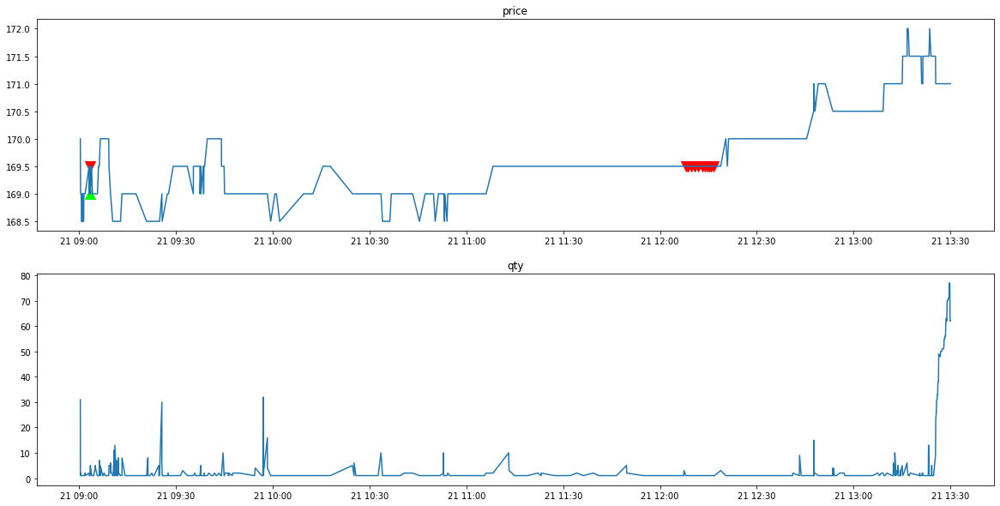

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022856
*** bid1_p:  174.0
*** weighted_p:  173.37078651685394
ask1_p:  174.5
進場時間： 90754787 
  sell price at  174.0
stop profit
出場時間： 90801863
POSITION(pre):  [174.]
Order_p(pre):  [173.5]
tick_row price:  173.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  174.5
*** weighted_p:  173.8257142857143
ask1_p:  175.0
進場時間： 91204022 
  sell price at  174.5
stop profit
出場時間： 91221851
POSITION(pre):  [174.5]
Order_p(pre):  [174.]
tick_row price:  174.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  174.5
*** weighted_p:  173.88717948717948
ask1_p:  175.0
進場時間： 91235178 
  sell price at  174.5
stop profit
出場時間： 91245100
POSITION(pre):  [174.5]
Order_p(pre):  [174.]
tick_

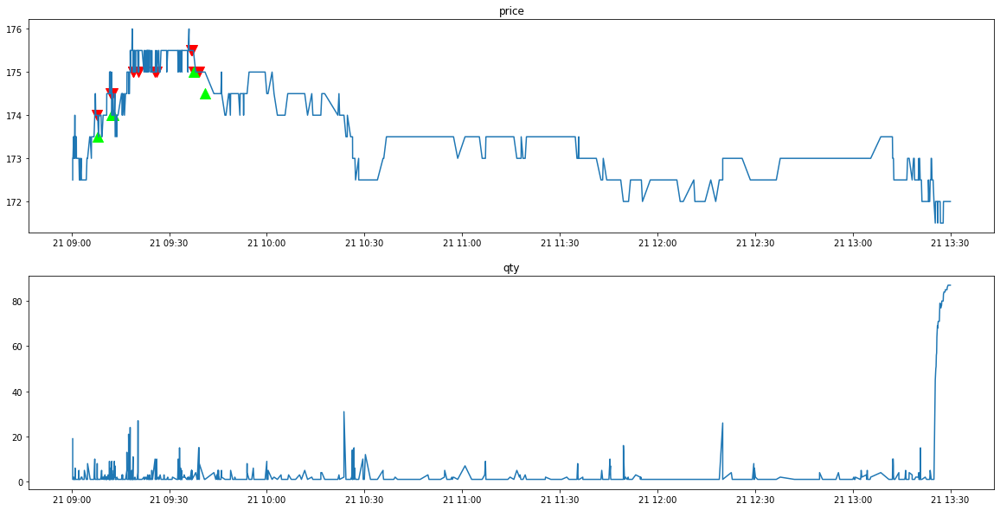

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022814
clear_position:  0.0
position:  []
tick_row_price 170.0
----------Result Report--------------
profit:  0.0


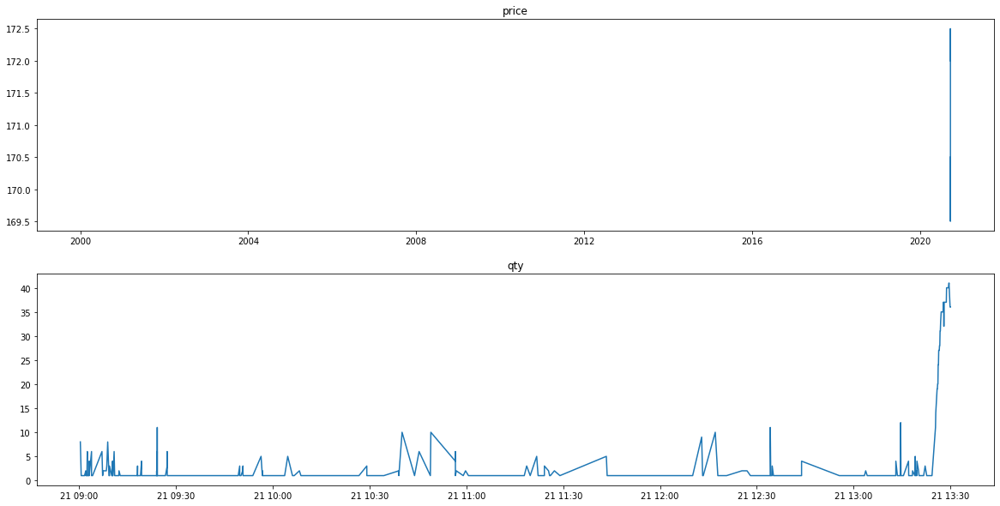

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022741
*** bid1_p:  173.0
*** weighted_p:  172.7087912087912
ask1_p:  173.5
進場時間： 91948046 
  sell price at  173.0
stop profit
出場時間： 91948046
POSITION(pre):  [173.]
Order_p(pre):  [172.5]
tick_row price:  172.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  173.0
*** weighted_p:  172.78494623655914
ask1_p:  173.5
進場時間： 110856654 
  sell price at  173.0
stop profit
出場時間： 112122770
POSITION(pre):  [173.]
Order_p(pre):  [172.5]
tick_row price:  172.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 172.0
----------Result Report--------------
profit:  1.0


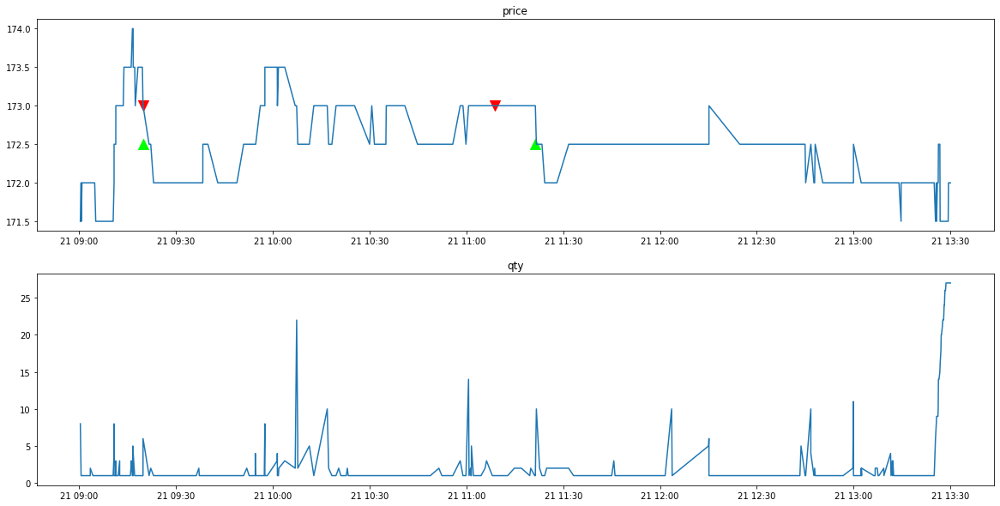

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022838
*** bid1_p:  175.0
*** weighted_p:  173.88492063492063
ask1_p:  175.5
進場時間： 95438253 
  sell price at  175.0
*** bid1_p:  175.0
*** weighted_p:  173.93560606060606
ask1_p:  175.5
進場時間： 95500700 
  sell price at  175.0
*** bid1_p:  175.0
*** weighted_p:  173.9630996309963
ask1_p:  175.5
進場時間： 95532219 
  sell price at  175.0
*** bid1_p:  174.5
*** weighted_p:  174.0174825174825
ask1_p:  175.0
進場時間： 95602511 
  sell price at  174.5
*** bid1_p:  175.0
*** weighted_p:  174.10223642172525
ask1_p:  175.5
進場時間： 95743326 
  sell price at  175.0
*** bid1_p:  175.0
*** weighted_p:  174.11356466876973
ask1_p:  175.5
進場時間： 95804745 
  sell price at  175.0
*** bid1_p:  175.0
*** weighted_p:  174.14329268292684
ask1_p:  175.5
進場

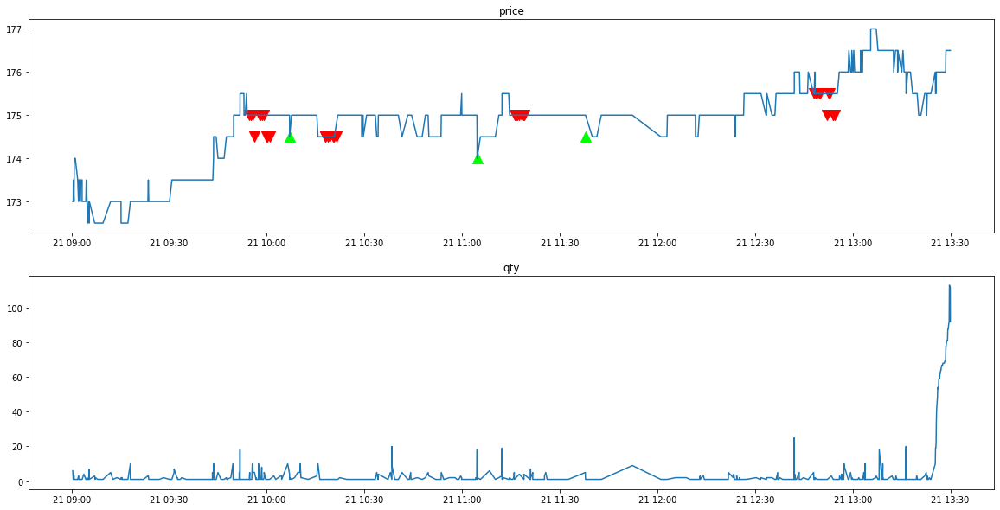

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022892
*** bid1_p:  179.5
*** weighted_p:  178.45484581497797
ask1_p:  180.0
進場時間： 104614295 
  sell price at  179.5
*** bid1_p:  179.5
*** weighted_p:  178.4914255091104
ask1_p:  180.0
進場時間： 105153051 
  sell price at  179.5
*** bid1_p:  179.0
*** weighted_p:  178.4978700745474
ask1_p:  180.0
進場時間： 105202139 
  sell price at  179.0
stop profit
出場時間： 105643754
POSITION(pre):  [179.5 179.5 179. ]
Order_p(pre):  [179.  179.  178.5]
tick_row price:  179.0
qualified index:  [[0]
 [1]]
POSITION(post):  [179.]
Order_p(post):  [178.5]

*** bid1_p:  180.5
*** weighted_p:  178.96064814814815
ask1_p:  181.0
進場時間： 112606356 
  sell price at  180.5
*** bid1_p:  180.0
*** weighted_p:  178.97164750957853
ask1_p:  181.0
進場時間： 112636785 

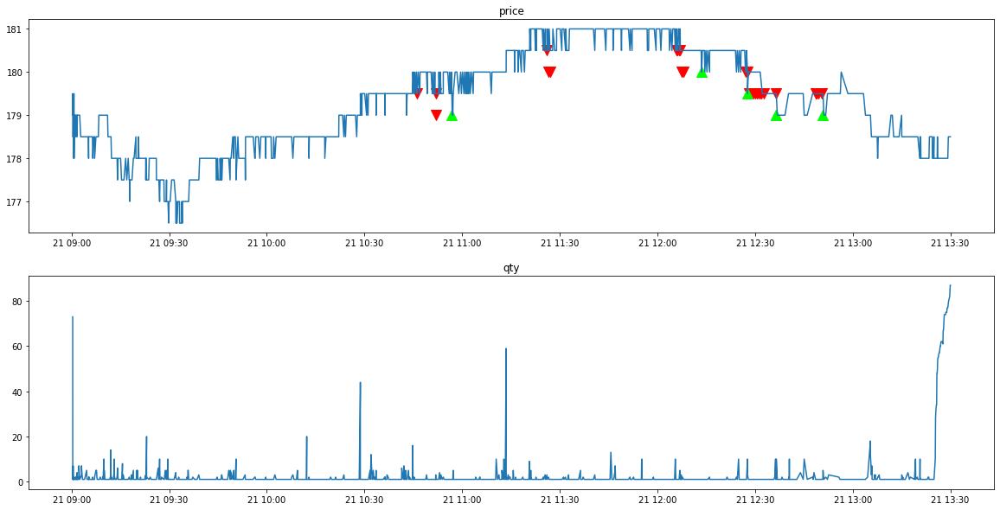

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022885
clear_position:  0.0
position:  []
tick_row_price 177.5
----------Result Report--------------
profit:  0.0


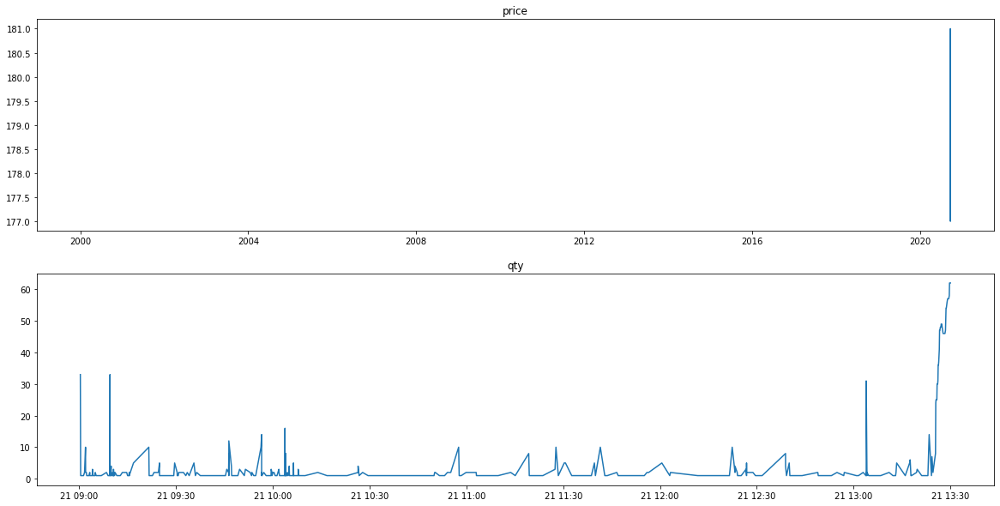

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022981
*** bid1_p:  179.0
*** weighted_p:  178.55978260869566
ask1_p:  179.5
進場時間： 120652146 
  sell price at  179.0
*** bid1_p:  179.0
*** weighted_p:  178.55978260869566
ask1_p:  179.5
進場時間： 120707399 
  sell price at  179.0
*** bid1_p:  179.0
*** weighted_p:  178.56263498920086
ask1_p:  179.5
進場時間： 120742338 
  sell price at  179.0
stop profit
出場時間： 120742338
POSITION(pre):  [179. 179. 179.]
Order_p(pre):  [178.5 178.5 178.5]
tick_row price:  178.5
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 178.0
----------Result Report--------------
profit:  1.5


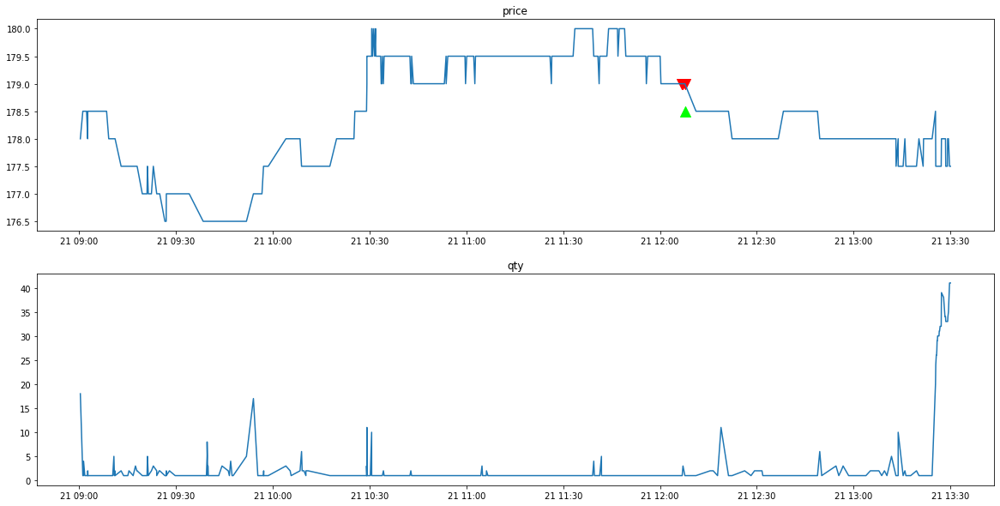

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022839
clear_position:  0.0
position:  []
tick_row_price 178.0
----------Result Report--------------
profit:  0.0


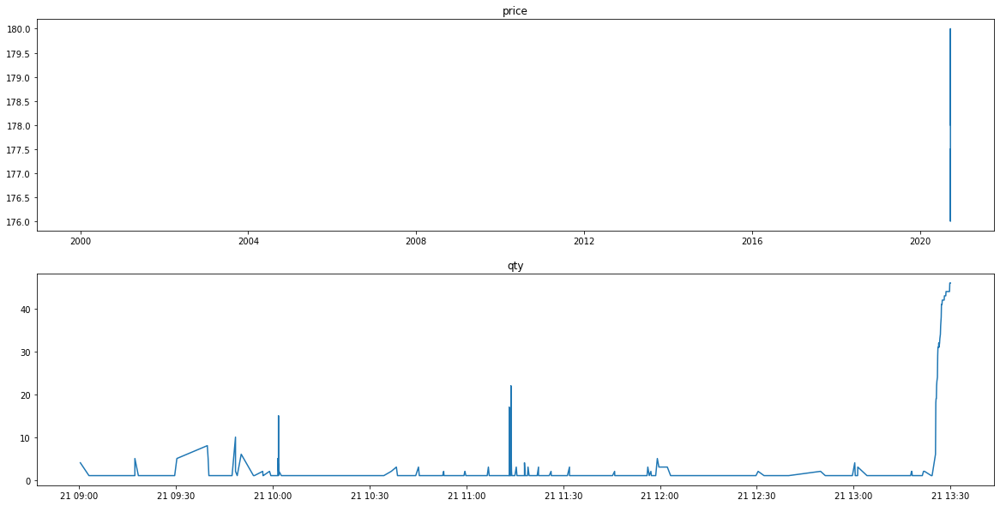

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022813
*** bid1_p:  178.0
*** weighted_p:  177.78971962616822
ask1_p:  178.5
進場時間： 93313604 
  sell price at  178.0
stop profit
出場時間： 93313604
POSITION(pre):  [178.]
Order_p(pre):  [177.5]
tick_row price:  177.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  178.0
*** weighted_p:  177.76793248945148
ask1_p:  178.5
進場時間： 93940254 
  sell price at  178.0
*** bid1_p:  178.0
*** weighted_p:  177.7689075630252
ask1_p:  178.5
進場時間： 94030480 
  sell price at  178.0
*** bid1_p:  178.0
*** weighted_p:  177.7689075630252
ask1_p:  178.5
進場時間： 94105732 
  sell price at  178.0
*** bid1_p:  178.0
*** weighted_p:  177.77822580645162
ask1_p:  178.5
進場時間： 94659271 
  sell price at  178.0
*** bid1_p:  178.0
**

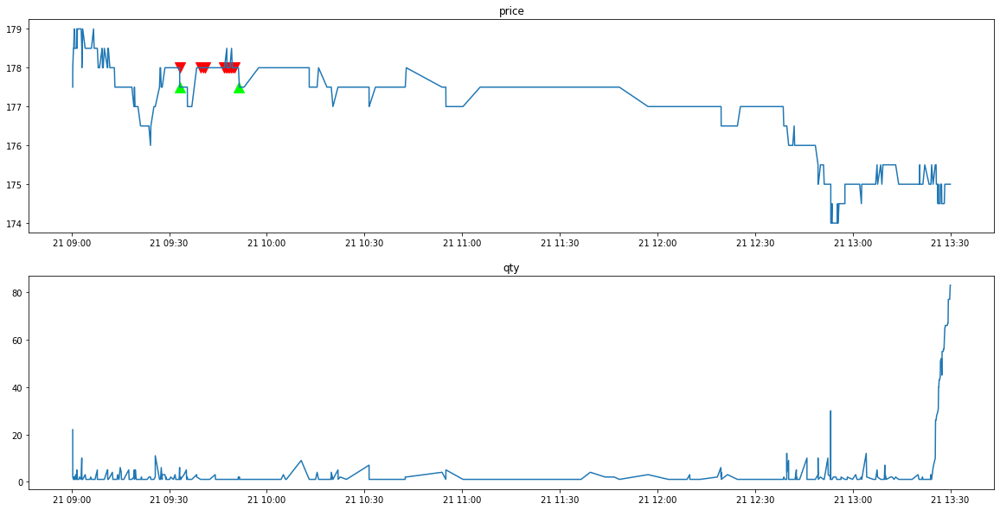

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90023033
*** bid1_p:  179.5
*** weighted_p:  178.78470254957506
ask1_p:  180.0
進場時間： 92354354 
  sell price at  179.5
*** bid1_p:  179.0
*** weighted_p:  178.7966573816156
ask1_p:  179.5
進場時間： 92400147 
  sell price at  179.0
*** bid1_p:  179.5
*** weighted_p:  178.9076354679803
ask1_p:  180.0
進場時間： 92811045 
  sell price at  179.5
stop profit
出場時間： 92838107
POSITION(pre):  [179.5 179.  179.5]
Order_p(pre):  [179.  178.5 179. ]
tick_row price:  179.0
qualified index:  [[0]
 [2]]
POSITION(post):  [179.]
Order_p(post):  [178.5]

*** bid1_p:  180.0
*** weighted_p:  179.43357142857144
ask1_p:  180.5
進場時間： 93418053 
  sell price at  180.0
*** bid1_p:  180.5
*** weighted_p:  179.46036161335186
ask1_p:  181.0
進場時間： 93520488 
  sel

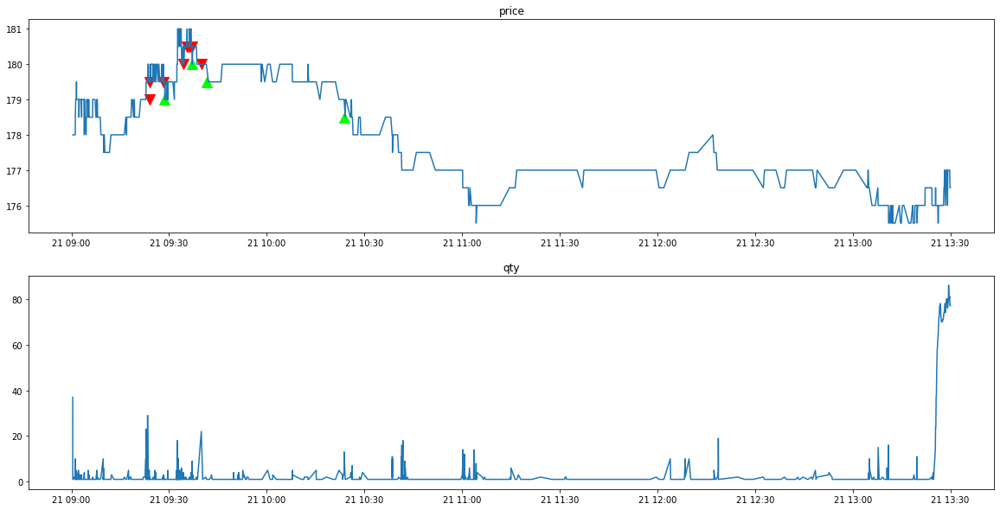

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90023035
*** bid1_p:  174.5
*** weighted_p:  174.3
ask1_p:  175.0
進場時間： 90811545 
  sell price at  174.5
stop profit
出場時間： 90823900
POSITION(pre):  [174.5]
Order_p(pre):  [174.]
tick_row price:  174.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  174.5
*** weighted_p:  174.20866141732284
ask1_p:  175.0
進場時間： 92012080 
  sell price at  174.5
*** bid1_p:  174.5
*** weighted_p:  174.20866141732284
ask1_p:  175.0
進場時間： 92106576 
  sell price at  174.5
*** bid1_p:  174.5
*** weighted_p:  174.20866141732284
ask1_p:  175.0
進場時間： 92139137 
  sell price at  174.5
*** bid1_p:  174.5
*** weighted_p:  174.21317829457365
ask1_p:  175.0
進場時間： 92214765 
  sell price at  174.5
*** bid1_p:  174.5
*** weighted_

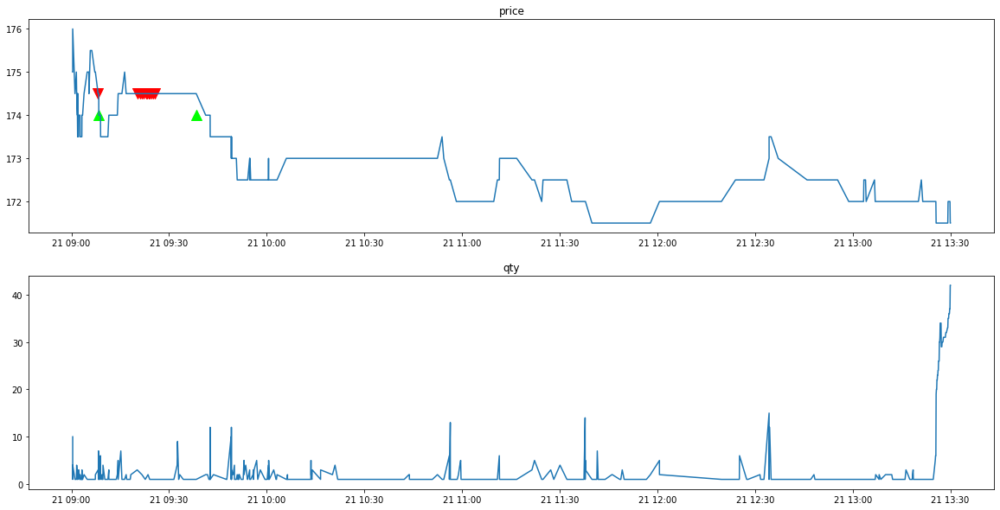

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6462/otc_lob_6462.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6462/otc_tick_6462.csv' mode='r' encoding='UTF-8'>
90022903
clear_position:  0.0
position:  []
tick_row_price 166.0
----------Result Report--------------
profit:  0.0


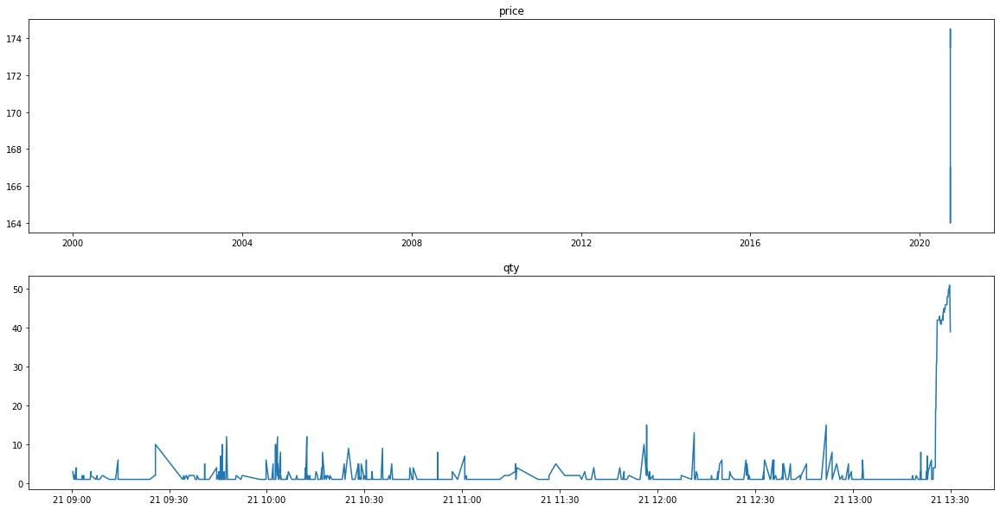

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007702
*** bid1_p:  117.0
*** weighted_p:  116.65760869565217
ask1_p:  117.5
進場時間： 90626174 
  sell price at  117.0
*** bid1_p:  117.0
*** weighted_p:  116.6678445229682
ask1_p:  117.5
進場時間： 90708289 
  sell price at  117.0
stop profit
出場時間： 90721784
POSITION(pre):  [117. 117.]
Order_p(pre):  [116.5 116.5]
tick_row price:  116.5
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  116.0
*** weighted_p:  115.88204393505254
ask1_p:  116.5
進場時間： 91547780 
  sell price at  116.0
*** bid1_p:  116.0
*** weighted_p:  115.88238095238096
ask1_p:  116.5
進場時間： 91600626 
  sell price at  116.0
stop profit
出場時間： 91644689
POSITION(pre):  [116. 116.]
Order_p(pre):  [115.5 115.5]
tick_row price:  115.5
qualif

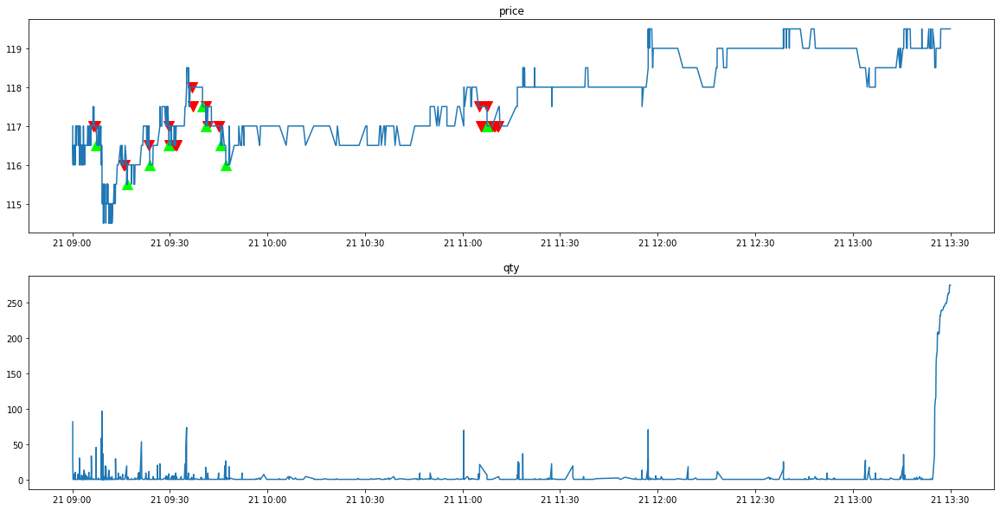

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90009523
*** bid1_p:  121.0
*** weighted_p:  120.69642857142857
ask1_p:  121.5
進場時間： 90741683 
  sell price at  121.0
*** bid1_p:  121.0
*** weighted_p:  120.701171875
ask1_p:  121.5
進場時間： 90800341 
  sell price at  121.0
stop profit
出場時間： 90803220
POSITION(pre):  [121. 121.]
Order_p(pre):  [120.5 120.5]
tick_row price:  120.5
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.5
*** weighted_p:  120.916142557652
ask1_p:  122.0
進場時間： 91251191 
  sell price at  121.5
stop profit
出場時間： 91251191
POSITION(pre):  [121.5]
Order_p(pre):  [121.]
tick_row price:  121.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.0
*** weighted_p:  120.84287454323996
ask1_p:  121.

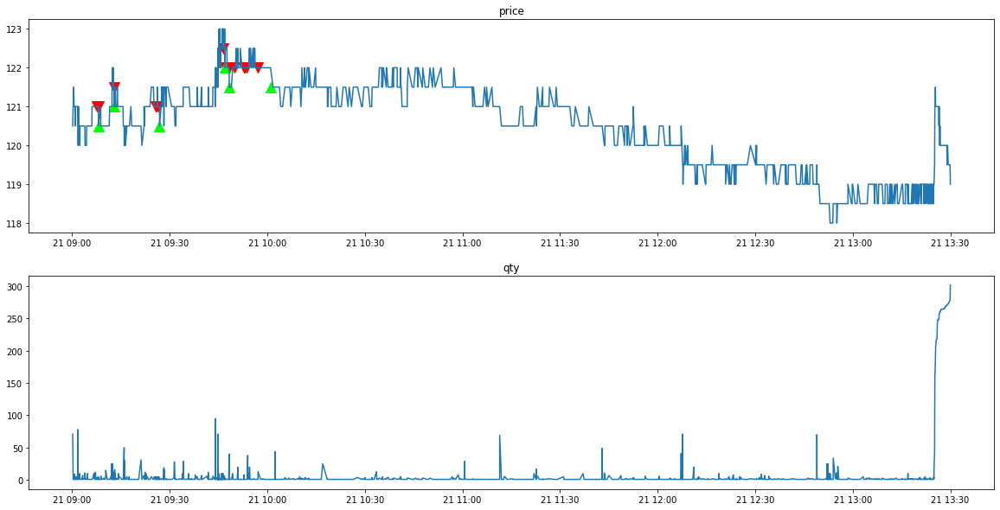

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008401
*** bid1_p:  119.0
*** weighted_p:  118.57801418439716
ask1_p:  119.5
進場時間： 91021498 
  sell price at  119.0
*** bid1_p:  119.0
*** weighted_p:  118.58680555555556
ask1_p:  119.5
進場時間： 91056368 
  sell price at  119.0
*** bid1_p:  119.0
*** weighted_p:  118.59726962457339
ask1_p:  119.5
進場時間： 91123379 
  sell price at  119.0
*** bid1_p:  119.0
*** weighted_p:  118.59863945578232
ask1_p:  119.5
進場時間： 91155082 
  sell price at  119.0
*** bid1_p:  119.0
*** weighted_p:  118.59863945578232
ask1_p:  119.5
進場時間： 91200368 
  sell price at  119.0
*** bid1_p:  119.0
*** weighted_p:  118.77913279132791
ask1_p:  119.5
進場時間： 91308563 
  sell price at  119.0
*** bid1_p:  119.5
*** weighted_p:  118.87349397590361
ask1_p:  120.0


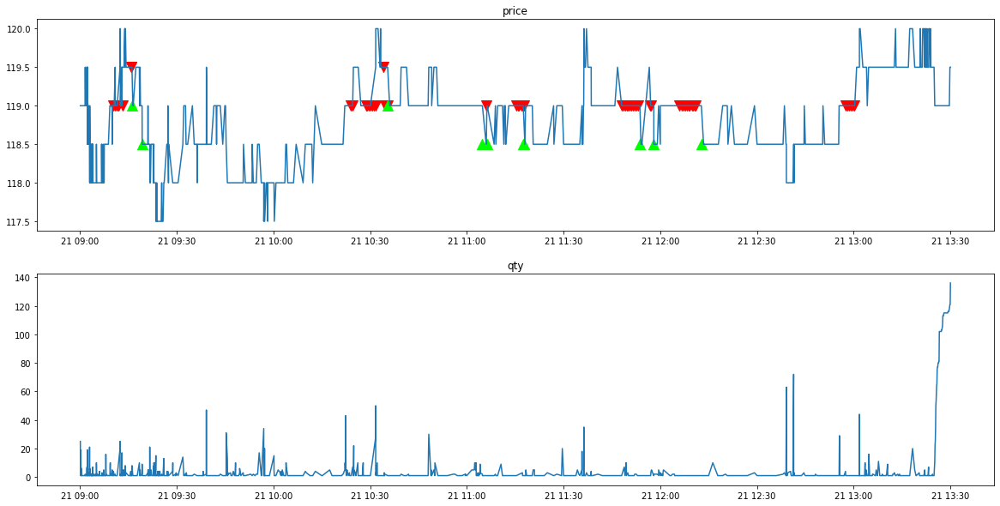

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90009325
*** bid1_p:  120.5
*** weighted_p:  120.24654377880184
ask1_p:  121.0
進場時間： 91140454 
  sell price at  120.5
stop profit
出場時間： 91140454
POSITION(pre):  [120.5]
Order_p(pre):  [120.]
tick_row price:  120.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  122.0
*** weighted_p:  121.09825870646766
ask1_p:  122.5
進場時間： 95602791 
  sell price at  122.0
stop profit
出場時間： 95621858
POSITION(pre):  [122.]
Order_p(pre):  [121.5]
tick_row price:  121.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.5
*** weighted_p:  121.12540192926045
ask1_p:  122.0
進場時間： 95633183 
  sell price at  121.5
*** bid1_p:  121.5
*** weighted_p:  121.12750601443464
ask1_p:  122.0
進場時間： 9

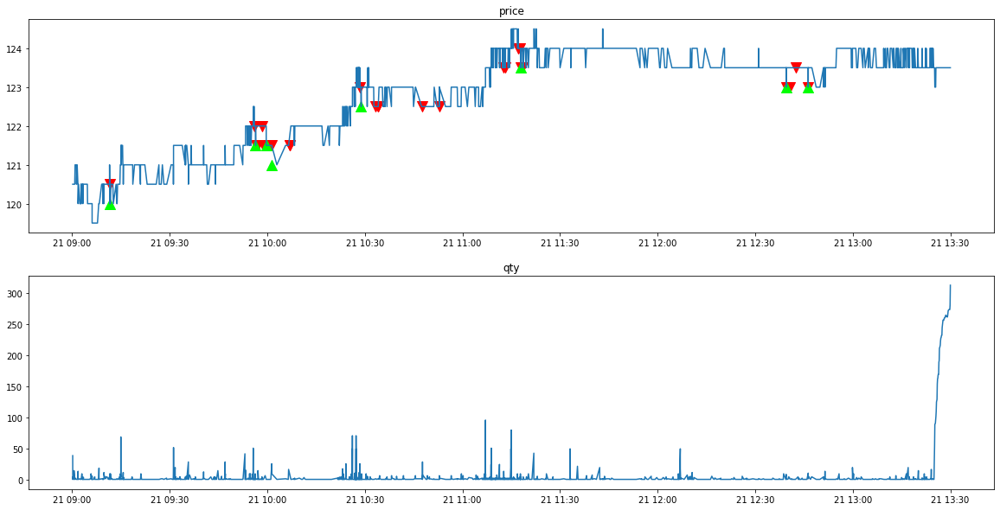

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006445
*** bid1_p:  125.5
*** weighted_p:  124.78653846153846
ask1_p:  126.0
進場時間： 91422504 
  sell price at  125.5
*** bid1_p:  125.5
*** weighted_p:  125.01616161616161
ask1_p:  126.0
進場時間： 91524470 
  sell price at  125.5
stop profit
出場時間： 91524650
POSITION(pre):  [125.5 125.5]
Order_p(pre):  [125. 125.]
tick_row price:  125.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  125.5
*** weighted_p:  125.06037567084078
ask1_p:  126.0
進場時間： 91605284 
  sell price at  125.5
*** bid1_p:  125.5
*** weighted_p:  125.08347750865052
ask1_p:  126.0
進場時間： 91728756 
  sell price at  125.5
*** bid1_p:  125.5
*** weighted_p:  125.09882747068677
ask1_p:  126.0
進場時間： 91759008 
  sell price at  125.5
***

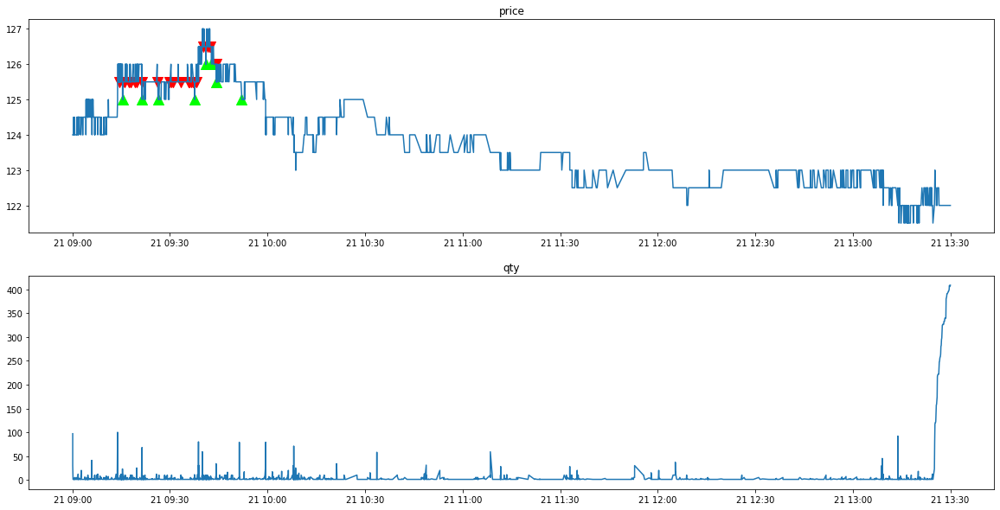

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90004725
*** bid1_p:  124.0
*** weighted_p:  123.61170212765957
ask1_p:  124.5
進場時間： 91304266 
  sell price at  124.0
*** bid1_p:  124.0
*** weighted_p:  123.78768577494692
ask1_p:  125.0
進場時間： 91357347 
  sell price at  124.0
*** bid1_p:  124.0
*** weighted_p:  123.78768577494692
ask1_p:  124.5
進場時間： 91400214 
  sell price at  124.0
*** bid1_p:  124.0
*** weighted_p:  123.79069767441861
ask1_p:  124.5
進場時間： 91431264 
  sell price at  124.0
*** bid1_p:  124.0
*** weighted_p:  123.8103448275862
ask1_p:  124.5
進場時間： 91644906 
  sell price at  124.0
*** bid1_p:  124.0
*** weighted_p:  123.81485148514851
ask1_p:  124.5
進場時間： 91700389 
  sell price at  124.0
*** bid1_p:  124.0
*** weighted_p:  123.81844660194174
ask1_p:  124.5
進

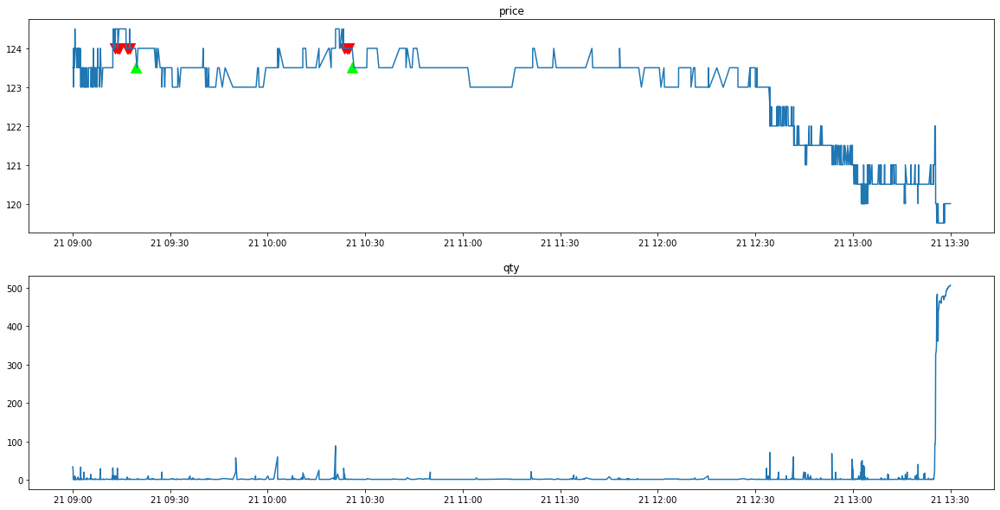

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007157
*** bid1_p:  121.5
*** weighted_p:  121.31132075471699
ask1_p:  122.0
進場時間： 90605423 
  sell price at  121.5
stop profit
出場時間： 90605423
POSITION(pre):  [121.5]
Order_p(pre):  [121.]
tick_row price:  121.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.0
*** weighted_p:  120.76319543509273
ask1_p:  121.5
進場時間： 92154310 
  sell price at  121.0
stop profit
出場時間： 92154310
POSITION(pre):  [121.]
Order_p(pre):  [120.5]
tick_row price:  120.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  121.5
*** weighted_p:  120.89771428571429
ask1_p:  122.0
進場時間： 92919096 
  sell price at  121.5
*** bid1_p:  122.0
*** weighted_p:  121.166951323655
ask1_p:  122.5
進場時間： 941

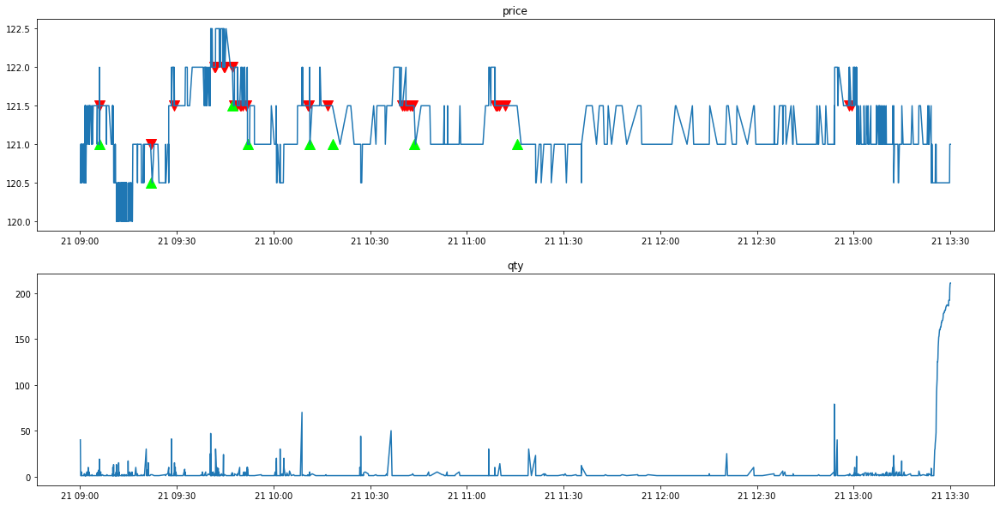

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90008684
*** bid1_p:  122.5
*** weighted_p:  122.34132841328413
ask1_p:  123.0
進場時間： 90723668 
  sell price at  122.5
stop profit
出場時間： 90723709
POSITION(pre):  [122.5]
Order_p(pre):  [122.]
tick_row price:  122.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  122.5
*** weighted_p:  122.37396121883657
ask1_p:  123.0
進場時間： 90850514 
  sell price at  122.5
stop profit
出場時間： 90850514
POSITION(pre):  [122.5]
Order_p(pre):  [122.]
tick_row price:  122.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  123.0
*** weighted_p:  122.2569536423841
ask1_p:  123.5
進場時間： 94530670 
  sell price at  123.0
stop profit
出場時間： 94530702
POSITION(pre):  [123.]
Order_p(pre):  [122.5]
tick_

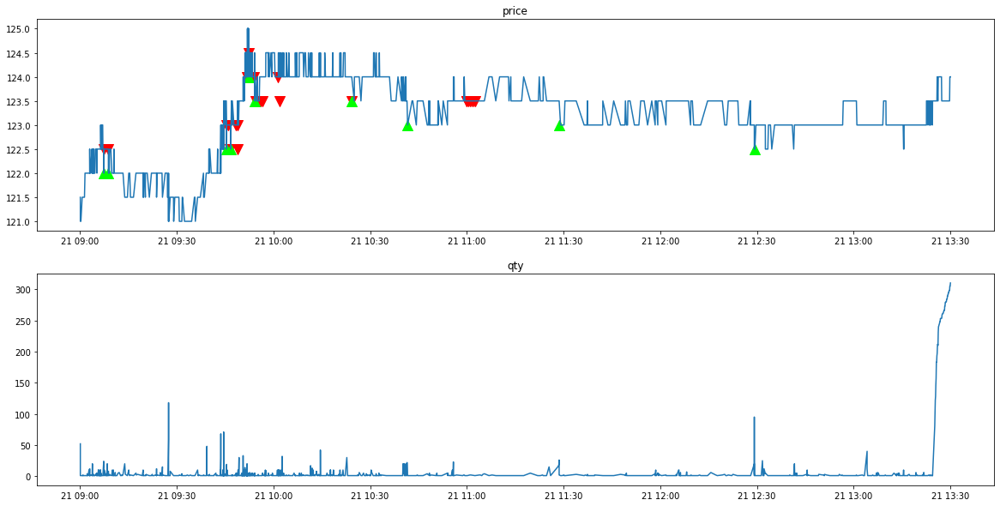

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007181
clear_position:  0.0
position:  []
tick_row_price 120.0
----------Result Report--------------
profit:  0.0


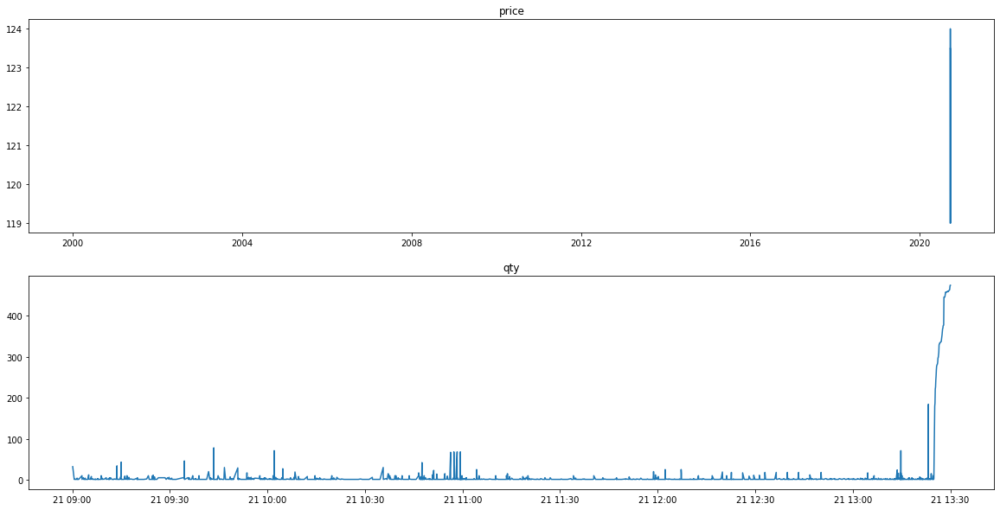

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90007635
*** bid1_p:  118.0
*** weighted_p:  117.66363636363636
ask1_p:  118.5
進場時間： 90323146 
  sell price at  118.0
stop profit
出場時間： 90324188
POSITION(pre):  [118.]
Order_p(pre):  [117.5]
tick_row price:  117.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  118.0
*** weighted_p:  117.70270270270271
ask1_p:  118.5
進場時間： 90354286 
  sell price at  118.0
*** bid1_p:  118.0
*** weighted_p:  117.70588235294117
ask1_p:  118.5
進場時間： 90400099 
  sell price at  118.0
*** bid1_p:  118.0
*** weighted_p:  117.71794871794872
ask1_p:  118.5
進場時間： 90431350 
  sell price at  118.0
*** bid1_p:  118.0
*** weighted_p:  117.72906403940887
ask1_p:  118.5
進場時間： 90501248 
  sell price at  118.0
stop profit
出場時間： 9

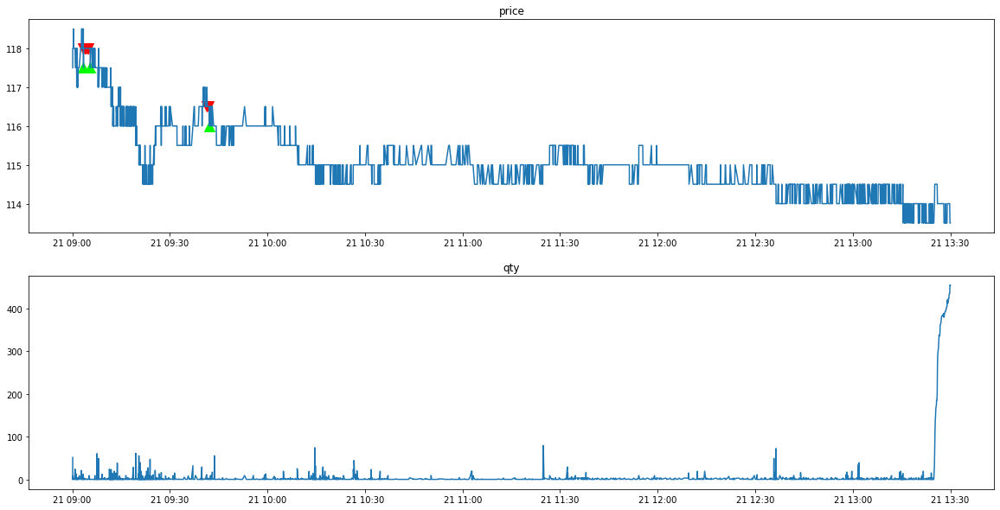

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90005184
*** bid1_p:  113.5
*** weighted_p:  112.84868421052632
ask1_p:  114.0
進場時間： 90345900 
  sell price at  113.5
stop profit
出場時間： 90355770
POSITION(pre):  [113.5]
Order_p(pre):  [113.]
tick_row price:  113.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  113.5
*** weighted_p:  112.91275167785236
ask1_p:  114.0
進場時間： 90400790 
  sell price at  113.5
stop profit
出場時間： 90400823
POSITION(pre):  [113.5]
Order_p(pre):  [113.]
tick_row price:  113.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  112.0
*** weighted_p:  111.44130903390163
ask1_p:  112.5
進場時間： 100516880 
  sell price at  112.0
*** bid1_p:  112.0
*** weighted_p:  111.4542408577446
ask1_p:  112.5
進場時間： 1

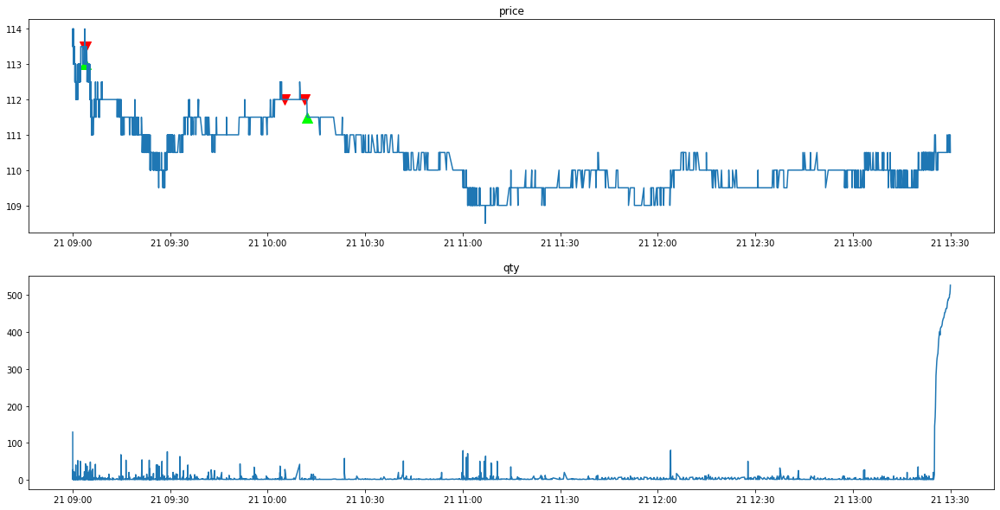

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90003100
*** bid1_p:  107.0
*** weighted_p:  106.7969696969697
ask1_p:  107.5
進場時間： 90241174 
  sell price at  107.0
*** bid1_p:  107.0
*** weighted_p:  106.8359375
ask1_p:  107.5
進場時間： 90311157 
  sell price at  107.0
*** bid1_p:  107.5
*** weighted_p:  107.24170616113744
ask1_p:  108.0
進場時間： 90521583 
  sell price at  107.5
*** bid1_p:  107.5
*** weighted_p:  107.2970711297071
ask1_p:  108.0
進場時間： 90607525 
  sell price at  107.5
stop profit
出場時間： 90618014
POSITION(pre):  [107.  107.  107.5 107.5]
Order_p(pre):  [106.5 106.5 107.  107. ]
tick_row price:  107.0
qualified index:  [[2]
 [3]]
POSITION(post):  [107. 107.]
Order_p(post):  [106.5 106.5]

stop profit
出場時間： 90723114
POSITION(pre):  [107. 107.]
Order_p(pre):  [106.

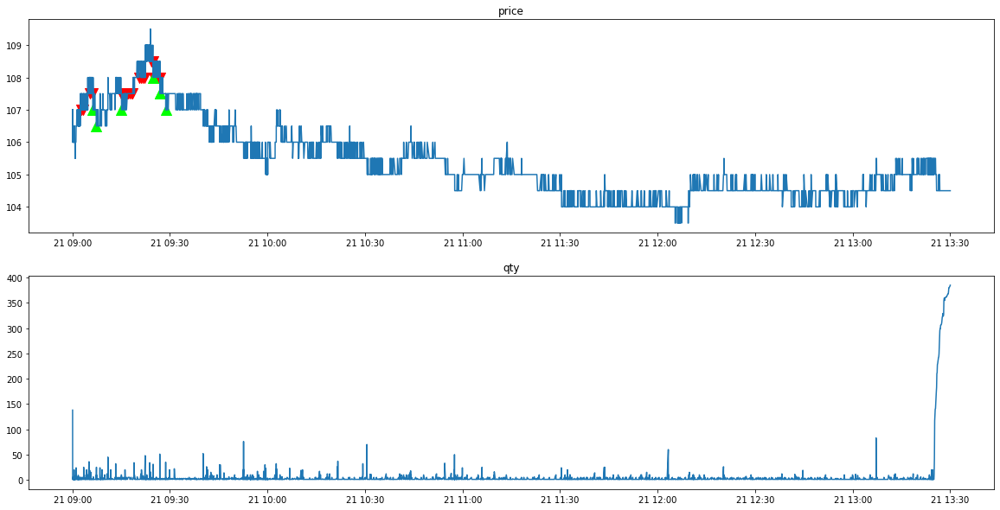

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6278/tse_lob_6278.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6278/tse_tick_6278.csv' mode='r' encoding='UTF-8'>
90006331
clear_position:  0.0
position:  []
tick_row_price 101.5
----------Result Report--------------
profit:  0.0


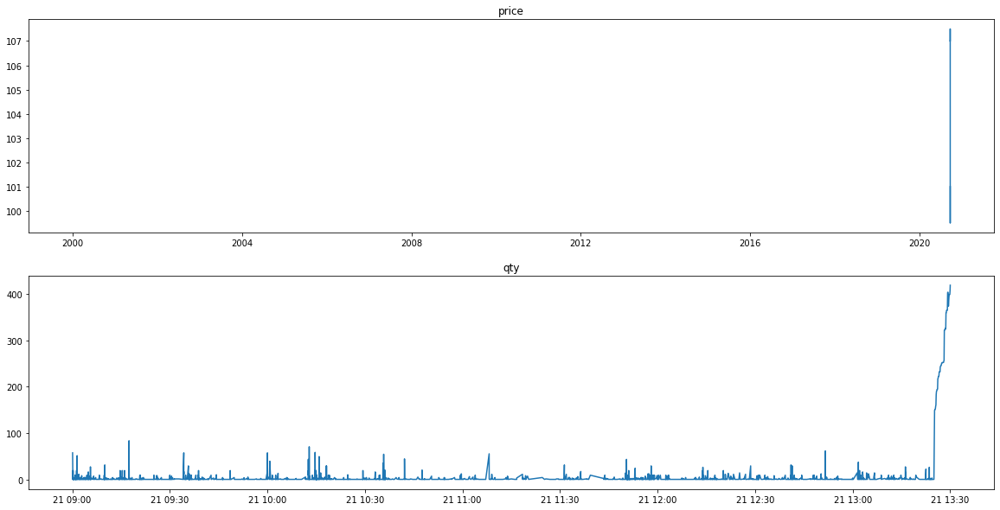

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021774
*** bid1_p:  390.5
*** weighted_p:  389.461038961039
ask1_p:  391.0
進場時間： 90306746 
  sell price at  390.5
stop profit
出場時間： 90326824
POSITION(pre):  [390.5]
Order_p(pre):  [390.]
tick_row price:  390.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  390.5
*** weighted_p:  389.5421686746988
ask1_p:  391.0
進場時間： 90339635 
  sell price at  390.5
stop profit
出場時間： 90342199
POSITION(pre):  [390.5]
Order_p(pre):  [390.]
tick_row price:  390.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  390.5
*** weighted_p:  389.67021276595744
ask1_p:  391.0
進場時間： 90436112 
  sell price at  390.5
*** bid1_p:  390.5
*** weighted_p:  389.725
ask1_p:  391.0
進場時間： 90519732 
  sel

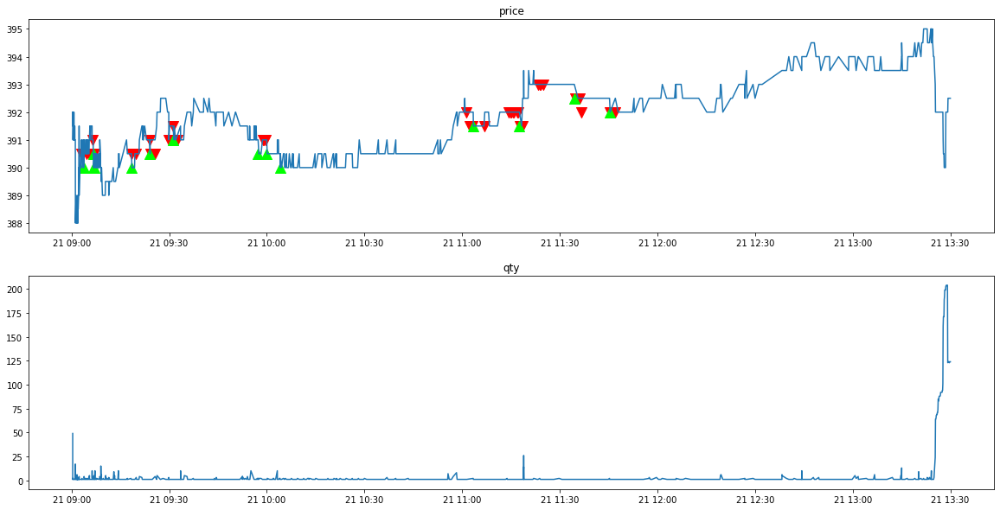

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021652
*** bid1_p:  396.5
*** weighted_p:  394.5143229166667
ask1_p:  397.0
進場時間： 95737078 
  sell price at  396.5
*** bid1_p:  396.0
*** weighted_p:  394.5194805194805
ask1_p:  396.5
進場時間： 95802920 
  sell price at  396.0
*** bid1_p:  396.0
*** weighted_p:  394.53856041131104
ask1_p:  397.0
進場時間： 95834505 
  sell price at  396.0
*** bid1_p:  396.0
*** weighted_p:  394.53856041131104
ask1_p:  396.5
進場時間： 95900869 
  sell price at  396.0
*** bid1_p:  396.0
*** weighted_p:  394.5423076923077
ask1_p:  396.5
進場時間： 95931349 
  sell price at  396.0
*** bid1_p:  396.0
*** weighted_p:  394.54974489795916
ask1_p:  396.5
進場時間： 100001039 
  sell price at  396.0
*** bid1_p:  395.5
*** weighted_p:  394.5607594936709
ask1_p:  396.0
進場時

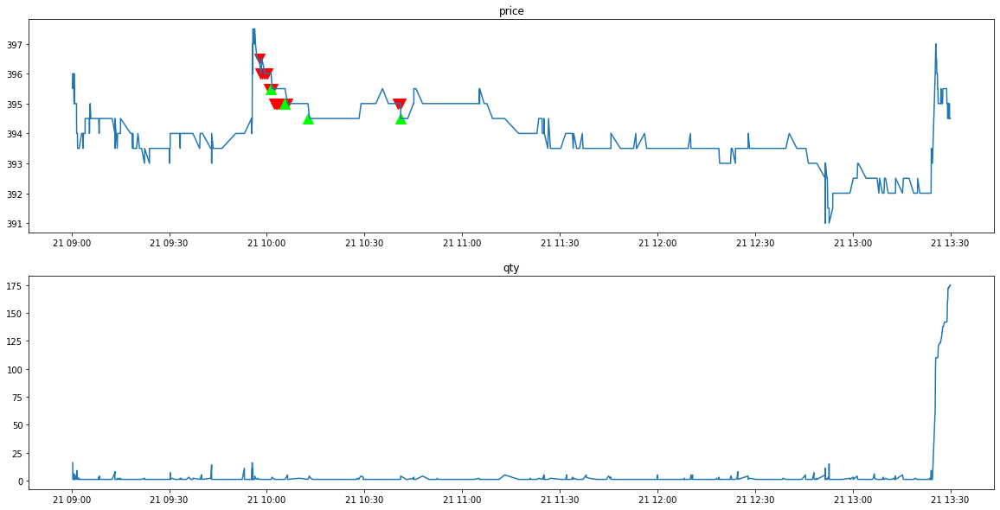

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021610
*** bid1_p:  393.5
*** weighted_p:  391.82505175983437
ask1_p:  394.0
進場時間： 103544443 
  sell price at  393.5
*** bid1_p:  393.5
*** weighted_p:  391.82505175983437
ask1_p:  394.0
進場時間： 103601299 
  sell price at  393.5
*** bid1_p:  393.5
*** weighted_p:  391.82851239669424
ask1_p:  394.0
進場時間： 103631453 
  sell price at  393.5
*** bid1_p:  393.0
*** weighted_p:  391.85234215885947
ask1_p:  393.5
進場時間： 103700727 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  391.85234215885947
ask1_p:  393.5
進場時間： 103847546 
  sell price at  393.0
stop profit
出場時間： 103847546
POSITION(pre):  [393.5 393.5 393.5 393.  393. ]
Order_p(pre):  [393.  393.  393.  392.5 392.5]
tick_row price:  393.0
qualified index:  [[0]
 [1]


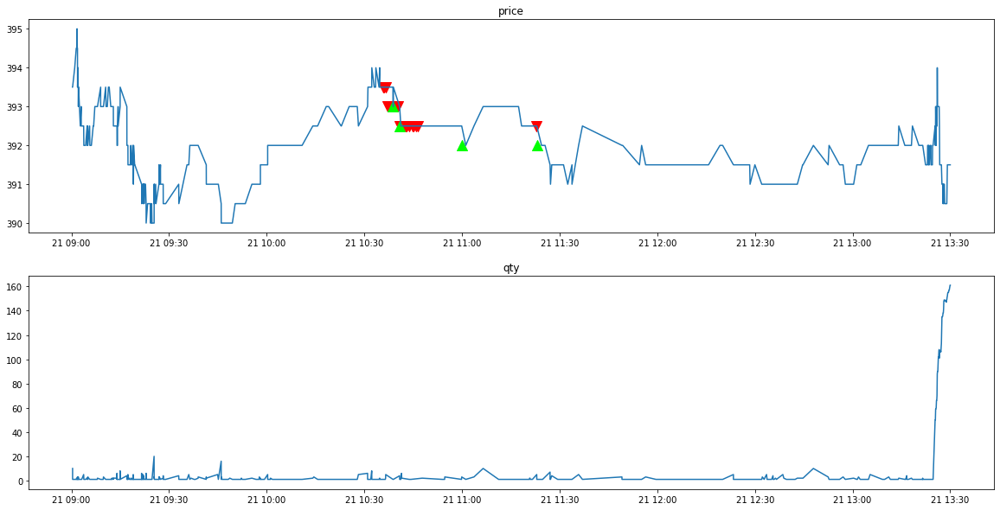

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021737
*** bid1_p:  393.0
*** weighted_p:  392.345
ask1_p:  394.0
進場時間： 104023246 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  392.345
ask1_p:  394.0
進場時間： 104105480 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  392.3471760797342
ask1_p:  394.0
進場時間： 104142415 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  392.35478547854785
ask1_p:  393.5
進場時間： 104200952 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  392.35478547854785
ask1_p:  393.5
進場時間： 104252356 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  392.35478547854785
ask1_p:  393.5
進場時間： 104302463 
  sell price at  393.0
*** bid1_p:  393.0
*** weighted_p:  392.3606557377049
ask1_p:  393.5
進場時間： 104511940 
 

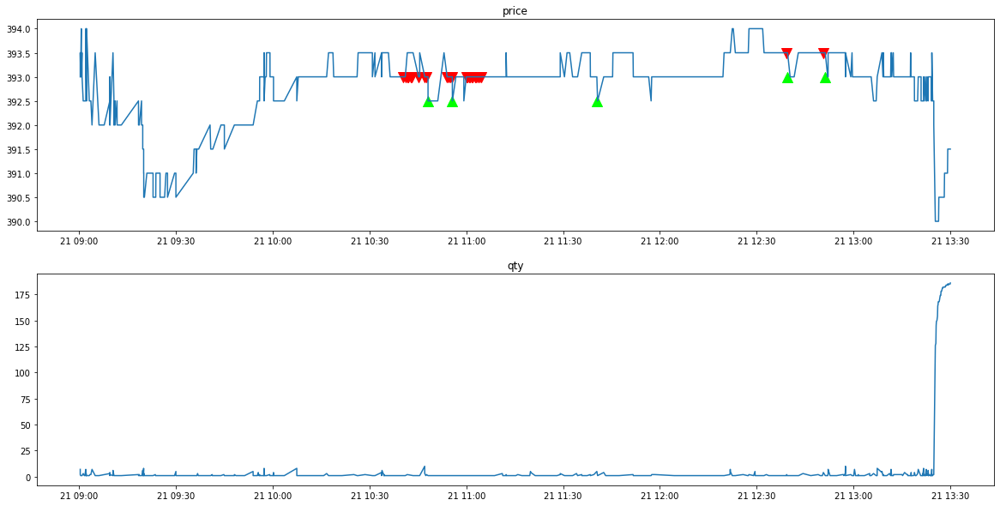

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021635
*** bid1_p:  396.5
*** weighted_p:  395.61898395721926
ask1_p:  397.0
進場時間： 92224252 
  sell price at  396.5
*** bid1_p:  396.5
*** weighted_p:  395.6691919191919
ask1_p:  397.0
進場時間： 92847158 
  sell price at  396.5
*** bid1_p:  396.5
*** weighted_p:  395.6836228287841
ask1_p:  397.0
進場時間： 93132671 
  sell price at  396.5
stop profit
出場時間： 93623938
POSITION(pre):  [396.5 396.5 396.5]
Order_p(pre):  [396. 396. 396.]
tick_row price:  396.0
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  397.0
*** weighted_p:  396.22003835091084
ask1_p:  397.5
進場時間： 125908985 
  sell price at  397.0
clear_position:  0.0
position:  [397.]
tick_row_price 397.0
----------Result Report--------------

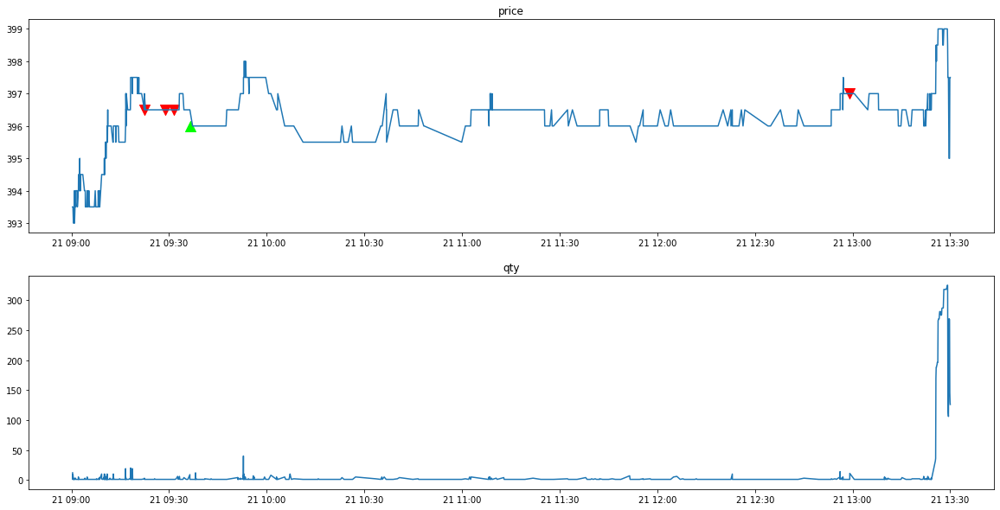

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021688
*** bid1_p:  402.5
*** weighted_p:  401.5851979345955
ask1_p:  403.0
進場時間： 90844339 
  sell price at  402.5
*** bid1_p:  403.0
*** weighted_p:  401.72476340694004
ask1_p:  403.5
進場時間： 90923540 
  sell price at  403.0
*** bid1_p:  403.5
*** weighted_p:  401.9087018544936
ask1_p:  404.0
進場時間： 91041956 
  sell price at  403.5
stop profit
出場時間： 91041956
POSITION(pre):  [402.5 403.  403.5]
Order_p(pre):  [402.  402.5 403. ]
tick_row price:  403.0
qualified index:  [[2]]
POSITION(post):  [402.5 403. ]
Order_p(post):  [402.  402.5]

*** bid1_p:  403.5
*** weighted_p:  401.9843110504775
ask1_p:  404.0
進場時間： 91123310 
  sell price at  403.5
stop profit
出場時間： 91128359
POSITION(pre):  [402.5 403.  403.5]
Order_p(pre):  [402. 

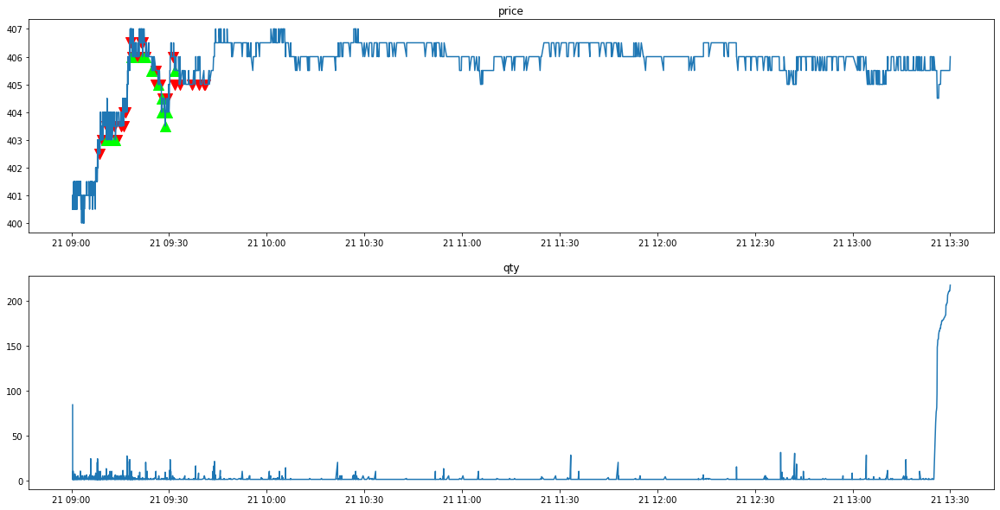

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021881
*** bid1_p:  406.5
*** weighted_p:  404.79285714285714
ask1_p:  407.0
進場時間： 91345969 
  sell price at  406.5
*** bid1_p:  406.5
*** weighted_p:  404.8169014084507
ask1_p:  407.0
進場時間： 91404384 
  sell price at  406.5
*** bid1_p:  406.5
*** weighted_p:  404.84375
ask1_p:  407.0
進場時間： 91434574 
  sell price at  406.5
stop profit
出場時間： 91435346
POSITION(pre):  [406.5 406.5 406.5]
Order_p(pre):  [406. 406. 406.]
tick_row price:  406.0
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  406.0
*** weighted_p:  405.0
ask1_p:  406.5
進場時間： 91500819 
  sell price at  406.0
*** bid1_p:  406.0
*** weighted_p:  405.0060975609756
ask1_p:  406.5
進場時間： 91533840 
  sell price at  406.0
*** bid1_p:

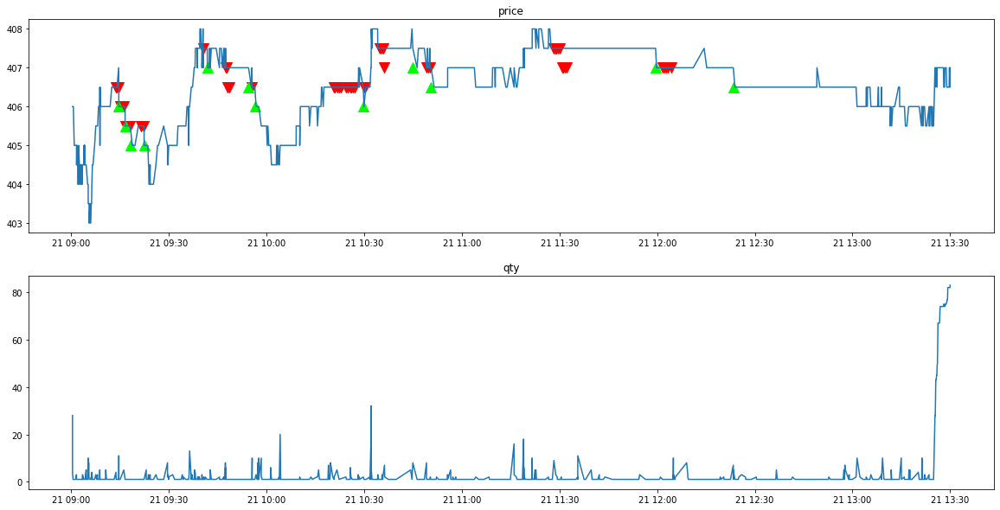

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021776
*** bid1_p:  404.5
*** weighted_p:  404.0188953488372
ask1_p:  405.0
進場時間： 103103235 
  sell price at  404.5
stop profit
出場時間： 103103235
POSITION(pre):  [404.5]
Order_p(pre):  [404.]
tick_row price:  404.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  404.5
*** weighted_p:  403.99550706033375
ask1_p:  405.0
進場時間： 112126523 
  sell price at  404.5
*** bid1_p:  404.5
*** weighted_p:  403.99550706033375
ask1_p:  405.0
進場時間： 112158051 
  sell price at  404.5
*** bid1_p:  404.5
*** weighted_p:  403.99550706033375
ask1_p:  405.0
進場時間： 112213922 
  sell price at  404.5
*** bid1_p:  404.5
*** weighted_p:  403.9967989756722
ask1_p:  405.0
進場時間： 112309831 
  sell price at  404.5
*** bid1_p:  40

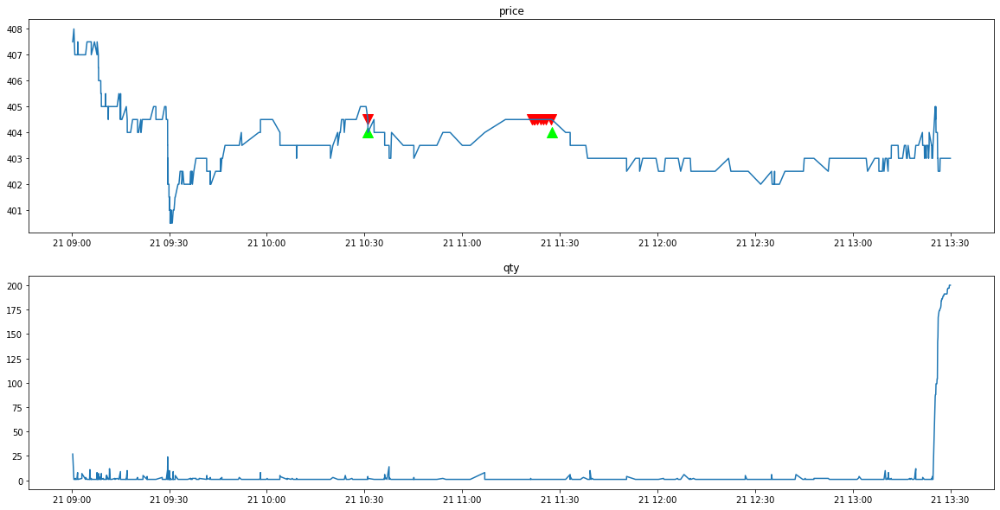

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021834
clear_position:  0.0
position:  []
tick_row_price 397.0
----------Result Report--------------
profit:  0.0


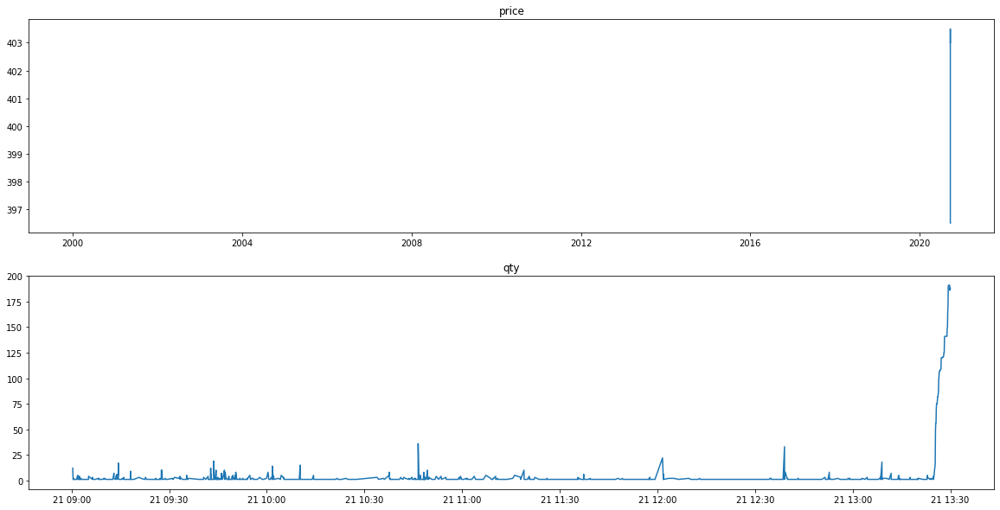

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021809
*** bid1_p:  391.5
*** weighted_p:  390.21298819255225
ask1_p:  392.0
進場時間： 95446568 
  sell price at  391.5
*** bid1_p:  391.5
*** weighted_p:  390.21298819255225
ask1_p:  392.0
進場時間： 95505598 
  sell price at  391.5
*** bid1_p:  391.5
*** weighted_p:  390.2176470588235
ask1_p:  392.0
進場時間： 95540900 
  sell price at  391.5
*** bid1_p:  391.5
*** weighted_p:  390.2176470588235
ask1_p:  392.0
進場時間： 95608617 
  sell price at  391.5
*** bid1_p:  391.5
*** weighted_p:  390.2176470588235
ask1_p:  392.0
進場時間： 95650599 
  sell price at  391.5
*** bid1_p:  391.5
*** weighted_p:  390.2176470588235
ask1_p:  392.0
進場時間： 95713322 
  sell price at  391.5
*** bid1_p:  391.5
*** weighted_p:  390.2176470588235
ask1_p:  392.0
進場時間：

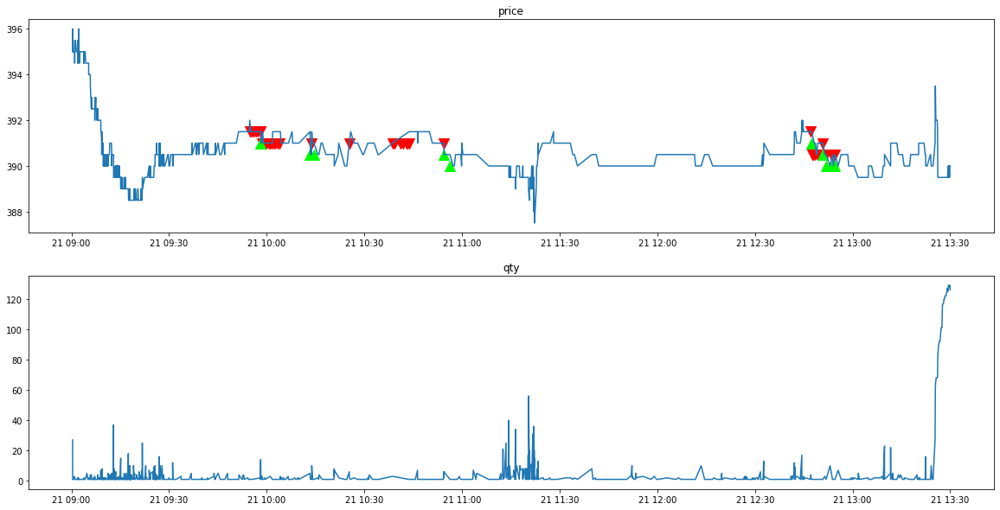

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021828
clear_position:  0.0
position:  []
tick_row_price 383.5
----------Result Report--------------
profit:  0.0


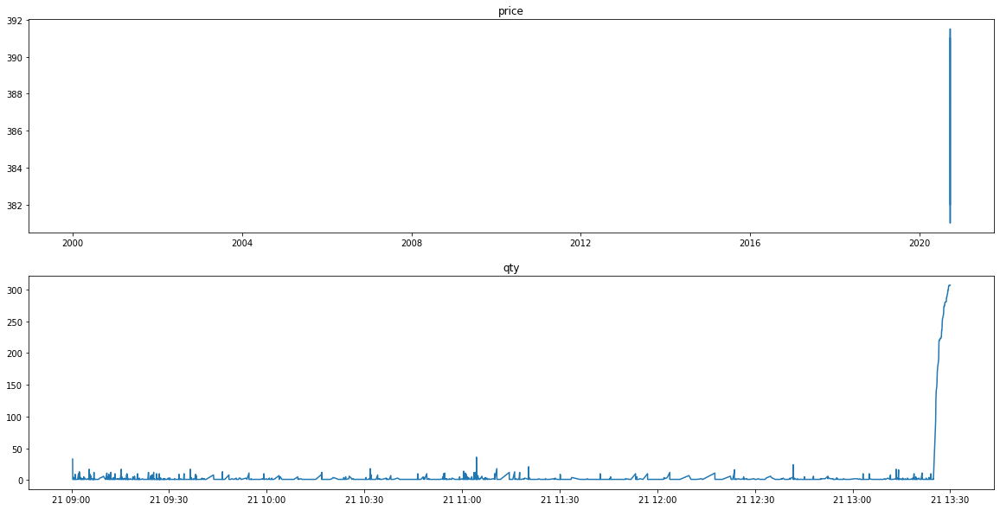

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021831
*** bid1_p:  378.0
*** weighted_p:  377.45348837209303
ask1_p:  378.5
進場時間： 90630277 
  sell price at  378.0
stop profit
出場時間： 90656638
POSITION(pre):  [378.]
Order_p(pre):  [377.5]
tick_row price:  377.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  378.5
*** weighted_p:  377.4203036053131
ask1_p:  379.0
進場時間： 92233765 
  sell price at  378.5
*** bid1_p:  378.5
*** weighted_p:  377.4223484848485
ask1_p:  379.0
進場時間： 92300876 
  sell price at  378.5
*** bid1_p:  378.5
*** weighted_p:  377.5221238938053
ask1_p:  379.0
進場時間： 92451903 
  sell price at  378.5
*** bid1_p:  378.5
*** weighted_p:  377.5221238938053
ask1_p:  379.0
進場時間： 92500894 
  sell price at  378.5
*** bid1_p:  378.0
*** 

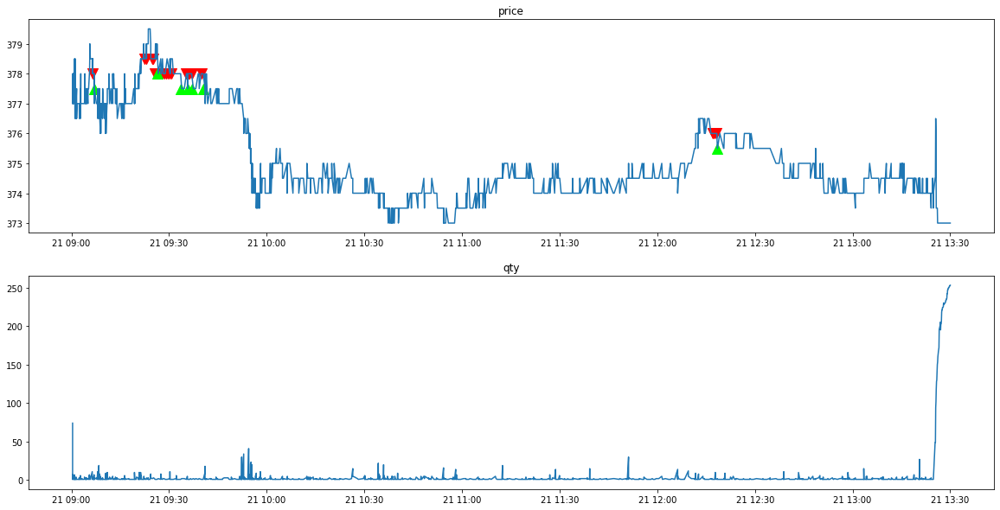

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6488/otc_lob_6488.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6488/otc_tick_6488.csv' mode='r' encoding='UTF-8'>
90021899
clear_position:  0.0
position:  []
tick_row_price 365.5
----------Result Report--------------
profit:  0.0


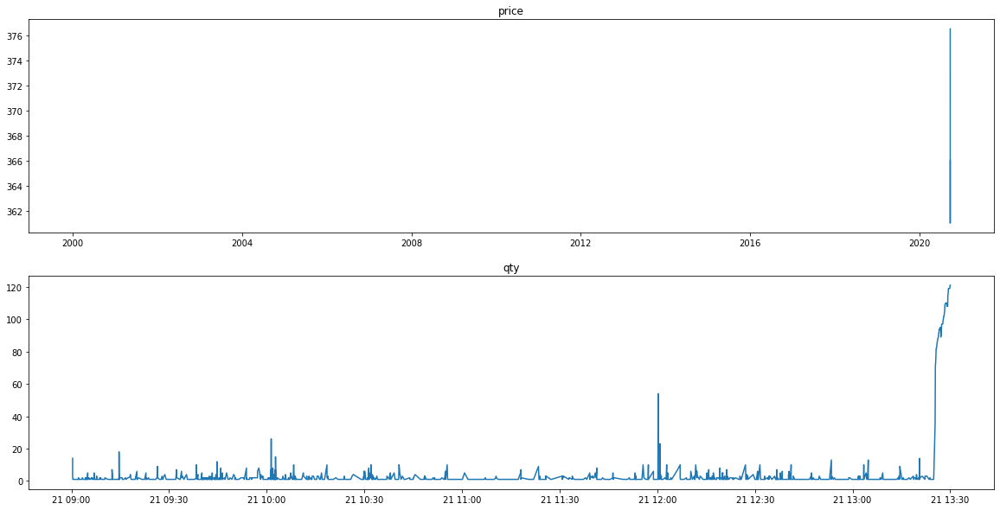

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90001083
*** bid1_p:  71.1
*** weighted_p:  71.00909090909093
ask1_p:  71.2
進場時間： 90207166 
  sell price at  71.1
stop profit
出場時間： 90208317
POSITION(pre):  [71.1]
Order_p(pre):  [71.]
tick_row price:  71.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  71.3
*** weighted_p:  71.0587201125176
ask1_p:  71.5
進場時間： 90249210 
  sell price at  71.3
stop profit
出場時間： 90249809
POSITION(pre):  [71.3]
Order_p(pre):  [71.2]
tick_row price:  71.2
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  71.4
*** weighted_p:  71.07080787508485
ask1_p:  71.5
進場時間： 90300024 
  sell price at  71.4
stop profit
出場時間： 90322506
POSITION(pre):  [71.4]
Order_p(pre):  [71.3]
tick_row price:  71.3
q

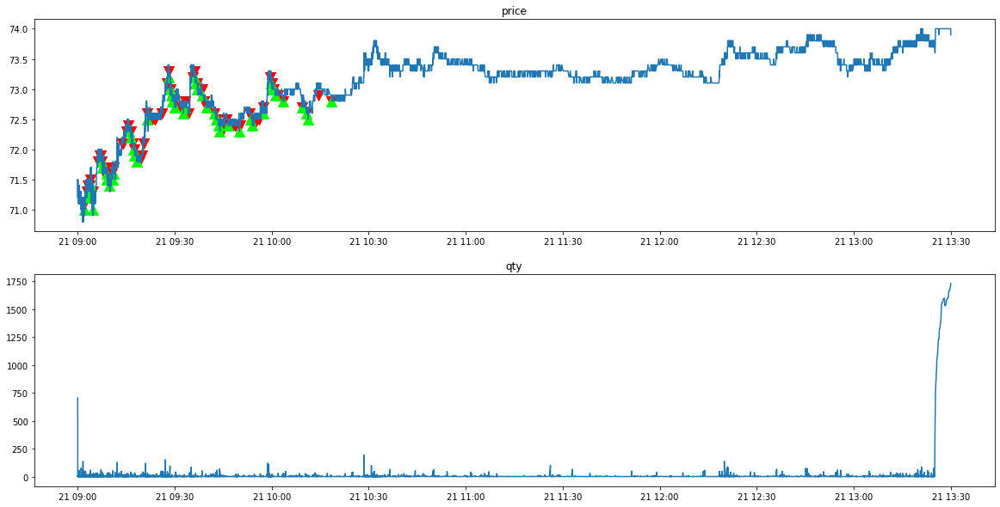

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90001850
------Weird price!!!!!---------
At time:  90150849
tick_row_price 74.6
ask_1_p 74.7
bid_1_p 74.5
------Weird price!!!!!---------
At time:  90155448
tick_row_price 74.6
ask_1_p 74.7
bid_1_p 74.5
clear_position:  0.0
position:  []
tick_row_price 72.4
----------Result Report--------------
profit:  0.0


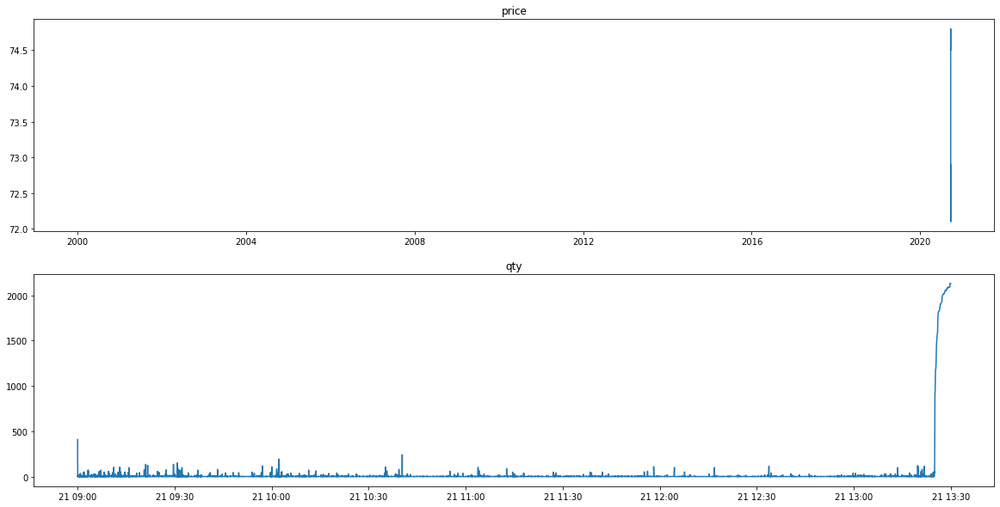

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90001131
*** bid1_p:  72.5
*** weighted_p:  72.11791204862382
ask1_p:  72.6
進場時間： 91347090 
  sell price at  72.5
stop profit
出場時間： 91359979
POSITION(pre):  [72.5]
Order_p(pre):  [72.4]
tick_row price:  72.4
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  72.4
*** weighted_p:  72.1338477366258
ask1_p:  72.6
進場時間： 91400227 
  sell price at  72.4
stop profit
出場時間： 91401788
POSITION(pre):  [72.4]
Order_p(pre):  [72.3]
tick_row price:  72.3
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  72.3
*** weighted_p:  72.1445573770494
ask1_p:  72.4
進場時間： 91437973 
  sell price at  72.3
*** bid1_p:  72.3
*** weighted_p:  72.14656735751312
ask1_p:  72.4
進場時間： 91500089 
  sell price

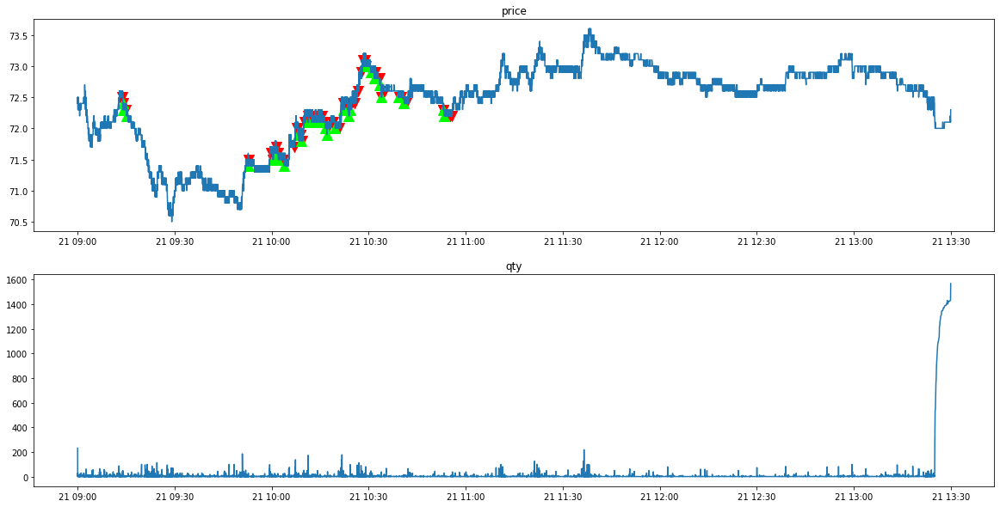

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90001295
*** bid1_p:  73.1
*** weighted_p:  73.0219718309859
ask1_p:  73.2
進場時間： 90218625 
  sell price at  73.1
stop profit
出場時間： 90218843
POSITION(pre):  [73.1]
Order_p(pre):  [73.]
tick_row price:  73.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  73.2
*** weighted_p:  73.07561761546718
ask1_p:  73.3
進場時間： 90418940 
  sell price at  73.2
stop profit
出場時間： 90420192
POSITION(pre):  [73.2]
Order_p(pre):  [73.1]
tick_row price:  73.1
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  73.7
*** weighted_p:  73.2421465968587
ask1_p:  73.8
進場時間： 90539936 
  sell price at  73.7
stop profit
出場時間： 90540022
POSITION(pre):  [73.7]
Order_p(pre):  [73.6]
tick_row price:  73.6
qu

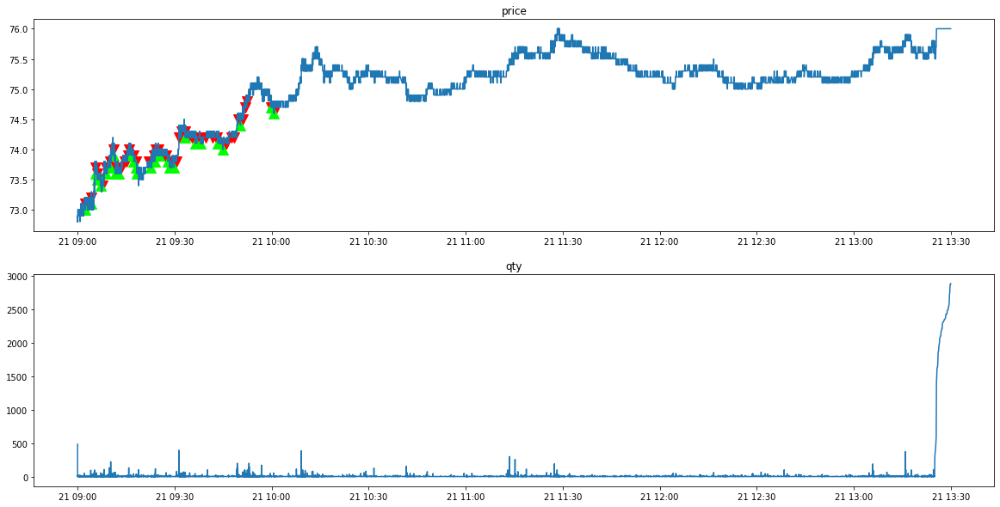

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000655
*** bid1_p:  76.0
*** weighted_p:  75.91513578274754
ask1_p:  76.1
進場時間： 90357353 
  sell price at  76.0
*** bid1_p:  76.0
*** weighted_p:  75.91846864178524
ask1_p:  76.1
進場時間： 90404709 
  sell price at  76.0
stop profit
出場時間： 90404709
POSITION(pre):  [76. 76.]
Order_p(pre):  [75.9 75.9]
tick_row price:  75.9
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

------Weird price!!!!!---------
At time:  90404900
tick_row_price 76.0
ask_1_p 76.1
bid_1_p 75.9
*** bid1_p:  75.9
*** weighted_p:  75.59109961533346
ask1_p:  76.0
進場時間： 91113988 
  sell price at  75.9
stop profit
出場時間： 91115182
POSITION(pre):  [75.9]
Order_p(pre):  [75.8]
tick_row price:  75.8
qualified index:  [[0]]
POSITION(post):  []
Ord

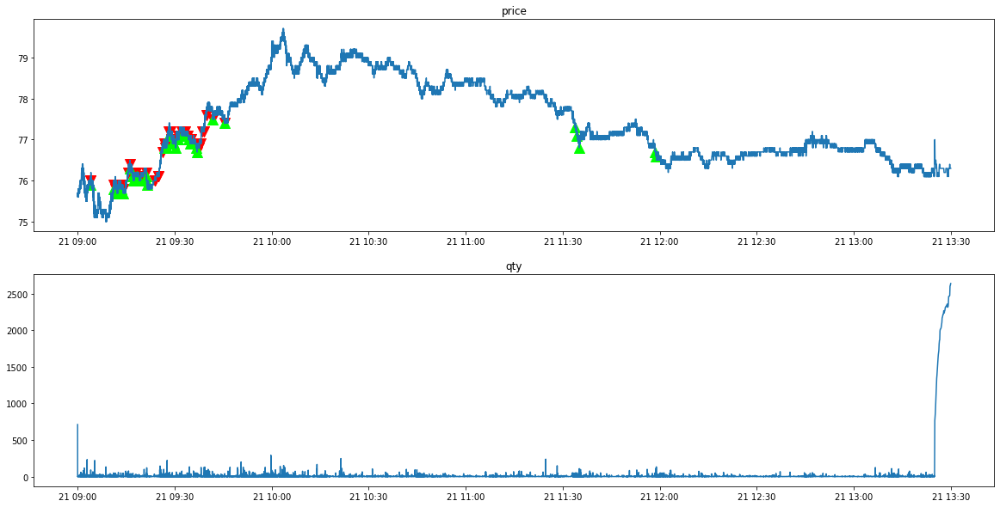

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000108
*** bid1_p:  77.5
*** weighted_p:  77.2837689577285
ask1_p:  77.6
進場時間： 90728487 
  sell price at  77.5
------Weird price!!!!!---------
At time:  90757647
tick_row_price 77.7
ask_1_p 77.8
bid_1_p 77.6
*** bid1_p:  77.7
*** weighted_p:  77.31818181818215
ask1_p:  77.8
進場時間： 90810462 
  sell price at  77.7
stop profit
出場時間： 90818787
POSITION(pre):  [77.5 77.7]
Order_p(pre):  [77.4 77.6]
tick_row price:  77.6
qualified index:  [[1]]
POSITION(post):  [77.5]
Order_p(post):  [77.4]

*** bid1_p:  77.7
*** weighted_p:  77.33924297244684
ask1_p:  77.8
進場時間： 90847060 
  sell price at  77.7
*** bid1_p:  77.7
*** weighted_p:  77.3464480874321
ask1_p:  77.8
進場時間： 90902257 
  sell price at  77.7
stop profit
出場時間： 90904048
POSITI

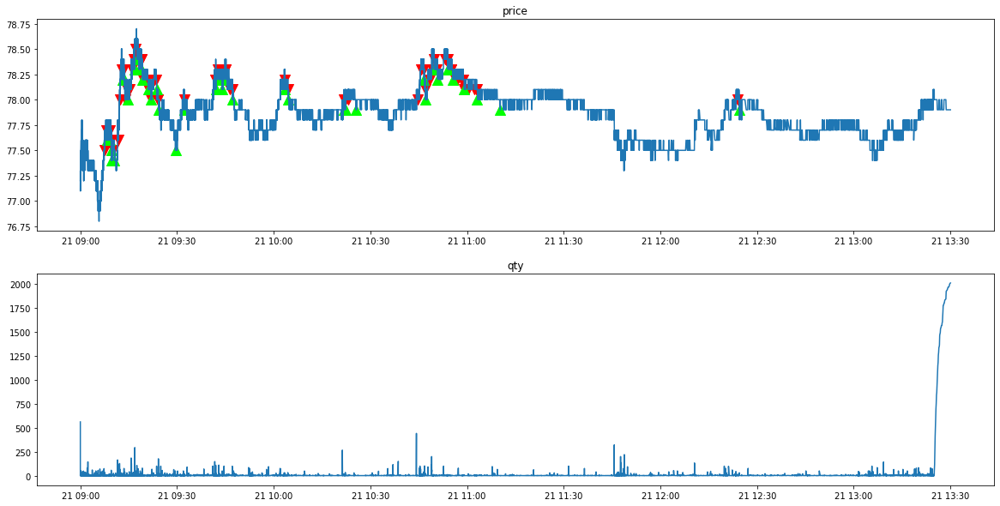

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000540
*** bid1_p:  78.5
*** weighted_p:  78.37496554892041
ask1_p:  78.6
進場時間： 90505719 
  sell price at  78.5
stop profit
出場時間： 90509999
POSITION(pre):  [78.5]
Order_p(pre):  [78.4]
tick_row price:  78.4
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  78.7
*** weighted_p:  78.41555810397557
ask1_p:  78.8
進場時間： 90535877 
  sell price at  78.7
*** bid1_p:  79.1
*** weighted_p:  78.5590287468599
ask1_p:  79.2
進場時間： 90632012 
  sell price at  79.1
stop profit
出場時間： 90632679
POSITION(pre):  [78.7 79.1]
Order_p(pre):  [78.6 79. ]
tick_row price:  79.0
qualified index:  [[1]]
POSITION(post):  [78.7]
Order_p(post):  [78.6]

*** bid1_p:  78.9
*** weighted_p:  78.62165046241378
ask1_p:  79.0
進場時間： 907

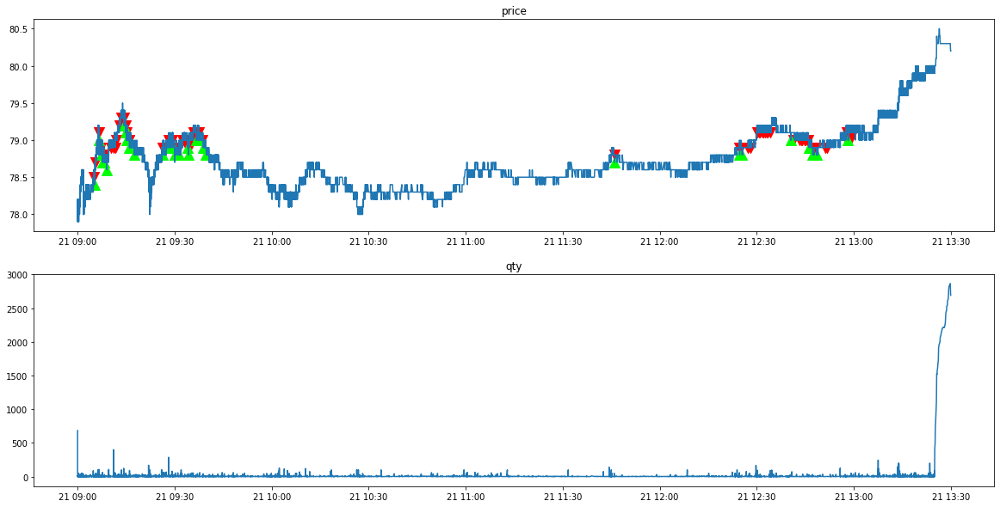

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000651
*** bid1_p:  79.8
*** weighted_p:  79.65501147666416
ask1_p:  79.9
進場時間： 90306209 
  sell price at  79.8
stop profit
出場時間： 90316574
POSITION(pre):  [79.8]
Order_p(pre):  [79.7]
tick_row price:  79.7
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  79.1
*** weighted_p:  78.9309653233365
ask1_p:  79.2
進場時間： 95205092 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.93152878146032
ask1_p:  79.2
進場時間： 95235188 
  sell price at  79.1
stop profit
出場時間： 95256263
POSITION(pre):  [79.1 79.1]
Order_p(pre):  [79. 79.]
tick_row price:  79.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  79.1
*** weighted_p:  78.93744435086037
ask1_p:  79.2
進場時間： 95556375

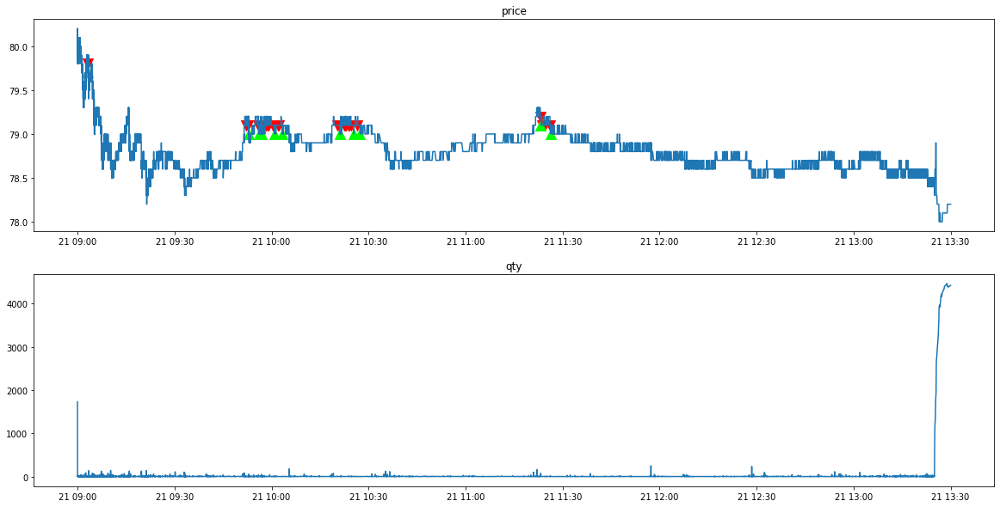

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000651
*** bid1_p:  77.9
*** weighted_p:  77.78403755868536
ask1_p:  78.0
進場時間： 90204192 
  sell price at  77.9
stop profit
出場時間： 90209143
POSITION(pre):  [77.9]
Order_p(pre):  [77.8]
tick_row price:  77.8
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  77.9
*** weighted_p:  77.64992826398829
ask1_p:  78.0
進場時間： 90550496 
  sell price at  77.9
*** bid1_p:  78.0
*** weighted_p:  77.67754293262858
ask1_p:  78.1
進場時間： 90603455 
  sell price at  78.0
stop profit
出場時間： 90621651
POSITION(pre):  [77.9 78. ]
Order_p(pre):  [77.8 77.9]
tick_row price:  77.9
qualified index:  [[1]]
POSITION(post):  [77.9]
Order_p(post):  [77.8]

stop profit
出場時間： 90627207
POSITION(pre):  [77.9]
Order_p(pre):  [77.8]
tic

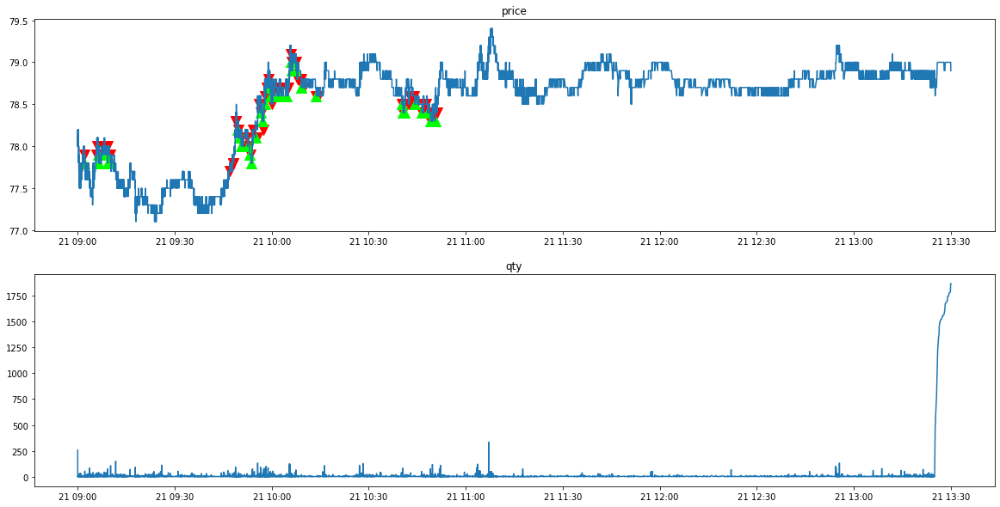

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000808
*** bid1_p:  78.9
*** weighted_p:  78.7163080407701
ask1_p:  79.0
進場時間： 90320916 
  sell price at  78.9
*** bid1_p:  79.1
*** weighted_p:  78.80595432300177
ask1_p:  79.2
進場時間： 90357743 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.80998389694057
ask1_p:  79.2
進場時間： 90400108 
  sell price at  79.1
*** bid1_p:  79.3
*** weighted_p:  78.89924433249381
ask1_p:  79.4
進場時間： 90439733 
  sell price at  79.3
stop profit
出場時間： 90440626
POSITION(pre):  [78.9 79.1 79.1 79.3]
Order_p(pre):  [78.8 79.  79.  79.2]
tick_row price:  79.2
qualified index:  [[3]]
POSITION(post):  [78.9 79.1 79.1]
Order_p(post):  [78.8 79.  79. ]

*** bid1_p:  79.2
*** weighted_p:  78.98223590715294
ask1_p:  79.3
進場時間： 90503052 
  sell

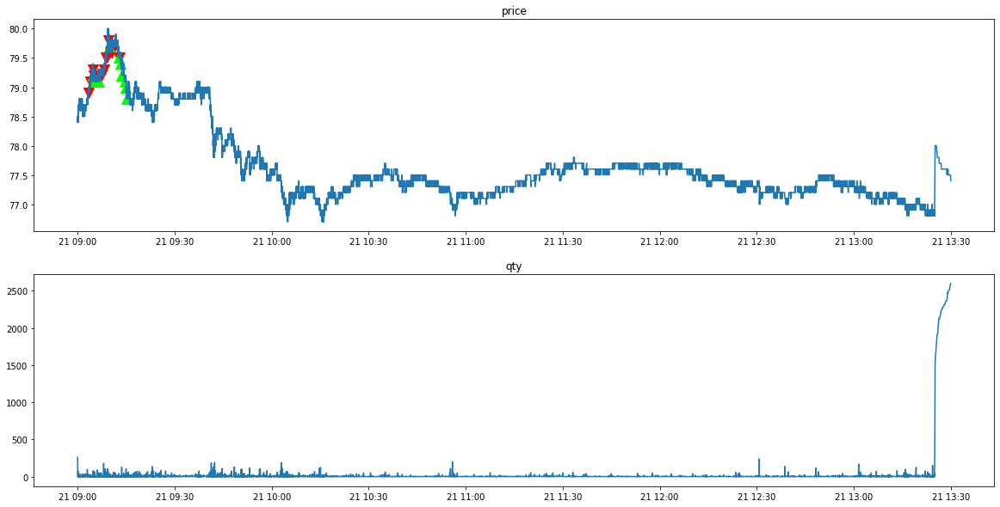

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90000973
*** bid1_p:  78.0
*** weighted_p:  77.77235243798107
ask1_p:  78.1
進場時間： 93204709 
  sell price at  78.0
stop profit
出場時間： 93206151
POSITION(pre):  [78.]
Order_p(pre):  [77.9]
tick_row price:  77.9
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  77.9
*** weighted_p:  77.77752921535887
ask1_p:  78.0
進場時間： 93245622 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.77812499999996
ask1_p:  78.0
進場時間： 93300006 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.78136838667541
ask1_p:  78.0
進場時間： 93354271 
  sell price at  77.9
*** bid1_p:  78.3
*** weighted_p:  77.8262921022068
ask1_p:  78.4
進場時間： 93457121 
  sell price at  78.3
stop profit
出場時間： 93500022
POSITION(pre):  

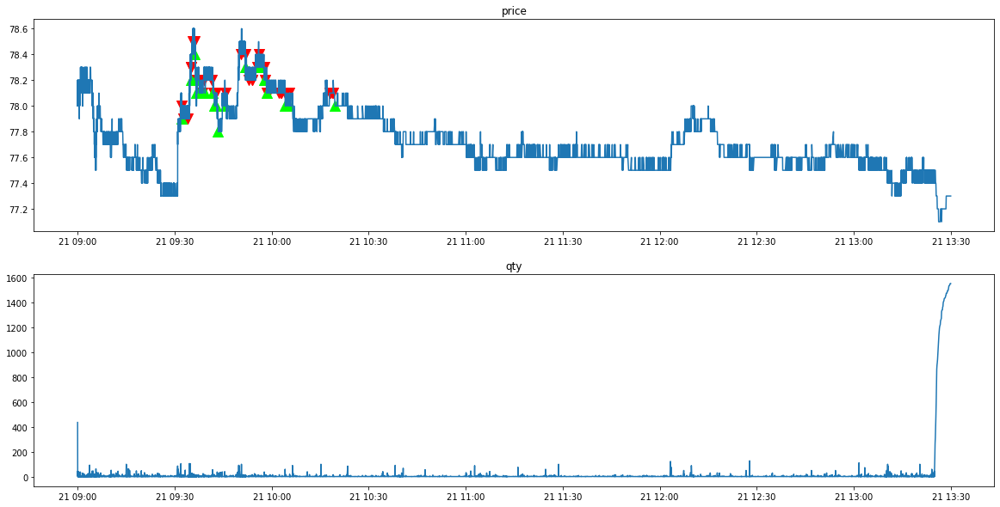

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90001668
*** bid1_p:  75.5
*** weighted_p:  75.39148029818962
ask1_p:  75.6
進場時間： 90223729 
  sell price at  75.5
stop profit
出場時間： 90225062
POSITION(pre):  [75.5]
Order_p(pre):  [75.4]
tick_row price:  75.4
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  75.5
*** weighted_p:  75.38553030303031
ask1_p:  75.6
進場時間： 90303000 
  sell price at  75.5
*** bid1_p:  75.6
*** weighted_p:  75.40139178844822
ask1_p:  75.7
進場時間： 90340729 
  sell price at  75.6
*** bid1_p:  75.7
*** weighted_p:  75.44638118214726
ask1_p:  75.8
進場時間： 90422344 
  sell price at  75.7
*** bid1_p:  75.9
*** weighted_p:  75.48493975903617
ask1_p:  76.0
進場時間： 90457883 
  sell price at  75.9
*** bid1_p:  75.8
*** weighted_p:  75.485

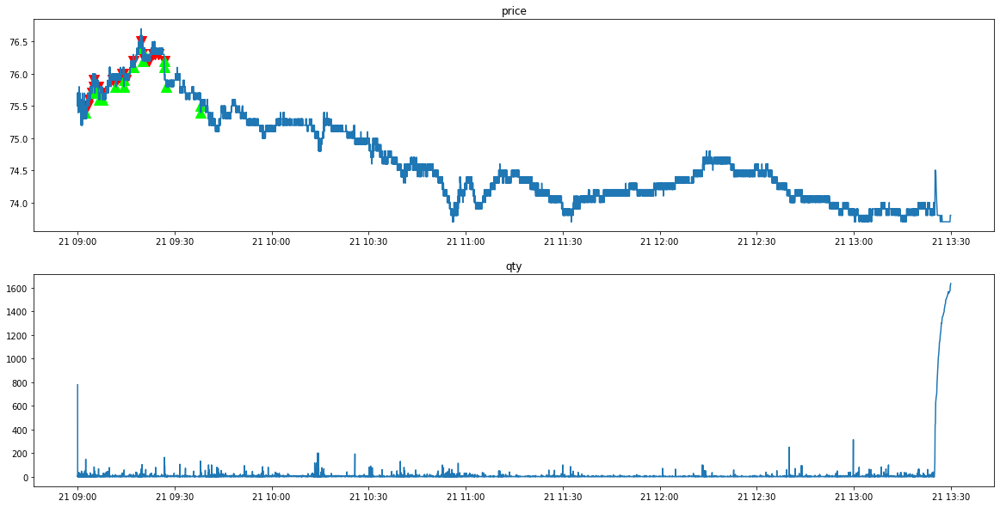

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3037/tse_lob_3037.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3037/tse_tick_3037.csv' mode='r' encoding='UTF-8'>
90001918
*** bid1_p:  75.2
*** weighted_p:  74.83946315438472
ask1_p:  75.3
進場時間： 92724018 
  sell price at  75.2
stop profit
出場時間： 92724189
POSITION(pre):  [75.2]
Order_p(pre):  [75.1]
tick_row price:  75.1
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

------Weird price!!!!!---------
At time:  125127311
tick_row_price 71.2
ask_1_p 71.3
bid_1_p 71.1
clear_position:  0.0
position:  []
tick_row_price 72.0
----------Result Report--------------
profit:  0.10000000000000853


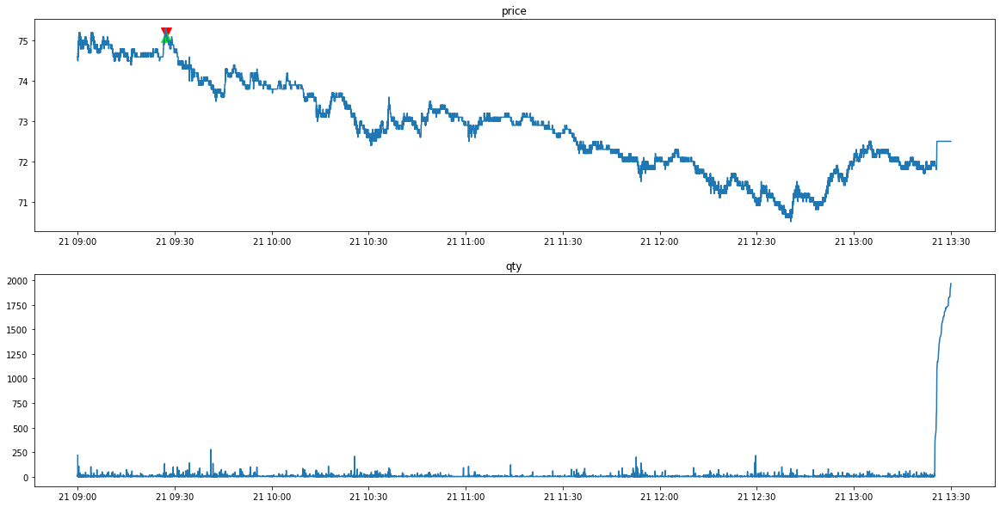

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90001284
*** bid1_p:  424.5
*** weighted_p:  423.66948658109686
ask1_p:  425.0
進場時間： 90259025 
  sell price at  424.5
*** bid1_p:  424.5
*** weighted_p:  423.6710372960373
ask1_p:  425.0
進場時間： 90300032 
  sell price at  424.5
stop profit
出場時間： 90323826
POSITION(pre):  [424.5 424.5]
Order_p(pre):  [424. 424.]
tick_row price:  424.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  424.5
*** weighted_p:  423.77794871794873
ask1_p:  425.0
進場時間： 90331746 
  sell price at  424.5
*** bid1_p:  424.5
*** weighted_p:  423.8235724743777
ask1_p:  425.0
進場時間： 90400704 
  sell price at  424.5
stop profit
出場時間： 90410184
POSITION(pre):  [424.5 424.5]
Order_p(pre):  [424. 424.]
tick_row price:  424.0
qualifi

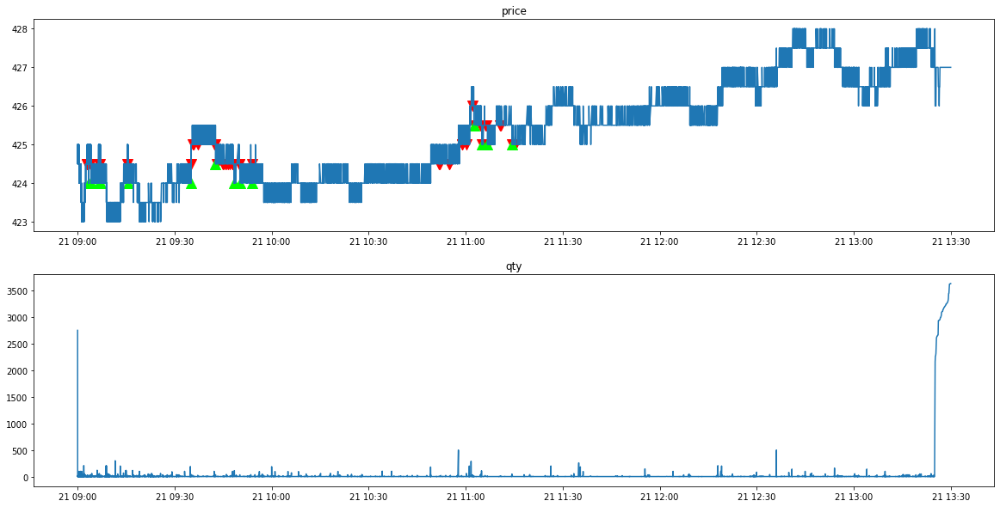

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000688
*** bid1_p:  432.0
*** weighted_p:  431.3312356979405
ask1_p:  432.5
進場時間： 93447630 
  sell price at  432.0
*** bid1_p:  432.0
*** weighted_p:  431.3538642333748
ask1_p:  432.5
進場時間： 93500013 
  sell price at  432.0
*** bid1_p:  432.0
*** weighted_p:  431.36132785763175
ask1_p:  432.5
進場時間： 93531506 
  sell price at  432.0
stop profit
出場時間： 93547439
POSITION(pre):  [432. 432. 432.]
Order_p(pre):  [431.5 431.5 431.5]
tick_row price:  431.5
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  432.5
*** weighted_p:  431.5350597609562
ask1_p:  433.0
進場時間： 95343775 
  sell price at  432.5
*** bid1_p:  432.0
*** weighted_p:  431.53601990049754
ask1_p:  432.5
進場時間： 95400377 
  sell price 

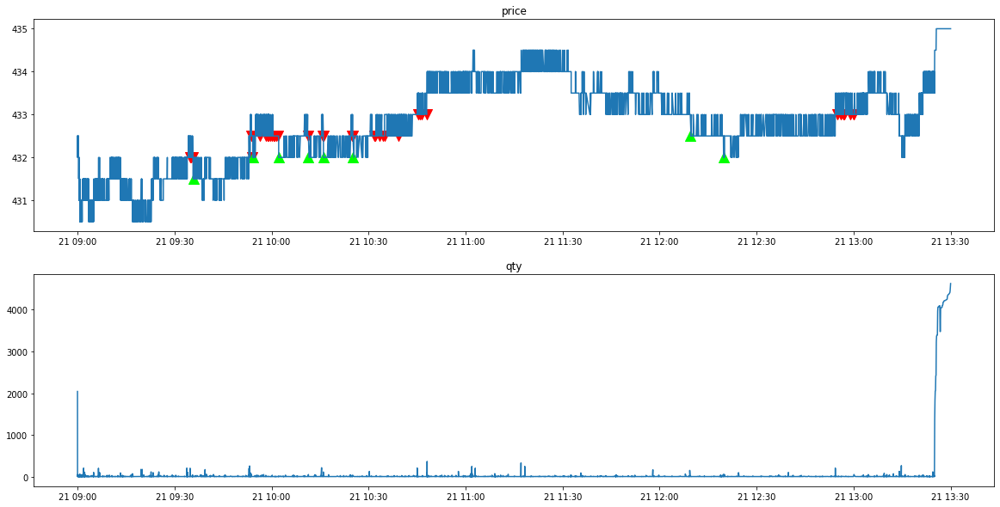

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000931
*** bid1_p:  434.5
*** weighted_p:  433.73954205195946
ask1_p:  435.0
進場時間： 93805415 
  sell price at  434.5
stop profit
出場時間： 93830578
POSITION(pre):  [434.5]
Order_p(pre):  [434.]
tick_row price:  434.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  434.5
*** weighted_p:  433.83572424785814
ask1_p:  435.0
進場時間： 101916034 
  sell price at  434.5
*** bid1_p:  434.5
*** weighted_p:  433.836418831492
ask1_p:  435.0
進場時間： 101947107 
  sell price at  434.5
*** bid1_p:  434.5
*** weighted_p:  433.8374751491054
ask1_p:  435.0
進場時間： 102029656 
  sell price at  434.5
*** bid1_p:  434.5
*** weighted_p:  433.8385127084988
ask1_p:  435.0
進場時間： 102117015 
  sell price at  434.5
*** bid1_p:  434.5


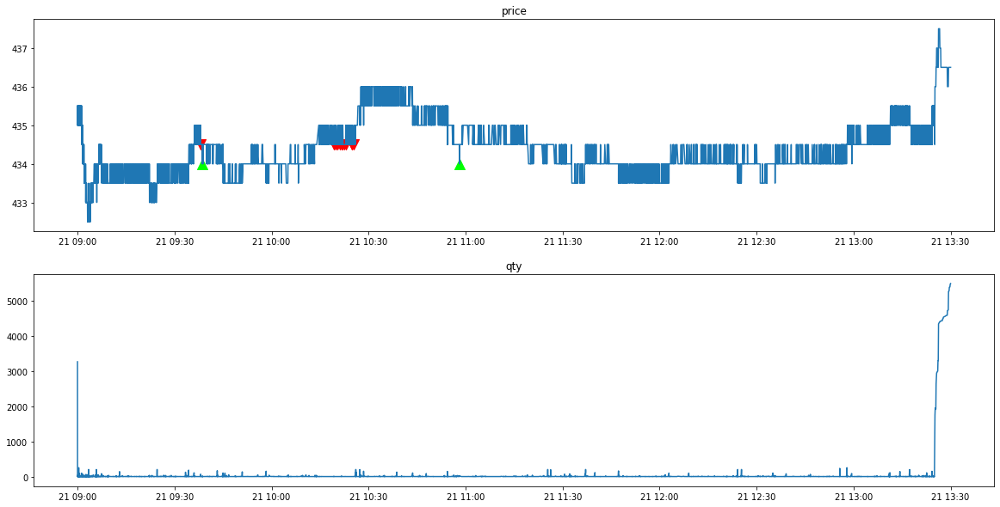

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90001094
*** bid1_p:  437.0
*** weighted_p:  436.3178378378378
ask1_p:  437.5
進場時間： 90841044 
  sell price at  437.0
*** bid1_p:  437.0
*** weighted_p:  436.32288681948427
ask1_p:  437.5
進場時間： 90900096 
  sell price at  437.0
*** bid1_p:  437.5
*** weighted_p:  436.47475849174197
ask1_p:  438.0
進場時間： 90957515 
  sell price at  437.5
*** bid1_p:  437.5
*** weighted_p:  436.4760348583878
ask1_p:  438.0
進場時間： 91000022 
  sell price at  437.5
*** bid1_p:  437.5
*** weighted_p:  436.62594037336305
ask1_p:  438.0
進場時間： 91050551 
  sell price at  437.5
*** bid1_p:  437.5
*** weighted_p:  436.6268095768374
ask1_p:  438.0
進場時間： 91100009 
  sell price at  437.5
stop profit
出場時間： 91100505
POSITION(pre):  [437.  437.  437.5 437.5 437.5

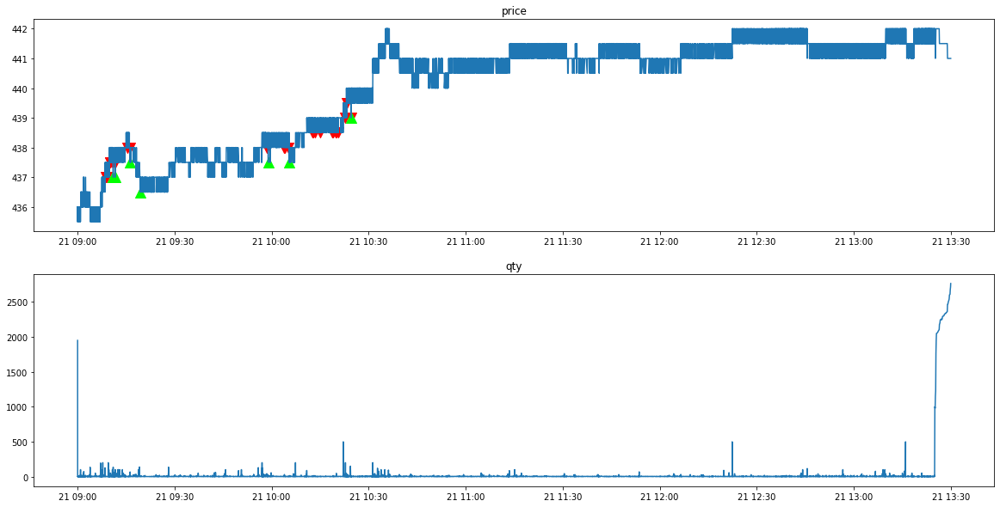

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000628
*** bid1_p:  441.0
*** weighted_p:  440.5477219820419
ask1_p:  441.5
進場時間： 91512653 
  sell price at  441.0
stop profit
出場時間： 91517675
POSITION(pre):  [441.]
Order_p(pre):  [440.5]
tick_row price:  440.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  441.0
*** weighted_p:  440.5561760840999
ask1_p:  441.5
進場時間： 91543211 
  sell price at  441.0
*** bid1_p:  441.5
*** weighted_p:  440.68398207784935
ask1_p:  442.0
進場時間： 91754228 
  sell price at  441.5
*** bid1_p:  441.5
*** weighted_p:  440.68457878533445
ask1_p:  442.0
進場時間： 91800105 
  sell price at  441.5
*** bid1_p:  441.5
*** weighted_p:  440.76639875550944
ask1_p:  442.0
進場時間： 92036150 
  sell price at  441.5
*** bid1_p:  441.5
**

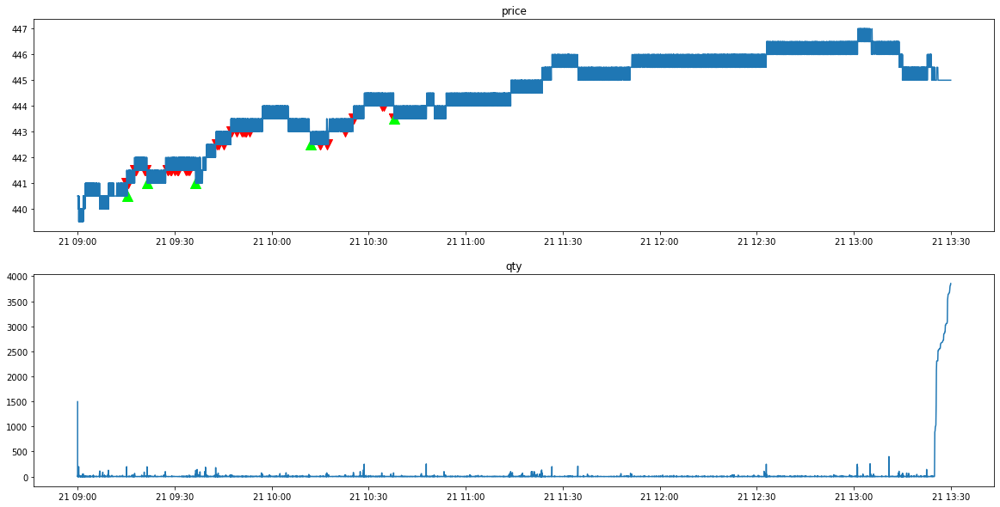

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000711
------Weird price!!!!!---------
At time:  90532706
tick_row_price 458.0
ask_1_p 458.5
bid_1_p 457.5
------Weird price!!!!!---------
At time:  91414151
tick_row_price 456.0
ask_1_p 456.5
bid_1_p 455.5
*** bid1_p:  458.0
*** weighted_p:  457.53388696655134
ask1_p:  458.5
進場時間： 94905011 
  sell price at  458.0
*** bid1_p:  458.0
*** weighted_p:  457.5365411116215
ask1_p:  458.5
進場時間： 94935318 
  sell price at  458.0
*** bid1_p:  458.0
*** weighted_p:  457.5375974323705
ask1_p:  458.5
進場時間： 95001239 
  sell price at  458.0
*** bid1_p:  458.5
*** weighted_p:  457.55347400694353
ask1_p:  459.0
進場時間： 95119518 
  sell price at  458.5
*** bid1_p:  458.5
*** weighted_p:  457.55759127037584
ask1_p:  459.0
進場時間： 95149528 
  se

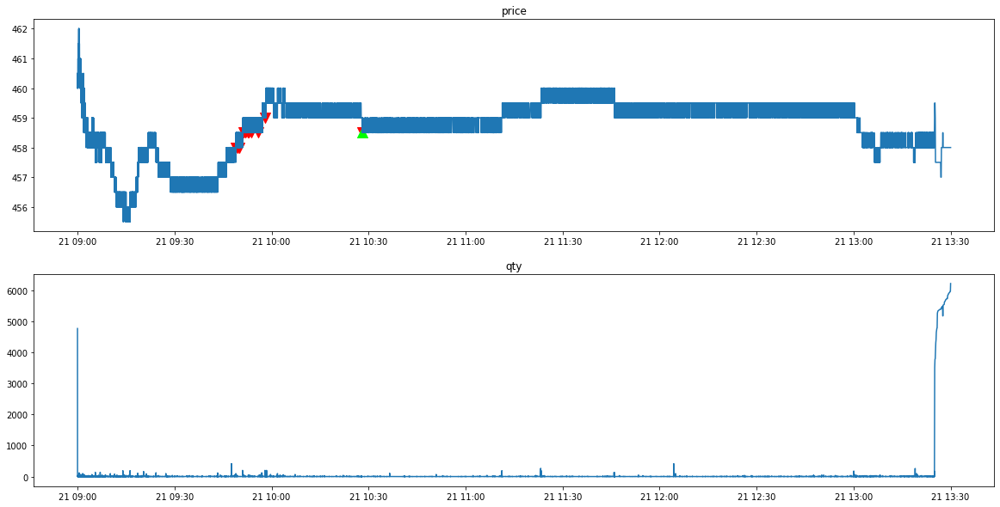

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000202
*** bid1_p:  453.5
*** weighted_p:  452.8699203734212
ask1_p:  454.0
進場時間： 93252134 
  sell price at  453.5
*** bid1_p:  453.5
*** weighted_p:  452.87455710002723
ask1_p:  454.0
進場時間： 93305937 
  sell price at  453.5
stop profit
出場時間： 93313760
POSITION(pre):  [453.5 453.5]
Order_p(pre):  [453. 453.]
tick_row price:  453.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  453.5
*** weighted_p:  452.87872830802604
ask1_p:  454.0
進場時間： 93406137 
  sell price at  453.5
*** bid1_p:  453.5
*** weighted_p:  452.8805949966193
ask1_p:  454.0
進場時間： 93437326 
  sell price at  453.5
*** bid1_p:  453.5
*** weighted_p:  452.88340746731365
ask1_p:  454.0
進場時間： 93517818 
  sell price at  453.5
*** b

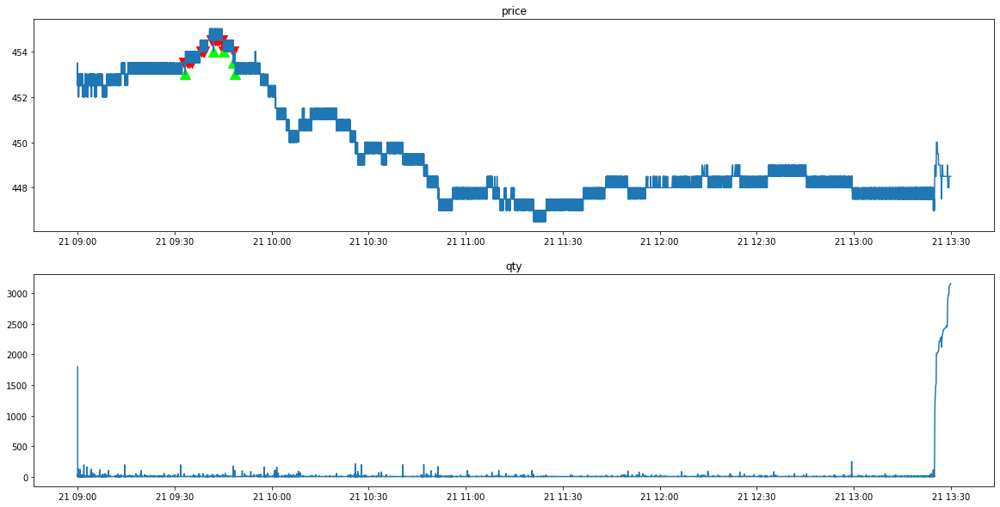

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000454
*** bid1_p:  445.5
*** weighted_p:  444.873619522622
ask1_p:  446.0
進場時間： 95827762 
  sell price at  445.5
*** bid1_p:  446.0
*** weighted_p:  444.8848324514991
ask1_p:  446.5
進場時間： 95938460 
  sell price at  446.0
*** bid1_p:  447.0
*** weighted_p:  444.9645539707992
ask1_p:  447.5
進場時間： 100418218 
  sell price at  447.0
*** bid1_p:  447.5
*** weighted_p:  445.0223825226711
ask1_p:  448.0
進場時間： 100644946 
  sell price at  447.5
*** bid1_p:  447.5
*** weighted_p:  445.0596322811585
ask1_p:  448.0
進場時間： 100918556 
  sell price at  447.5
stop profit
出場時間： 100923232
POSITION(pre):  [445.5 446.  447.  447.5 447.5]
Order_p(pre):  [445.  445.5 446.5 447.  447. ]
tick_row price:  447.0
qualified index:  [[3]
 [4]]
POSITIO

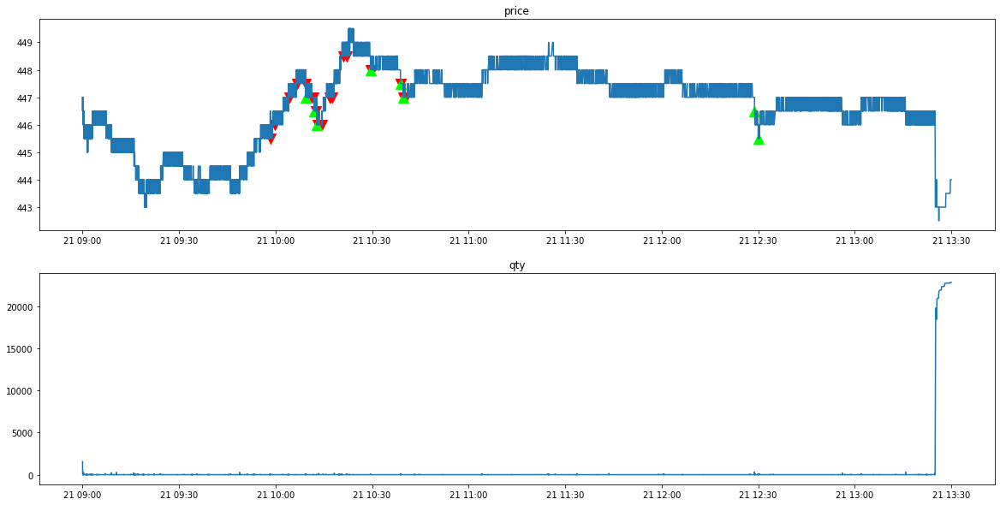

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000651
------Weird price!!!!!---------
At time:  90328093
tick_row_price 443.5
ask_1_p 444.0
bid_1_p 443.0
*** bid1_p:  444.5
*** weighted_p:  443.57779401022646
ask1_p:  445.0
進場時間： 90546819 
  sell price at  444.5
*** bid1_p:  444.5
*** weighted_p:  443.6131541725601
ask1_p:  445.0
進場時間： 90603800 
  sell price at  444.5
*** bid1_p:  445.0
*** weighted_p:  443.87731481481484
ask1_p:  445.5
進場時間： 90748269 
  sell price at  445.0
*** bid1_p:  445.0
*** weighted_p:  443.91750559284117
ask1_p:  445.5
進場時間： 90800359 
  sell price at  445.0
*** bid1_p:  445.0
*** weighted_p:  444.11312984496124
ask1_p:  445.5
進場時間： 90946707 
  sell price at  445.0
*** bid1_p:  446.5
*** weighted_p:  444.59776334776336
ask1_p:  447.0
進場時間： 9131

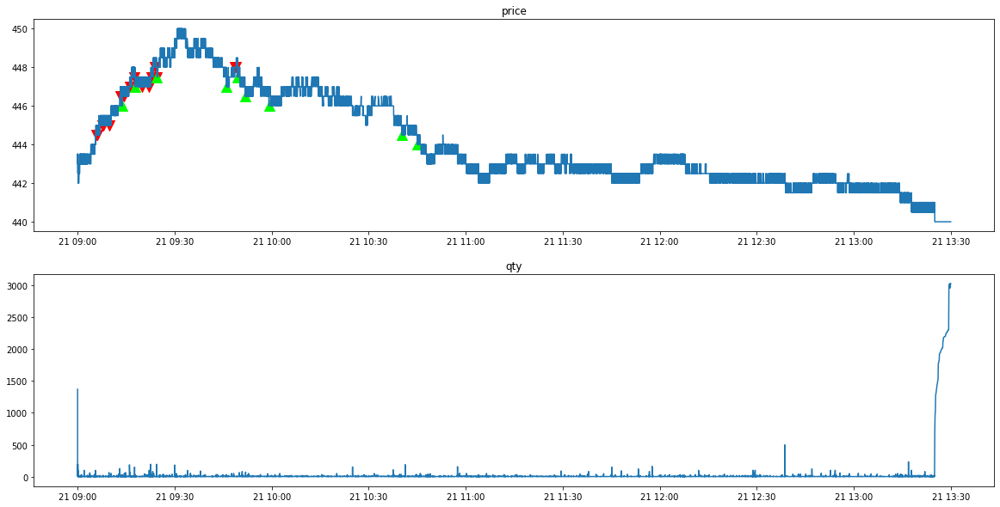

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000607
*** bid1_p:  439.5
*** weighted_p:  438.812060546875
ask1_p:  440.0
進場時間： 93931396 
  sell price at  439.5
*** bid1_p:  439.5
*** weighted_p:  438.8149157822997
ask1_p:  440.0
進場時間： 94007716 
  sell price at  439.5
*** bid1_p:  439.5
*** weighted_p:  438.8164544659345
ask1_p:  440.0
進場時間： 94037867 
  sell price at  439.5
*** bid1_p:  439.5
*** weighted_p:  438.8207684118843
ask1_p:  440.0
進場時間： 94106495 
  sell price at  439.5
*** bid1_p:  439.5
*** weighted_p:  438.8284069097889
ask1_p:  440.0
進場時間： 94208084 
  sell price at  439.5
stop profit
出場時間： 94218914
POSITION(pre):  [439.5 439.5 439.5 439.5 439.5]
Order_p(pre):  [439. 439. 439. 439. 439.]
tick_row price:  439.0
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
P

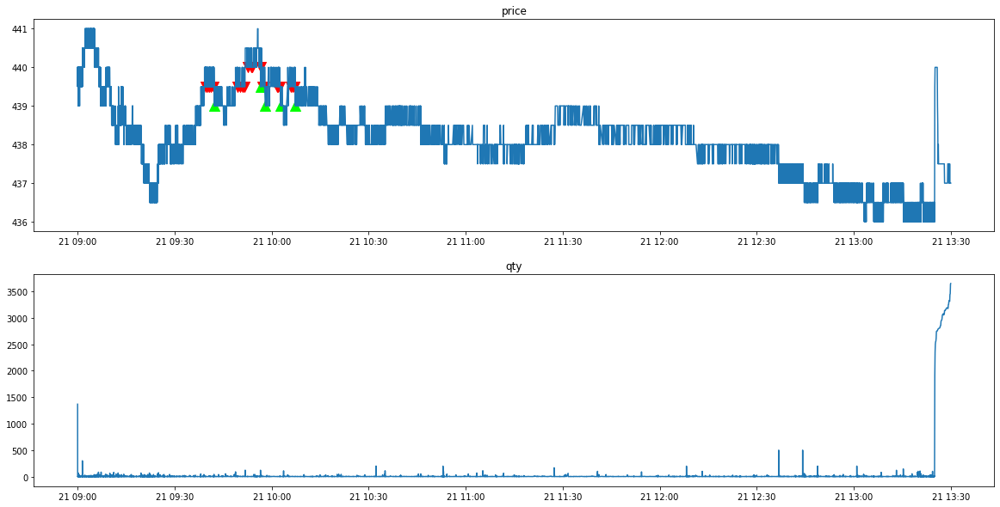

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000371
clear_position:  0.0
position:  []
tick_row_price 434.0
----------Result Report--------------
profit:  0.0


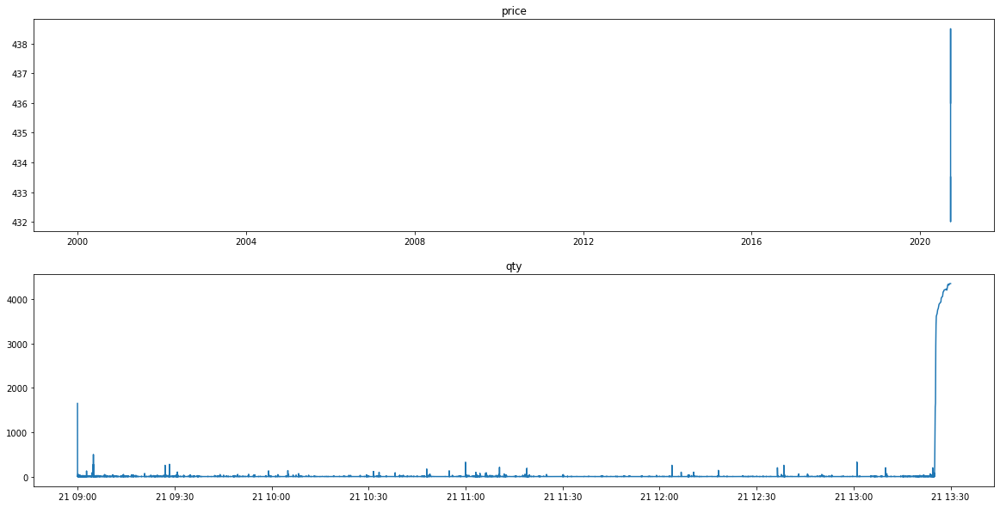

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000463
*** bid1_p:  426.5
*** weighted_p:  426.05334150827713
ask1_p:  427.0
進場時間： 90227150 
  sell price at  426.5
*** bid1_p:  427.0
*** weighted_p:  426.1719077568134
ask1_p:  427.5
進場時間： 90259210 
  sell price at  427.0
*** bid1_p:  427.0
*** weighted_p:  426.17329842931935
ask1_p:  427.5
進場時間： 90300007 
  sell price at  427.0
stop profit
出場時間： 90303278
POSITION(pre):  [426.5 427.  427. ]
Order_p(pre):  [426.  426.5 426.5]
tick_row price:  426.5
qualified index:  [[1]
 [2]]
POSITION(post):  [426.5]
Order_p(post):  [426.]

*** bid1_p:  427.0
*** weighted_p:  426.2968890892696
ask1_p:  427.5
進場時間： 90339128 
  sell price at  427.0
stop profit
出場時間： 90344150
POSITION(pre):  [426.5 427. ]
Order_p(pre):  [426.  426.5]
tick_

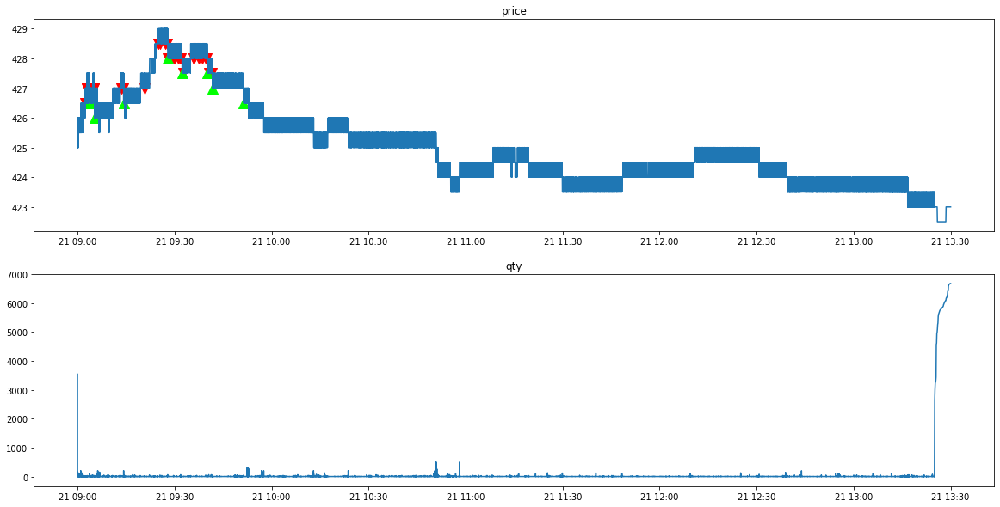

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2330/tse_lob_2330.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2330/tse_tick_2330.csv' mode='r' encoding='UTF-8'>
90000243
clear_position:  0.0
position:  []
tick_row_price 424.0
----------Result Report--------------
profit:  0.0


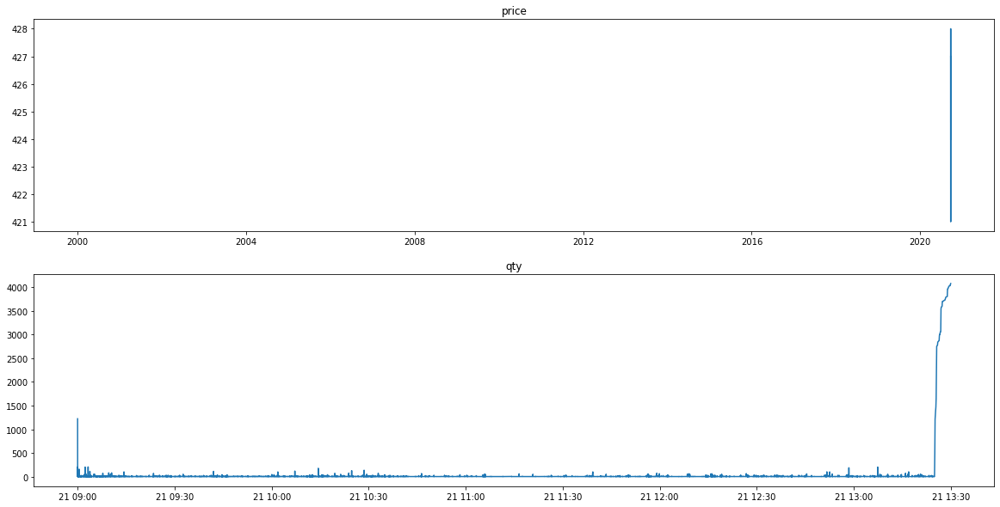

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90003691
*** bid1_p:  571.0
*** weighted_p:  569.2631578947369
ask1_p:  572.0
進場時間： 90239489 
  sell price at  571.0
*** bid1_p:  571.0
*** weighted_p:  570.0969162995594
ask1_p:  572.0
進場時間： 90330843 
  sell price at  571.0
stop profit
出場時間： 90342437
POSITION(pre):  [571. 571.]
Order_p(pre):  [570. 570.]
tick_row price:  570.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  572.0
*** weighted_p:  570.2041666666667
ask1_p:  573.0
進場時間： 90649245 
  sell price at  572.0
stop profit
出場時間： 90708606
POSITION(pre):  [572.]
Order_p(pre):  [571.]
tick_row price:  571.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  572.0
*** weighted_p:  570.4141791044776
ask1_p:  573.

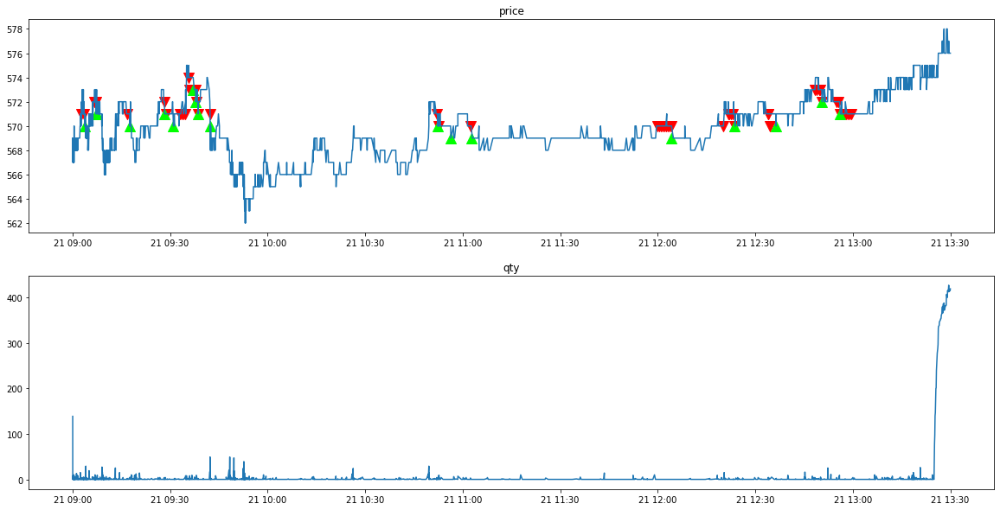

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90005306
*** bid1_p:  586.0
*** weighted_p:  583.46875
ask1_p:  587.0
進場時間： 90529461 
  sell price at  586.0
*** bid1_p:  587.0
*** weighted_p:  584.0829015544041
ask1_p:  588.0
進場時間： 90600691 
  sell price at  587.0
stop profit
出場時間： 90613497
POSITION(pre):  [586. 587.]
Order_p(pre):  [585. 586.]
tick_row price:  586.0
qualified index:  [[1]]
POSITION(post):  [586.]
Order_p(post):  [585.]

*** bid1_p:  586.0
*** weighted_p:  584.6008492569002
ask1_p:  587.0
進場時間： 90752851 
  sell price at  586.0
stop profit
出場時間： 90753049
POSITION(pre):  [586. 586.]
Order_p(pre):  [585. 585.]
tick_row price:  585.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  586.0
*** weighted_p:  584.7414448669201
ask

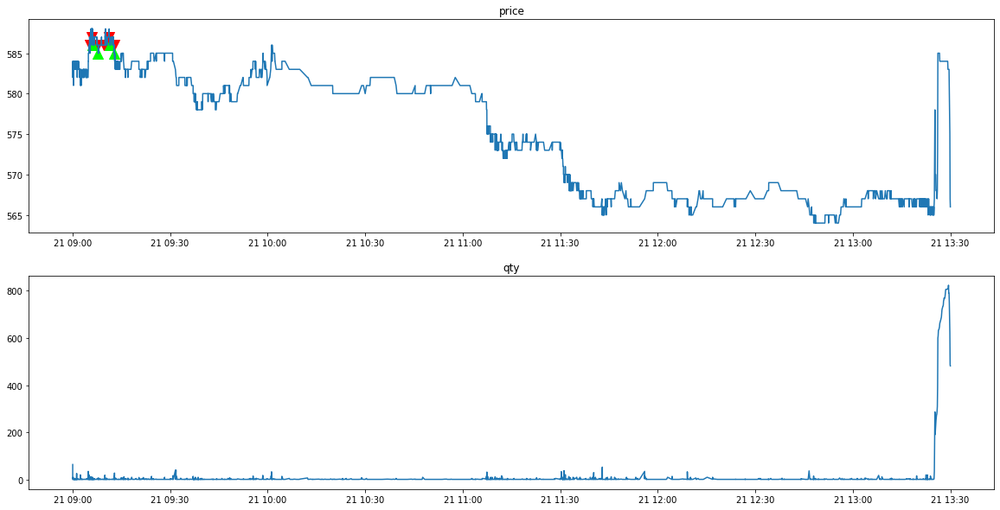

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90004742
*** bid1_p:  565.0
*** weighted_p:  562.8381696428571
ask1_p:  566.0
進場時間： 91237773 
  sell price at  565.0
*** bid1_p:  565.0
*** weighted_p:  562.8690869086909
ask1_p:  566.0
進場時間： 91301488 
  sell price at  565.0
*** bid1_p:  566.0
*** weighted_p:  563.1835506519559
ask1_p:  567.0
進場時間： 91425227 
  sell price at  566.0
stop profit
出場時間： 91429550
POSITION(pre):  [565. 565. 566.]
Order_p(pre):  [564. 564. 565.]
tick_row price:  565.0
qualified index:  [[2]]
POSITION(post):  [565. 565.]
Order_p(post):  [564. 564.]

*** bid1_p:  565.0
*** weighted_p:  563.3766355140187
ask1_p:  566.0
進場時間： 91556360 
  sell price at  565.0
*** bid1_p:  565.0
*** weighted_p:  563.3781512605042
ask1_p:  566.0
進場時間： 91600235 
  sell pri

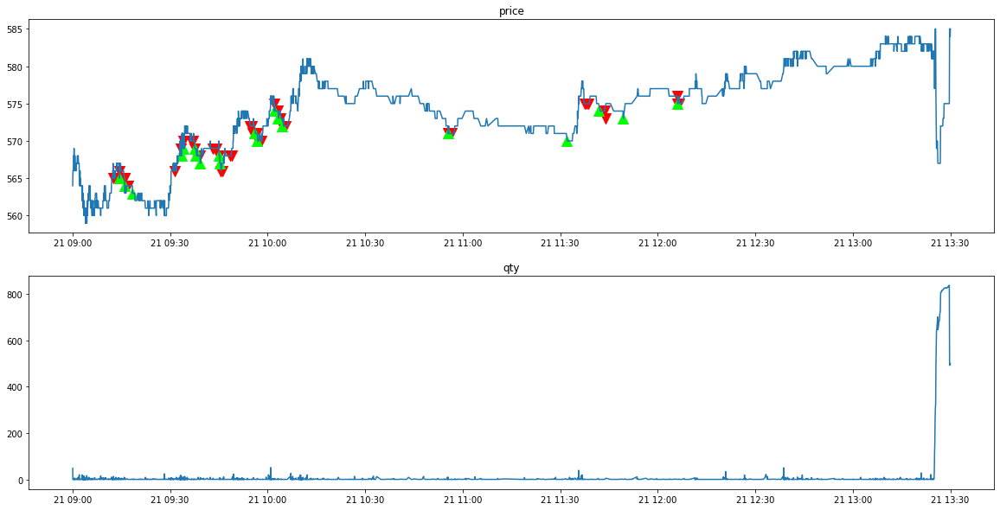

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90003329
*** bid1_p:  589.0
*** weighted_p:  588.1047381546134
ask1_p:  590.0
進場時間： 90932076 
  sell price at  589.0
stop profit
出場時間： 90932076
POSITION(pre):  [589.]
Order_p(pre):  [588.]
tick_row price:  588.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  588.0
*** weighted_p:  586.743143812709
ask1_p:  589.0
進場時間： 93253179 
  sell price at  588.0
stop profit
出場時間： 93316610
POSITION(pre):  [588.]
Order_p(pre):  [587.]
tick_row price:  587.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  589.0
*** weighted_p:  586.8515667949423
ask1_p:  590.0
進場時間： 94927353 
  sell price at  589.0
*** bid1_p:  589.0
*** weighted_p:  586.9084582441113
ask1_p:  590.0
進場時間： 95115515

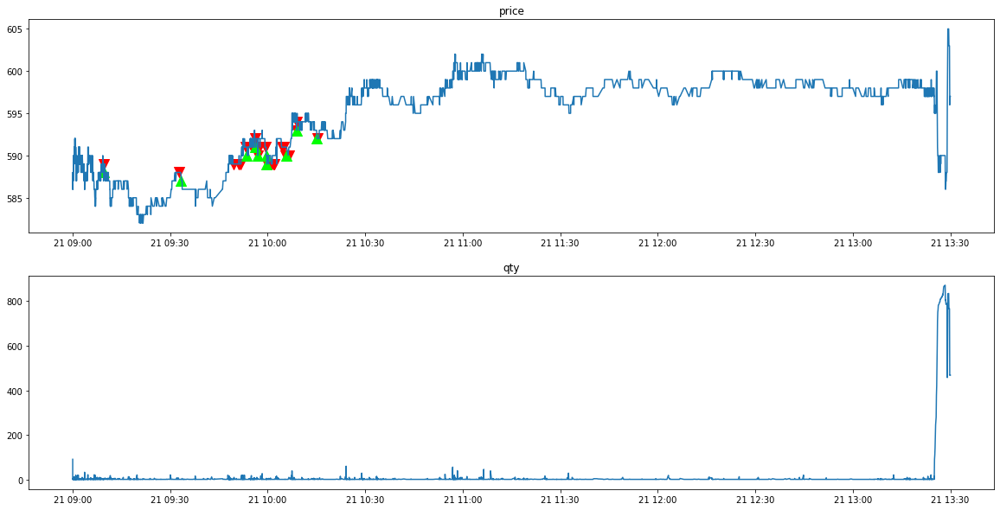

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90003637
*** bid1_p:  597.0
*** weighted_p:  595.0527108433735
ask1_p:  598.0
進場時間： 91633592 
  sell price at  597.0
*** bid1_p:  597.0
*** weighted_p:  595.0958702064896
ask1_p:  598.0
進場時間： 91700264 
  sell price at  597.0
*** bid1_p:  598.0
*** weighted_p:  595.4039735099337
ask1_p:  599.0
進場時間： 91853438 
  sell price at  598.0
*** bid1_p:  598.0
*** weighted_p:  595.4545454545455
ask1_p:  599.0
進場時間： 91900115 
  sell price at  598.0
*** bid1_p:  598.0
*** weighted_p:  595.7212918660288
ask1_p:  599.0
進場時間： 92057809 
  sell price at  598.0
stop profit
出場時間： 92057919
POSITION(pre):  [597. 597. 598. 598. 598.]
Order_p(pre):  [596. 596. 597. 597. 597.]
tick_row price:  597.0
qualified index:  [[2]
 [3]
 [4]]
POSITION(post):

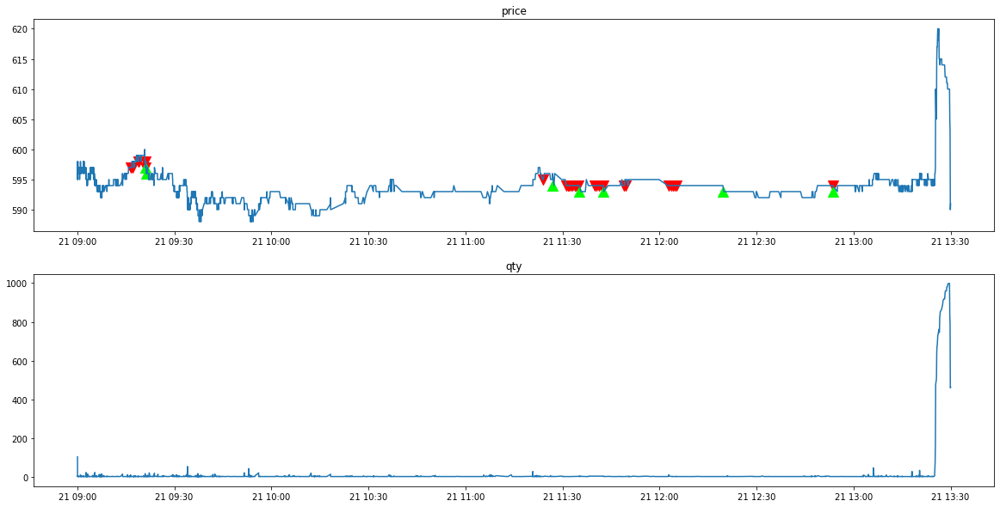

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90004110
*** bid1_p:  595.0
*** weighted_p:  593.9569569569569
ask1_p:  596.0
進場時間： 94717532 
  sell price at  595.0
*** bid1_p:  595.0
*** weighted_p:  593.965139442231
ask1_p:  596.0
進場時間： 94750247 
  sell price at  595.0
*** bid1_p:  595.0
*** weighted_p:  593.9671641791044
ask1_p:  596.0
進場時間： 94800851 
  sell price at  595.0
*** bid1_p:  597.0
*** weighted_p:  594.3696599825632
ask1_p:  598.0
進場時間： 94950734 
  sell price at  597.0
*** bid1_p:  597.0
*** weighted_p:  594.3773913043478
ask1_p:  598.0
進場時間： 95000095 
  sell price at  597.0
*** bid1_p:  597.0
*** weighted_p:  594.4110060189166
ask1_p:  598.0
進場時間： 95053723 
  sell price at  597.0
*** bid1_p:  597.0
*** weighted_p:  594.4154506437768
ask1_p:  598.0
進場時間： 95

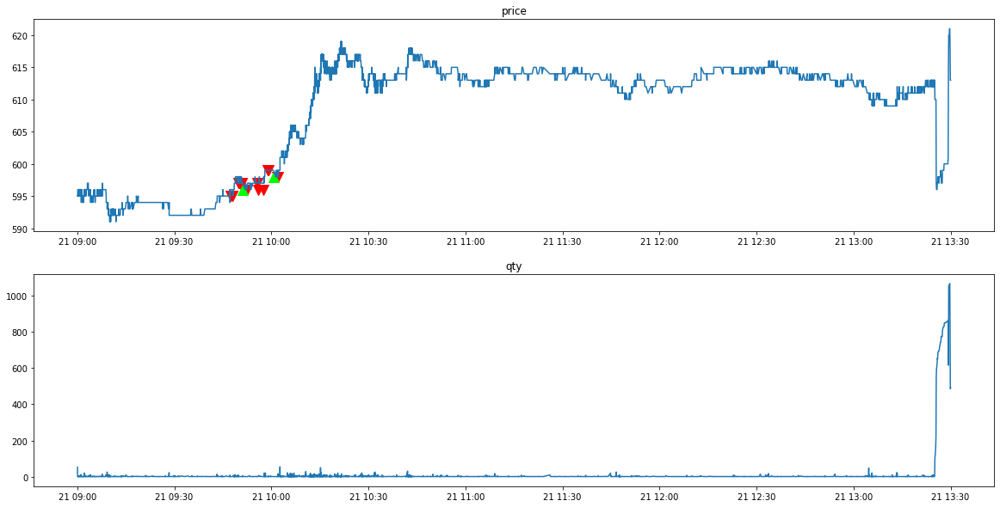

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90002407
*** bid1_p:  613.0
*** weighted_p:  610.613309352518
ask1_p:  615.0
進場時間： 90945368 
  sell price at  613.0
*** bid1_p:  614.0
*** weighted_p:  611.2496171516079
ask1_p:  615.0
進場時間： 91009733 
  sell price at  614.0
*** bid1_p:  614.0
*** weighted_p:  611.7984293193717
ask1_p:  615.0
進場時間： 91049468 
  sell price at  614.0
*** bid1_p:  615.0
*** weighted_p:  612.0821428571429
ask1_p:  616.0
進場時間： 91206493 
  sell price at  615.0
*** bid1_p:  615.0
*** weighted_p:  612.212086659065
ask1_p:  616.0
進場時間： 91239656 
  sell price at  615.0
*** bid1_p:  617.0
*** weighted_p:  612.8308751229105
ask1_p:  618.0
進場時間： 91407373 
  sell price at  617.0
stop profit
出場時間： 91407414
POSITION(pre):  [613. 614. 614. 615. 615. 617.]
Ord

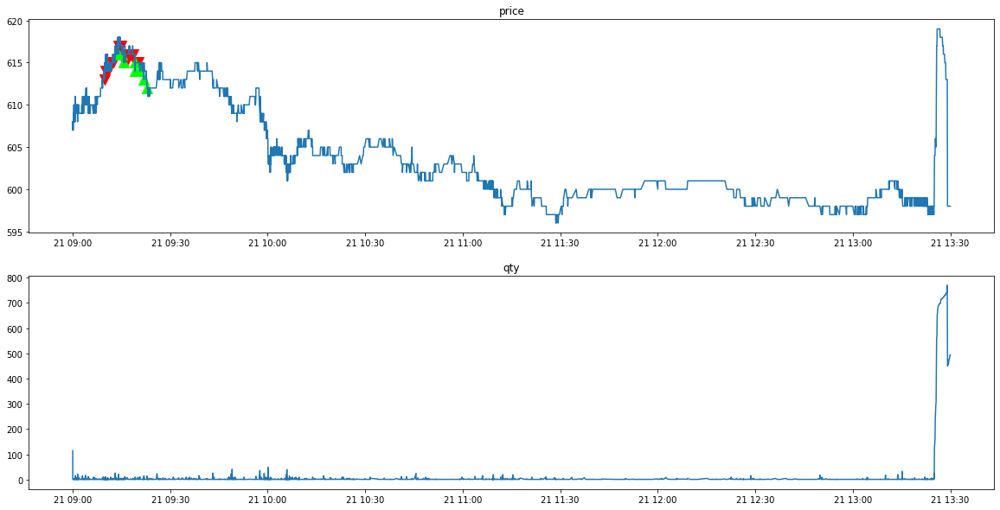

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90004265
*** bid1_p:  604.0
*** weighted_p:  603.2142857142857
ask1_p:  605.0
進場時間： 90221314 
  sell price at  604.0
*** bid1_p:  605.0
*** weighted_p:  603.7808219178082
ask1_p:  606.0
進場時間： 90254557 
  sell price at  605.0
*** bid1_p:  605.0
*** weighted_p:  604.2092198581561
ask1_p:  606.0
進場時間： 90320948 
  sell price at  605.0
stop profit
出場時間： 90346005
POSITION(pre):  [604. 605. 605.]
Order_p(pre):  [603. 604. 604.]
tick_row price:  604.0
qualified index:  [[1]
 [2]]
POSITION(post):  [604.]
Order_p(post):  [603.]

stop profit
出場時間： 90352075
POSITION(pre):  [604.]
Order_p(pre):  [603.]
tick_row price:  603.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  606.0
*** weighted_p:  604.577405857

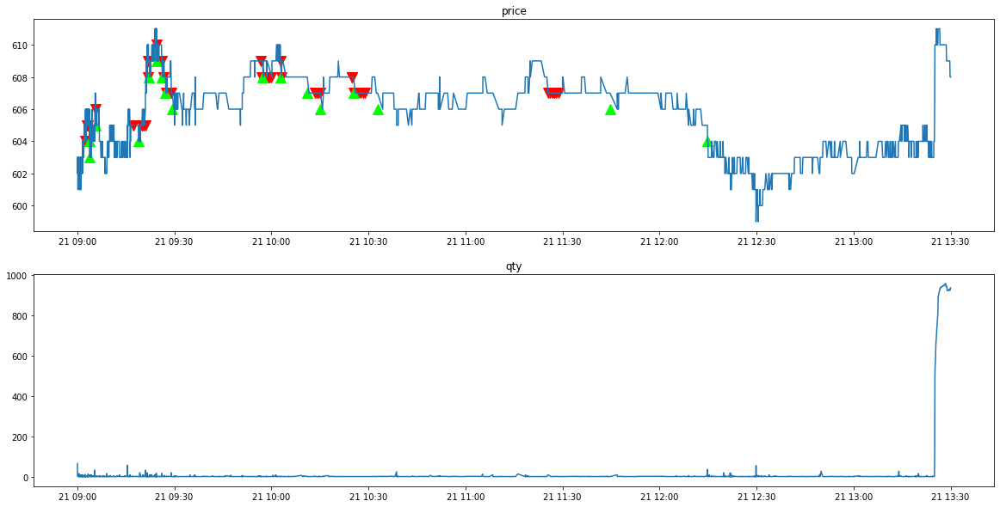

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90005977
------Weird price!!!!!---------
At time:  90459617
tick_row_price 619.0
ask_1_p 620.0
bid_1_p 618.0
*** bid1_p:  619.0
*** weighted_p:  617.0114503816794
ask1_p:  620.0
進場時間： 90500512 
  sell price at  619.0
*** bid1_p:  619.0
*** weighted_p:  617.7047075606276
ask1_p:  620.0
進場時間： 90546647 
  sell price at  619.0
stop profit
出場時間： 90548617
POSITION(pre):  [619. 619.]
Order_p(pre):  [618. 618.]
tick_row price:  618.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  619.0
*** weighted_p:  618.0552659019812
ask1_p:  620.0
進場時間： 90818143 
  sell price at  619.0
*** bid1_p:  620.0
*** weighted_p:  618.2050048123195
ask1_p:  621.0
進場時間： 90919391 
  sell price at  620.0
stop profit
出場時間： 

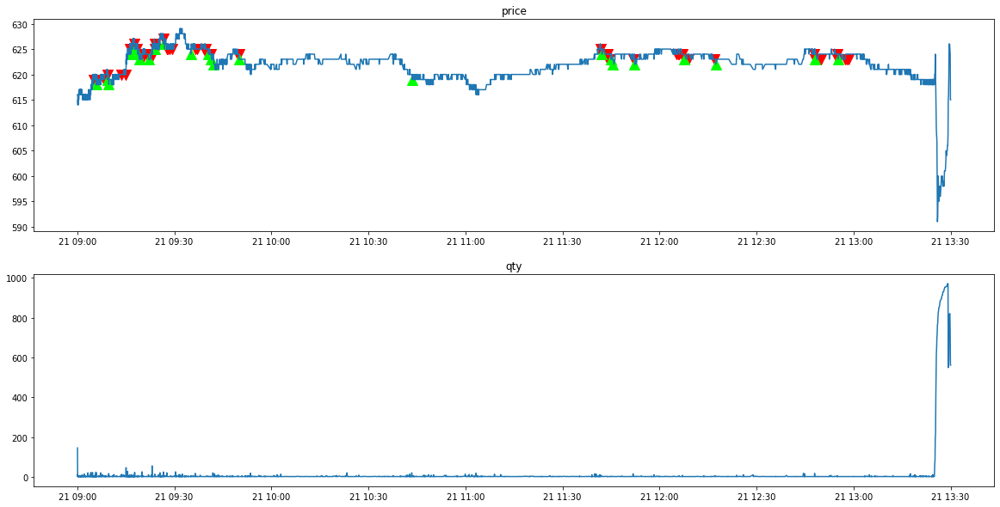

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90003218
*** bid1_p:  615.0
*** weighted_p:  614.2688172043011
ask1_p:  616.0
進場時間： 90316249 
  sell price at  615.0
*** bid1_p:  617.0
*** weighted_p:  615.4420062695925
ask1_p:  618.0
進場時間： 90434340 
  sell price at  617.0
stop profit
出場時間： 90434340
POSITION(pre):  [615. 617.]
Order_p(pre):  [614. 616.]
tick_row price:  616.0
qualified index:  [[1]]
POSITION(post):  [615.]
Order_p(post):  [614.]

stop profit
出場時間： 90606742
POSITION(pre):  [615.]
Order_p(pre):  [614.]
tick_row price:  614.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 608.0
----------Result Report--------------
profit:  2.0


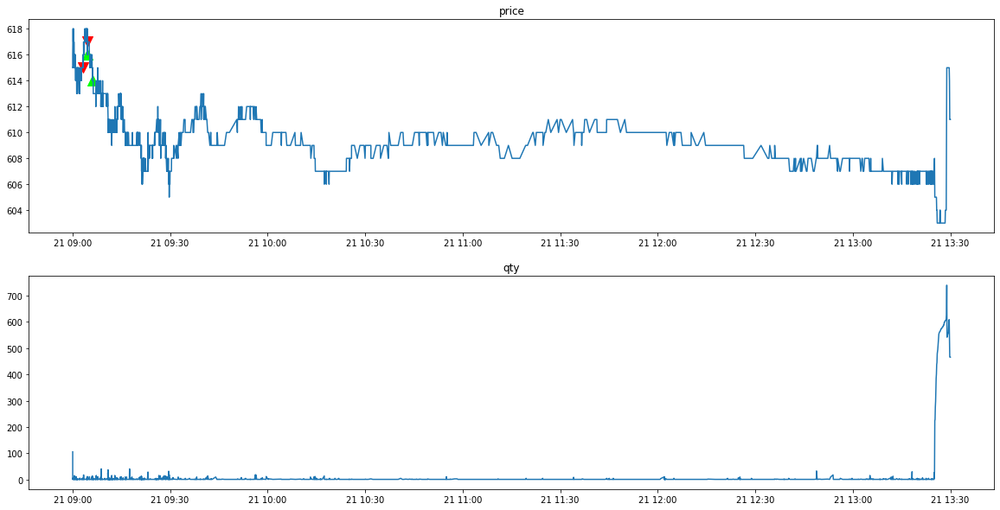

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90006388
clear_position:  0.0
position:  []
tick_row_price 612.0
----------Result Report--------------
profit:  0.0


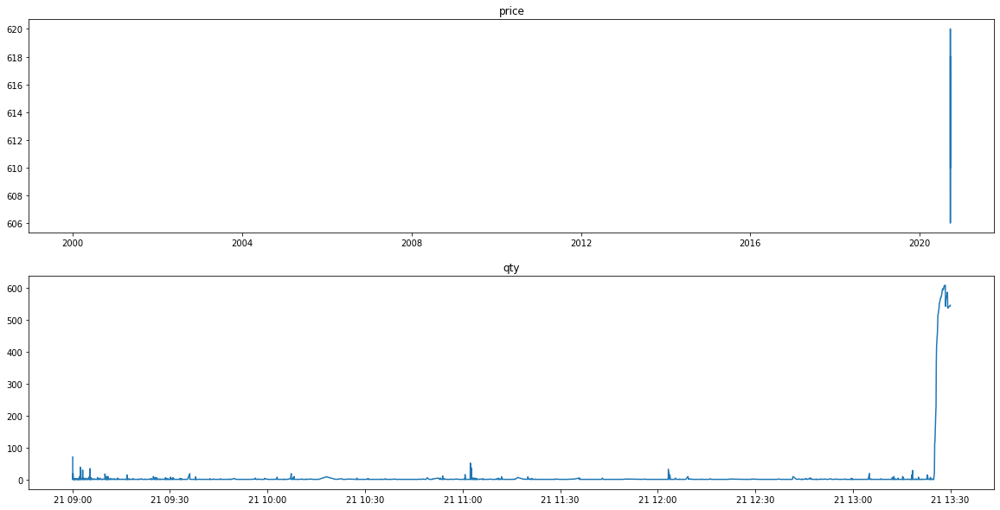

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90007718
*** bid1_p:  599.0
*** weighted_p:  598.1171497584542
ask1_p:  600.0
進場時間： 91551100 
  sell price at  599.0
*** bid1_p:  604.0
*** weighted_p:  599.511073253833
ask1_p:  605.0
進場時間： 92509192 
  sell price at  604.0
stop profit
出場時間： 92521313
POSITION(pre):  [599. 604.]
Order_p(pre):  [598. 603.]
tick_row price:  603.0
qualified index:  [[1]]
POSITION(post):  [599.]
Order_p(post):  [598.]

*** bid1_p:  603.0
*** weighted_p:  599.5577085088458
ask1_p:  604.0
進場時間： 92540120 
  sell price at  603.0
*** bid1_p:  603.0
*** weighted_p:  599.560606060606
ask1_p:  604.0
進場時間： 92601073 
  sell price at  603.0
*** bid1_p:  603.0
*** weighted_p:  599.5738255033557
ask1_p:  604.0
進場時間： 92631308 
  sell price at  603.0
*** bid1_

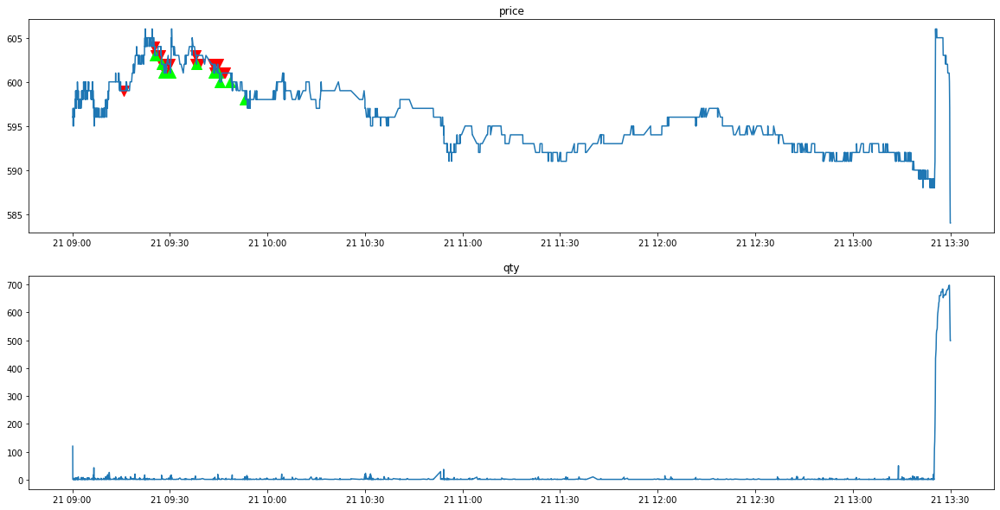

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3406/tse_lob_3406.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3406/tse_tick_3406.csv' mode='r' encoding='UTF-8'>
90007464
clear_position:  0.0
position:  []
tick_row_price 574.0
----------Result Report--------------
profit:  0.0


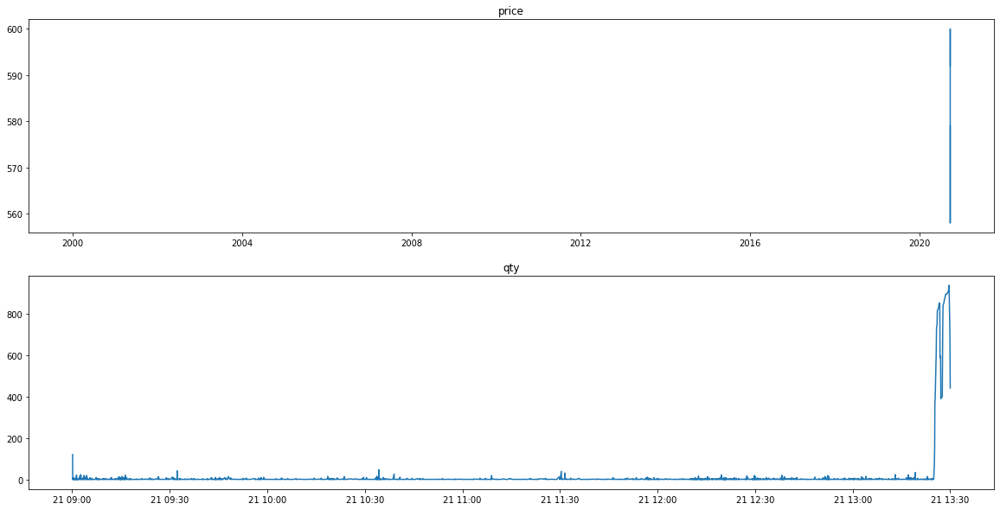

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002287
*** bid1_p:  77.2
*** weighted_p:  77.07007684918374
ask1_p:  77.3
進場時間： 90643314 
  sell price at  77.2
stop profit
出場時間： 90651123
POSITION(pre):  [77.2]
Order_p(pre):  [77.1]
tick_row price:  77.1
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  77.0
*** weighted_p:  76.89951212300463
ask1_p:  77.1
進場時間： 93553236 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.89951212300463
ask1_p:  77.1
進場時間： 93600100 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.89986729578344
ask1_p:  77.1
進場時間： 93707073 
  sell price at  77.0
*** bid1_p:  77.1
*** weighted_p:  76.90604458416729
ask1_p:  77.2
進場時間： 94118914 
  sell price at  77.1
*** bid1_p:  77.1
*** weighted_p:  76.906

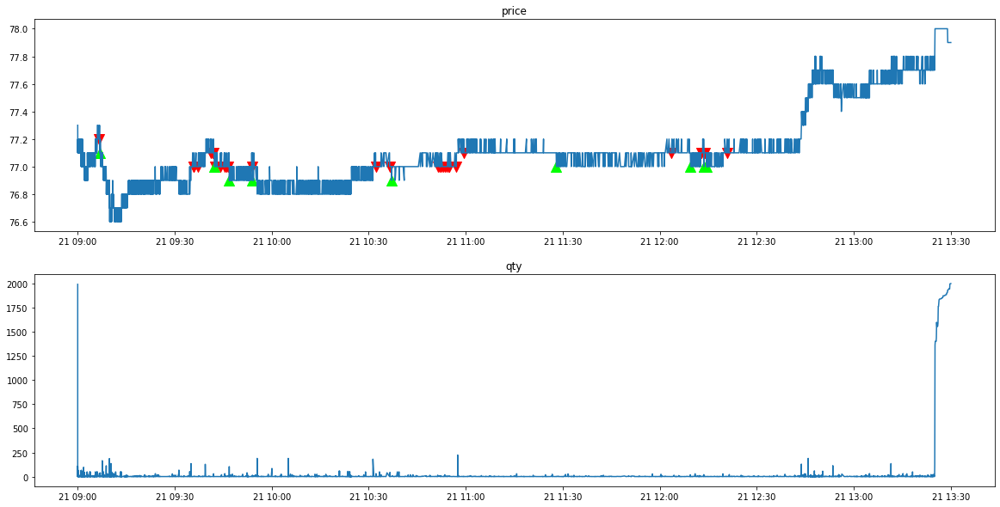

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002496
*** bid1_p:  78.3
*** weighted_p:  78.17454166666677
ask1_p:  78.4
進場時間： 90526731 
  sell price at  78.3
*** bid1_p:  78.3
*** weighted_p:  78.18841085271318
ask1_p:  78.4
進場時間： 90557052 
  sell price at  78.3
*** bid1_p:  78.3
*** weighted_p:  78.19019083969462
ask1_p:  78.4
進場時間： 90600013 
  sell price at  78.3
*** bid1_p:  78.3
*** weighted_p:  78.19499079189669
ask1_p:  78.4
進場時間： 90630668 
  sell price at  78.3
*** bid1_p:  78.3
*** weighted_p:  78.19896576319516
ask1_p:  78.4
進場時間： 90700048 
  sell price at  78.3
*** bid1_p:  78.4
*** weighted_p:  78.2367908309453
ask1_p:  78.5
進場時間： 90755316 
  sell price at  78.4
*** bid1_p:  78.4
*** weighted_p:  78.2379840546695
ask1_p:  78.5
進場時間： 90800399 
  sell price 

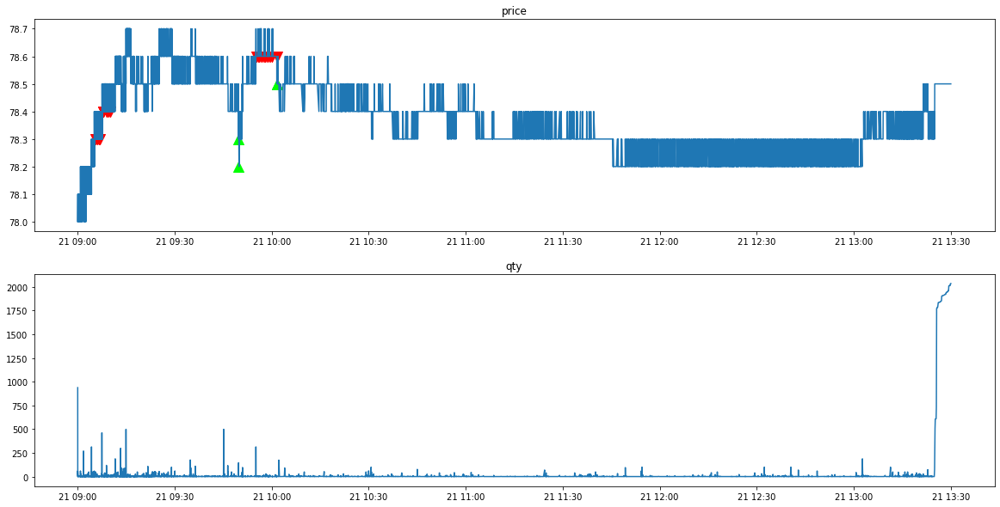

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002380
clear_position:  0.0
position:  []
tick_row_price 78.3
----------Result Report--------------
profit:  0.0


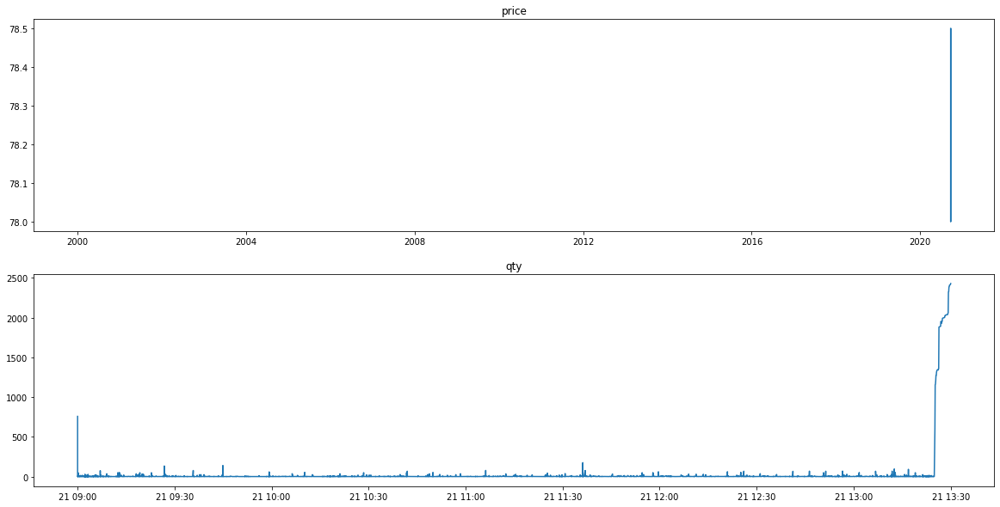

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90003102
*** bid1_p:  78.9
*** weighted_p:  78.78773984550176
ask1_p:  79.0
進場時間： 93307745 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.78967726040865
ask1_p:  79.0
進場時間： 93342523 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.79009828009798
ask1_p:  79.0
進場時間： 93400269 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.79177982541196
ask1_p:  79.0
進場時間： 93430409 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.79554713405952
ask1_p:  79.0
進場時間： 93613394 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.79757066106036
ask1_p:  79.0
進場時間： 93648603 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.79776067179834
ask1_p:  79.0
進場時間： 93700722 
  sell pric

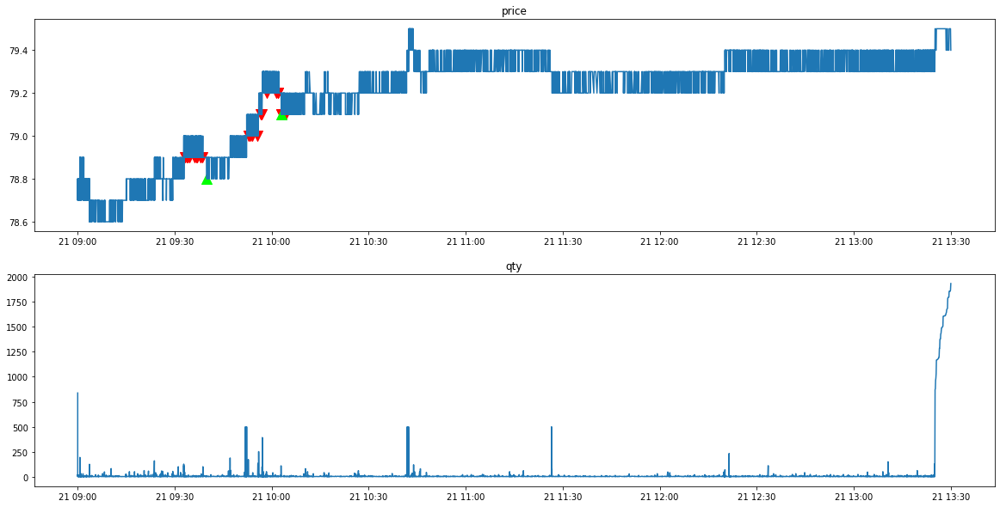

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90001658
clear_position:  0.0
position:  []
tick_row_price 79.1
----------Result Report--------------
profit:  0.0


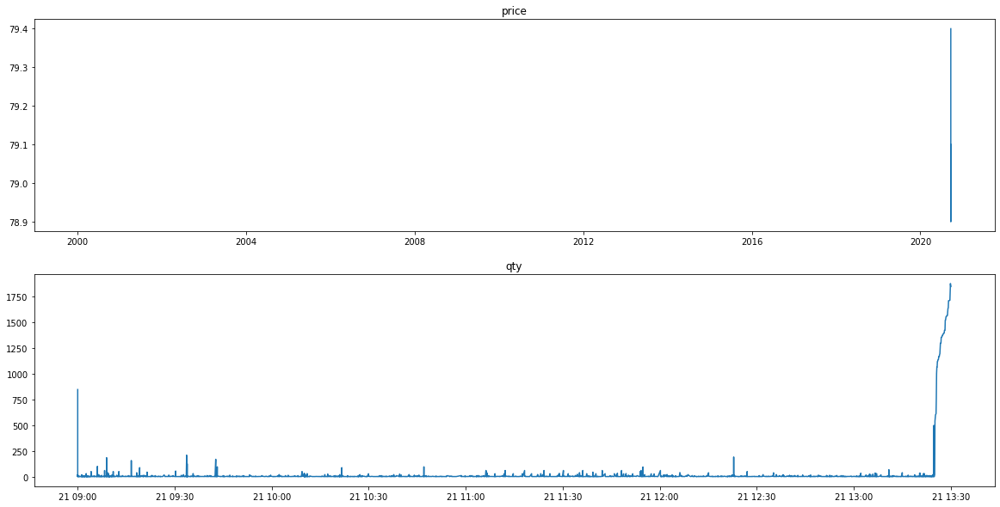

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002705
clear_position:  0.0
position:  []
tick_row_price 78.7
----------Result Report--------------
profit:  0.0


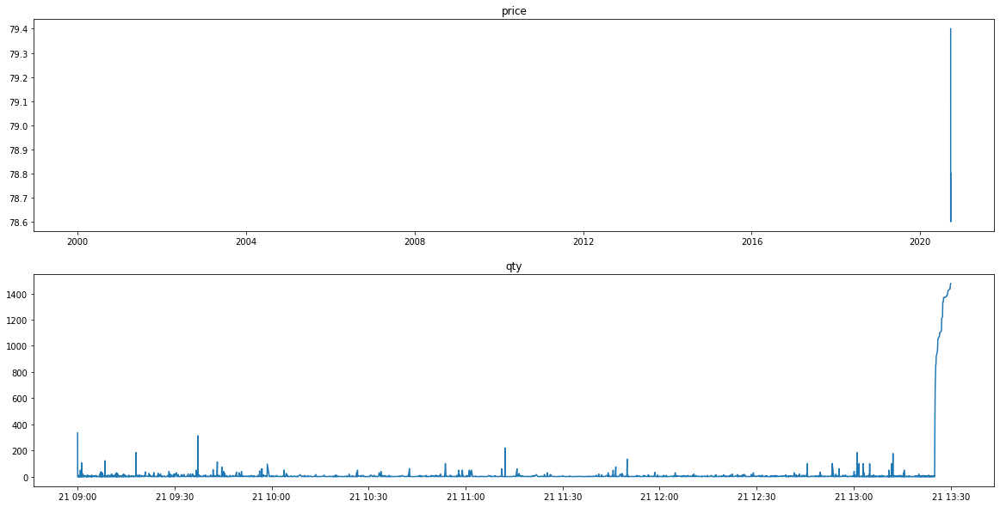

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002344
------Weird price!!!!!---------
At time:  90108814
tick_row_price 78.6
ask_1_p 78.7
bid_1_p 78.5
*** bid1_p:  78.9
*** weighted_p:  78.72881597717554
ask1_p:  79.0
進場時間： 90701424 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.73045325779046
ask1_p:  79.0
進場時間： 90732499 
  sell price at  78.9
stop profit
出場時間： 90758078
POSITION(pre):  [78.9 78.9]
Order_p(pre):  [78.8 78.8]
tick_row price:  78.8
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  78.9
*** weighted_p:  78.77862254025051
ask1_p:  79.0
進場時間： 91248720 
  sell price at  78.9
stop profit
出場時間： 91248720
POSITION(pre):  [78.9]
Order_p(pre):  [78.8]
tick_row price:  78.8
qualified index:  [[0]]
POSITION(post):  []
O

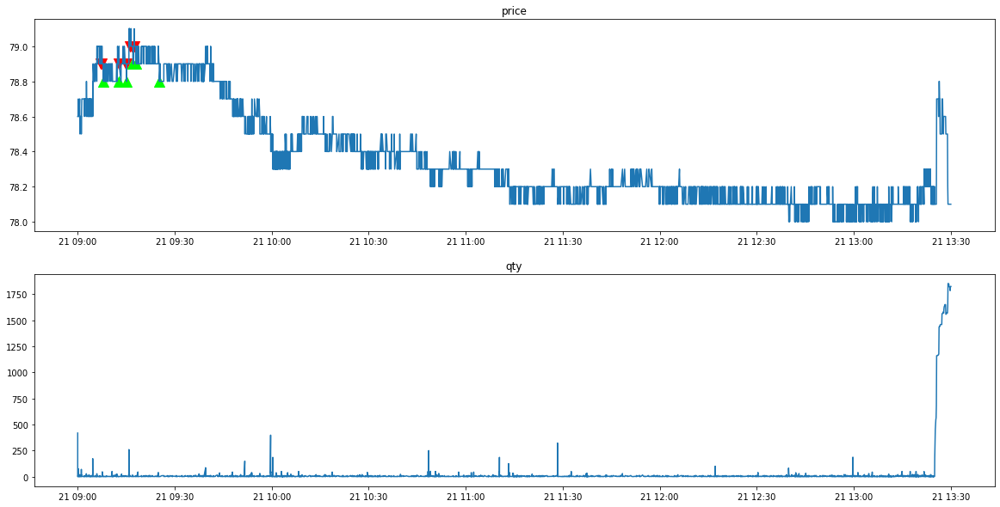

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002663
*** bid1_p:  77.9
*** weighted_p:  77.74855634895943
ask1_p:  78.0
進場時間： 95615198 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.74986896870617
ask1_p:  78.0
進場時間： 95802146 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.7500692840642
ask1_p:  78.0
進場時間： 95833635 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.75101102941133
ask1_p:  78.0
進場時間： 95901584 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.75112540192882
ask1_p:  78.0
進場時間： 95932002 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.75207190737314
ask1_p:  78.0
進場時間： 100002027 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.75258201701052
ask1_p:  78.0
進場時間： 100032373 
  sell pri

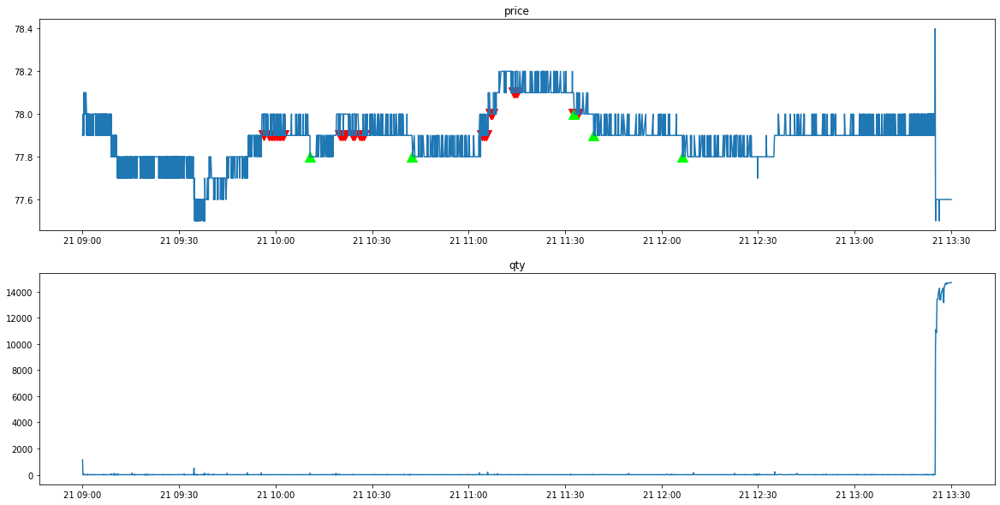

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002368
*** bid1_p:  77.9
*** weighted_p:  77.78224582701047
ask1_p:  78.0
進場時間： 92244474 
  sell price at  77.9
*** bid1_p:  77.9
*** weighted_p:  77.78235591506558
ask1_p:  78.0
進場時間： 92300278 
  sell price at  77.9
*** bid1_p:  78.2
*** weighted_p:  77.85688461538453
ask1_p:  78.3
進場時間： 92610580 
  sell price at  78.2
stop profit
出場時間： 92614211
POSITION(pre):  [77.9 77.9 78.2]
Order_p(pre):  [77.8 77.8 78.1]
tick_row price:  78.1
qualified index:  [[2]]
POSITION(post):  [77.9 77.9]
Order_p(post):  [77.8 77.8]

*** bid1_p:  78.1
*** weighted_p:  77.90194078947378
ask1_p:  78.2
進場時間： 93212355 
  sell price at  78.1
stop profit
出場時間： 93228626
POSITION(pre):  [77.9 77.9 78.1]
Order_p(pre):  [77.8 77.8 78. ]
tick_row price: 

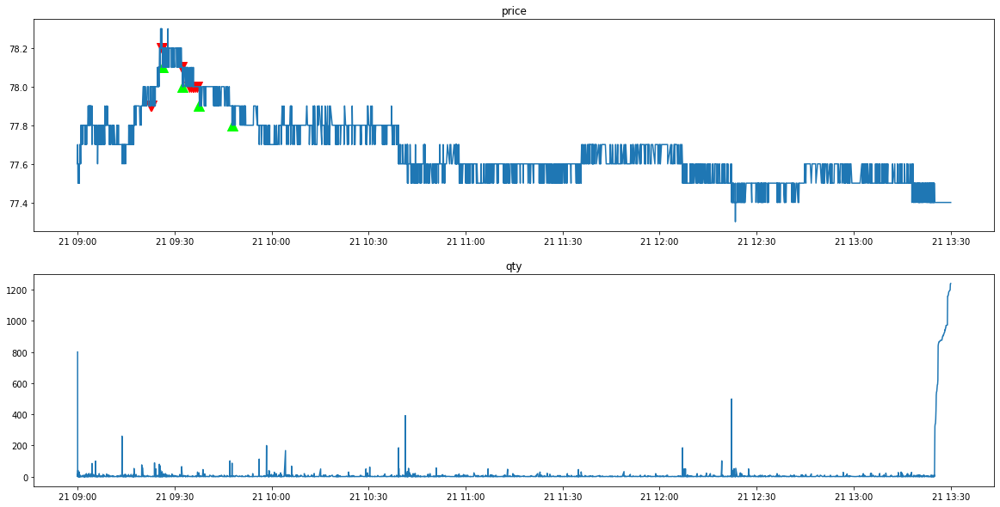

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002615
*** bid1_p:  77.0
*** weighted_p:  76.86910424305908
ask1_p:  77.1
進場時間： 93714931 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.86930641280458
ask1_p:  77.1
進場時間： 93745328 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.86938199309829
ask1_p:  77.1
進場時間： 93801503 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.86982686691684
ask1_p:  77.1
進場時間： 93934285 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.87001146191503
ask1_p:  77.1
進場時間： 94001848 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.87211796246628
ask1_p:  77.1
進場時間： 94213806 
  sell price at  77.0
*** bid1_p:  77.0
*** weighted_p:  76.87815126050393
ask1_p:  77.1
進場時間： 94714472 
  sell pric

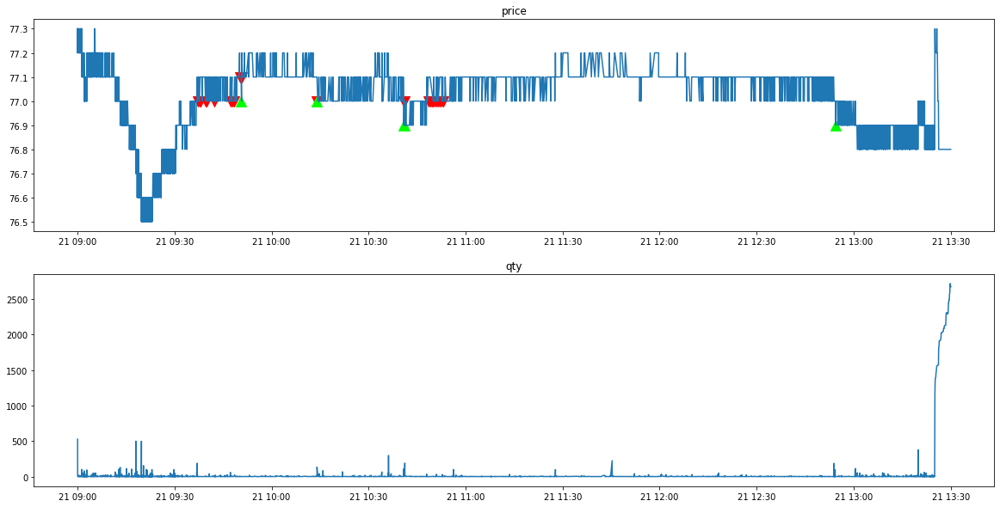

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002377
*** bid1_p:  77.1
*** weighted_p:  77.01376146788998
ask1_p:  77.2
進場時間： 90228390 
  sell price at  77.1
stop profit
出場時間： 90228390
POSITION(pre):  [77.1]
Order_p(pre):  [77.]
tick_row price:  77.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  76.9
*** weighted_p:  76.76577069852364
ask1_p:  77.0
進場時間： 100506823 
  sell price at  76.9
*** bid1_p:  76.9
*** weighted_p:  76.76874081332713
ask1_p:  77.0
進場時間： 100642695 
  sell price at  76.9
stop profit
出場時間： 100642872
POSITION(pre):  [76.9 76.9]
Order_p(pre):  [76.8 76.8]
tick_row price:  76.8
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  76.9
*** weighted_p:  76.7634803921573
ask1_p:  77.0
進場時間： 1204

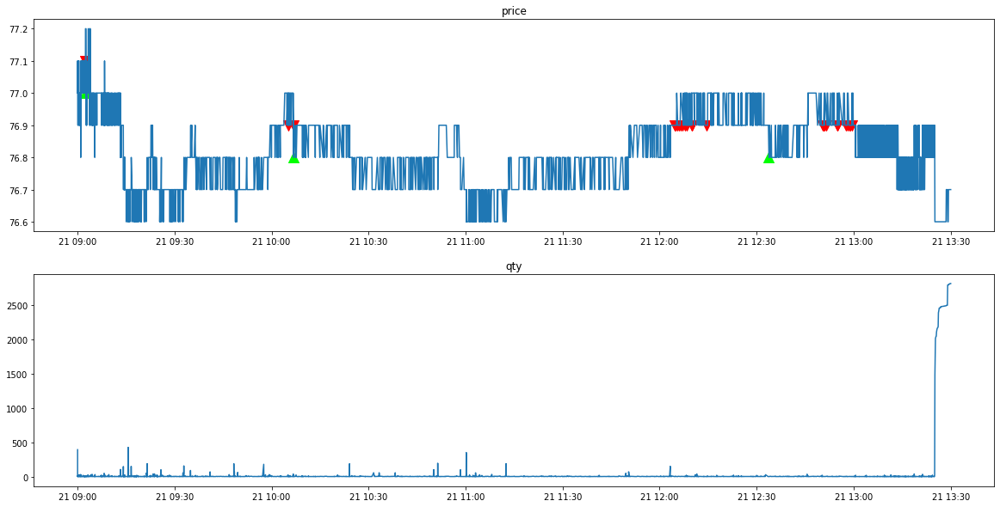

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90002699
*** bid1_p:  76.3
*** weighted_p:  76.17113997114012
ask1_p:  76.4
進場時間： 90446227 
  sell price at  76.3
*** bid1_p:  76.3
*** weighted_p:  76.1735795454547
ask1_p:  76.4
進場時間： 90501052 
  sell price at  76.3
stop profit
出場時間： 90505102
POSITION(pre):  [76.3 76.3]
Order_p(pre):  [76.2 76.2]
tick_row price:  76.2
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  76.3
*** weighted_p:  76.13726758286252
ask1_p:  76.4
進場時間： 92427305 
  sell price at  76.3
*** bid1_p:  76.3
*** weighted_p:  76.14058854719057
ask1_p:  76.4
進場時間： 92503954 
  sell price at  76.3
*** bid1_p:  76.3
*** weighted_p:  76.1431711146004
ask1_p:  76.4
進場時間： 92545057 
  sell price at  76.3
*** bid1_p:  76.3
*** weight

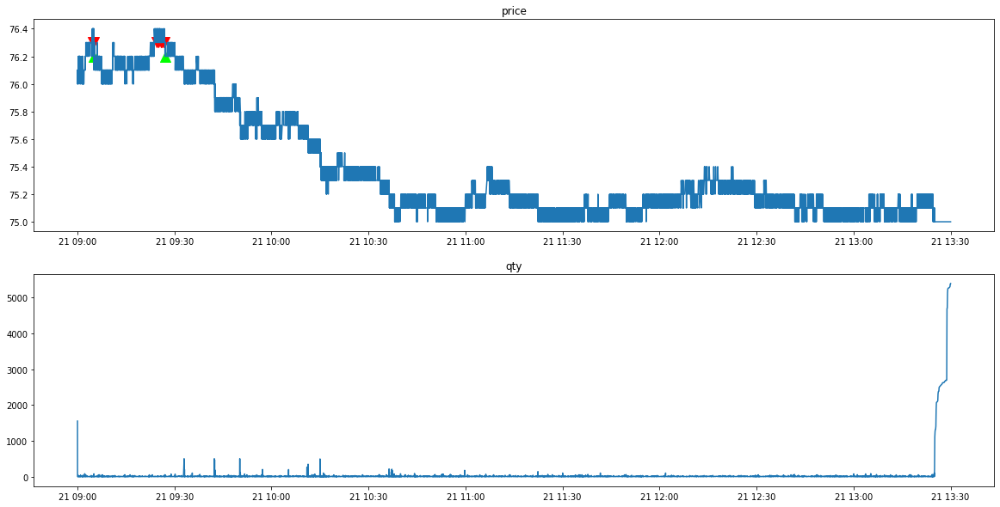

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2317/tse_lob_2317.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2317/tse_tick_2317.csv' mode='r' encoding='UTF-8'>
90001647
clear_position:  0.0
position:  []
tick_row_price 74.3
----------Result Report--------------
profit:  0.0


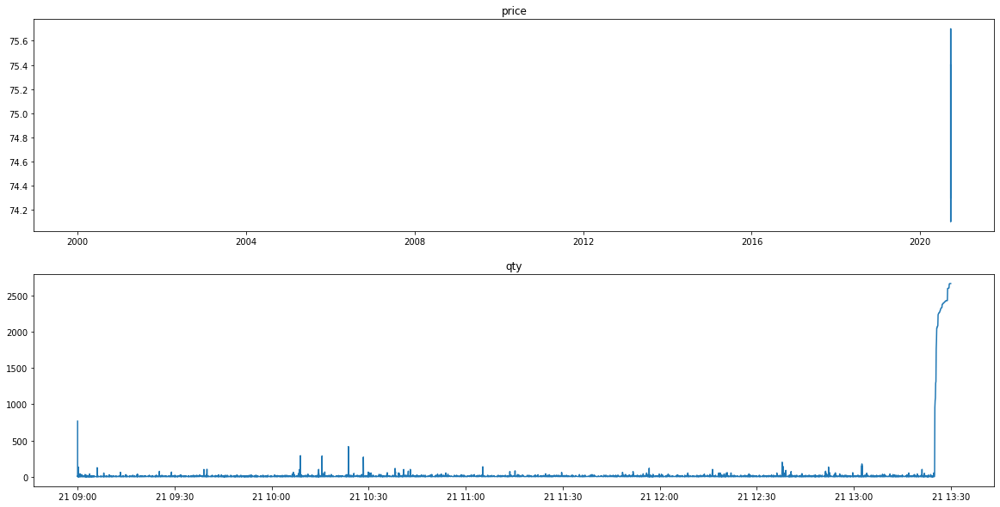

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90015064
*** bid1_p:  81.6
*** weighted_p:  81.50243902439024
ask1_p:  81.7
進場時間： 90642870 
  sell price at  81.6
stop profit
出場時間： 90642870
POSITION(pre):  [81.6]
Order_p(pre):  [81.5]
tick_row price:  81.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  81.6
*** weighted_p:  81.22145522388053
ask1_p:  81.7
進場時間： 94201785 
  sell price at  81.6
*** bid1_p:  81.5
*** weighted_p:  81.2256457564575
ask1_p:  81.6
進場時間： 94234831 
  sell price at  81.5
*** bid1_p:  81.5
*** weighted_p:  81.2256457564575
ask1_p:  81.6
進場時間： 94300739 
  sell price at  81.5
stop profit
出場時間： 94300739
POSITION(pre):  [81.6 81.5 81.5]
Order_p(pre):  [81.5 81.4 81.4]
tick_row price:  81.5
qualified index:  [[0]]
POSITION(p

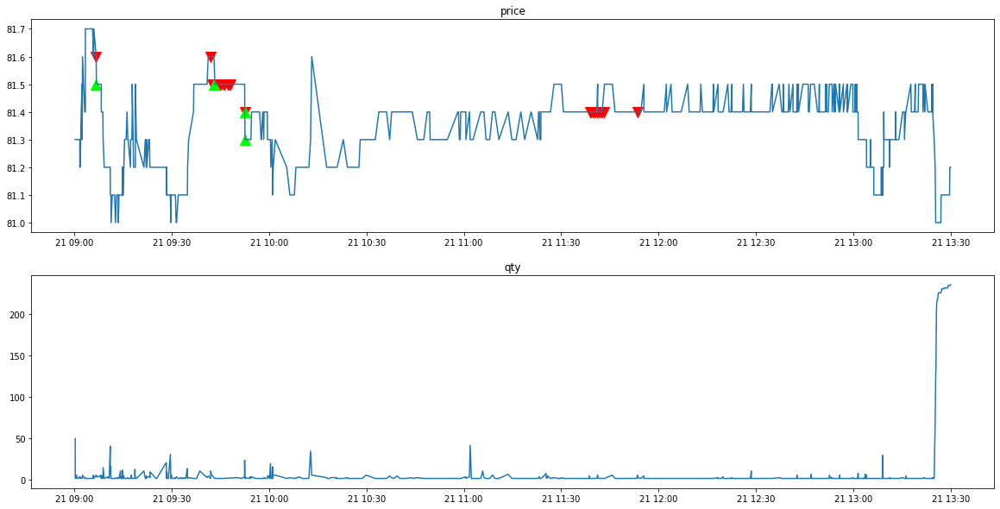

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90015746
*** bid1_p:  81.5
*** weighted_p:  81.23333333333335
ask1_p:  81.6
進場時間： 95802110 
  sell price at  81.5
*** bid1_p:  81.5
*** weighted_p:  81.23416927899687
ask1_p:  81.6
進場時間： 95856356 
  sell price at  81.5
*** bid1_p:  81.5
*** weighted_p:  81.23416927899687
ask1_p:  81.6
進場時間： 95900581 
  sell price at  81.5
*** bid1_p:  81.5
*** weighted_p:  81.23416927899687
ask1_p:  81.6
進場時間： 95945768 
  sell price at  81.5
*** bid1_p:  81.5
*** weighted_p:  81.23987730061351
ask1_p:  81.6
進場時間： 100000258 
  sell price at  81.5
stop profit
出場時間： 100016253
POSITION(pre):  [81.5 81.5 81.5 81.5 81.5]
Order_p(pre):  [81.4 81.4 81.4 81.4 81.4]
tick_row price:  81.4
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
POSITION(post):  []

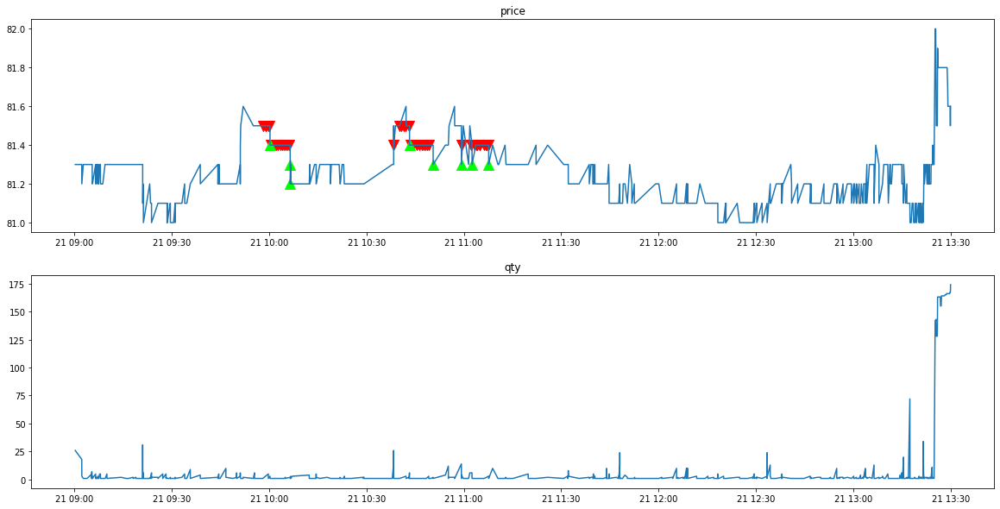

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90017579
*** bid1_p:  82.1
*** weighted_p:  81.83783783783788
ask1_p:  82.2
進場時間： 90617415 
  sell price at  82.1
stop profit
出場時間： 90618213
POSITION(pre):  [82.1]
Order_p(pre):  [82.]
tick_row price:  82.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  81.9
*** weighted_p:  81.81768202080241
ask1_p:  82.0
進場時間： 114538959 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81768202080241
ask1_p:  82.0
進場時間： 114611347 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.8178041543027
ask1_p:  82.0
進場時間： 114707225 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81816838995573
ask1_p:  82.0
進場時間： 114738239 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.8

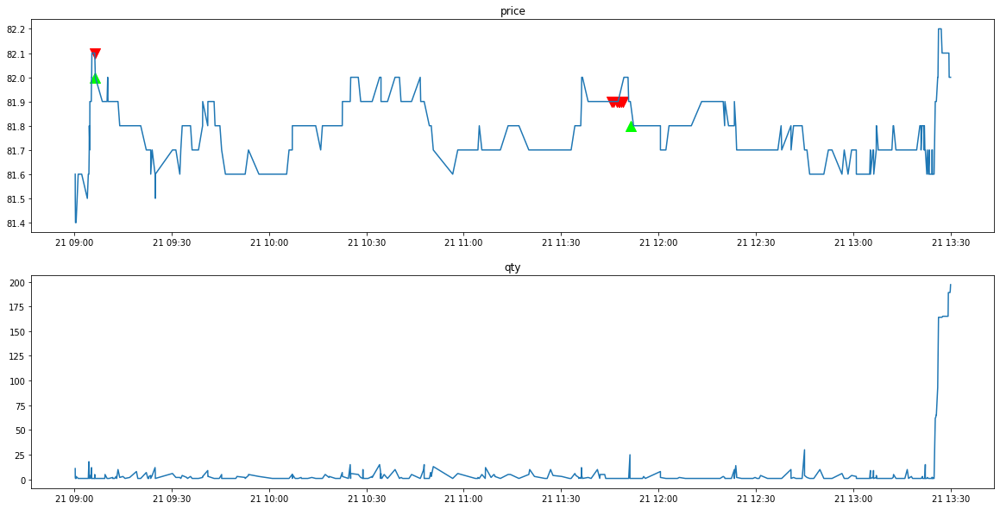

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90022173
*** bid1_p:  82.2
*** weighted_p:  81.91067961165048
ask1_p:  82.3
進場時間： 100102062 
  sell price at  82.2
*** bid1_p:  82.0
*** weighted_p:  81.91067961165048
ask1_p:  82.3
進場時間： 100134387 
  sell price at  82.0
*** bid1_p:  82.0
*** weighted_p:  81.91067961165048
ask1_p:  82.3
進場時間： 100212056 
  sell price at  82.0
*** bid1_p:  82.0
*** weighted_p:  81.9111111111111
ask1_p:  82.3
進場時間： 100246987 
  sell price at  82.0
*** bid1_p:  82.0
*** weighted_p:  81.9111111111111
ask1_p:  82.3
進場時間： 100304608 
  sell price at  82.0
*** bid1_p:  82.0
*** weighted_p:  81.91153846153846
ask1_p:  82.2
進場時間： 100336593 
  sell price at  82.0
*** bid1_p:  82.1
*** weighted_p:  81.91153846153846
ask1_p:  82.2
進場時間： 100403683 
  sell

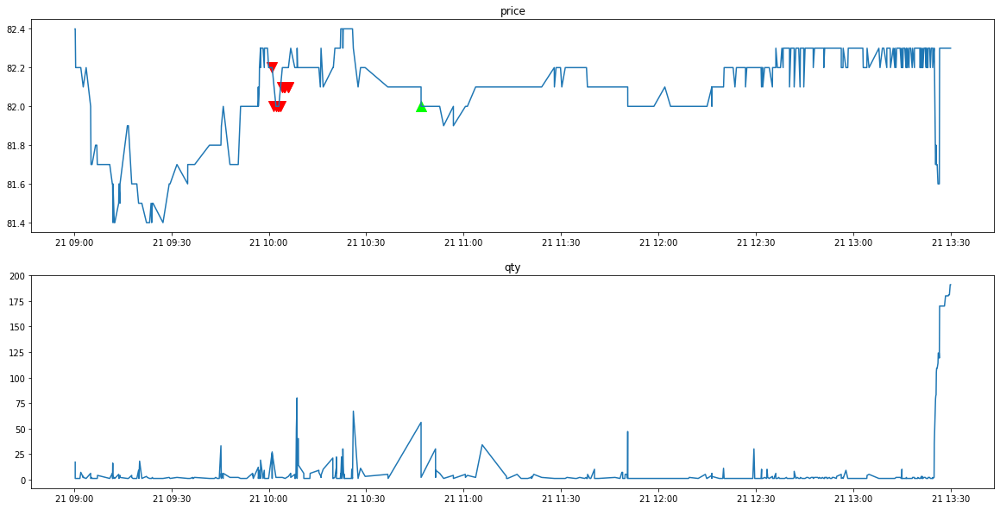

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90019283
*** bid1_p:  81.9
*** weighted_p:  81.81355421686737
ask1_p:  82.0
進場時間： 103059531 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81355421686737
ask1_p:  82.0
進場時間： 103100269 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81483679525213
ask1_p:  82.0
進場時間： 103200018 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81483679525213
ask1_p:  82.0
進場時間： 103232650 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81483679525213
ask1_p:  82.0
進場時間： 103349859 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81508875739637
ask1_p:  82.0
進場時間： 103417820 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.81508875739637
ask1_p:  82.0
進場時間： 103523735 
  se

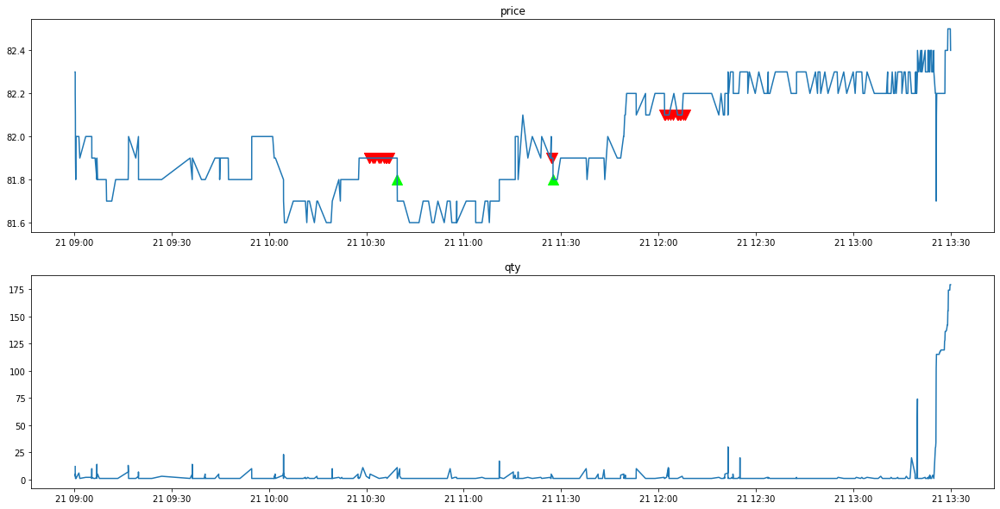

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90017361
*** bid1_p:  82.5
*** weighted_p:  82.25755627009649
ask1_p:  82.6
進場時間： 101731768 
  sell price at  82.5
*** bid1_p:  82.5
*** weighted_p:  82.26214511041013
ask1_p:  82.6
進場時間： 101800596 
  sell price at  82.5
*** bid1_p:  82.5
*** weighted_p:  82.26871165644175
ask1_p:  82.6
進場時間： 101838137 
  sell price at  82.5
*** bid1_p:  82.5
*** weighted_p:  82.26871165644175
ask1_p:  82.6
進場時間： 101952584 
  sell price at  82.5
*** bid1_p:  82.5
*** weighted_p:  82.26871165644175
ask1_p:  82.6
進場時間： 102015341 
  sell price at  82.5
*** bid1_p:  82.5
*** weighted_p:  82.26941896024468
ask1_p:  82.6
進場時間： 102045629 
  sell price at  82.5
*** bid1_p:  82.5
*** weighted_p:  82.26941896024468
ask1_p:  82.6
進場時間： 102108113 
  se

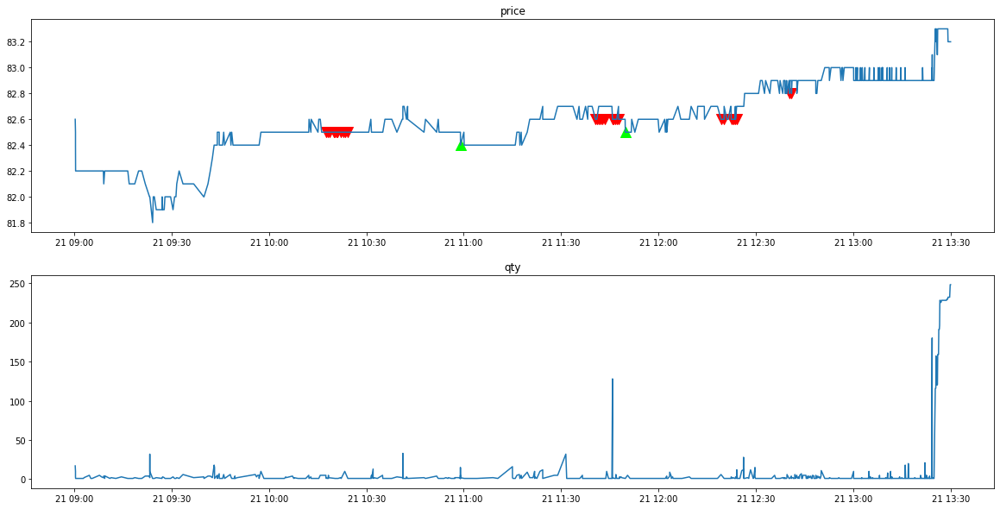

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90017587
*** bid1_p:  83.1
*** weighted_p:  82.81607142857146
ask1_p:  83.2
進場時間： 95105182 
  sell price at  83.1
*** bid1_p:  83.1
*** weighted_p:  82.82267441860468
ask1_p:  83.2
進場時間： 95142025 
  sell price at  83.1
*** bid1_p:  83.1
*** weighted_p:  82.83333333333336
ask1_p:  83.2
進場時間： 95204890 
  sell price at  83.1
*** bid1_p:  83.1
*** weighted_p:  82.8375690607735
ask1_p:  83.2
進場時間： 95241950 
  sell price at  83.1
*** bid1_p:  83.1
*** weighted_p:  82.8375690607735
ask1_p:  83.2
進場時間： 95301541 
  sell price at  83.1
*** bid1_p:  83.1
*** weighted_p:  82.8375690607735
ask1_p:  83.2
進場時間： 95352068 
  sell price at  83.1
*** bid1_p:  83.1
*** weighted_p:  82.8375690607735
ask1_p:  83.2
進場時間： 95401663 
  sell price at

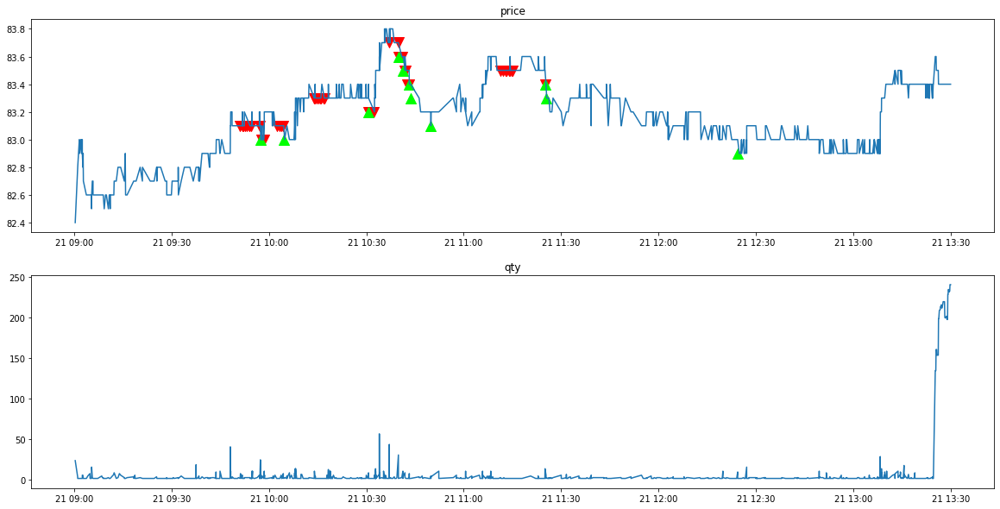

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90013302
*** bid1_p:  84.7
*** weighted_p:  84.31230769230773
ask1_p:  84.8
進場時間： 90830203 
  sell price at  84.7
stop profit
出場時間： 90843677
POSITION(pre):  [84.7]
Order_p(pre):  [84.6]
tick_row price:  84.6
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  84.6
*** weighted_p:  84.32749077490774
ask1_p:  84.7
進場時間： 90901163 
  sell price at  84.6
*** bid1_p:  84.5
*** weighted_p:  84.33194192377493
ask1_p:  84.6
進場時間： 90933222 
  sell price at  84.5
*** bid1_p:  84.5
*** weighted_p:  84.33434704830051
ask1_p:  84.6
進場時間： 91000381 
  sell price at  84.5
stop profit
出場時間： 91022376
POSITION(pre):  [84.6 84.5 84.5]
Order_p(pre):  [84.4 84.4 84.4]
tick_row price:  84.4
qualified index:  [[0]
 [1]
 [2]

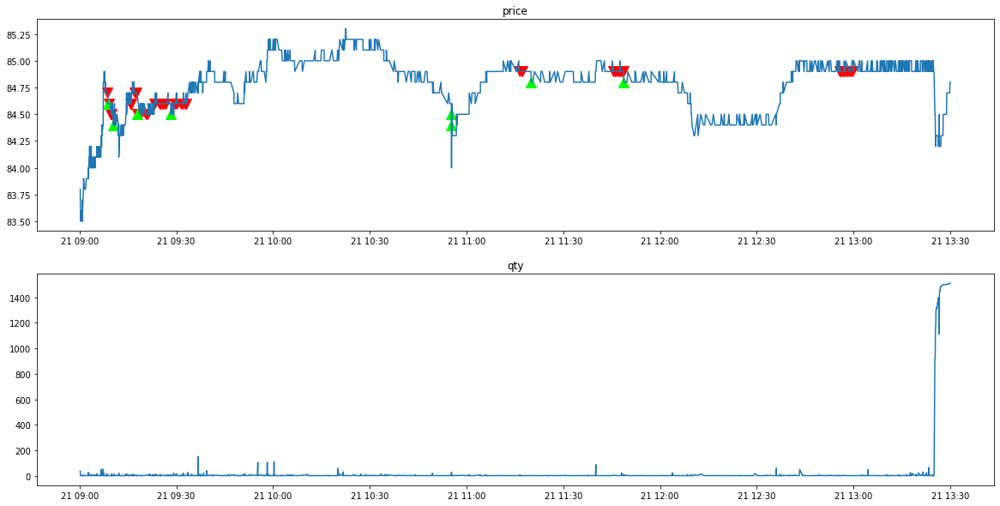

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90009477
*** bid1_p:  84.6
*** weighted_p:  84.4943661971831
ask1_p:  84.7
進場時間： 90602218 
  sell price at  84.6
stop profit
出場時間： 90602218
POSITION(pre):  [84.6]
Order_p(pre):  [84.5]
tick_row price:  84.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  85.1
*** weighted_p:  84.76588628762538
ask1_p:  85.2
進場時間： 92100470 
  sell price at  85.1
*** bid1_p:  85.1
*** weighted_p:  84.76588628762538
ask1_p:  85.2
進場時間： 92135735 
  sell price at  85.1
*** bid1_p:  85.1
*** weighted_p:  84.7692052980132
ask1_p:  85.2
進場時間： 92208479 
  sell price at  85.1
*** bid1_p:  85.1
*** weighted_p:  84.79449541284399
ask1_p:  85.2
進場時間： 92240637 
  sell price at  85.1
*** bid1_p:  85.1
*** weighted_p:  84.79969

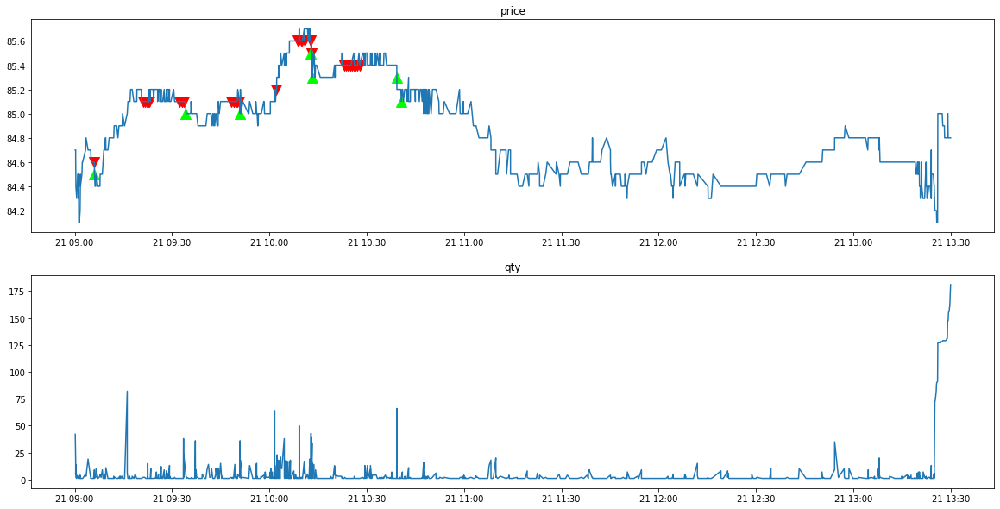

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90012655
*** bid1_p:  84.0
*** weighted_p:  83.80926365795722
ask1_p:  84.2
進場時間： 90932287 
  sell price at  84.0
stop profit
出場時間： 90933065
POSITION(pre):  [84.]
Order_p(pre):  [83.9]
tick_row price:  83.9
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 82.0
----------Result Report--------------
profit:  0.09999999999999432


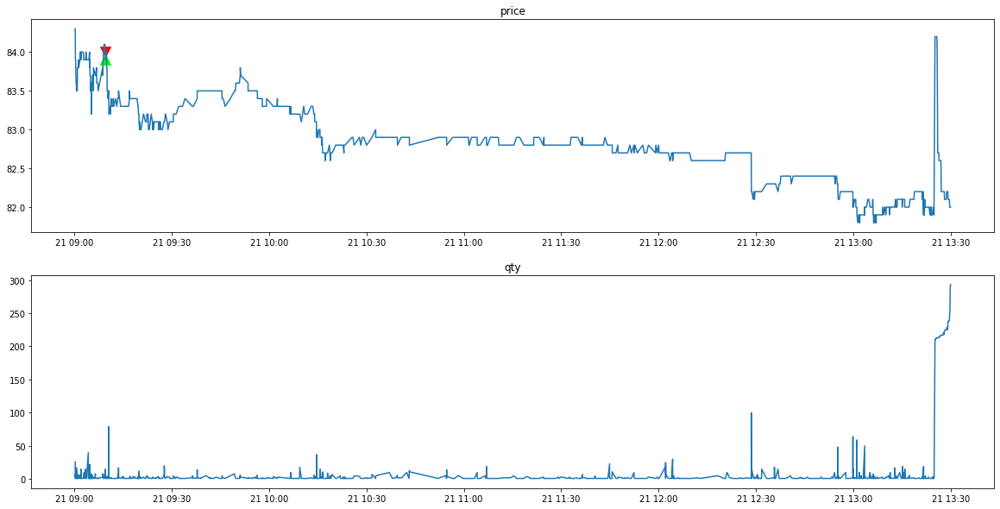

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90010404
*** bid1_p:  81.9
*** weighted_p:  81.69397031539887
ask1_p:  82.0
進場時間： 122531149 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.69397031539887
ask1_p:  82.0
進場時間： 122624377 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.69397031539887
ask1_p:  82.0
進場時間： 122703107 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.69397031539887
ask1_p:  82.0
進場時間： 122752757 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.69397031539887
ask1_p:  82.0
進場時間： 122805868 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.69435185185183
ask1_p:  82.0
進場時間： 122844292 
  sell price at  81.9
*** bid1_p:  81.9
*** weighted_p:  81.69435185185183
ask1_p:  82.0
進場時間： 122903567 
  se

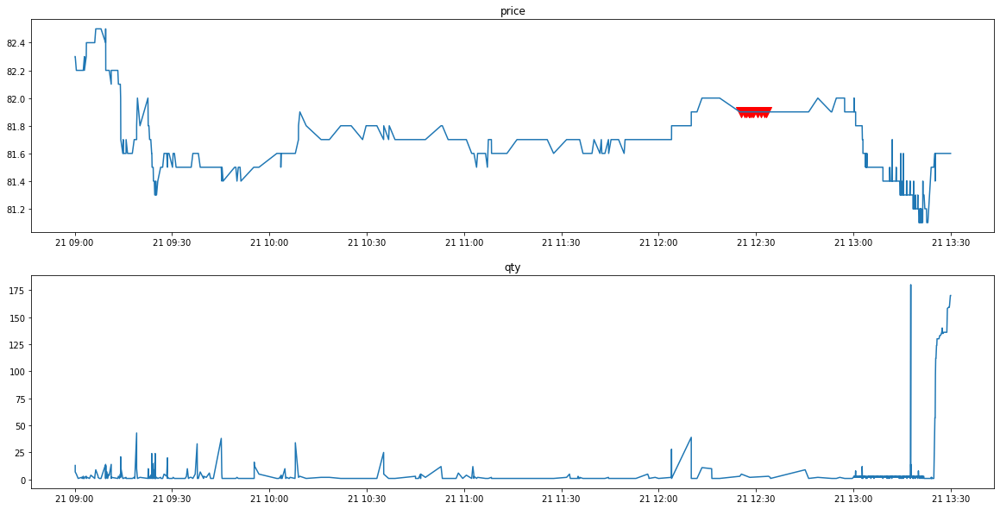

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90016352
*** bid1_p:  80.8
*** weighted_p:  80.64504504504504
ask1_p:  80.9
進場時間： 90430830 
  sell price at  80.8
stop profit
出場時間： 90503515
POSITION(pre):  [80.8]
Order_p(pre):  [80.6]
tick_row price:  80.6
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  80.2
*** weighted_p:  79.68210692727772
ask1_p:  80.3
進場時間： 122427916 
  sell price at  80.2
*** bid1_p:  80.1
*** weighted_p:  79.6822701149423
ask1_p:  80.3
進場時間： 122501995 
  sell price at  80.1
stop profit
出場時間： 122545625
POSITION(pre):  [80.2 80.1]
Order_p(pre):  [80.1 80. ]
tick_row price:  80.1
qualified index:  [[0]]
POSITION(post):  [80.1]
Order_p(post):  [80.]

*** bid1_p:  80.2
*** weighted_p:  79.68654120330746
ask1_p:  80.3
進場時間： 1

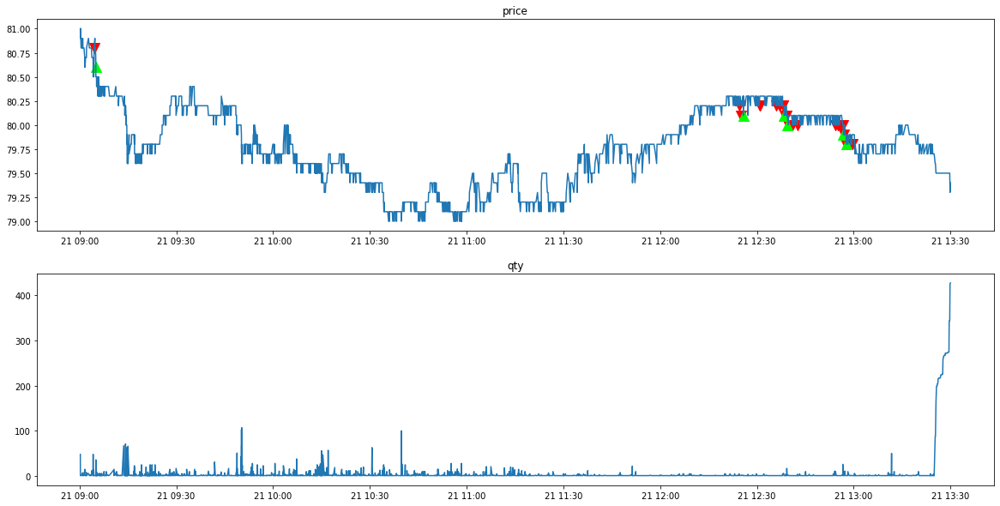

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6505/tse_lob_6505.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/6505/tse_tick_6505.csv' mode='r' encoding='UTF-8'>
90008938
*** bid1_p:  79.8
*** weighted_p:  79.63757575757575
ask1_p:  79.9
進場時間： 91140254 
  sell price at  79.8
*** bid1_p:  79.8
*** weighted_p:  79.6395209580838
ask1_p:  79.9
進場時間： 91211573 
  sell price at  79.8
*** bid1_p:  79.8
*** weighted_p:  79.64047619047616
ask1_p:  79.9
進場時間： 91247217 
  sell price at  79.8
*** bid1_p:  79.8
*** weighted_p:  79.64047619047616
ask1_p:  79.9
進場時間： 91315122 
  sell price at  79.8
*** bid1_p:  79.8
*** weighted_p:  79.64235294117643
ask1_p:  79.9
進場時間： 91347145 
  sell price at  79.8
*** bid1_p:  79.8
*** weighted_p:  79.64235294117643
ask1_p:  79.9
進場時間： 91428244 
  sell price at  79.8
*** bid1_p:  79.8
*** weighted_p:  79.65434782608692
ask1_p:  79.9
進場時間： 91459636 
  sell price

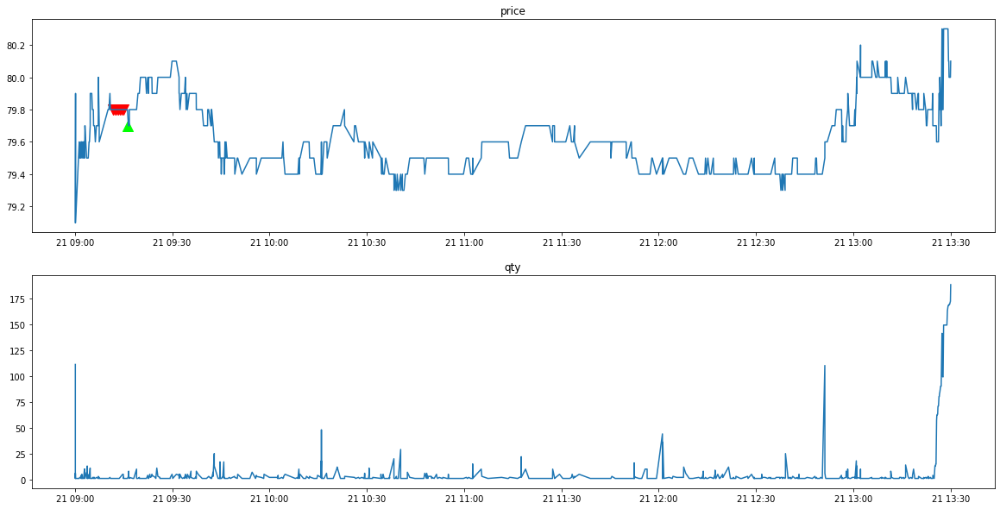

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006841
clear_position:  0.0
position:  []
tick_row_price 109.0
----------Result Report--------------
profit:  0.0


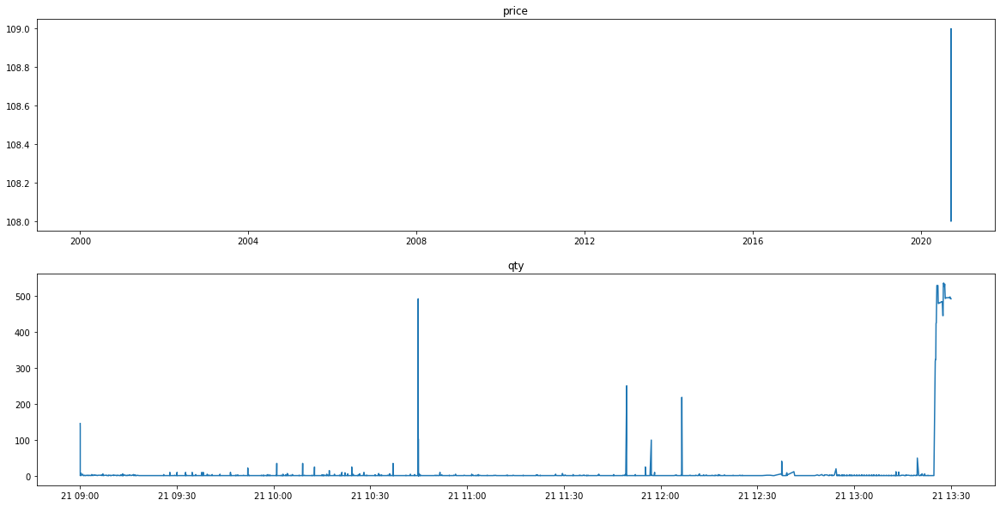

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006912
clear_position:  0.0
position:  []
tick_row_price 109.0
----------Result Report--------------
profit:  0.0


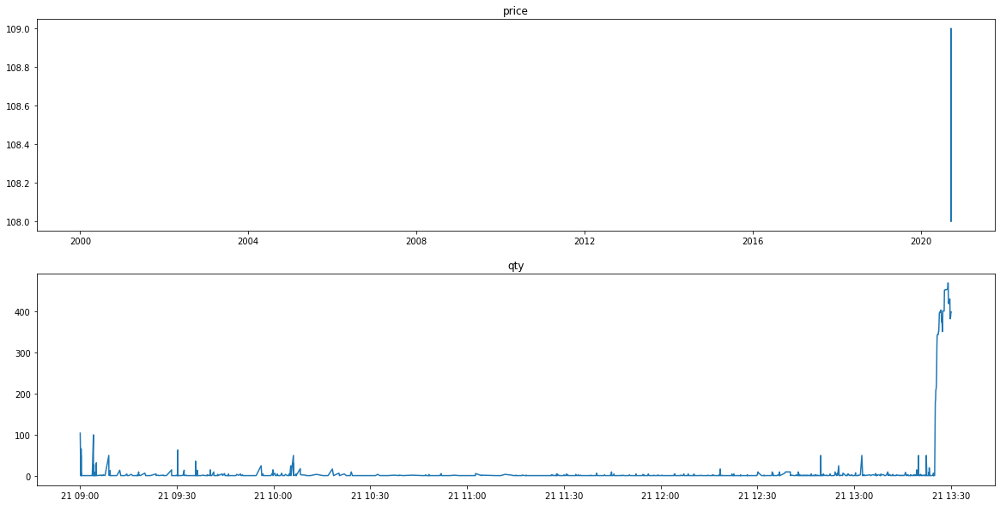

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90007800
clear_position:  0.0
position:  []
tick_row_price 108.5
----------Result Report--------------
profit:  0.0


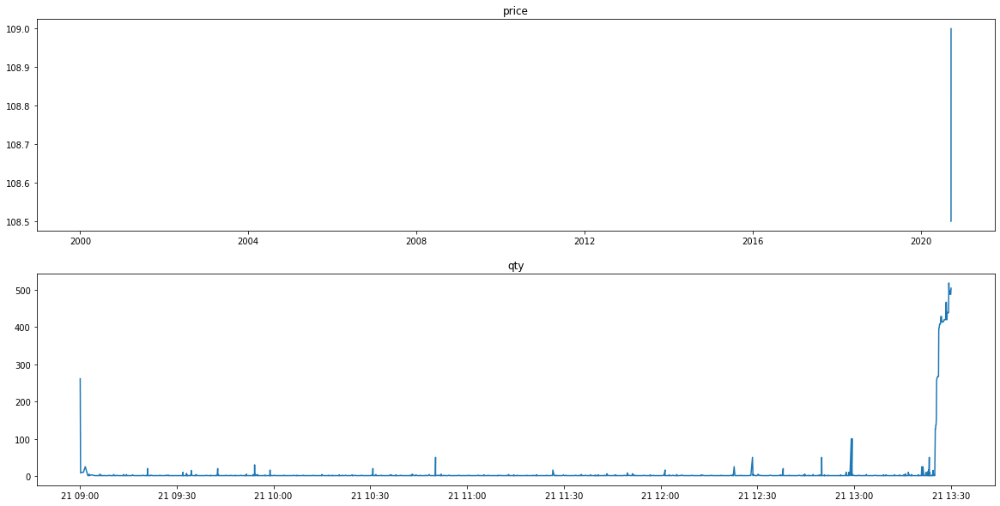

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90007745
clear_position:  0.0
position:  []
tick_row_price 108.5
----------Result Report--------------
profit:  0.0


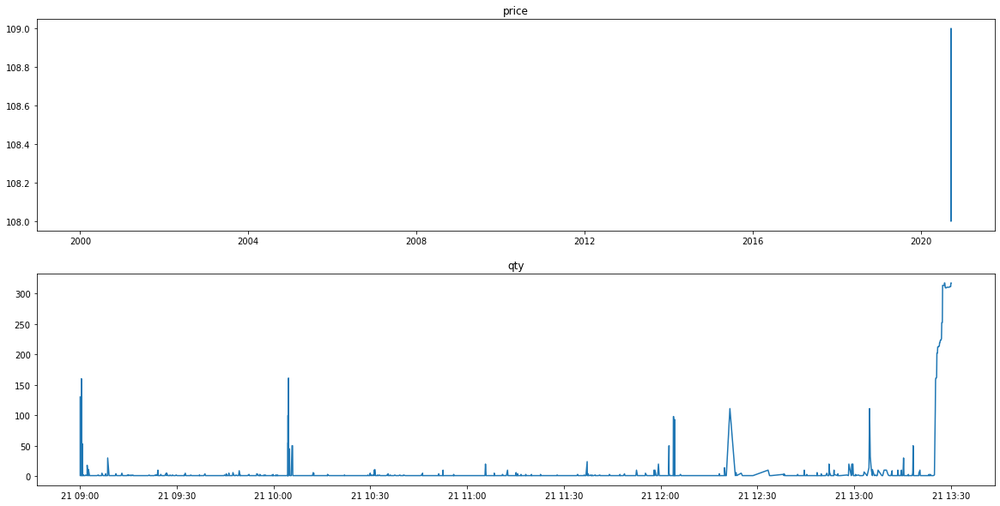

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90007275
clear_position:  0.0
position:  []
tick_row_price 108.5
----------Result Report--------------
profit:  0.0


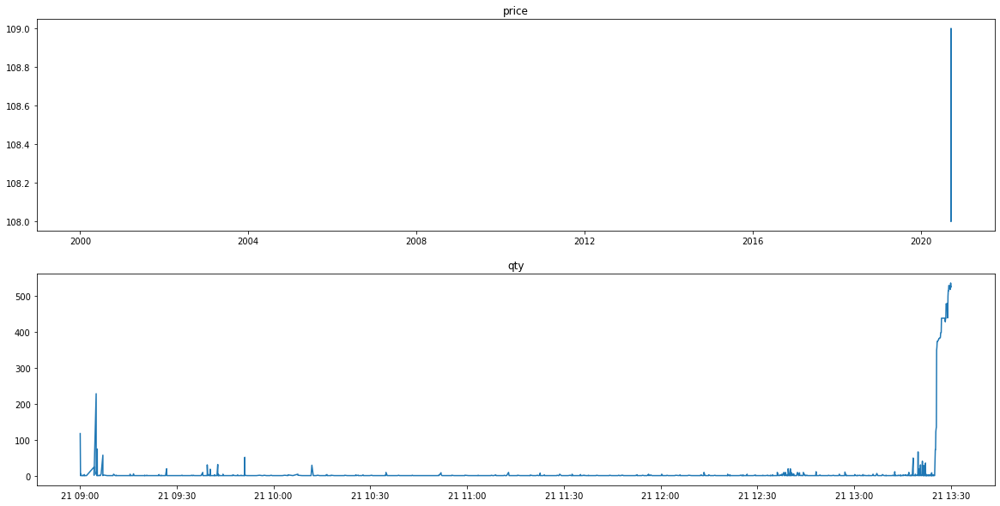

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90005916
clear_position:  0.0
position:  []
tick_row_price 109.0
----------Result Report--------------
profit:  0.0


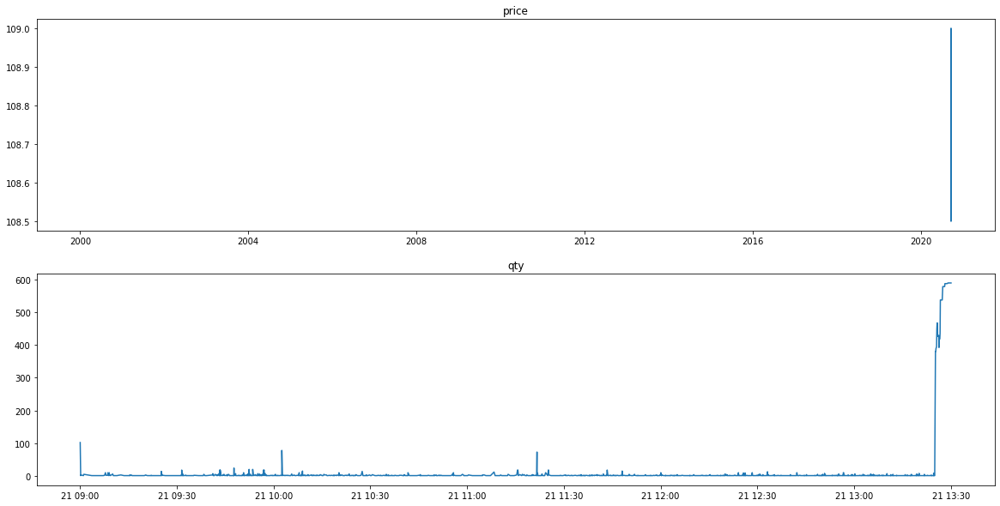

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006355
clear_position:  0.0
position:  []
tick_row_price 109.0
----------Result Report--------------
profit:  0.0


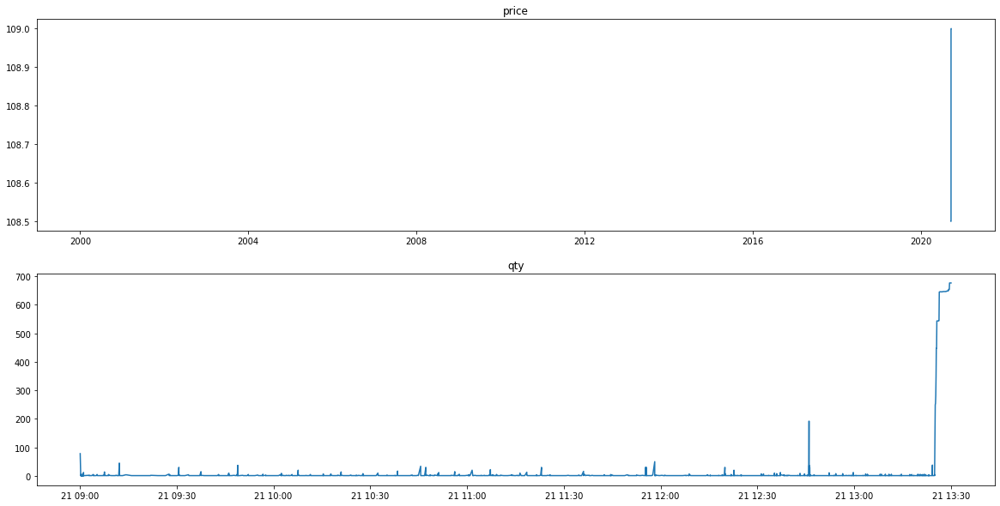

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90007479
clear_position:  0.0
position:  []
tick_row_price 108.5
----------Result Report--------------
profit:  0.0


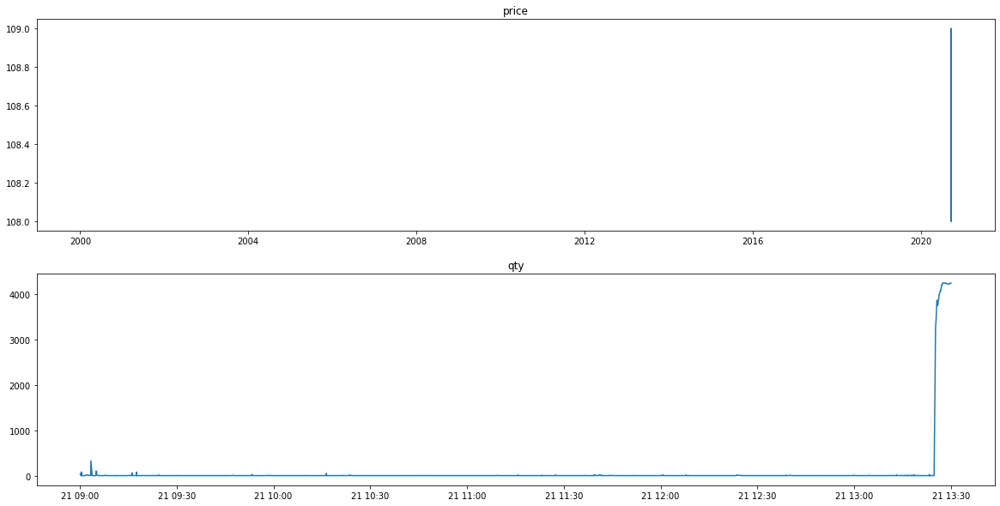

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90007382
clear_position:  0.0
position:  []
tick_row_price 109.0
----------Result Report--------------
profit:  0.0


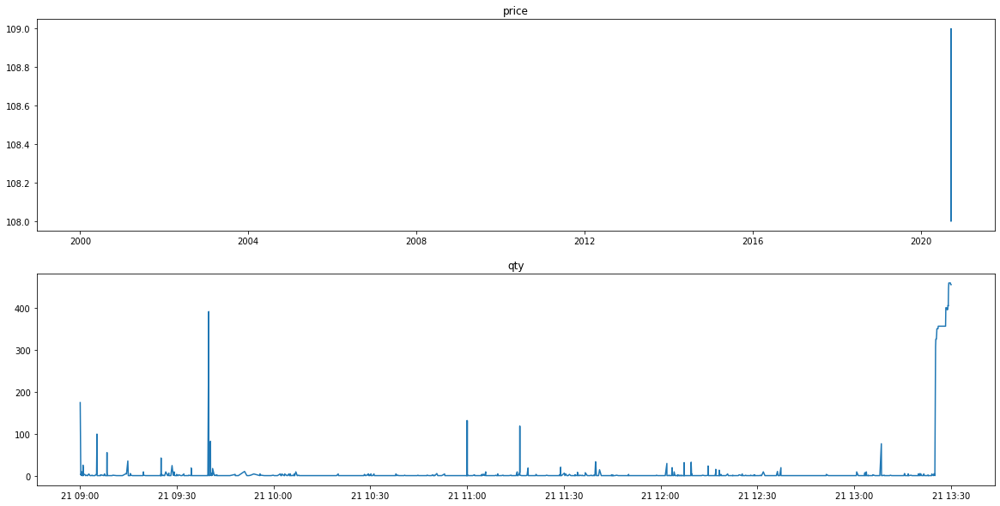

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006424
clear_position:  0.0
position:  []
tick_row_price 108.5
----------Result Report--------------
profit:  0.0


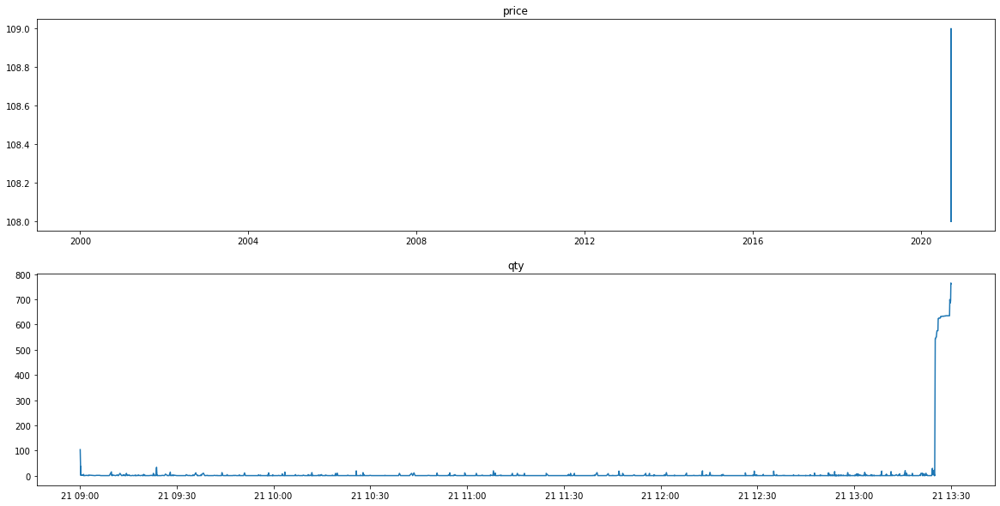

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006191
clear_position:  0.0
position:  []
tick_row_price 108.0
----------Result Report--------------
profit:  0.0


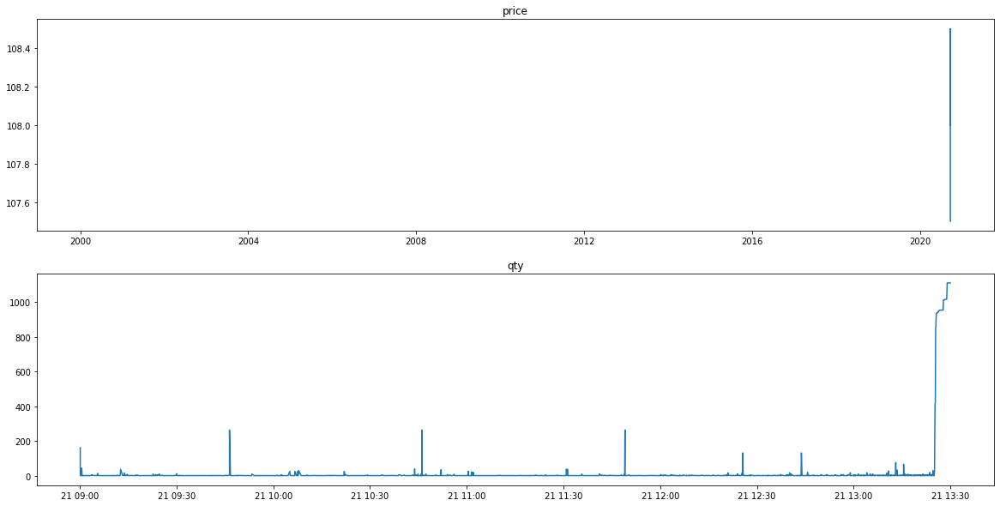

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006286
clear_position:  0.0
position:  []
tick_row_price 107.0
----------Result Report--------------
profit:  0.0


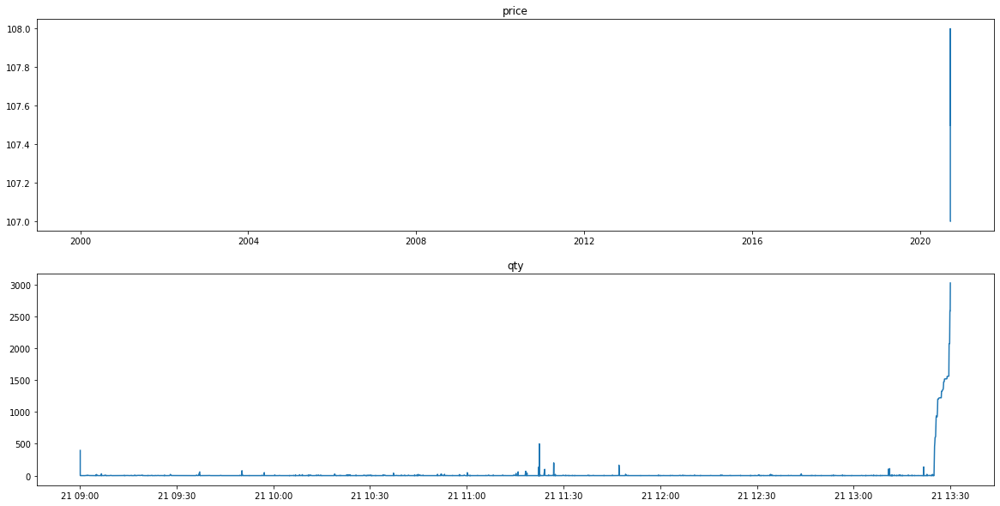

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2412/tse_lob_2412.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2412/tse_tick_2412.csv' mode='r' encoding='UTF-8'>
90006060
clear_position:  0.0
position:  []
tick_row_price 107.0
----------Result Report--------------
profit:  0.0


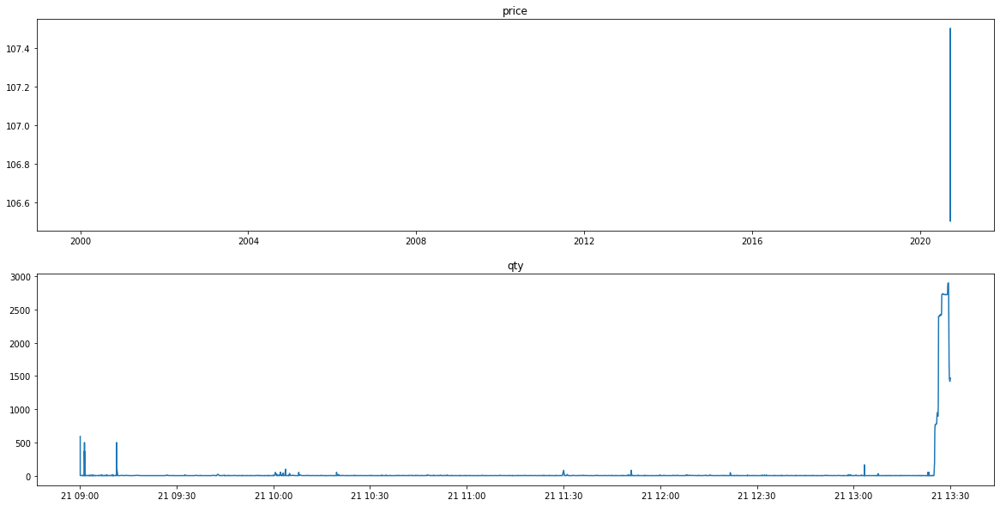

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90011511
*** bid1_p:  78.9
*** weighted_p:  78.79756097560974
ask1_p:  79.0
進場時間： 90750020 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.79999999999998
ask1_p:  79.0
進場時間： 90802865 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.81249999999997
ask1_p:  79.0
進場時間： 90849029 
  sell price at  78.9
stop profit
出場時間： 90849064
POSITION(pre):  [78.9 78.9 78.9]
Order_p(pre):  [78.8 78.8 78.8]
tick_row price:  78.8
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  78.6
*** weighted_p:  78.49976887519233
ask1_p:  78.8
進場時間： 95003263 
  sell price at  78.6
*** bid1_p:  78.6
*** weighted_p:  78.49976887519233
ask1_p:  78.8
進場時間： 95041142 
  sell price at  78.6
*** bid1_p:

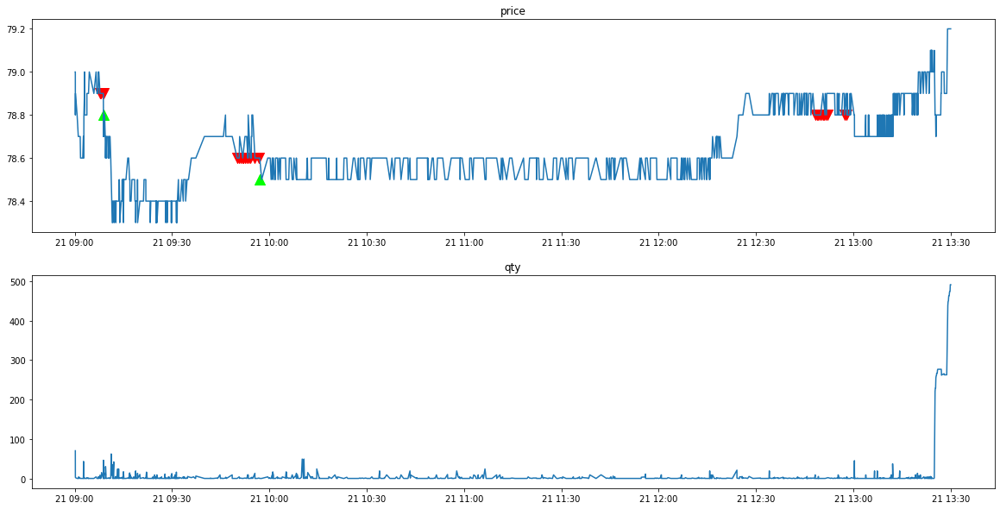

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90011329
*** bid1_p:  79.1
*** weighted_p:  78.93889695210457
ask1_p:  79.2
進場時間： 105221187 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.93901377810015
ask1_p:  79.2
進場時間： 105306147 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.9393632416788
ask1_p:  79.2
進場時間： 105350495 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.9393632416788
ask1_p:  79.2
進場時間： 105400098 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.9393632416788
ask1_p:  79.2
進場時間： 105439983 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.94028776978426
ask1_p:  79.2
進場時間： 105505994 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.94063173007906
ask1_p:  79.2
進場時間： 105550988 
  sell 

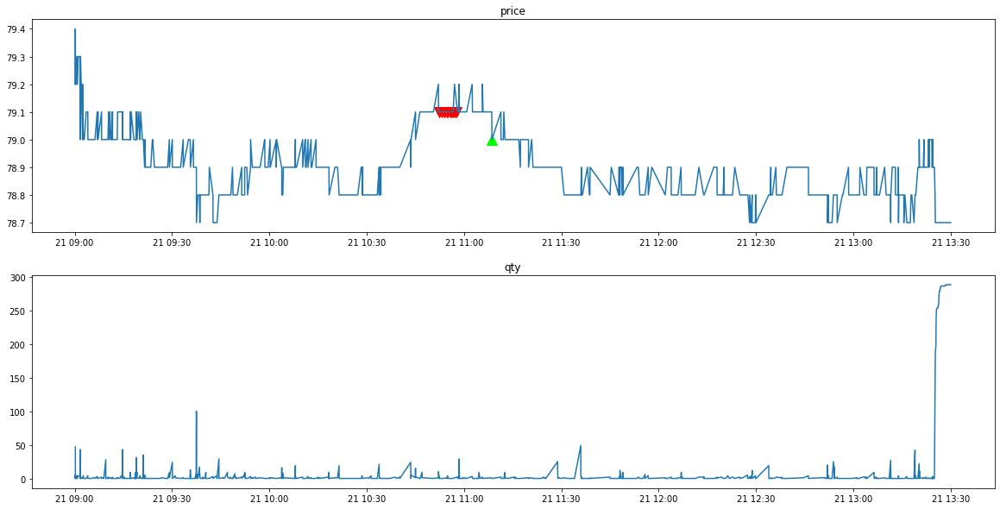

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90013368
*** bid1_p:  78.7
*** weighted_p:  78.56002066115703
ask1_p:  79.0
進場時間： 113629818 
  sell price at  78.7
stop profit
出場時間： 113647200
POSITION(pre):  [78.7]
Order_p(pre):  [78.6]
tick_row price:  78.6
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  78.7
*** weighted_p:  78.56177800100453
ask1_p:  78.8
進場時間： 113753274 
  sell price at  78.7
stop profit
出場時間： 114122134
POSITION(pre):  [78.7]
Order_p(pre):  [78.5]
tick_row price:  78.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 78.3
----------Result Report--------------
profit:  0.30000000000001137


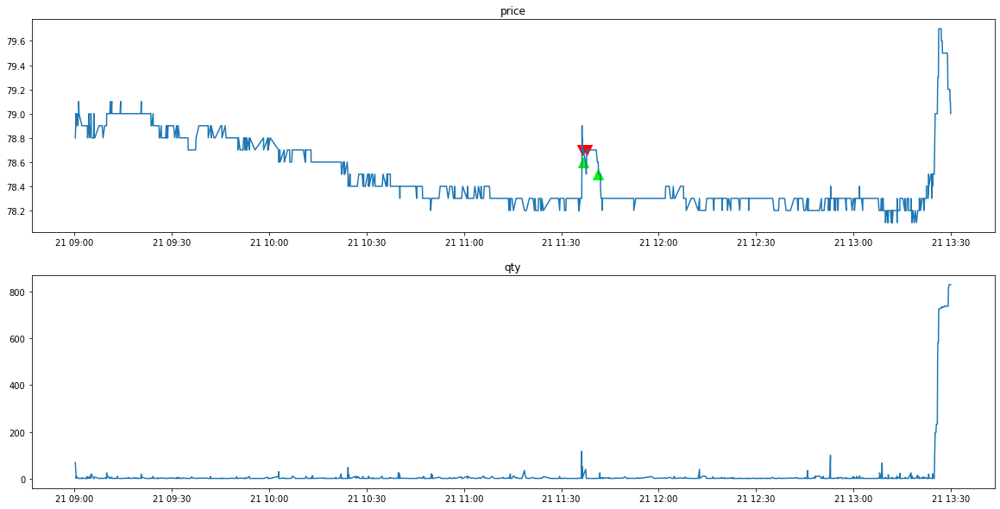

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90012136
*** bid1_p:  79.2
*** weighted_p:  79.07671232876713
ask1_p:  79.3
進場時間： 90233248 
  sell price at  79.2
stop profit
出場時間： 90233248
POSITION(pre):  [79.2]
Order_p(pre):  [79.]
tick_row price:  79.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  79.2
*** weighted_p:  79.00501319261218
ask1_p:  79.3
進場時間： 104000802 
  sell price at  79.2
*** bid1_p:  79.2
*** weighted_p:  79.00569675723054
ask1_p:  79.3
進場時間： 104031392 
  sell price at  79.2
*** bid1_p:  79.2
*** weighted_p:  79.00969957081549
ask1_p:  79.3
進場時間： 104100176 
  sell price at  79.2
*** bid1_p:  79.2
*** weighted_p:  79.01131914893618
ask1_p:  79.3
進場時間： 104131515 
  sell price at  79.2
stop profit
出場時間： 104340031
POSITION(p

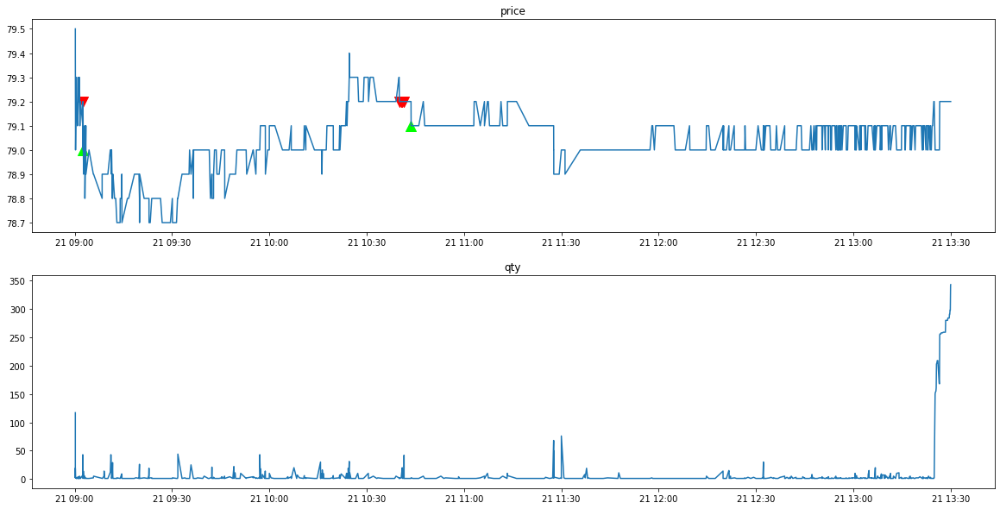

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90012290
*** bid1_p:  78.9
*** weighted_p:  78.81552478134091
ask1_p:  79.0
進場時間： 120158891 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.81552478134091
ask1_p:  79.0
進場時間： 120208265 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.81722900215341
ask1_p:  79.0
進場時間： 120900248 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.81781895937256
ask1_p:  79.0
進場時間： 120943671 
  sell price at  78.9
stop profit
出場時間： 123732842
POSITION(pre):  [78.9 78.9 78.9 78.9]
Order_p(pre):  [78.8 78.8 78.8 78.8]
tick_row price:  78.8
qualified index:  [[0]
 [1]
 [2]
 [3]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 78.8
----------Result Report--------------
pro

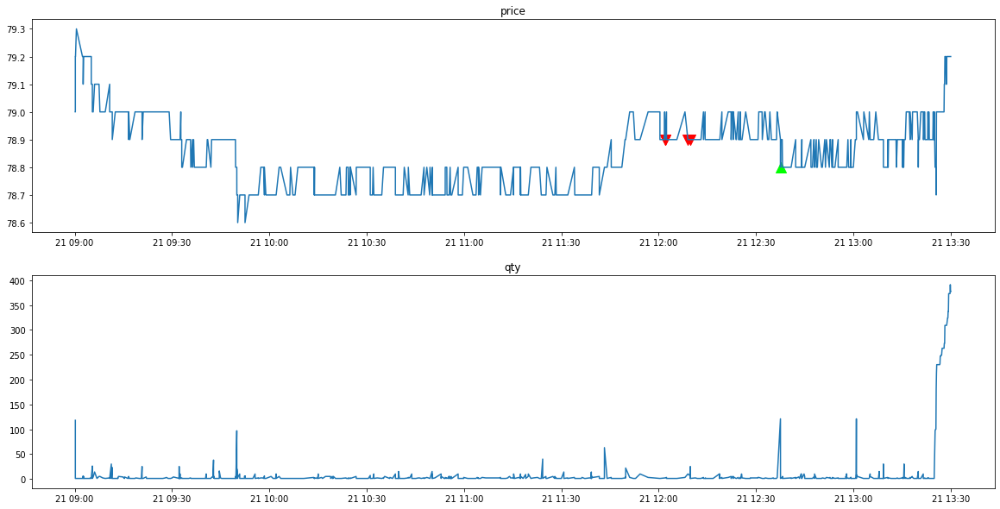

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90012153
*** bid1_p:  79.1
*** weighted_p:  78.99862258953202
ask1_p:  79.2
進場時間： 124306855 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  78.99882075471733
ask1_p:  79.2
進場時間： 124343172 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  79.00116054158642
ask1_p:  79.2
進場時間： 124624042 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  79.0015817901238
ask1_p:  79.2
進場時間： 124659934 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  79.0016955684011
ask1_p:  79.2
進場時間： 124700305 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  79.00184757505808
ask1_p:  79.2
進場時間： 124733760 
  sell price at  79.1
*** bid1_p:  79.1
*** weighted_p:  79.01175632347734
ask1_p:  79.2
進場時間： 125718094 
  sell

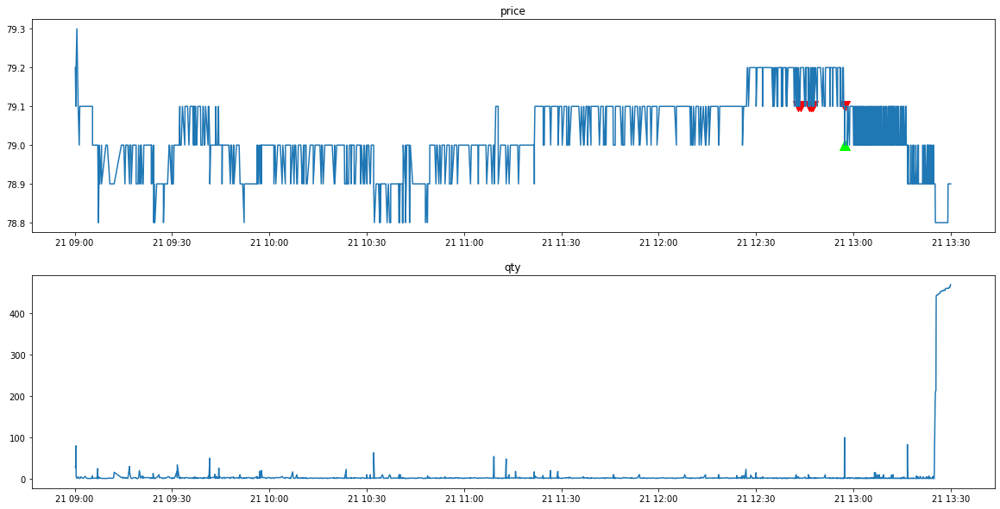

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90011031
clear_position:  0.0
position:  []
tick_row_price 78.3
----------Result Report--------------
profit:  0.0


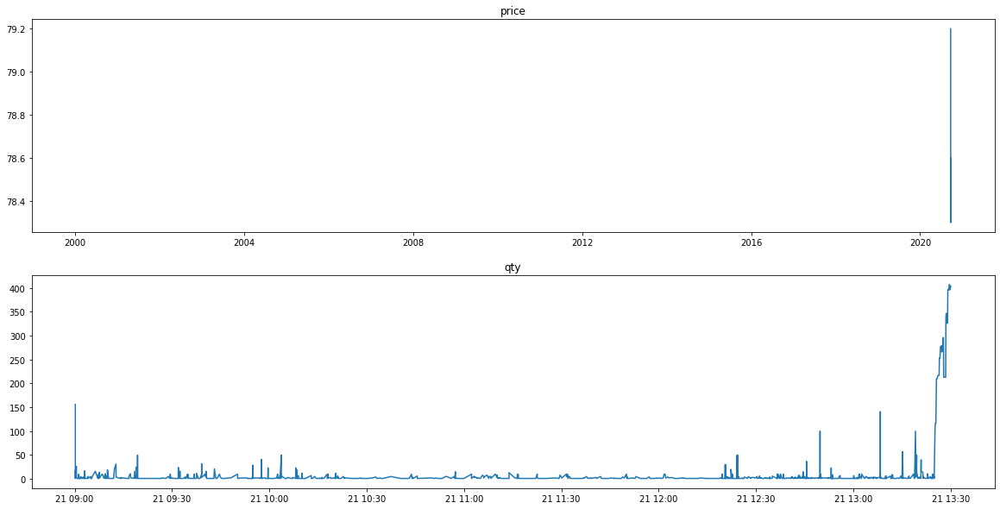

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90012499
*** bid1_p:  79.8
*** weighted_p:  79.70026954177905
ask1_p:  79.9
進場時間： 90207042 
  sell price at  79.8
*** bid1_p:  80.1
*** weighted_p:  79.87325581395349
ask1_p:  80.2
進場時間： 90315684 
  sell price at  80.1
*** bid1_p:  80.5
*** weighted_p:  80.0043360433604
ask1_p:  80.8
進場時間： 90349079 
  sell price at  80.5
*** bid1_p:  80.7
*** weighted_p:  80.09540322580641
ask1_p:  81.0
進場時間： 90400089 
  sell price at  80.7
------Weird price!!!!!---------
At time:  90429722
tick_row_price 81.0
ask_1_p 81.1
bid_1_p 80.9
*** bid1_p:  81.0
*** weighted_p:  80.29131561892414
ask1_p:  81.1
進場時間： 90430333 
  sell price at  81.0
stop profit
出場時間： 90458208
POSITION(pre):  [79.8 80.1 80.5 80.7 81. ]
Order_p(pre):  [79.7 80.  80.4 80

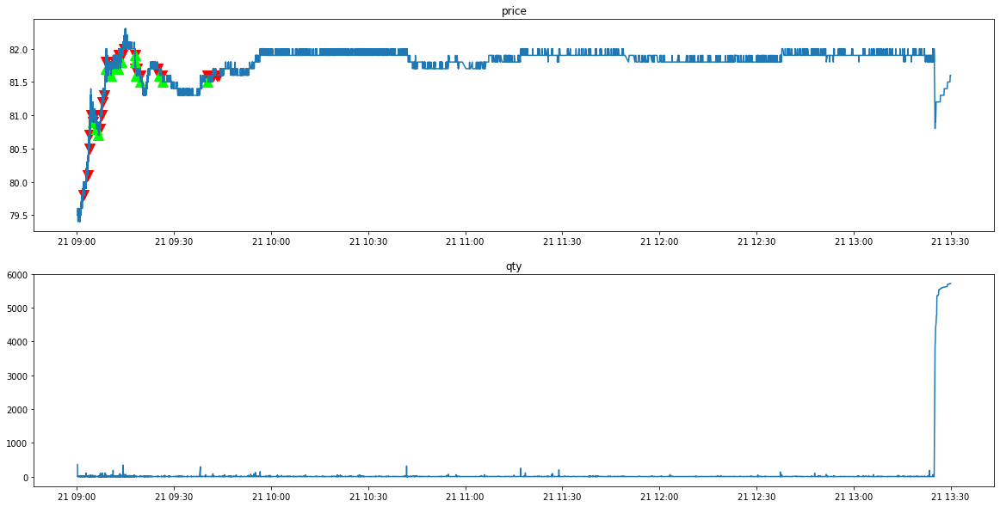

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90001766
*** bid1_p:  82.4
*** weighted_p:  82.3172
ask1_p:  82.5
進場時間： 90200008 
  sell price at  82.4
*** bid1_p:  82.6
*** weighted_p:  82.43188854489163
ask1_p:  82.7
進場時間： 90322995 
  sell price at  82.6
*** bid1_p:  82.8
*** weighted_p:  82.51526627218936
ask1_p:  82.9
進場時間： 90356114 
  sell price at  82.8
stop profit
出場時間： 90359874
POSITION(pre):  [82.4 82.6 82.8]
Order_p(pre):  [82.3 82.5 82.7]
tick_row price:  82.7
qualified index:  [[2]]
POSITION(post):  [82.4 82.6]
Order_p(post):  [82.3 82.5]

*** bid1_p:  82.7
*** weighted_p:  82.51859649122808
ask1_p:  82.8
進場時間： 90400099 
  sell price at  82.7
*** bid1_p:  82.8
*** weighted_p:  82.56481481481492
ask1_p:  82.9
進場時間： 90449070 
  sell price at  82.8
stop profit
出

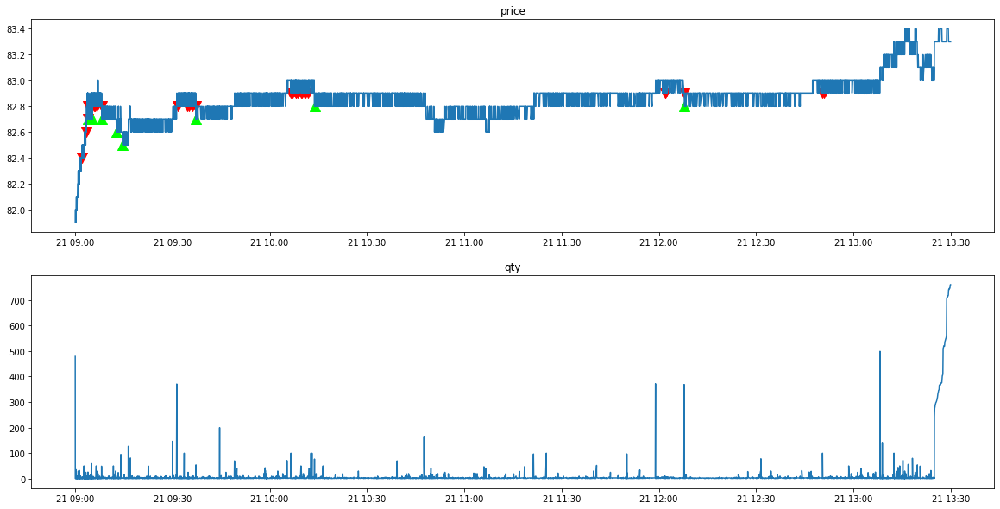

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90003619
*** bid1_p:  82.8
*** weighted_p:  82.55940594059405
ask1_p:  82.9
進場時間： 90600337 
  sell price at  82.8
stop profit
出場時間： 90600337
POSITION(pre):  [82.8]
Order_p(pre):  [82.7]
tick_row price:  82.7
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  82.1
*** weighted_p:  82.00351067680067
ask1_p:  82.2
進場時間： 93821623 
  sell price at  82.1
*** bid1_p:  82.1
*** weighted_p:  82.00378924575975
ask1_p:  82.2
進場時間： 93851752 
  sell price at  82.1
stop profit
出場時間： 93854759
POSITION(pre):  [82.1 82.1]
Order_p(pre):  [82. 82.]
tick_row price:  82.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  82.1
*** weighted_p:  82.01201353637914
ask1_p:  82.2
進場時間： 9431487

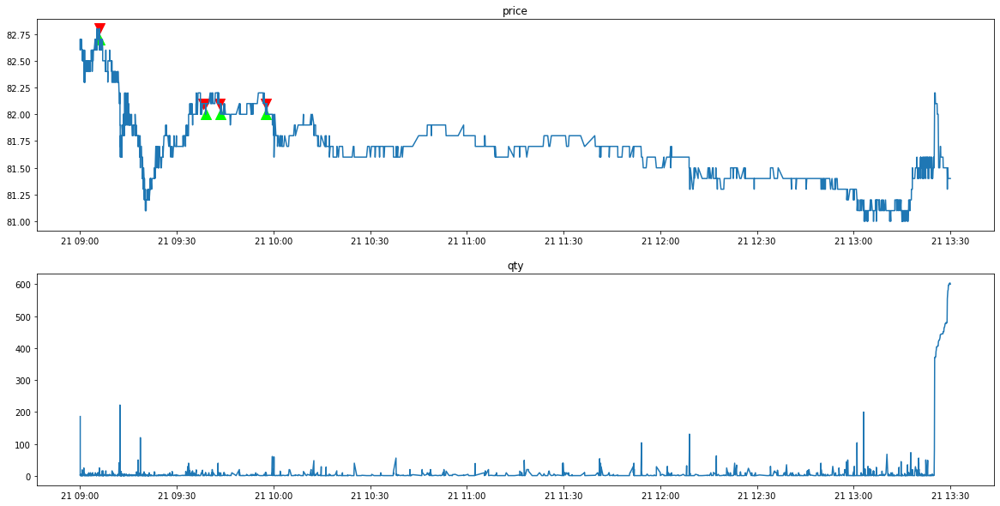

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90005586
clear_position:  0.0
position:  []
tick_row_price 80.3
----------Result Report--------------
profit:  0.0


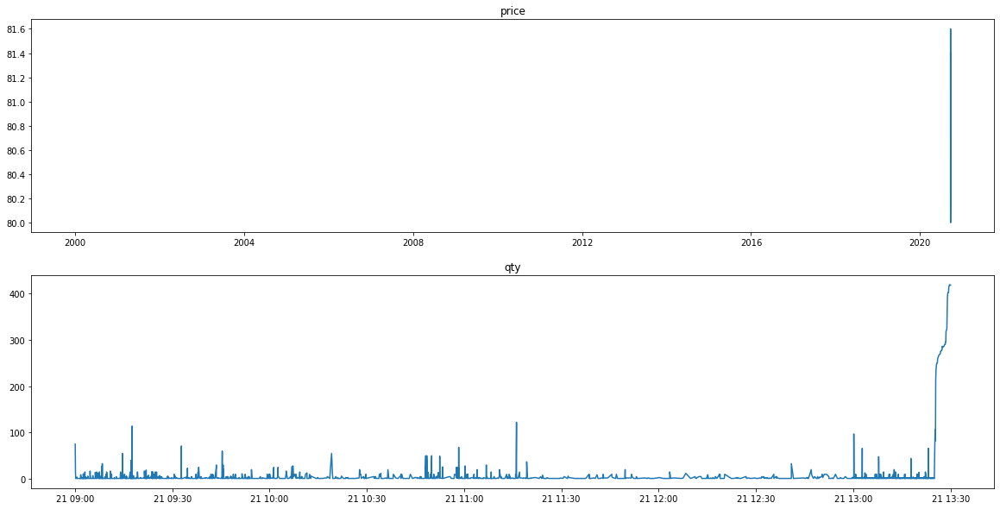

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90008320
*** bid1_p:  79.1
*** weighted_p:  78.97837837837838
ask1_p:  79.2
進場時間： 90318889 
  sell price at  79.1
stop profit
出場時間： 90318889
POSITION(pre):  [79.1]
Order_p(pre):  [79.]
tick_row price:  79.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  78.9
*** weighted_p:  78.7837560712359
ask1_p:  79.0
進場時間： 92128106 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.78882476390349
ask1_p:  79.0
進場時間： 92253185 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.78894129979038
ask1_p:  79.0
進場時間： 92301320 
  sell price at  78.9
*** bid1_p:  79.2
*** weighted_p:  78.8338180112571
ask1_p:  79.3
進場時間： 92902122 
  sell price at  79.2
*** bid1_p:  79.2
*** weighted_p:  78.839556

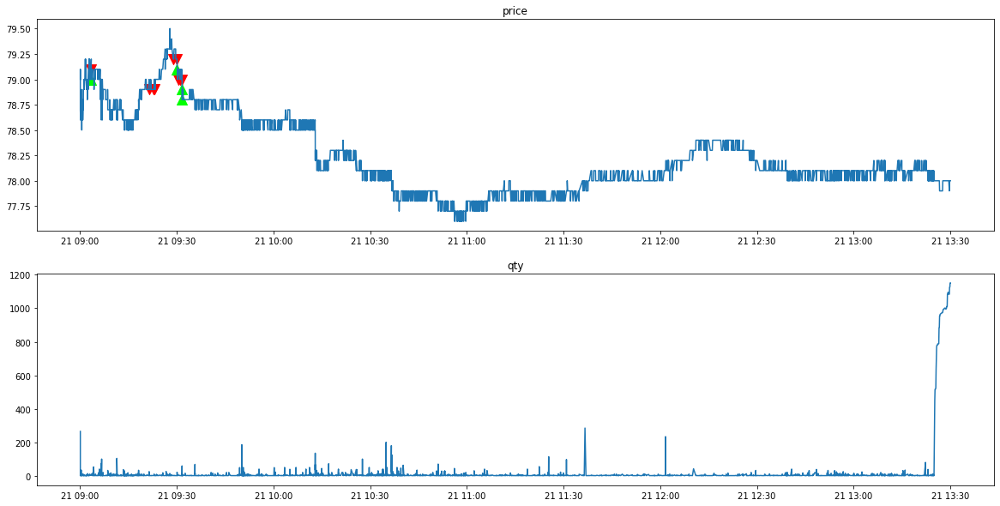

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1301/tse_lob_1301.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1301/tse_tick_1301.csv' mode='r' encoding='UTF-8'>
90005328
*** bid1_p:  78.7
*** weighted_p:  78.55471406491503
ask1_p:  78.8
進場時間： 92127450 
  sell price at  78.7
*** bid1_p:  78.8
*** weighted_p:  78.5920377867747
ask1_p:  78.9
進場時間： 92421878 
  sell price at  78.8
*** bid1_p:  78.8
*** weighted_p:  78.5939678284183
ask1_p:  78.9
進場時間： 92454684 
  sell price at  78.8
*** bid1_p:  78.9
*** weighted_p:  78.64485875706221
ask1_p:  79.0
進場時間： 93018842 
  sell price at  78.9
*** bid1_p:  78.9
*** weighted_p:  78.66589716684159
ask1_p:  79.0
進場時間： 93308034 
  sell price at  78.9
stop profit
出場時間： 93310598
POSITION(pre):  [78.7 78.8 78.8 78.9 78.9]
Order_p(pre):  [78.6 78.7 78.7 78.8 78.8]
tick_row price:  78.8
qualified index:  [[3]
 [4]]
POSITION(post):  [78.7 78.8 78.8]
Orde

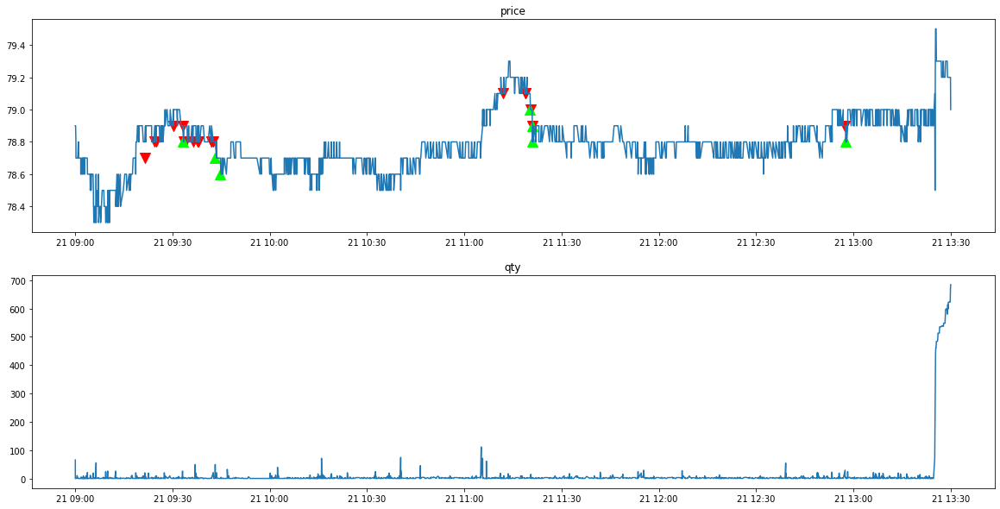

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90007042
*** bid1_p:  69.7
*** weighted_p:  69.58406480117819
ask1_p:  69.8
進場時間： 125445760 
  sell price at  69.7
*** bid1_p:  69.7
*** weighted_p:  69.58447314352803
ask1_p:  69.8
進場時間： 125509455 
  sell price at  69.7
stop profit
出場時間： 125515789
POSITION(pre):  [69.7 69.7]
Order_p(pre):  [69.6 69.6]
tick_row price:  69.6
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 69.6
----------Result Report--------------
profit:  0.20000000000001705


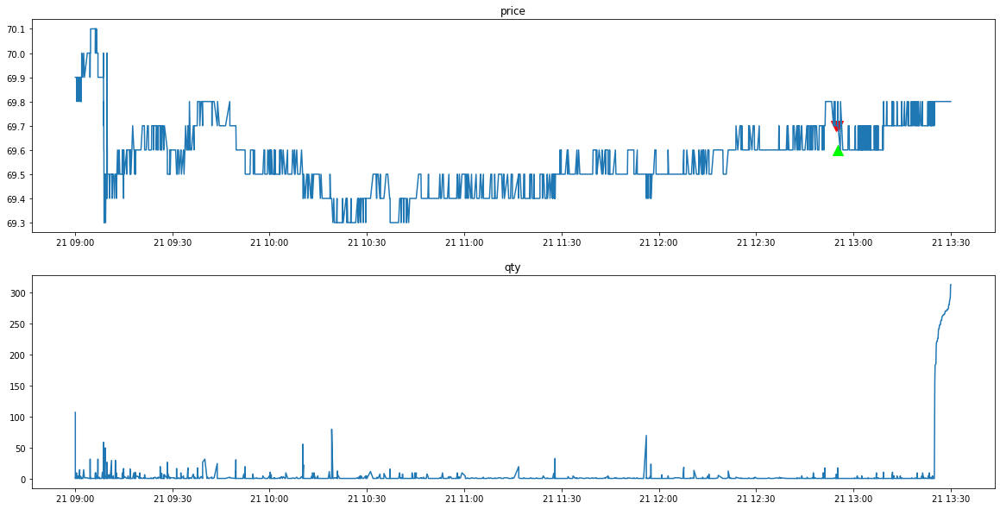

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90010928
clear_position:  0.0
position:  []
tick_row_price 69.2
----------Result Report--------------
profit:  0.0


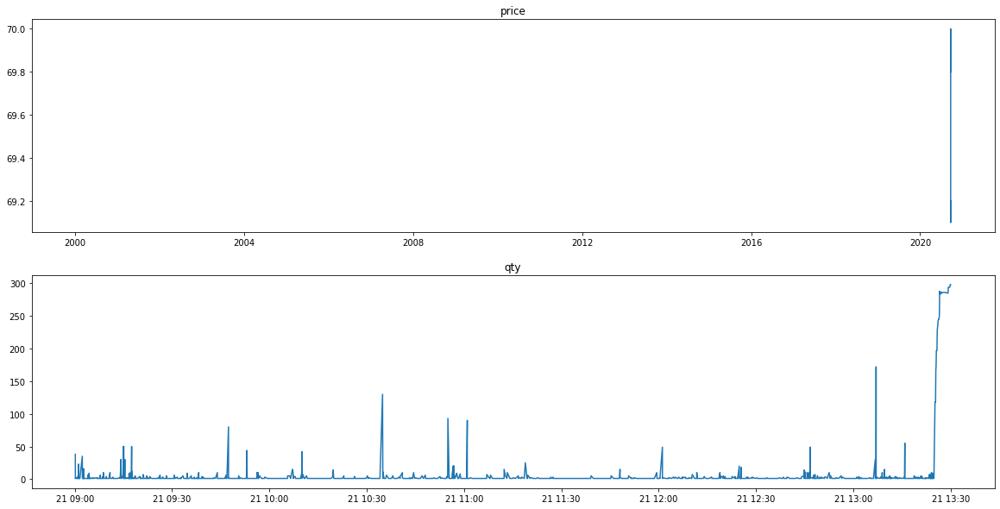

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90013770
*** bid1_p:  69.2
*** weighted_p:  69.09935691318331
ask1_p:  69.3
進場時間： 92205672 
  sell price at  69.2
stop profit
出場時間： 92205672
POSITION(pre):  [69.2]
Order_p(pre):  [69.1]
tick_row price:  69.1
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 68.2
----------Result Report--------------
profit:  0.10000000000000853


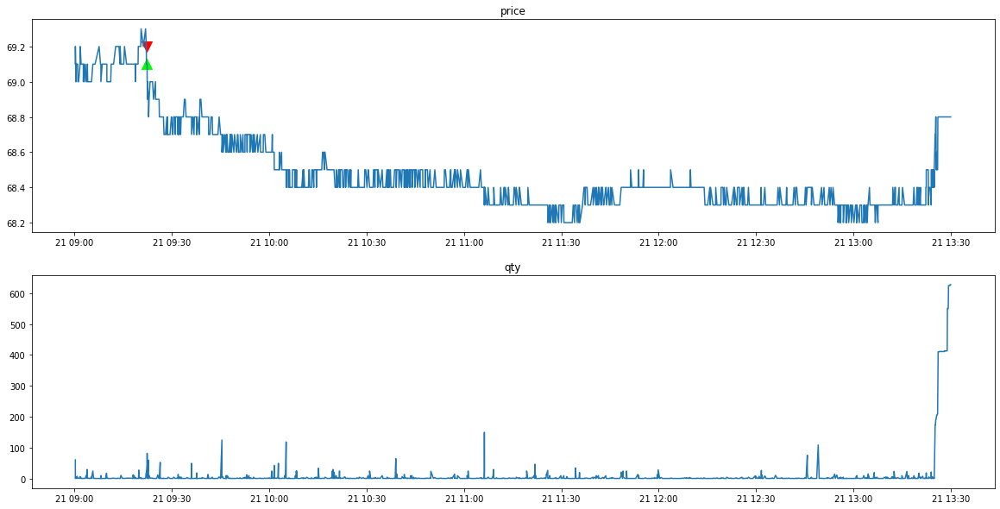

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90011159
clear_position:  0.0
position:  []
tick_row_price 68.1
----------Result Report--------------
profit:  0.0


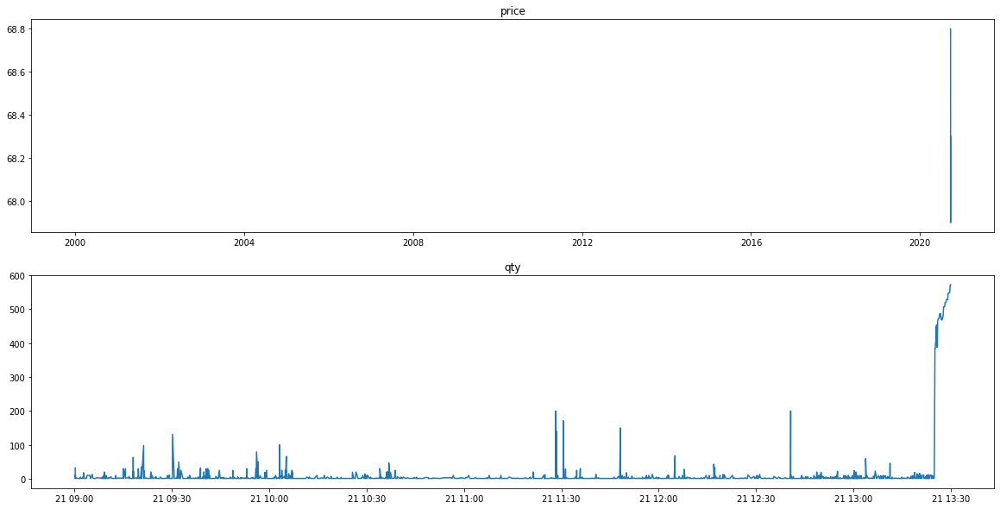

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90008679
clear_position:  0.0
position:  []
tick_row_price 67.9
----------Result Report--------------
profit:  0.0


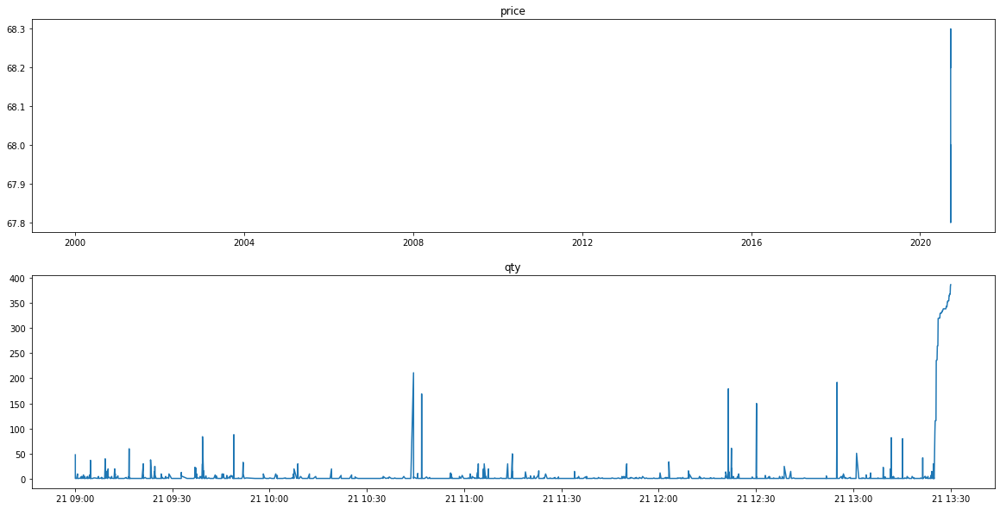

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90009530
*** bid1_p:  68.0
*** weighted_p:  67.91185628742521
ask1_p:  68.1
進場時間： 93809595 
  sell price at  68.0
*** bid1_p:  68.0
*** weighted_p:  67.91273809523815
ask1_p:  68.1
進場時間： 93845538 
  sell price at  68.0
*** bid1_p:  68.0
*** weighted_p:  67.915260115607
ask1_p:  68.1
進場時間： 93901558 
  sell price at  68.0
*** bid1_p:  68.0
*** weighted_p:  67.91566820276503
ask1_p:  68.1
進場時間： 93931657 
  sell price at  68.0
*** bid1_p:  68.0
*** weighted_p:  67.91947194719476
ask1_p:  68.1
進場時間： 94001078 
  sell price at  68.0
*** bid1_p:  68.0
*** weighted_p:  67.92086486486491
ask1_p:  68.1
進場時間： 94033658 
  sell price at  68.0
*** bid1_p:  68.1
*** weighted_p:  67.96317829457381
ask1_p:  68.2
進場時間： 100353748 
  sell price

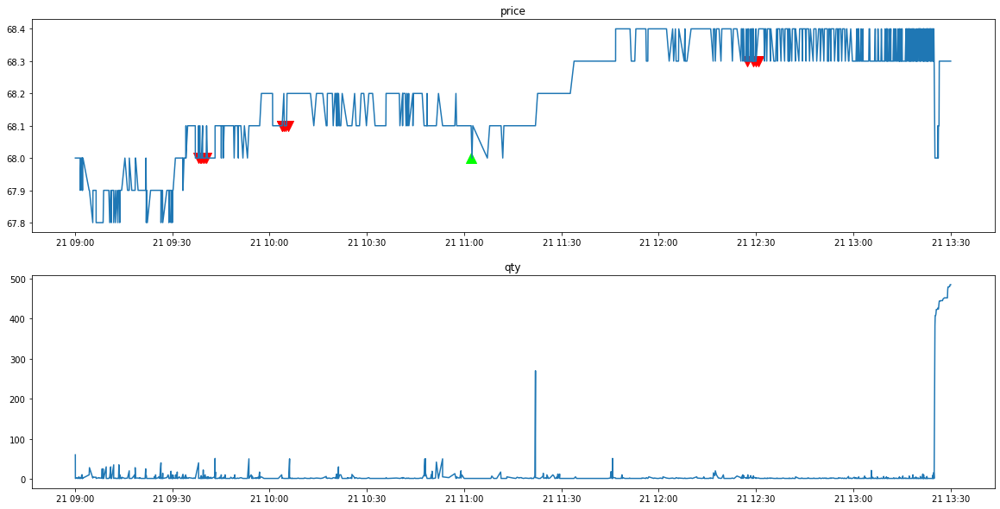

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90010831
*** bid1_p:  68.3
*** weighted_p:  68.07587628865977
ask1_p:  68.4
進場時間： 94430835 
  sell price at  68.3
*** bid1_p:  68.3
*** weighted_p:  68.07687564234324
ask1_p:  68.4
進場時間： 94502575 
  sell price at  68.3
*** bid1_p:  68.3
*** weighted_p:  68.07753846153842
ask1_p:  68.4
進場時間： 94533945 
  sell price at  68.3
stop profit
出場時間： 94739129
POSITION(pre):  [68.3 68.3 68.3]
Order_p(pre):  [68.2 68.2 68.2]
tick_row price:  68.2
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  68.3
*** weighted_p:  68.08378109452731
ask1_p:  68.4
進場時間： 94739129 
  sell price at  68.3
stop profit
出場時間： 94739129
POSITION(pre):  [68.3]
Order_p(pre):  [68.2]
tick_row price:  68.2
qualified index:  [[0]

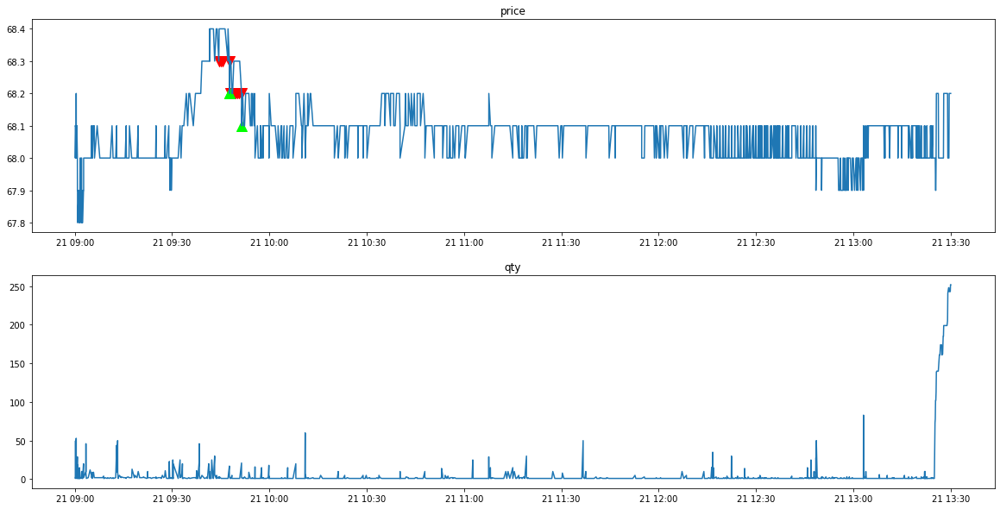

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90011696
*** bid1_p:  68.6
*** weighted_p:  68.48674698795182
ask1_p:  68.7
進場時間： 90300304 
  sell price at  68.6
stop profit
出場時間： 90305990
POSITION(pre):  [68.6]
Order_p(pre):  [68.5]
tick_row price:  68.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  68.6
*** weighted_p:  68.50082644628101
ask1_p:  68.7
進場時間： 90330544 
  sell price at  68.6
stop profit
出場時間： 90333044
POSITION(pre):  [68.6]
Order_p(pre):  [68.5]
tick_row price:  68.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  69.0
*** weighted_p:  68.69158316633266
ask1_p:  69.1
進場時間： 90524110 
  sell price at  69.0
*** bid1_p:  69.0
*** weighted_p:  68.73492063492061
ask1_p:  69.1
進場時間： 90614126 
  sell pri

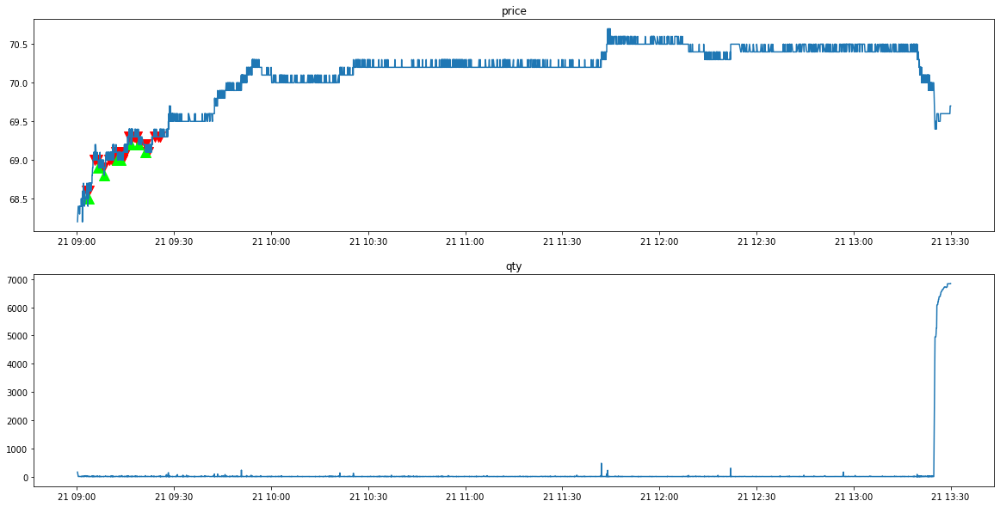

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90005376
*** bid1_p:  70.4
*** weighted_p:  70.28700696055685
ask1_p:  70.5
進場時間： 90529079 
  sell price at  70.4
*** bid1_p:  70.4
*** weighted_p:  70.30613496932519
ask1_p:  70.5
進場時間： 90700945 
  sell price at  70.4
*** bid1_p:  70.4
*** weighted_p:  70.30996015936259
ask1_p:  70.5
進場時間： 90731103 
  sell price at  70.4
*** bid1_p:  70.4
*** weighted_p:  70.32455830388699
ask1_p:  70.5
進場時間： 90902949 
  sell price at  70.4
*** bid1_p:  70.4
*** weighted_p:  70.32613240418125
ask1_p:  70.5
進場時間： 90934126 
  sell price at  70.4
*** bid1_p:  70.4
*** weighted_p:  70.32651646447148
ask1_p:  70.5
進場時間： 91004647 
  sell price at  70.4
*** bid1_p:  70.4
*** weighted_p:  70.3287394957984
ask1_p:  70.5
進場時間： 91034710 
  sell price

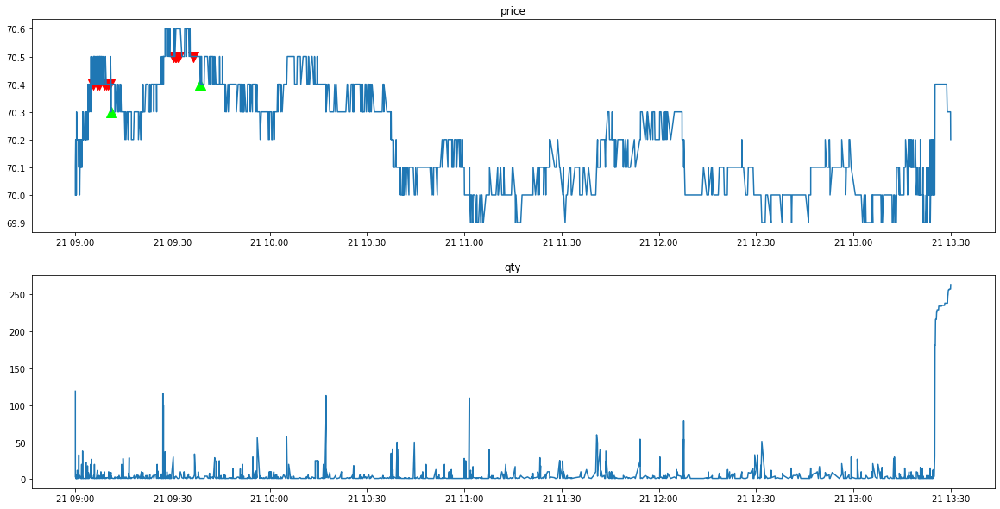

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90008840
*** bid1_p:  69.2
*** weighted_p:  69.095067264574
ask1_p:  69.3
進場時間： 90755050 
  sell price at  69.2
*** bid1_p:  69.2
*** weighted_p:  69.095067264574
ask1_p:  69.3
進場時間： 90801747 
  sell price at  69.2
*** bid1_p:  69.2
*** weighted_p:  69.09735099337749
ask1_p:  69.3
進場時間： 90835896 
  sell price at  69.2
stop profit
出場時間： 91011313
POSITION(pre):  [69.2 69.2 69.2]
Order_p(pre):  [69.1 69.1 69.1]
tick_row price:  69.1
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 68.5
----------Result Report--------------
profit:  0.3000000000000256


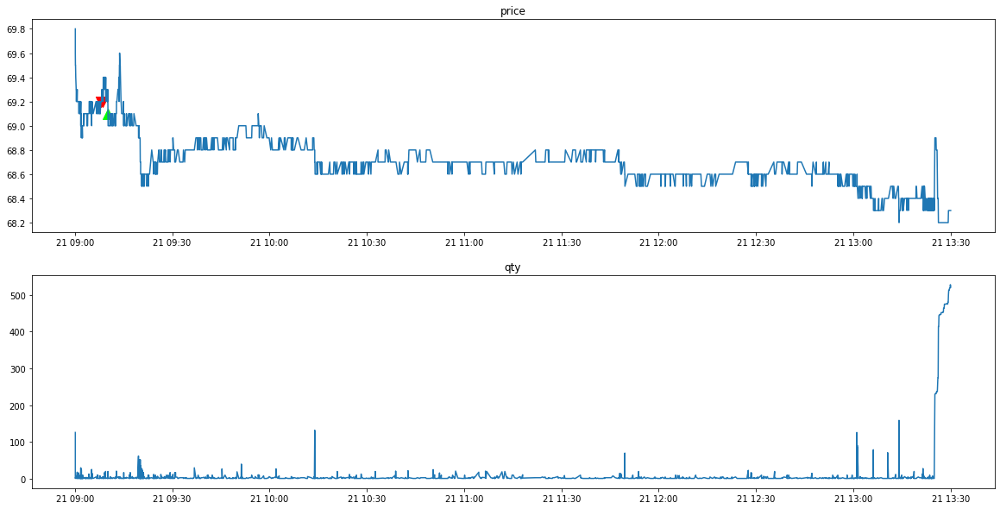

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90008598
clear_position:  0.0
position:  []
tick_row_price 68.0
----------Result Report--------------
profit:  0.0


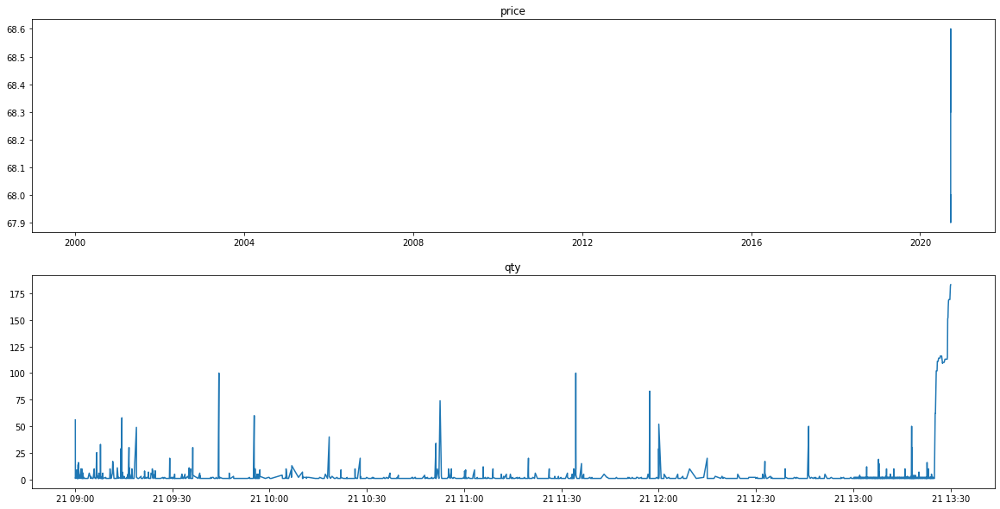

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90010328
clear_position:  0.0
position:  []
tick_row_price 66.8
----------Result Report--------------
profit:  0.0


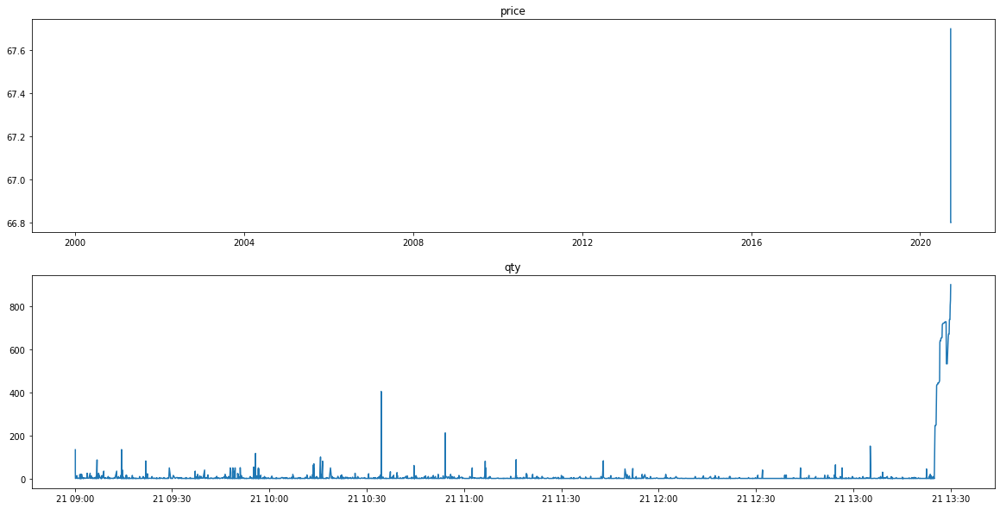

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1326/tse_lob_1326.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1326/tse_tick_1326.csv' mode='r' encoding='UTF-8'>
90008066
*** bid1_p:  67.2
*** weighted_p:  67.09421768707486
ask1_p:  67.3
進場時間： 91804852 
  sell price at  67.2
stop profit
出場時間： 91810055
POSITION(pre):  [67.2]
Order_p(pre):  [67.1]
tick_row price:  67.1
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  67.2
*** weighted_p:  67.09549549549553
ask1_p:  67.3
進場時間： 91844846 
  sell price at  67.2
*** bid1_p:  67.2
*** weighted_p:  67.09549549549553
ask1_p:  67.3
進場時間： 91902361 
  sell price at  67.2
*** bid1_p:  67.3
*** weighted_p:  67.09792284866471
ask1_p:  67.4
進場時間： 91942366 
  sell price at  67.3
*** bid1_p:  67.3
*** weighted_p:  67.09792284866471
ask1_p:  67.4
進場時間： 92006027 
  sell price at  67.3
*** bid1_p:  67.2
*** weighted_p:  67.098

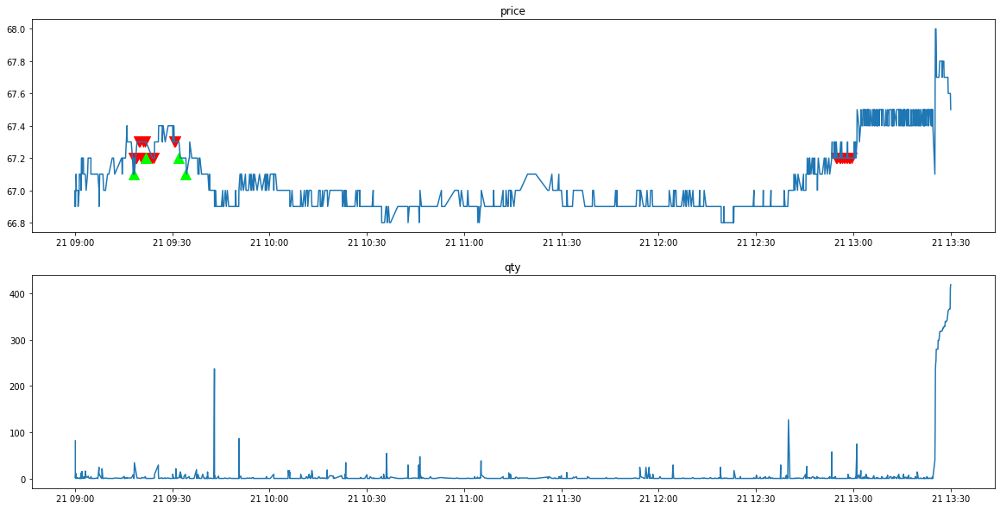

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90008846
*** bid1_p:  39.45
*** weighted_p:  39.40114155251141
ask1_p:  39.5
進場時間： 90409420 
  sell price at  39.45
stop profit
出場時間： 90605340
POSITION(pre):  [39.45]
Order_p(pre):  [39.4]
tick_row price:  39.4
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  39.25
*** weighted_p:  39.2015728900256
ask1_p:  39.3
進場時間： 111239204 
  sell price at  39.25
*** bid1_p:  39.25
*** weighted_p:  39.20203809523812
ask1_p:  39.3
進場時間： 111301659 
  sell price at  39.25
*** bid1_p:  39.25
*** weighted_p:  39.204880600689286
ask1_p:  39.35
進場時間： 111645989 
  sell price at  39.25
*** bid1_p:  39.3
*** weighted_p:  39.20504485682681
ask1_p:  39.35
進場時間： 111700254 
  sell price at  39.3
stop profit
出場時間： 11170596

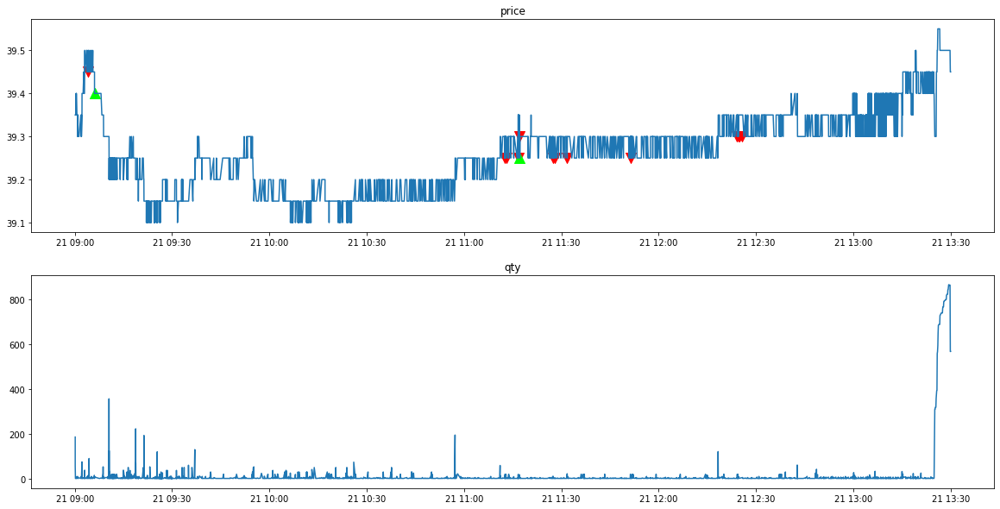

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90005105
*** bid1_p:  39.5
*** weighted_p:  39.40521308980205
ask1_p:  39.55
進場時間： 95642949 
  sell price at  39.5
*** bid1_p:  39.5
*** weighted_p:  39.40546489563559
ask1_p:  39.55
進場時間： 95702531 
  sell price at  39.5
*** bid1_p:  39.5
*** weighted_p:  39.40607088989434
ask1_p:  39.55
進場時間： 95735498 
  sell price at  39.5
*** bid1_p:  39.5
*** weighted_p:  39.40649887302772
ask1_p:  39.55
進場時間： 95800295 
  sell price at  39.5
*** bid1_p:  39.5
*** weighted_p:  39.408627019089494
ask1_p:  39.55
進場時間： 95834900 
  sell price at  39.5
*** bid1_p:  39.5
*** weighted_p:  39.41074246771872
ask1_p:  39.55
進場時間： 95900506 
  sell price at  39.5
*** bid1_p:  39.5
*** weighted_p:  39.411472785485515
ask1_p:  39.55
進場時間： 95933374 
  

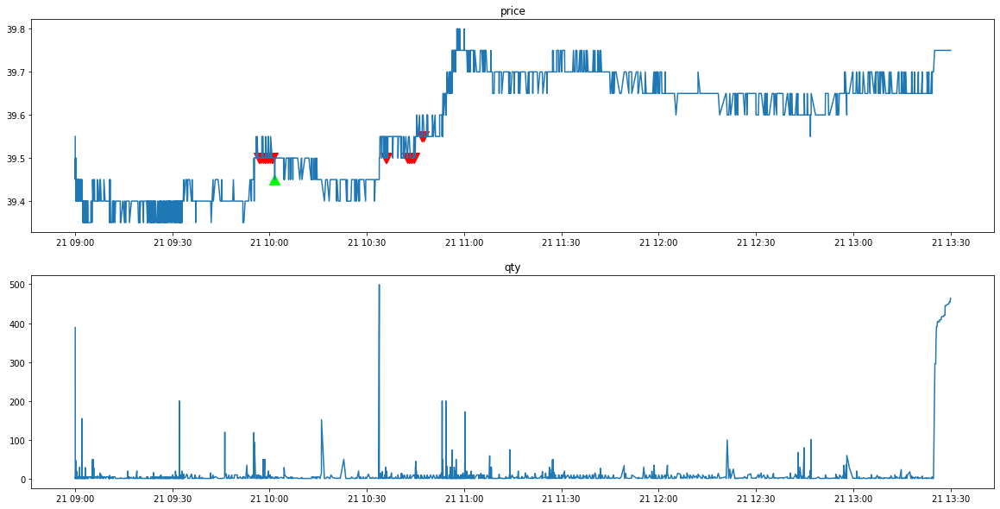

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90006997
*** bid1_p:  39.95
*** weighted_p:  39.90192147034245
ask1_p:  40.0
進場時間： 91545306 
  sell price at  39.95
*** bid1_p:  39.95
*** weighted_p:  39.90397979797972
ask1_p:  40.0
進場時間： 91600159 
  sell price at  39.95
*** bid1_p:  39.95
*** weighted_p:  39.9050039714058
ask1_p:  40.0
進場時間： 91652361 
  sell price at  39.95
*** bid1_p:  39.95
*** weighted_p:  39.905077350257756
ask1_p:  40.0
進場時間： 91700001 
  sell price at  39.95
*** bid1_p:  39.95
*** weighted_p:  39.90597043951761
ask1_p:  40.0
進場時間： 91731609 
  sell price at  39.95
*** bid1_p:  39.95
*** weighted_p:  39.907009167303194
ask1_p:  40.0
進場時間： 91800379 
  sell price at  39.95
stop profit
出場時間： 91811139
POSITION(pre):  [39.95 39.95 39.95 39.95 39.95 39.95]


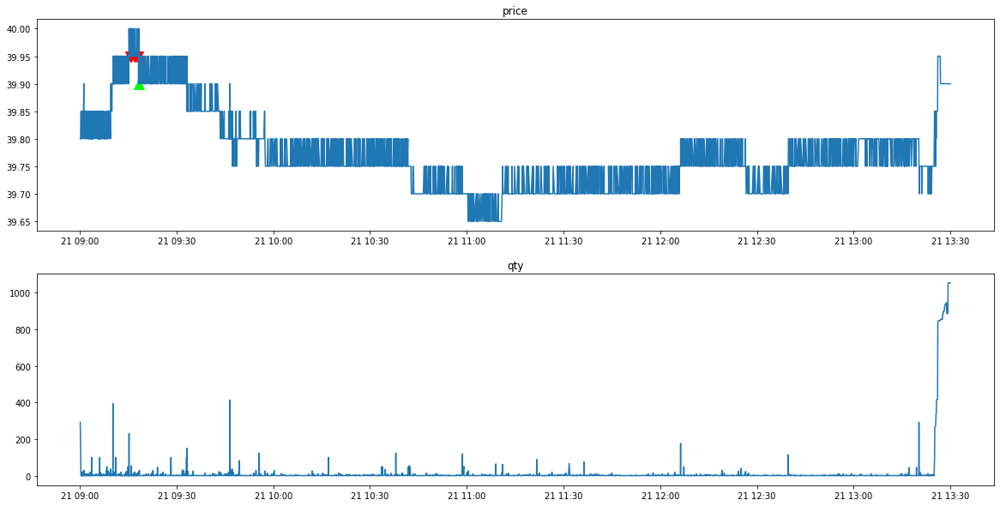

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90006540
*** bid1_p:  39.9
*** weighted_p:  39.82936473638721
ask1_p:  39.95
進場時間： 95853452 
  sell price at  39.9
*** bid1_p:  39.9
*** weighted_p:  39.82936473638721
ask1_p:  39.95
進場時間： 95900746 
  sell price at  39.9
*** bid1_p:  39.9
*** weighted_p:  39.82945619335348
ask1_p:  39.95
進場時間： 95933943 
  sell price at  39.9
*** bid1_p:  39.9
*** weighted_p:  39.829909948542024
ask1_p:  39.95
進場時間： 100000099 
  sell price at  39.9
*** bid1_p:  39.9
*** weighted_p:  39.83100464330941
ask1_p:  39.95
進場時間： 100031204 
  sell price at  39.9
*** bid1_p:  39.9
*** weighted_p:  39.83130782169889
ask1_p:  39.95
進場時間： 100100927 
  sell price at  39.9
*** bid1_p:  39.9
*** weighted_p:  39.83135771332491
ask1_p:  39.95
進場時間： 100131322 

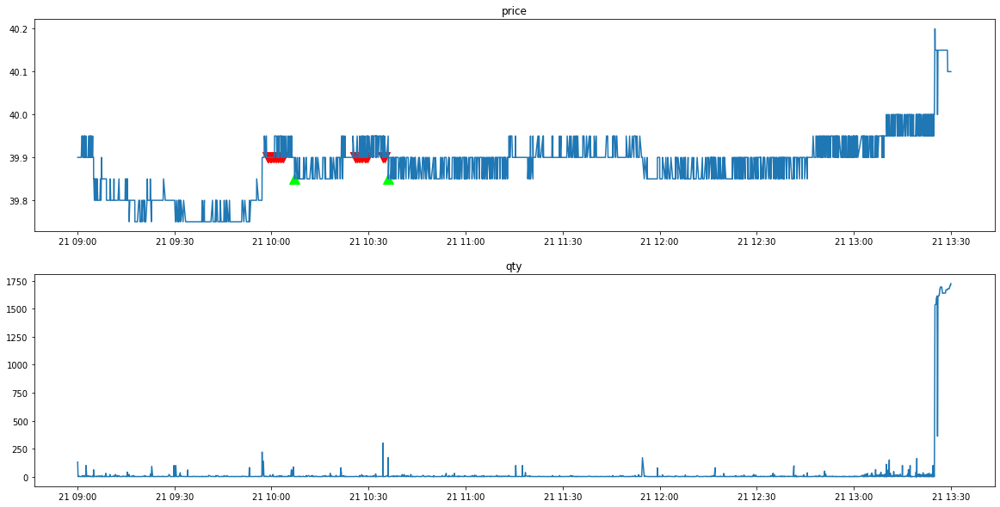

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90007648
clear_position:  0.0
position:  []
tick_row_price 40.05
----------Result Report--------------
profit:  0.0


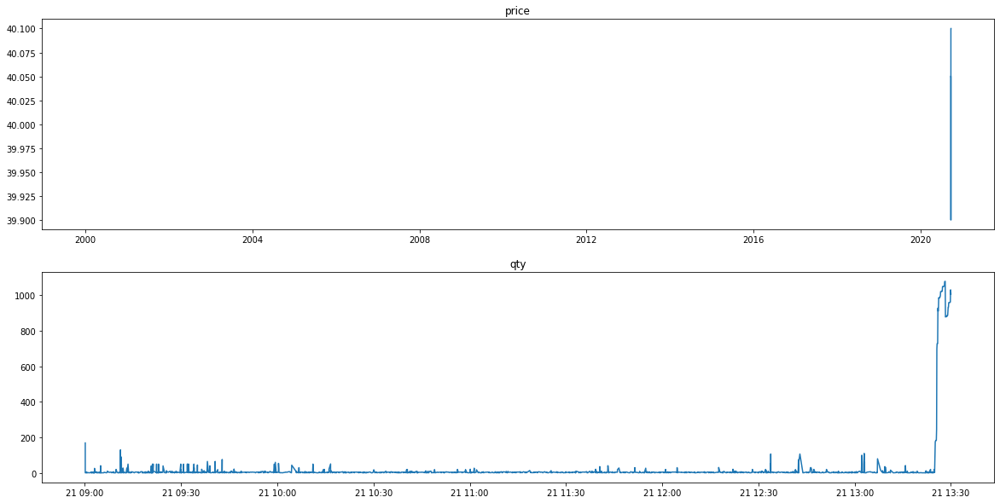

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90007120
clear_position:  0.0
position:  []
tick_row_price 40.0
----------Result Report--------------
profit:  0.0


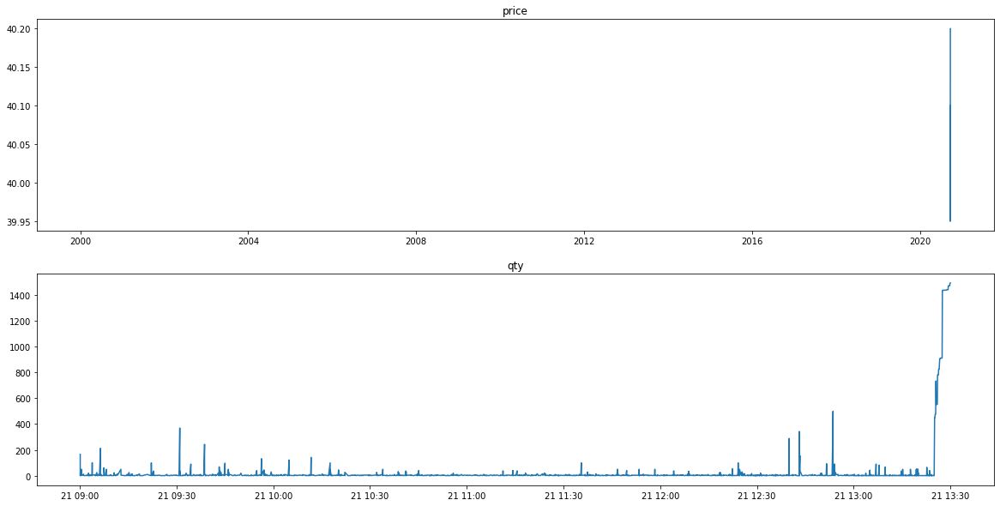

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90006957
clear_position:  0.0
position:  []
tick_row_price 39.65
----------Result Report--------------
profit:  0.0


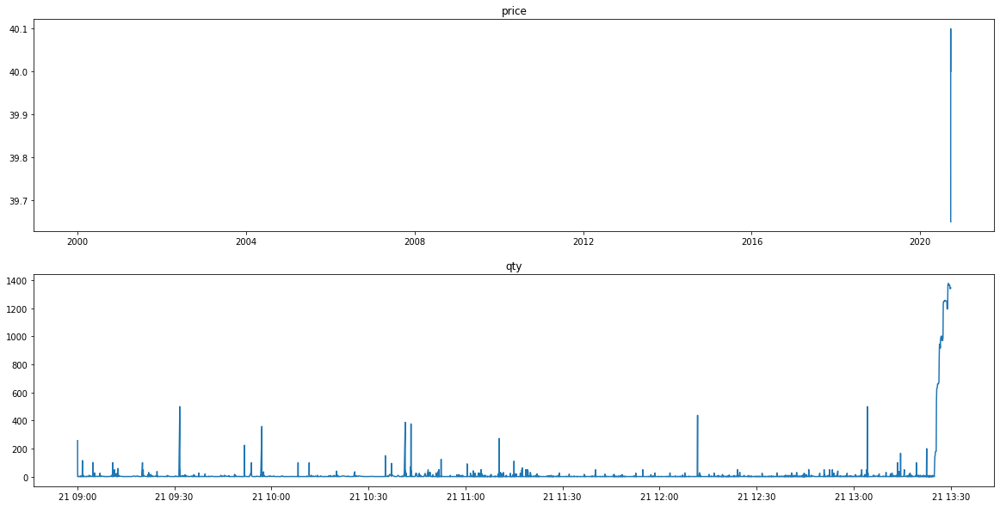

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90005272
clear_position:  0.0
position:  []
tick_row_price 39.6
----------Result Report--------------
profit:  0.0


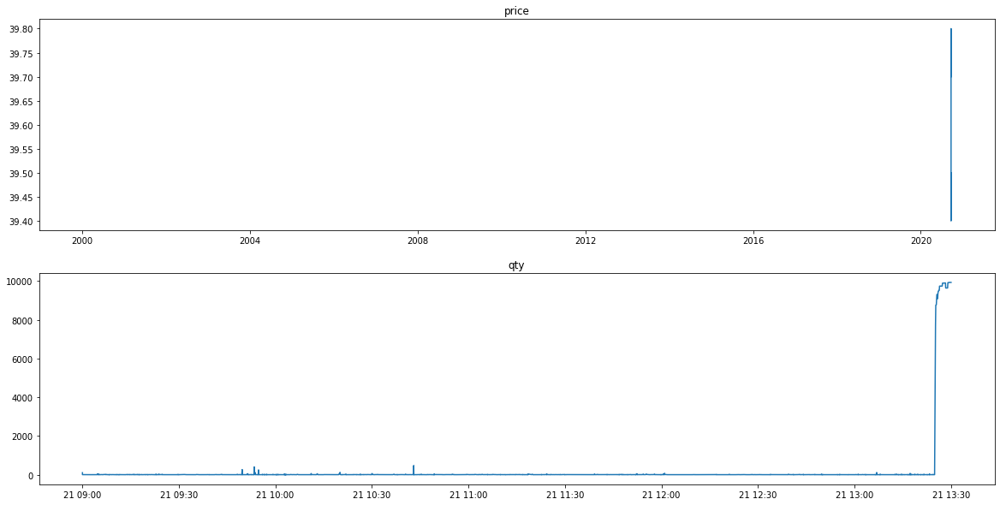

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90007069
clear_position:  0.0
position:  []
tick_row_price 39.15
----------Result Report--------------
profit:  0.0


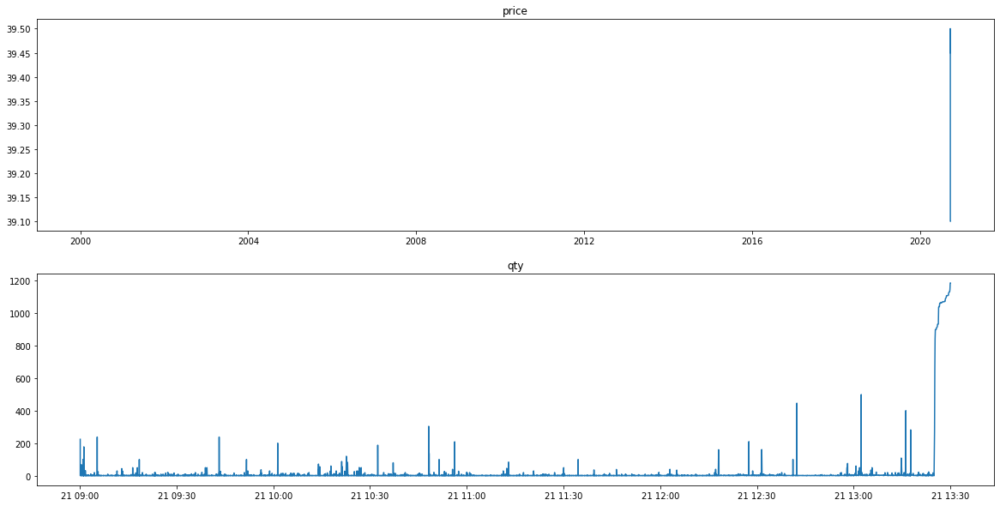

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90003814
*** bid1_p:  38.95
*** weighted_p:  38.90750289992639
ask1_p:  39.0
進場時間： 113614357 
  sell price at  38.95
*** bid1_p:  38.95
*** weighted_p:  38.90990580526286
ask1_p:  39.0
進場時間： 115100211 
  sell price at  38.95
*** bid1_p:  38.95
*** weighted_p:  38.910013276144035
ask1_p:  39.0
進場時間： 115134371 
  sell price at  38.95
*** bid1_p:  38.95
*** weighted_p:  38.91013141809315
ask1_p:  39.0
進場時間： 115200201 
  sell price at  38.95
*** bid1_p:  38.95
*** weighted_p:  38.91014765784138
ask1_p:  39.0
進場時間： 115230696 
  sell price at  38.95
*** bid1_p:  38.95
*** weighted_p:  38.91018725829456
ask1_p:  39.0
進場時間： 115303809 
  sell price at  38.95
*** bid1_p:  38.95
*** weighted_p:  38.91024206672115
ask1_p:  39.0
進場時間： 1

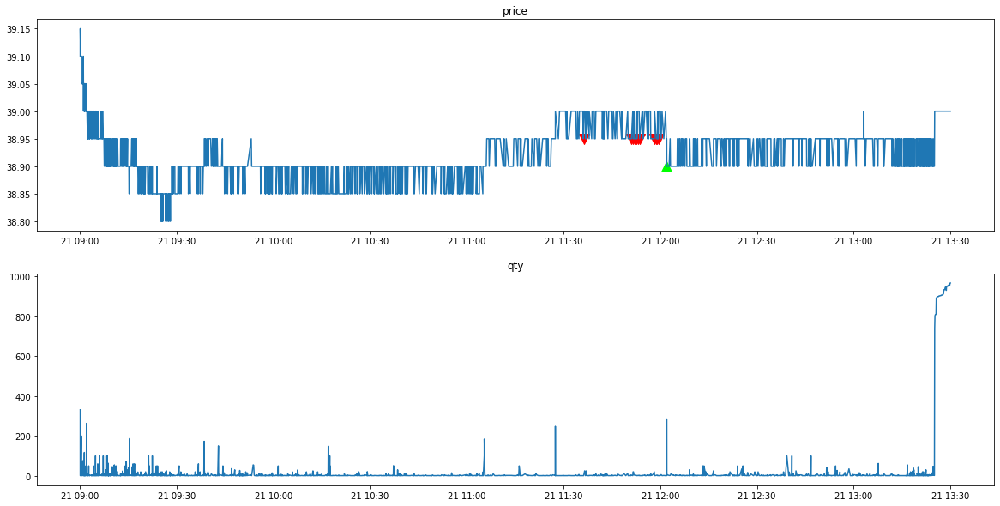

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90005189
clear_position:  0.0
position:  []
tick_row_price 38.8
----------Result Report--------------
profit:  0.0


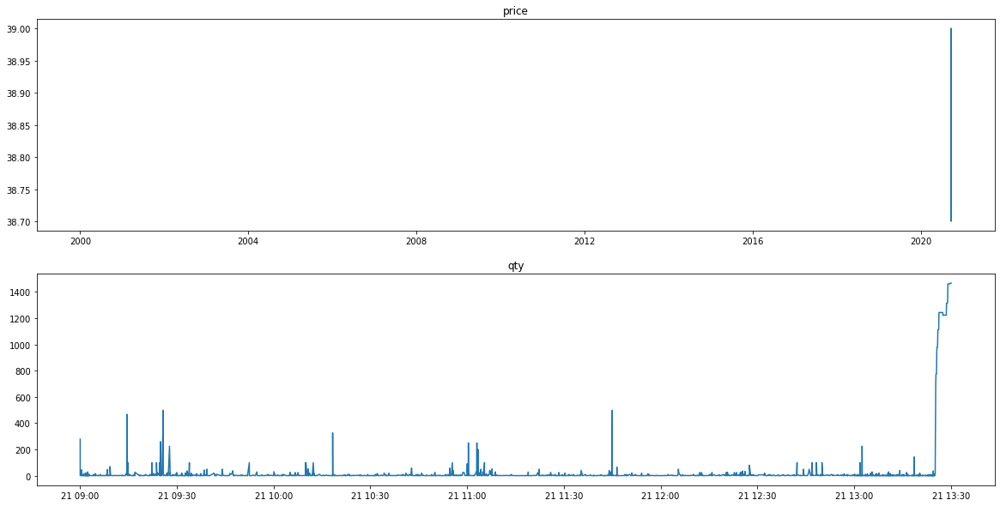

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90006313
clear_position:  0.0
position:  []
tick_row_price 38.05
----------Result Report--------------
profit:  0.0


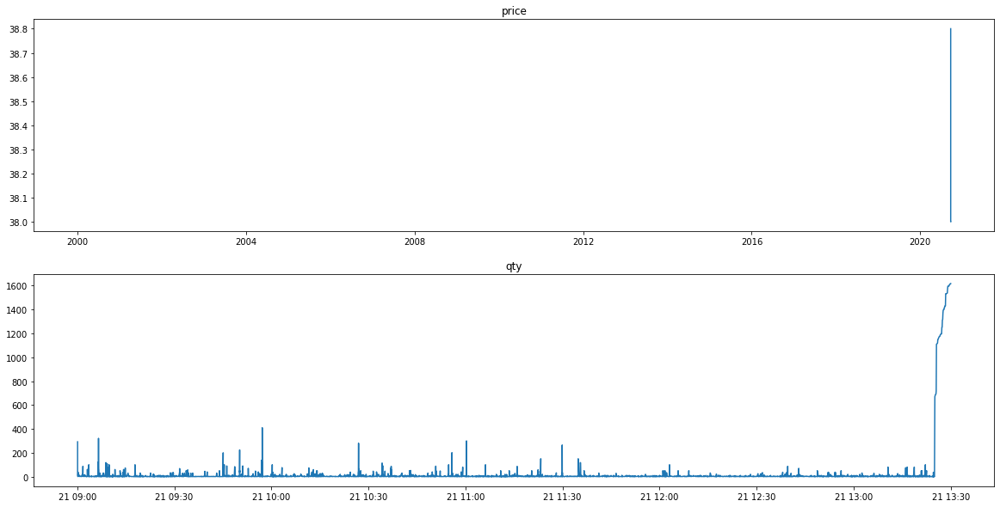

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2882/tse_lob_2882.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2882/tse_tick_2882.csv' mode='r' encoding='UTF-8'>
90003924
*** bid1_p:  38.25
*** weighted_p:  38.208283049917796
ask1_p:  38.3
進場時間： 92557725 
  sell price at  38.25
*** bid1_p:  38.25
*** weighted_p:  38.208283049917796
ask1_p:  38.3
進場時間： 92603919 
  sell price at  38.25
*** bid1_p:  38.25
*** weighted_p:  38.20916216216224
ask1_p:  38.3
進場時間： 92634391 
  sell price at  38.25
*** bid1_p:  38.25
*** weighted_p:  38.209473966720424
ask1_p:  38.3
進場時間： 92701127 
  sell price at  38.25
*** bid1_p:  38.25
*** weighted_p:  38.20976000000008
ask1_p:  38.3
進場時間： 92734107 
  sell price at  38.25
stop profit
出場時間： 93207042
POSITION(pre):  [38.25 38.25 38.25 38.25 38.25]
Order_p(pre):  [38.2 38.2 38.2 38.2 38.2]
tick_row price:  38.2
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
POS

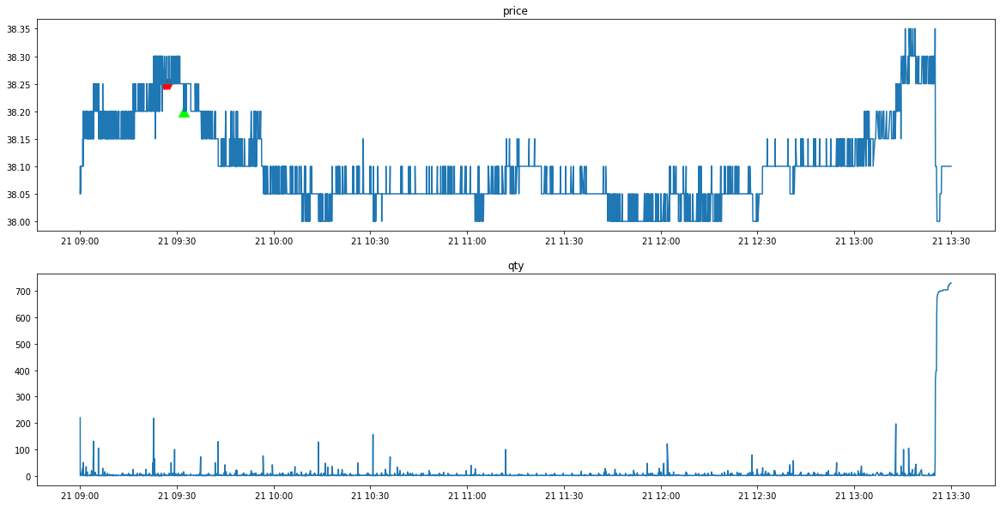

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90015322
*** bid1_p:  60.6
*** weighted_p:  60.432448979591804
ask1_p:  60.7
進場時間： 94000070 
  sell price at  60.6
*** bid1_p:  60.6
*** weighted_p:  60.432676630434756
ask1_p:  60.7
進場時間： 94033421 
  sell price at  60.6
*** bid1_p:  60.6
*** weighted_p:  60.432790224032566
ask1_p:  60.7
進場時間： 94101260 
  sell price at  60.6
*** bid1_p:  60.6
*** weighted_p:  60.43301694915253
ask1_p:  60.7
進場時間： 94133042 
  sell price at  60.6
stop profit
出場時間： 94144300
POSITION(pre):  [60.6 60.6 60.6 60.6]
Order_p(pre):  [60.5 60.5 60.5 60.5]
tick_row price:  60.5
qualified index:  [[0]
 [1]
 [2]
 [3]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  60.5
*** weighted_p:  60.43385030343897
ask1_p:  60.6
進場時間： 94201368 
  sell price at

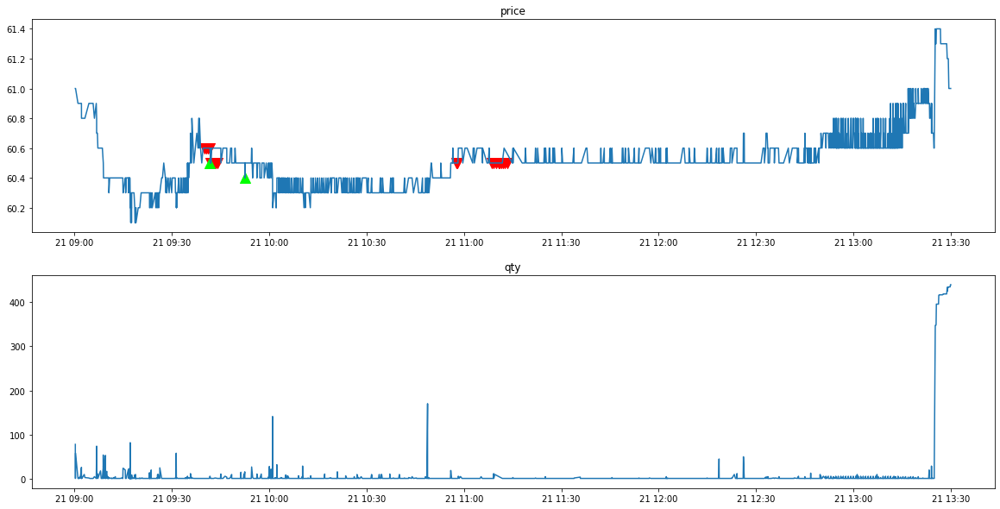

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90009121
clear_position:  0.0
position:  []
tick_row_price 60.5
----------Result Report--------------
profit:  0.0


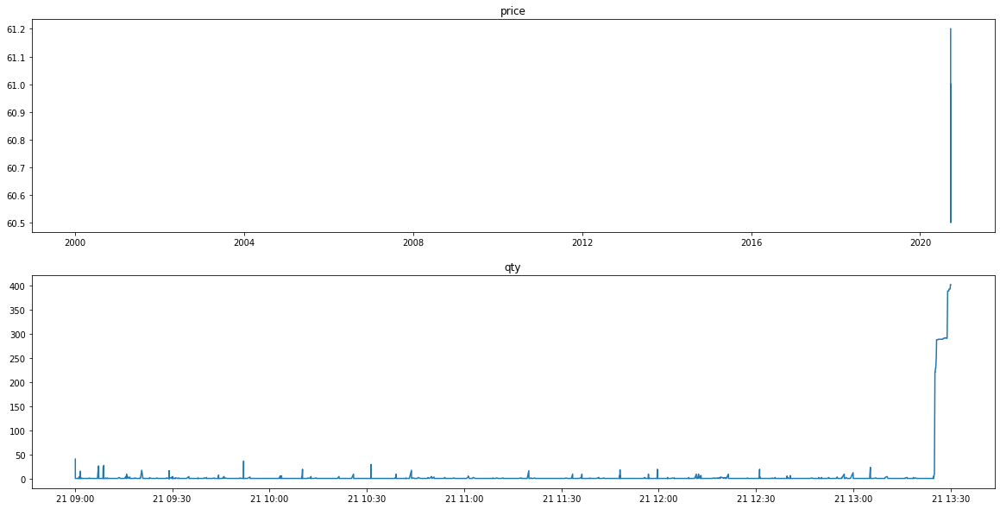

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90013168
*** bid1_p:  60.8
*** weighted_p:  60.72792207792208
ask1_p:  60.9
進場時間： 91720421 
  sell price at  60.8
stop profit
出場時間： 91746836
POSITION(pre):  [60.8]
Order_p(pre):  [60.7]
tick_row price:  60.7
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 60.4
----------Result Report--------------
profit:  0.09999999999999432


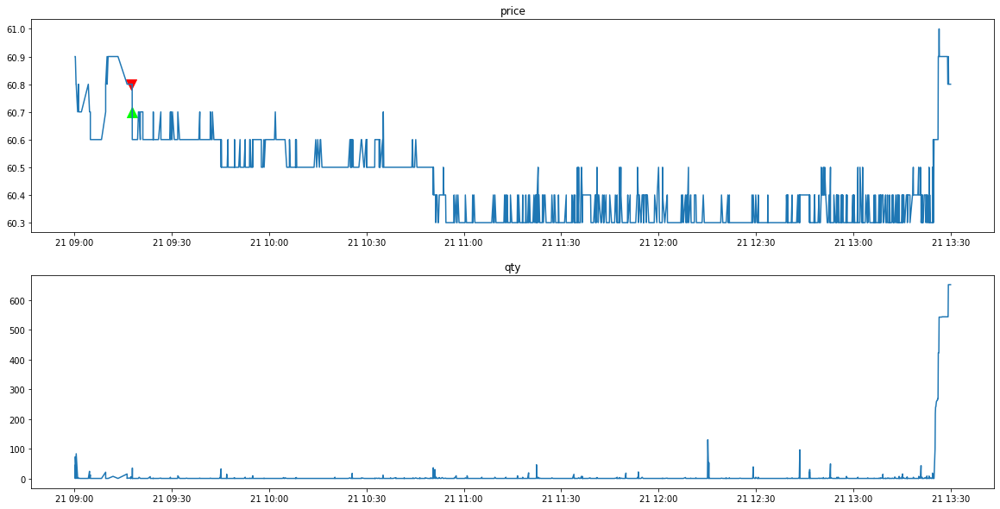

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90010931
*** bid1_p:  60.9
*** weighted_p:  60.71459293394778
ask1_p:  61.0
進場時間： 94719400 
  sell price at  60.9
stop profit
出場時間： 94719400
POSITION(pre):  [60.9]
Order_p(pre):  [60.8]
tick_row price:  60.8
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  60.8
*** weighted_p:  60.715137614678916
ask1_p:  60.9
進場時間： 94756630 
  sell price at  60.8
*** bid1_p:  60.8
*** weighted_p:  60.71638846737483
ask1_p:  60.9
進場時間： 94803264 
  sell price at  60.8
*** bid1_p:  60.8
*** weighted_p:  60.71638846737483
ask1_p:  60.9
進場時間： 94838477 
  sell price at  60.8
*** bid1_p:  60.8
*** weighted_p:  60.71638846737483
ask1_p:  60.9
進場時間： 94909174 
  sell price at  60.8
*** bid1_p:  60.8
*** weighted_p:  60.71

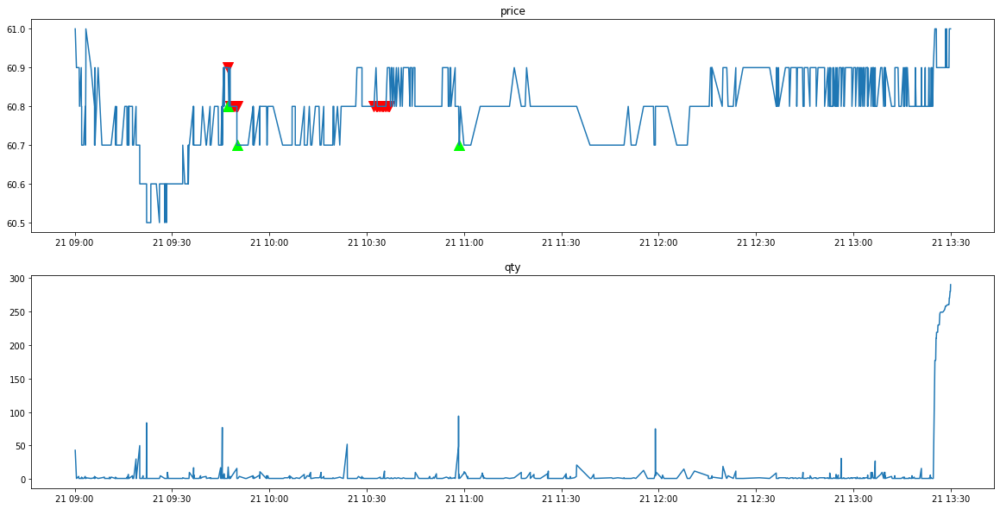

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90014268
*** bid1_p:  61.0
*** weighted_p:  60.91129568106312
ask1_p:  61.1
進場時間： 95929005 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.91331168831169
ask1_p:  61.1
進場時間： 100012231 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.91359223300971
ask1_p:  61.1
進場時間： 100043825 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.916169544740974
ask1_p:  61.1
進場時間： 100100039 
  sell price at  61.0
stop profit
出場時間： 100111266
POSITION(pre):  [61. 61. 61. 61.]
Order_p(pre):  [60.9 60.9 60.9 60.9]
tick_row price:  60.9
qualified index:  [[0]
 [1]
 [2]
 [3]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  61.0
*** weighted_p:  60.91897590361447
ask1_p:  61.1
進場時間： 100148798 
  sell price at 

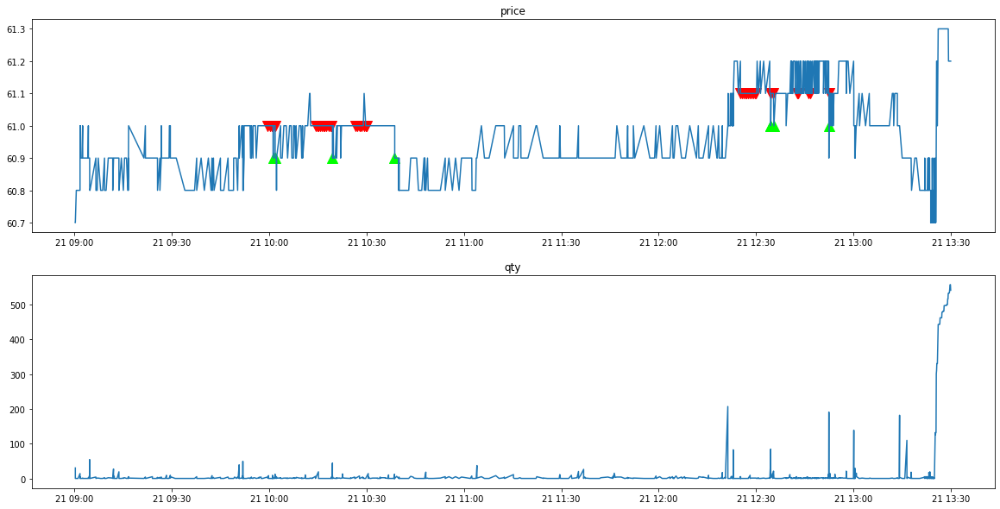

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90012141
*** bid1_p:  61.0
*** weighted_p:  60.939053254437866
ask1_p:  61.1
進場時間： 91156000 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.939053254437866
ask1_p:  61.1
進場時間： 91203669 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.939053254437866
ask1_p:  61.1
進場時間： 91240574 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.939053254437866
ask1_p:  61.1
進場時間： 91305968 
  sell price at  61.0
stop profit
出場時間： 91322939
POSITION(pre):  [61. 61. 61. 61.]
Order_p(pre):  [60.9 60.9 60.9 60.9]
tick_row price:  60.9
qualified index:  [[0]
 [1]
 [2]
 [3]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  61.1
*** weighted_p:  60.987147688838675
ask1_p:  61.2
進場時間： 112658278 
  sell price at 

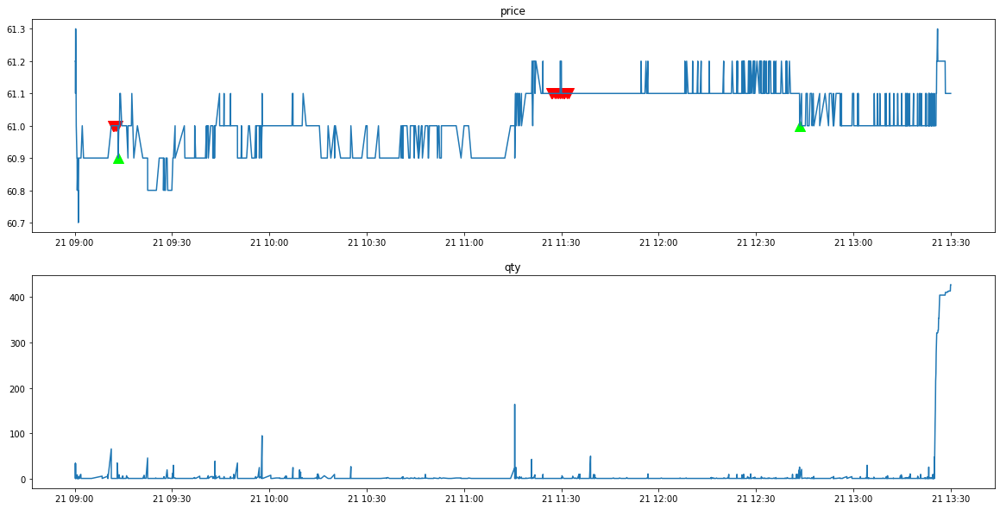

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90011834
clear_position:  0.0
position:  []
tick_row_price 60.7
----------Result Report--------------
profit:  0.0


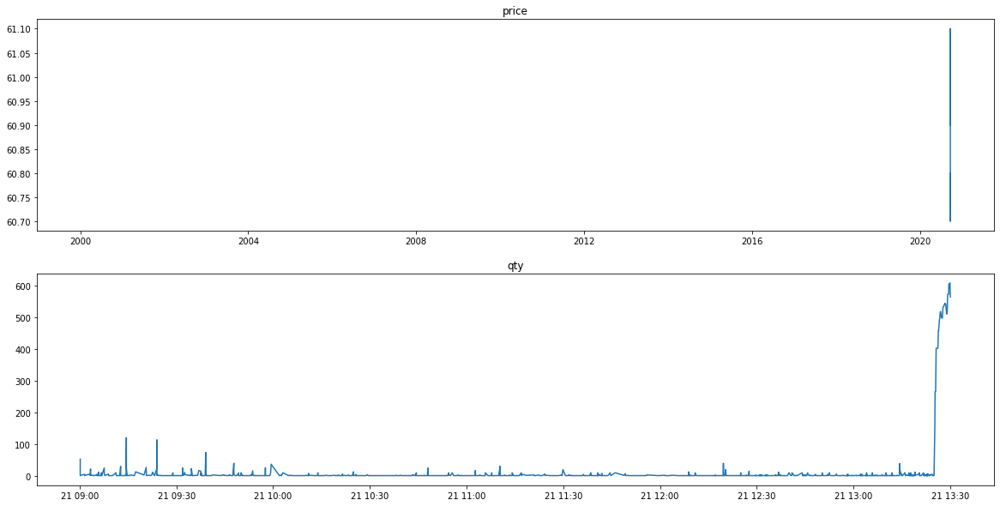

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90011294
*** bid1_p:  61.4
*** weighted_p:  61.28042328042332
ask1_p:  61.5
進場時間： 90600004 
  sell price at  61.4
*** bid1_p:  61.4
*** weighted_p:  61.30112359550566
ask1_p:  61.5
進場時間： 90631528 
  sell price at  61.4
stop profit
出場時間： 90635719
POSITION(pre):  [61.4 61.4]
Order_p(pre):  [61.3 61.3]
tick_row price:  61.3
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  61.4
*** weighted_p:  61.330303030303085
ask1_p:  61.5
進場時間： 90819070 
  sell price at  61.4
*** bid1_p:  61.6
*** weighted_p:  61.40126422250318
ask1_p:  61.7
進場時間： 90947593 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.40301129234631
ask1_p:  61.7
進場時間： 91000593 
  sell price at  61.6
*** bid1_p:  61.6
*** wei

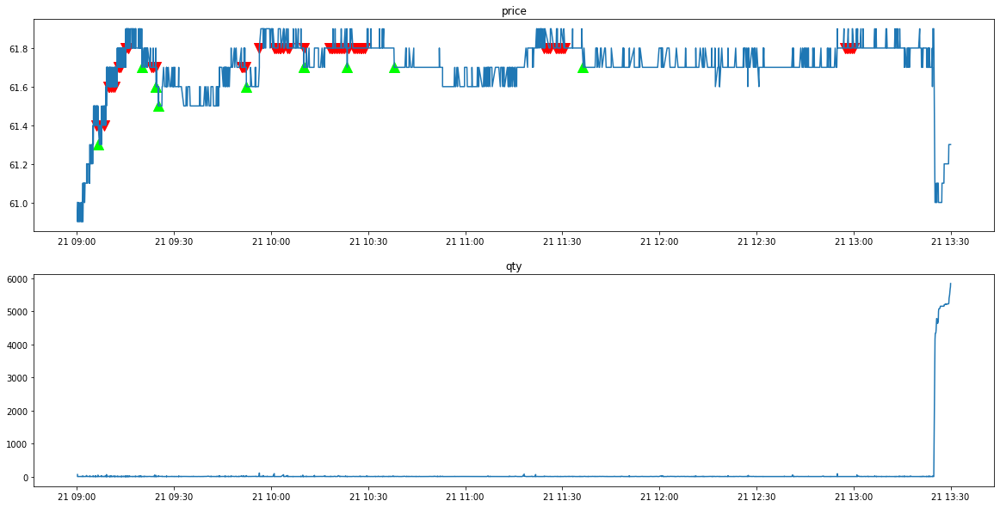

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90007181
*** bid1_p:  61.7
*** weighted_p:  61.61433756805806
ask1_p:  61.8
進場時間： 90629893 
  sell price at  61.7
stop profit
出場時間： 90632905
POSITION(pre):  [61.7]
Order_p(pre):  [61.6]
tick_row price:  61.6
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  61.7
*** weighted_p:  61.6350901525658
ask1_p:  61.8
進場時間： 91700045 
  sell price at  61.7
*** bid1_p:  61.7
*** weighted_p:  61.635318559556715
ask1_p:  61.8
進場時間： 91730247 
  sell price at  61.7
*** bid1_p:  61.7
*** weighted_p:  61.63540802212994
ask1_p:  61.8
進場時間： 91800670 
  sell price at  61.7
*** bid1_p:  61.9
*** weighted_p:  61.70696022727268
ask1_p:  62.0
進場時間： 92609404 
  sell price at  61.9
stop profit
出場時間： 92616231
POSITION(pre):

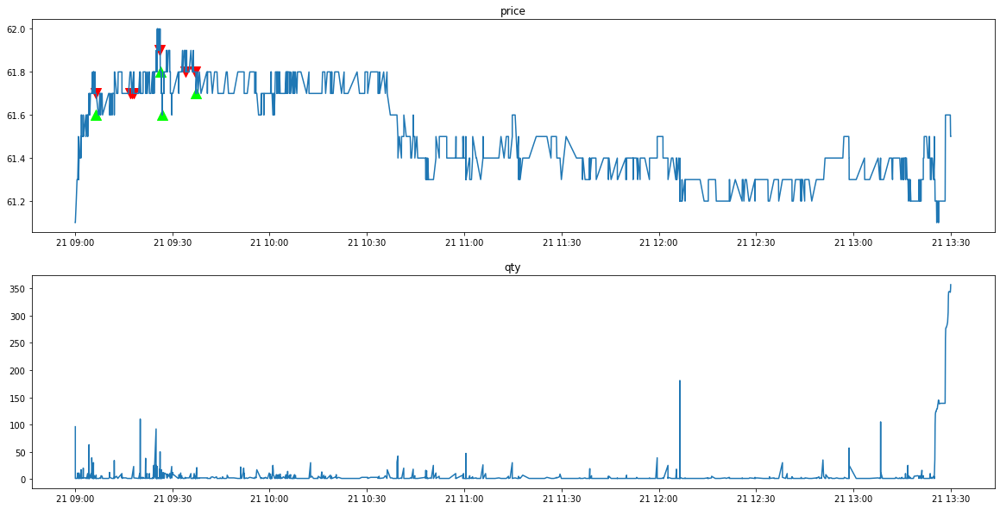

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90010440
*** bid1_p:  60.8
*** weighted_p:  60.69924433249366
ask1_p:  60.9
進場時間： 94047102 
  sell price at  60.8
stop profit
出場時間： 94120068
POSITION(pre):  [60.8]
Order_p(pre):  [60.7]
tick_row price:  60.7
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  60.9
*** weighted_p:  60.70667053364268
ask1_p:  61.0
進場時間： 95805654 
  sell price at  60.9
stop profit
出場時間： 95805654
POSITION(pre):  [60.9]
Order_p(pre):  [60.8]
tick_row price:  60.8
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  60.8
*** weighted_p:  60.707997731140075
ask1_p:  60.9
進場時間： 95932115 
  sell price at  60.8
*** bid1_p:  60.8
*** weighted_p:  60.707997731140075
ask1_p:  60.9
進場時間： 100000286 
  sell 

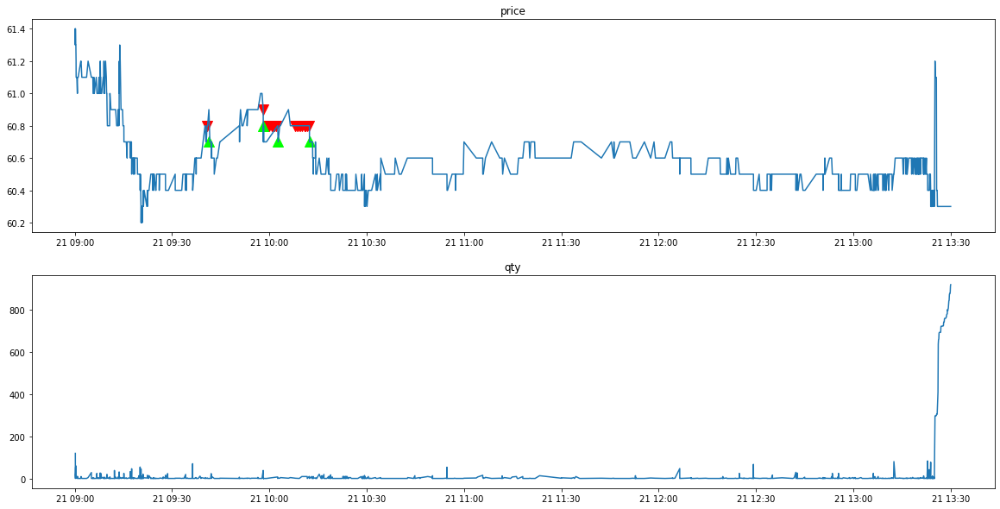

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90008999
clear_position:  0.0
position:  []
tick_row_price 60.0
----------Result Report--------------
profit:  0.0


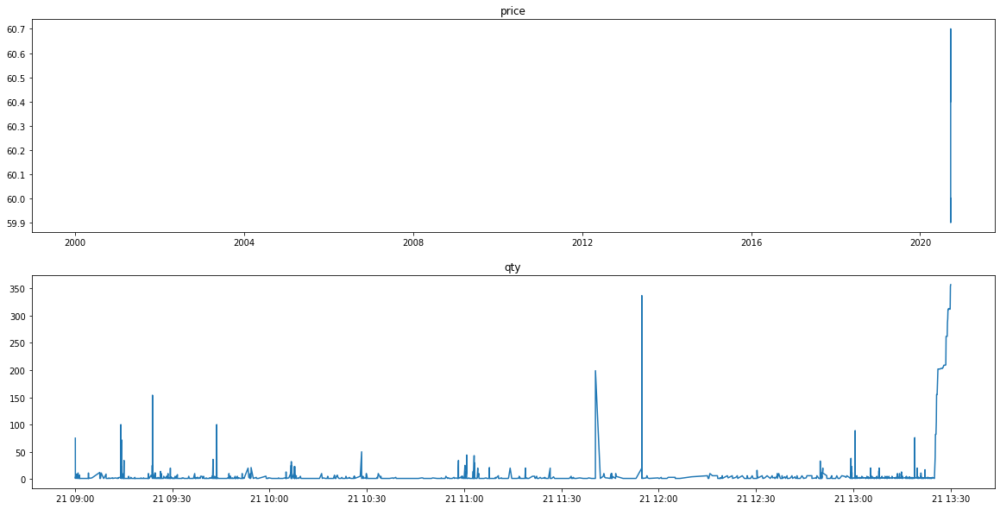

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90010529
*** bid1_p:  59.6
*** weighted_p:  59.52656826568266
ask1_p:  59.7
進場時間： 90353276 
  sell price at  59.6
stop profit
出場時間： 90418660
POSITION(pre):  [59.6]
Order_p(pre):  [59.5]
tick_row price:  59.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 58.3
----------Result Report--------------
profit:  0.10000000000000142


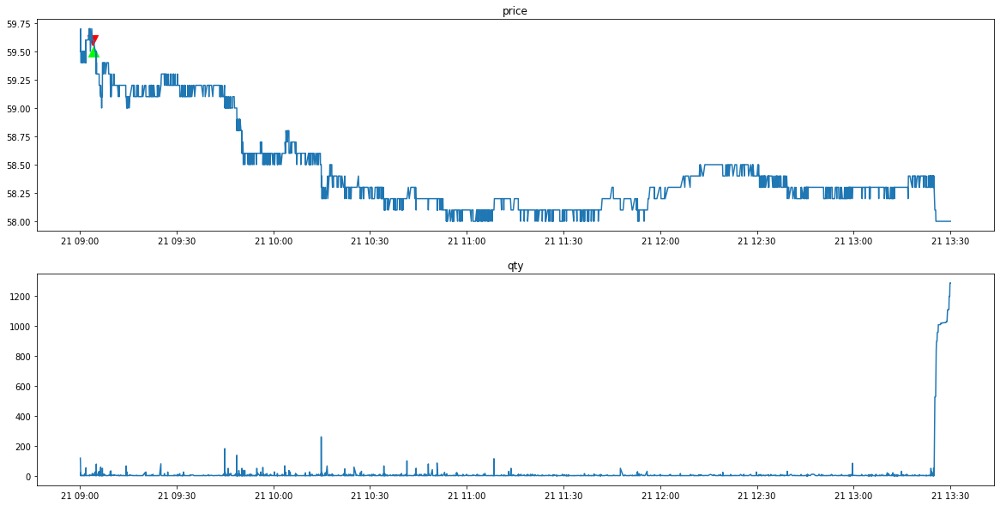

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1303/tse_lob_1303.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1303/tse_tick_1303.csv' mode='r' encoding='UTF-8'>
90006933
*** bid1_p:  58.9
*** weighted_p:  58.6607925801012
ask1_p:  59.2
進場時間： 101910097 
  sell price at  58.9
*** bid1_p:  58.9
*** weighted_p:  58.66502914238137
ask1_p:  59.1
進場時間： 101940541 
  sell price at  58.9
*** bid1_p:  58.9
*** weighted_p:  58.66566916043228
ask1_p:  59.0
進場時間： 102000806 
  sell price at  58.9
*** bid1_p:  58.9
*** weighted_p:  58.665946843853845
ask1_p:  59.0
進場時間： 102031955 
  sell price at  58.9
*** bid1_p:  58.9
*** weighted_p:  58.665946843853845
ask1_p:  59.0
進場時間： 102104731 
  sell price at  58.9
*** bid1_p:  58.8
*** weighted_p:  58.66669428334716
ask1_p:  58.9
進場時間： 102136744 
  sell price at  58.8
*** bid1_p:  58.8
*** weighted_p:  58.66669428334716
ask1_p:  58.9
進場時間： 102204096 
  s

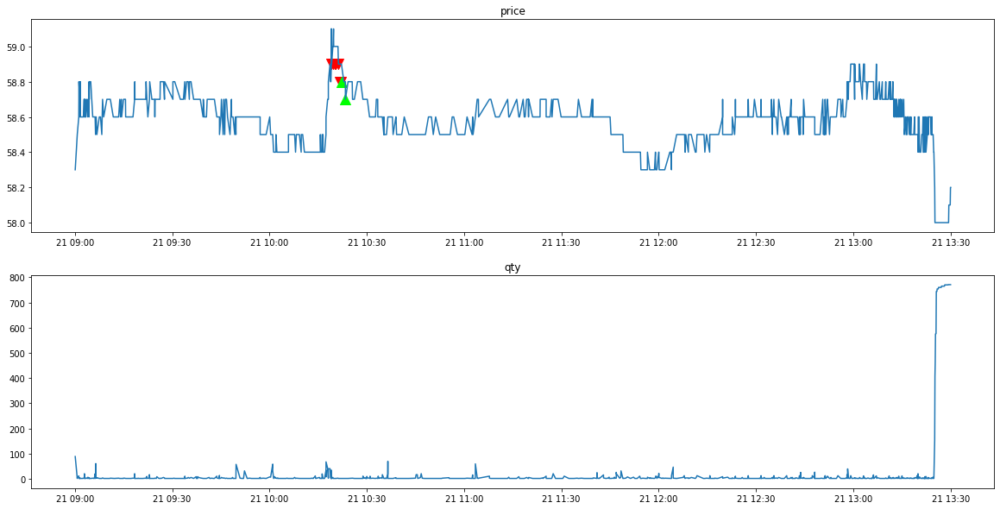

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90011253
*** bid1_p:  42.05
*** weighted_p:  41.869112940100464
ask1_p:  42.1
進場時間： 124232007 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.86963797191306
ask1_p:  42.1
進場時間： 124305969 
  sell price at  42.05
stop profit
出場時間： 124323226
POSITION(pre):  [42.05 42.05]
Order_p(pre):  [42. 42.]
tick_row price:  42.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  42.0
*** weighted_p:  41.87002274795255
ask1_p:  42.05
進場時間： 124336345 
  sell price at  42.0
*** bid1_p:  42.0
*** weighted_p:  41.87002274795255
ask1_p:  42.05
進場時間： 124400778 
  sell price at  42.0
*** bid1_p:  42.0
*** weighted_p:  41.87003457374201
ask1_p:  42.05
進場時間： 124430925 
  sell price at  42.0
*** bid1_p: 

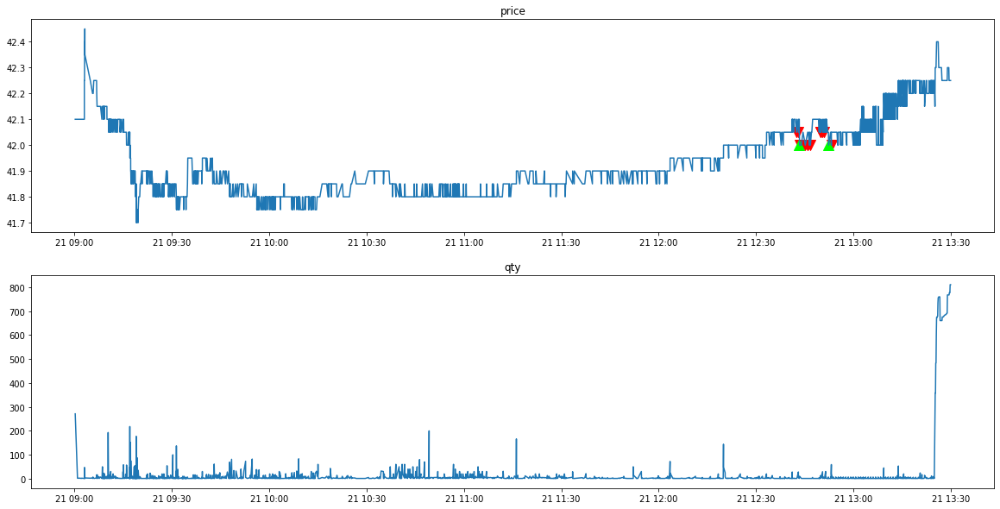

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90006469
*** bid1_p:  42.5
*** weighted_p:  42.26733760292758
ask1_p:  42.55
進場時間： 95806609 
  sell price at  42.5
stop profit
出場時間： 95829191
POSITION(pre):  [42.5]
Order_p(pre):  [42.45]
tick_row price:  42.45
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  42.45
*** weighted_p:  42.27477856510173
ask1_p:  42.5
進場時間： 95840171 
  sell price at  42.45
*** bid1_p:  42.45
*** weighted_p:  42.28113695090427
ask1_p:  42.5
進場時間： 100002283 
  sell price at  42.45
*** bid1_p:  42.5
*** weighted_p:  42.28801341156736
ask1_p:  42.55
進場時間： 100333207 
  sell price at  42.5
*** bid1_p:  42.5
*** weighted_p:  42.28874269005836
ask1_p:  42.55
進場時間： 100401423 
  sell price at  42.5
*** bid1_p:  42.5
*** weighte

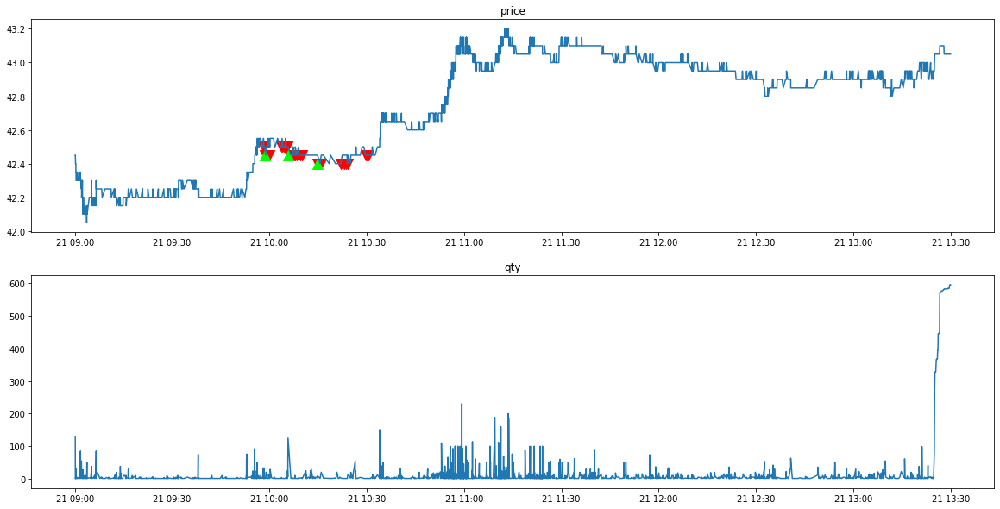

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90006548
*** bid1_p:  43.45
*** weighted_p:  43.35444839857654
ask1_p:  43.5
進場時間： 91309314 
  sell price at  43.45
stop profit
出場時間： 91334561
POSITION(pre):  [43.45]
Order_p(pre):  [43.4]
tick_row price:  43.4
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  43.45
*** weighted_p:  43.37263456090656
ask1_p:  43.5
進場時間： 91640510 
  sell price at  43.45
stop profit
出場時間： 91653414
POSITION(pre):  [43.45]
Order_p(pre):  [43.4]
tick_row price:  43.4
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  43.45
*** weighted_p:  43.373035764573416
ask1_p:  43.5
進場時間： 91712840 
  sell price at  43.45
stop profit
出場時間： 91724575
POSITION(pre):  [43.45]
Order_p(pre):  [43.4]
tick_row pr

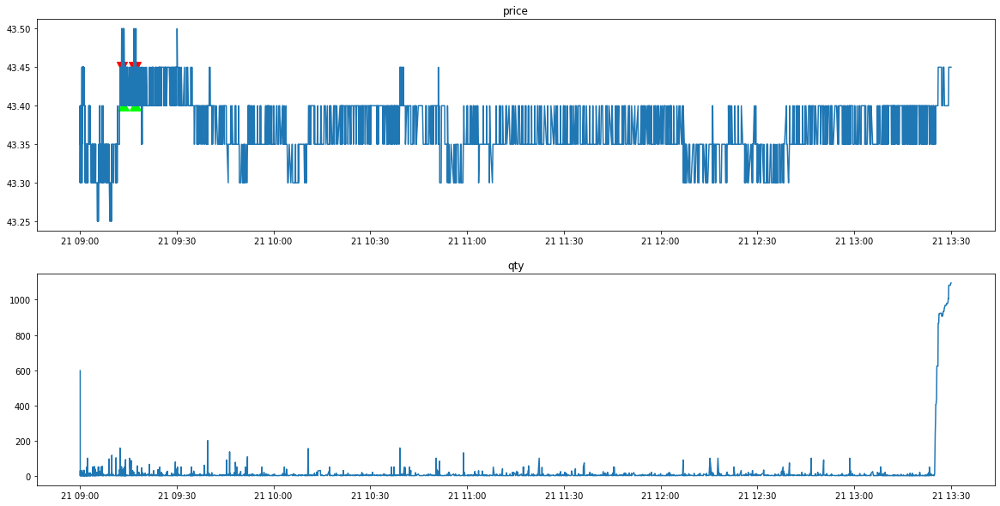

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90005510
*** bid1_p:  43.55
*** weighted_p:  43.42331295042582
ask1_p:  43.6
進場時間： 95812550 
  sell price at  43.55
*** bid1_p:  43.55
*** weighted_p:  43.423913043478215
ask1_p:  43.6
進場時間： 95843167 
  sell price at  43.55
stop profit
出場時間： 95856824
POSITION(pre):  [43.55 43.55]
Order_p(pre):  [43.5 43.5]
tick_row price:  43.5
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  43.5
*** weighted_p:  43.42624309392261
ask1_p:  43.6
進場時間： 95900799 
  sell price at  43.5
*** bid1_p:  43.5
*** weighted_p:  43.4274335356918
ask1_p:  43.55
進場時間： 95930937 
  sell price at  43.5
*** bid1_p:  43.5
*** weighted_p:  43.428937615812174
ask1_p:  43.55
進場時間： 100000760 
  sell price at  43.5
*** bid1_p:  43.

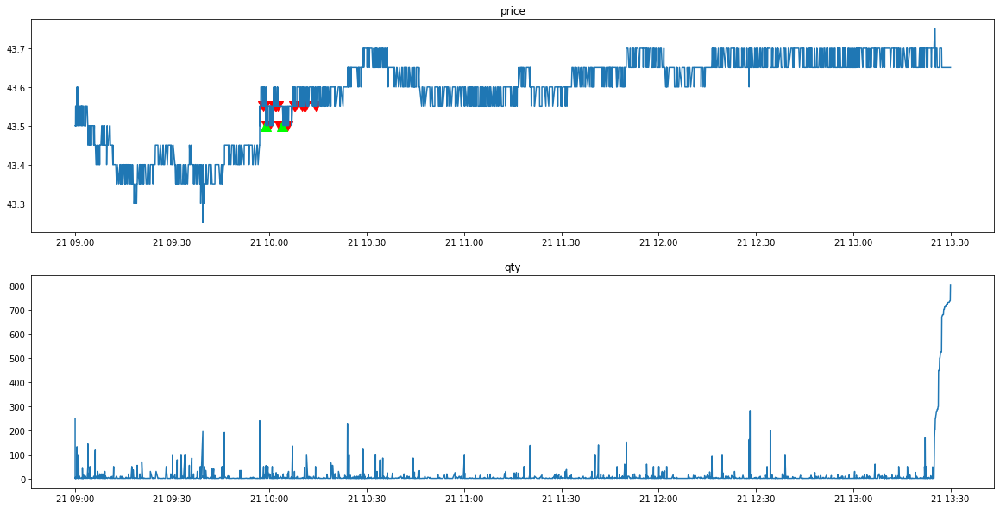

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90005843
clear_position:  0.0
position:  []
tick_row_price 43.65
----------Result Report--------------
profit:  0.0


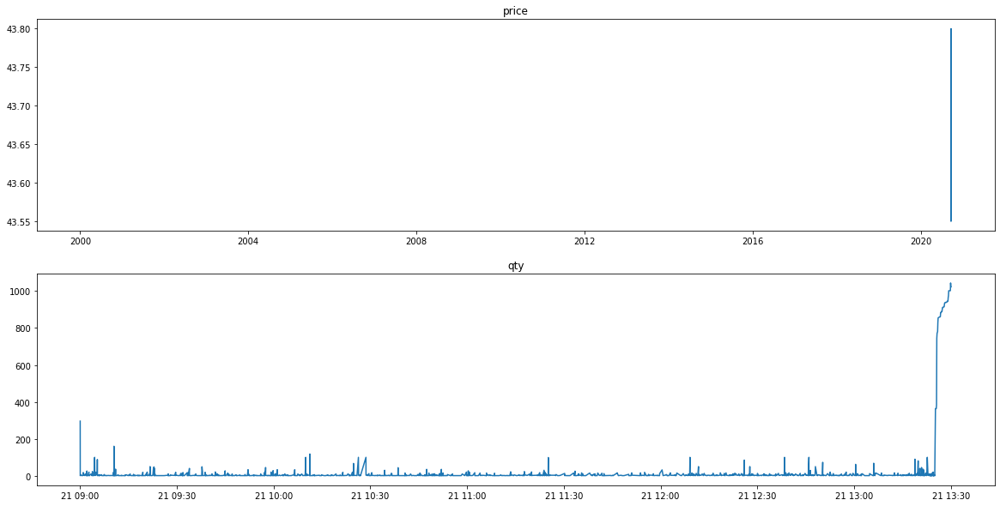

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90007334
*** bid1_p:  43.7
*** weighted_p:  43.589123711340214
ask1_p:  43.75
進場時間： 100105890 
  sell price at  43.7
stop profit
出場時間： 100106009
POSITION(pre):  [43.7]
Order_p(pre):  [43.65]
tick_row price:  43.65
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  43.65
*** weighted_p:  43.58930629888844
ask1_p:  43.7
進場時間： 100136596 
  sell price at  43.65
*** bid1_p:  43.65
*** weighted_p:  43.58931878987447
ask1_p:  43.7
進場時間： 100206482 
  sell price at  43.65
*** bid1_p:  43.65
*** weighted_p:  43.58931878987447
ask1_p:  43.7
進場時間： 100241625 
  sell price at  43.65
*** bid1_p:  43.65
*** weighted_p:  43.589343756428725
ask1_p:  43.7
進場時間： 100301437 
  sell price at  43.65
*** bid1_p:  43.65
***

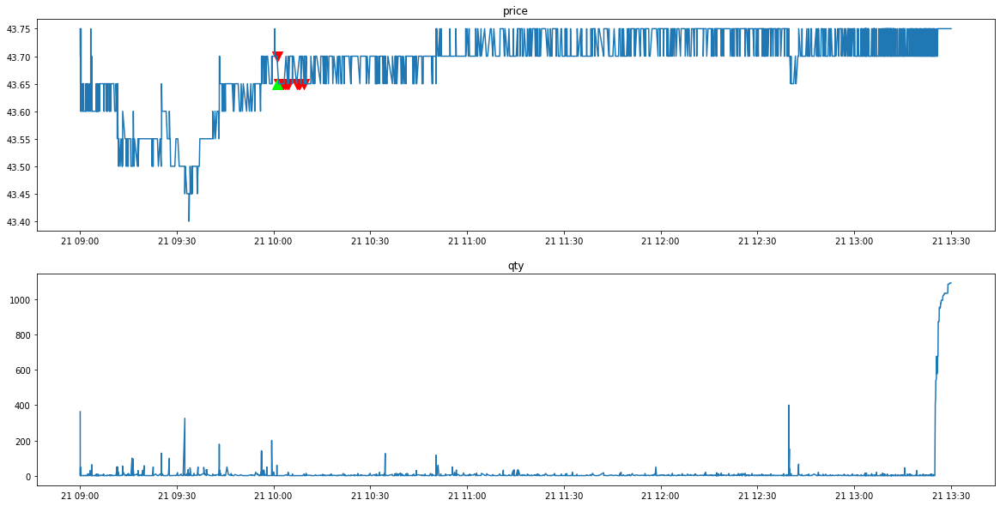

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90007621
clear_position:  0.0
position:  []
tick_row_price 43.25
----------Result Report--------------
profit:  0.0


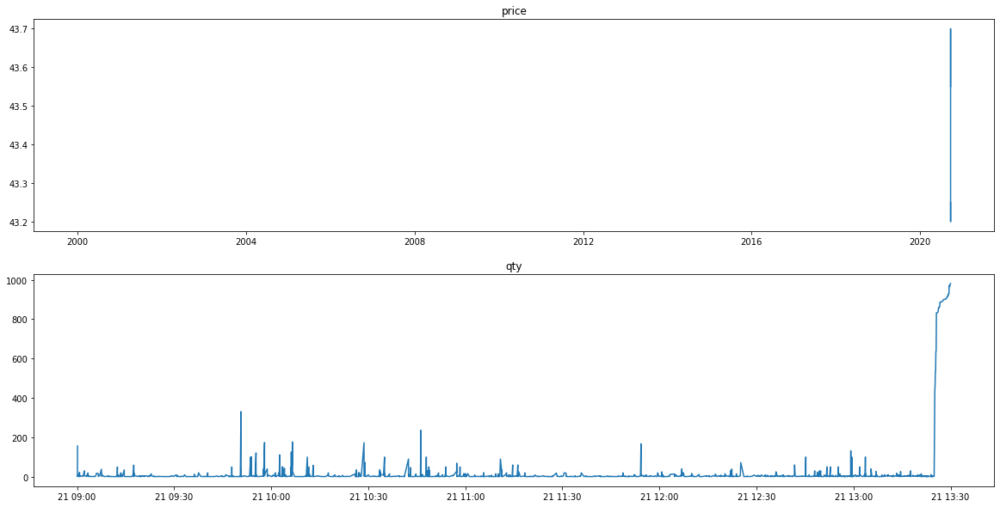

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90008887
clear_position:  0.0
position:  []
tick_row_price 43.15
----------Result Report--------------
profit:  0.0


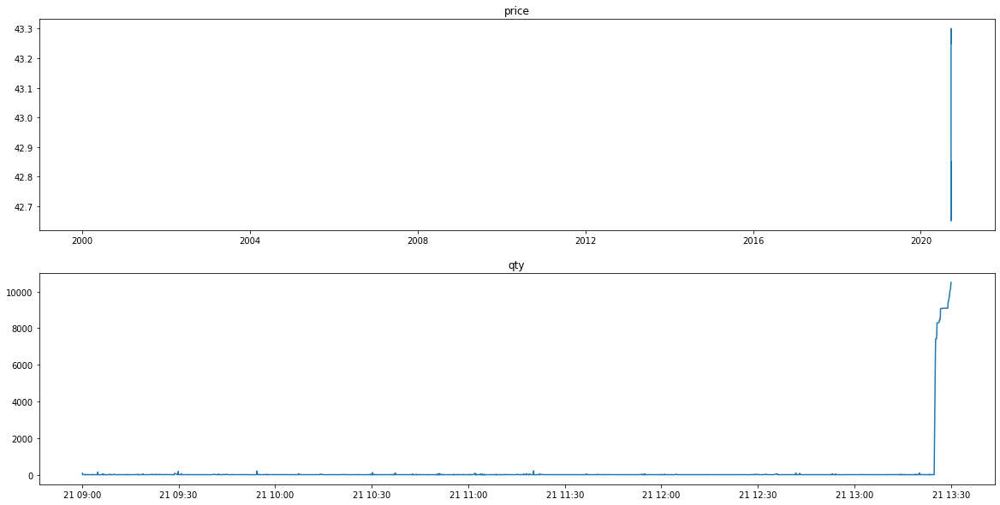

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90010187
*** bid1_p:  42.85
*** weighted_p:  42.78079159212882
ask1_p:  42.9
進場時間： 93015735 
  sell price at  42.85
*** bid1_p:  42.85
*** weighted_p:  42.7810298707089
ask1_p:  42.9
進場時間： 93045936 
  sell price at  42.85
*** bid1_p:  42.85
*** weighted_p:  42.78120551601427
ask1_p:  42.9
進場時間： 93106548 
  sell price at  42.85
*** bid1_p:  42.85
*** weighted_p:  42.78120551601427
ask1_p:  42.9
進場時間： 93137433 
  sell price at  42.85
*** bid1_p:  42.85
*** weighted_p:  42.79578313253017
ask1_p:  42.9
進場時間： 93951125 
  sell price at  42.85
stop profit
出場時間： 93951125
POSITION(pre):  [42.85 42.85 42.85 42.85 42.85]
Order_p(pre):  [42.8 42.8 42.8 42.8 42.8]
tick_row price:  42.8
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
POSITIO

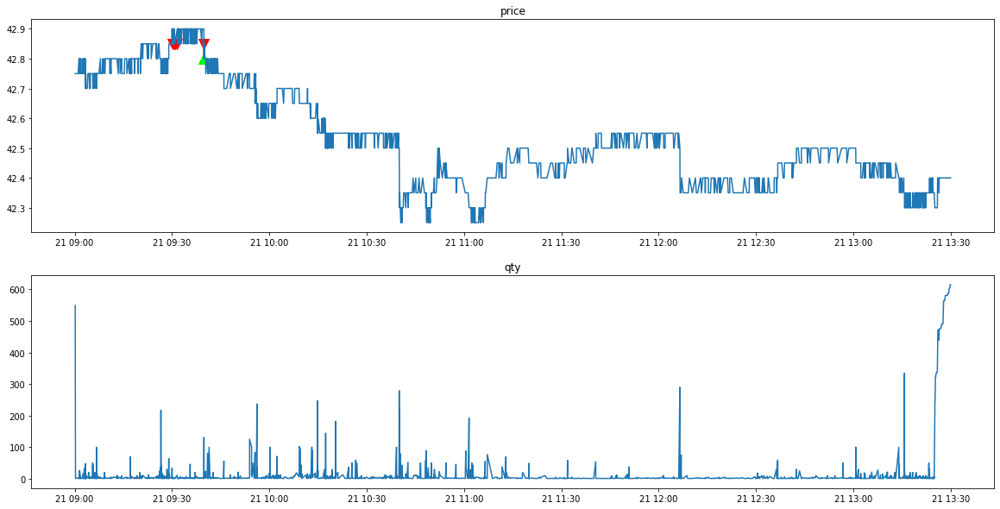

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90006832
*** bid1_p:  42.05
*** weighted_p:  41.943349113525194
ask1_p:  42.1
進場時間： 112755342 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.943349113525194
ask1_p:  42.1
進場時間： 112800327 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.94340847945143
ask1_p:  42.1
進場時間： 112831122 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.94341836734758
ask1_p:  42.1
進場時間： 112900120 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.94341836734758
ask1_p:  42.1
進場時間： 112934170 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.943563484708704
ask1_p:  42.1
進場時間： 113005261 
  sell price at  42.05
*** bid1_p:  42.05
*** weighted_p:  41.943722803444764
ask1_p:  42.1
進場時間

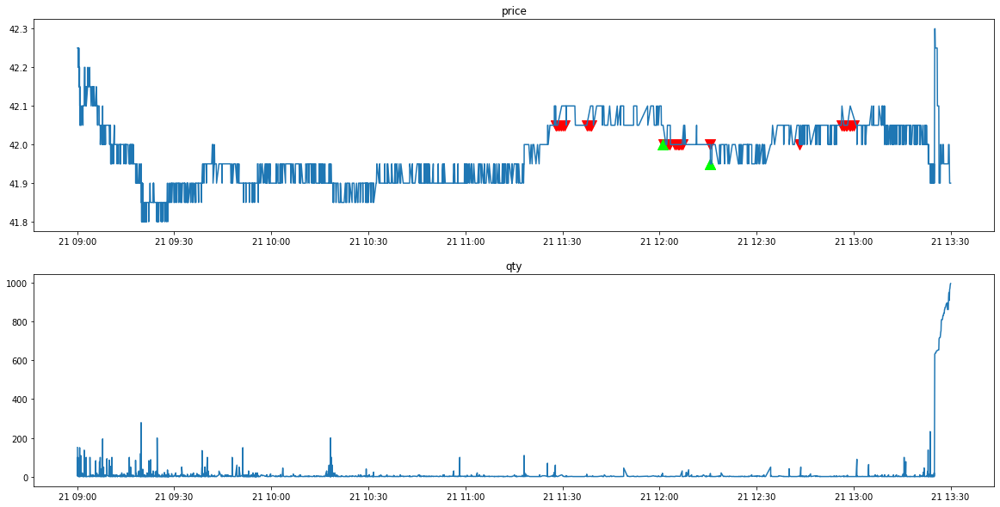

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90006392
*** bid1_p:  41.6
*** weighted_p:  41.54784518828469
ask1_p:  41.65
進場時間： 124353831 
  sell price at  41.6
*** bid1_p:  41.6
*** weighted_p:  41.547851422424266
ask1_p:  41.65
進場時間： 124400544 
  sell price at  41.6
*** bid1_p:  41.6
*** weighted_p:  41.54790335105447
ask1_p:  41.65
進場時間： 124449935 
  sell price at  41.6
*** bid1_p:  41.6
*** weighted_p:  41.54790646278837
ask1_p:  41.65
進場時間： 124503906 
  sell price at  41.6
*** bid1_p:  41.6
*** weighted_p:  41.54802827824859
ask1_p:  41.65
進場時間： 124534661 
  sell price at  41.6
*** bid1_p:  41.6
*** weighted_p:  41.54854892205656
ask1_p:  41.65
進場時間： 124949447 
  sell price at  41.6
stop profit
出場時間： 124957201
POSITION(pre):  [41.6 41.6 41.6 41.6 41.6 41.6]
Order

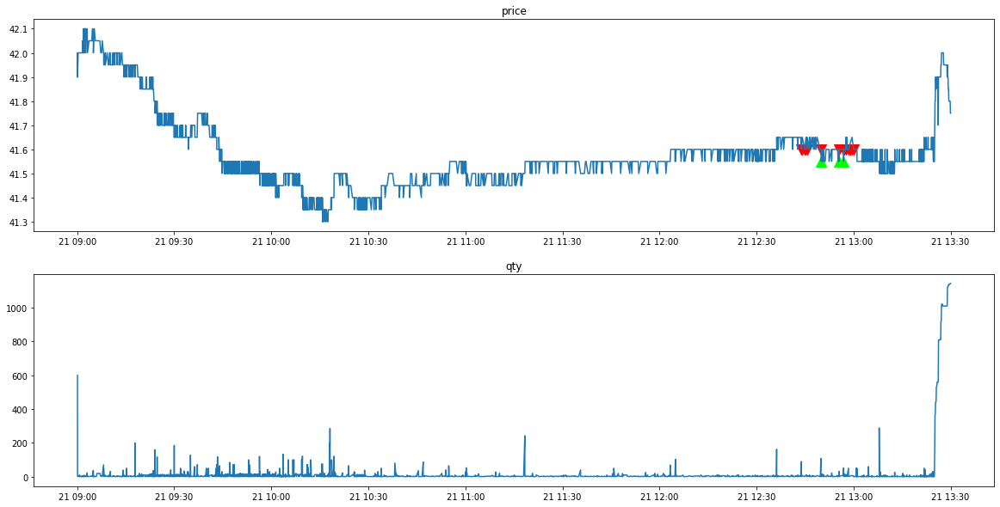

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90005108
clear_position:  0.0
position:  []
tick_row_price 40.65
----------Result Report--------------
profit:  0.0


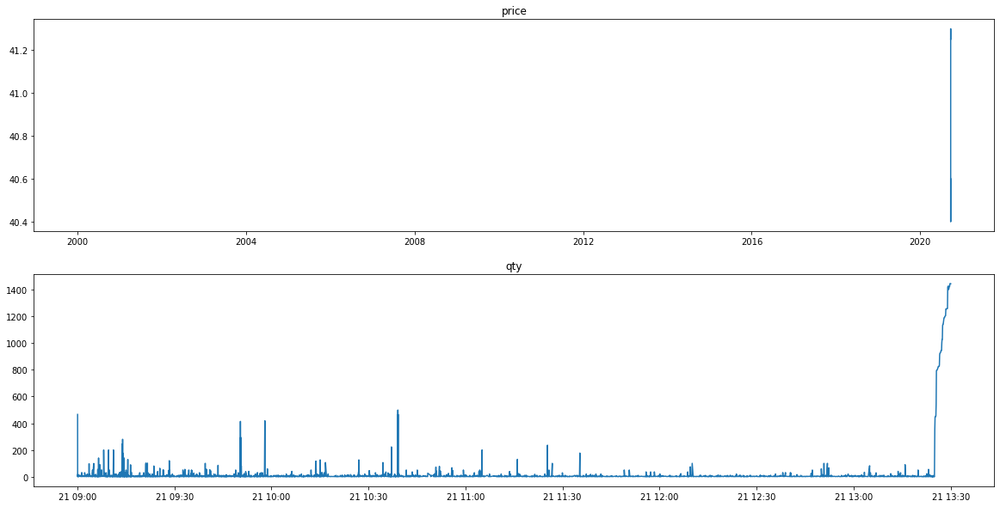

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2881/tse_lob_2881.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2881/tse_tick_2881.csv' mode='r' encoding='UTF-8'>
90004526
*** bid1_p:  40.85
*** weighted_p:  40.80764218009475
ask1_p:  40.9
進場時間： 91115088 
  sell price at  40.85
stop profit
出場時間： 91208572
POSITION(pre):  [40.85]
Order_p(pre):  [40.8]
tick_row price:  40.8
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  40.9
*** weighted_p:  40.85083173384516
ask1_p:  40.95
進場時間： 92131847 
  sell price at  40.9
*** bid1_p:  40.9
*** weighted_p:  40.85133672819858
ask1_p:  40.95
進場時間： 92200259 
  sell price at  40.9
*** bid1_p:  40.95
*** weighted_p:  40.86460299833421
ask1_p:  41.0
進場時間： 92633725 
  sell price at  40.95
*** bid1_p:  40.95
*** weighted_p:  40.887551771744086
ask1_p:  41.0
進場時間： 93015263 
  sell price at  40.95
*** bid1_p:  40.95
*** weighted

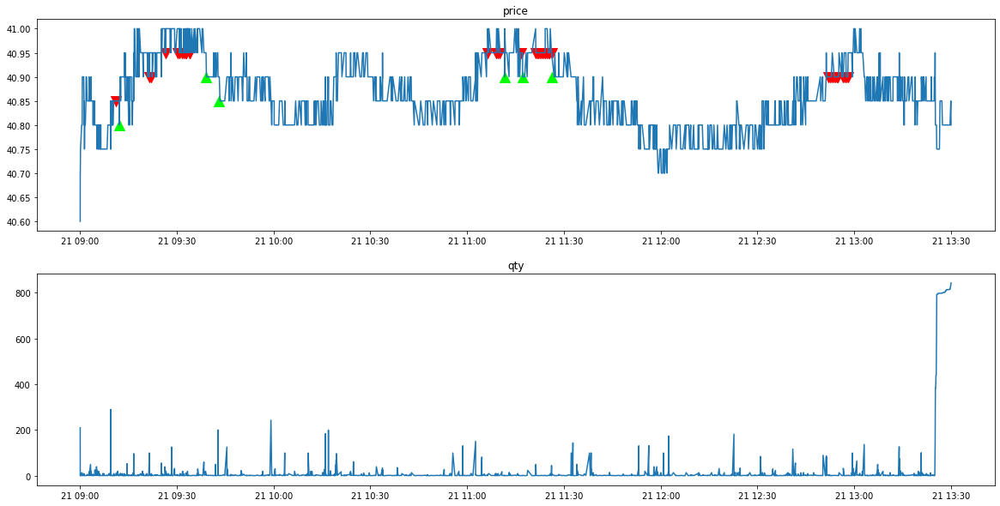

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90015723
*** bid1_p:  3480.0
*** weighted_p:  3475.7291666666665
ask1_p:  3485.0
進場時間： 90747177 
  sell price at  3480.0
stop profit
出場時間： 90747203
POSITION(pre):  [3480.]
Order_p(pre):  [3475.]
tick_row price:  3475.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  3475.0
*** weighted_p:  3453.2509505703424
ask1_p:  3480.0
進場時間： 93854668 
  sell price at  3475.0
*** bid1_p:  3465.0
*** weighted_p:  3453.3333333333335
ask1_p:  3475.0
進場時間： 93900202 
  sell price at  3465.0
*** bid1_p:  3465.0
*** weighted_p:  3453.4150943396226
ask1_p:  3480.0
進場時間： 93935254 
  sell price at  3465.0
*** bid1_p:  3470.0
*** weighted_p:  3453.4150943396226
ask1_p:  3480.0
進場時間： 94002581 
  sell price at  3470.0
st

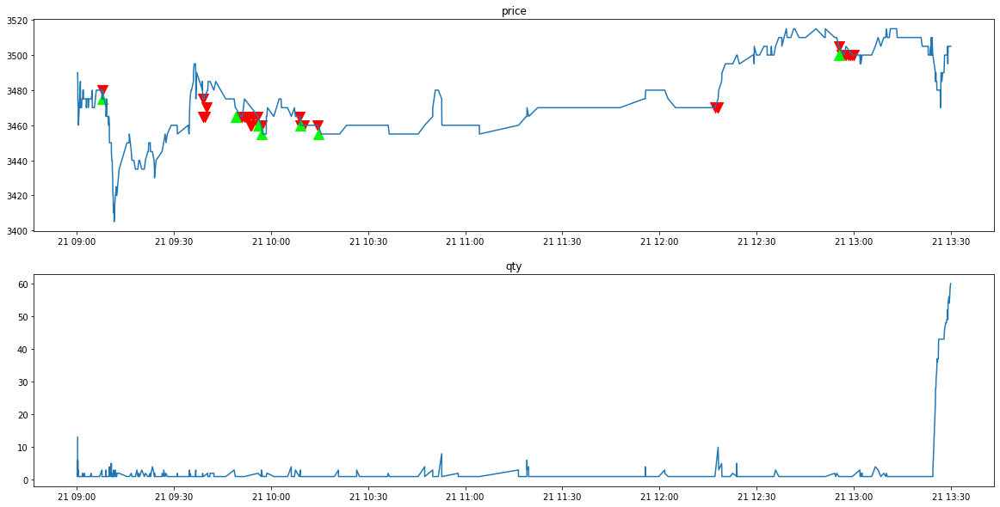

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90012490
*** bid1_p:  3555.0
*** weighted_p:  3542.121212121212
ask1_p:  3565.0
進場時間： 91049788 
  sell price at  3555.0
*** bid1_p:  3560.0
*** weighted_p:  3542.121212121212
ask1_p:  3565.0
進場時間： 91102268 
  sell price at  3560.0
*** bid1_p:  3565.0
*** weighted_p:  3552.0754716981132
ask1_p:  3570.0
進場時間： 91258456 
  sell price at  3565.0
stop profit
出場時間： 91324872
POSITION(pre):  [3555. 3560. 3565.]
Order_p(pre):  [3550. 3555. 3560.]
tick_row price:  3555.0
qualified index:  [[1]
 [2]]
POSITION(post):  [3555.]
Order_p(post):  [3550.]

*** bid1_p:  3560.0
*** weighted_p:  3552.7678571428573
ask1_p:  3570.0
進場時間： 91422130 
  sell price at  3560.0
*** bid1_p:  3560.0
*** weighted_p:  3552.7678571428573
ask1_p:  3570.0
進場時間：

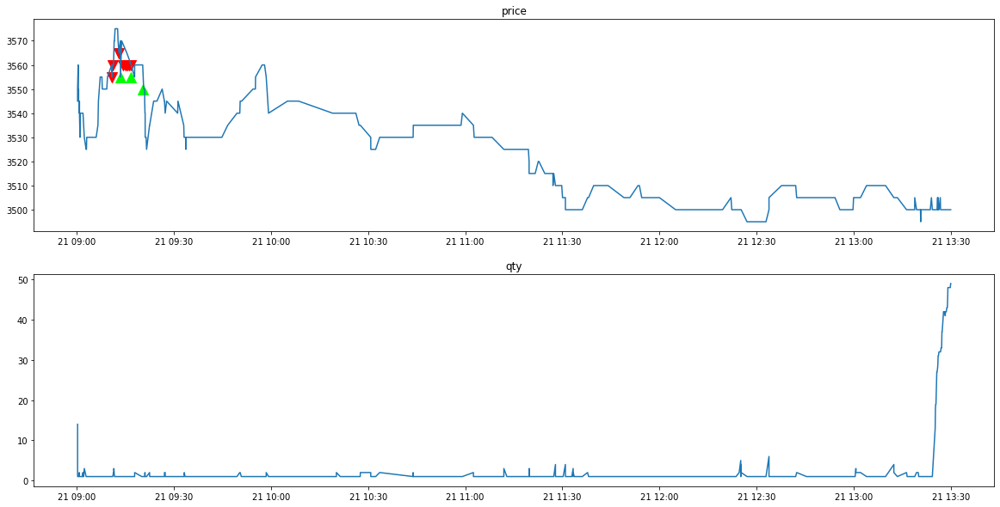

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90015173
*** bid1_p:  3510.0
*** weighted_p:  3502.5
ask1_p:  3520.0
進場時間： 105050997 
  sell price at  3510.0
stop profit
出場時間： 105050997
POSITION(pre):  [3510.]
Order_p(pre):  [3505.]
tick_row price:  3505.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  3515.0
*** weighted_p:  3502.24358974359
ask1_p:  3520.0
進場時間： 122839809 
  sell price at  3515.0
stop profit
出場時間： 122839809
POSITION(pre):  [3515.]
Order_p(pre):  [3510.]
tick_row price:  3510.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  3510.0
*** weighted_p:  3502.24358974359
ask1_p:  3520.0
進場時間： 122921248 
  sell price at  3510.0
*** bid1_p:  3510.0
*** weighted_p:  3502.292993630573
ask1_p:  3515.0
進場時間

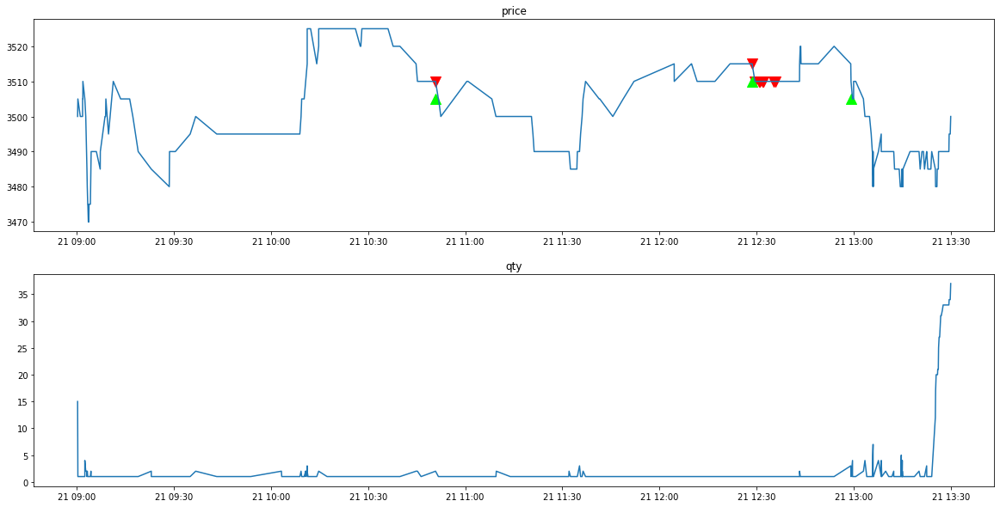

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90013569
*** bid1_p:  3560.0
*** weighted_p:  3550.9322033898306
ask1_p:  3565.0
進場時間： 91754954 
  sell price at  3560.0
*** bid1_p:  3560.0
*** weighted_p:  3550.9322033898306
ask1_p:  3565.0
進場時間： 91817937 
  sell price at  3560.0
*** bid1_p:  3555.0
*** weighted_p:  3551.3709677419356
ask1_p:  3565.0
進場時間： 91848847 
  sell price at  3555.0
*** bid1_p:  3555.0
*** weighted_p:  3551.3709677419356
ask1_p:  3565.0
進場時間： 91904754 
  sell price at  3555.0
*** bid1_p:  3555.0
*** weighted_p:  3551.3709677419356
ask1_p:  3565.0
進場時間： 91937604 
  sell price at  3555.0
*** bid1_p:  3555.0
*** weighted_p:  3551.3709677419356
ask1_p:  3565.0
進場時間： 92001571 
  sell price at  3555.0
*** bid1_p:  3555.0
*** weighted_p:  3551.3709677419

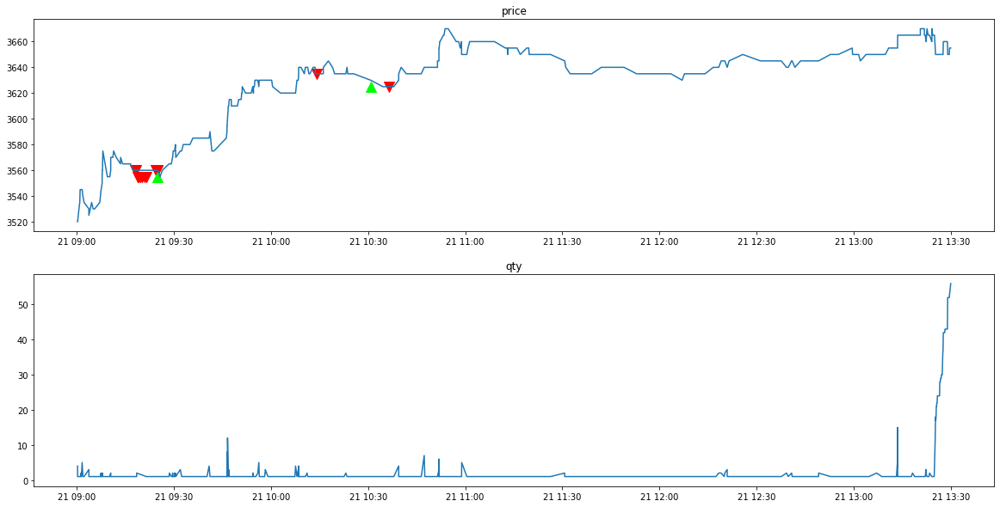

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90013493
clear_position:  0.0
position:  []
tick_row_price 3660.0
----------Result Report--------------
profit:  0.0


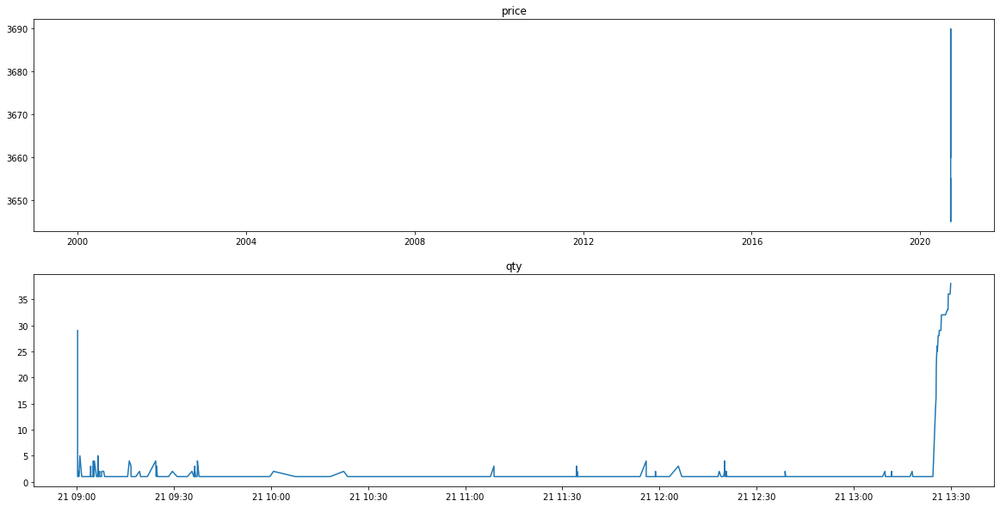

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90013948
clear_position:  0.0
position:  []
tick_row_price 3575.0
----------Result Report--------------
profit:  0.0


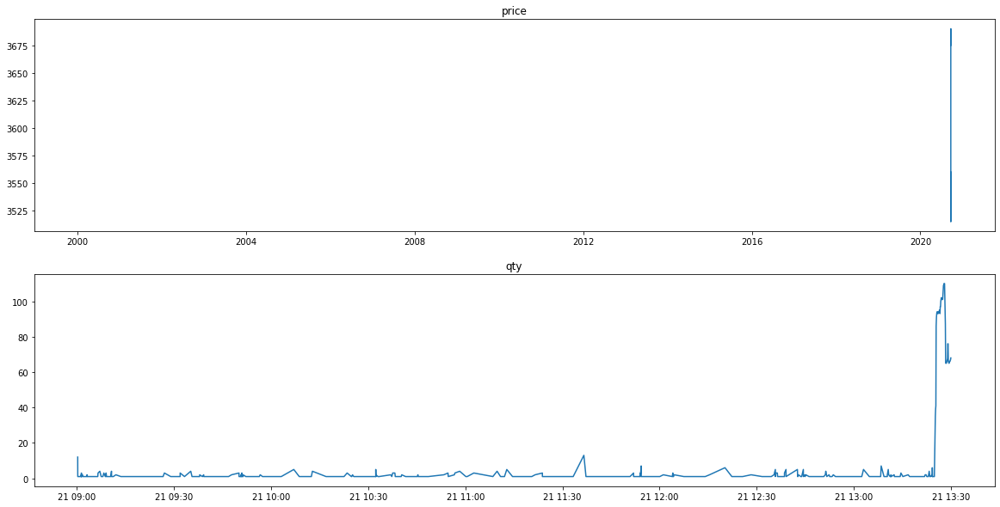

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90012572
*** bid1_p:  3570.0
*** weighted_p:  3540.5405405405404
ask1_p:  3580.0
進場時間： 90723612 
  sell price at  3570.0
*** bid1_p:  3560.0
*** weighted_p:  3543.2716049382716
ask1_p:  3570.0
進場時間： 90754173 
  sell price at  3560.0
*** bid1_p:  3560.0
*** weighted_p:  3543.5975609756097
ask1_p:  3570.0
進場時間： 90800308 
  sell price at  3560.0
*** bid1_p:  3565.0
*** weighted_p:  3543.5975609756097
ask1_p:  3570.0
進場時間： 90836431 
  sell price at  3565.0
stop profit
出場時間： 90913338
POSITION(pre):  [3570. 3560. 3560. 3565.]
Order_p(pre):  [3565. 3555. 3555. 3560.]
tick_row price:  3565.0
qualified index:  [[0]]
POSITION(post):  [3560. 3560. 3565.]
Order_p(post):  [3555. 3555. 3560.]

*** bid1_p:  3590.0
*** weighted_p:  3567.75

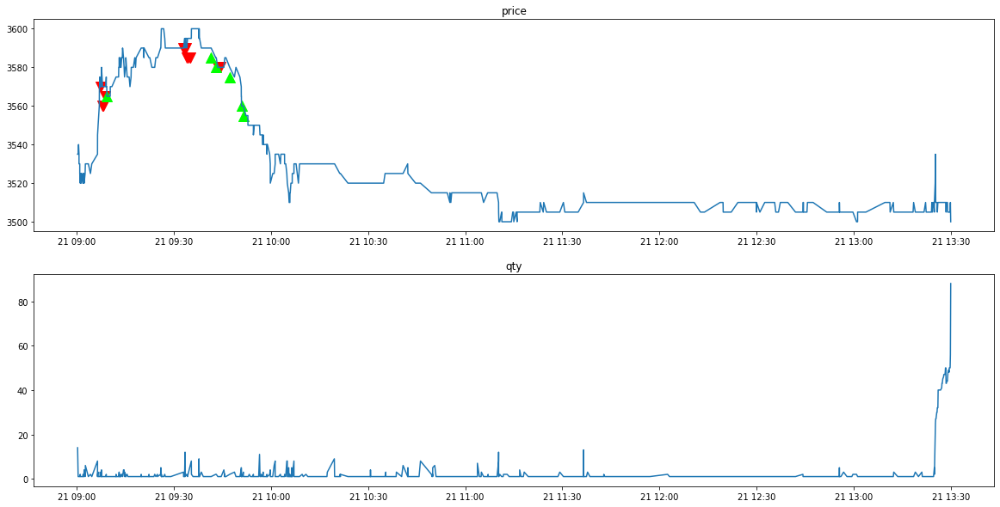

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90008684
clear_position:  0.0
position:  []
tick_row_price 3495.0
----------Result Report--------------
profit:  0.0


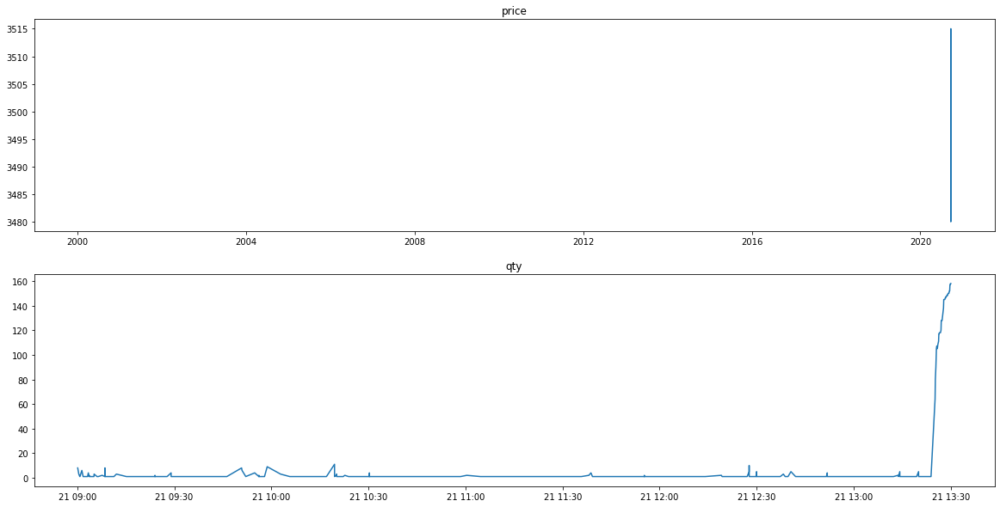

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90018811
*** bid1_p:  3540.0
*** weighted_p:  3534.1304347826085
ask1_p:  3545.0
進場時間： 92426283 
  sell price at  3540.0
stop profit
出場時間： 92758859
POSITION(pre):  [3540.]
Order_p(pre):  [3535.]
tick_row price:  3535.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 3495.0
----------Result Report--------------
profit:  5.0


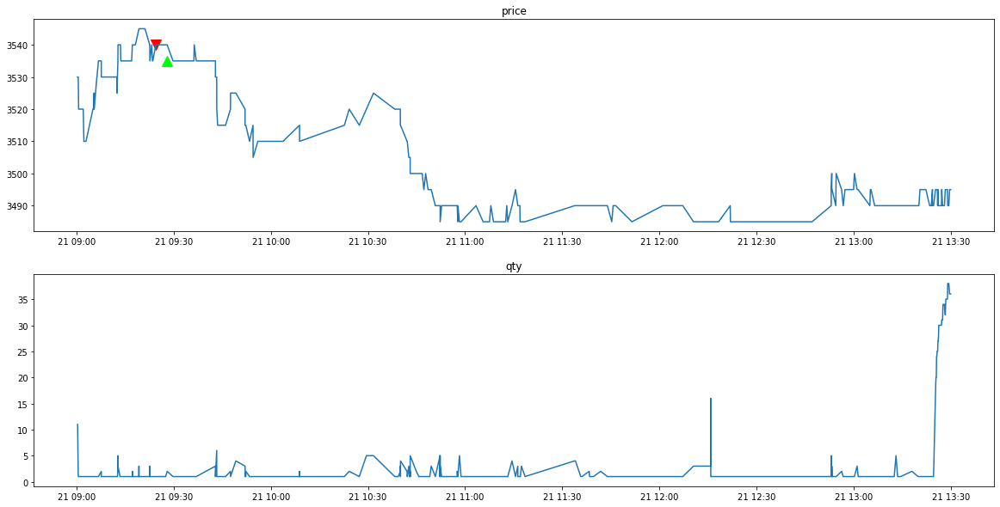

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90014662
clear_position:  0.0
position:  []
tick_row_price 3450.0
----------Result Report--------------
profit:  0.0


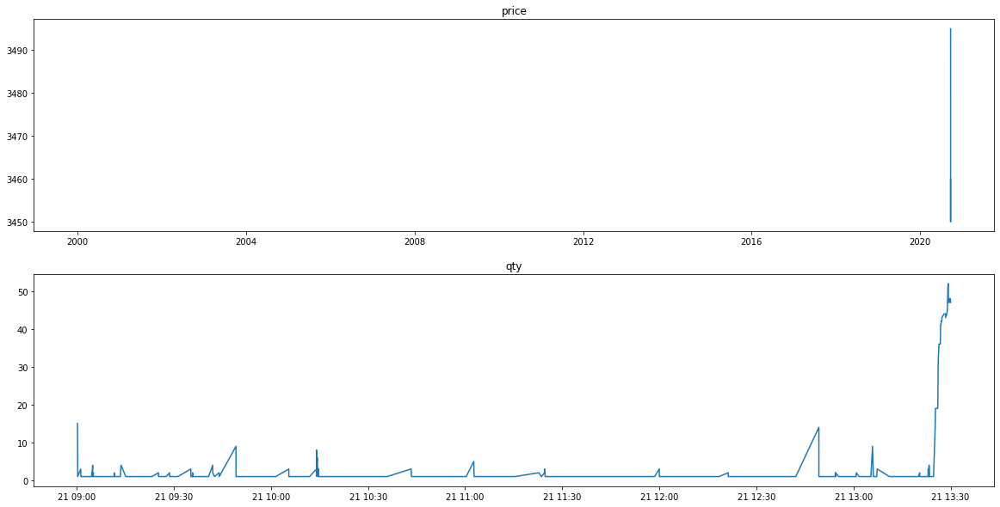

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90019029
*** bid1_p:  3460.0
*** weighted_p:  3450.662251655629
ask1_p:  3465.0
進場時間： 125258710 
  sell price at  3460.0
*** bid1_p:  3455.0
*** weighted_p:  3450.662251655629
ask1_p:  3465.0
進場時間： 125323241 
  sell price at  3455.0
*** bid1_p:  3460.0
*** weighted_p:  3450.703296703297
ask1_p:  3465.0
進場時間： 125612598 
  sell price at  3460.0
*** bid1_p:  3460.0
*** weighted_p:  3450.7439824945295
ask1_p:  3465.0
進場時間： 125643789 
  sell price at  3460.0
stop profit
出場時間： 125643789
POSITION(pre):  [3460. 3455. 3460. 3460.]
Order_p(pre):  [3455. 3450. 3455. 3455.]
tick_row price:  3455.0
qualified index:  [[0]
 [2]
 [3]]
POSITION(post):  [3455.]
Order_p(post):  [3450.]

*** bid1_p:  3455.0
*** weighted_p:  3450.7439824945295


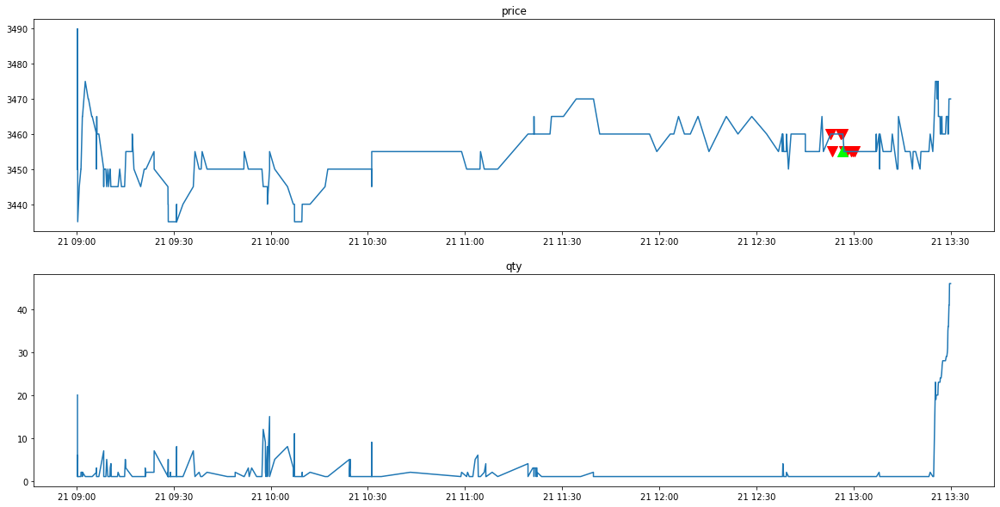

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90013942
*** bid1_p:  3475.0
*** weighted_p:  3456.273291925466
ask1_p:  3480.0
進場時間： 93252417 
  sell price at  3475.0
*** bid1_p:  3470.0
*** weighted_p:  3456.273291925466
ask1_p:  3480.0
進場時間： 93300194 
  sell price at  3470.0
*** bid1_p:  3470.0
*** weighted_p:  3456.273291925466
ask1_p:  3480.0
進場時間： 93334975 
  sell price at  3470.0
*** bid1_p:  3475.0
*** weighted_p:  3456.273291925466
ask1_p:  3480.0
進場時間： 93401745 
  sell price at  3475.0
*** bid1_p:  3475.0
*** weighted_p:  3456.273291925466
ask1_p:  3480.0
進場時間： 93433286 
  sell price at  3475.0
stop profit
出場時間： 94201485
POSITION(pre):  [3475. 3470. 3470. 3475. 3475.]
Order_p(pre):  [3470. 3465. 3465. 3470. 3470.]
tick_row price:  3470.0
qualified index:  [[0]


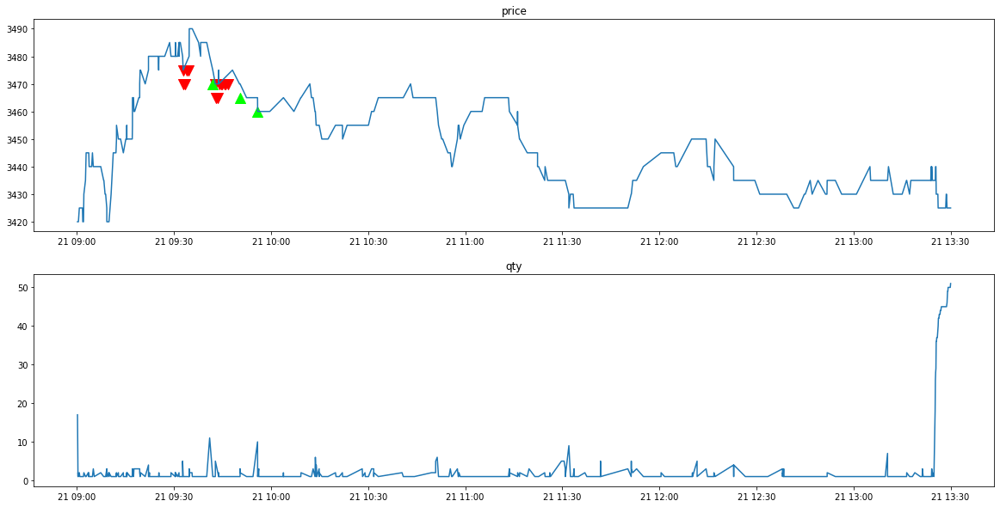

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3008/tse_lob_3008.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3008/tse_tick_3008.csv' mode='r' encoding='UTF-8'>
90011747
clear_position:  0.0
position:  []
tick_row_price 3355.0
----------Result Report--------------
profit:  0.0


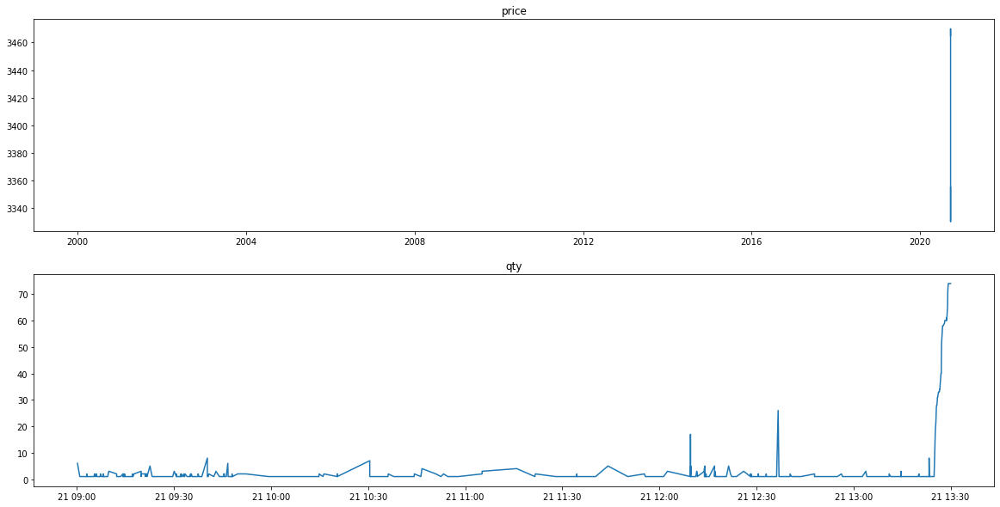

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90005696
*** bid1_p:  65.3
*** weighted_p:  65.07243308030347
ask1_p:  65.4
進場時間： 94438092 
  sell price at  65.3
*** bid1_p:  65.3
*** weighted_p:  65.0754731861197
ask1_p:  65.4
進場時間： 94500042 
  sell price at  65.3
*** bid1_p:  65.3
*** weighted_p:  65.07600314712805
ask1_p:  65.4
進場時間： 94530856 
  sell price at  65.3
*** bid1_p:  65.3
*** weighted_p:  65.0763550667712
ask1_p:  65.4
進場時間： 94603276 
  sell price at  65.3
*** bid1_p:  65.3
*** weighted_p:  65.07670588235271
ask1_p:  65.4
進場時間： 94634108 
  sell price at  65.3
*** bid1_p:  65.3
*** weighted_p:  65.07708578143338
ask1_p:  65.4
進場時間： 94700199 
  sell price at  65.3
stop profit
出場時間： 94729504
POSITION(pre):  [65.3 65.3 65.3 65.3 65.3 65.3]
Order_p(pre):  [65.2 

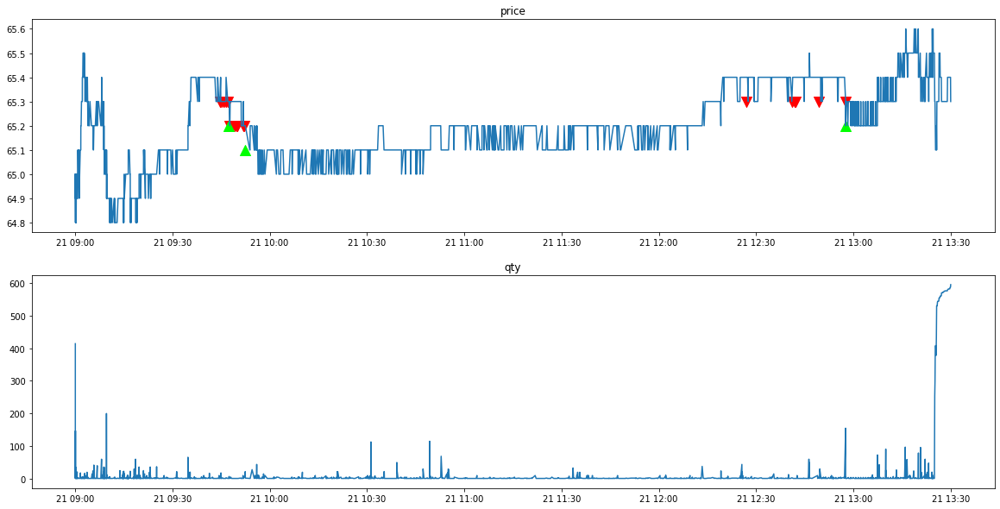

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90005306
*** bid1_p:  65.6
*** weighted_p:  65.26954022988505
ask1_p:  65.7
進場時間： 90840079 
  sell price at  65.6
*** bid1_p:  65.6
*** weighted_p:  65.28312586445364
ask1_p:  65.7
進場時間： 90906567 
  sell price at  65.6
stop profit
出場時間： 90919526
POSITION(pre):  [65.6 65.6]
Order_p(pre):  [65.5 65.5]
tick_row price:  65.5
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  65.6
*** weighted_p:  65.30348387096767
ask1_p:  65.7
進場時間： 91236493 
  sell price at  65.6
*** bid1_p:  65.6
*** weighted_p:  65.30801526717549
ask1_p:  65.7
進場時間： 91300956 
  sell price at  65.6
stop profit
出場時間： 91325340
POSITION(pre):  [65.6 65.6]
Order_p(pre):  [65.5 65.5]
tick_row price:  65.5
qualified index:  [[0]
 [1]

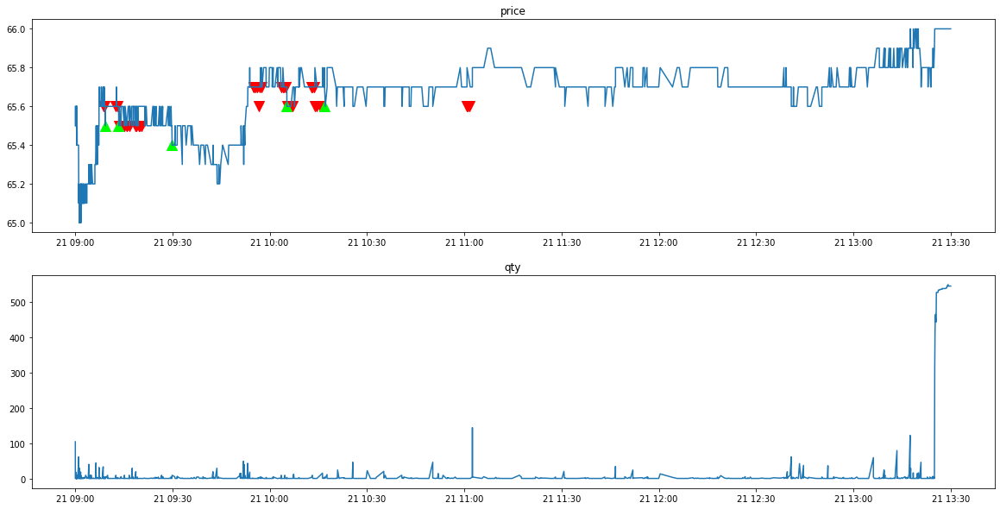

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90008754
*** bid1_p:  65.8
*** weighted_p:  65.65481927710839
ask1_p:  65.9
進場時間： 91230260 
  sell price at  65.8
*** bid1_p:  65.8
*** weighted_p:  65.65798816568044
ask1_p:  65.9
進場時間： 91300002 
  sell price at  65.8
*** bid1_p:  65.8
*** weighted_p:  65.66046511627903
ask1_p:  65.9
進場時間： 91339033 
  sell price at  65.8
*** bid1_p:  65.8
*** weighted_p:  65.66206896551721
ask1_p:  65.9
進場時間： 91400594 
  sell price at  65.8
*** bid1_p:  65.8
*** weighted_p:  65.66573033707861
ask1_p:  65.9
進場時間： 91431106 
  sell price at  65.8
stop profit
出場時間： 91449726
POSITION(pre):  [65.8 65.8 65.8 65.8 65.8]
Order_p(pre):  [65.7 65.7 65.7 65.7 65.7]
tick_row price:  65.7
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
POSITION(post):  []
O

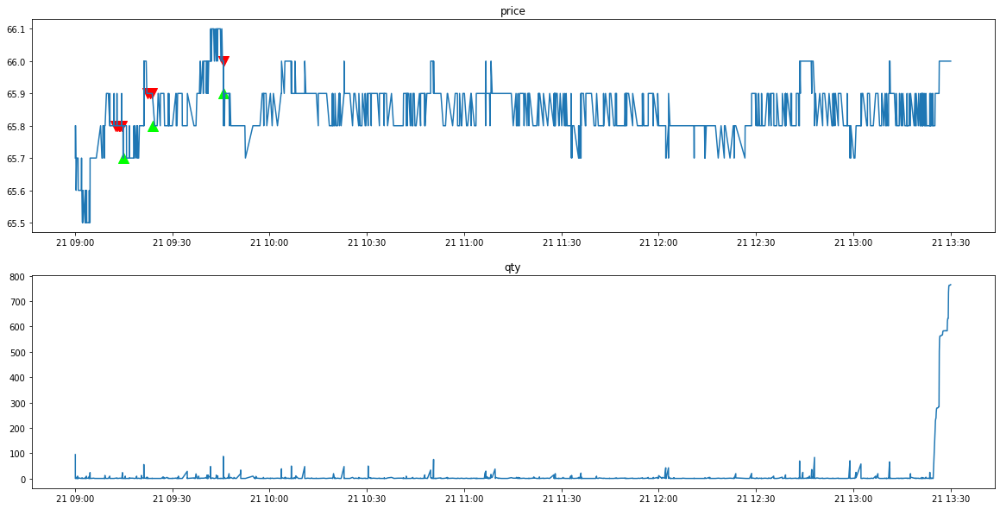

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90009151
*** bid1_p:  66.2
*** weighted_p:  66.12211703958687
ask1_p:  66.3
進場時間： 100109024 
  sell price at  66.2
stop profit
出場時間： 100110409
POSITION(pre):  [66.2]
Order_p(pre):  [66.1]
tick_row price:  66.1
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  66.2
*** weighted_p:  66.1226689478186
ask1_p:  66.3
進場時間： 100257913 
  sell price at  66.2
*** bid1_p:  66.2
*** weighted_p:  66.12299829642244
ask1_p:  66.3
進場時間： 100306029 
  sell price at  66.2
*** bid1_p:  66.2
*** weighted_p:  66.12306382978717
ask1_p:  66.3
進場時間： 100341722 
  sell price at  66.2
*** bid1_p:  66.2
*** weighted_p:  66.12306382978717
ask1_p:  66.3
進場時間： 100406792 
  sell price at  66.2
*** bid1_p:  66.2
*** weighted_p:  6

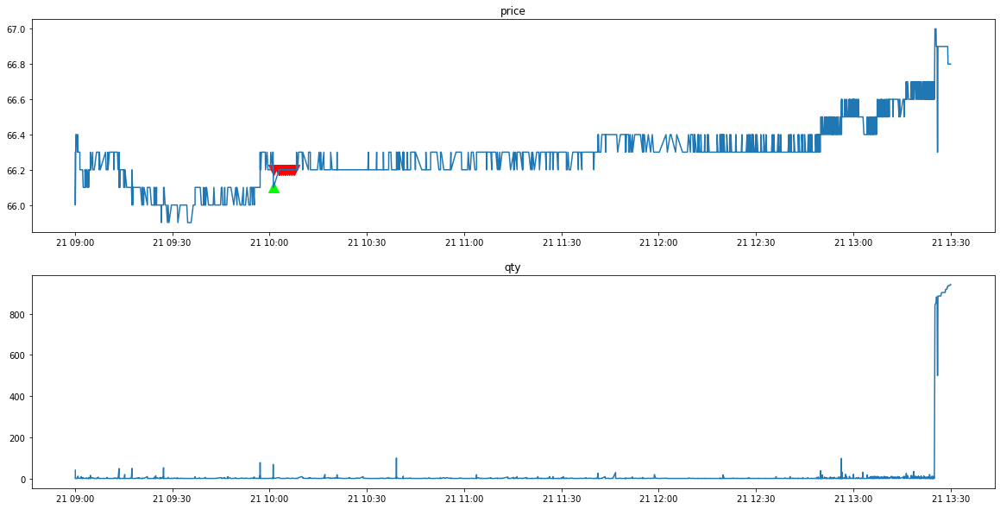

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90009253
*** bid1_p:  66.3
*** weighted_p:  66.1431372549037
ask1_p:  66.4
進場時間： 122418070 
  sell price at  66.3
*** bid1_p:  66.3
*** weighted_p:  66.14437663470093
ask1_p:  66.4
進場時間： 122515810 
  sell price at  66.3
*** bid1_p:  66.3
*** weighted_p:  66.14445090064088
ask1_p:  66.4
進場時間： 122549006 
  sell price at  66.3
*** bid1_p:  66.3
*** weighted_p:  66.14490150637482
ask1_p:  66.4
進場時間： 122600763 
  sell price at  66.3
*** bid1_p:  66.3
*** weighted_p:  66.14518368527796
ask1_p:  66.4
進場時間： 122634482 
  sell price at  66.3
*** bid1_p:  66.3
*** weighted_p:  66.14525737420644
ask1_p:  66.4
進場時間： 122700226 
  sell price at  66.3
*** bid1_p:  66.3
*** weighted_p:  66.14690011481223
ask1_p:  66.4
進場時間： 123006179 
  sel

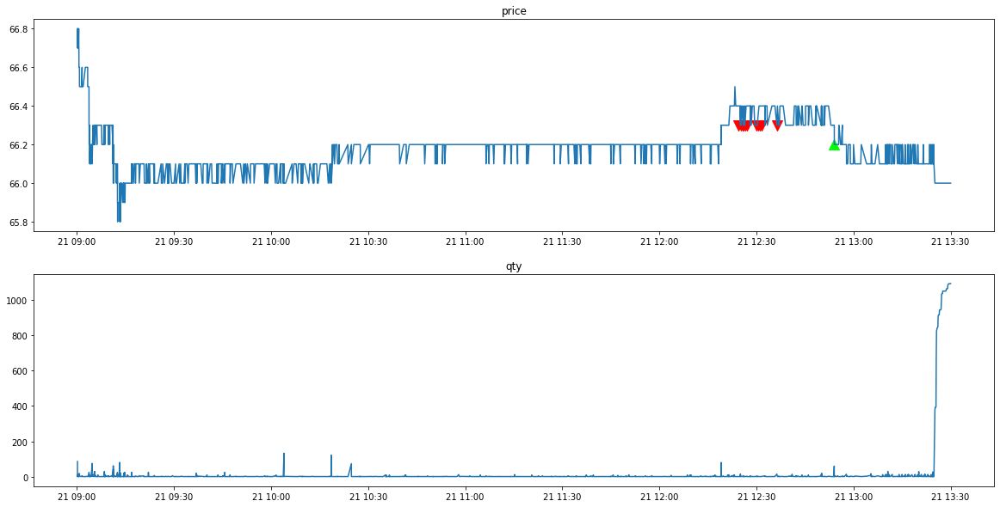

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90006130
*** bid1_p:  66.1
*** weighted_p:  65.87653149266629
ask1_p:  66.2
進場時間： 94836845 
  sell price at  66.1
*** bid1_p:  66.1
*** weighted_p:  65.87653149266629
ask1_p:  66.2
進場時間： 94900290 
  sell price at  66.1
*** bid1_p:  66.1
*** weighted_p:  65.87708871662379
ask1_p:  66.2
進場時間： 94939248 
  sell price at  66.1
*** bid1_p:  66.1
*** weighted_p:  65.8786142001713
ask1_p:  66.2
進場時間： 95152606 
  sell price at  66.1
*** bid1_p:  66.1
*** weighted_p:  65.8786142001713
ask1_p:  66.2
進場時間： 95208033 
  sell price at  66.1
*** bid1_p:  66.0
*** weighted_p:  65.88067796610191
ask1_p:  66.1
進場時間： 95238892 
  sell price at  66.0
stop profit
出場時間： 95258284
POSITION(pre):  [66.1 66.1 66.1 66.1 66.1 66. ]
Order_p(pre):  [66.  

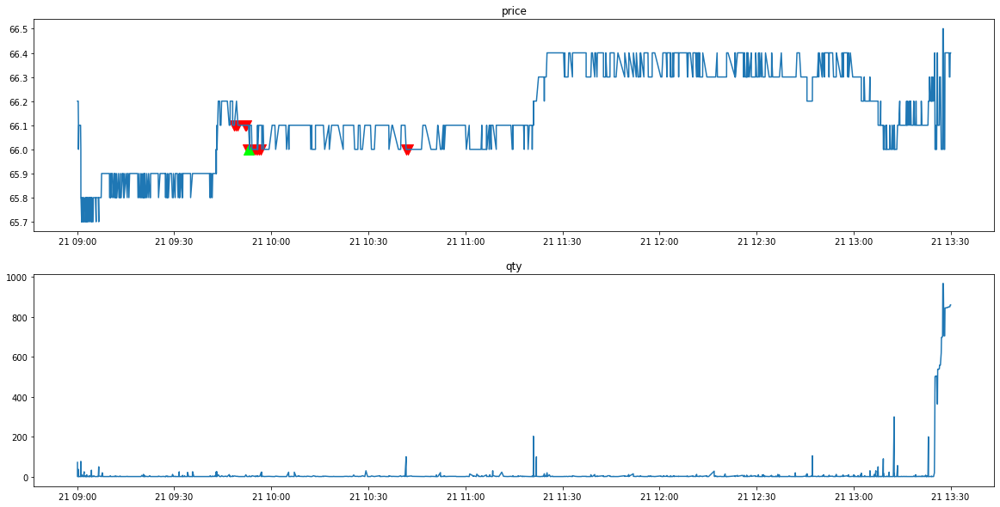

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90008762
*** bid1_p:  64.9
*** weighted_p:  64.70391061452523
ask1_p:  65.0
進場時間： 90347812 
  sell price at  64.9
*** bid1_p:  64.8
*** weighted_p:  64.70590405904065
ask1_p:  64.9
進場時間： 90400270 
  sell price at  64.8
stop profit
出場時間： 90405044
POSITION(pre):  [64.9 64.8]
Order_p(pre):  [64.8 64.7]
tick_row price:  64.8
qualified index:  [[0]]
POSITION(post):  [64.8]
Order_p(post):  [64.7]

stop profit
出場時間： 91101552
POSITION(pre):  [64.8]
Order_p(pre):  [64.7]
tick_row price:  64.7
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  64.7
*** weighted_p:  64.61509183447633
ask1_p:  64.8
進場時間： 91646255 
  sell price at  64.7
*** bid1_p:  64.7
*** weighted_p:  64.6152553614854
ask1_p:  64.8
進場時間： 917

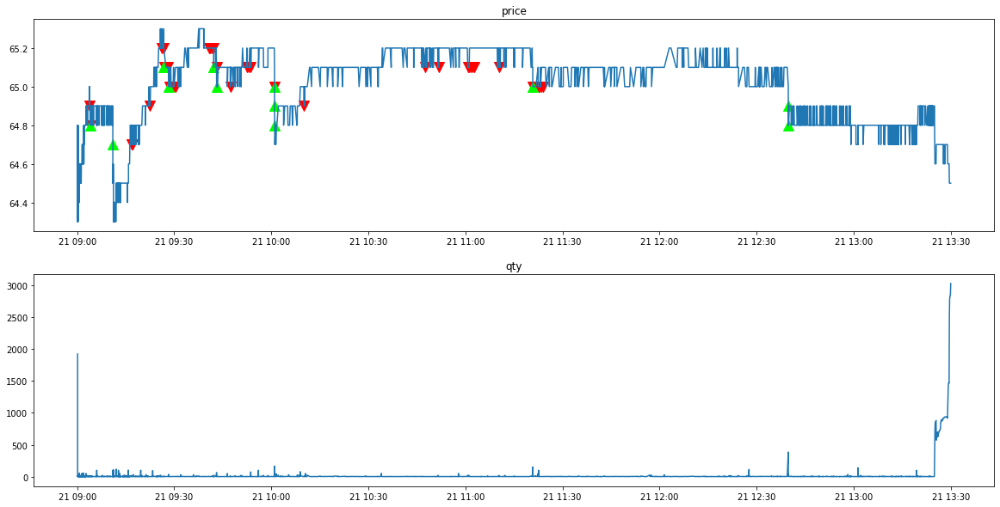

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90003064
*** bid1_p:  65.0
*** weighted_p:  64.93039215686277
ask1_p:  65.1
進場時間： 90906384 
  sell price at  65.0
stop profit
出場時間： 90944287
POSITION(pre):  [65.]
Order_p(pre):  [64.9]
tick_row price:  64.9
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 64.9
----------Result Report--------------
profit:  0.09999999999999432


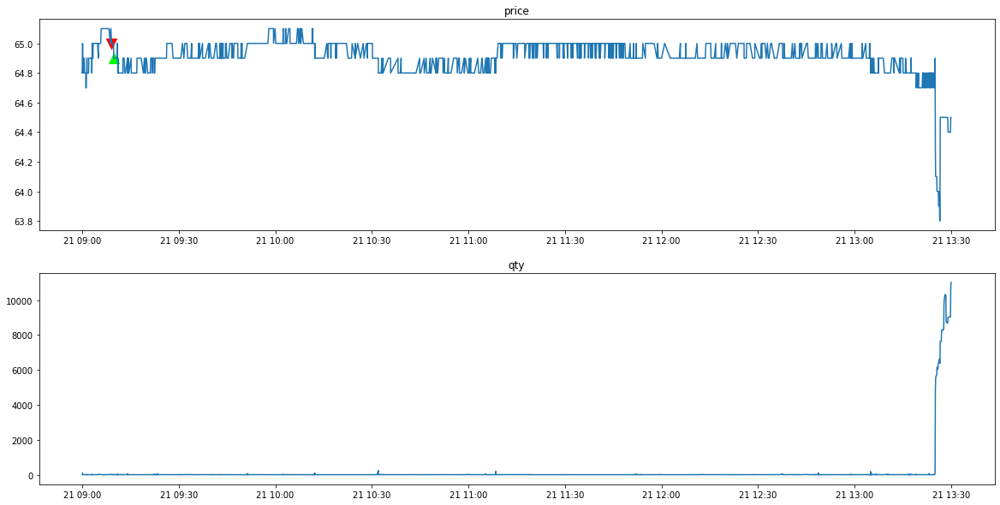

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90006869
*** bid1_p:  64.5
*** weighted_p:  64.21770708283306
ask1_p:  64.6
進場時間： 92021505 
  sell price at  64.5
*** bid1_p:  64.5
*** weighted_p:  64.21821449970034
ask1_p:  64.6
進場時間： 92052620 
  sell price at  64.5
*** bid1_p:  64.5
*** weighted_p:  64.21821449970034
ask1_p:  64.6
進場時間： 92104076 
  sell price at  64.5
*** bid1_p:  64.5
*** weighted_p:  64.21922388059693
ask1_p:  64.6
進場時間： 92135816 
  sell price at  64.5
*** bid1_p:  64.5
*** weighted_p:  64.21972586412387
ask1_p:  64.6
進場時間： 92200864 
  sell price at  64.5
*** bid1_p:  64.5
*** weighted_p:  64.22112759643909
ask1_p:  64.6
進場時間： 92231695 
  sell price at  64.5
*** bid1_p:  64.5
*** weighted_p:  64.22151748666265
ask1_p:  64.6
進場時間： 92300348 
  sell pric

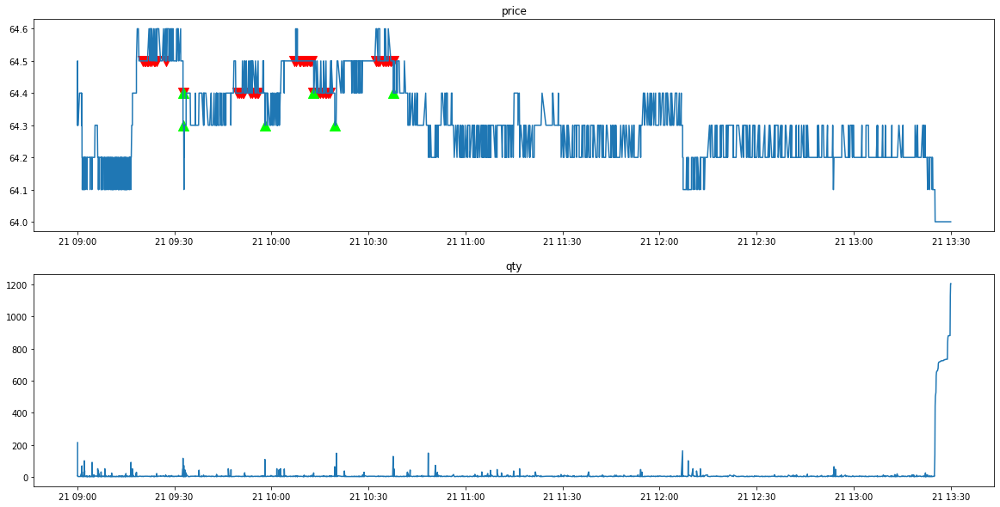

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90006223
*** bid1_p:  63.9
*** weighted_p:  63.80289634146341
ask1_p:  64.0
進場時間： 90953825 
  sell price at  63.9
stop profit
出場時間： 90953825
POSITION(pre):  [63.9]
Order_p(pre):  [63.8]
tick_row price:  63.8
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  63.9
*** weighted_p:  63.755179282868376
ask1_p:  64.0
進場時間： 94429287 
  sell price at  63.9
*** bid1_p:  64.0
*** weighted_p:  63.76837542404808
ask1_p:  64.1
進場時間： 94930644 
  sell price at  64.0
*** bid1_p:  64.0
*** weighted_p:  63.768462697814456
ask1_p:  64.1
進場時間： 95000358 
  sell price at  64.0
*** bid1_p:  64.0
*** weighted_p:  63.76871234939743
ask1_p:  64.1
進場時間： 95031305 
  sell price at  64.0
*** bid1_p:  64.1
*** weighted_p:  63.7

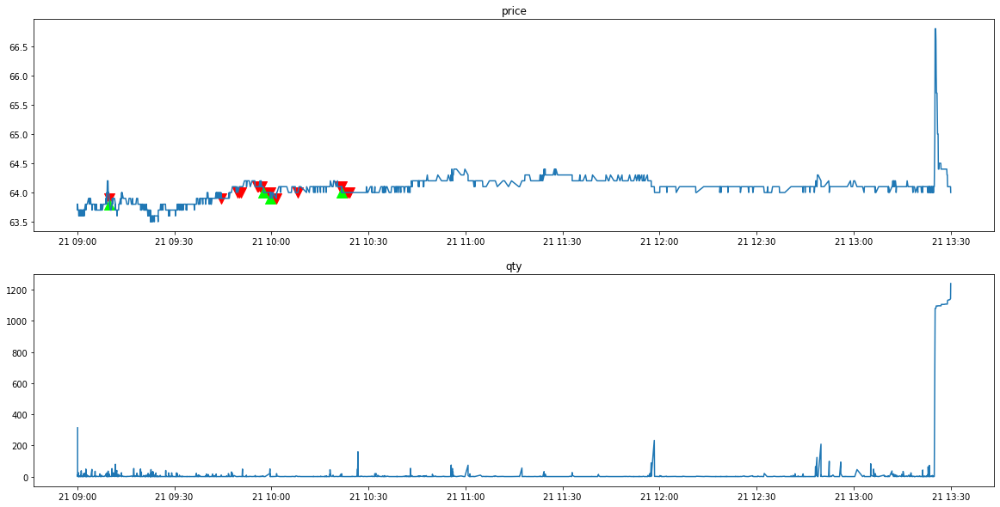

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90005389
*** bid1_p:  63.8
*** weighted_p:  63.7026591230554
ask1_p:  63.9
進場時間： 113818424 
  sell price at  63.8
stop profit
出場時間： 114121008
POSITION(pre):  [63.8]
Order_p(pre):  [63.7]
tick_row price:  63.7
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  63.9
*** weighted_p:  63.72845822956768
ask1_p:  64.0
進場時間： 124933895 
  sell price at  63.9
stop profit
出場時間： 124934204
POSITION(pre):  [63.9]
Order_p(pre):  [63.8]
tick_row price:  63.8
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  63.8
*** weighted_p:  63.730134228188014
ask1_p:  63.9
進場時間： 125000066 
  sell price at  63.8
*** bid1_p:  63.8
*** weighted_p:  63.73028609745203
ask1_p:  63.9
進場時間： 125030759 
  se

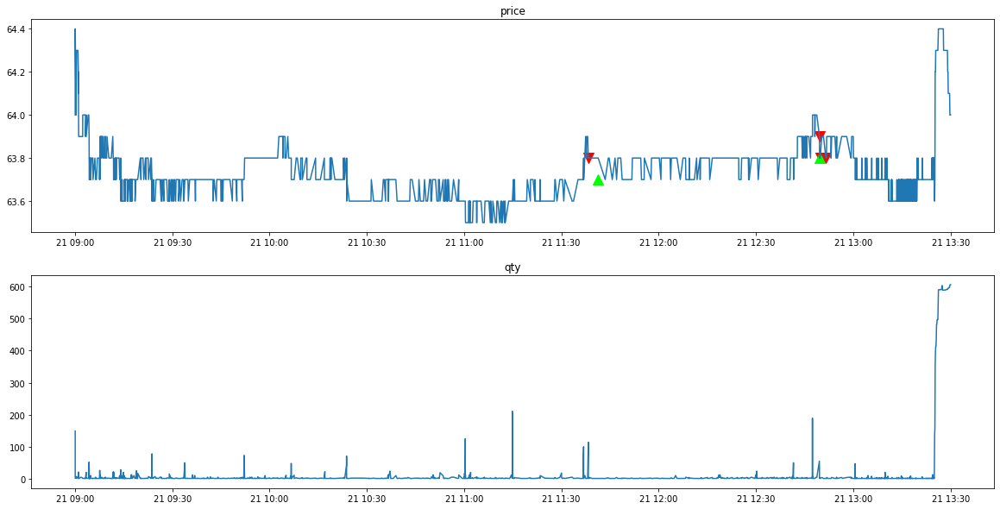

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90006916
*** bid1_p:  63.1
*** weighted_p:  62.95323709536296
ask1_p:  63.2
進場時間： 92334394 
  sell price at  63.1
stop profit
出場時間： 92352311
POSITION(pre):  [63.1]
Order_p(pre):  [63.]
tick_row price:  63.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 62.2
----------Result Report--------------
profit:  0.10000000000000142


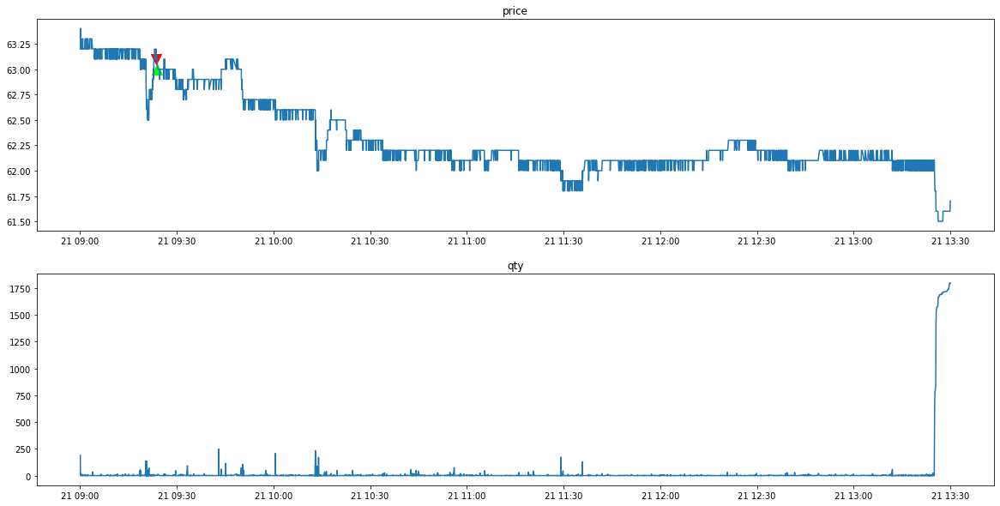

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1216/tse_lob_1216.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/1216/tse_tick_1216.csv' mode='r' encoding='UTF-8'>
90003652
*** bid1_p:  62.2
*** weighted_p:  62.00364273204865
ask1_p:  62.3
進場時間： 125507008 
  sell price at  62.2
*** bid1_p:  62.2
*** weighted_p:  62.00431441047998
ask1_p:  62.3
進場時間： 125538561 
  sell price at  62.2
*** bid1_p:  62.3
*** weighted_p:  62.009969167522776
ask1_p:  62.4
進場時間： 125813961 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.010018838841916
ask1_p:  62.4
進場時間： 125844774 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.010630661425054
ask1_p:  62.4
進場時間： 125909067 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.01167149429168
ask1_p:  62.4
進場時間： 125959745 
  sell price at  62.3
clear_position:  -0.19999999999998863
position:  [62.2 62.2 62.3 62.3 62.3 62.3]
tick

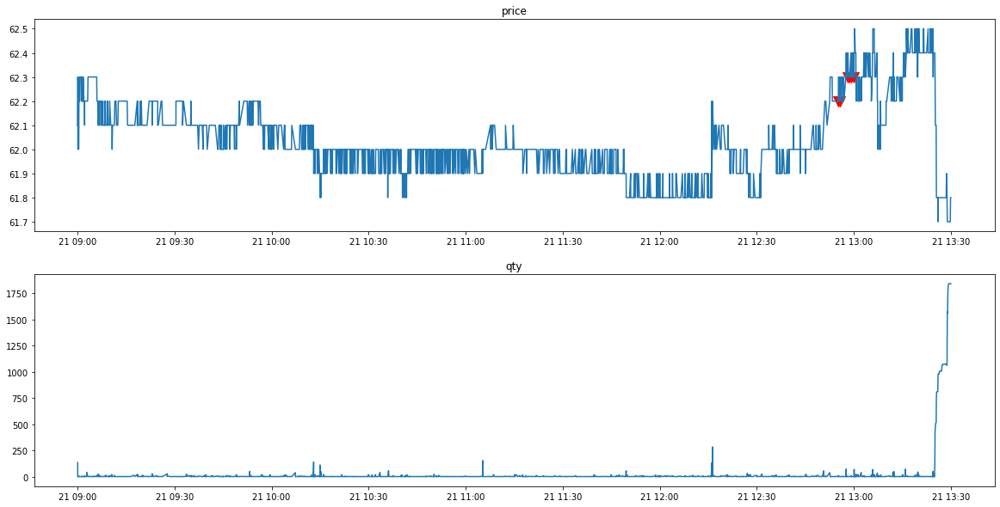

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003490
*** bid1_p:  18.8
*** weighted_p:  18.763883191717888
ask1_p:  18.85
進場時間： 105015475 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.76395552954939
ask1_p:  18.85
進場時間： 105046001 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.764057787722482
ask1_p:  18.85
進場時間： 105100156 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.764142149723213
ask1_p:  18.85
進場時間： 105130740 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.764876308277763
ask1_p:  18.85
進場時間： 105201303 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.765017064846344
ask1_p:  18.85
進場時間： 105231942 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.765097464042316
ask1_p:  18.85
進場時間： 10

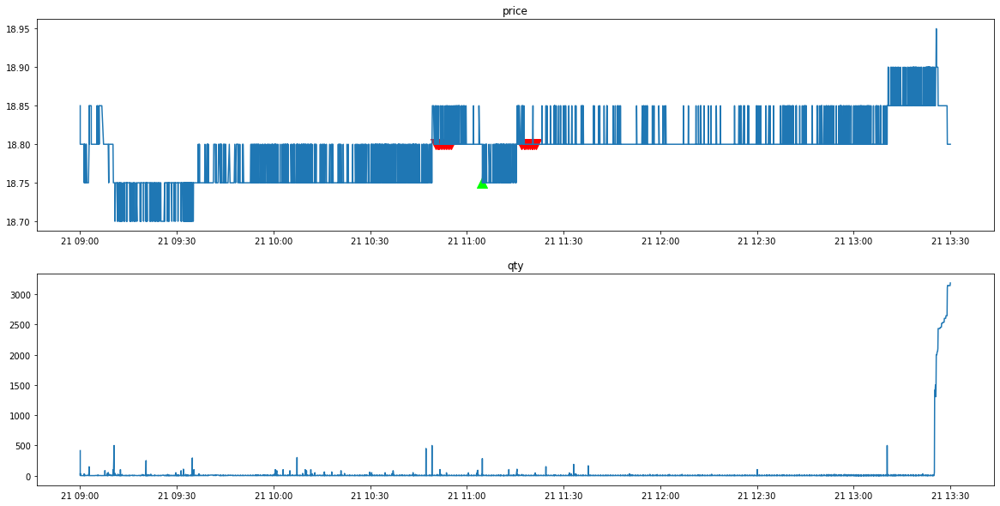

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003456
*** bid1_p:  18.8
*** weighted_p:  18.781047440112744
ask1_p:  18.85
進場時間： 95901061 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.78106226533168
ask1_p:  18.85
進場時間： 95933077 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.781080025007835
ask1_p:  18.85
進場時間： 100001545 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.781178026766284
ask1_p:  18.85
進場時間： 100031917 
  sell price at  18.8
stop profit
出場時間： 100706623
POSITION(pre):  [18.8 18.8 18.8 18.8]
Order_p(pre):  [18.75 18.75 18.75 18.75]
tick_row price:  18.75
qualified index:  [[0]
 [1]
 [2]
 [3]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 18.8
----------Result Report--------

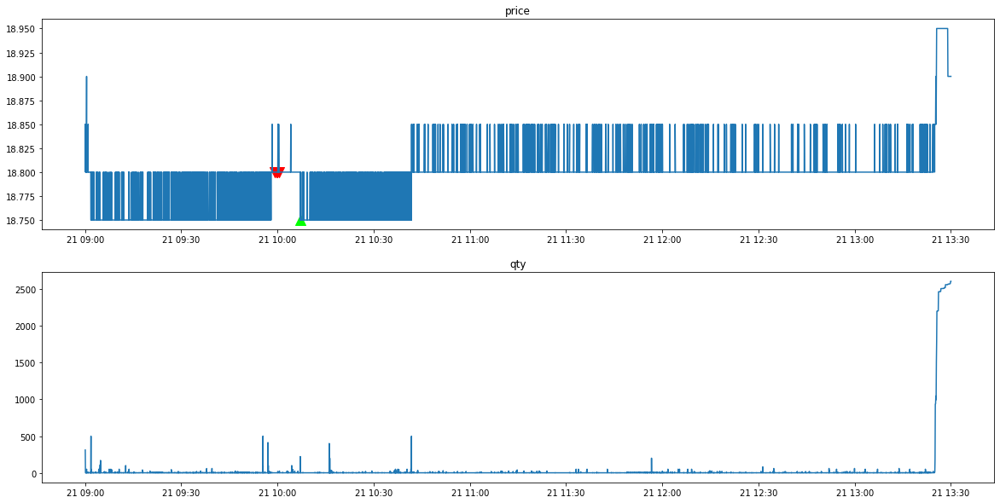

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003383
clear_position:  0.0
position:  []
tick_row_price 18.75
----------Result Report--------------
profit:  0.0


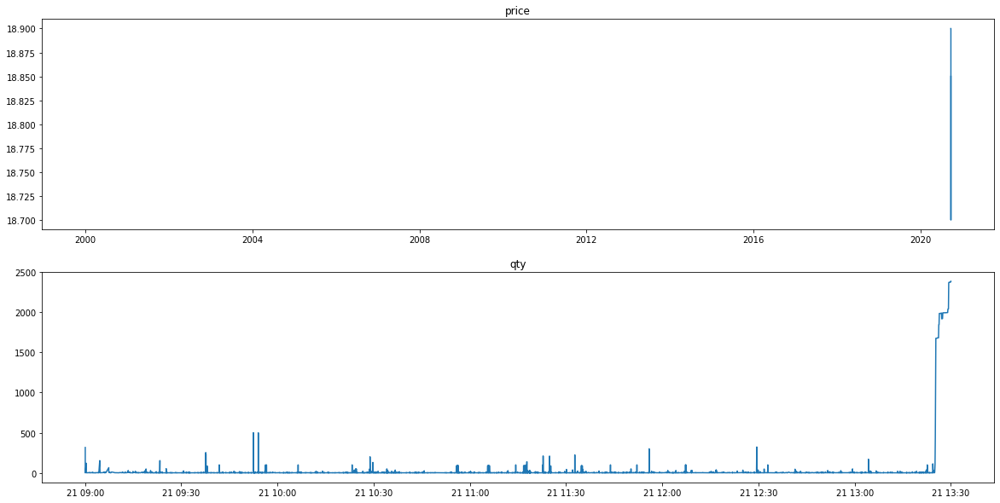

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90002727
*** bid1_p:  18.8
*** weighted_p:  18.773592788038727
ask1_p:  18.85
進場時間： 95848079 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.773604395604426
ask1_p:  18.85
進場時間： 95900427 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.773656503619247
ask1_p:  18.85
進場時間： 95930546 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.773691128148997
ask1_p:  18.85
進場時間： 100001004 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.77378768020974
ask1_p:  18.85
進場時間： 100031167 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.773844812554536
ask1_p:  18.85
進場時間： 100100169 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.775293511843508
ask1_p:  18.85
進場時間： 10013

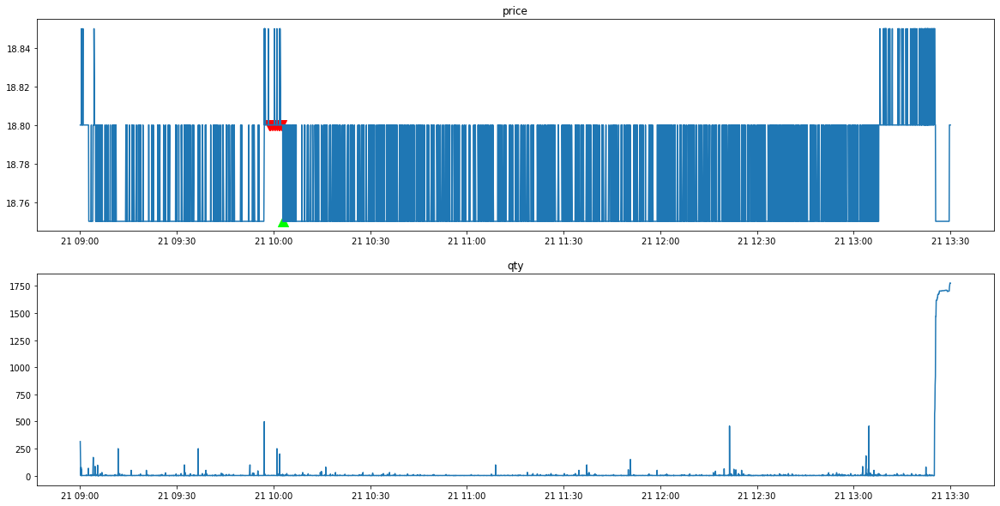

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003664
*** bid1_p:  18.8
*** weighted_p:  18.77110288851763
ask1_p:  18.85
進場時間： 112916737 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.77117513989769
ask1_p:  18.85
進場時間： 112947003 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.771205994291236
ask1_p:  18.85
進場時間： 113000557 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.771318564151255
ask1_p:  18.85
進場時間： 113030945 
  sell price at  18.8
*** bid1_p:  18.8
*** weighted_p:  18.771470657553703
ask1_p:  18.85
進場時間： 113100912 
  sell price at  18.8
stop profit
出場時間： 113115898
POSITION(pre):  [18.8 18.8 18.8 18.8 18.8]
Order_p(pre):  [18.75 18.75 18.75 18.75 18.75]
tick_row price:  18.75
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
P

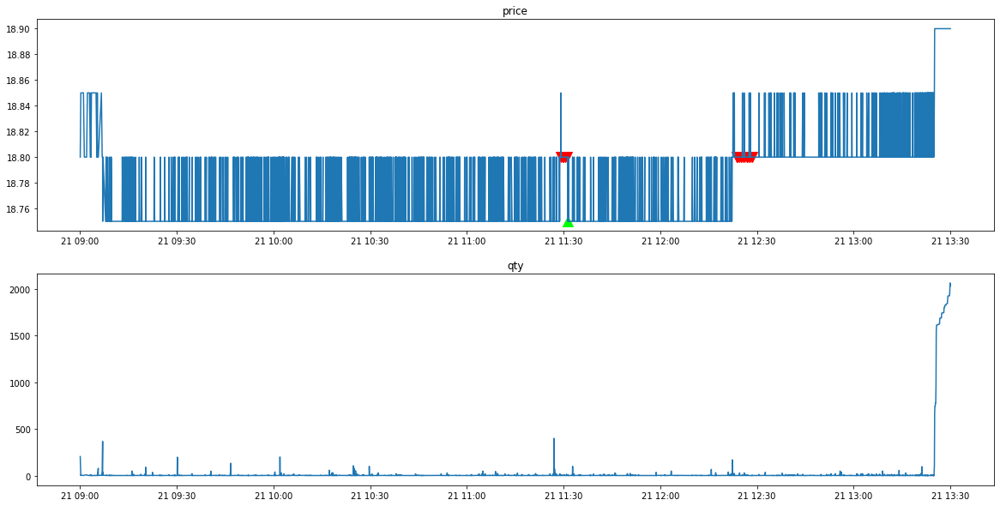

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003106
clear_position:  0.0
position:  []
tick_row_price 18.85
----------Result Report--------------
profit:  0.0


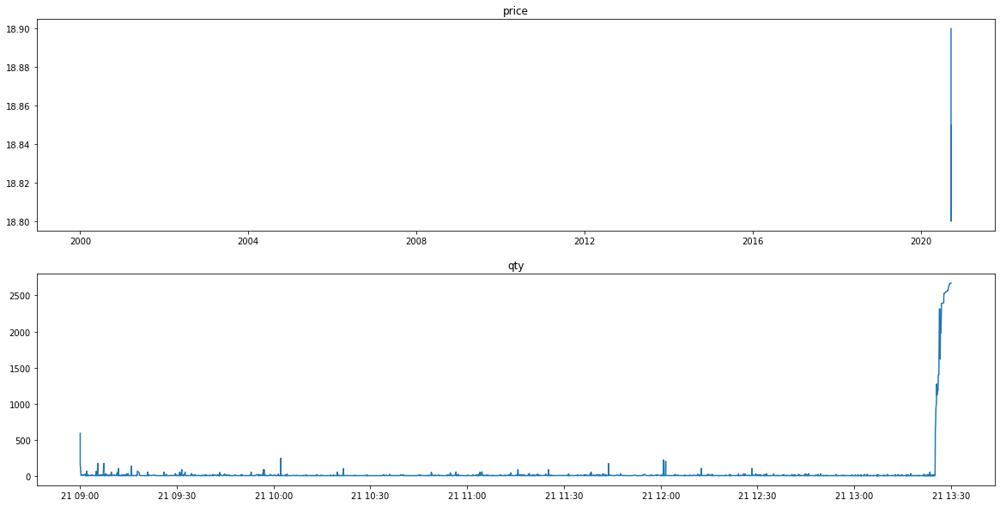

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90004012
clear_position:  0.0
position:  []
tick_row_price 18.7
----------Result Report--------------
profit:  0.0


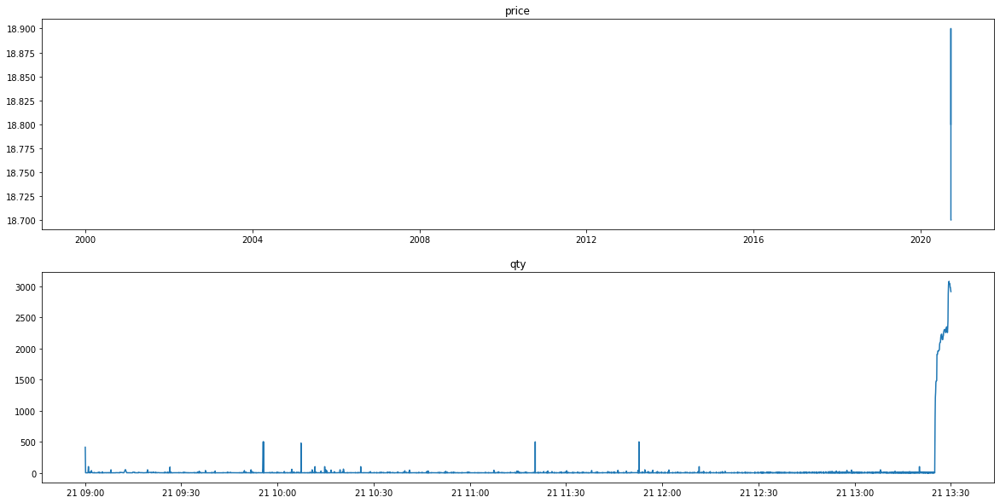

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003060
clear_position:  0.0
position:  []
tick_row_price 18.7
----------Result Report--------------
profit:  0.0


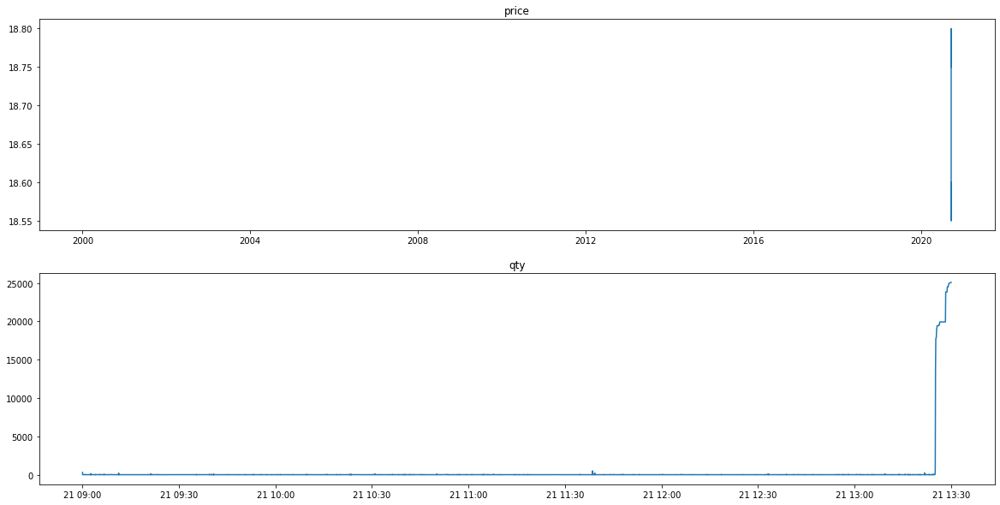

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90003058
clear_position:  0.0
position:  []
tick_row_price 18.5
----------Result Report--------------
profit:  0.0


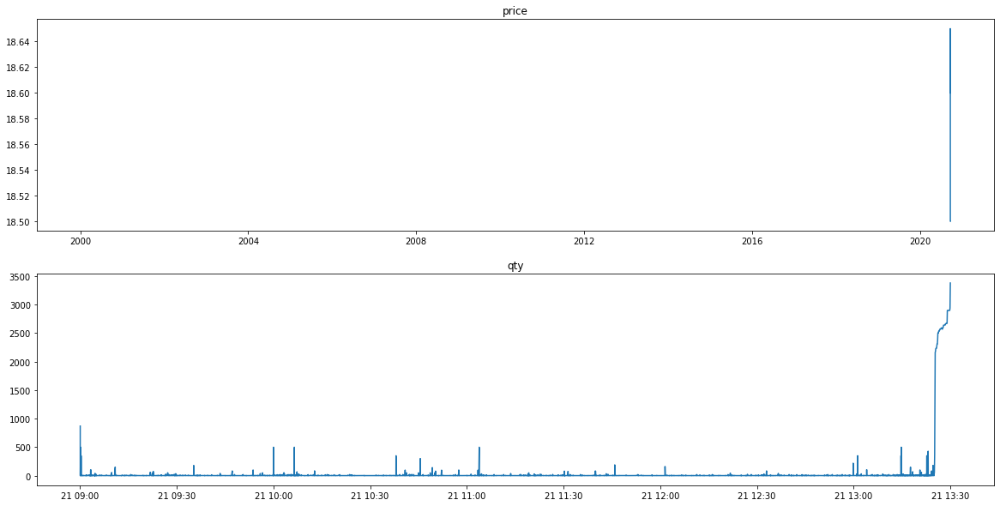

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90002409
clear_position:  0.0
position:  []
tick_row_price 18.3
----------Result Report--------------
profit:  0.0


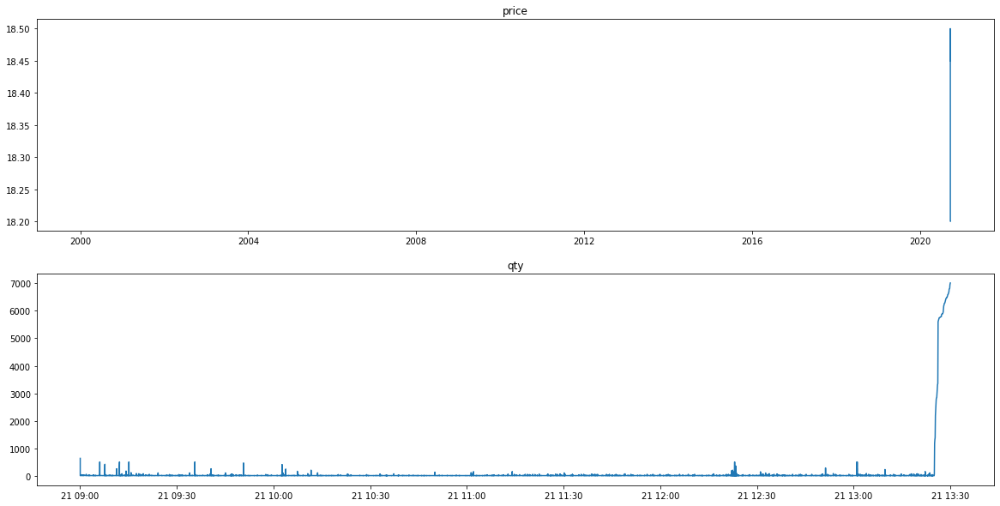

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90001779
clear_position:  0.0
position:  []
tick_row_price 18.05
----------Result Report--------------
profit:  0.0


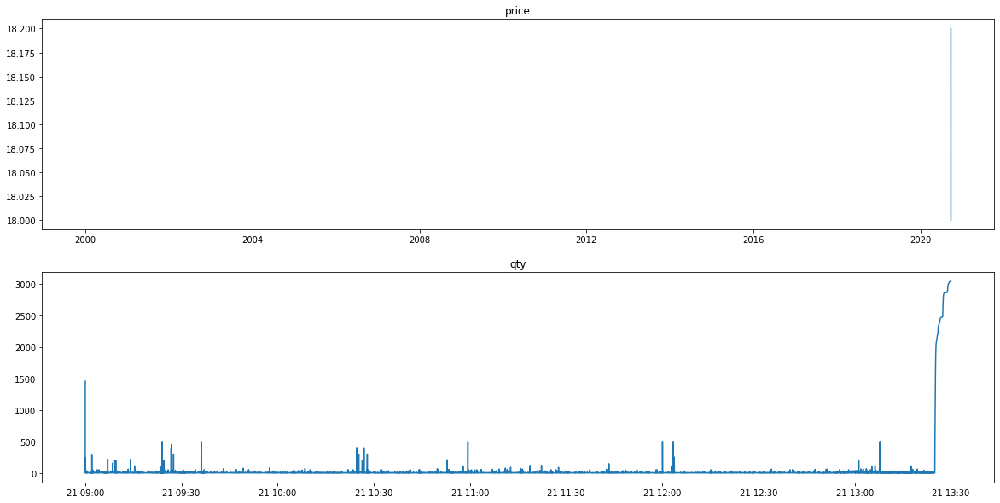

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90000865
clear_position:  0.0
position:  []
tick_row_price 17.65
----------Result Report--------------
profit:  0.0


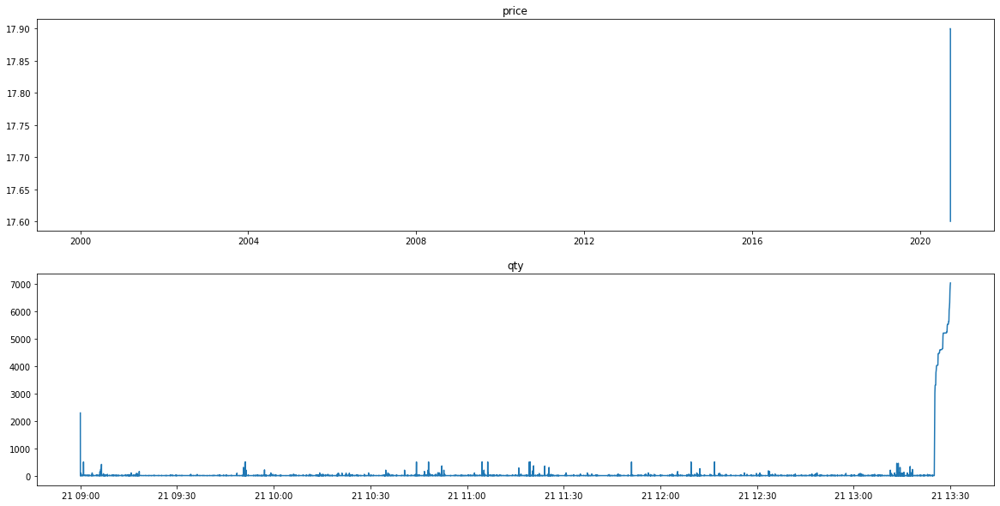

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2891/tse_lob_2891.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2891/tse_tick_2891.csv' mode='r' encoding='UTF-8'>
90001517
*** bid1_p:  17.75
*** weighted_p:  17.717597063936662
ask1_p:  17.8
進場時間： 91023583 
  sell price at  17.75
*** bid1_p:  17.75
*** weighted_p:  17.71808713930826
ask1_p:  17.8
進場時間： 91053919 
  sell price at  17.75
*** bid1_p:  17.75
*** weighted_p:  17.71808713930826
ask1_p:  17.8
進場時間： 91100090 
  sell price at  17.75
*** bid1_p:  17.75
*** weighted_p:  17.718129770992388
ask1_p:  17.8
進場時間： 91130241 
  sell price at  17.75
*** bid1_p:  17.75
*** weighted_p:  17.719809928031033
ask1_p:  17.8
進場時間： 91325071 
  sell price at  17.75
*** bid1_p:  17.75
*** weighted_p:  17.7207259528131
ask1_p:  17.8
進場時間： 91401981 
  sell price at  17.75
*** bid1_p:  17.75
*** weighted_p:  17.7211151079137
ask1_p:  17.8
進場時間： 9143282

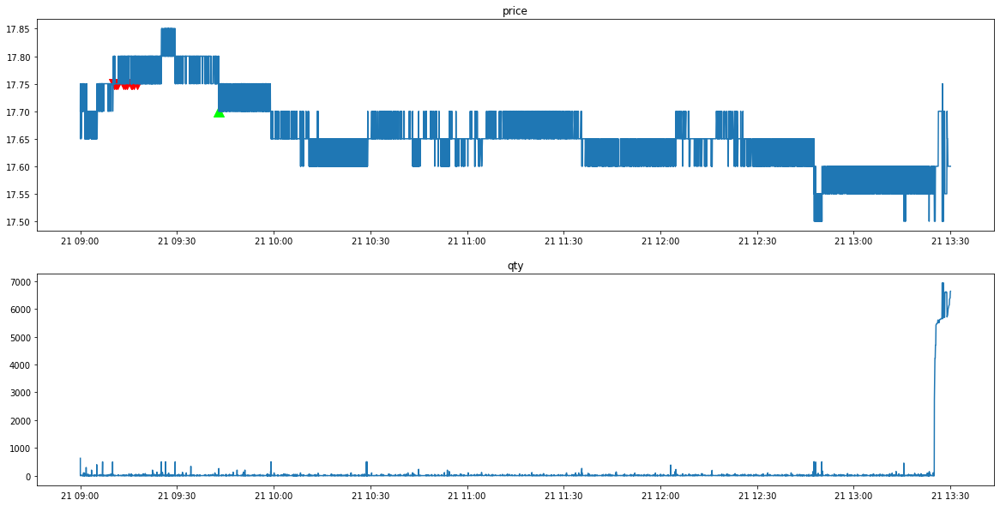

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90003631
*** bid1_p:  20.65
*** weighted_p:  20.628102640019716
ask1_p:  20.7
進場時間： 93508548 
  sell price at  20.65
*** bid1_p:  20.7
*** weighted_p:  20.633352442100392
ask1_p:  20.75
進場時間： 93921686 
  sell price at  20.7
*** bid1_p:  20.7
*** weighted_p:  20.652432997528944
ask1_p:  20.75
進場時間： 95302386 
  sell price at  20.7
*** bid1_p:  20.7
*** weighted_p:  20.652710386656516
ask1_p:  20.75
進場時間： 95333359 
  sell price at  20.7
*** bid1_p:  20.75
*** weighted_p:  20.66262686062241
ask1_p:  20.8
進場時間： 100452134 
  sell price at  20.75
*** bid1_p:  20.7
*** weighted_p:  20.66262686062241
ask1_p:  20.75
進場時間： 100501122 
  sell price at  20.7
*** bid1_p:  20.7
*** weighted_p:  20.662730190910576
ask1_p:  20.75
進場時間： 10053

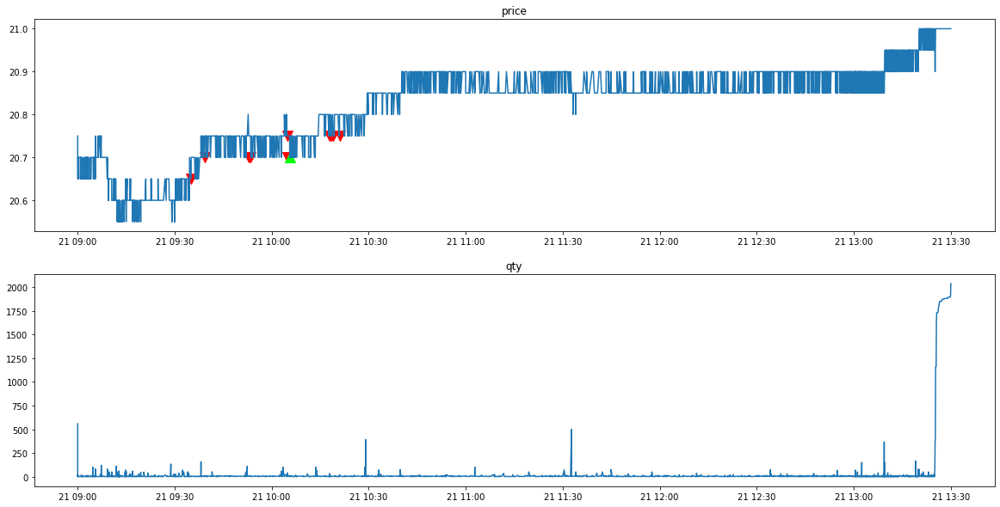

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90005464
*** bid1_p:  20.9
*** weighted_p:  20.804523842819226
ask1_p:  20.95
進場時間： 104542236 
  sell price at  20.9
stop profit
出場時間： 104542236
POSITION(pre):  [20.9]
Order_p(pre):  [20.85]
tick_row price:  20.85
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  20.85
*** weighted_p:  20.80455561766354
ask1_p:  20.9
進場時間： 104601742 
  sell price at  20.85
*** bid1_p:  20.85
*** weighted_p:  20.805488639474444
ask1_p:  20.9
進場時間： 104636997 
  sell price at  20.85
*** bid1_p:  20.85
*** weighted_p:  20.80584080412935
ask1_p:  20.9
進場時間： 104700539 
  sell price at  20.85
*** bid1_p:  20.85
*** weighted_p:  20.80585359228579
ask1_p:  20.9
進場時間： 104731370 
  sell price at  20.85
*** bid1_p:  20.85
***

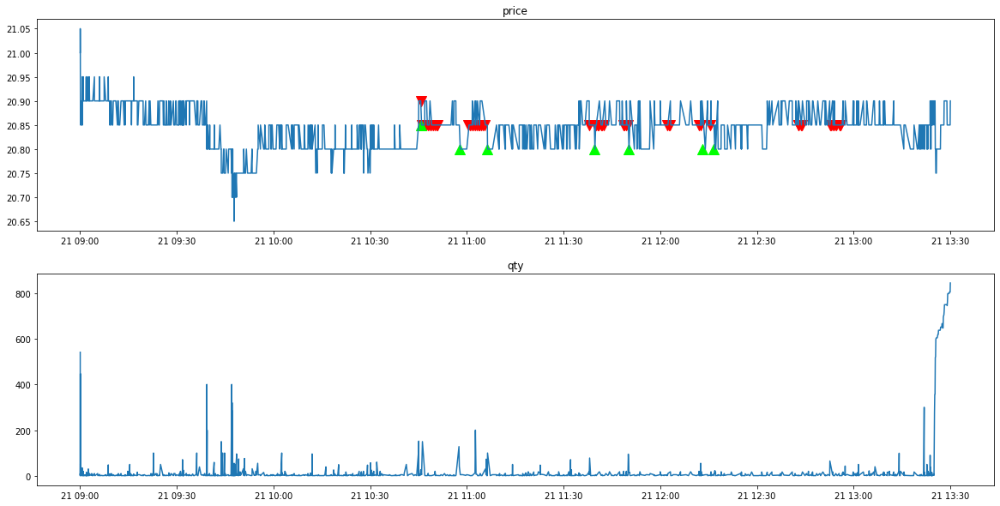

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90007198
*** bid1_p:  20.95
*** weighted_p:  20.925298579728715
ask1_p:  21.0
進場時間： 105818176 
  sell price at  20.95
*** bid1_p:  20.95
*** weighted_p:  20.925477758149846
ask1_p:  21.0
進場時間： 105848829 
  sell price at  20.95
*** bid1_p:  20.95
*** weighted_p:  20.92548563172244
ask1_p:  21.0
進場時間： 105900526 
  sell price at  20.95
stop profit
出場時間： 105907767
POSITION(pre):  [20.95 20.95 20.95]
Order_p(pre):  [20.9 20.9 20.9]
tick_row price:  20.9
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 20.85
----------Result Report--------------
profit:  0.15000000000000213


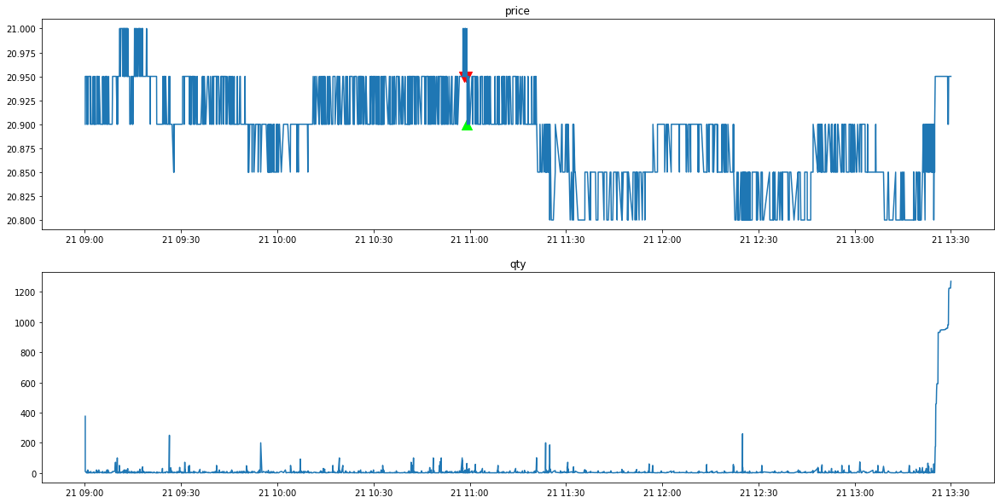

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90005711
clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.0


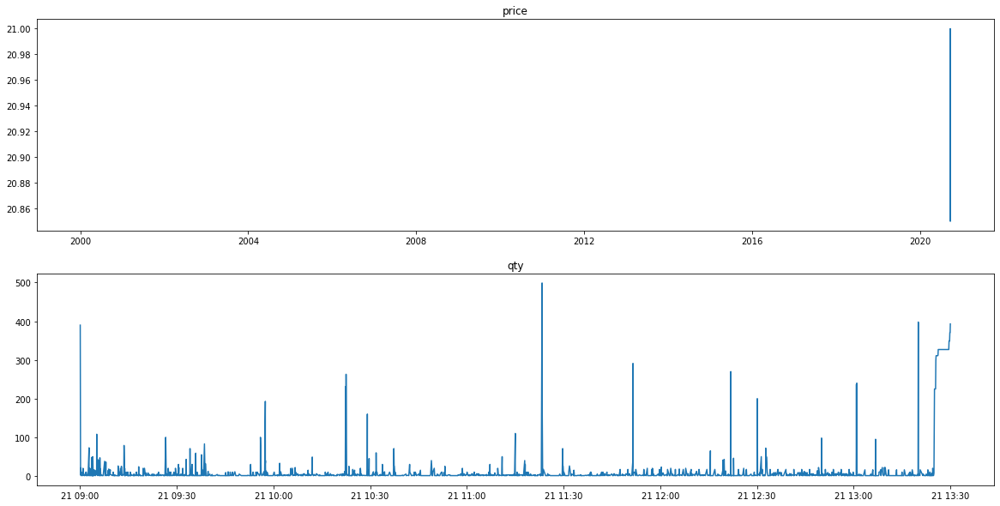

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90005269
clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.0


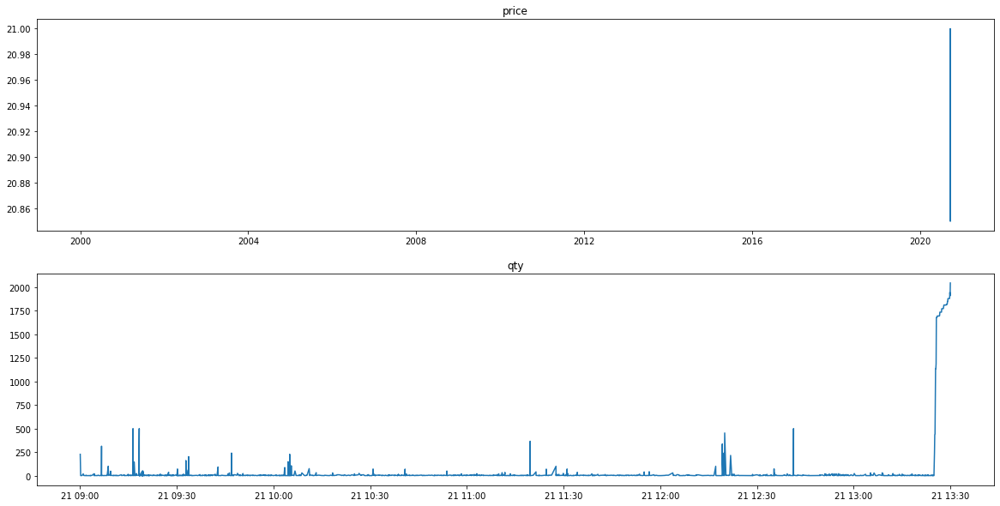

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90005515
*** bid1_p:  20.9
*** weighted_p:  20.87890972663698
ask1_p:  20.95
進場時間： 95421082 
  sell price at  20.9
stop profit
出場時間： 101358567
POSITION(pre):  [20.9]
Order_p(pre):  [20.85]
tick_row price:  20.85
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.04999999999999716


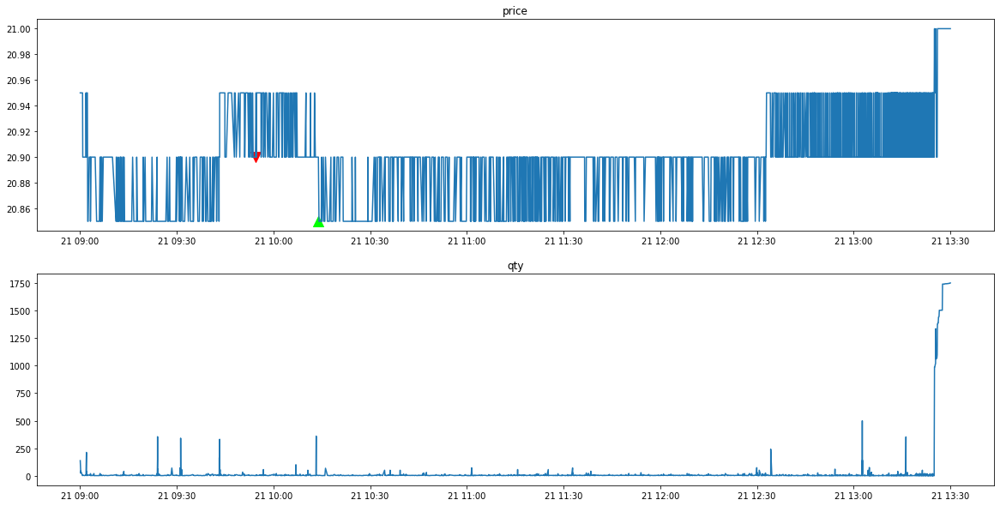

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90006154
clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.0


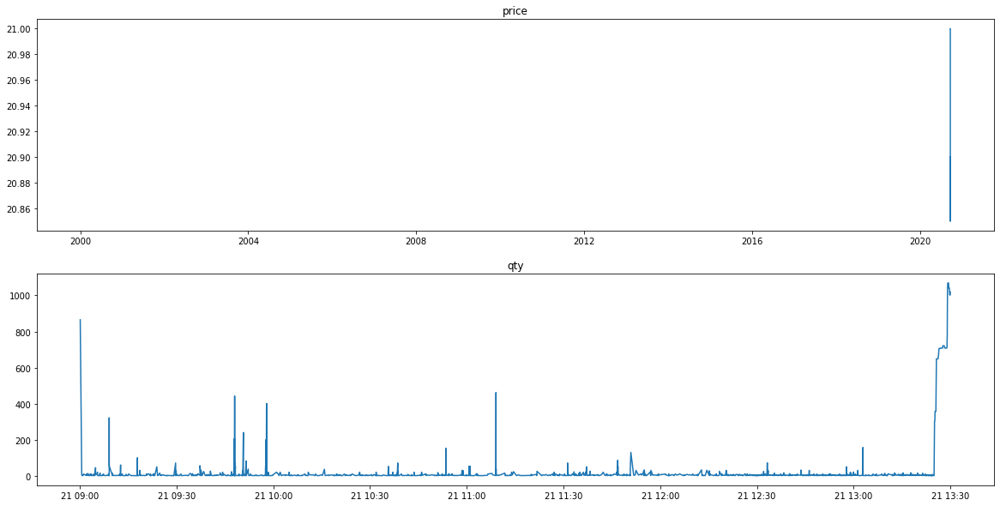

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90007479
clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.0


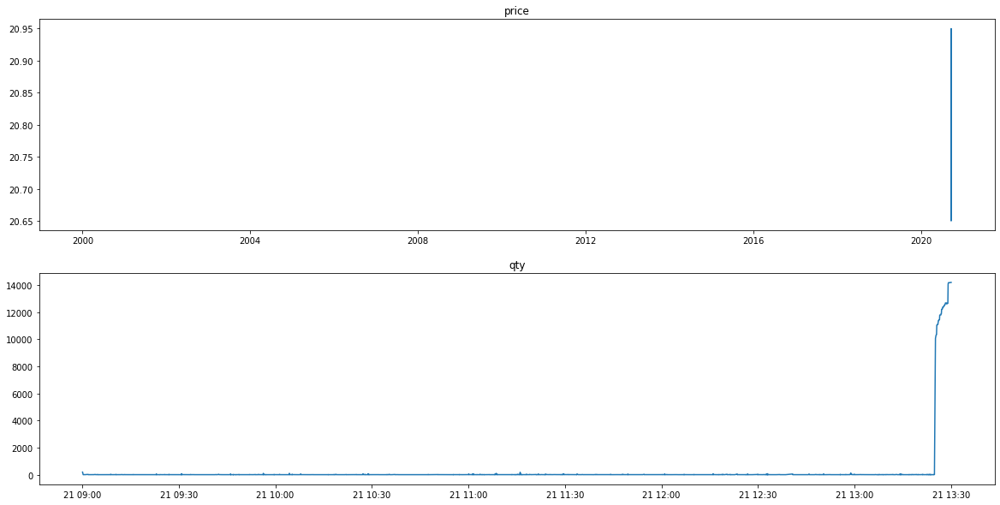

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90006780
clear_position:  0.0
position:  []
tick_row_price 20.75
----------Result Report--------------
profit:  0.0


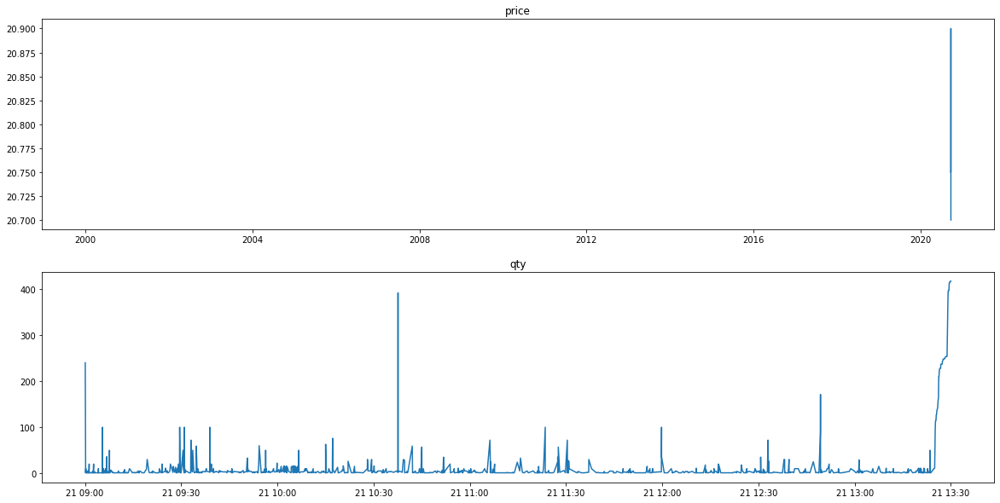

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90008840
*** bid1_p:  20.75
*** weighted_p:  20.703803011677916
ask1_p:  20.8
進場時間： 100058924 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.703803011677916
ask1_p:  20.8
進場時間： 100104454 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.706535947712396
ask1_p:  20.8
進場時間： 100519500 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.706581095117947
ask1_p:  20.8
進場時間： 100549733 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.706635527876607
ask1_p:  20.8
進場時間： 100602156 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.70664936990361
ask1_p:  20.8
進場時間： 100632481 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.706697288487156
ask1_p:  20.8
進場

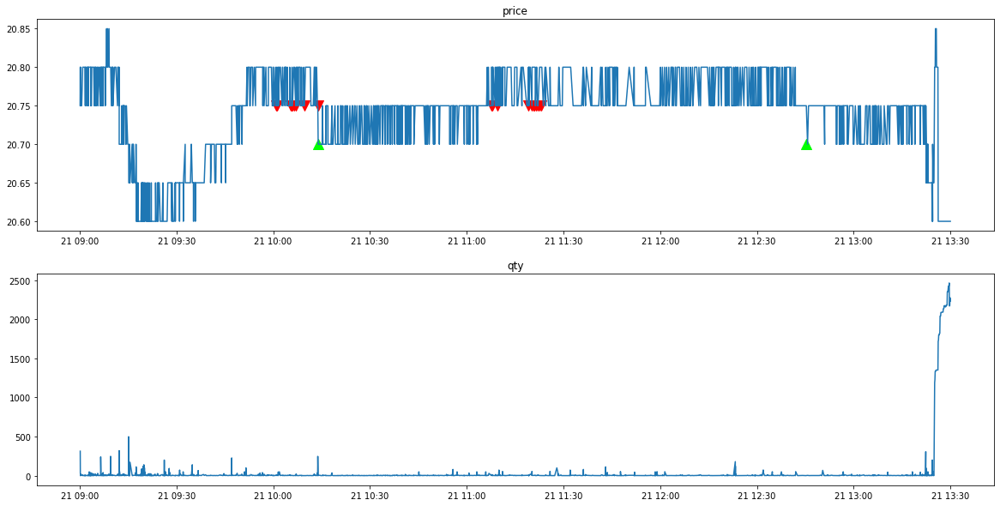

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90006388
clear_position:  0.0
position:  []
tick_row_price 20.5
----------Result Report--------------
profit:  0.0


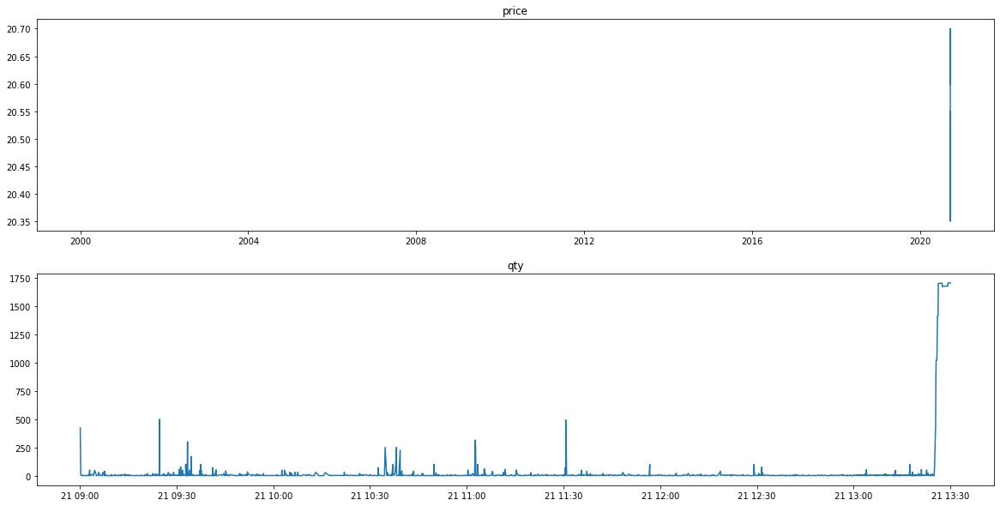

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90007316
clear_position:  0.0
position:  []
tick_row_price 20.05
----------Result Report--------------
profit:  0.0


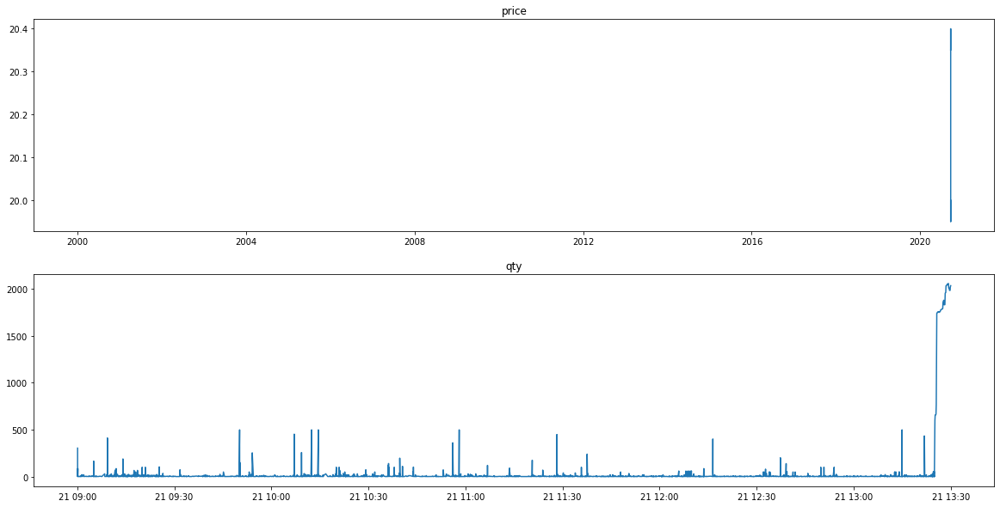

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2002/tse_lob_2002.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2002/tse_tick_2002.csv' mode='r' encoding='UTF-8'>
90005859
clear_position:  0.0
position:  []
tick_row_price 20.15
----------Result Report--------------
profit:  0.0


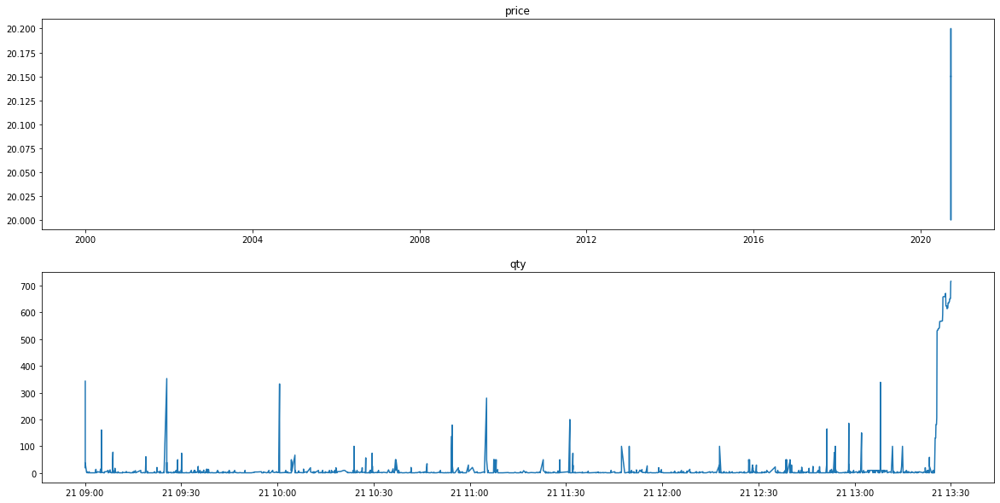

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90012657
clear_position:  0.0
position:  []
tick_row_price 100.0
----------Result Report--------------
profit:  0.0


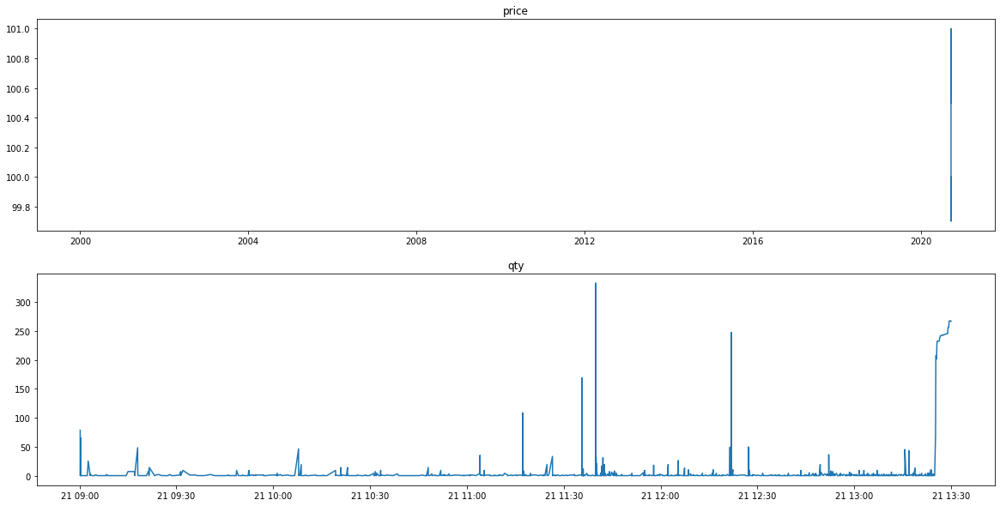

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90009681
clear_position:  0.0
position:  []
tick_row_price 100.0
----------Result Report--------------
profit:  0.0


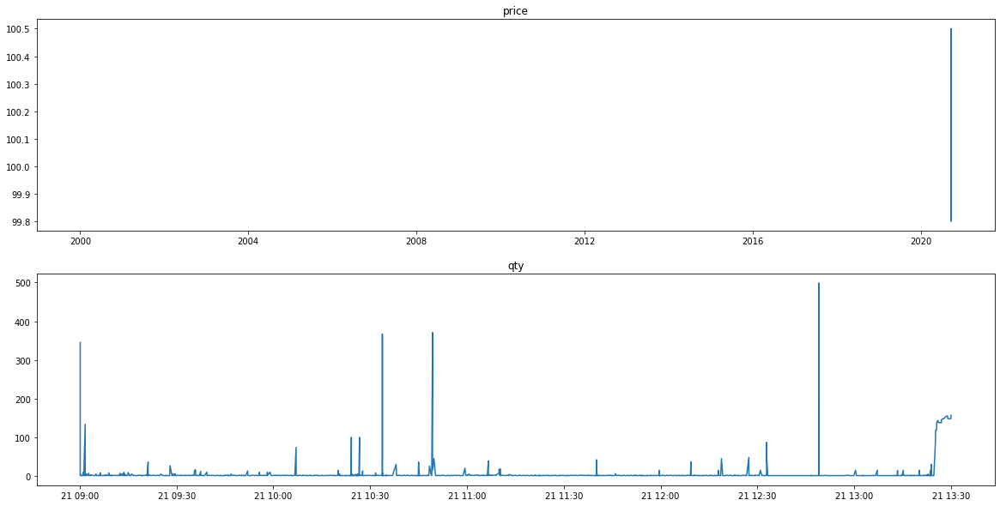

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90011411
*** bid1_p:  100.5
*** weighted_p:  100.03321112129501
ask1_p:  101.0
進場時間： 121849556 
  sell price at  100.5
*** bid1_p:  100.5
*** weighted_p:  100.03421774931337
ask1_p:  101.0
進場時間： 121901615 
  sell price at  100.5
*** bid1_p:  100.5
*** weighted_p:  100.03720436628215
ask1_p:  101.0
進場時間： 121934022 
  sell price at  100.5
*** bid1_p:  100.5
*** weighted_p:  100.03720436628215
ask1_p:  101.0
進場時間： 122000896 
  sell price at  100.5
*** bid1_p:  100.5
*** weighted_p:  100.03748484848441
ask1_p:  101.0
進場時間： 122041439 
  sell price at  100.5
*** bid1_p:  100.5
*** weighted_p:  100.03748484848441
ask1_p:  101.0
進場時間： 122104866 
  sell price at  100.5
*** bid1_p:  100.5
*** weighted_p:  100.0380678376737
ask1_p:  1

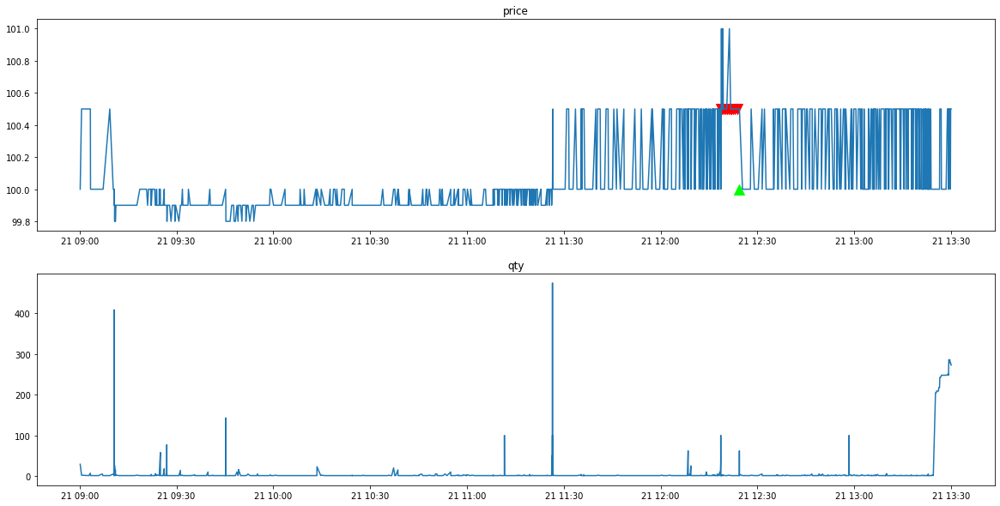

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90013341
clear_position:  0.0
position:  []
tick_row_price 100.0
----------Result Report--------------
profit:  0.0


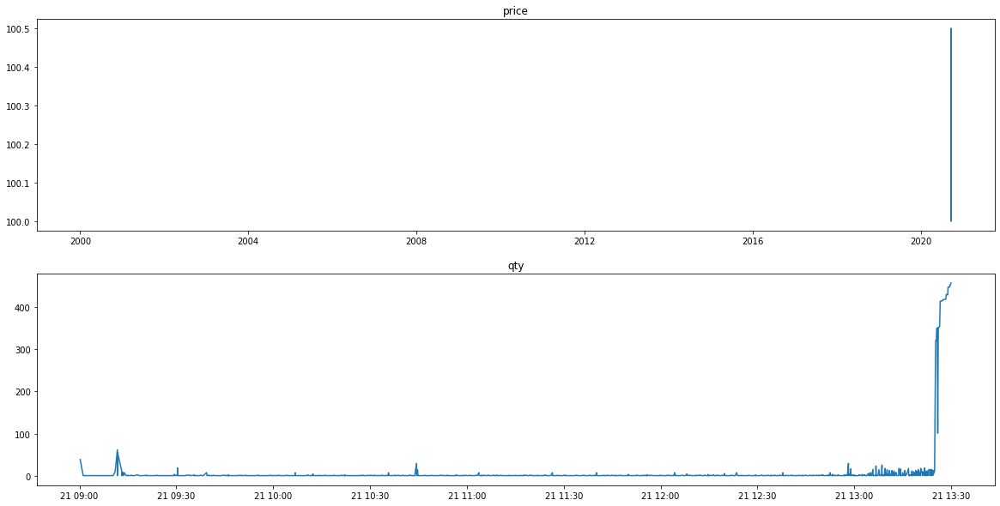

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90010685
clear_position:  0.0
position:  []
tick_row_price 100.0
----------Result Report--------------
profit:  0.0


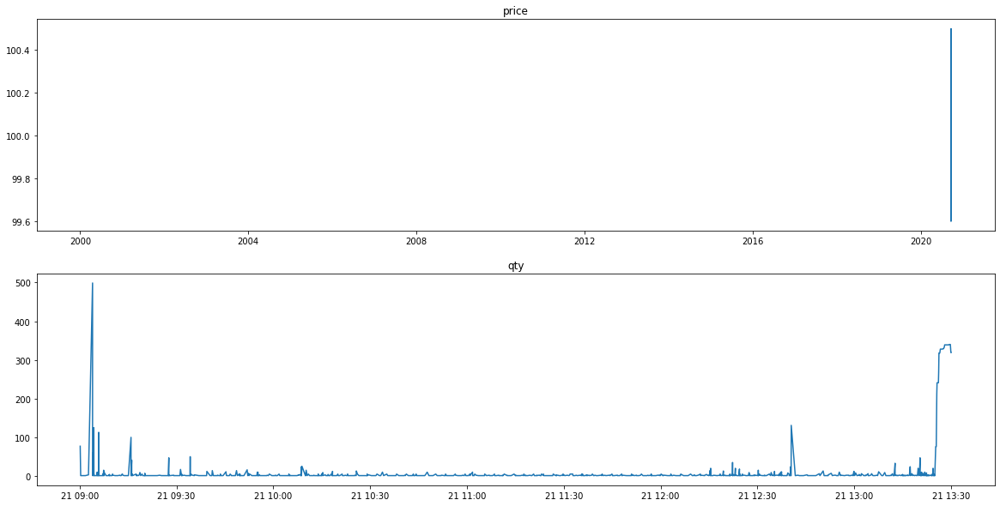

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90009141
clear_position:  0.0
position:  []
tick_row_price 100.0
----------Result Report--------------
profit:  0.0


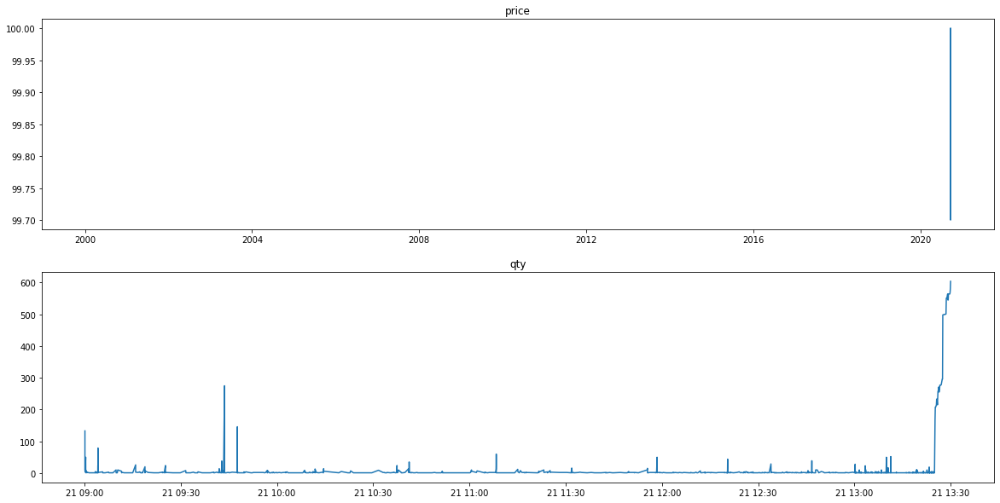

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90011031
clear_position:  0.0
position:  []
tick_row_price 99.7
----------Result Report--------------
profit:  0.0


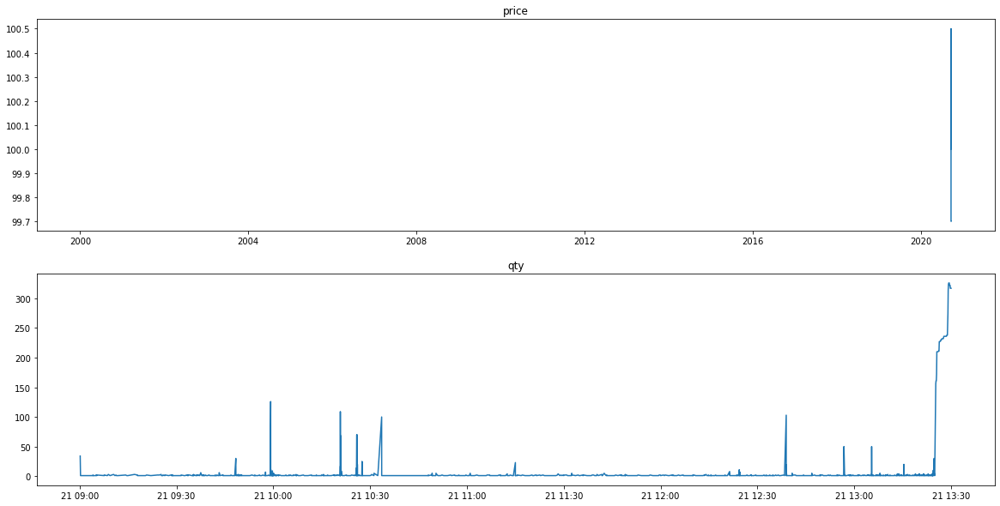

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90013101
*** bid1_p:  99.7
*** weighted_p:  99.52429171038825
ask1_p:  99.8
進場時間： 111115918 
  sell price at  99.7
*** bid1_p:  99.7
*** weighted_p:  99.52462022001048
ask1_p:  99.8
進場時間： 111151273 
  sell price at  99.7
*** bid1_p:  99.7
*** weighted_p:  99.52462022001048
ask1_p:  99.8
進場時間： 111200204 
  sell price at  99.7
*** bid1_p:  99.7
*** weighted_p:  99.52471204188483
ask1_p:  99.8
進場時間： 111236633 
  sell price at  99.7
*** bid1_p:  99.7
*** weighted_p:  99.52471204188483
ask1_p:  99.8
進場時間： 111300053 
  sell price at  99.7
*** bid1_p:  99.7
*** weighted_p:  99.52480376766093
ask1_p:  99.8
進場時間： 111331329 
  sell price at  99.7
*** bid1_p:  99.7
*** weighted_p:  99.52498693152118
ask1_p:  99.8
進場時間： 111400473 
  se

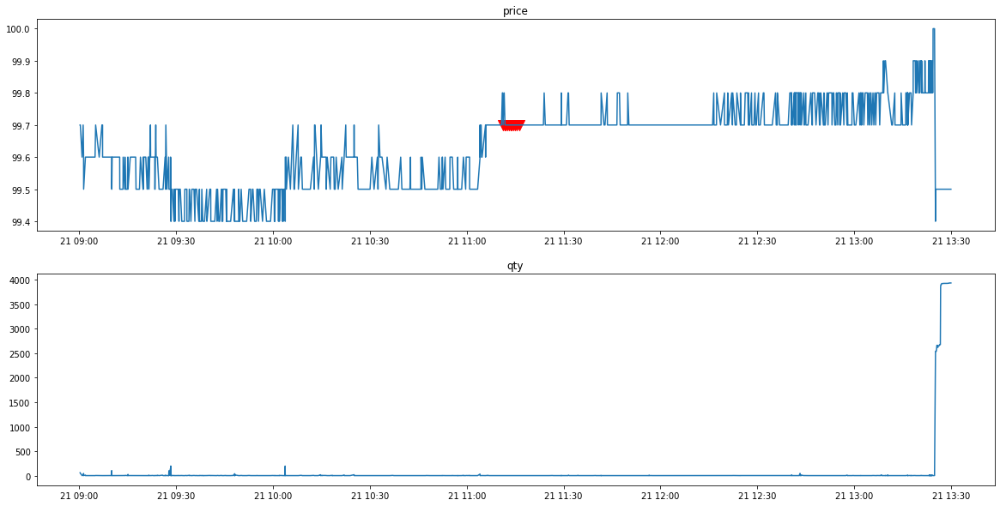

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90012486
*** bid1_p:  99.3
*** weighted_p:  99.19972375690611
ask1_p:  99.4
進場時間： 92558391 
  sell price at  99.3
*** bid1_p:  99.3
*** weighted_p:  99.19972375690611
ask1_p:  99.4
進場時間： 92604414 
  sell price at  99.3
stop profit
出場時間： 92612901
POSITION(pre):  [99.3 99.3]
Order_p(pre):  [99.2 99.2]
tick_row price:  99.2
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  99.4
*** weighted_p:  99.22798264642093
ask1_p:  99.5
進場時間： 93132119 
  sell price at  99.4
*** bid1_p:  99.4
*** weighted_p:  99.23547717842334
ask1_p:  99.5
進場時間： 93204274 
  sell price at  99.4
stop profit
出場時間： 93210144
POSITION(pre):  [99.4 99.4]
Order_p(pre):  [99.3 99.3]
tick_row price:  99.3
qualified index:  [[0]
 [1]

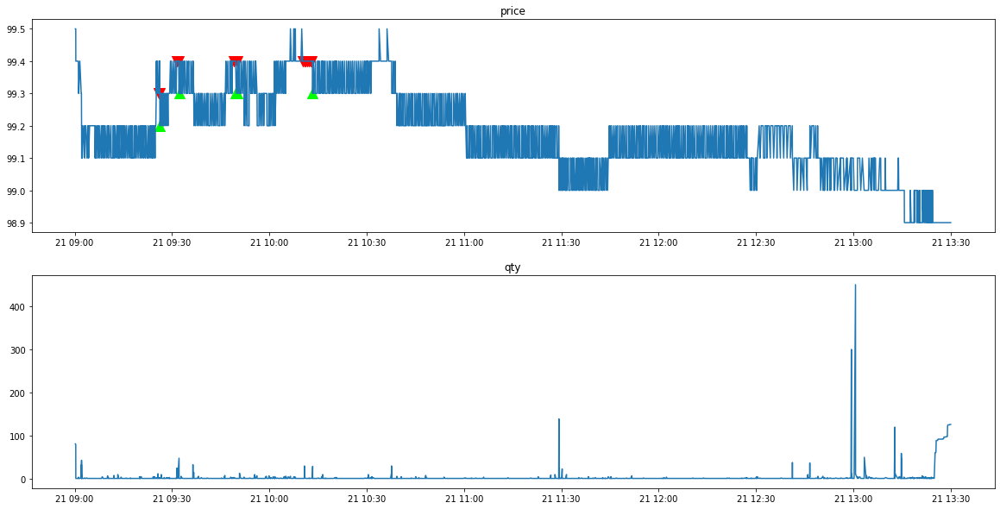

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90010039
*** bid1_p:  98.7
*** weighted_p:  98.55436893203888
ask1_p:  98.8
進場時間： 95522622 
  sell price at  98.7
*** bid1_p:  98.7
*** weighted_p:  98.55514511873356
ask1_p:  98.8
進場時間： 95554547 
  sell price at  98.7
*** bid1_p:  98.7
*** weighted_p:  98.55514511873356
ask1_p:  98.8
進場時間： 95601666 
  sell price at  98.7
*** bid1_p:  98.7
*** weighted_p:  98.55561403508777
ask1_p:  98.8
進場時間： 95641059 
  sell price at  98.7
*** bid1_p:  98.7
*** weighted_p:  98.55595446584944
ask1_p:  98.8
進場時間： 95722030 
  sell price at  98.7
*** bid1_p:  98.7
*** weighted_p:  98.55595446584944
ask1_p:  98.8
進場時間： 95803714 
  sell price at  98.7
*** bid1_p:  98.7
*** weighted_p:  98.57176566314082
ask1_p:  98.8
進場時間： 101428878 
  sell pri

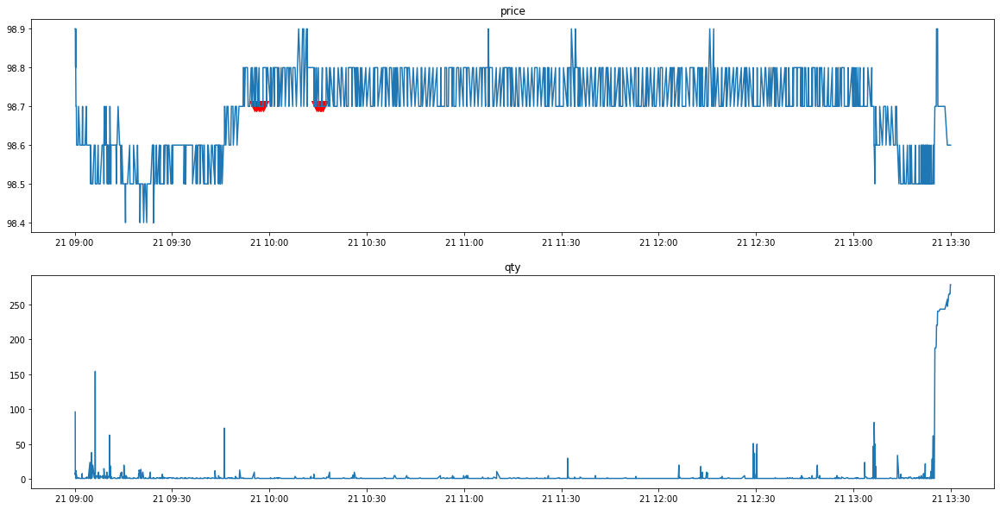

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90011202
clear_position:  0.0
position:  []
tick_row_price 97.9
----------Result Report--------------
profit:  0.0


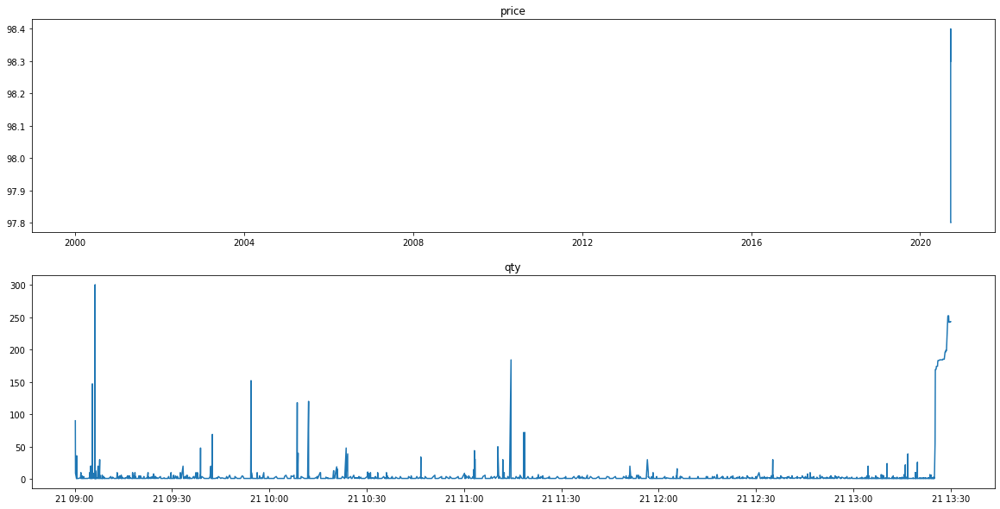

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90009324
*** bid1_p:  97.1
*** weighted_p:  96.96556603773584
ask1_p:  97.2
進場時間： 93155634 
  sell price at  97.1
*** bid1_p:  97.1
*** weighted_p:  96.9656452563347
ask1_p:  97.2
進場時間： 93200289 
  sell price at  97.1
stop profit
出場時間： 93211918
POSITION(pre):  [97.1 97.1]
Order_p(pre):  [97. 97.]
tick_row price:  97.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 96.5
----------Result Report--------------
profit:  0.19999999999998863


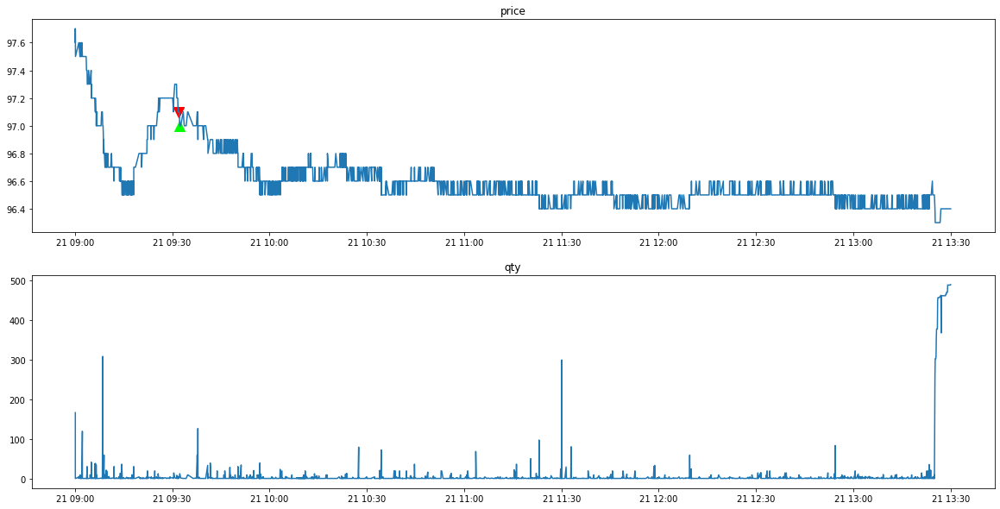

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3045/tse_lob_3045.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3045/tse_tick_3045.csv' mode='r' encoding='UTF-8'>
90007133
*** bid1_p:  96.7
*** weighted_p:  96.52808764940235
ask1_p:  96.9
進場時間： 92820252 
  sell price at  96.7
stop profit
出場時間： 92831567
POSITION(pre):  [96.7]
Order_p(pre):  [96.6]
tick_row price:  96.6
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  96.7
*** weighted_p:  96.53522727272723
ask1_p:  96.9
進場時間： 92900961 
  sell price at  96.7
*** bid1_p:  96.7
*** weighted_p:  96.53522727272723
ask1_p:  96.9
進場時間： 92939440 
  sell price at  96.7
*** bid1_p:  96.8
*** weighted_p:  96.53728813559319
ask1_p:  96.9
進場時間： 93001863 
  sell price at  96.8
*** bid1_p:  96.8
*** weighted_p:  96.53728813559319
ask1_p:  96.9
進場時間： 93034815 
  sell price at  96.8
*** bid1_p:  96.8
*** weighted_p:  96.558

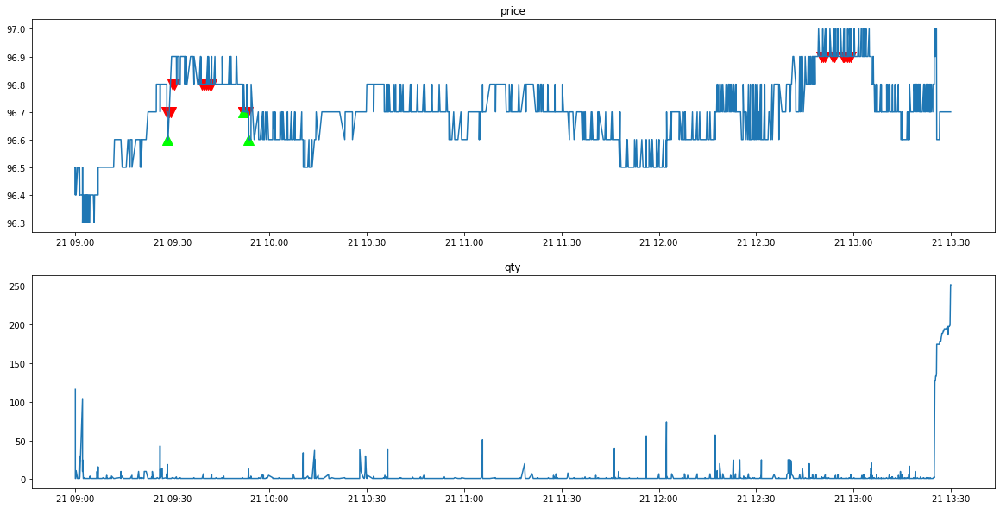

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90004434
*** bid1_p:  596.0
*** weighted_p:  594.8602150537635
ask1_p:  597.0
進場時間： 90214996 
  sell price at  596.0
*** bid1_p:  598.0
*** weighted_p:  596.2631578947369
ask1_p:  599.0
進場時間： 90332777 
  sell price at  598.0
stop profit
出場時間： 90337939
POSITION(pre):  [596. 598.]
Order_p(pre):  [595. 597.]
tick_row price:  597.0
qualified index:  [[1]]
POSITION(post):  [596.]
Order_p(post):  [595.]

*** bid1_p:  598.0
*** weighted_p:  596.7337662337662
ask1_p:  599.0
進場時間： 90452877 
  sell price at  598.0
*** bid1_p:  598.0
*** weighted_p:  596.864705882353
ask1_p:  599.0
進場時間： 90509614 
  sell price at  598.0
stop profit
出場時間： 90540053
POSITION(pre):  [596. 598. 598.]
Order_p(pre):  [595. 597. 597.]
tick_row price:  597.0
q

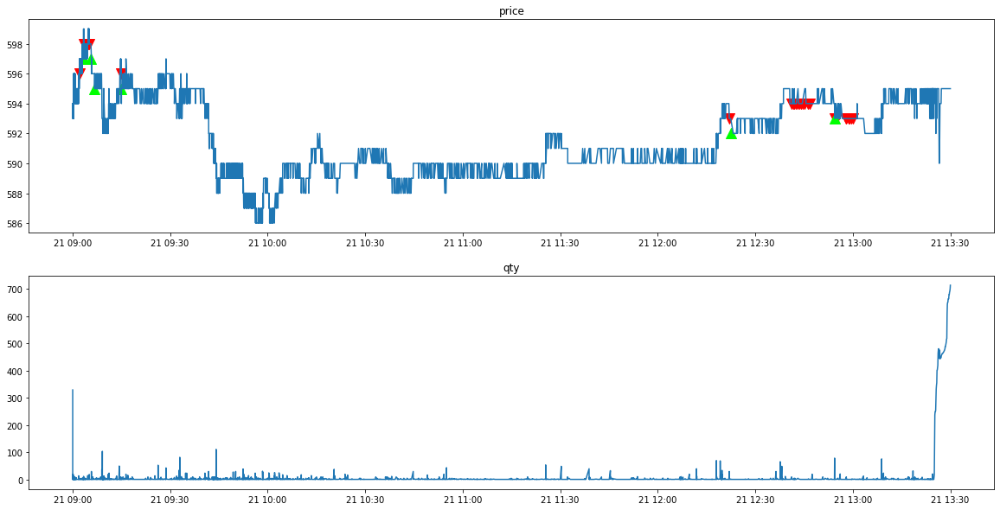

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90003858
*** bid1_p:  606.0
*** weighted_p:  604.2091254752852
ask1_p:  607.0
進場時間： 90504416 
  sell price at  606.0
stop profit
出場時間： 90546356
POSITION(pre):  [606.]
Order_p(pre):  [605.]
tick_row price:  605.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 599.0
----------Result Report--------------
profit:  1.0


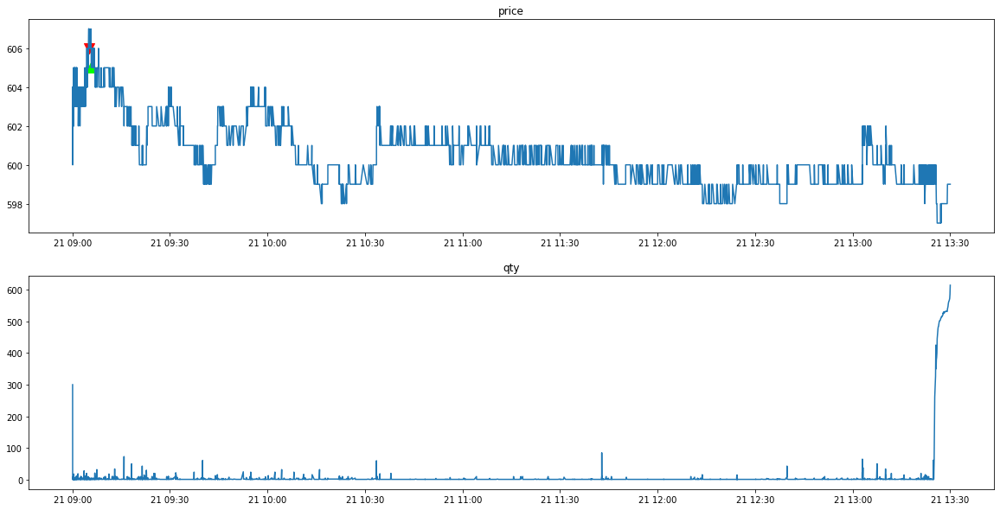

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90004186
*** bid1_p:  595.0
*** weighted_p:  592.8907520325204
ask1_p:  596.0
進場時間： 102435994 
  sell price at  595.0
*** bid1_p:  594.0
*** weighted_p:  592.900354071826
ask1_p:  596.0
進場時間： 102500127 
  sell price at  594.0
stop profit
出場時間： 102501767
POSITION(pre):  [595. 594.]
Order_p(pre):  [594. 593.]
tick_row price:  594.0
qualified index:  [[0]]
POSITION(post):  [594.]
Order_p(post):  [593.]

*** bid1_p:  594.0
*** weighted_p:  592.9027532205102
ask1_p:  595.0
進場時間： 102531211 
  sell price at  594.0
*** bid1_p:  595.0
*** weighted_p:  592.9686351384464
ask1_p:  596.0
進場時間： 103337599 
  sell price at  595.0
*** bid1_p:  595.0
*** weighted_p:  592.9701273261509
ask1_p:  596.0
進場時間： 103405424 
  sell price at  595.0
**

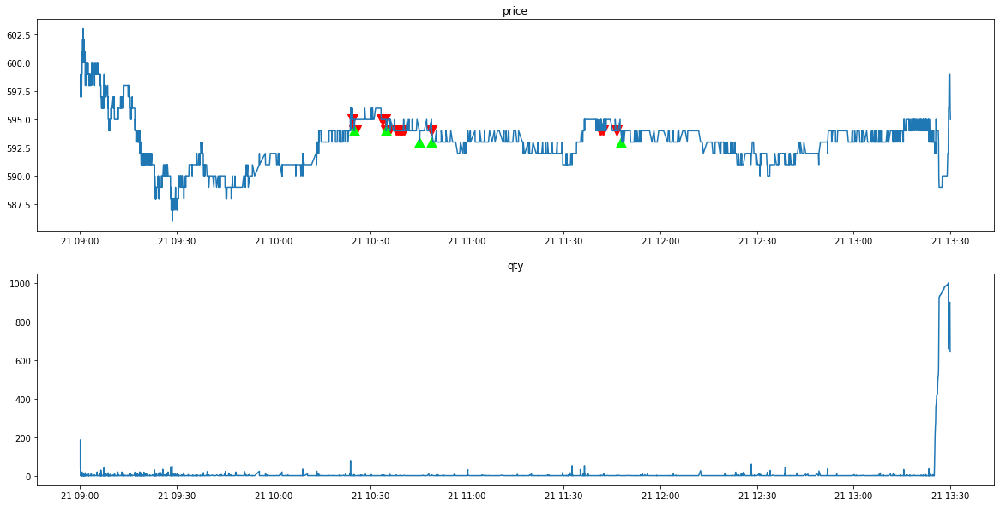

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90003530
*** bid1_p:  594.0
*** weighted_p:  592.2886710239651
ask1_p:  595.0
進場時間： 91050314 
  sell price at  594.0
*** bid1_p:  594.0
*** weighted_p:  592.3143164693219
ask1_p:  595.0
進場時間： 91100710 
  sell price at  594.0
*** bid1_p:  594.0
*** weighted_p:  592.3297758804696
ask1_p:  595.0
進場時間： 91130992 
  sell price at  594.0
stop profit
出場時間： 91201979
POSITION(pre):  [594. 594. 594.]
Order_p(pre):  [593. 593. 593.]
tick_row price:  593.0
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  593.0
*** weighted_p:  592.3700623700623
ask1_p:  594.0
進場時間： 91202300 
  sell price at  593.0
*** bid1_p:  596.0
*** weighted_p:  592.9250411861615
ask1_p:  597.0
進場時間： 91258249 
  sell price at  5

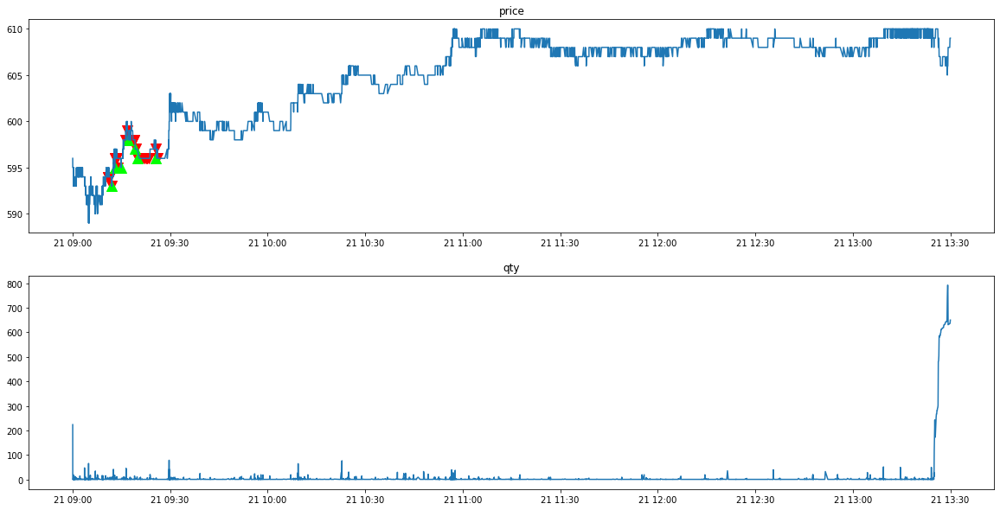

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90003263
*** bid1_p:  611.0
*** weighted_p:  607.5784392598551
ask1_p:  612.0
進場時間： 91915149 
  sell price at  611.0
stop profit
出場時間： 91926056
POSITION(pre):  [611.]
Order_p(pre):  [610.]
tick_row price:  610.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  610.0
*** weighted_p:  607.6677042801556
ask1_p:  611.0
進場時間： 91945163 
  sell price at  610.0
*** bid1_p:  610.0
*** weighted_p:  607.6746894409938
ask1_p:  611.0
進場時間： 92000635 
  sell price at  610.0
*** bid1_p:  610.0
*** weighted_p:  607.8173719376392
ask1_p:  611.0
進場時間： 92049165 
  sell price at  610.0
*** bid1_p:  610.0
*** weighted_p:  607.8206078576724
ask1_p:  611.0
進場時間： 92100809 
  sell price at  610.0
stop profit
出場時間： 9212381

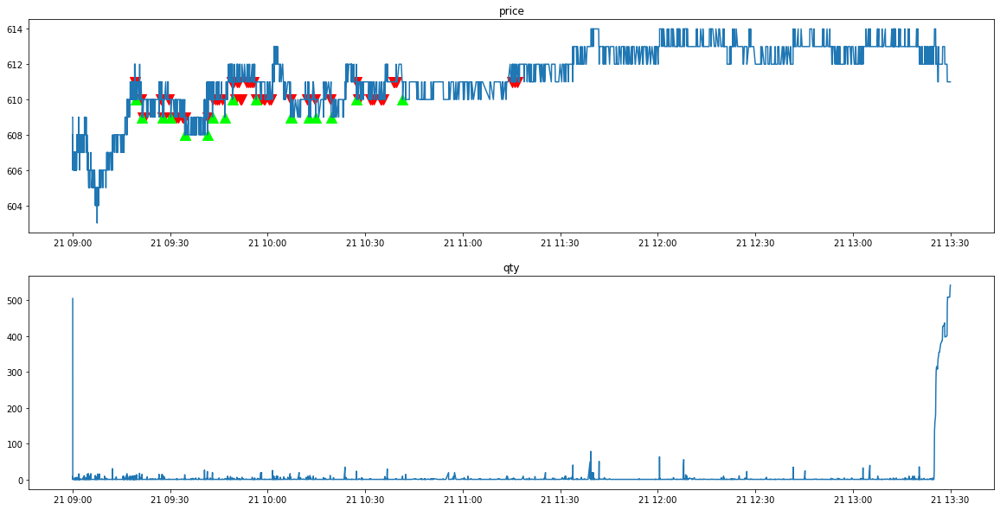

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90002919
*** bid1_p:  619.0
*** weighted_p:  617.7276119402985
ask1_p:  620.0
進場時間： 90631898 
  sell price at  619.0
stop profit
出場時間： 90636972
POSITION(pre):  [619.]
Order_p(pre):  [618.]
tick_row price:  618.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  621.0
*** weighted_p:  618.4882459312839
ask1_p:  622.0
進場時間： 90720176 
  sell price at  621.0
*** bid1_p:  621.0
*** weighted_p:  618.7921760391198
ask1_p:  622.0
進場時間： 90754808 
  sell price at  621.0
*** bid1_p:  621.0
*** weighted_p:  618.8842845973417
ask1_p:  622.0
進場時間： 90800055 
  sell price at  621.0
stop profit
出場時間： 90821009
POSITION(pre):  [621. 621. 621.]
Order_p(pre):  [620. 620. 620.]
tick_row price:  620.0
qualified index:  

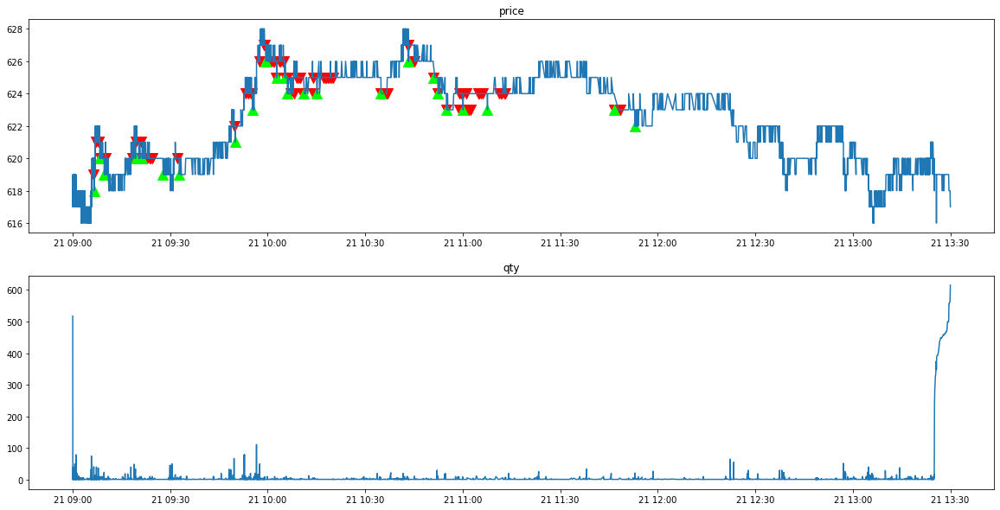

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90002544
*** bid1_p:  604.0
*** weighted_p:  603.0507982583455
ask1_p:  605.0
進場時間： 91155000 
  sell price at  604.0
*** bid1_p:  604.0
*** weighted_p:  603.0617224880383
ask1_p:  605.0
進場時間： 91202089 
  sell price at  604.0
stop profit
出場時間： 91208133
POSITION(pre):  [604. 604.]
Order_p(pre):  [603. 603.]
tick_row price:  603.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  605.0
*** weighted_p:  603.1549604916594
ask1_p:  606.0
進場時間： 91531464 
  sell price at  605.0
stop profit
出場時間： 91531464
POSITION(pre):  [605.]
Order_p(pre):  [604.]
tick_row price:  604.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  604.0
*** weighted_p:  603.1655082536925
ask1_p:  605.

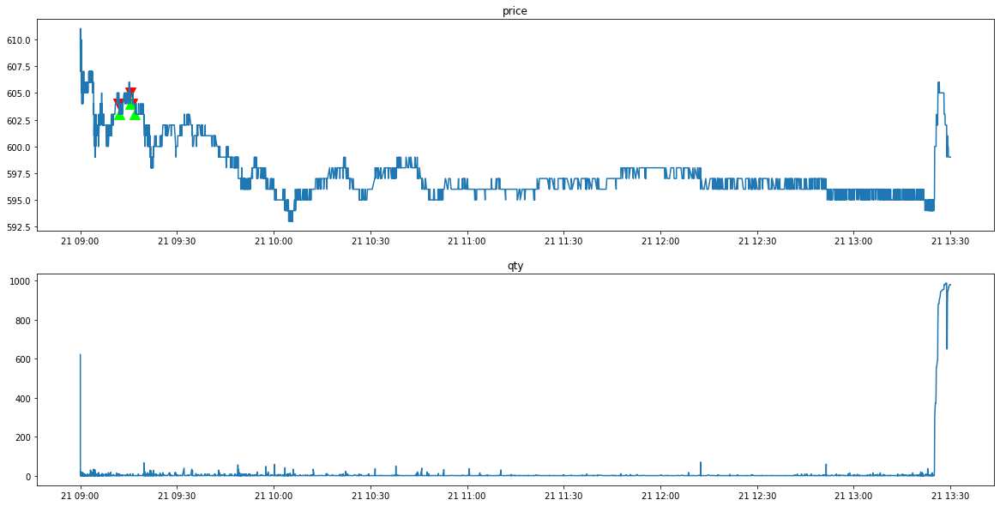

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90002257
*** bid1_p:  598.0
*** weighted_p:  597.1423357664233
ask1_p:  599.0
進場時間： 90245585 
  sell price at  598.0
*** bid1_p:  599.0
*** weighted_p:  597.9886877828054
ask1_p:  600.0
進場時間： 90506427 
  sell price at  599.0
stop profit
出場時間： 90512196
POSITION(pre):  [598. 599.]
Order_p(pre):  [597. 598.]
tick_row price:  598.0
qualified index:  [[1]]
POSITION(post):  [598.]
Order_p(post):  [597.]

stop profit
出場時間： 90620138
POSITION(pre):  [598.]
Order_p(pre):  [597.]
tick_row price:  597.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  596.0
*** weighted_p:  594.8263386396527
ask1_p:  597.0
進場時間： 95935573 
  sell price at  596.0
*** bid1_p:  596.0
*** weighted_p:  594.8279725334297
ask1_p:  5

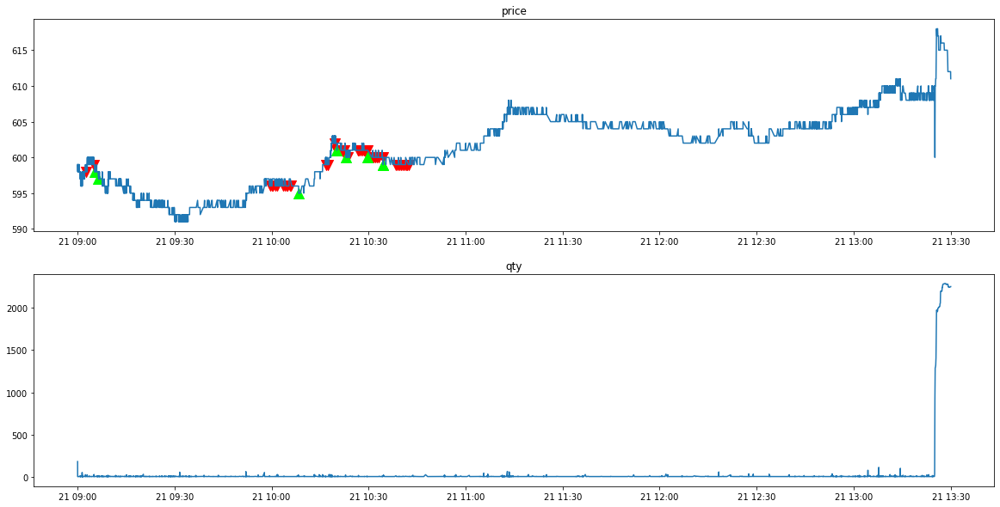

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90002456
*** bid1_p:  616.0
*** weighted_p:  614.961759082218
ask1_p:  617.0
進場時間： 90424910 
  sell price at  616.0
stop profit
出場時間： 90424986
POSITION(pre):  [616.]
Order_p(pre):  [615.]
tick_row price:  615.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  616.0
*** weighted_p:  615.1419902912621
ask1_p:  617.0
進場時間： 90613659 
  sell price at  616.0
*** bid1_p:  616.0
*** weighted_p:  615.1633136094674
ask1_p:  617.0
進場時間： 90644030 
  sell price at  616.0
*** bid1_p:  617.0
*** weighted_p:  615.3340314136126
ask1_p:  618.0
進場時間： 90726158 
  sell price at  617.0
*** bid1_p:  617.0
*** weighted_p:  615.3832823649337
ask1_p:  618.0
進場時間： 90756427 
  sell price at  617.0
*** bid1_p:  617.0
*** wei

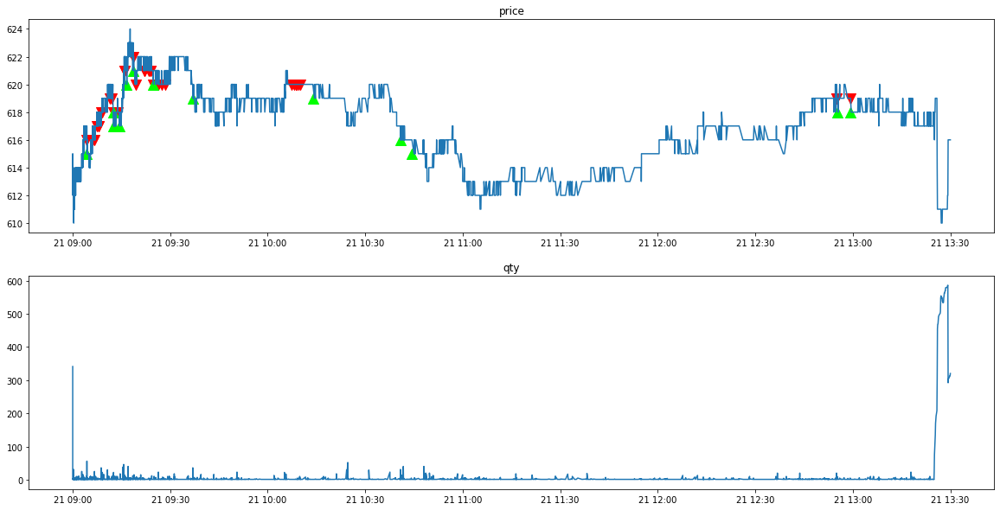

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90002610
*** bid1_p:  609.0
*** weighted_p:  608.1255006675567
ask1_p:  610.0
進場時間： 93745530 
  sell price at  609.0
*** bid1_p:  609.0
*** weighted_p:  608.1262783459315
ask1_p:  610.0
進場時間： 93800620 
  sell price at  609.0
stop profit
出場時間： 93807930
POSITION(pre):  [609. 609.]
Order_p(pre):  [608. 608.]
tick_row price:  608.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  609.0
*** weighted_p:  608.1550387596899
ask1_p:  610.0
進場時間： 94001220 
  sell price at  609.0
stop profit
出場時間： 94027883
POSITION(pre):  [609.]
Order_p(pre):  [608.]
tick_row price:  608.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  609.0
*** weighted_p:  608.1839367457345
ask1_p:  610.

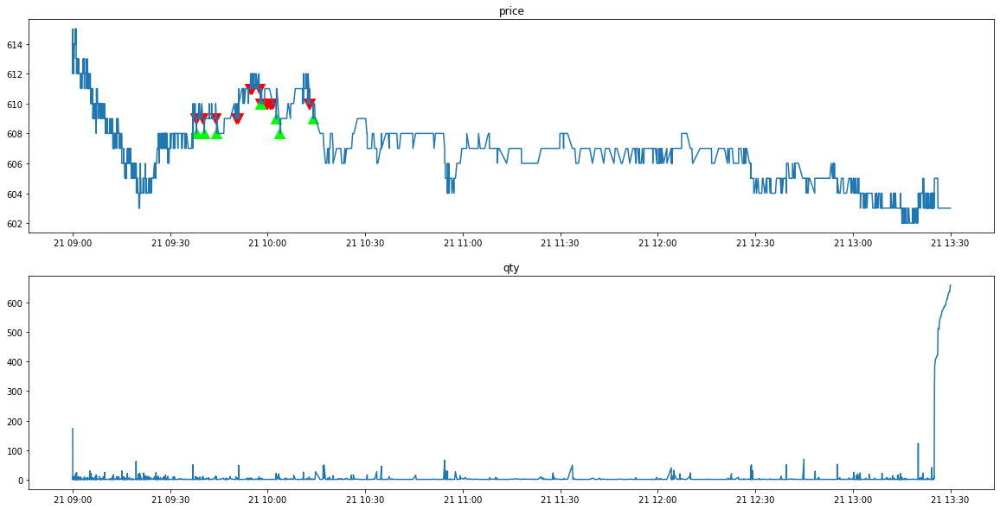

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90003781
*** bid1_p:  615.0
*** weighted_p:  613.7799153520585
ask1_p:  616.0
進場時間： 100020167 
  sell price at  615.0
stop profit
出場時間： 100020167
POSITION(pre):  [615.]
Order_p(pre):  [614.]
tick_row price:  614.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  615.0
*** weighted_p:  613.8157698056801
ask1_p:  616.0
進場時間： 100543671 
  sell price at  615.0
*** bid1_p:  615.0
*** weighted_p:  613.8179783662813
ask1_p:  616.0
進場時間： 100600869 
  sell price at  615.0
*** bid1_p:  615.0
*** weighted_p:  613.8201787043931
ask1_p:  616.0
進場時間： 100630919 
  sell price at  615.0
stop profit
出場時間： 100643186
POSITION(pre):  [615. 615. 615.]
Order_p(pre):  [614. 614. 614.]
tick_row price:  614.0
qualified in

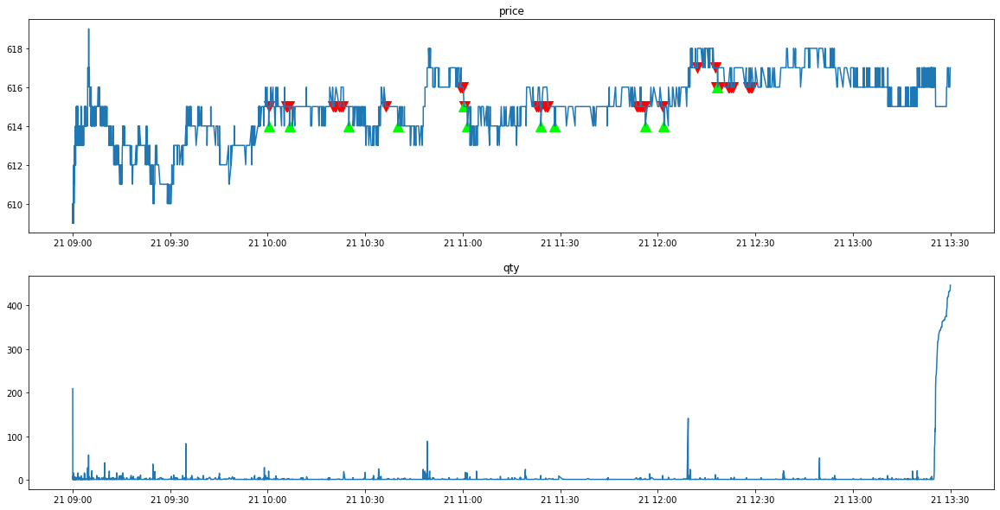

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90003676
*** bid1_p:  611.0
*** weighted_p:  609.4311594202899
ask1_p:  612.0
進場時間： 90229679 
  sell price at  611.0
stop profit
出場時間： 90229679
POSITION(pre):  [611.]
Order_p(pre):  [609.]
tick_row price:  609.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  613.0
*** weighted_p:  610.9291187739464
ask1_p:  614.0
進場時間： 90525413 
  sell price at  613.0
stop profit
出場時間： 90537708
POSITION(pre):  [613.]
Order_p(pre):  [612.]
tick_row price:  612.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  612.0
*** weighted_p:  611.1468048359241
ask1_p:  613.0
進場時間： 90555700 
  sell price at  612.0
*** bid1_p:  612.0
*** weighted_p:  611.1468048359241
ask1_p:  613.0
進場時間： 9060062

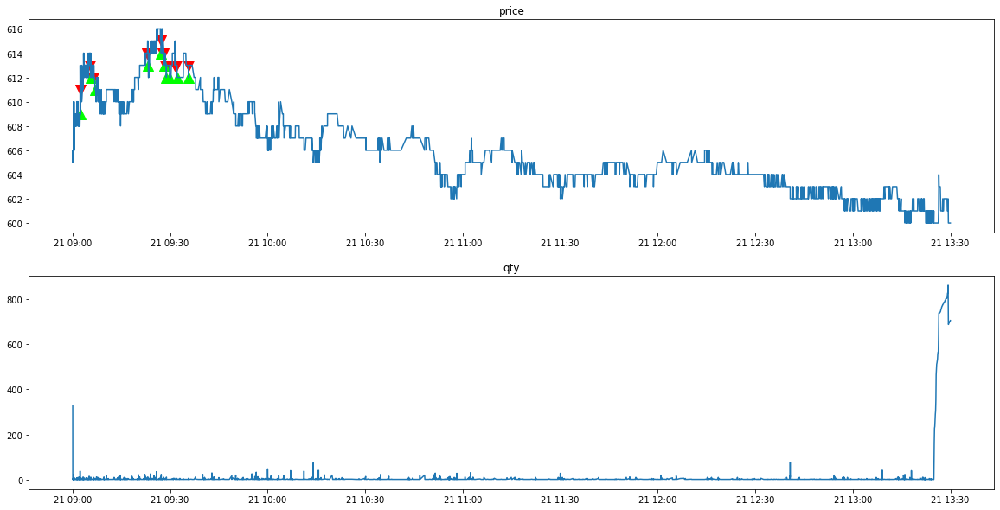

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2454/tse_lob_2454.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2454/tse_tick_2454.csv' mode='r' encoding='UTF-8'>
90004455
clear_position:  0.0
position:  []
tick_row_price 588.0
----------Result Report--------------
profit:  0.0


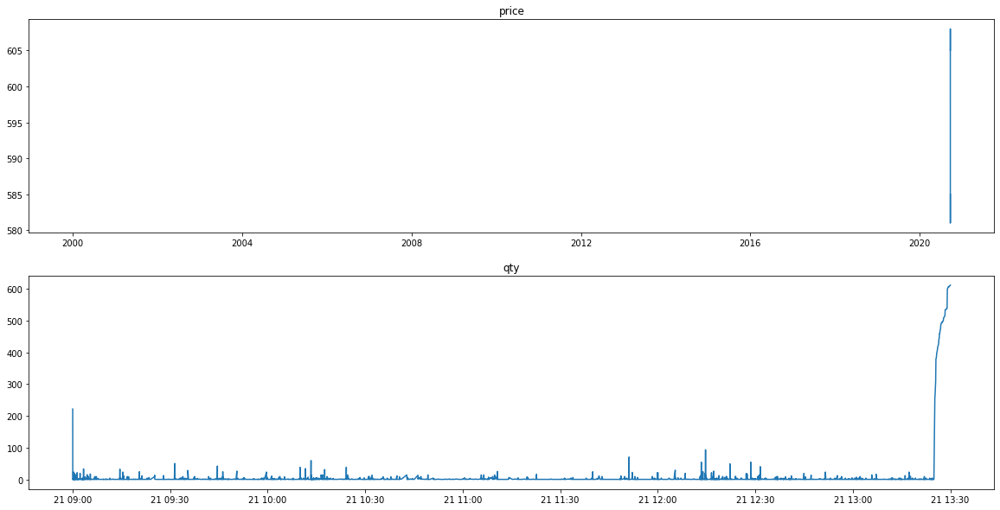

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90004032
*** bid1_p:  28.7
*** weighted_p:  28.6561429635153
ask1_p:  28.75
進場時間： 120650638 
  sell price at  28.7
*** bid1_p:  28.7
*** weighted_p:  28.6561429635153
ask1_p:  28.75
進場時間： 120700220 
  sell price at  28.7
stop profit
出場時間： 120700417
POSITION(pre):  [28.7 28.7]
Order_p(pre):  [28.65 28.65]
tick_row price:  28.65
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 28.7
----------Result Report--------------
profit:  0.10000000000000142


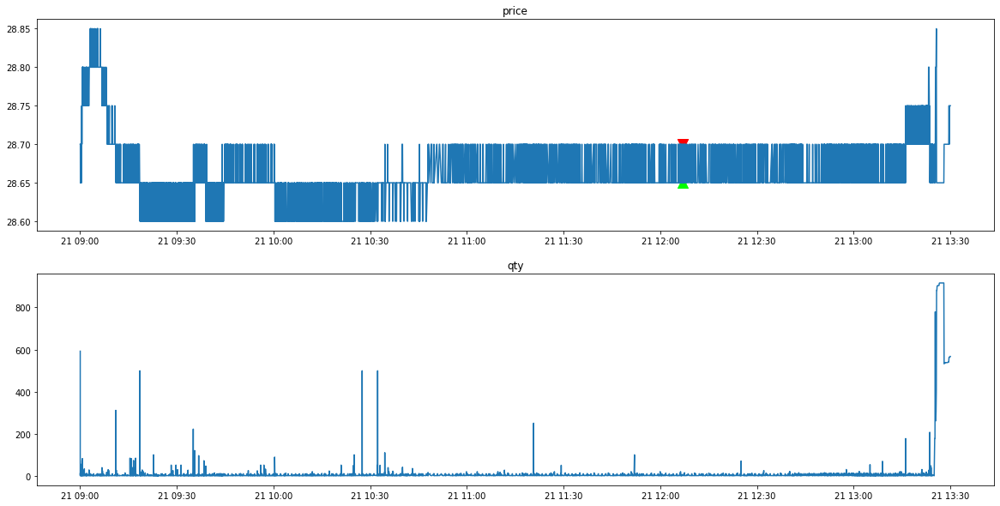

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90003098
clear_position:  0.0
position:  []
tick_row_price 28.6
----------Result Report--------------
profit:  0.0


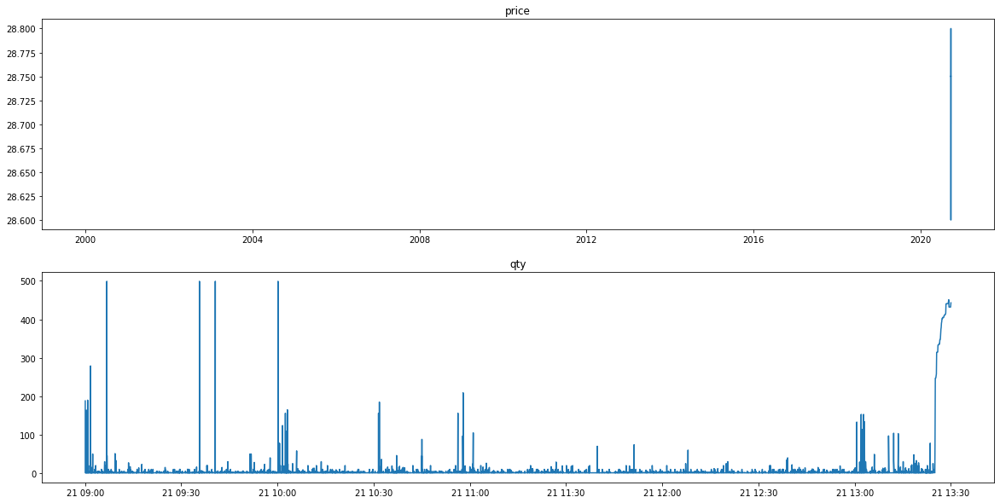

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90002335
*** bid1_p:  28.7
*** weighted_p:  28.660714285714317
ask1_p:  28.75
進場時間： 90644277 
  sell price at  28.7
*** bid1_p:  28.7
*** weighted_p:  28.66080459770118
ask1_p:  28.75
進場時間： 90700520 
  sell price at  28.7
*** bid1_p:  28.7
*** weighted_p:  28.665817409766483
ask1_p:  28.75
進場時間： 90859239 
  sell price at  28.7
*** bid1_p:  28.7
*** weighted_p:  28.66596194503174
ask1_p:  28.75
進場時間： 90900069 
  sell price at  28.7
*** bid1_p:  28.7
*** weighted_p:  28.666176470588265
ask1_p:  28.75
進場時間： 90930383 
  sell price at  28.7
*** bid1_p:  28.7
*** weighted_p:  28.667010309278385
ask1_p:  28.75
進場時間： 91000114 
  sell price at  28.7
stop profit
出場時間： 91800616
POSITION(pre):  [28.7 28.7 28.7 28.7 28.7 28.7]
Order_p(p

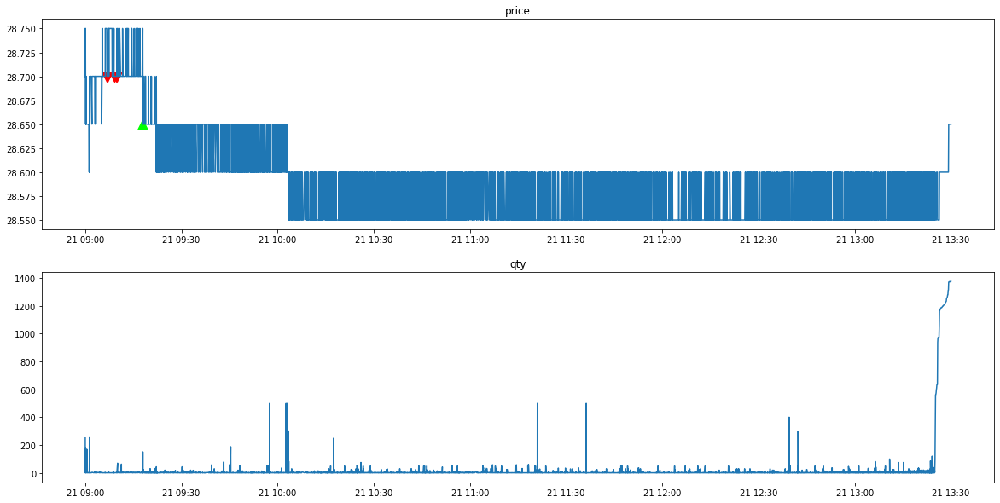

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90002125
clear_position:  0.0
position:  []
tick_row_price 28.55
----------Result Report--------------
profit:  0.0


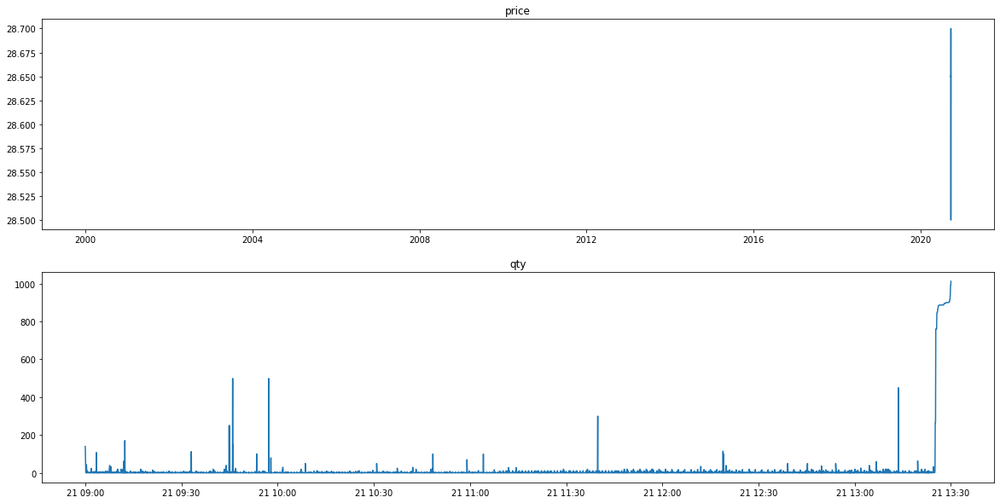

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90002661
clear_position:  0.0
position:  []
tick_row_price 28.55
----------Result Report--------------
profit:  0.0


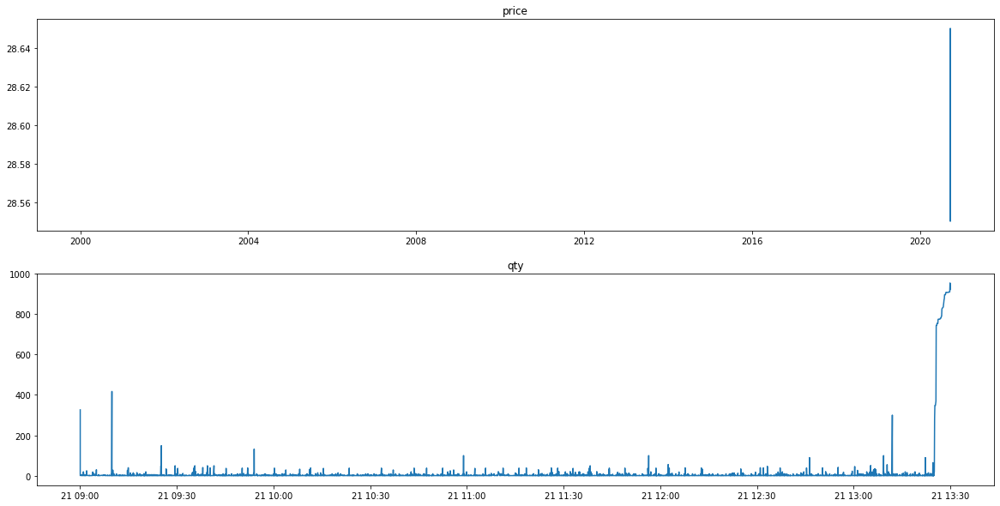

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90002304
clear_position:  0.0
position:  []
tick_row_price 28.65
----------Result Report--------------
profit:  0.0


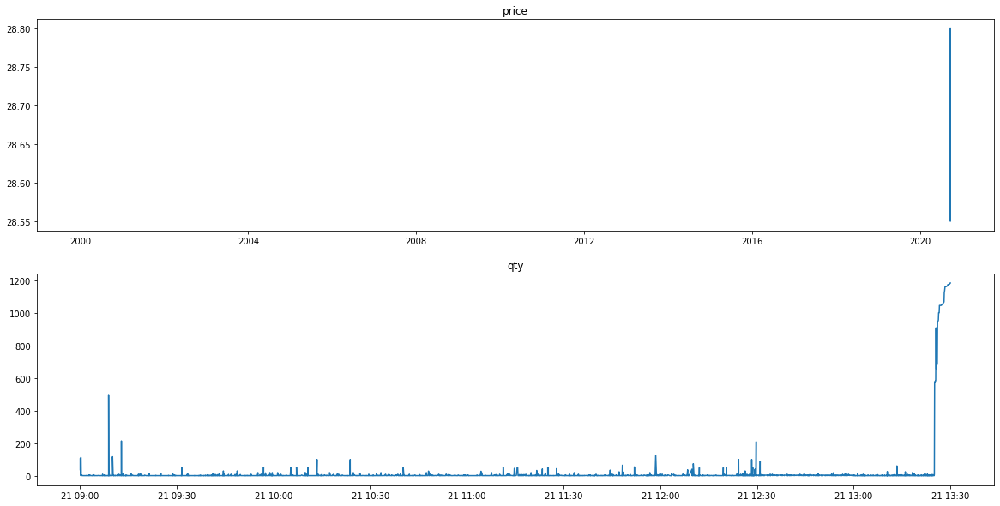

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90002808
clear_position:  0.0
position:  []
tick_row_price 28.6
----------Result Report--------------
profit:  0.0


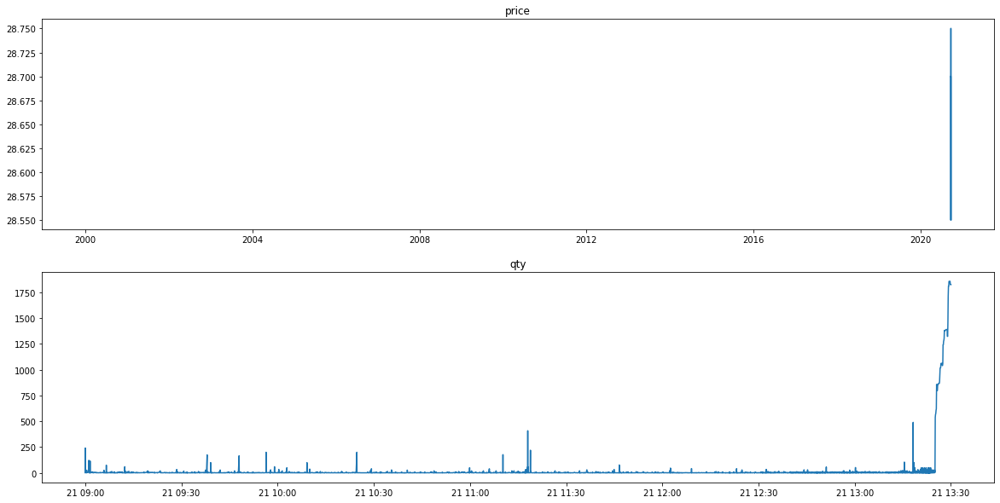

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90003662
clear_position:  0.0
position:  []
tick_row_price 28.5
----------Result Report--------------
profit:  0.0


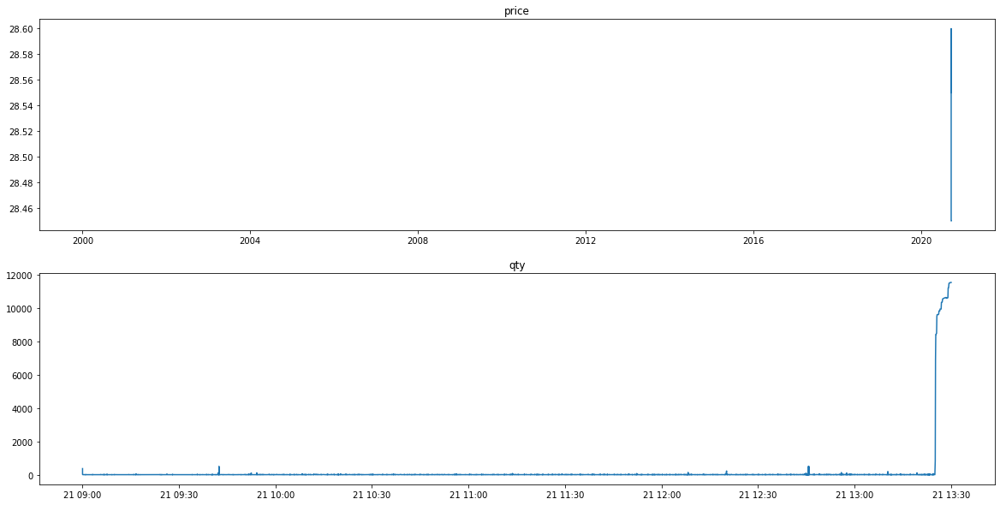

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90002055
clear_position:  0.0
position:  []
tick_row_price 28.2
----------Result Report--------------
profit:  0.0


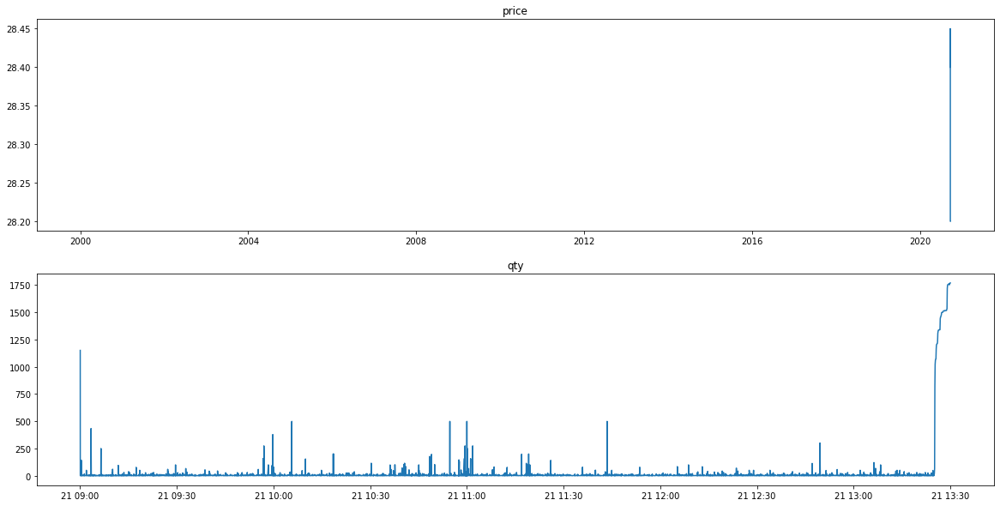

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90001806
clear_position:  0.0
position:  []
tick_row_price 27.9
----------Result Report--------------
profit:  0.0


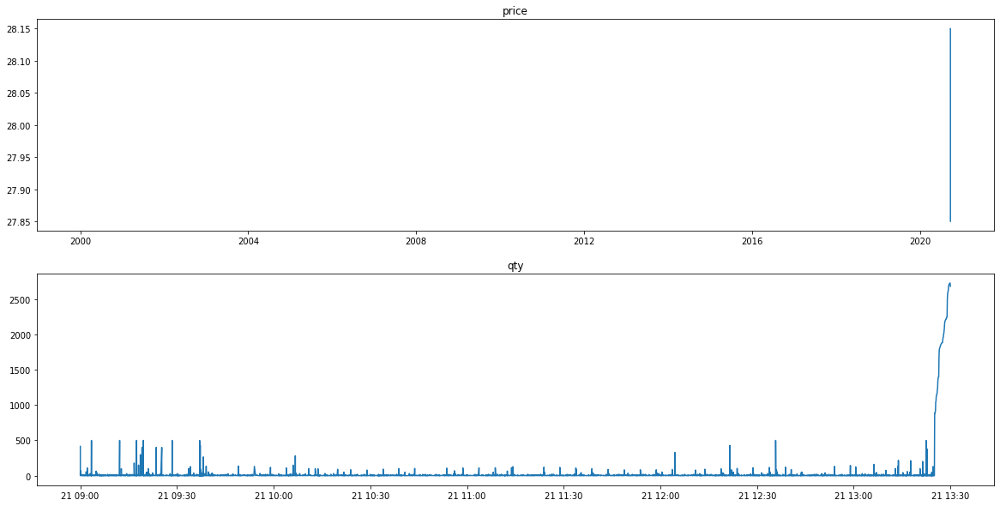

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90001374
clear_position:  0.0
position:  []
tick_row_price 27.55
----------Result Report--------------
profit:  0.0


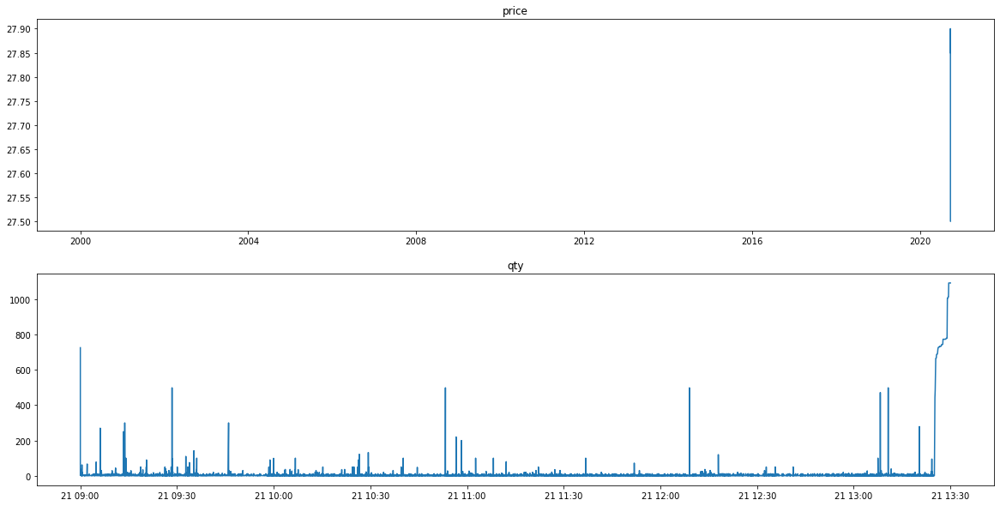

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90000892
*** bid1_p:  27.2
*** weighted_p:  27.168943494262727
ask1_p:  27.25
進場時間： 91957728 
  sell price at  27.2
*** bid1_p:  27.2
*** weighted_p:  27.168990488542917
ask1_p:  27.25
進場時間： 92000253 
  sell price at  27.2
*** bid1_p:  27.2
*** weighted_p:  27.16921092238218
ask1_p:  27.25
進場時間： 92030334 
  sell price at  27.2
*** bid1_p:  27.2
*** weighted_p:  27.170276838545956
ask1_p:  27.25
進場時間： 92138666 
  sell price at  27.2
*** bid1_p:  27.2
*** weighted_p:  27.170408593091715
ask1_p:  27.25
進場時間： 92200201 
  sell price at  27.2
*** bid1_p:  27.2
*** weighted_p:  27.171924969249574
ask1_p:  27.25
進場時間： 92307644 
  sell price at  27.2
*** bid1_p:  27.2
*** weighted_p:  27.172486826104453
ask1_p:  27.25
進場時間： 92402022

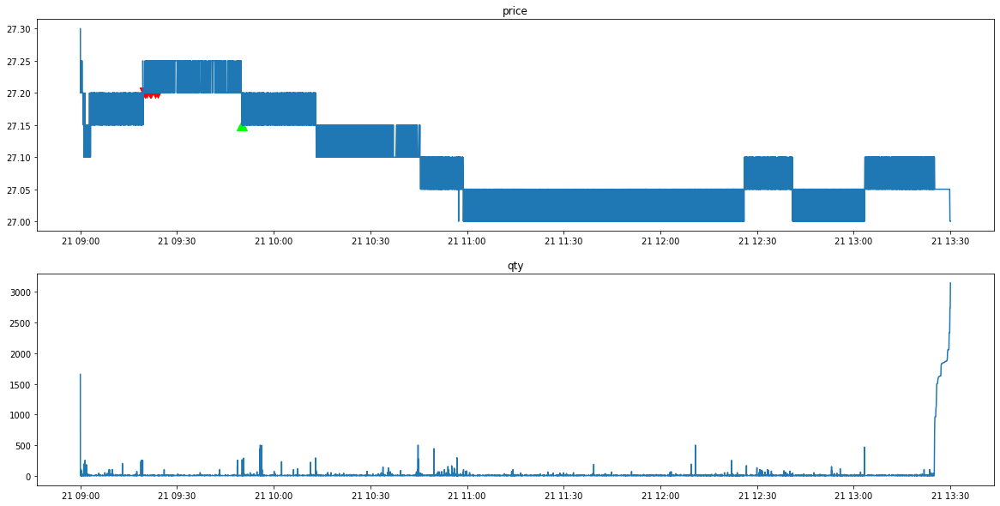

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2886/tse_lob_2886.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2886/tse_tick_2886.csv' mode='r' encoding='UTF-8'>
90001317
*** bid1_p:  27.15
*** weighted_p:  27.119964028777034
ask1_p:  27.2
進場時間： 90500152 
  sell price at  27.15
*** bid1_p:  27.2
*** weighted_p:  27.1336065573771
ask1_p:  27.25
進場時間： 90535109 
  sell price at  27.2
*** bid1_p:  27.25
*** weighted_p:  27.163050752928072
ask1_p:  27.3
進場時間： 90625120 
  sell price at  27.25
*** bid1_p:  27.3
*** weighted_p:  27.17004741833513
ask1_p:  27.35
進場時間： 90708543 
  sell price at  27.3
*** bid1_p:  27.3
*** weighted_p:  27.173431069958895
ask1_p:  27.35
進場時間： 90741728 
  sell price at  27.3
*** bid1_p:  27.3
*** weighted_p:  27.184046131667525
ask1_p:  27.35
進場時間： 90859704 
  sell price at  27.3
*** bid1_p:  27.3
*** weighted_p:  27.184046131667525
ask1_p:  27.35
進場時間： 90900106

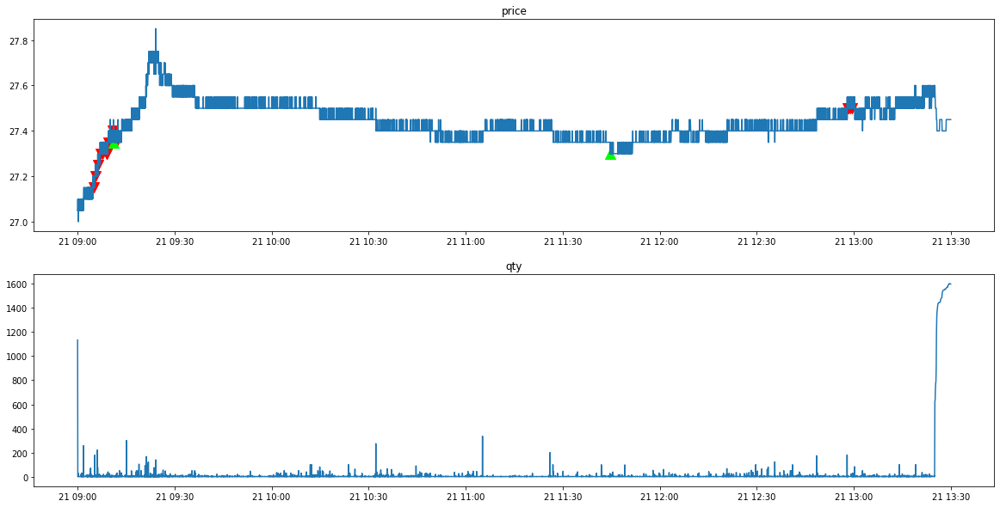

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90019533
*** bid1_p:  266.5
*** weighted_p:  265.89867109634554
ask1_p:  267.0
進場時間： 95707939 
  sell price at  266.5
*** bid1_p:  266.5
*** weighted_p:  265.93333333333334
ask1_p:  267.0
進場時間： 95738068 
  sell price at  266.5
stop profit
出場時間： 100846100
POSITION(pre):  [266.5 266.5]
Order_p(pre):  [266. 266.]
tick_row price:  266.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 266.0
----------Result Report--------------
profit:  1.0


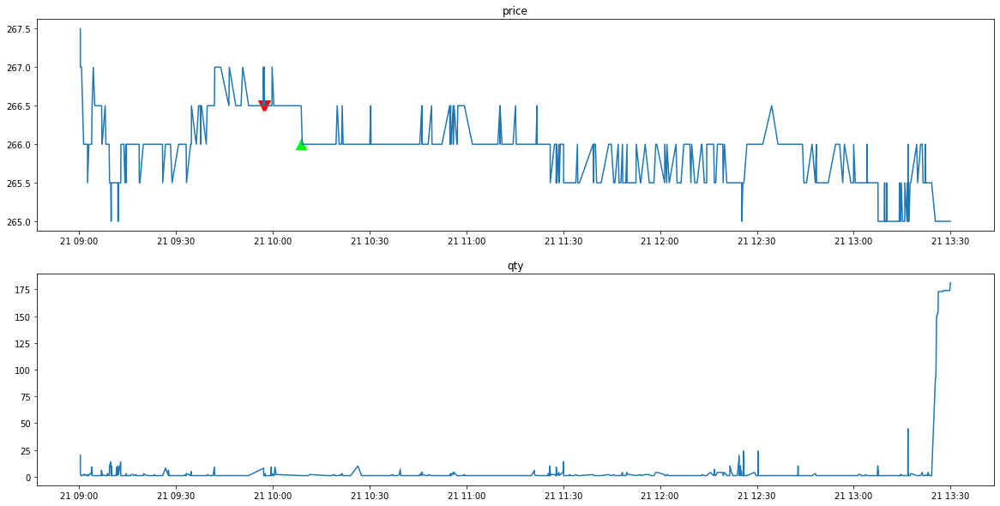

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90016905
*** bid1_p:  265.5
*** weighted_p:  264.2337770382695
ask1_p:  266.0
進場時間： 113123032 
  sell price at  265.5
*** bid1_p:  265.5
*** weighted_p:  264.2337770382695
ask1_p:  266.0
進場時間： 113217403 
  sell price at  265.5
*** bid1_p:  265.5
*** weighted_p:  264.25245901639346
ask1_p:  266.0
進場時間： 113251721 
  sell price at  265.5
*** bid1_p:  265.5
*** weighted_p:  264.25245901639346
ask1_p:  266.0
進場時間： 113305862 
  sell price at  265.5
*** bid1_p:  265.5
*** weighted_p:  264.25245901639346
ask1_p:  266.0
進場時間： 113343913 
  sell price at  265.5
*** bid1_p:  265.5
*** weighted_p:  264.25245901639346
ask1_p:  266.0
進場時間： 113400836 
  sell price at  265.5
*** bid1_p:  265.5
*** weighted_p:  264.3532110091743
ask1_p:  266

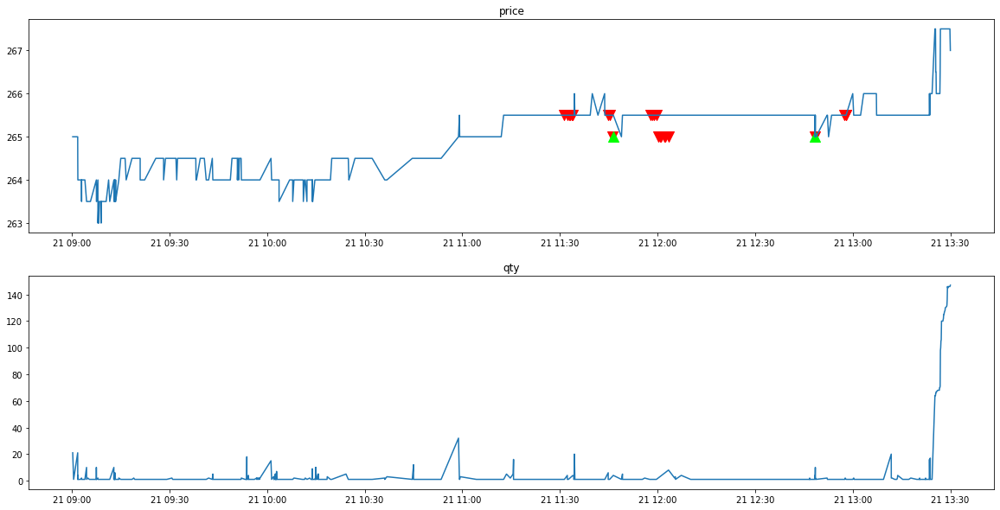

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90020184
clear_position:  0.0
position:  []
tick_row_price 265.5
----------Result Report--------------
profit:  0.0


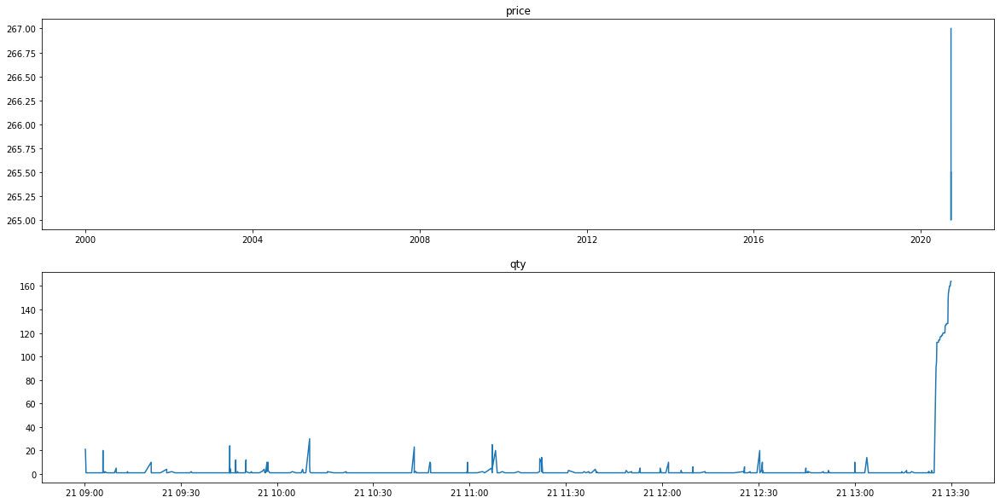

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90019794
clear_position:  0.0
position:  []
tick_row_price 267.0
----------Result Report--------------
profit:  0.0


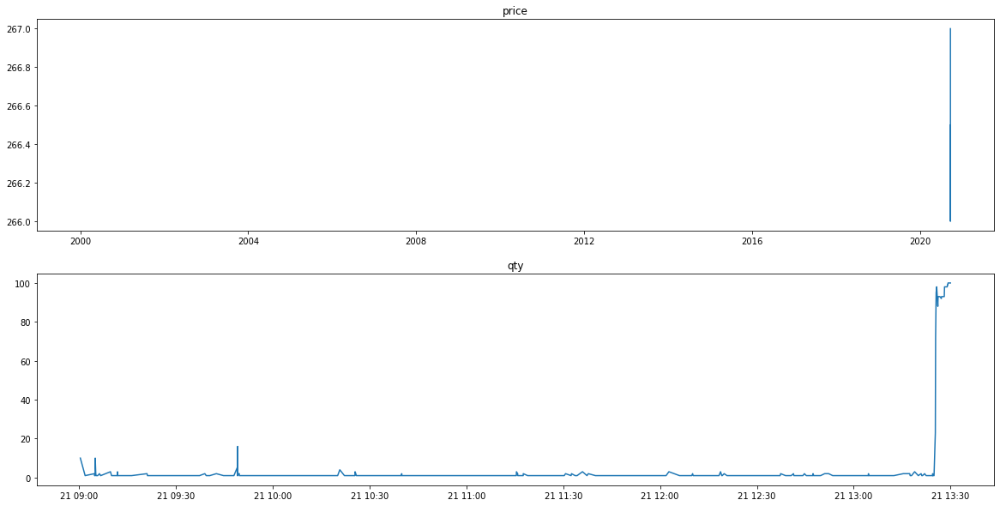

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90023121
*** bid1_p:  266.0
*** weighted_p:  265.66785714285714
ask1_p:  266.5
進場時間： 103900969 
  sell price at  266.0
stop profit
出場時間： 103916763
POSITION(pre):  [266.]
Order_p(pre):  [265.5]
tick_row price:  265.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 266.0
----------Result Report--------------
profit:  0.5


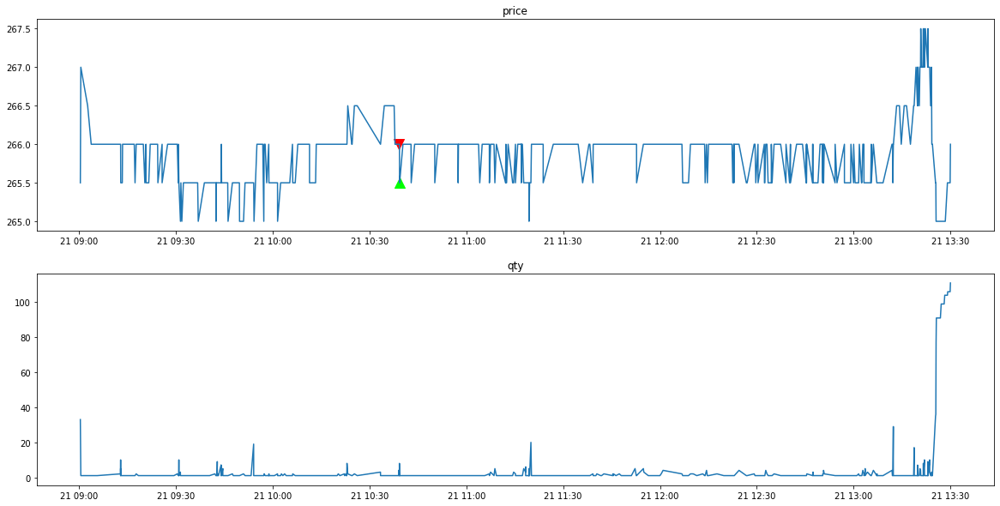

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90018175
*** bid1_p:  266.0
*** weighted_p:  265.18284789644014
ask1_p:  266.5
進場時間： 94727824 
  sell price at  266.0
*** bid1_p:  266.0
*** weighted_p:  265.18284789644014
ask1_p:  266.5
進場時間： 94801610 
  sell price at  266.0
*** bid1_p:  266.0
*** weighted_p:  265.18709677419355
ask1_p:  266.5
進場時間： 94838069 
  sell price at  266.0
*** bid1_p:  266.0
*** weighted_p:  265.18709677419355
ask1_p:  266.5
進場時間： 94916574 
  sell price at  266.0
*** bid1_p:  266.0
*** weighted_p:  265.18709677419355
ask1_p:  266.5
進場時間： 94950669 
  sell price at  266.0
stop profit
出場時間： 95138726
POSITION(pre):  [266. 266. 266. 266. 266.]
Order_p(pre):  [265.5 265.5 265.5 265.5 265.5]
tick_row price:  265.5
qualified index:  [[0]
 [1]
 [2]
 [3]
 

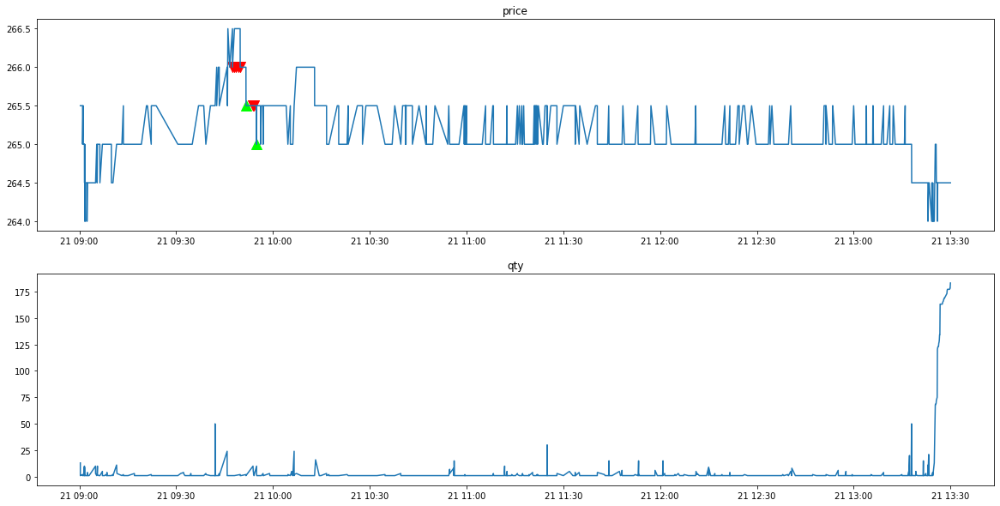

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90017851
*** bid1_p:  265.0
*** weighted_p:  264.67241379310343
ask1_p:  265.5
進場時間： 91416482 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7
ask1_p:  265.5
進場時間： 91450159 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7
ask1_p:  265.5
進場時間： 91504676 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7
ask1_p:  265.5
進場時間： 91538569 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7
ask1_p:  265.5
進場時間： 91627064 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7
ask1_p:  265.5
進場時間： 91658423 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7
ask1_p:  265.5
進場時間： 91706838 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264

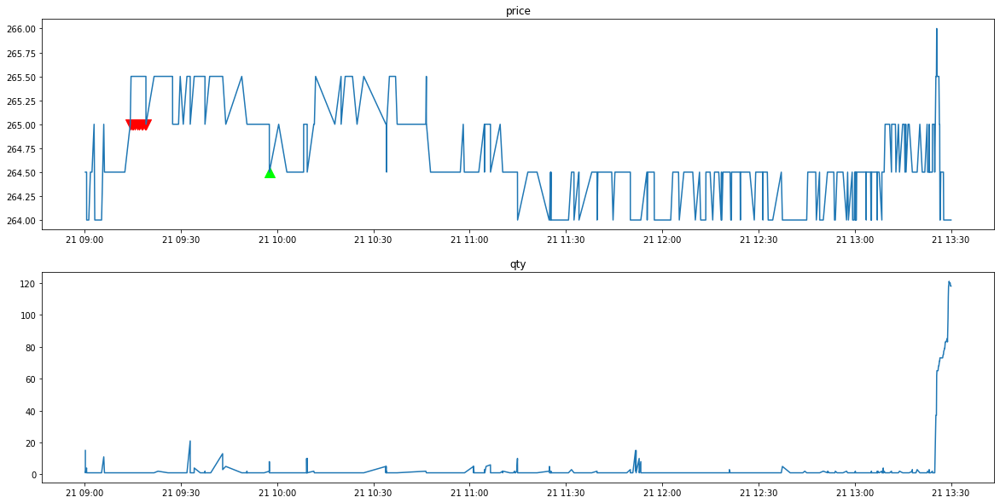

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90020530
clear_position:  0.0
position:  []
tick_row_price 264.5
----------Result Report--------------
profit:  0.0


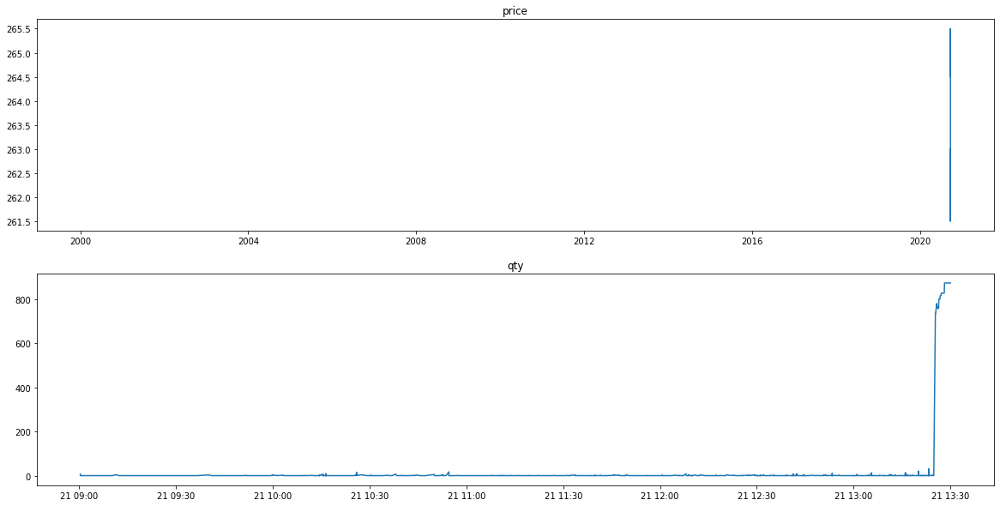

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90019505
*** bid1_p:  264.0
*** weighted_p:  263.5849514563107
ask1_p:  264.5
進場時間： 95541795 
  sell price at  264.0
*** bid1_p:  265.0
*** weighted_p:  264.1971962616822
ask1_p:  265.5
進場時間： 125018559 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.203531598513
ask1_p:  265.5
進場時間： 125121046 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.203531598513
ask1_p:  265.5
進場時間： 125219113 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.203531598513
ask1_p:  265.5
進場時間： 125255603 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.203531598513
ask1_p:  265.5
進場時間： 125300429 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.20593692022265
ask1_p:  265.5
進場時間：

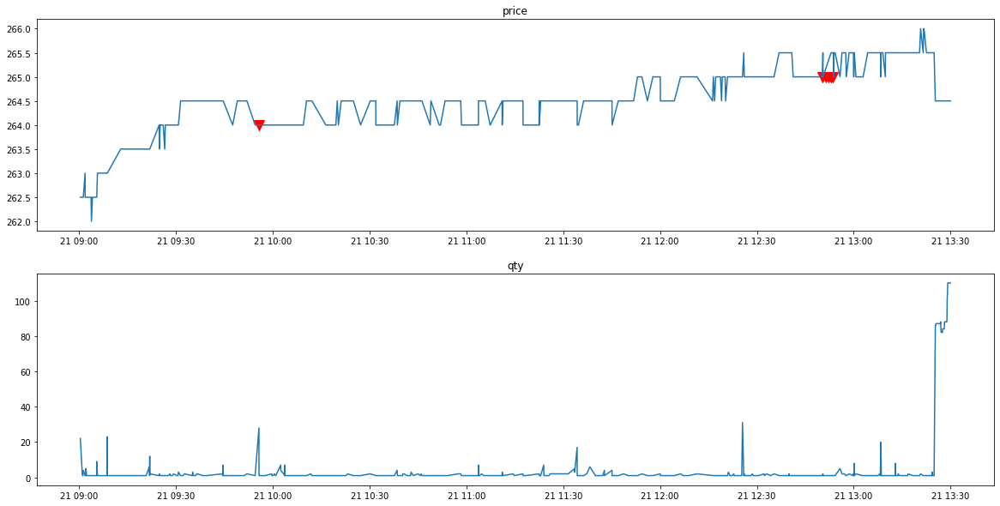

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90020075
*** bid1_p:  265.0
*** weighted_p:  264.5575
ask1_p:  265.5
進場時間： 101346176 
  sell price at  265.0
stop profit
出場時間： 101346176
POSITION(pre):  [265.]
Order_p(pre):  [264.5]
tick_row price:  264.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  265.0
*** weighted_p:  264.72549019607845
ask1_p:  265.5
進場時間： 112546240 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7288961038961
ask1_p:  265.5
進場時間： 112610964 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7288961038961
ask1_p:  265.5
進場時間： 112649297 
  sell price at  265.0
*** bid1_p:  265.0
*** weighted_p:  264.7313915857605
ask1_p:  265.5
進場時間： 112712580 
  sell price at  265.0
stop profit
出場時間： 12015491

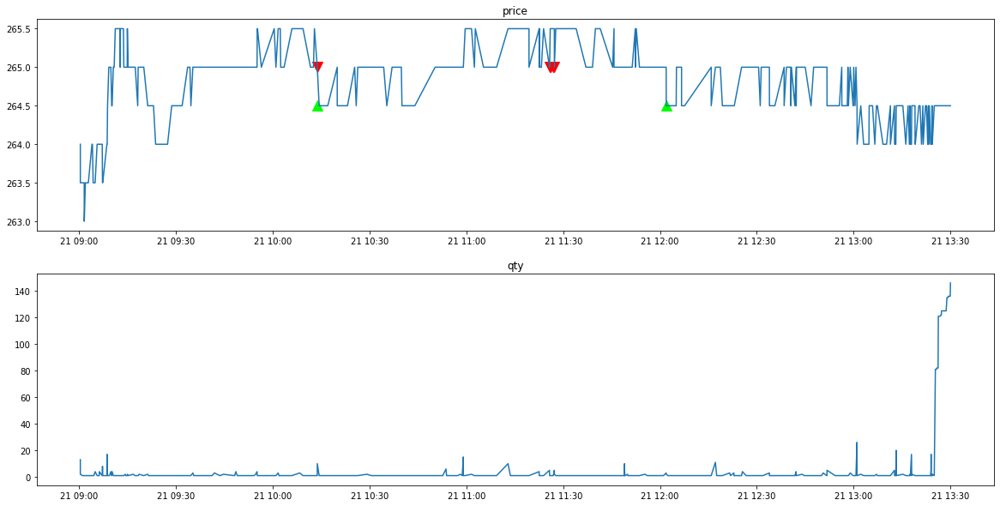

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90019430
clear_position:  0.0
position:  []
tick_row_price 261.5
----------Result Report--------------
profit:  0.0


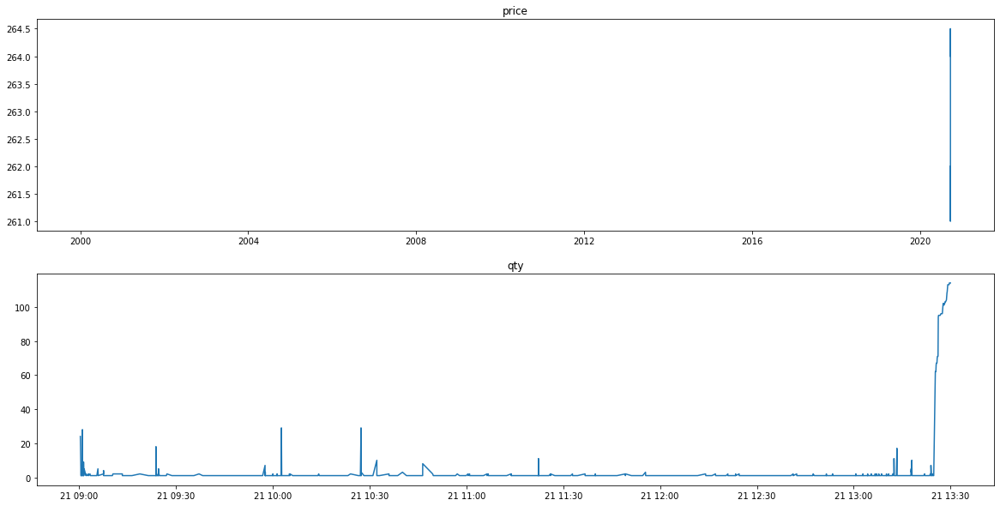

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90016123
clear_position:  0.0
position:  []
tick_row_price 254.0
----------Result Report--------------
profit:  0.0


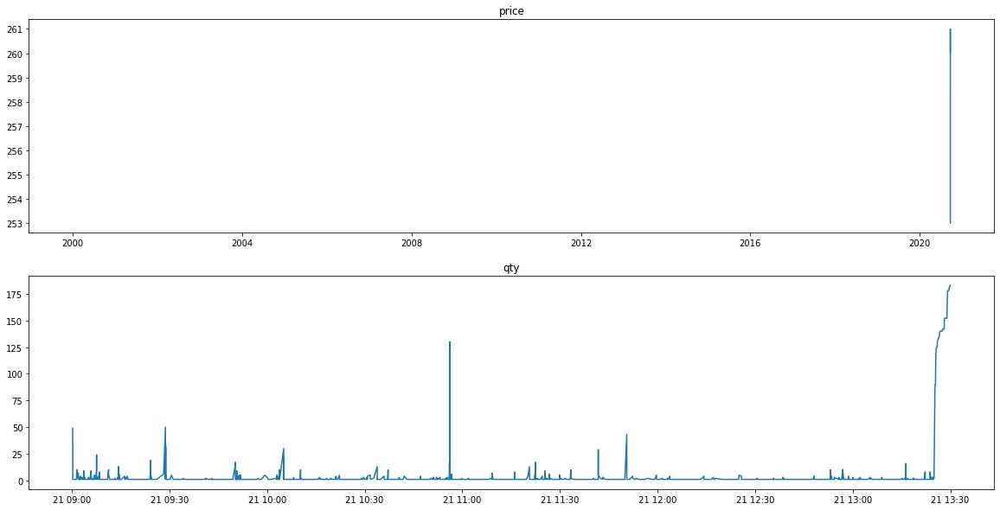

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2912/tse_lob_2912.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2912/tse_tick_2912.csv' mode='r' encoding='UTF-8'>
90011747
*** bid1_p:  257.0
*** weighted_p:  256.5975
ask1_p:  257.5
進場時間： 93145393 
  sell price at  257.0
stop profit
出場時間： 93648085
POSITION(pre):  [257.]
Order_p(pre):  [256.5]
tick_row price:  256.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  258.0
*** weighted_p:  256.65647163120565
ask1_p:  258.5
進場時間： 123820389 
  sell price at  258.0
*** bid1_p:  258.0
*** weighted_p:  256.6581045172719
ask1_p:  258.5
進場時間： 123858541 
  sell price at  258.0
*** bid1_p:  258.0
*** weighted_p:  256.6581045172719
ask1_p:  258.5
進場時間： 123900196 
  sell price at  258.0
*** bid1_p:  258.0
*** weighted_p:  256.6597345132743
ask1_p:  258.5
進場時間： 123932685 
  sell price at  258.0
*** bid1_p:  258.0
*** weigh

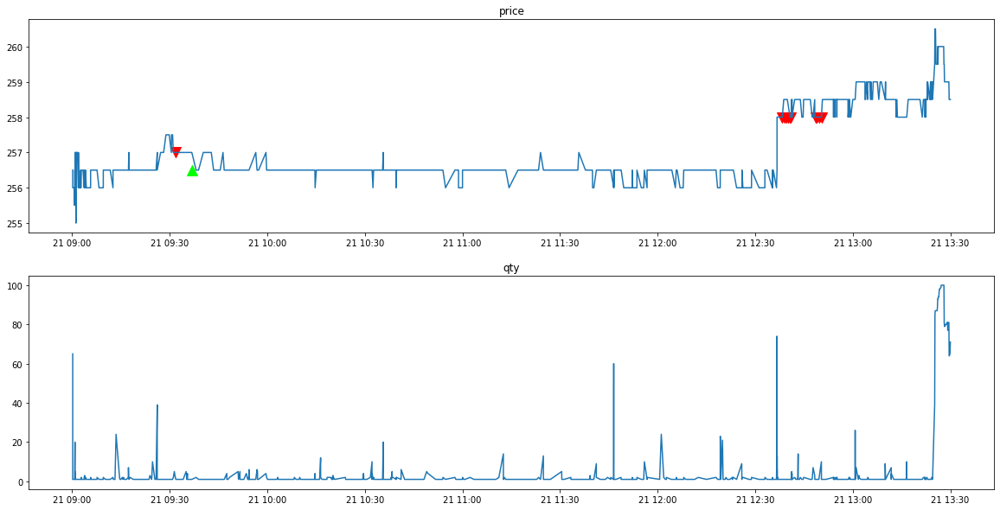

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90009247
*** bid1_p:  182.5
*** weighted_p:  181.90540540540542
ask1_p:  183.0
進場時間： 90238010 
  sell price at  182.5
stop profit
出場時間： 90251707
POSITION(pre):  [182.5]
Order_p(pre):  [182.]
tick_row price:  182.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  181.5
*** weighted_p:  180.78232301822806
ask1_p:  182.0
進場時間： 93414643 
  sell price at  181.5
*** bid1_p:  181.5
*** weighted_p:  180.78353787558189
ask1_p:  182.0
進場時間： 93445269 
  sell price at  181.5
*** bid1_p:  182.5
*** weighted_p:  180.87934439178514
ask1_p:  183.0
進場時間： 93638613 
  sell price at  182.5
*** bid1_p:  182.0
*** weighted_p:  180.8869889937107
ask1_p:  182.5
進場時間： 93700110 
  sell price at  182.0
*** bid1_p:  182.0
*

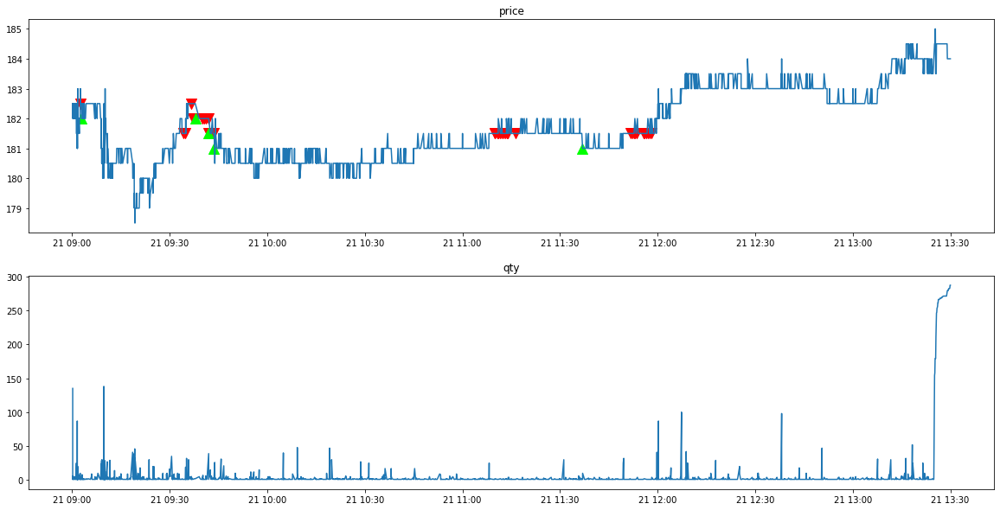

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90006511
*** bid1_p:  184.0
*** weighted_p:  183.4077922077922
ask1_p:  184.5
進場時間： 95655525 
  sell price at  184.0
*** bid1_p:  184.0
*** weighted_p:  183.40873702422147
ask1_p:  184.5
進場時間： 95700432 
  sell price at  184.0
*** bid1_p:  184.0
*** weighted_p:  183.41026747195858
ask1_p:  184.5
進場時間： 95731043 
  sell price at  184.0
*** bid1_p:  184.0
*** weighted_p:  183.41026747195858
ask1_p:  184.5
進場時間： 95800920 
  sell price at  184.0
*** bid1_p:  184.0
*** weighted_p:  183.42167654530058
ask1_p:  184.5
進場時間： 95831310 
  sell price at  184.0
*** bid1_p:  184.0
*** weighted_p:  183.4264705882353
ask1_p:  184.5
進場時間： 95904103 
  sell price at  184.0
*** bid1_p:  184.0
*** weighted_p:  183.428391959799
ask1_p:  184.5
進場時間

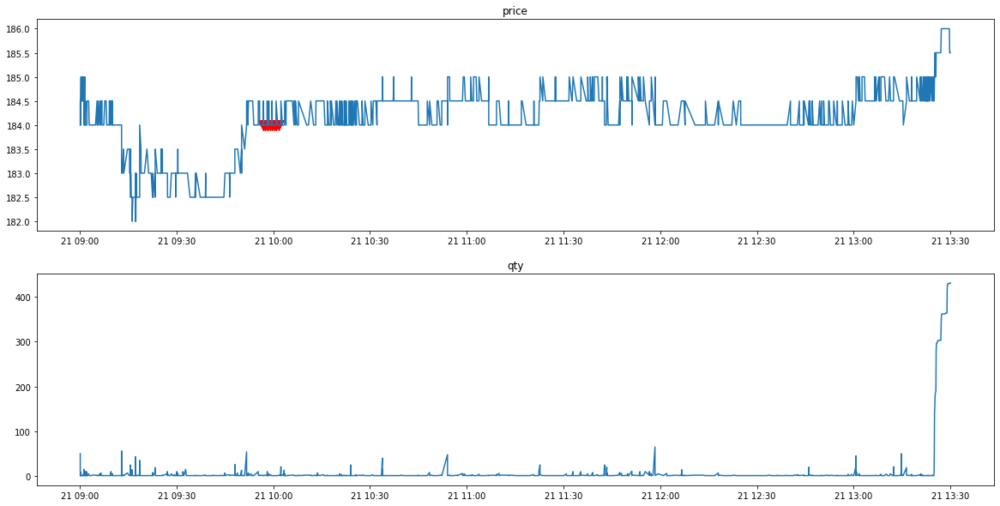

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90010207
*** bid1_p:  186.0
*** weighted_p:  185.45843828715365
ask1_p:  186.5
進場時間： 91410850 
  sell price at  186.0
stop profit
出場時間： 91410919
POSITION(pre):  [186.]
Order_p(pre):  [185.5]
tick_row price:  185.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  186.0
*** weighted_p:  185.52431059506532
ask1_p:  186.5
進場時間： 103511573 
  sell price at  186.0
*** bid1_p:  186.0
*** weighted_p:  185.52958152958152
ask1_p:  186.5
進場時間： 103541593 
  sell price at  186.0
*** bid1_p:  186.0
*** weighted_p:  185.52958152958152
ask1_p:  186.5
進場時間： 103600178 
  sell price at  186.0
*** bid1_p:  186.0
*** weighted_p:  185.58718980549966
ask1_p:  186.5
進場時間： 104040691 
  sell price at  186.0
*** bid1_p:  18

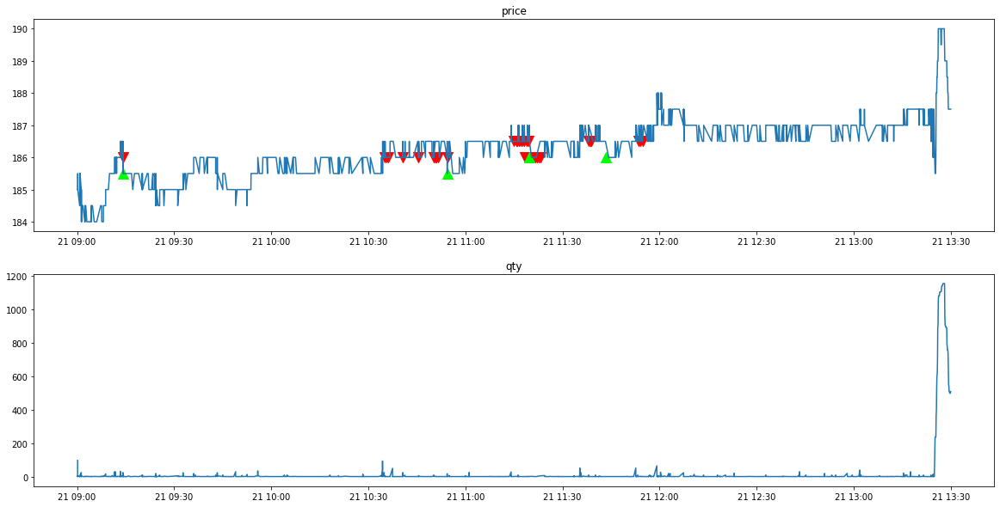

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90007517
------Weird price!!!!!---------
At time:  90700361
tick_row_price 188.5
ask_1_p 189.0
bid_1_p 188.0
*** bid1_p:  189.5
*** weighted_p:  188.5344827586207
ask1_p:  190.0
進場時間： 95812204 
  sell price at  189.5
*** bid1_p:  189.5
*** weighted_p:  188.56276747503566
ask1_p:  190.0
進場時間： 95843545 
  sell price at  189.5
*** bid1_p:  189.5
*** weighted_p:  188.56379187455454
ask1_p:  190.0
進場時間： 95900076 
  sell price at  189.5
*** bid1_p:  189.5
*** weighted_p:  188.57905832747716
ask1_p:  190.0
進場時間： 100200850 
  sell price at  189.5
*** bid1_p:  189.5
*** weighted_p:  188.58292512246325
ask1_p:  190.0
進場時間： 100231683 
  sell price at  189.5
*** bid1_p:  189.5
*** weighted_p:  188.58548499651081
ask1_p:  190.0
進場時間： 10

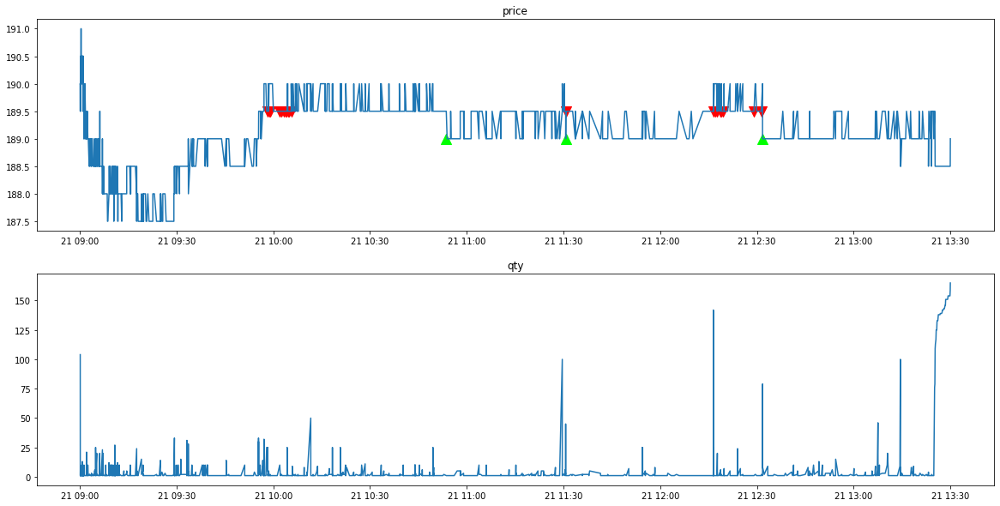

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90005642
------Weird price!!!!!---------
At time:  95303899
tick_row_price 190.5
ask_1_p 191.0
bid_1_p 190.0
*** bid1_p:  190.0
*** weighted_p:  189.36463046757166
ask1_p:  191.0
進場時間： 95303899 
  sell price at  190.0
*** bid1_p:  190.0
*** weighted_p:  189.41672623302358
ask1_p:  190.5
進場時間： 95826478 
  sell price at  190.0
*** bid1_p:  190.0
*** weighted_p:  189.42045454545453
ask1_p:  190.5
進場時間： 95858386 
  sell price at  190.0
*** bid1_p:  190.0
*** weighted_p:  189.42045454545453
ask1_p:  190.5
進場時間： 95904093 
  sell price at  190.0
*** bid1_p:  190.0
*** weighted_p:  189.42045454545453
ask1_p:  190.5
進場時間： 95934734 
  sell price at  190.0
*** bid1_p:  190.0
*** weighted_p:  189.4227498228207
ask1_p:  190.5
進場時間： 1000

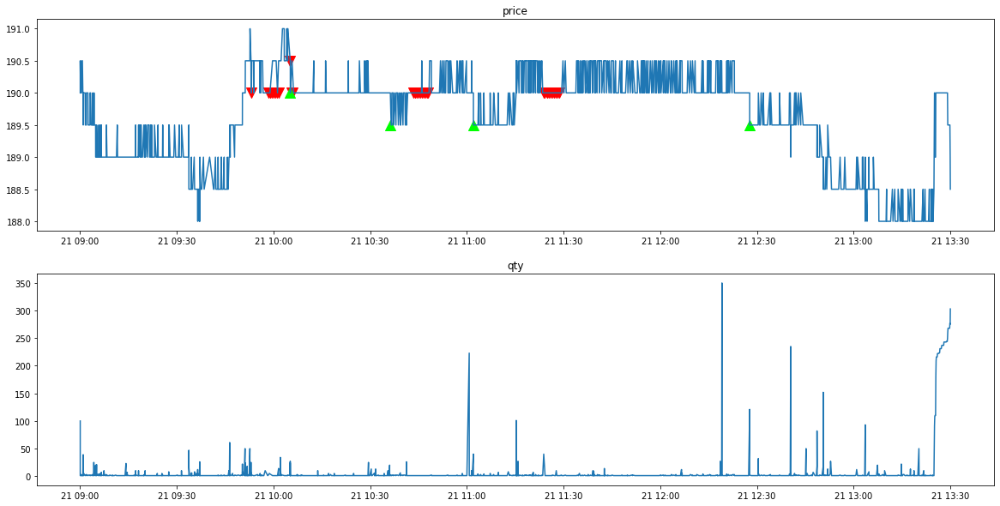

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90006531
*** bid1_p:  190.5
*** weighted_p:  190.05769230769232
ask1_p:  191.0
進場時間： 92059595 
  sell price at  190.5
stop profit
出場時間： 92154853
POSITION(pre):  [190.5]
Order_p(pre):  [190.]
tick_row price:  190.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  190.5
*** weighted_p:  190.15075921908894
ask1_p:  191.0
進場時間： 100006341 
  sell price at  190.5
stop profit
出場時間： 100035647
POSITION(pre):  [190.5]
Order_p(pre):  [190.]
tick_row price:  190.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  190.5
*** weighted_p:  190.19209891435463
ask1_p:  191.0
進場時間： 113753534 
  sell price at  190.5
*** bid1_p:  190.5
*** weighted_p:  190.20442477876105
ask1_p:  191.0
進場時間

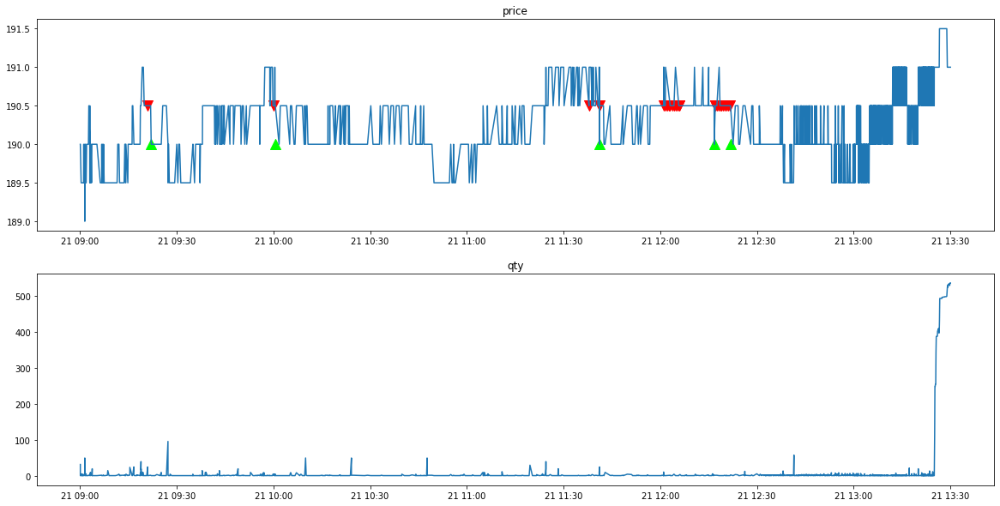

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90007621
*** bid1_p:  191.5
*** weighted_p:  191.17752100840337
ask1_p:  192.0
進場時間： 93924888 
  sell price at  191.5
*** bid1_p:  191.5
*** weighted_p:  191.22550831792975
ask1_p:  192.0
進場時間： 94304540 
  sell price at  191.5
stop profit
出場時間： 94304661
POSITION(pre):  [191.5 191.5]
Order_p(pre):  [191. 191.]
tick_row price:  191.0
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 190.5
----------Result Report--------------
profit:  1.0


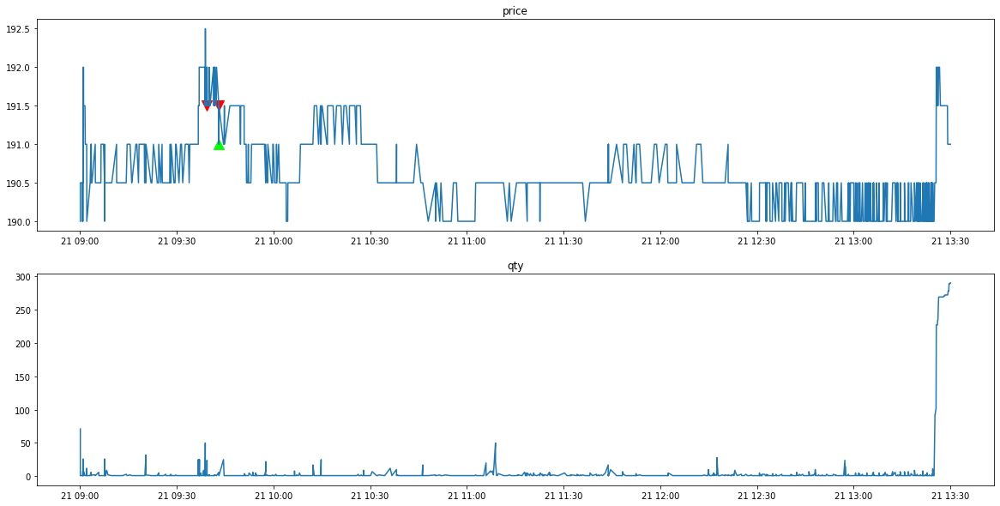

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90011495
*** bid1_p:  190.0
*** weighted_p:  189.30558722919042
ask1_p:  190.5
進場時間： 95128735 
  sell price at  190.0
stop profit
出場時間： 95129229
POSITION(pre):  [190.]
Order_p(pre):  [189.5]
tick_row price:  189.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  190.0
*** weighted_p:  189.32122905027933
ask1_p:  190.5
進場時間： 95216408 
  sell price at  190.0
stop profit
出場時間： 95222313
POSITION(pre):  [190.]
Order_p(pre):  [189.5]
tick_row price:  189.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  190.0
*** weighted_p:  189.35805084745763
ask1_p:  190.5
進場時間： 95320553 
  sell price at  190.0
stop profit
出場時間： 95349957
POSITION(pre):  [190.]
Order_p(pre):  [189.5]
tick

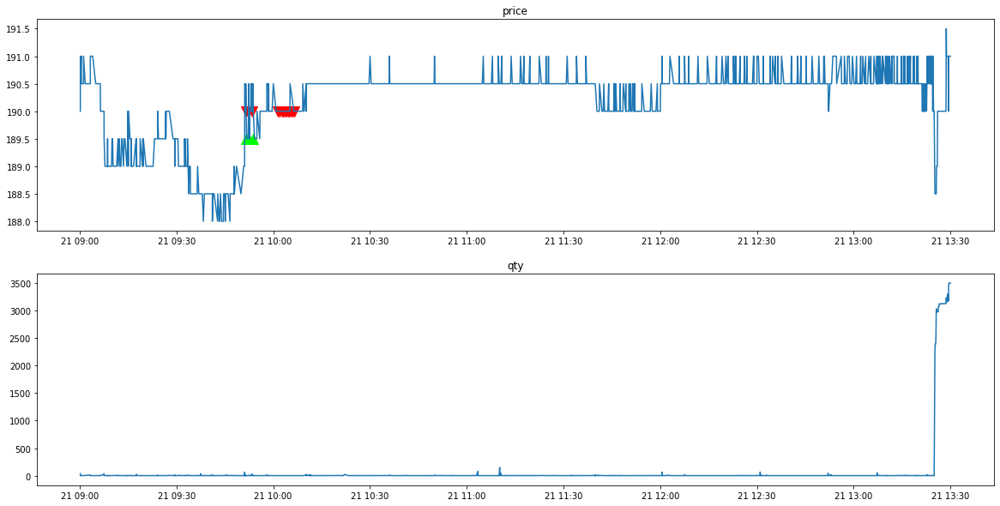

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90011591
*** bid1_p:  190.5
*** weighted_p:  189.6993670886076
ask1_p:  191.0
進場時間： 91224347 
  sell price at  190.5
stop profit
出場時間： 91229728
POSITION(pre):  [190.5]
Order_p(pre):  [190.]
tick_row price:  190.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  190.0
*** weighted_p:  189.709375
ask1_p:  190.5
進場時間： 91254489 
  sell price at  190.0
stop profit
出場時間： 91255058
POSITION(pre):  [190.]
Order_p(pre):  [189.5]
tick_row price:  189.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  190.5
*** weighted_p:  189.88957055214723
ask1_p:  191.0
進場時間： 92232032 
  sell price at  190.5
*** bid1_p:  190.5
*** weighted_p:  189.88957055214723
ask1_p:  191.0
進場時間： 92305538 


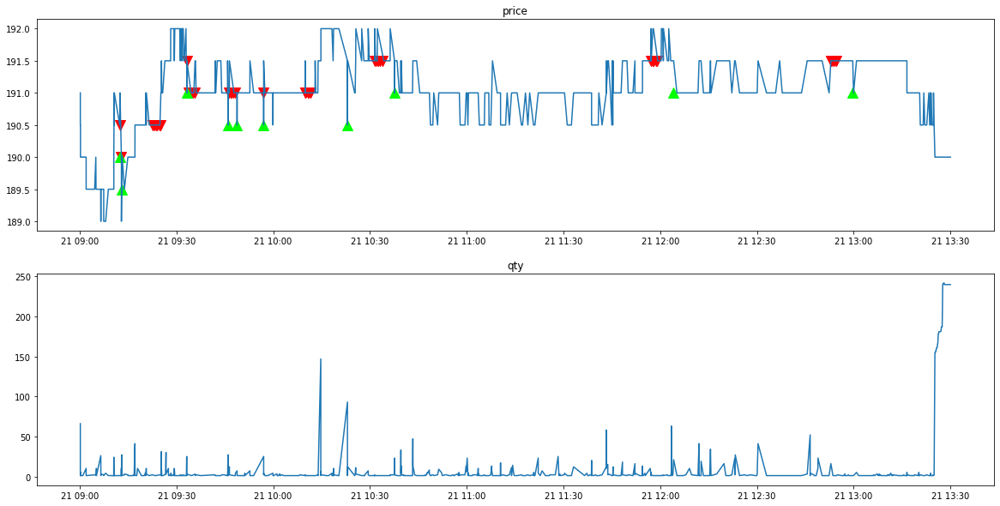

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90011651
*** bid1_p:  188.0
*** weighted_p:  187.51387461459404
ask1_p:  188.5
進場時間： 94042140 
  sell price at  188.0
*** bid1_p:  188.0
*** weighted_p:  187.51437371663243
ask1_p:  188.5
進場時間： 94107180 
  sell price at  188.0
*** bid1_p:  188.0
*** weighted_p:  187.52705410821645
ask1_p:  188.5
進場時間： 94153957 
  sell price at  188.0
stop profit
出場時間： 94154102
POSITION(pre):  [188. 188. 188.]
Order_p(pre):  [187.5 187.5 187.5]
tick_row price:  187.5
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  188.0
*** weighted_p:  187.57393790849673
ask1_p:  188.5
進場時間： 100609289 
  sell price at  188.0
stop profit
出場時間： 100609935
POSITION(pre):  [188.]
Order_p(pre):  [187.5]
tick_row price:  187.

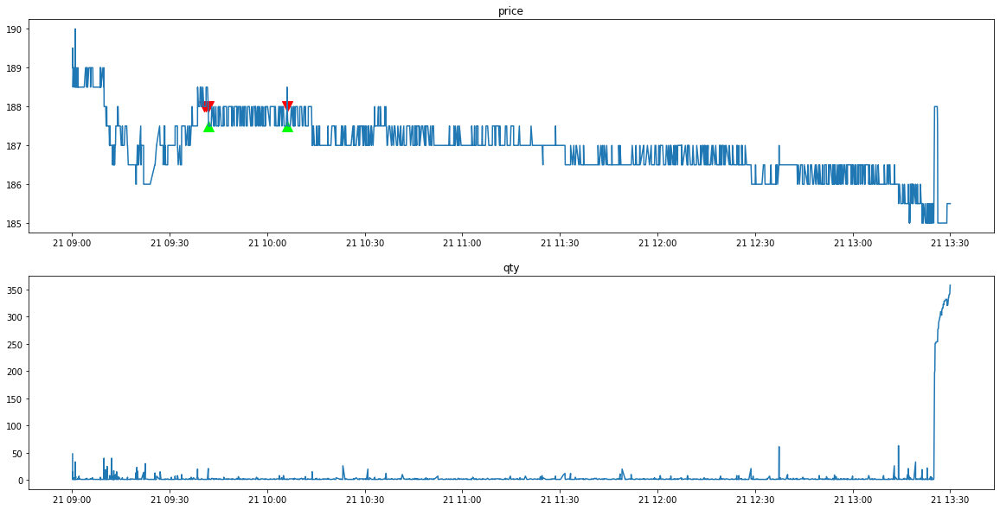

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90009397
*** bid1_p:  185.5
*** weighted_p:  184.89668932899792
ask1_p:  186.0
進場時間： 120445749 
  sell price at  185.5
*** bid1_p:  185.5
*** weighted_p:  184.8970457902511
ask1_p:  186.0
進場時間： 120500186 
  sell price at  185.5
*** bid1_p:  185.5
*** weighted_p:  184.8977574505754
ask1_p:  186.0
進場時間： 120531770 
  sell price at  185.5
*** bid1_p:  185.5
*** weighted_p:  184.89917574330292
ask1_p:  186.0
進場時間： 120600122 
  sell price at  185.5
*** bid1_p:  185.5
*** weighted_p:  184.89988238753307
ask1_p:  186.0
進場時間： 120630467 
  sell price at  185.5
*** bid1_p:  185.5
*** weighted_p:  184.90076335877862
ask1_p:  186.0
進場時間： 120702822 
  sell price at  185.5
*** bid1_p:  185.5
*** weighted_p:  184.90164174728818
ask1_p:  18

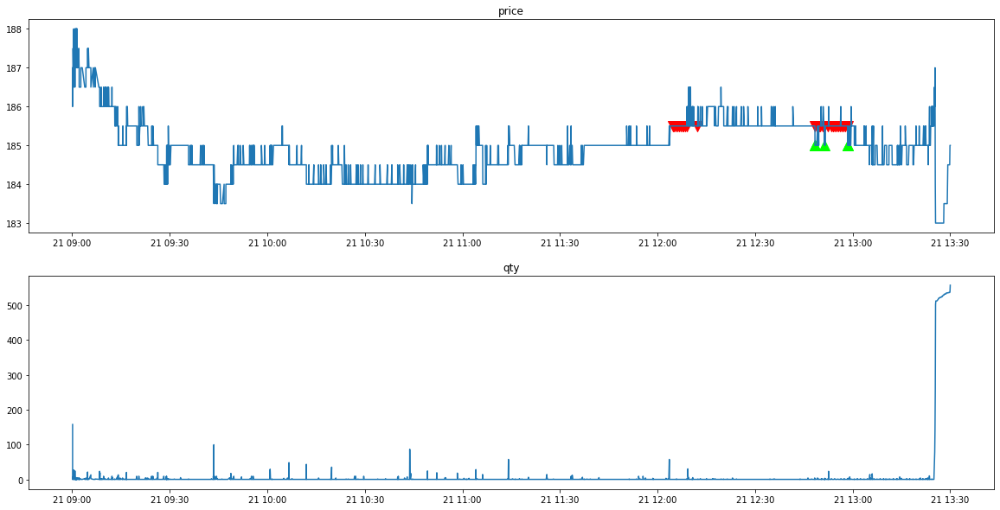

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90007316
*** bid1_p:  182.5
*** weighted_p:  182.27811158798283
ask1_p:  183.0
進場時間： 92022600 
  sell price at  182.5
stop profit
出場時間： 92023102
POSITION(pre):  [182.5]
Order_p(pre):  [182.]
tick_row price:  182.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  182.5
*** weighted_p:  182.27782426778242
ask1_p:  183.0
進場時間： 92230568 
  sell price at  182.5
*** bid1_p:  182.5
*** weighted_p:  182.27856547122602
ask1_p:  183.0
進場時間： 92300188 
  sell price at  182.5
*** bid1_p:  182.5
*** weighted_p:  182.2793017456359
ask1_p:  183.0
進場時間： 92332748 
  sell price at  182.5
*** bid1_p:  182.5
*** weighted_p:  182.28021523178808
ask1_p:  183.0
進場時間： 92401489 
  sell price at  182.5
*** bid1_p:  182.5
*

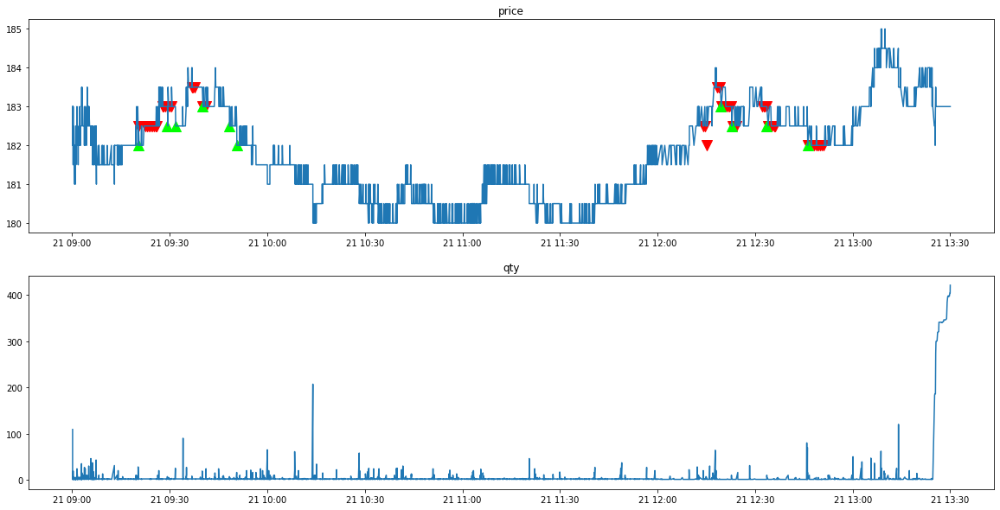

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2308/tse_lob_2308.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2308/tse_tick_2308.csv' mode='r' encoding='UTF-8'>
90007535
*** bid1_p:  181.0
*** weighted_p:  180.80578512396696
ask1_p:  181.5
進場時間： 90327277 
  sell price at  181.0
*** bid1_p:  181.0
*** weighted_p:  180.81451612903226
ask1_p:  181.5
進場時間： 90357564 
  sell price at  181.0
*** bid1_p:  181.0
*** weighted_p:  180.81635388739946
ask1_p:  181.5
進場時間： 90401344 
  sell price at  181.0
stop profit
出場時間： 90823156
POSITION(pre):  [181. 181. 181.]
Order_p(pre):  [180.5 180.5 180.5]
tick_row price:  180.5
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  181.0
*** weighted_p:  180.77951807228916
ask1_p:  181.5
進場時間： 93408210 
  sell price at  181.0
*** bid1_p:  181.0
*** weighted_p:  180.78022417934346
ask1_p:  181.5
進場時間： 93443309 
  sell pri

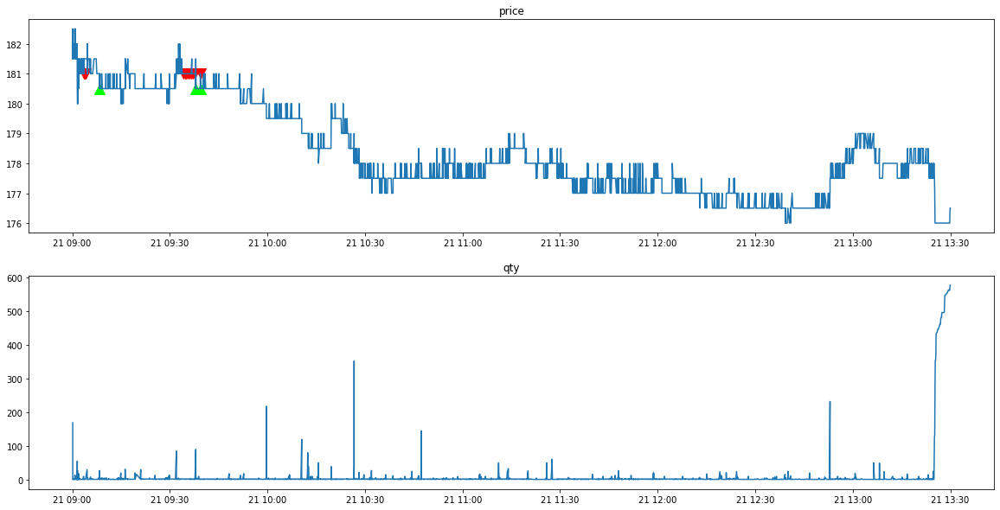

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90005896
*** bid1_p:  60.9
*** weighted_p:  60.803571428571416
ask1_p:  61.0
進場時間： 90356128 
  sell price at  60.9
*** bid1_p:  60.9
*** weighted_p:  60.803571428571416
ask1_p:  61.0
進場時間： 90400553 
  sell price at  60.9
*** bid1_p:  61.1
*** weighted_p:  60.90374531835207
ask1_p:  61.2
進場時間： 90517415 
  sell price at  61.1
*** bid1_p:  61.1
*** weighted_p:  60.91418439716313
ask1_p:  61.2
進場時間： 90549175 
  sell price at  61.1
*** bid1_p:  61.1
*** weighted_p:  60.92305084745765
ask1_p:  61.2
進場時間： 90604286 
  sell price at  61.1
stop profit
出場時間： 90620871
POSITION(pre):  [60.9 60.9 61.1 61.1 61.1]
Order_p(pre):  [60.8 60.8 61.  61.  61. ]
tick_row price:  61.0
qualified index:  [[2]
 [3]
 [4]]
POSITION(post):  [60.9 60.9]


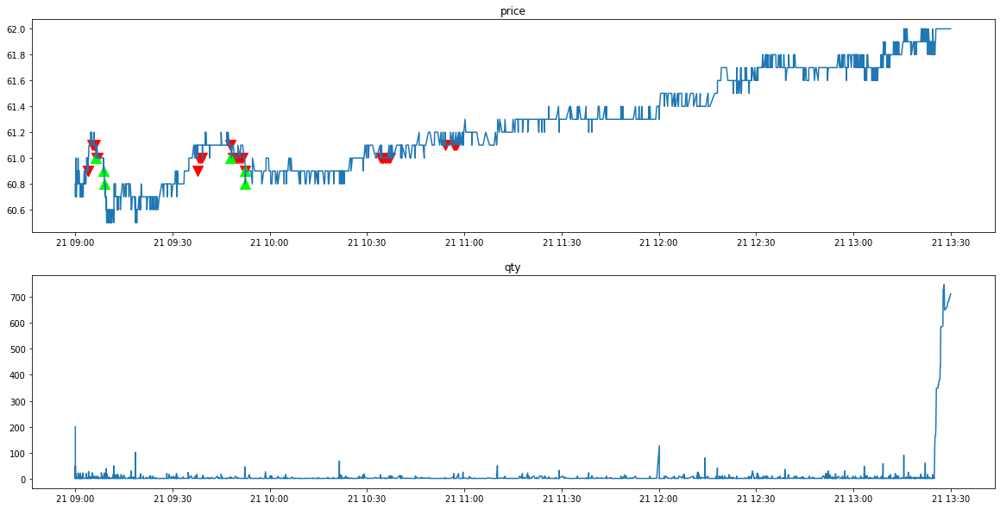

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90006268
clear_position:  0.0
position:  []
tick_row_price 61.3
----------Result Report--------------
profit:  0.0


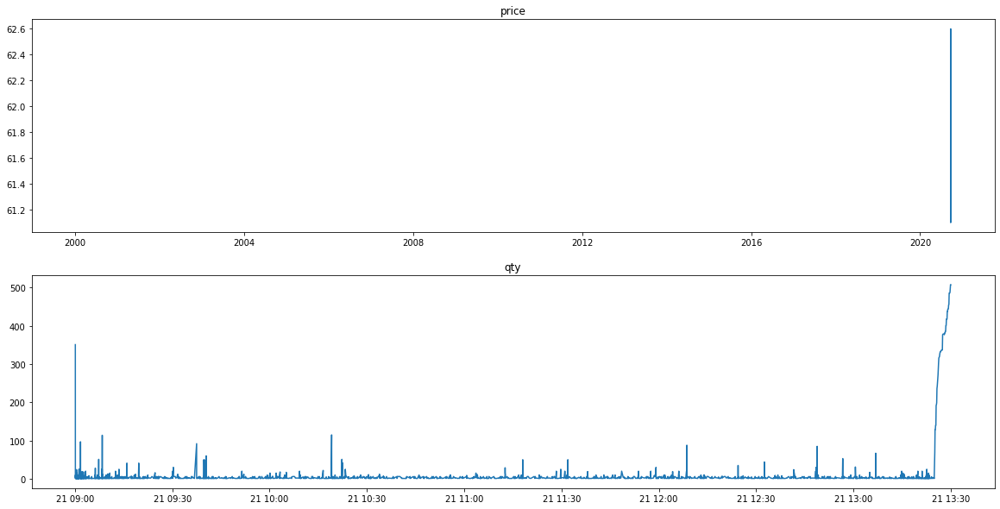

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90005794
*** bid1_p:  61.6
*** weighted_p:  61.450256410256415
ask1_p:  61.7
進場時間： 91419467 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.450682593856655
ask1_p:  61.7
進場時間： 91450156 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.45169491525422
ask1_p:  61.7
進場時間： 91505284 
  sell price at  61.6
stop profit
出場時間： 91824802
POSITION(pre):  [61.6 61.6 61.6]
Order_p(pre):  [61.5 61.5 61.5]
tick_row price:  61.5
qualified index:  [[0]
 [1]
 [2]]
POSITION(post):  []
Order_p(post):  []

clear_position:  0.0
position:  []
tick_row_price 61.3
----------Result Report--------------
profit:  0.30000000000000426


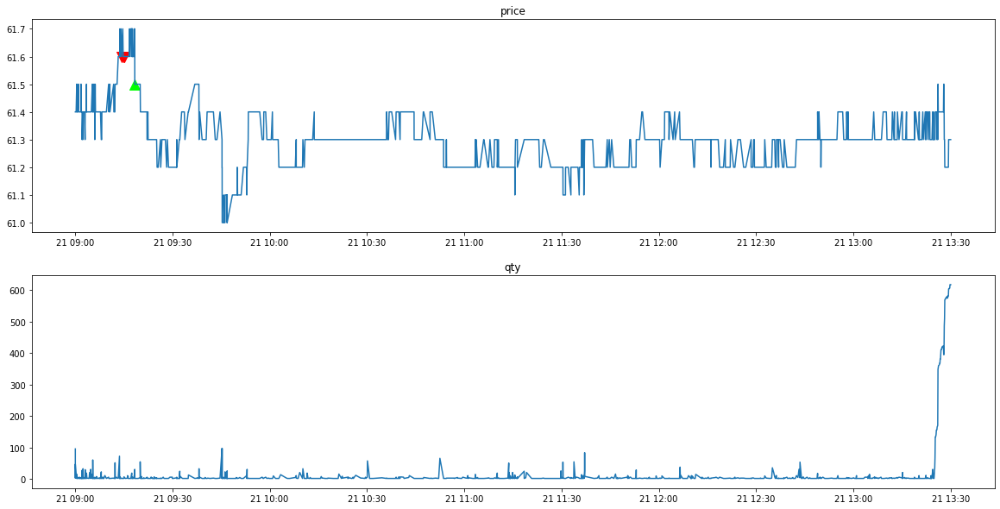

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90009954
*** bid1_p:  61.6
*** weighted_p:  61.526200873362434
ask1_p:  61.7
進場時間： 91021815 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.52881355932203
ask1_p:  61.7
進場時間： 91055800 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.52881355932203
ask1_p:  61.7
進場時間： 91103376 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.529175475687104
ask1_p:  61.7
進場時間： 91133749 
  sell price at  61.6
*** bid1_p:  61.6
*** weighted_p:  61.53546511627907
ask1_p:  61.7
進場時間： 91206928 
  sell price at  61.6
stop profit
出場時間： 91211186
POSITION(pre):  [61.6 61.6 61.6 61.6 61.6]
Order_p(pre):  [61.5 61.5 61.5 61.5 61.5]
tick_row price:  61.5
qualified index:  [[0]
 [1]
 [2]
 [3]
 [4]]
POSITION(post):  []

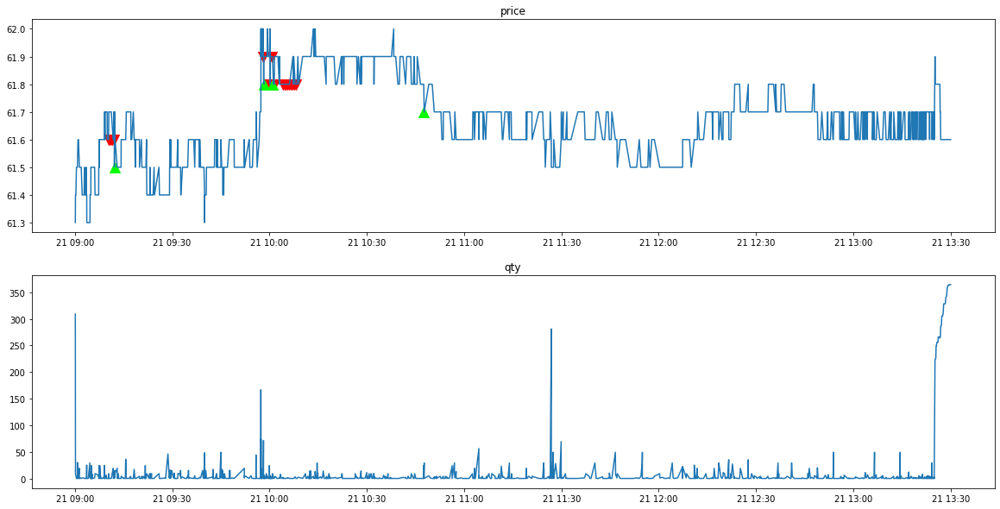

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90008451
*** bid1_p:  62.3
*** weighted_p:  62.064807162534386
ask1_p:  62.4
進場時間： 91852473 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.065775034293516
ask1_p:  62.4
進場時間： 91900048 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.070872483221464
ask1_p:  62.4
進場時間： 91930083 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.075131926121365
ask1_p:  62.4
進場時間： 92001052 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.07795172863667
ask1_p:  62.4
進場時間： 92040555 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.078817413905156
ask1_p:  62.4
進場時間： 92100349 
  sell price at  62.3
*** bid1_p:  62.3
*** weighted_p:  62.08726474278551
ask1_p:  62.4
進場時間： 92140808 
  sell

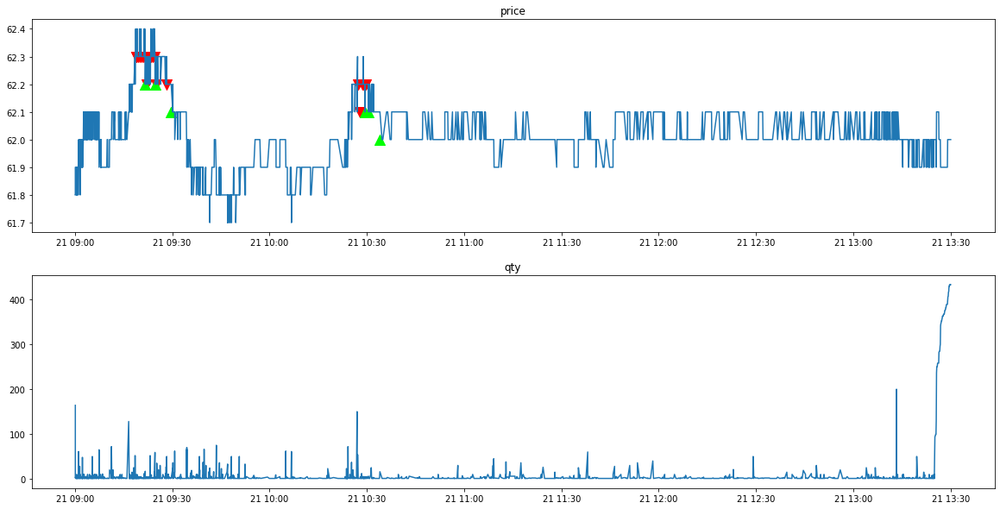

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90005916
clear_position:  0.0
position:  []
tick_row_price 62.3
----------Result Report--------------
profit:  0.0


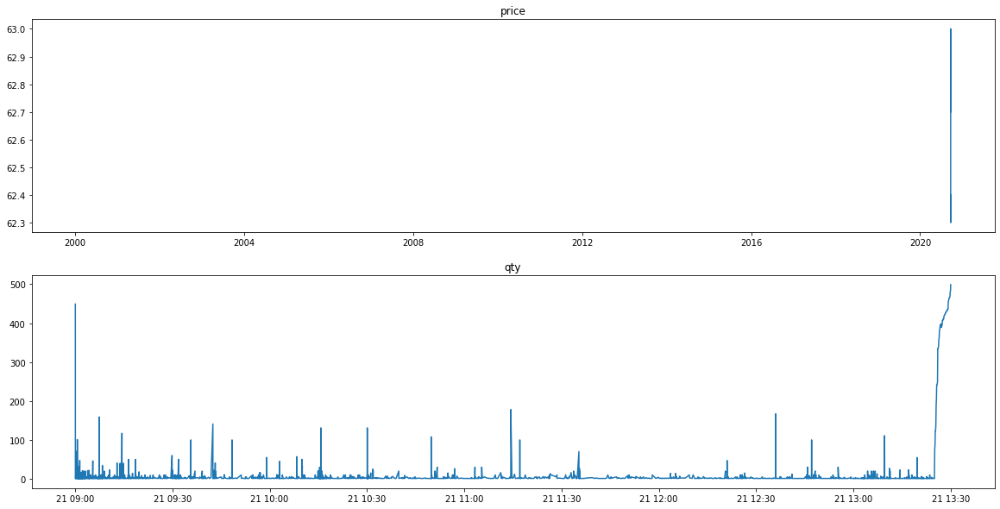

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90004815
*** bid1_p:  62.7
*** weighted_p:  62.53417721518994
ask1_p:  62.8
進場時間： 90748117 
  sell price at  62.7
*** bid1_p:  62.7
*** weighted_p:  62.546627565982476
ask1_p:  62.8
進場時間： 90800492 
  sell price at  62.7
stop profit
出場時間： 90817427
POSITION(pre):  [62.7 62.7]
Order_p(pre):  [62.6 62.6]
tick_row price:  62.6
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  62.7
*** weighted_p:  62.618705035971246
ask1_p:  62.8
進場時間： 91527905 
  sell price at  62.7
*** bid1_p:  62.7
*** weighted_p:  62.62025495750711
ask1_p:  62.8
進場時間： 91611993 
  sell price at  62.7
*** bid1_p:  62.7
*** weighted_p:  62.62459016393442
ask1_p:  62.8
進場時間： 91814819 
  sell price at  62.7
*** bid1_p:  62.7
*** we

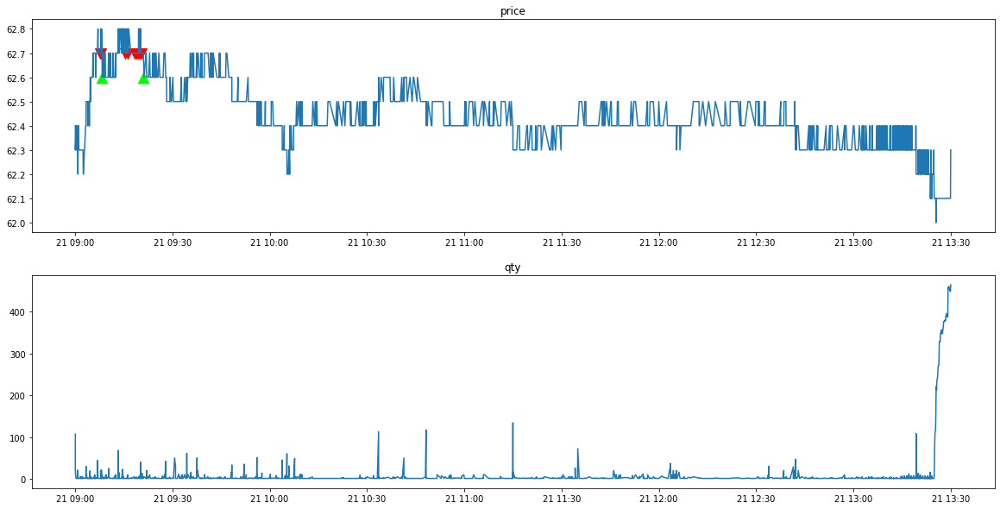

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90008485
*** bid1_p:  62.4
*** weighted_p:  62.258636363636185
ask1_p:  62.5
進場時間： 95715258 
  sell price at  62.4
*** bid1_p:  62.4
*** weighted_p:  62.258743376229944
ask1_p:  62.5
進場時間： 95745827 
  sell price at  62.4
*** bid1_p:  62.4
*** weighted_p:  62.258743376229944
ask1_p:  62.5
進場時間： 95800518 
  sell price at  62.4
*** bid1_p:  62.4
*** weighted_p:  62.274344827586
ask1_p:  62.5
進場時間： 100107404 
  sell price at  62.4
stop profit
出場時間： 100107404
POSITION(pre):  [62.4 62.4 62.4 62.4]
Order_p(pre):  [62.3 62.3 62.3 62.3]
tick_row price:  62.3
qualified index:  [[0]
 [1]
 [2]
 [3]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  62.4
*** weighted_p:  62.293841642228536
ask1_p:  62.5
進場時間： 101625223 
  sell price 

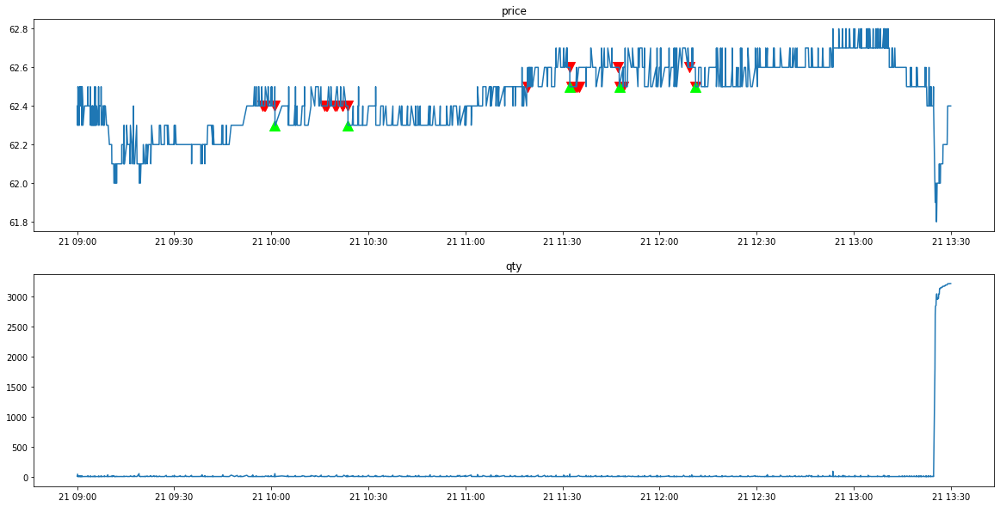

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90008986
*** bid1_p:  62.6
*** weighted_p:  62.46484018264832
ask1_p:  62.7
進場時間： 91344899 
  sell price at  62.6
stop profit
出場時間： 91401604
POSITION(pre):  [62.6]
Order_p(pre):  [62.5]
tick_row price:  62.5
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  62.6
*** weighted_p:  62.51453237410063
ask1_p:  62.7
進場時間： 91650215 
  sell price at  62.6
*** bid1_p:  62.6
*** weighted_p:  62.51526390870177
ask1_p:  62.7
進場時間： 91700487 
  sell price at  62.6
*** bid1_p:  62.6
*** weighted_p:  62.51715481171539
ask1_p:  62.7
進場時間： 91730492 
  sell price at  62.6
*** bid1_p:  62.6
*** weighted_p:  62.52275682704803
ask1_p:  62.7
進場時間： 91800124 
  sell price at  62.6
*** bid1_p:  62.6
*** weighted_p:  62.524

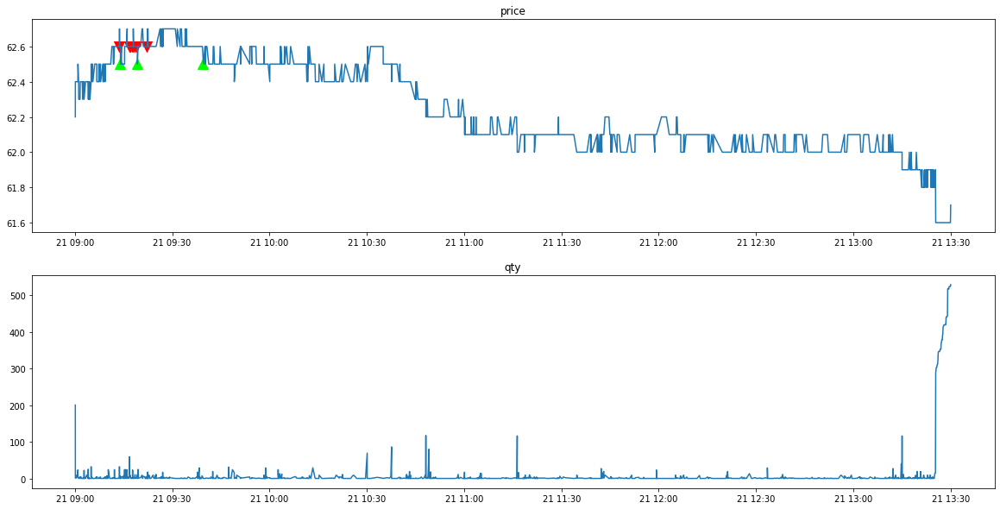

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90009443
*** bid1_p:  61.1
*** weighted_p:  60.81744791666663
ask1_p:  61.2
進場時間： 90248040 
  sell price at  61.1
stop profit
出場時間： 90256711
POSITION(pre):  [61.1]
Order_p(pre):  [61.]
tick_row price:  61.0
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  61.0
*** weighted_p:  60.82010309278347
ask1_p:  61.1
進場時間： 90300755 
  sell price at  61.0
*** bid1_p:  61.0
*** weighted_p:  60.84741573033705
ask1_p:  61.1
進場時間： 90331755 
  sell price at  61.0
*** bid1_p:  61.1
*** weighted_p:  60.91445578231277
ask1_p:  61.2
進場時間： 90701943 
  sell price at  61.1
stop profit
出場時間： 90711637
POSITION(pre):  [61.  61.  61.1]
Order_p(pre):  [60.9 60.9 61. ]
tick_row price:  61.0
qualified index:  [[2]]
POSITION(

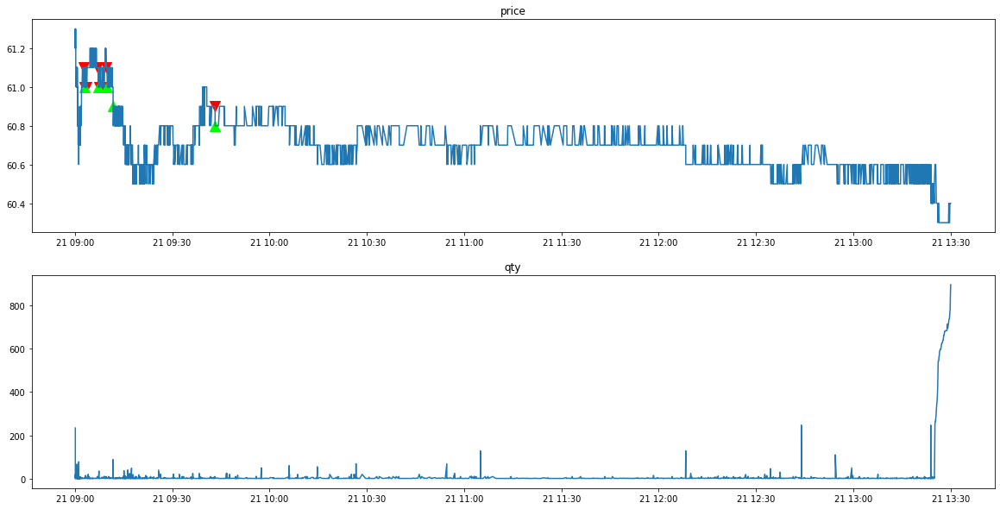

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90006994
------Weird price!!!!!---------
At time:  90208715
tick_row_price 60.6
ask_1_p 60.7
bid_1_p 60.5
clear_position:  0.0
position:  []
tick_row_price 59.9
----------Result Report--------------
profit:  0.0


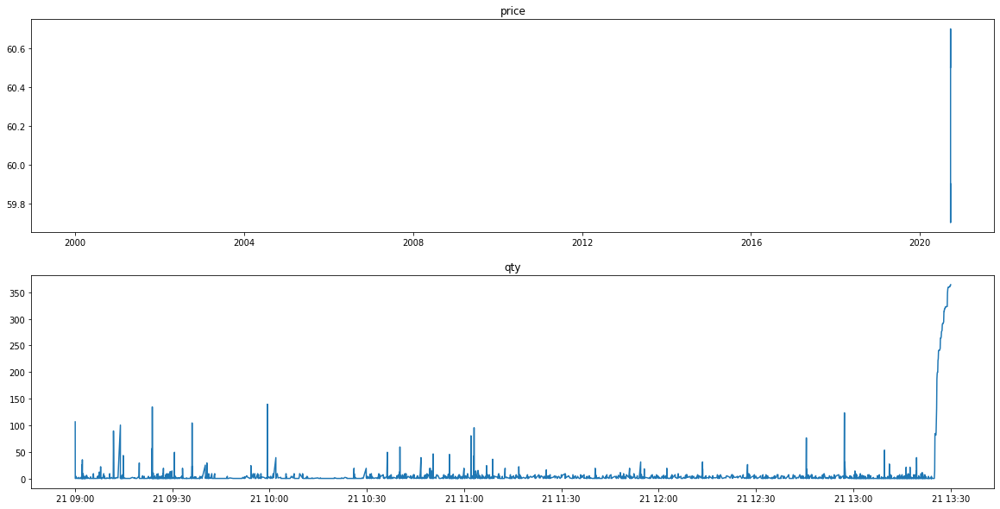

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90006085
*** bid1_p:  59.2
*** weighted_p:  59.120199501246795
ask1_p:  59.3
進場時間： 90603467 
  sell price at  59.2
*** bid1_p:  59.2
*** weighted_p:  59.1202988792029
ask1_p:  59.3
進場時間： 90634240 
  sell price at  59.2
stop profit
出場時間： 90657889
POSITION(pre):  [59.2 59.2]
Order_p(pre):  [59.1 59.1]
tick_row price:  59.1
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  59.2
*** weighted_p:  59.13177470775759
ask1_p:  59.3
進場時間： 90835777 
  sell price at  59.2
*** bid1_p:  59.2
*** weighted_p:  59.13184713375785
ask1_p:  59.3
進場時間： 90900582 
  sell price at  59.2
*** bid1_p:  59.2
*** weighted_p:  59.13315899581579
ask1_p:  59.3
進場時間： 90930764 
  sell price at  59.2
*** bid1_p:  59.2
*** weig

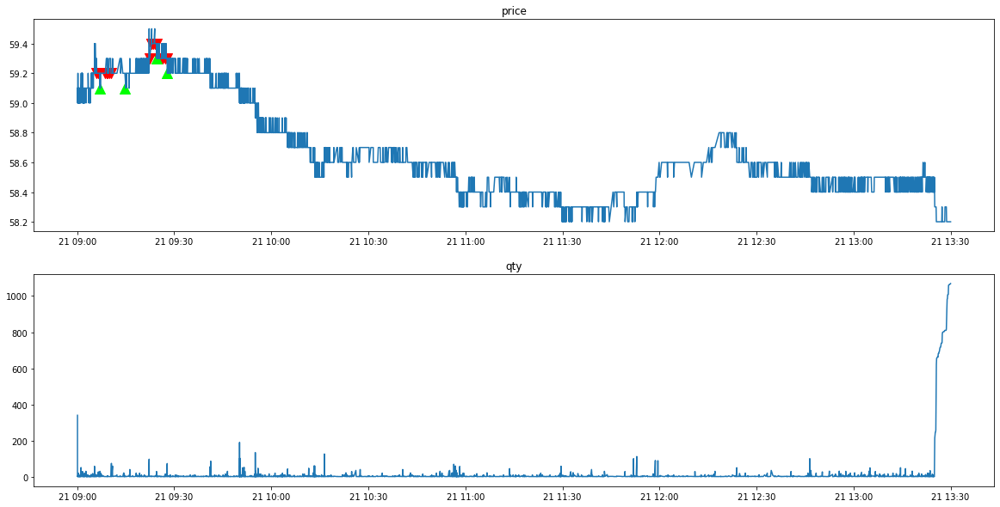

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3711/tse_lob_3711.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/3711/tse_tick_3711.csv' mode='r' encoding='UTF-8'>
90005257
*** bid1_p:  59.0
*** weighted_p:  58.916539440203564
ask1_p:  59.1
進場時間： 90338158 
  sell price at  59.0
stop profit
出場時間： 90338158
POSITION(pre):  [59.]
Order_p(pre):  [58.9]
tick_row price:  58.9
qualified index:  [[0]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  59.0
*** weighted_p:  58.93380000000002
ask1_p:  59.1
進場時間： 90403589 
  sell price at  59.0
*** bid1_p:  59.0
*** weighted_p:  58.93740458015269
ask1_p:  59.1
進場時間： 90433607 
  sell price at  59.0
stop profit
出場時間： 90620566
POSITION(pre):  [59. 59.]
Order_p(pre):  [58.9 58.9]
tick_row price:  58.9
qualified index:  [[0]
 [1]]
POSITION(post):  []
Order_p(post):  []

*** bid1_p:  58.7
*** weighted_p:  58.51018949279469
ask1_p:  58.8
進場時間： 1258300

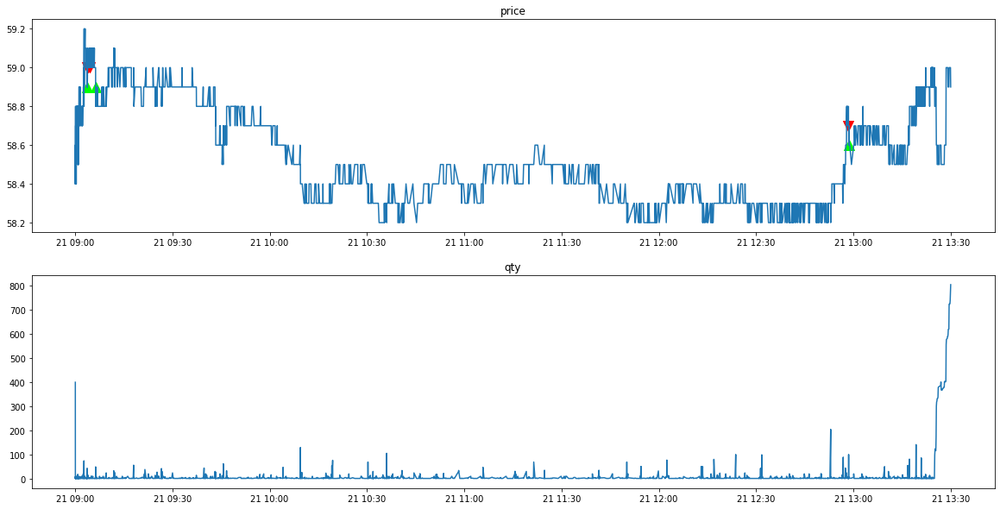

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-09/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90007902
*** bid1_p:  20.75
*** weighted_p:  20.71188418323231
ask1_p:  20.8
進場時間： 95243737 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.712915872006597
ask1_p:  20.8
進場時間： 95531947 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.713327745180035
ask1_p:  20.8
進場時間： 95600370 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.713335428451526
ask1_p:  20.8
進場時間： 95636278 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.71338146055642
ask1_p:  20.8
進場時間： 95700504 
  sell price at  20.75
*** bid1_p:  20.75
*** weighted_p:  20.7136957875076
ask1_p:  20.8
進場時間： 95730652 
  sell price at  20.75
stop profit
出場時間： 95732423
POSITION(pre):  [20.75 20.75 20.75 20.75 20.75 20.75]

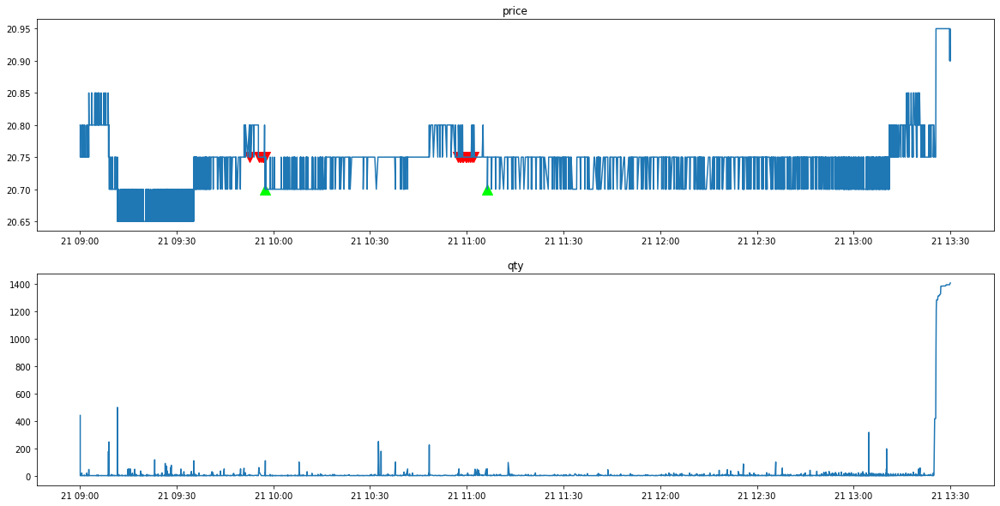

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-10/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90004102
*** bid1_p:  20.8
*** weighted_p:  20.76812227074234
ask1_p:  20.85
進場時間： 95553084 
  sell price at  20.8
*** bid1_p:  20.8
*** weighted_p:  20.76812227074234
ask1_p:  20.85
進場時間： 95601258 
  sell price at  20.8
*** bid1_p:  20.8
*** weighted_p:  20.76920454545453
ask1_p:  20.85
進場時間： 100036193 
  sell price at  20.8
*** bid1_p:  20.8
*** weighted_p:  20.769235620585256
ask1_p:  20.85
進場時間： 100100203 
  sell price at  20.8
*** bid1_p:  20.8
*** weighted_p:  20.769815782922574
ask1_p:  20.85
進場時間： 100152066 
  sell price at  20.8
*** bid1_p:  20.8
*** weighted_p:  20.769855685493898
ask1_p:  20.85
進場時間： 100201239 
  sell price at  20.8
*** bid1_p:  20.8
*** weighted_p:  20.76997019374068
ask1_p:  20.85
進場時間： 1002316

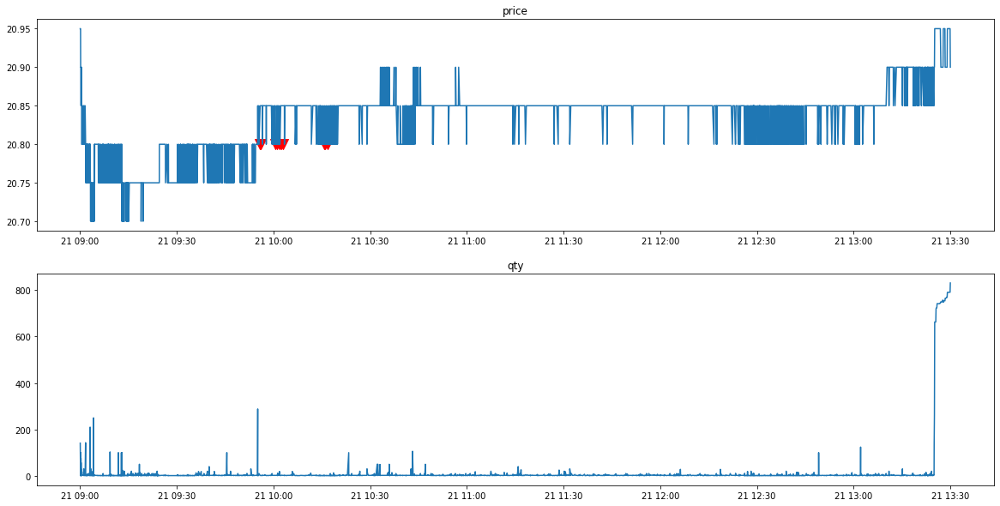

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-11/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90006147
clear_position:  0.0
position:  []
tick_row_price 20.8
----------Result Report--------------
profit:  0.0


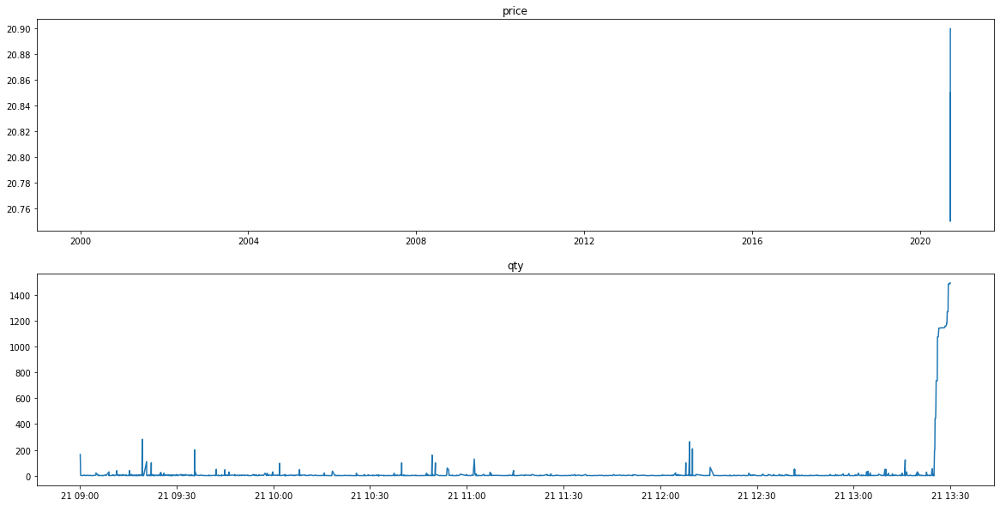

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-14/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90007143
clear_position:  0.0
position:  []
tick_row_price 20.85
----------Result Report--------------
profit:  0.0


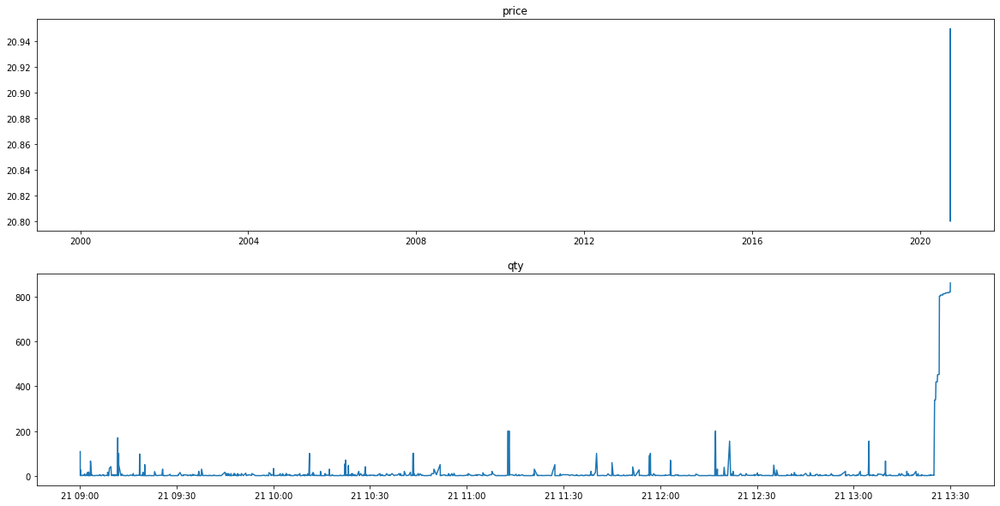

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-15/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90008278
clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.0


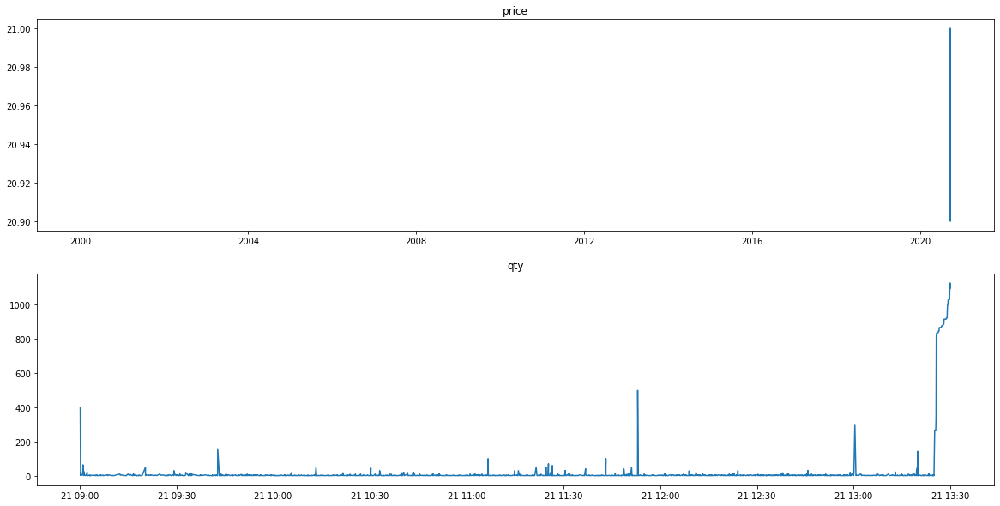

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-16/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90007924
*** bid1_p:  21.0
*** weighted_p:  20.974020966381108
ask1_p:  21.05
進場時間： 123708125 
  sell price at  21.0
*** bid1_p:  21.0
*** weighted_p:  20.974107035477665
ask1_p:  21.05
進場時間： 123739305 
  sell price at  21.0
*** bid1_p:  21.0
*** weighted_p:  20.974134407309062
ask1_p:  21.05
進場時間： 123800381 
  sell price at  21.0
*** bid1_p:  21.0
*** weighted_p:  20.974360047846492
ask1_p:  21.05
進場時間： 123925231 
  sell price at  21.0
*** bid1_p:  21.0
*** weighted_p:  20.97453301606147
ask1_p:  21.05
進場時間： 123955641 
  sell price at  21.0
*** bid1_p:  21.0
*** weighted_p:  20.97453301606147
ask1_p:  21.05
進場時間： 124003244 
  sell price at  21.0
*** bid1_p:  21.0
*** weighted_p:  20.97456015216318
ask1_p:  21.05
進場時間： 1240

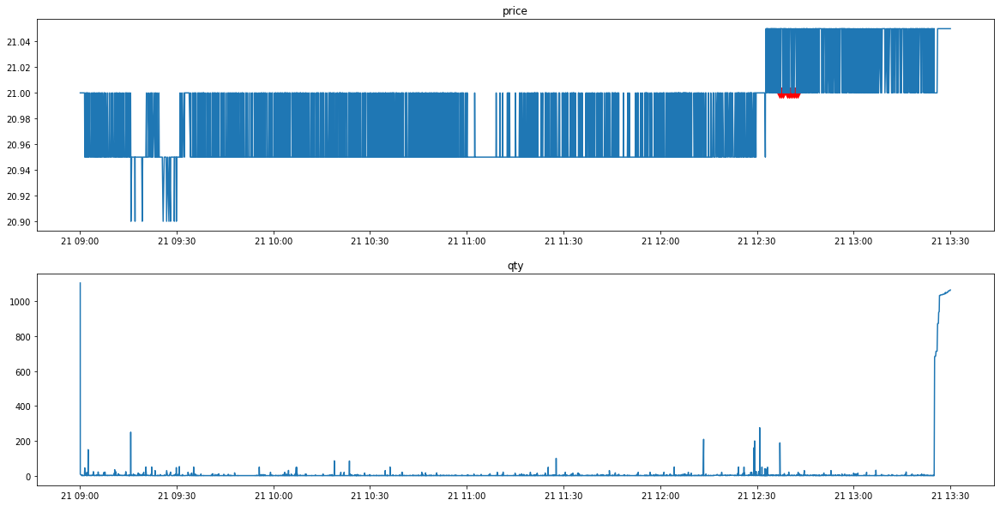

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-17/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90006217
clear_position:  0.0
position:  []
tick_row_price 20.85
----------Result Report--------------
profit:  0.0


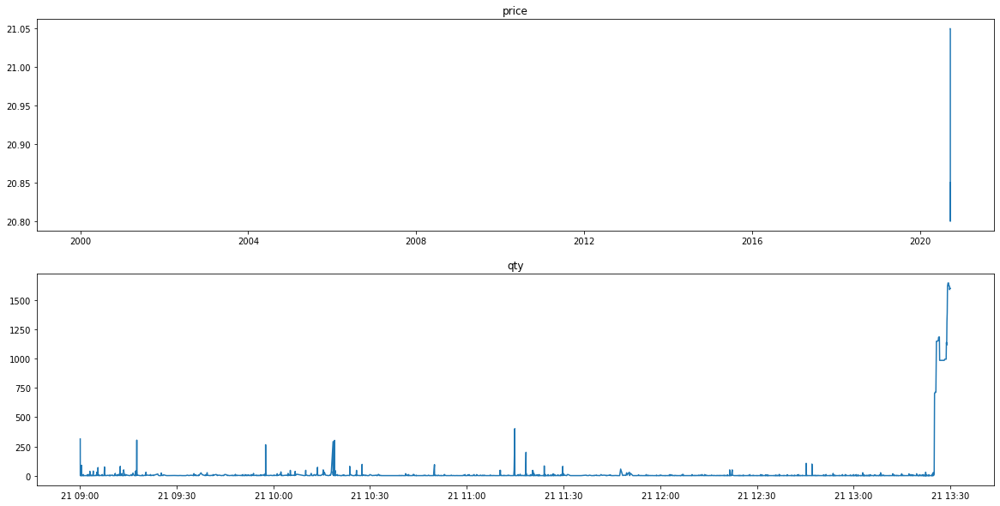

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-18/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90006879
clear_position:  0.0
position:  []
tick_row_price 20.9
----------Result Report--------------
profit:  0.0


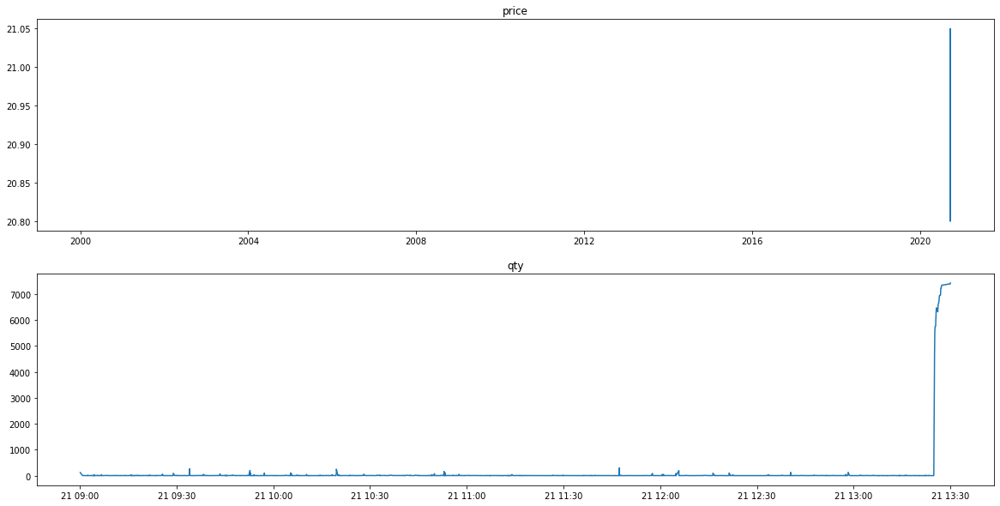

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-21/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90007069
clear_position:  0.0
position:  []
tick_row_price 20.75
----------Result Report--------------
profit:  0.0


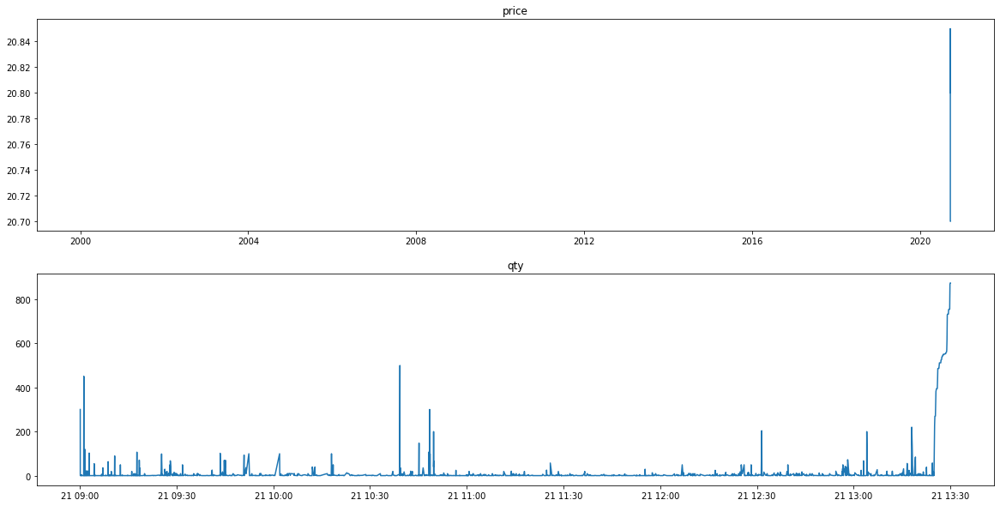

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-22/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90006625
clear_position:  0.0
position:  []
tick_row_price 20.55
----------Result Report--------------
profit:  0.0


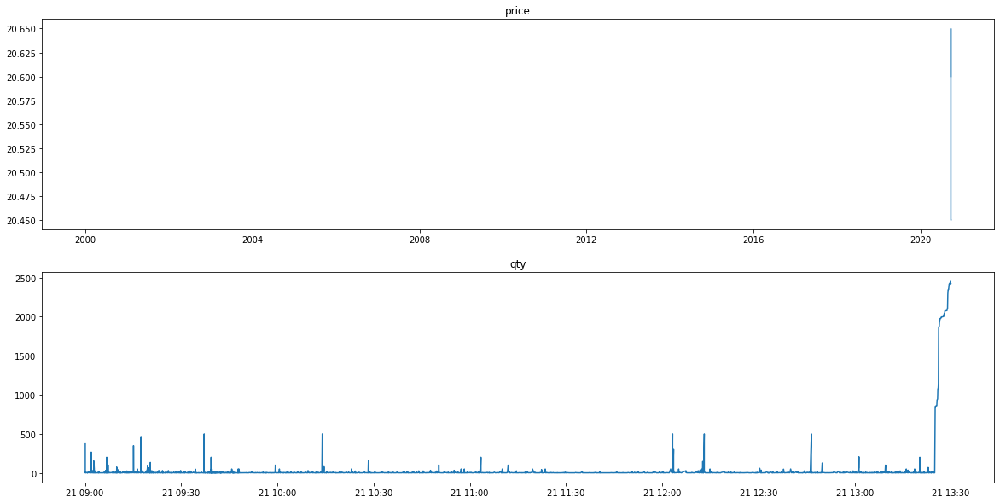

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-23/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90003781
clear_position:  0.0
position:  []
tick_row_price 20.25
----------Result Report--------------
profit:  0.0


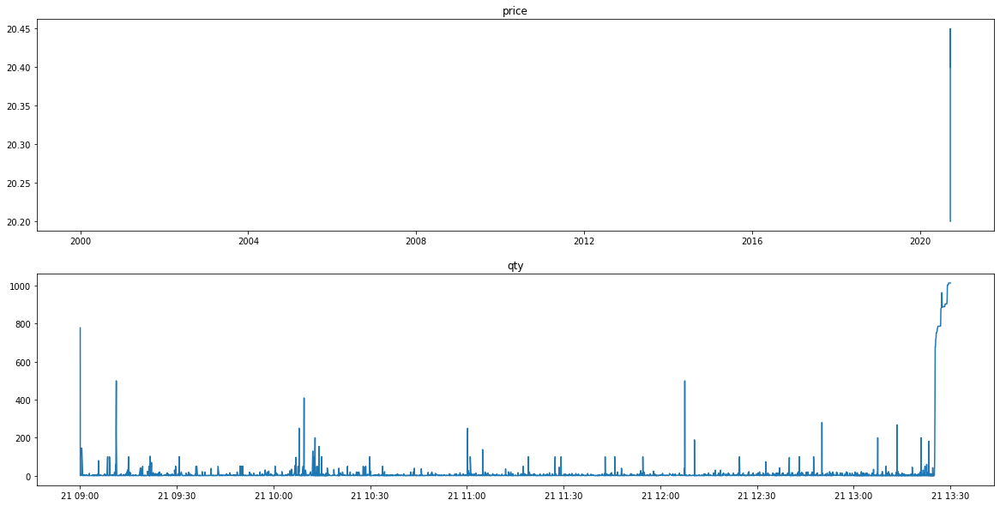

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-24/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90003275
clear_position:  0.0
position:  []
tick_row_price 19.9
----------Result Report--------------
profit:  0.0


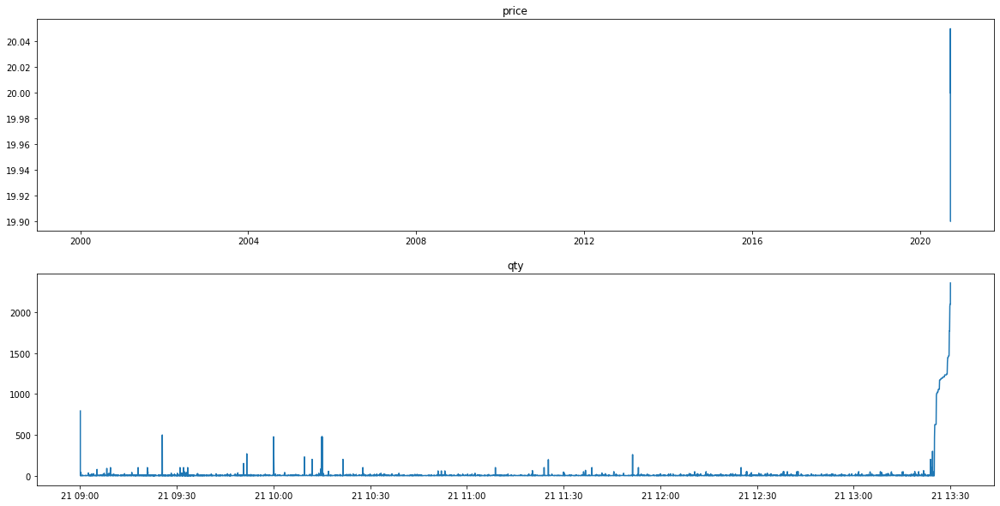

<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2892/tse_lob_2892.csv' mode='r' encoding='UTF-8'>
<_io.TextIOWrapper name='/content/gdrive/Shared drives/marketdata/stock/2020-09-25/2892/tse_tick_2892.csv' mode='r' encoding='UTF-8'>
90002649
*** bid1_p:  20.1
*** weighted_p:  20.0563453159041
ask1_p:  20.15
進場時間： 91115878 
  sell price at  20.1
*** bid1_p:  20.1
*** weighted_p:  20.056973613354835
ask1_p:  20.15
進場時間： 91211779 
  sell price at  20.1
*** bid1_p:  20.1
*** weighted_p:  20.057410379882253
ask1_p:  20.15
進場時間： 91241847 
  sell price at  20.1
*** bid1_p:  20.1
*** weighted_p:  20.060051150895113
ask1_p:  20.15
進場時間： 91434576 
  sell price at  20.1
*** bid1_p:  20.1
*** weighted_p:  20.061267605633773
ask1_p:  20.15
進場時間： 91500135 
  sell price at  20.1
*** bid1_p:  20.1
*** weighted_p:  20.064513822688248
ask1_p:  20.15
進場時間： 91729631 
  sell price at  20.1
*** bid1_p:  20.1
*** weighted_p:  20.06464862298193
ask1_p:  20.15
進場時間： 91759871 


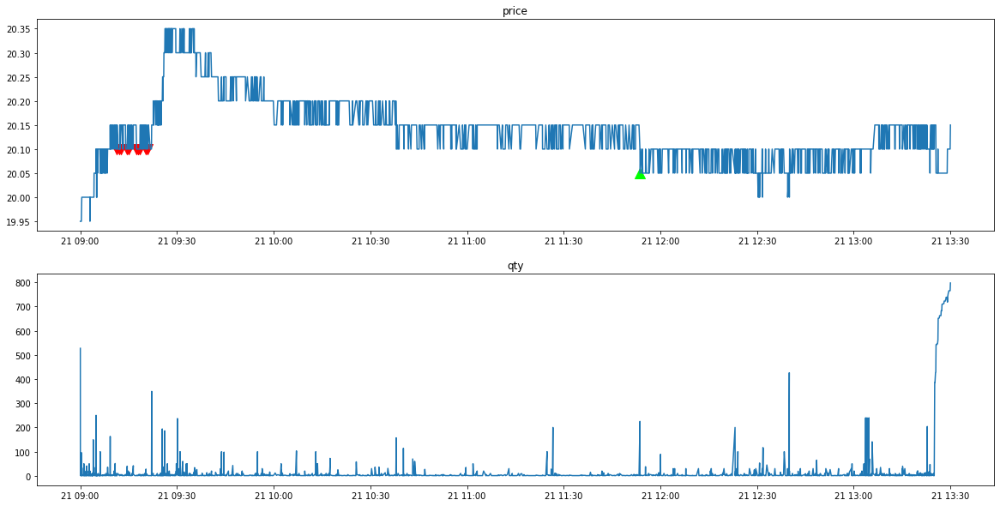

In [ ]:
STOCK_LIST = ["6462", "6278", "6488", "3037", "2330", "3406", "2317", "6505", "2412", "1301", "1326", "2882", "1303", "2881", "3008", "1216", "2891", "2002", "3045", "2454", "2886", "2912", "2308", "3711", "2892"]
SEC = 1000
MIN = 100000
COOL_DOWN_MIN_LIST = [30*SEC, 45*SEC, 1*MIN, (2*MIN + 30*SEC) , 5*MIN, 10*MIN]
THETA_LIST = [1.001, 1.002, 1.003, 1.004, 1.005, 1.006, 1.007, 1.008, 1.009,1.01] 

for sid in STOCK_LIST:
    for theta in THETA_LIST[:1]:
        for cool in COOL_DOWN_MIN_LIST[:1]:
            para = {"sid": sid, "beta":2, "time_out": 2000000, "gamma": 0.75, "cool_down_min": cool, "stop_loss_factor": 1.02, "theta": theta, "position_max_q": 10}
            res = back_test(dt.datetime(2020, 9, 9), dt.datetime(2020, 9, 25), **para)
            profit, cost = calculate_profit(res)